# INF8111 - Fouille de données


## TP1 Automne 2020 - Duplicate Bug Report Detection

##### Date de remise: 23/05


#### Membres de l'équipe:

    - Maxime Laroche 1950276 1
    - Oussama Soukeur 2093409 2
    - Nicolas Veber 2036057 3
    
##### Deliverables:

Vous devez soumettre deux fichiers distincts à Moodle: 
1. Notebook
2. [Json](https://en.wikipedia.org/wiki/JSON) contenant du contenu de page Web récupéré (bug_reports.json) 
    


## Résumé

En raison de la complexité des systèmes logiciels, les bogues logiciels sont répandus. Les entreprises, en particulier les grandes, utilisent généralement un système de suivi des bogues (BTS), également appelé système de suivi des problèmes, pour gérer et suivre les enregistrements des bogues. Outre les développeurs et les testeurs, de nombreux projets, principalement des projets open source, permettent aux utilisateurs de signaler de nouveaux bogues dans leur BTS. Pour ce faire, les utilisateurs doivent remplir un formulaire avec plusieurs champs. Un sous-ensemble important de ces champs fournissent des données catégorielles et n'acceptent que les valeurs qui vont d'une liste fixe d’options (par exemple, composant, version et produit du système). Deux autres domaines importants sont le résumé et la description. Les utilisateurs sont libres d'écrire quoi que ce soit dans les deux champs et la seule contrainte est que le résumé a un nombre maximum de caractères. La soumission d'un formulaire crée une page, appelée rapport de bogue ou rapport de problème, qui contient toutes les informations sur un bogue.

En raison du manque de communication et de synchronisation, les utilisateurs peuvent ne pas savoir qu'un bogue spécifique a déjà été soumis et le signaler à nouveau. Identifier les rapports de bogues en double est une tâche importante dans les BTS et c'est le sujet de ce TP. Fondamentalement, notre objectif est de développer un système qui comparera un nouveau rapport de bogue avec ceux soumis et les classera en fonction de la similitude textuelle. Cette liste classée sera utilisée par un trieur pour identifier manuellement si un rapport est dupliqué ou non. 



## 2 - Installation

Pour ce TP, vous aurez besoin des librairies `numpy`, `sklearn` et `scipy` (que vous avez sans doute déjà), ainsi que la librairie `nltk`, qui est une libraire utilisée pour faire du traitement du language (Natural Language Processing, NLP)

Installez les libraires en question et exécutez le code ci-dessous :

In [1]:
# Si vous le souhaitez, vous pouvez utiliser anaconda

"""
pip install --user numpy
pip install --user sklearn
pip install --user scipy
pip install --user nltk
pip install --user tqdm
"""

#python
import time
import nltk
#nltk.download("punkt")

## 3 - Jeu de données

Téléchargez l'archive à l'adresse suivante: https://drive.google.com/file/d/14BrFaOiVDIcpjwpm5iAkAy0v_moZyGiP/view?usp=sharing


L'archive contient:
1. test.json: Ce fichier contient les duplicate bug reports qui vont être utilisés pour évaluer notre système.
2. threads: Ce dossier contient le code HTML des bug reports. Chaque fichier HTML est nommé selon le motif **bug_report_id.html**.


L'image ci-dessous illustre un exemple de bug report:


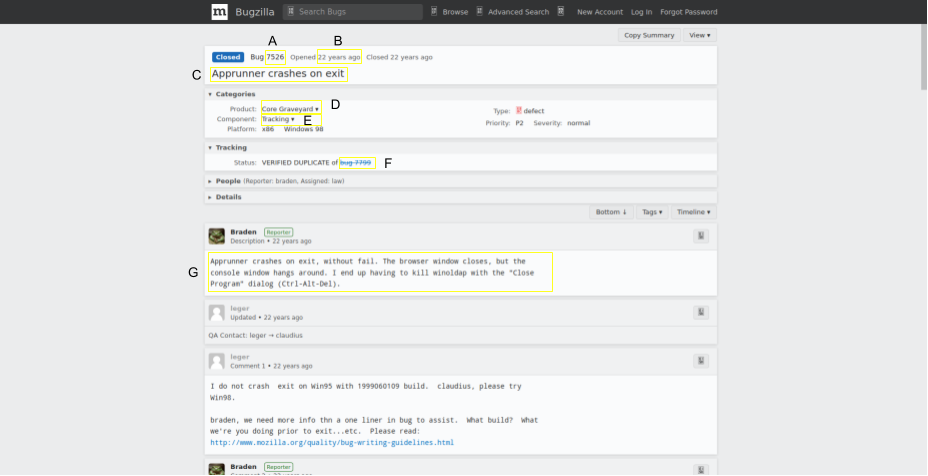

In [2]:
from IPython import display
display.Image("https://irving-muller.github.io/images/bug-report.png")

- A : identifiant du bug report
- B : date de création
- C : résumé
- D : produit
- E : composant
- F : l'identifiant du rapport dont le bug report est dupliqué
- G : description


Le script suivant charge le jeu de données de test et définit certaines variables globales:

In [3]:
import os

# define the folder path that contain the data
# FOLDER_PATH = "Define folder path that contain threads folder and test.json"
FOLDER_PATH = "dataset/"
PAGE_FOLDER = os.path.join(FOLDER_PATH, 'bug_reports')


# Load the evaluation dataset
import json


test = json.load(open(os.path.join(FOLDER_PATH, "test.json")))

# 4 - Web scraping

"Le *web scraping* (parfois appelé harvesting) est une technique d'extraction du contenu de sites Web, via un script ou un programme, dans le but de le transformer pour permettre son utilisation dans un autre contexte, par exemple le référencement." [Wikipedia](https://fr.wikipedia.org/wiki/Web_scraping)

## 4.1 - Question 1 (2 points)

Implémentez la fonction *extract_data_from_page* qui extrait les informations suivantes du code HTML: l'ID du bug report, la date de création, le titre, le produit, le composant, l'ID du bug report dont il est un duplicata, et la description.

La fonction *extract_data_from_page* retourne un dictionnaire avec la structure suivante:

```python
 {"report_id": int, 
  "dup_id": int or None (the report id which it is duplicate), 
  "component": string, 
  "product": string, 
  "summary": str, 
  "description": string, 
  "creation_date": int} 
```

Par exemple, pour le bug report "bug_report/7526.html", la fonction *extract_data_from_page* retourne:

```python
 {"report_id": 7526,
  "dup_id": 7799,
  "product": "core graveyard",
  "component":  tracking,
  "summary": "Apprunner crashes on exit",
  "description": "Apprunner crashes on exit, without fail. The browser window closes, but the console window hangs around. I end up having to kill winoldap with the \"Close Program\" dialog (Ctrl-Alt-Del).",
  "creation_date": 928396140}
```

**La date de création doit être représentée sous la forme d'un timestamp. Si un bug report n'est pas un duplicata, alors dup_id doit être None.**

*Indice: lxml parse est plus rapide que html.parser*

In [4]:
from bs4 import BeautifulSoup

In [5]:
def extract_data_from_page(pagepath):
    """
    Scrap bug report content from bug report html.
    
    :param pagepath: the path of html file.
    :return: 
        {
        "report_id": int,
        "dup_id": int or None (the report id which it is duplicate), 
        "component": string, 
        "product": string, 
        "summary": str, 
        "description": string, 
        "creation_date": int
        }
    """
    #Get git name for report ID
    
    fileName = pagepath.split("\\")[1]
    report_id = fileName.split(".")[0]
    dup_id = False
    if "(" in report_id:
        dup_id = True
    report_id = int(report_id)
    
    content = " ".join(open(pagepath, encoding="utf8").readlines())
    soup = BeautifulSoup(content, 'lxml')
    
    
    component = soup.find('span',id='component-name').text
    component = component.split('\n')[0]
    product = soup.find('span',id='product-name').text
    product = product.split('\n')[0]

    summary = soup.find('div', id='summary-container')
    summary = summary.find('h1',id='field-value-short_desc').text

    description = soup.find('div',id='c0')
    description = description.find('pre',id='ct-0').text

    creation_date = soup.find('span',class_='bug-time-label')
    creation_date = creation_date.find('span', class_='rel-time')
    creation_date = int(creation_date['data-time'])

    dictionary = {
        "report_id": report_id,
        "dup_id": dup_id, 
        "component": component, 
        "product": product, 
        "summary": summary, 
        "description": description, 
        "creation_date": creation_date
        }
    return dictionary

## 4.3 - Extraire le texte du code HTML

In [6]:
import os
from multiprocessing import Pool, TimeoutError
from time import time
import json
import tqdm

# Index each thread by its id
index_path = os.path.join(PAGE_FOLDER, 'bug_reports.json')

if os.path.isfile(index_path):
    # Load threads that webpage content were already extracted.
    report_index = json.load(open(index_path))
else:
    # Extract webpage content

    # This can be slow (around 10 minutes). Test your code with a small sample. lxml parse is faster than html.parser
    files = [os.path.join(PAGE_FOLDER, filename) for filename in os.listdir(PAGE_FOLDER)]
    reports = [extract_data_from_page(f) for f in tqdm.tqdm(files)]
    report_index = dict(((report['report_id'], report) for report in reports ))

    # Save preprocessed bug reports
    json.dump(report_index, open(index_path,'w'))
    

# 5 - Prétraitement des données

Le prétraitement des données est une tache cruciale en fouille de données. Cette étape nettoie et transforme les données brutes dans un format qui permet leur analyse, et leur utilisation avec des algorithmes de *machine learning*. En traitement des langages (natural language processing, NLP), la *tokenization* et le *stemming* sont des étapes cruciales. De plus, vous implémenterez une étape supplémentaire pour filtrer les mots sans importance.

## 5.1 - Tokenization

Cette étape permet de séparer un texte en séquence de *tokens* (= jetons, ici des mots, symboles ou ponctuation).

Par exemple, la phrase *"It's the student's notebook."* peut être séparé en liste de tokens de cette manière: ["it", " 's", "the", "student", " 's", "notebook", "."].


### 5.1.1 - Question 2 (0.5 point) 

Implémentez la fonction suivante :

- **tokenize_space** qui tokenize le texte à partir des blancs (espace, tabulation, nouvelle ligne). Ce tokenizer est naïf.
- **tokenize_nltk** qui utilise le tokenizer par défaut de la librairie nltk (https://www.nltk.org/api/nltk.html).
- **tokenize_space_punk** replaces the punctuation to space and then tokenizes the tokens that are separated by whitespace (space, tab, newline).

**All tokenizers have to lowercase the tokens.**


In [7]:
import re

def tokenize_space(text):
    """
    Tokenize the tokens that are separated by whitespace (space, tab, newline). 
    We consider that any tokenization was applied in the text when we use this tokenizer.
    
    For example: "hello\tworld of\nNLP" is split in ['hello', 'world', 'of', 'NLP']
    """
    tk = nltk.tokenize.WhitespaceTokenizer()
    ws_tk_text = tk.tokenize(text)
    return(ws_tk_text)
        
def tokenize_nltk(text):
    """
    This tokenizer uses the default function of nltk package (word_tokenize) to tokenize the text.(https://www.nltk.org/api/nltk.html) 
    """
    w_tk_text = nltk.word_tokenize(text)
    return(w_tk_text)


def tokenize_space_punk(text):
    """
    This tokenizer replaces punctuation to spaces and then tokenizes the tokens that are separated by whitespace (space, tab, newline).
    """
    no_punc_text = re.sub(r"""
               [,.;@#?!&$]+  # Accept one or more copies of punctuation
               \ *           # plus zero or more copies of a space,
               """,
               " ",          # and replace it with a single space
               text, flags=re.VERBOSE)
    print(no_punc_text)
    s_p_tk_text = tokenize_space(no_punc_text)
    return(s_p_tk_text)

## 5.2 - Stop words removal

### 5.2.1 - Question 3 (0.5 point)

Certains tokens sont sans importance pour la comparaison, car ils apparaissent dans la majorité des discussions. Les supprimer réduit la dimension du vecteur et accélère les calculs.

Expliquez quels tokens sont sans importances pour la comparaison des discussions. Implémentez la fonction filter_tokens qui retire ces mots de la liste des tokens.

*Vous pouvez utiliser un ensemble de mots prédéfini.* 

Les mots qui sont sans importance sont les mots qui seront hyper fréquent. On peut penser au déterminant "the". Il est si fréquent qu'il sera présent dans tout les documents. Il ne nous permettra donc pas de mieux discriminer ces derniers.  

In [8]:
def filter_tokens(tokens):
    print("in filer_tokens")
    no_stop_word_tokens = [word for word in tokens if not word in tqdm.tqdm(nltk.corpus.stopwords.words('english'))]
    return(no_stop_word_tokens)


## 5.3 - Stemming

La racinisation (stemming) est un procédé de transformation des flexions en leur radical ou racine. Par example, en anglais, la racinisation de "fishing", "fished" and "fish" donne "fish" (stem). 



In [9]:
from nltk.stem.snowball import SnowballStemmer

stemmer = SnowballStemmer("english")



word1 = ["Visitors", "from", "all", "over", "the", "world", "fishes", "during", "the", "summer","."]

print([ stemmer.stem(w) for w in word1])

word2 = ['I', 'was', 'fishing',]
print([ stemmer.stem(w) for w in word2])

['visitor', 'from', 'all', 'over', 'the', 'world', 'fish', 'dure', 'the', 'summer', '.']
['i', 'was', 'fish']


### 5.3.1 - Question 4 (0.5 point) 

*Expliquez comment et pourquoi le stemming est utile à notre système.*


Le stemming est utile pour rassembler sous une représentation unique les mots avec la meme racine. Par exemple, si on a un verbe conjuguer a différent temps, plutot que d'avoir un token pour chaque temps, on va juste avoir un token pour la racine commune des mots. Ainsi, on va gagné en mémoire et en pertinance. En effet, quand on y pense, avoir différent token pour une conjugaison différente n'est pas très sensé. 

# 6 - Représentation des données 

## 6.1 - Bag of Words

De nombreux algorithmes demandent des entrées qui sont toutes de la même taille. Cela n'est pas toujours le cas, notamment pour des données textuelles qui peuvent avoir un nombre variable de mots. 

Par exemple, considérons la phrase 1, ”Board games are much better than video games” et la phrase 2, ”Monopoly is an awesome game!” La table ci-dessous montre un exemple d'un moyen de représentation de ces deux phrases en utilisant une représentation fixe : 

|<i></i>     | an | are | ! | Monopoly | awesome | better | games | than | video | much | board | is | game |
|------------|----|-----|---|----------|---------|--------|-------|------|-------|------|-------|----|------|
| Sentence 1 | 0  | 1   | 0 | 0        | 0       | 1      | 2     | 1    | 1     | 1    | 1     | 0  | 0    |
| Sentence 2 | 1  | 0   | 1 | 1        | 1       | 0      | 0     | 0    | 0     | 0    | 0     | 1  | 1    |

Chaque colonne représente un mot du vocabulaire (de longueur 13), tandis que chaque ligne contient l'occurrence des mots dans une phrase. Ainsi, la valeur 2 à la position (1,7) est due au mot *"games"* qui apparaît deux fois dans la phrase 1. 

Ainsi, chaque ligne étant de longueur 13, on peut les utiliser comme vecteur pour représenter les phrases 1 et 2. Ainsi, c'est cette méthode que l'on appelle *Bag-of-Words* : c'est une représentation de documents par des vecteurs dont la dimension est égale à la taille du vocabulaire, et qui est construite en comptant le nombre d'occurrences de chaque mot. Ainsi, chaque token est ici associé à une dimension.


La matrice ci-dessus est appelée **document-term matrix**. Chaque cellule de cette matrice représente le nombre de fois qu’un mot particulier (défini par la colonne) apparaît dans un document particulier (défini par la ligne). 


### 6.1.1 - Sparse matrix

Dans les applications réelles, la matrice de termes de document est généralement creuse, c'est-à-dire que la plupart des valeurs sont égales à 0. Pour réduire l'utilisation de la mémoire et accélérer les opérations sur la matrice, les valeurs sont stockées en utilisant des structures de données dans lesquelles seules les entrées non nulles sont conservées. Vous pouvez trouver plus d'informations sur https://en.wikipedia.org/wiki/Sparse_matrix.

Dans ce TP, nous utilisons la compressed sparse row (CSR) pour représenter la document-term matrix. Vous pouvez trouver ci-dessous deux façons de créer une matrice CSR à l'aide de Scipy (https://docs.scipy.org/doc/scipy/reference/generated/scipy.sparse.csc_matrix.html). 


In [10]:
############################################
# Correct ways to create a csr_matrix
############################################

"""
Example:	hello	world	!	data	mining
document_1	1	2	0	0	0
document_2	0	4	0	5	6
document_3	1	1	3	0	1
"""

from scipy.sparse import csr_matrix
import numpy as np

# One option

data = np.asarray([1.0,2.0,4.0,5.0,6.0,1.0,1.0,3.0,1.0]) # Non-zeroes values
row = np.asarray([0,0,1,1,1,2,2,2,2]) # row of each element
col = np.asarray([0,1,1,3,4,0,1,2,4]) # column of each element
M = csr_matrix((data, (row, col)), shape=(3, 5))
print(M.toarray())


# More efficient option

"""
A figure exemplifies data, indptr, indices in the following link: 
https://stackoverflow.com/questions/52299420/scipy-csr-matrix-understand-indptr
"""
data = np.asarray([1.0,2.0,4.0,5.0,6.0,1.0,1.0,3.0,1.0]) # Non-zeroes values
indptr = np.array([0, 2, 5, 9]) # (indptr[i-1],indptr[i]) is the column indices in indptr (i.e., indices[indptr[i-1]:indptr[i]]) of the i-th row 
indices = np.array([0,1,1,3,4,0,1,2,4]) # columns indices

M = csr_matrix((data, indices, indptr), shape=(3, 5))
print(M.toarray())

[[1. 2. 0. 0. 0.]
 [0. 4. 0. 5. 6.]
 [1. 1. 3. 0. 1.]]
[[1. 2. 0. 0. 0.]
 [0. 4. 0. 5. 6.]
 [1. 1. 3. 0. 1.]]


Vous pouvez trouver ci-dessous deux méthodes non optimisées pour créer une csr_matrix. **Ils peuvent entraîner des problèmes de mémoire et de performances.** 

In [11]:
############################################
# Wrong ways to create a csr_matrix
############################################

"""
Example:	hello	world	!	data	mining
document_1	1	2	0	0	0
document_2	0	4	0	5	6
document_3	1	1	3	0	1
"""
from scipy.sparse import csr_matrix
import numpy as np

"""
Append 1 to data and the word column index to indices for each time that a word appears in a document
"""
data = np.asarray([1.,1.,1.,   1.,1.,1.,1., 1.,1.,1.,1.,1., 1.,1.,1.,1.,1.,1.,  1.,1.,1.,1.,1.,1.])
indptr = np.array([0, 3, 18, 24])
indices = np.array([0,1,1,  1,1,1,1, 3,3,3,3,3, 4,4,4,4,4,4,   0,1,2,2,2,4]) # columns indices
M = csr_matrix((data, indices, indptr), shape=(3, 5))# Even though it prints the correct matrix, it might be slow and consume a lot of memory 
print(M.toarray())############################################

"""
Use numpy or lists to create csr_matrix. This uses the same amount of memory of a dense matrix
"""
l = np.asarray([[1.,2.,0.,0.,0.],[0.,4.,0.,5.,6.],[1.,1.,3.,0.,1.]])
M = csr_matrix(l)
print(M.toarray())

[[1. 2. 0. 0. 0.]
 [0. 4. 0. 5. 6.]
 [1. 1. 3. 0. 1.]]
[[1. 2. 0. 0. 0.]
 [0. 4. 0. 5. 6.]
 [1. 1. 3. 0. 1.]]


### 6.1.2 - Question 5 (1.5 points)

*Implémentez le Bag-of-Words*

Pour cette question, vous ne pouvez pas utiliser de librairie Python externe comme scikit-learn sauf scipy.sparse.csc_matrix.

In [12]:
from scipy.sparse import csr_matrix
import numpy as np

def transform_count_bow(X):
    """
    This method preprocesses the data using the pipeline object, relates each token to a specific integer and  
    transforms the text in a vector. Vectors are weighted using the token frequencies in the sentence.

    X: document tokens. e.g: [['I','will', 'be', 'back', '.'], ['Helllo', 'world', '!'], ['If', 'you', 'insist', 'on', 'using', 'a', 'damp', 'cloth']]

    :return: vector representation of each document
    """   
    # on va créé la matrice terme-document de base 
    
        # d'abord il faut definir le vocabulaire
    vocab = []
    print("In transform_bow_count")
    #for document in tqdm.tqdm(X):
    for document in tqdm.tqdm(X):
        #print("tr_bow_count in a document")
        #for word in tqdm.tqdm(document):
        for word in document:
            if word not in vocab:
                vocab.append(word)
    
    #print("# puis on va construire les lignes de la matrice")
    len_X = len(X)
    len_vocab = len(vocab)
    b_o_w = np.zeros((len_X, len_vocab))
    for num_doc, document in tqdm.tqdm(enumerate(X)):
        #print("dan un document")
        #for word in tqdm.tqdm(document):
        for word in document:
            word_index = vocab.index(word)
            if (b_o_w[num_doc][word_index] <= 0):
                word_count = document.count(word)
                b_o_w[num_doc][word_index] = word_count
    
    # puis on va faire la représentation csr
    
    print("# construisons data, indprt, et indices")
    data = []
    count_values = 0
    indptr = [0]
    indices = []
    for line in tqdm.tqdm(b_o_w):
        #print("for colum_id, value in tqdm.tqdm(enumerate(line)):")
        #for colum_id, value in tqdm.tqdm(enumerate(line)):
        for colum_id, value in enumerate(line):
            if (value > 0):
                data.append(value)
                indices.append(colum_id)
                count_values += 1
        indptr.append(count_values)
    
        # construisons ka csr
    data = np.asarray(data) 
    indptr = np.array(indptr) 
    indices = np.array(indices) 
    
    M = csr_matrix((data, indices, indptr), shape=(len_X, len_vocab))
    return(M)

## 6.2 - TF-IDF

L'utilisation de la fréquence brute d'apparition des mots, comme c'est le cas avec bag-of-words, peut être problématique. En effet, peu de tokens auront une fréquence très élevée dans un document, et de ce fait, le poids de ces mots sera beaucoup plus grand que les autres, ce qui aura tendance à biaiser l'ensemble des poids. De plus, les mots qui apparaissent dans la plupart des documents n'aident pas à les discriminer. Par exemple, le mot "*de*" apparaît dans beaucoup de documents de la base de données, et pour autant, avoir ce mot en commun ne permet pas de conclure que des documents sont similaires. À l’inverse, le mot "*génial*" est plus rare, mais les documents qui contiennent ce mot sont plus susceptibles d'être positifs. TF-IDF est donc une méthode qui permet de pallier à ce problème.

TF-IDF pondère le vecteur en utilisant une fréquence de document inverse (IDF) et une fréquence de termes (TF).

TF est l'information locale sur l'importance qu'a un mot dans un document donné, tandis que IDF mesure la capacité de discrimination des mots dans un jeu de données. 

L'IDF d'un mot se calcule de la façon suivante:

\begin{equation}
  \text{idf}_i = \log\left( \frac{N}{\text{df}_i} \right),
\end{equation}

avec $N$ le nombre de documents dans la base de donnée, et $\text{df}_i$ le nombre de documents qui contiennent le mot $i$.

Le nouveau poids $w_{ij}$ d'un mot $i$ dans un document $j$ peut ensuite être calculé de la façon suivante:

\begin{equation}
  w_{ij} = \text{tf}_{ij} \times \text{idf}_i,
\end{equation}

avec $\text{tf}_{ij}$ la fréquence du mot $i$ dans le document $j$.



### 6.2.1 - Question 6 (2 points)

Implémentez bag-of-words avec la pondération de TF-IDF

Dans ce TP, nous utilisons la compressed sparse row (CSR) pour représenter la document-term matrix. Vous pouvez trouver ci-dessous deux façons de créer une matrice CSR à l'aide de Scipy (https://docs.scipy.org/doc/scipy/reference/generated/scipy.sparse.csc_matrix.html). 

In [13]:
def transform_tf_idf_bow(X):
    """
    This method preprocesses the data using the pipeline object, calculates the IDF and TF and 
    transforms the text in vectors. Vectors are weighted using TF-IDF method.

    X: document tokens. e.g: [['I','will', 'be', 'back', '.'], ['Helllo', 'world', '!'], ['If', 'you', 'insist', 'on', 'using', 'a', 'damp', 'cloth']]

    :return: vector representation of each document
    """
    # on va créé la matrice terme-document de base 
    
        # d'abord il faut definir le vocabulaire
    print("dans transform_tf_idf_bow")
    vocab = []
    for document in tqdm.tqdm(X):
        print("dans un document")
        for word in tqdm.tqdm(document):
            if word not in vocab:
                vocab.append(word)
    
    #print("# puis on va construire les lignes de la matrice")
    len_X = len(X)
    len_vocab = len(vocab)
    b_o_w = np.zeros((len_X, len_vocab))
    for num_doc, document in tqdm.tqdm(enumerate(X)):
        print("dans un docunmnt")
        for word in tqdm.tqdm(document):
            word_index = vocab.index(word)
            if (b_o_w[num_doc][word_index] <= 0):
                word_count = document.count(word)
                b_o_w[num_doc][word_index] = word_count
    
    print("# on va modifier les valeurs dans la matrice t-d pour prendre en compte idf")
    N = len(X)
    df = 0
    for index_word, word in tqdm.tqdm(enumerate(vocab)):
        for index_document, _ in tqdm.tqdm(enumerate(b_o_w)):
            if(b_o_w[index_document][index_word] > 0):
                df += 1
        for index_document, _ in tqdm.tqdm(enumerate(b_o_w)):
            if (df > 0):
                b_o_w[index_document][index_word] = b_o_w[index_document][index_word]*np.log(N/df)
        df = 0
    
    # puis on va faire la représentation csr
    
    print("# construisons data, indprt, et indices")
    data = []
    count_values = 0
    indptr = [0]
    indices = []
    for line in tqdm.tqdm(b_o_w):
        for colum_id, value in tqdm.tqdm(enumerate(line)):
            if (value > 0):
                data.append(value)
                indices.append(colum_id)
                count_values += 1
        indptr.append(count_values)
    
        # construisons ka csr
    data = np.asarray(data) 
    indptr = np.array(indptr) 
    indices = np.array(indices) 
    
    M = csr_matrix((data, indices, indptr), shape=(len_X, len_vocab))
    return(M)

# 7 - Our System

## 7.1 - Pipeline


La *pipeline* est la séquence d'étapes de prétraitement des données qui transforme les données brutes dans un format qui permet leur analyse. Pour notre problème, un pipeline est composé des étapes suivantes :

1. Concatène le texte du résumé et de la description.
2. Tokenize le texte, retire les stop words et stem les tokens. 
3. Génère la représentation vectorielle avec transform_tf_idf_bow ou transform_count_bow.
4. Encode les données catégorielles (produit et composant) en nombres entiers.

La pipeline (nlp_pipeline) reçoit une liste de bug reports (dictionnaires) , le type de tokenization, le type de vectorizer, un argument qui active ou désactive les tokens inutiles, et un argument qui active ou désactive le stemming. La fonction *nlp_pipeline* retourne un tuple ($p$, $c$, $M$) tel que :
- $p$ est un vecteur qui contient les valeurs du produit de chaque bug report.
- $c$ est un vecteur qui contient les valeurs du composant de chaque bug report.
- $M$ est une matrice qui contient la représentation du texte de chaque bug report.

Le  $i$-ème élément de $p$, $c$ et $M$ sont le produit, le composant, et la représentation du texte du  $i$-ème rapport dans bug_reports.


In [14]:
from collections import defaultdict

def nlp_pipeline(bug_reports, tokenization_type, vectorizer_type, enable_stop_words, enable_stemming):
    """
    Preprocess and vectorize the threads.
    
    bug_reports: list of all bug reports([dict()]).
    tokenization_type: two possible values "space_tokenization" and "nltk_tokenization".
                            - space_tokenization: tokenize_space function is used to tokenize.
                            - nltk_tokenization: tokenize_nltk function is used to tokenize.
                            - space_punk_tokenization: tokenize_space_punk is used to tokenize.
                            
    vectorizer_type: two possible values "count" and "tf_idf".
                            - count: use transform_count_bow to vectorize the text
                            - tf_idf: use transform_tf_idf_bow to vectorize the text
                            
    enable_stop_words: Enables or disables the insignificant stop words removal
    enable_stemming: Enables or disables steming
    
    return: tuple ($p$, $c$, $M$)
    """
    """
    Preprocess and vectorize the threads.
    
    bug_reports: list of all bug reports([dict()]).
    tokenization_type: two possible values "space_tokenization" and "nltk_tokenization".
                            - space_tokenization: tokenize_space function is used to tokenize.
                            - nltk_tokenization: tokenize_nltk function is used to tokenize.
                            - space_punk_tokenization: tokenize_space_punk is used to tokenize.
                            
    vectorizer_type: two possible values "count" and "tf_idf".
                            - count: use transform_count_bow to vectorize the text
                            - tf_idf: use transform_tf_idf_bow to vectorize the text
                            
    enable_stop_words: Enables or disables the insignificant stop words removal
    enable_stemming: Enables or disables steming
    
    return: tuple ($p$, $c$, $M$)
    """
    all_thread_ids = []
    X = []
    
    if tokenization_type == 'space_tokenization':
        tkn_func = tokenize_space
    elif tokenization_type == 'nltk_tokenization':
        tkn_func = tokenize_nltk
    elif tokenization_type == 'space_punk_tokenization':
        tkn_func = tokenize_space_punk
    
    product_vocab = defaultdict(int)
    component_vocab = defaultdict(int)
    
    p = np.zeros((len(bug_reports),))
    c = np.zeros((len(bug_reports),))

    print("Entering for loop in nlp_pipeline")
    time.sleep(1)
    for idx, report in tqdm.tqdm(enumerate(bug_reports)):
        product_vocab.setdefault(report['product'], len(product_vocab))
        component_vocab.setdefault(report['component'], len(component_vocab))
        
        p[idx] = product_vocab[report['product']]
        c[idx] = component_vocab[report['component']]
                 
        text = report['summary'] +"\n" + report["description"]
        tkns =  tkn_func(text)
        
        if enable_stop_words:
            tkns = filter_tokens(tkns)

        #print("Skemming if enbled in nlp_pipeline")
        #time.sleep(1)
        if enable_stemming:
            tkns = (stemmer.stem(tkn) for tkn in tkns)
                    
        X.append(list(tkns))
        
    
    if vectorizer_type == 'count':
        vectorizer_func = transform_count_bow
    elif vectorizer_type == 'tf_idf':
        vectorizer_func = transform_tf_idf_bow
        
    X = vectorizer_func(X)
    
    return p, c, X
    


## 7.2 - Question 7 (1 point)

Implémenter la fonction rank qui renvoie une liste d'index de rapports triés par similitude des rapports de bogue (candidats) et de nouveau rapport de bogue (requête). Nous utilisons la fonction de similarité suivante pour comparer deux rapports de bogues:

$$
\mathrm{SIM}(q,r) = w_1 * F_1(q,r) + w_2 * F_c(q,r) + w_3 * cos\_sim(\mathrm{txt}_q, \mathrm{txt}_c),
$$
$$
 F_p(q,r) = \begin{cases}
    1 ,& \text{if } p_q= p_r\\
    0,              & \text{otherwise},
\end{cases}
$$
$$
 F_p(q,r) = \begin{cases}
    1 ,& \text{if } c_q = c_r\\
    0,              & \text{otherwise},
\end{cases}
$$
où $ c_q $ et $ c_r $ sont la requête et les composants candidats,
  $ p_q $ et $ p_r $ sont la requête et les produits candidats,
  $\mathrm{txt}_q $ et $ \mathrm{txt}_c $ sont la représentation textuelle de la requête et du candidat, et
  $w_1$, $w_2$ et $w_3$ sont des paramètres à régler.

**Dans cette question, la requête doit être supprimée de la liste triée (sortie de classement).**

Vous pouvez utiliser la similitude cosinus d'une bibliothèque (e.g, [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.pairwise.cosine_similarity.html)). Nous vous recommandons également d'effectuer des opérations matricielles.*

In [15]:
import scipy.sparse as sp
import numpy as np


def del_rows_from_csr_mtx(csr_mtx, row_indices):
    """ Delete some rows from the csr sparse matrix
         Ideas:
                 1. Delete the elements of these rows in data, and delete the column labels of these elements in indices.
                 2. Delete the row in indptr, and at the same time correct the position of the corresponding elements of the remaining rows in data and indices.
         :param csr_mtx: original csr sparse matrix
         :param row_indices: rows to delete, array of int
         :return: a new csr matrix with deleted rows
    """
    if isinstance(csr_mtx, sp.csc_matrix):
        csr_mtx = sp.csr_matrix(csr_mtx)

    indptr = csr_mtx.indptr
    indices = csr_mtx.indices
    data = csr_mtx.data
    m, n = csr_mtx.shape

    # Confirm, the position of the element to be deleted in data and indices
    target_row_ele_indices = [i for idx in row_indices for i in range(indptr[idx], indptr[idx+1])]
    # Delete elements and subscripts
    new_indices = np.delete(indices, target_row_ele_indices)
    new_data = np.delete(data, target_row_ele_indices)

    # Obtain the offset of element position drift caused by deleting elements
    off_vec = np.zeros((m+1,), dtype=np.int)
    for idx in row_indices:
        off_vec[idx+1:] = off_vec[idx+1:] + (indptr[idx+1] - indptr[idx])
    # Fix position
    new_indptr = indptr - off_vec
    # Delete these lines
    new_indptr = np.delete(new_indptr, row_indices)

    return sp.csr_matrix((new_data, new_indices, new_indptr), shape=(m-len(row_indices), n))

#corrigé et tiré de : https://www.programmersought.com/article/66844356909/

In [16]:
import sklearn
import heapq

In [17]:
def F(vec,q,r):
    if(vec[q]==vec[r]):
        return 1
    return 0

def SIM(q,r,w1,w2,w3,p,c,txt_q,txt_c):
    """q: le vecteur que l'on compare "origine
       r: le vecteur à comparer avec   
    """
    return w1*F(p,q,r) + w2*F(c,q,r) + w3*sklearn.metrics.pairwise.cosine_similarity(txt_q,txt_c)
    

def rank(query_idx, p, c, M, w1, w2, w3):
    """
    Return a list of reports indexes sorted by similarity of the bug reports (candidates) and new bug report (query)
    Cosine similarity is used to compare bug reports. 
    
    query_idx: query indexes
    p: product values of all bug reports (list)
    c: component values of all bug reports  (list)
    X: textual data representation of all bug reports  (Matrix)
    
    w1: parameter that controls the impact of the product
    w2: parameter  that controls the impact of the component
    w3: parameter  that controls the impact of textual similrity
    
    return: ranked list of indexes. 
    """
    print("In eval function")
    max = len(p)
    i = 0
    result = [[0, 0]] * max
    for i in tqdm.tqdm(range(max)):
        if(i!=query_idx):
            txt_q = M[query_idx]
            txt_c = M[i]
            sim = SIM(query_idx,i,w1,w2,w3,p,c,txt_q,txt_c)
            result[i]= [sim, i]
            i+=1
    
    M = del_rows_from_csr_mtx(M, [query_idx])
    result.sort()
    
    sorted_candidates = []
    for i in range(0, len(result)):
        sorted_candidates.append(result[i][1])
    
    return sorted_candidates
    

    

## 7.3 - Évaluation

Vous allez tester différentes configurations du système de recommandations. Ces configurations seront comparées avec la [mean average precision (MAP) metric](https://en.wikipedia.org/wiki/Evaluation_measures_(information_retrieval)#Mean_average_precision). Plus les discussions pertinentes sont recommandées rapidement (c.-à-d. en haut de la liste), plus élevé sera le score MAP. 

Ressources supplémentaires pour comprendre MAP: [recall and precision over ranks](https://youtu.be/H7oAofuZjjE) et [MAP](https://youtu.be/pM6DJ0ZZee0).


La fonction *eval* évalue une configuration spécifique du système

In [18]:
from statistics import mean 
import time

def calculate_map(x):

    print("Entering for loop in calculate map")
    res = 0.0
    n = 0.0
    
    for query_id, corrects, candidate_ids in tqdm.tqdm(x):
        print("for k, candidate_id in tqdm.tqdm(enumerate(candidate_ids)):")
        precisions = []
        for k, candidate_id in tqdm.tqdm(enumerate(candidate_ids)):
            print("if candidate_id in tqdm.tqdm(corrects):")
            if candidate_id in tqdm.tqdm(corrects):
                prec_at_k = (len(precisions) + 1)/(k+1)
                precisions.append(prec_at_k)
                
            if len(precisions) == len(corrects):
                break
                            
        res += mean(precisions)
        n += 1
    
    return res/n
            

def eval(tokenization_type, vectorizer, enable_stop_words, enable_stemming, w1, w2, w3):
    print("reports")
    time.sleep(1)
    reports = [r for r in tqdm.tqdm(report_index.values())]
    
    
    #time.sleep(30)
    print("report ids")
    time.sleep(1)

    report_ids = [r["report_id"] for r in tqdm.tqdm(report_index.values())]
    print("nlp_pipeline")
    time.sleep(1)
    prod_v, comp_v, M = nlp_pipeline(reports, tokenization_type, vectorizer, enable_stop_words, enable_stemming)


    print("report2idx")
    time.sleep(1)
    report2idx = dict([(r['report_id'], idx) for idx,r in tqdm.tqdm(enumerate(reports))])
    rank_lists = []

    print("Entering for query_id, corrects in tqdm.tqdm(test) in eval")
    time.sleep(1)
    
    for query_id, corrects in tqdm.tqdm(test):
        query_idx = report_ids.index(query_id)
        candidate_idxs = rank(query_idx, prod_v, comp_v, M, w1, w2, w3)

        print("getting cadidate ids")
        time.sleep(1)
        candidate_ids = [ report_ids[idx] for idx in candidate_idxs]
                
        rank_lists.append((query_id, corrects, candidate_ids))
        
        
    return calculate_map(rank_lists)

          

## 7.4 - Question 8 (2 points)


Évaluez la précision (MAP) du système avec chacune des configurations suivantes :

1. count(BoW) + space_tokenization
2. count(BoW) + nltk_tokenization
3. count(BoW) + space_punk_tokenization
4. count(BoW) + space_punk_tokenization + Stop words removal
5. count(BoW) + space_punk_tokenization + Stop words removal + Stemming
6. tf_idf + space_punk_tokenization
7. tf_idf + space_punk_tokenization + Stop words removal
8. tf_idf + space_punk_tokenization + Stop words removal + Stemming 

*Dans toutes les configurations, vous devez utiliser $ w_1 = 0.1 $, $ w_2 = 0.1 $ et $ w_3 = 2.0 $.*


**Également, décrivez et comparez les résultats que vous avez trouvés et répondez aux questions suivantes:**

- Pourquoi pensez-vous que space_punk_tokenization obtient de meilleurs résultats que les deux autres stratégies de tokenisation?
- Pourquoi la suppression des stop words n'est-elle pas clairement efficace dans les configurations TF-IDF?

**Chaque performance inférieure aux valeurs MAP suivantes sera pénalisée de 0.2 points** 

1. count(BoW) + space_tokenization: 0.086 
2. count(BoW) + nltk_tokenization: 0.092
3. count(BoW) + space_punk_tokenization: 0.130
4. count(BoW) + space_punk_tokenization + Stop words removal: 0.170
5. count(BoW) + space_punk_tokenization + Stop words removal + Stemming: 0.195
6. tf_idf + space_punk_tokenization: 0.210
7. tf_idf + space_punk_tokenization + Stop words removal: 0.210
8. tf_idf + space_punk_tokenization + Stop words removal + Stemming: 0.217


La space_punk_tokenization obtient de meilleurs résultats car la tokenisation permet de faire des tokens juste avec des mots. Contrairement au autre méthodes qui par exemple vont avoir des tokens avec des signes de pontuations. 

Le TF-IDF permet de mettre a 0 le poids des mots contenue dans tout les documents. C'est le cas des stop words. Donc qu'on les enlèves ou non, leur poids sera dans tous les cas a 0 avec le traitement TF-IDF. Donc la suppression des stop words n'a pas d'influence.

La space_punk_tokenization obtient de meilleurs résultats car la tokenisation permet de faire des tokens juste avec des mots. Contrairement au autre méthodes qui par exemple vont avoir des tokens avec des signes de pontuations. 

Le TF-IDF permet de mettre a 0 le poids des mots contenue dans tout les documents. C'est le cas des stop words. Donc qu'on les enlèves ou non, leur poids sera dans tous les cas a 0 avec le traitement TF-IDF. Donc la suppression des stop words n'a pas d'influence.

Nous n'avons pas réussi a obtenir des résultats. Les cellules roulent pendant des heures sans messages d'erreurs. Nous avons l'impression que les calcules avancent, mais ils ne se finnissent jamais. Nous avons essayé de faire des prints pour comprendre où était les sources de ces temps de calcul trop long, mais nous n'avons pas abouti a des améliroations du code satisfaisantes. 

In [ ]:
eval("space_tokenization", "count", False, False, 0.1, 0.1, 2)

reports


100%|██████████| 9998/9998 [00:00<00:00, 1608849.08it/s]


report ids


100%|██████████| 9998/9998 [00:00<00:00, 1107946.09it/s]


nlp_pipeline
Entering for loop in nlp_pipeline


9998it [00:00, 17276.80it/s]
  1%|          | 78/9998 [00:00<00:12, 777.38it/s]

In transform_bow_count


100%|██████████| 9998/9998 [09:16<00:00, 17.96it/s]
9998it [08:33, 19.47it/s]
  0%|          | 3/9998 [00:00<07:58, 20.90it/s]

# construisons data, indprt, et indices


100%|██████████| 9998/9998 [08:40<00:00, 19.22it/s]


report2idx


9998it [00:00, 69085.55it/s]


Entering for query_id, corrects in tqdm.tqdm(test) in eval


  1%|          | 59/9998 [00:00<00:16, 589.54it/s]

In eval function



100%|██████████| 9998/9998 [00:14<00:00, 678.43it/s]


getting cadidate ids


  1%|          | 95/9998 [00:00<00:10, 941.85it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 918.19it/s]


getting cadidate ids


  1%|          | 104/9998 [00:00<00:09, 1035.00it/s]

In eval function



100%|██████████| 9998/9998 [00:12<00:00, 825.21it/s]


getting cadidate ids


  1%|          | 100/9998 [00:00<00:09, 996.73it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 930.86it/s]


getting cadidate ids


  1%|          | 93/9998 [00:00<00:10, 922.13it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 916.13it/s]


getting cadidate ids


  1%|          | 55/9998 [00:00<00:18, 548.52it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 934.36it/s]


getting cadidate ids


  1%|          | 99/9998 [00:00<00:10, 987.01it/s]

In eval function



100%|██████████| 9998/9998 [00:11<00:00, 857.46it/s]


getting cadidate ids


  1%|          | 95/9998 [00:00<00:10, 943.90it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 508.01it/s]


getting cadidate ids


  0%|          | 36/9998 [00:00<00:28, 355.34it/s]

In eval function



100%|██████████| 9998/9998 [00:25<00:00, 397.24it/s]


getting cadidate ids


  1%|          | 64/9998 [00:00<00:15, 634.17it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 525.05it/s]


getting cadidate ids


  0%|          | 49/9998 [00:00<00:20, 482.04it/s]

In eval function



100%|██████████| 9998/9998 [00:20<00:00, 496.27it/s]


getting cadidate ids


  1%|          | 52/9998 [00:00<00:19, 511.03it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 529.68it/s]


getting cadidate ids


  0%|          | 45/9998 [00:00<00:22, 441.16it/s]

In eval function



100%|██████████| 9998/9998 [00:20<00:00, 482.25it/s]


getting cadidate ids


  0%|          | 47/9998 [00:00<00:21, 466.27it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 542.56it/s]


getting cadidate ids


  1%|          | 66/9998 [00:00<00:15, 649.74it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 558.70it/s]


getting cadidate ids


  1%|          | 56/9998 [00:00<00:17, 557.84it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 534.86it/s]


getting cadidate ids


  0%|          | 47/9998 [00:00<00:21, 466.64it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 534.90it/s]


getting cadidate ids


  0%|          | 39/9998 [00:00<00:26, 380.62it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 537.31it/s]


getting cadidate ids


  1%|          | 55/9998 [00:00<00:18, 548.45it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 569.81it/s]


getting cadidate ids


  1%|          | 59/9998 [00:00<00:17, 584.05it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 603.99it/s]


getting cadidate ids


  1%|          | 65/9998 [00:00<00:15, 647.54it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 597.10it/s]


getting cadidate ids


  1%|          | 65/9998 [00:00<00:15, 647.29it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 585.16it/s]


getting cadidate ids


  1%|          | 57/9998 [00:00<00:17, 566.38it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 597.53it/s]


getting cadidate ids


  1%|          | 54/9998 [00:00<00:18, 535.14it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 596.80it/s]


getting cadidate ids


  0%|          | 49/9998 [00:00<00:20, 489.77it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 575.82it/s]


getting cadidate ids


  1%|          | 59/9998 [00:00<00:16, 588.19it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 583.73it/s]


getting cadidate ids


  0%|          | 47/9998 [00:00<00:21, 463.92it/s]

In eval function



100%|██████████| 9998/9998 [00:23<00:00, 432.51it/s]


getting cadidate ids


  0%|          | 39/9998 [00:00<00:25, 389.93it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 561.22it/s]


getting cadidate ids


  1%|          | 58/9998 [00:00<00:17, 570.57it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 560.52it/s]


getting cadidate ids


  0%|          | 49/9998 [00:00<00:20, 488.53it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 585.50it/s]


getting cadidate ids


  1%|          | 74/9998 [00:00<00:13, 733.98it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 519.69it/s]


getting cadidate ids


  1%|          | 58/9998 [00:00<00:17, 576.75it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 599.53it/s]


getting cadidate ids


  1%|          | 55/9998 [00:00<00:18, 541.57it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 579.50it/s]


getting cadidate ids


  1%|          | 58/9998 [00:00<00:17, 576.92it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 574.60it/s]


getting cadidate ids


  1%|          | 64/9998 [00:00<00:15, 637.67it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 572.74it/s]


getting cadidate ids


  1%|          | 56/9998 [00:00<00:18, 549.60it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 545.52it/s]


getting cadidate ids


  1%|          | 53/9998 [00:00<00:19, 520.47it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 567.46it/s]


getting cadidate ids


  1%|          | 54/9998 [00:00<00:18, 537.91it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 570.62it/s]


getting cadidate ids


  1%|          | 63/9998 [00:00<00:15, 629.83it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 588.29it/s]


getting cadidate ids


  1%|          | 57/9998 [00:00<00:17, 565.87it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 559.30it/s]


getting cadidate ids


  0%|          | 17/9998 [00:00<01:00, 166.34it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 545.30it/s]


getting cadidate ids


  1%|          | 60/9998 [00:00<00:16, 594.28it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 557.99it/s]


getting cadidate ids


  0%|          | 44/9998 [00:00<00:22, 435.83it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 588.83it/s]


getting cadidate ids


  1%|          | 58/9998 [00:00<00:17, 576.47it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 531.26it/s]


getting cadidate ids


  1%|          | 58/9998 [00:00<00:17, 576.51it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 562.82it/s]


getting cadidate ids


  1%|          | 58/9998 [00:00<00:17, 579.56it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 584.77it/s]


getting cadidate ids


  1%|          | 50/9998 [00:00<00:20, 496.09it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 584.25it/s]


getting cadidate ids


  1%|          | 62/9998 [00:00<00:16, 614.90it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 598.09it/s]


getting cadidate ids


  1%|          | 66/9998 [00:00<00:15, 656.33it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 557.74it/s]


getting cadidate ids


  1%|          | 64/9998 [00:00<00:15, 639.42it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 578.81it/s]


getting cadidate ids


  1%|          | 67/9998 [00:00<00:14, 666.97it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 580.84it/s]


getting cadidate ids


  1%|          | 61/9998 [00:00<00:16, 603.32it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 579.40it/s]


getting cadidate ids


  1%|          | 67/9998 [00:00<00:14, 665.19it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 573.25it/s]


getting cadidate ids


  1%|          | 56/9998 [00:00<00:17, 558.97it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 578.52it/s]


getting cadidate ids


  1%|          | 56/9998 [00:00<00:17, 555.20it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 576.28it/s]


getting cadidate ids


  1%|          | 55/9998 [00:00<00:18, 542.26it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 577.31it/s]


getting cadidate ids


  1%|          | 53/9998 [00:00<00:18, 525.76it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 574.51it/s]


getting cadidate ids


  1%|          | 51/9998 [00:00<00:19, 502.20it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 581.21it/s]


getting cadidate ids


  1%|          | 59/9998 [00:00<00:17, 581.12it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 580.59it/s]


getting cadidate ids


  1%|          | 64/9998 [00:00<00:15, 635.79it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 584.61it/s]


getting cadidate ids


  1%|          | 69/9998 [00:00<00:14, 680.14it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 607.38it/s]


getting cadidate ids


  1%|          | 58/9998 [00:00<00:17, 575.44it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 561.73it/s]


getting cadidate ids


  0%|          | 35/9998 [00:00<00:28, 344.97it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 550.47it/s]


getting cadidate ids


  1%|          | 50/9998 [00:00<00:19, 499.93it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 594.57it/s]


getting cadidate ids


  1%|          | 59/9998 [00:00<00:16, 589.20it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 583.33it/s]


getting cadidate ids


  1%|          | 60/9998 [00:00<00:16, 589.95it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 586.69it/s]


getting cadidate ids


  1%|          | 63/9998 [00:00<00:15, 625.67it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 581.40it/s]


getting cadidate ids


  1%|          | 60/9998 [00:00<00:16, 595.59it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 586.07it/s]


getting cadidate ids


  1%|          | 59/9998 [00:00<00:16, 585.97it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 591.93it/s]


getting cadidate ids


  1%|          | 57/9998 [00:00<00:17, 563.36it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 576.78it/s]


getting cadidate ids


  1%|          | 54/9998 [00:00<00:18, 537.43it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 557.62it/s]


getting cadidate ids


  1%|          | 61/9998 [00:00<00:16, 595.31it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 575.45it/s]


getting cadidate ids


  1%|          | 57/9998 [00:00<00:17, 563.48it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 589.67it/s]


getting cadidate ids


  1%|          | 62/9998 [00:00<00:16, 617.52it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 588.87it/s]


getting cadidate ids


  1%|          | 57/9998 [00:00<00:17, 569.67it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 553.76it/s]


getting cadidate ids


  1%|          | 61/9998 [00:00<00:16, 609.30it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 597.82it/s]


getting cadidate ids


  1%|          | 64/9998 [00:00<00:15, 637.31it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 594.12it/s]


getting cadidate ids


  1%|          | 59/9998 [00:00<00:17, 579.21it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 591.57it/s]


getting cadidate ids


  1%|          | 57/9998 [00:00<00:17, 563.84it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 595.73it/s]


getting cadidate ids


  1%|          | 61/9998 [00:00<00:16, 607.09it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 575.66it/s]


getting cadidate ids


  1%|          | 50/9998 [00:00<00:20, 496.67it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 578.67it/s]


getting cadidate ids


  1%|          | 50/9998 [00:00<00:20, 497.12it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 548.48it/s]


getting cadidate ids


  0%|          | 48/9998 [00:00<00:21, 472.19it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 594.21it/s]


getting cadidate ids


  1%|          | 56/9998 [00:00<00:17, 558.59it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 591.17it/s]


getting cadidate ids


  1%|          | 57/9998 [00:00<00:17, 568.61it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 592.99it/s]


getting cadidate ids


  1%|          | 61/9998 [00:00<00:16, 603.62it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 580.17it/s]


getting cadidate ids


  1%|          | 63/9998 [00:00<00:15, 624.78it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 601.72it/s]


getting cadidate ids


  1%|          | 66/9998 [00:00<00:15, 653.36it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 594.36it/s]


getting cadidate ids


  1%|          | 60/9998 [00:00<00:16, 593.28it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 593.91it/s]


getting cadidate ids


  1%|          | 55/9998 [00:00<00:18, 548.42it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 595.58it/s]


getting cadidate ids


  0%|          | 41/9998 [00:00<00:24, 398.63it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 568.39it/s]


getting cadidate ids


  1%|          | 59/9998 [00:00<00:16, 589.23it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 583.09it/s]


getting cadidate ids


  1%|          | 62/9998 [00:00<00:16, 615.43it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 513.64it/s]


getting cadidate ids


  1%|          | 52/9998 [00:00<00:19, 512.39it/s]

In eval function



100%|██████████| 9998/9998 [00:21<00:00, 474.22it/s]


getting cadidate ids


  1%|          | 52/9998 [00:00<00:19, 516.00it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 521.25it/s]


getting cadidate ids


  1%|          | 61/9998 [00:00<00:16, 593.97it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 571.21it/s]


getting cadidate ids


  0%|          | 24/9998 [00:00<00:50, 198.01it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 561.53it/s]


getting cadidate ids


  0%|          | 40/9998 [00:00<00:25, 397.39it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 560.02it/s]


getting cadidate ids


  1%|          | 52/9998 [00:00<00:19, 513.80it/s]

In eval function



100%|██████████| 9998/9998 [00:26<00:00, 376.49it/s]


getting cadidate ids


  0%|          | 46/9998 [00:00<00:21, 458.02it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 550.58it/s]


getting cadidate ids


  1%|          | 61/9998 [00:00<00:16, 604.64it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 602.48it/s]


getting cadidate ids


  0%|          | 32/9998 [00:00<00:31, 319.24it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 589.56it/s]


getting cadidate ids


  1%|          | 63/9998 [00:00<00:15, 628.64it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 594.64it/s]


getting cadidate ids


  1%|          | 59/9998 [00:00<00:17, 584.54it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 580.21it/s]


getting cadidate ids


  0%|          | 49/9998 [00:00<00:20, 478.94it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 572.64it/s]


getting cadidate ids


  1%|          | 56/9998 [00:00<00:18, 550.45it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 552.73it/s]


getting cadidate ids


  1%|          | 54/9998 [00:00<00:18, 528.53it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 564.98it/s]


getting cadidate ids


  0%|          | 49/9998 [00:00<00:20, 489.69it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 572.58it/s]


getting cadidate ids


  1%|          | 52/9998 [00:00<00:19, 515.52it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 552.72it/s]


getting cadidate ids


  0%|          | 35/9998 [00:00<00:28, 344.96it/s]

In eval function



100%|██████████| 9998/9998 [00:20<00:00, 496.33it/s]


getting cadidate ids


  1%|          | 54/9998 [00:00<00:18, 538.90it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 564.75it/s]


getting cadidate ids


  1%|          | 65/9998 [00:00<00:15, 647.51it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 574.91it/s]


getting cadidate ids


  1%|          | 51/9998 [00:00<00:19, 509.49it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 552.68it/s]


getting cadidate ids


  1%|          | 57/9998 [00:00<00:17, 567.31it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 572.30it/s]


getting cadidate ids


  1%|          | 55/9998 [00:00<00:18, 544.03it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 577.53it/s]


getting cadidate ids


  1%|          | 64/9998 [00:00<00:15, 635.80it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 547.81it/s]


getting cadidate ids


  0%|          | 49/9998 [00:00<00:20, 487.25it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 573.46it/s]


getting cadidate ids


  1%|          | 58/9998 [00:00<00:17, 569.82it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 584.52it/s]


getting cadidate ids


  1%|          | 56/9998 [00:00<00:18, 551.66it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 593.34it/s]


getting cadidate ids


  1%|          | 64/9998 [00:00<00:15, 638.41it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 594.61it/s]


getting cadidate ids


  1%|          | 59/9998 [00:00<00:17, 582.59it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 592.79it/s]


getting cadidate ids


  1%|          | 63/9998 [00:00<00:15, 629.82it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 554.52it/s]


getting cadidate ids


  0%|          | 44/9998 [00:00<00:22, 433.47it/s]

In eval function



100%|██████████| 9998/9998 [00:22<00:00, 437.33it/s]


getting cadidate ids


  0%|          | 47/9998 [00:00<00:21, 459.92it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 588.47it/s]


getting cadidate ids


  1%|          | 62/9998 [00:00<00:16, 618.62it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 594.90it/s]


getting cadidate ids


  1%|          | 69/9998 [00:00<00:14, 684.23it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 584.72it/s]


getting cadidate ids


  1%|          | 64/9998 [00:00<00:15, 629.01it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 588.39it/s]


getting cadidate ids


  1%|          | 61/9998 [00:00<00:16, 600.04it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 595.25it/s]


getting cadidate ids


  1%|          | 67/9998 [00:00<00:15, 659.77it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 583.92it/s]


getting cadidate ids


  1%|          | 60/9998 [00:00<00:16, 598.61it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 596.60it/s]


getting cadidate ids


  1%|          | 59/9998 [00:00<00:16, 585.18it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 591.71it/s]


getting cadidate ids


  1%|          | 59/9998 [00:00<00:17, 582.21it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 592.04it/s]


getting cadidate ids


  1%|          | 61/9998 [00:00<00:16, 600.54it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 582.86it/s]


getting cadidate ids


  1%|          | 65/9998 [00:00<00:15, 647.64it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 598.95it/s]


getting cadidate ids


  0%|          | 42/9998 [00:00<00:23, 416.55it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 516.40it/s]


getting cadidate ids


  0%|          | 45/9998 [00:00<00:22, 448.29it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 510.34it/s]


getting cadidate ids


  1%|          | 51/9998 [00:00<00:19, 503.03it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 524.06it/s]


getting cadidate ids


  1%|          | 52/9998 [00:00<00:19, 517.52it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 502.42it/s]


getting cadidate ids


  1%|          | 51/9998 [00:00<00:19, 503.29it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 520.13it/s]


getting cadidate ids


  1%|          | 62/9998 [00:00<00:16, 616.92it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 542.64it/s]


getting cadidate ids


  1%|          | 63/9998 [00:00<00:15, 621.89it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 540.25it/s]


getting cadidate ids


  1%|          | 59/9998 [00:00<00:16, 589.91it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 548.63it/s]


getting cadidate ids


  1%|          | 53/9998 [00:00<00:18, 525.87it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 543.20it/s]


getting cadidate ids


  1%|          | 50/9998 [00:00<00:20, 491.87it/s]

In eval function



100%|██████████| 9998/9998 [00:20<00:00, 478.25it/s]


getting cadidate ids


  0%|          | 42/9998 [00:00<00:23, 417.44it/s]

In eval function



100%|██████████| 9998/9998 [00:21<00:00, 465.31it/s]


getting cadidate ids


  0%|          | 40/9998 [00:00<00:28, 352.97it/s]

In eval function



100%|██████████| 9998/9998 [00:21<00:00, 468.97it/s]


getting cadidate ids


  0%|          | 49/9998 [00:00<00:20, 477.76it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 575.37it/s]


getting cadidate ids


  1%|          | 57/9998 [00:00<00:17, 554.53it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 596.09it/s]


getting cadidate ids


  1%|          | 58/9998 [00:00<00:17, 569.59it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 594.96it/s]


getting cadidate ids


  1%|          | 73/9998 [00:00<00:13, 729.21it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 580.70it/s]


getting cadidate ids


  1%|          | 62/9998 [00:00<00:16, 613.37it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 570.76it/s]


getting cadidate ids


  1%|          | 55/9998 [00:00<00:18, 548.43it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 579.83it/s]


getting cadidate ids


  1%|          | 63/9998 [00:00<00:15, 629.46it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 556.24it/s]


getting cadidate ids


  0%|          | 25/9998 [00:00<00:41, 243.10it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 594.47it/s]


getting cadidate ids


  1%|          | 55/9998 [00:00<00:18, 545.24it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 587.97it/s]


getting cadidate ids


  1%|          | 64/9998 [00:00<00:15, 633.78it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 581.15it/s]


getting cadidate ids


  1%|          | 65/9998 [00:00<00:15, 643.79it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 584.91it/s]


getting cadidate ids


  1%|          | 66/9998 [00:00<00:15, 659.55it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 572.33it/s]


getting cadidate ids


  1%|          | 67/9998 [00:00<00:14, 668.01it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 563.05it/s]


getting cadidate ids


  1%|          | 66/9998 [00:00<00:15, 654.59it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 595.85it/s]


getting cadidate ids


  1%|          | 57/9998 [00:00<00:17, 566.81it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 613.45it/s]


getting cadidate ids


  1%|          | 60/9998 [00:00<00:16, 598.73it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 582.06it/s]


getting cadidate ids


  1%|          | 62/9998 [00:00<00:16, 612.36it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 596.22it/s]


getting cadidate ids


  1%|          | 66/9998 [00:00<00:15, 657.14it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 575.35it/s]


getting cadidate ids


  1%|          | 60/9998 [00:00<00:16, 594.35it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 597.98it/s]


getting cadidate ids


  1%|          | 62/9998 [00:00<00:16, 613.09it/s]

In eval function



100%|██████████| 9998/9998 [00:16<00:00, 609.29it/s]


getting cadidate ids


  1%|          | 65/9998 [00:00<00:15, 648.66it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 587.24it/s]


getting cadidate ids


  1%|          | 63/9998 [00:00<00:15, 625.30it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 580.75it/s]


getting cadidate ids


  1%|          | 55/9998 [00:00<00:18, 543.84it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 554.29it/s]


getting cadidate ids


  0%|          | 19/9998 [00:00<01:09, 143.74it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 528.41it/s]


getting cadidate ids


  1%|          | 51/9998 [00:00<00:19, 504.00it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 576.79it/s]


getting cadidate ids


  1%|          | 61/9998 [00:00<00:16, 607.40it/s]

In eval function



100%|██████████| 9998/9998 [00:17<00:00, 569.32it/s]


getting cadidate ids


  1%|          | 51/9998 [00:00<00:20, 495.20it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 537.06it/s]


getting cadidate ids


  1%|          | 62/9998 [00:00<00:16, 614.37it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 526.10it/s]


getting cadidate ids


  0%|          | 49/9998 [00:00<00:20, 486.52it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 503.62it/s]


getting cadidate ids


  1%|          | 52/9998 [00:00<00:19, 514.91it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 514.34it/s]


getting cadidate ids


  1%|          | 63/9998 [00:00<00:15, 622.73it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 515.98it/s]


getting cadidate ids


  1%|          | 54/9998 [00:00<00:19, 519.52it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 541.63it/s]


getting cadidate ids


  1%|          | 51/9998 [00:00<00:19, 503.90it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 518.75it/s]


getting cadidate ids


  1%|          | 62/9998 [00:00<00:16, 613.17it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 520.77it/s]


getting cadidate ids


  1%|          | 53/9998 [00:00<00:18, 524.08it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 524.86it/s]


getting cadidate ids


  1%|          | 58/9998 [00:00<00:17, 578.12it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 535.80it/s]


getting cadidate ids


  1%|          | 63/9998 [00:00<00:15, 623.49it/s]

In eval function



100%|██████████| 9998/9998 [00:18<00:00, 532.29it/s]


getting cadidate ids


  1%|          | 57/9998 [00:00<00:17, 562.48it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 511.50it/s]


getting cadidate ids


  0%|          | 31/9998 [00:00<00:32, 305.00it/s]

In eval function



100%|██████████| 9998/9998 [00:19<00:00, 512.17it/s]


getting cadidate ids


  1%|          | 84/9998 [00:00<00:11, 838.32it/s]

In eval function



100%|██████████| 9998/9998 [00:12<00:00, 769.94it/s]


getting cadidate ids


  1%|          | 77/9998 [00:00<00:12, 763.63it/s]

In eval function



100%|██████████| 9998/9998 [00:11<00:00, 867.73it/s]


getting cadidate ids


  1%|          | 86/9998 [00:00<00:11, 858.65it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 940.23it/s]


getting cadidate ids


  1%|          | 93/9998 [00:00<00:10, 929.74it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 940.76it/s]


getting cadidate ids


  1%|          | 95/9998 [00:00<00:10, 948.13it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 936.38it/s]


getting cadidate ids


  1%|          | 94/9998 [00:00<00:10, 929.90it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 951.77it/s]


getting cadidate ids


  1%|          | 100/9998 [00:00<00:09, 992.86it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 939.93it/s]


getting cadidate ids


  1%|          | 104/9998 [00:00<00:09, 1029.62it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 954.00it/s]


getting cadidate ids


  1%|          | 90/9998 [00:00<00:11, 895.60it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 957.95it/s]


getting cadidate ids


  1%|          | 85/9998 [00:00<00:11, 843.48it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 945.32it/s]


getting cadidate ids


  1%|          | 104/9998 [00:00<00:09, 1032.65it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 948.18it/s]


getting cadidate ids


  1%|          | 75/9998 [00:00<00:13, 743.27it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 953.72it/s]


getting cadidate ids


  1%|          | 103/9998 [00:00<00:09, 1024.67it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 944.03it/s]


getting cadidate ids


  1%|          | 97/9998 [00:00<00:10, 967.30it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 941.30it/s]


getting cadidate ids


  1%|          | 98/9998 [00:00<00:10, 971.36it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 943.96it/s]


getting cadidate ids


  1%|          | 98/9998 [00:00<00:10, 976.01it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 951.76it/s]


getting cadidate ids


  1%|          | 90/9998 [00:00<00:11, 891.99it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 955.31it/s]


getting cadidate ids


  1%|          | 98/9998 [00:00<00:10, 976.20it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 954.93it/s]


getting cadidate ids


  1%|          | 101/9998 [00:00<00:09, 1004.98it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 950.12it/s]


getting cadidate ids


  1%|          | 90/9998 [00:00<00:11, 895.21it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 940.96it/s]


getting cadidate ids


  1%|          | 100/9998 [00:00<00:09, 996.45it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 946.23it/s]


getting cadidate ids


  1%|          | 99/9998 [00:00<00:10, 981.67it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 950.51it/s]


getting cadidate ids


  1%|          | 98/9998 [00:00<00:10, 973.14it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 928.78it/s]


getting cadidate ids


  1%|          | 93/9998 [00:00<00:10, 920.45it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 926.79it/s]


getting cadidate ids


  0%|          | 38/9998 [00:00<00:26, 379.30it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 950.87it/s]


getting cadidate ids


  1%|          | 98/9998 [00:00<00:10, 978.88it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 946.91it/s]


getting cadidate ids


  1%|          | 102/9998 [00:00<00:09, 1013.36it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 953.63it/s]


getting cadidate ids


  1%|          | 85/9998 [00:00<00:11, 842.99it/s]

In eval function



100%|██████████| 9998/9998 [00:11<00:00, 906.62it/s]


getting cadidate ids


  1%|          | 101/9998 [00:00<00:09, 1004.73it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 962.07it/s]


getting cadidate ids


  1%|          | 104/9998 [00:00<00:09, 1030.99it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 958.07it/s]


getting cadidate ids


  1%|          | 98/9998 [00:00<00:10, 977.05it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 973.98it/s]


getting cadidate ids


  1%|          | 99/9998 [00:00<00:10, 982.80it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 979.27it/s]


getting cadidate ids


  1%|          | 99/9998 [00:00<00:10, 982.25it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 962.04it/s]


getting cadidate ids


  1%|          | 96/9998 [00:00<00:10, 955.73it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 950.39it/s]


getting cadidate ids


  1%|          | 99/9998 [00:00<00:10, 987.40it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 945.76it/s]


getting cadidate ids


  1%|          | 98/9998 [00:00<00:10, 976.33it/s]

In eval function



100%|██████████| 9998/9998 [00:12<00:00, 793.03it/s]


getting cadidate ids


  1%|          | 97/9998 [00:00<00:10, 965.58it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 925.03it/s]


getting cadidate ids


  1%|          | 92/9998 [00:00<00:10, 916.25it/s]

In eval function



100%|██████████| 9998/9998 [00:11<00:00, 906.77it/s]


getting cadidate ids


  1%|          | 87/9998 [00:00<00:11, 862.69it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 927.82it/s]


getting cadidate ids


  1%|          | 98/9998 [00:00<00:10, 978.06it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 926.12it/s]


getting cadidate ids


  1%|          | 90/9998 [00:00<00:11, 897.68it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 932.80it/s]


getting cadidate ids


  1%|          | 97/9998 [00:00<00:10, 962.78it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 929.14it/s]


getting cadidate ids


  1%|          | 100/9998 [00:00<00:09, 992.61it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 938.50it/s]


getting cadidate ids


  1%|          | 100/9998 [00:00<00:09, 996.87it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 926.72it/s]


getting cadidate ids


  1%|          | 93/9998 [00:00<00:10, 923.51it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 926.86it/s]


getting cadidate ids


  1%|          | 95/9998 [00:00<00:10, 942.97it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 934.82it/s]


getting cadidate ids


  1%|          | 99/9998 [00:00<00:10, 983.72it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 920.89it/s]


getting cadidate ids


  1%|          | 101/9998 [00:00<00:09, 1003.22it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 914.57it/s]


getting cadidate ids


  1%|          | 100/9998 [00:00<00:09, 995.78it/s]

In eval function



100%|██████████| 9998/9998 [00:11<00:00, 852.42it/s]


getting cadidate ids


  1%|          | 83/9998 [00:00<00:12, 822.71it/s]

In eval function



100%|██████████| 9998/9998 [00:12<00:00, 821.31it/s]


getting cadidate ids


  1%|          | 87/9998 [00:00<00:11, 864.72it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 940.61it/s]


getting cadidate ids


  1%|          | 97/9998 [00:00<00:10, 969.83it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 949.86it/s]


getting cadidate ids


  1%|          | 91/9998 [00:00<00:10, 905.36it/s]

In eval function



100%|██████████| 9998/9998 [00:11<00:00, 892.60it/s]


getting cadidate ids


  1%|          | 78/9998 [00:00<00:12, 773.81it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 931.51it/s]


getting cadidate ids


  1%|          | 96/9998 [00:00<00:10, 953.50it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 926.77it/s]


getting cadidate ids


  1%|          | 101/9998 [00:00<00:09, 1009.24it/s]

In eval function



100%|██████████| 9998/9998 [00:11<00:00, 894.47it/s]


getting cadidate ids


  1%|          | 90/9998 [00:00<00:11, 895.43it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 929.13it/s]


getting cadidate ids


  1%|          | 89/9998 [00:00<00:11, 884.37it/s]

In eval function



100%|██████████| 9998/9998 [00:10<00:00, 924.86it/s]


getting cadidate ids


  1%|          | 94/9998 [00:00<00:10, 939.57it/s]

In eval function



100%|██████████| 9998/9998 [00:11<00:00, 874.22it/s]


getting cadidate ids


  0%|          | 29/9998 [00:00<00:34, 287.23it/s]

In eval function



100%|██████████| 9998/9998 [00:12<00:00, 803.11it/s]


getting cadidate ids


  1%|          | 85/9998 [00:00<00:11, 847.33it/s]

In eval function



100%|██████████| 9998/9998 [00:14<00:00, 686.18it/s]


getting cadidate ids


  1%|          | 70/9998 [00:00<00:14, 696.16it/s]

In eval function



100%|██████████| 9998/9998 [00:15<00:00, 646.84it/s]


getting cadidate ids


  1%|          | 56/9998 [00:00<00:17, 554.67it/s]

In eval function



100%|██████████| 9998/9998 [00:15<00:00, 634.67it/s]


getting cadidate ids


  1%|          | 71/9998 [00:00<00:14, 696.09it/s]

In eval function



100%|██████████| 9998/9998 [00:15<00:00, 655.37it/s]


getting cadidate ids


  1%|          | 82/9998 [00:00<00:12, 819.61it/s]

In eval function



100%|██████████| 9998/9998 [00:15<00:00, 638.85it/s]


getting cadidate ids


  0%|          | 0/250 [00:00<?, ?it/s]
0it [00:00, ?it/s]

100%|██████████| 2/2 [00:00<00:00, 12390.85it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]


100%|██████████| 2/2 [00:00<00:00, 12052.60it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 16513.01it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 5957.82it/s]


100%|██████████| 2/2 [00:00<00:00, 14899.84it/s]


100%|██████████| 2/2 [00:00<00:00, 11459.85it/s]


100%|██████████| 2/2 [00:00<00:00, 13888.42it/s]


100%|██████████| 2/2 [00:00<00:00, 13551.87it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]

17it [00:00, 168.99it/s]

100%|██████████| 2/2 [00:00<00:00, 13464.86it/s]


Entering for loop in calculate map
for k, candidate_id in tqdm.tqdm(enumerate(candidate_ids)):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.t

100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]

37it [00:00, 175.47it/s]

100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 11618.57it/s]


100%|██████████| 2/2 [00:00<00:00, 15650.39it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]

80it [00:00, 166.12it/s]

100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 176.57it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 10472.67it/s]


100%|██████████| 2/2 [00:00<00:00, 10420.63it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 8264.64it/s]


100%|██████████| 2/2 [00:00<00:00, 1478.95it/s]


100%|██████████| 2/2 [00:00<00:00, 5737.76it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 9811.24it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 5829.47it/s]

125it [00:00, 194.43it/s]

100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15224.33it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]

145it [00:00, 134.45it/s]

100%|██████████| 2/2 [00:00<00:00, 11781.75it/s]


100%|██████████| 2/2 [00:00<00:00, 3041.55it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 6797.90it/s]

162it [00:01, 141.87it/s]

100%|██████████| 2/2 [00:00<00:00, 927.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 6013.34it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 1558.64it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 11259.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 3275.52it/s]

208it [00:01, 177.61it/s]

100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 3359.47it/s]


100%|██████████| 2/2 [00:00<00:00, 329.77it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 7037.42it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]

250it [00:01, 177.78it/s]

100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 10369.11it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 1669.04it/s]


100%|██████████| 2/2 [00:00<00:00, 10292.77it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 9269.18it/s]


100%|██████████| 2/2 [00:00<00:00, 13357.66it/s]


100%|██████████| 2/2 [00:00<00:00, 9754.20it/s]


100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]


100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 13662.23it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]

299it [00:01, 208.69it/s]

100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 1657.17it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 11008.67it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 12807.04it/s]


100%|██████████| 2/2 [00:00<00:00, 10094.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 11781.75it/s]


100%|██████████| 2/2 [00:00<00:00, 4462.03it/s]

341it [00:01, 189.96it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 11748.75it/s]


100%|██████████| 2/2 [00:00<00:00, 12035.31it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 3998.38it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 4228.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 9108.15it/s]


100%|██████████| 2/2 [00:00<00:00, 9927.35it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 1350.61it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 12446.01it/s]


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 10713.42it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 654.29it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]

462it [00:02, 208.25it/s]

100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 11229.73it/s]


100%|██████████| 2/2 [00:00<00:00, 10965.50it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 9642.08it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 10180.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 11125.47it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 4027.18it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]

510it [00:02, 223.65it/s]

100%|██████████| 2/2 [00:00<00:00, 10305.42it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 700.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 10605.07it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 5614.86it/s]


100%|██████████| 2/2 [00:00<00:00, 5533.38it/s]

533it [00:02, 182.57it/s]

100%|██████████| 2/2 [00:00<00:00, 10880.17it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 1851.38it/s]


100%|██████████| 2/2 [00:00<00:00, 12157.40it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 11475.52it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11052.18it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 11814.94it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%|██████████| 2/2 [00:00<00:00, 13662.23it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 807.14it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]

572it [00:03, 136.24it/s]

100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]

589it [00:03, 142.72it/s]

100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 6457.74it/s]


100%|██████████| 2/2 [00:00<00:00, 6553.60it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 5845.72it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]

606it [00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]

625it [00:03, 158.38it/s]

100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 14339.50it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 12925.44it/s]


100%|██████████| 2/2 [00:00<00:00, 12464.50it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 13640.01it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 10591.68it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]

663it [00:03, 169.81it/s]

100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 11023.14it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 13888.42it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]

698it [00:03, 164.19it/s]

100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 8097.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 6204.59it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 10922.67it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]

736it [00:04, 170.58it/s]

100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13957.75it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 2187.38it/s]


100%|██████████| 2/2 [00:00<00:00, 13486.51it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 6013.34it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 15224.33it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 2476.71it/s]

773it [00:04, 148.90it/s]

100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 8371.86it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 7133.17it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 12748.64it/s]


100%|██████████| 2/2 [00:00<00:00, 8200.01it/s]


100%|██████████| 2/2 [00:00<00:00, 7943.76it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 10407.70it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 3600.26it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 6017.65it/s]


100%|██████████| 2/2 [00:00<00:00, 10979.85it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 12729.30it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 8184.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]

859it [00:04, 162.71it/s]

100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 4473.92it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]

881it [00:05, 176.33it/s]

100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 29433.71it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 11634.69it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 11275.01it/s]


100%|██████████| 2/2 [00:00<00:00, 3563.55it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 9157.87it/s]


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]

929it [00:05, 206.46it/s]

100%|██████████| 2/2 [00:00<00:00, 6961.50it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 9608.94it/s]


100%|██████████| 2/2 [00:00<00:00, 9811.24it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12104.77it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 2975.74it/s]


100%|██████████| 2/2 [00:00<00:00, 6004.73it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 10433.59it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 9425.40it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]

972it [00:05, 194.61it/s]

100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 4626.92it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]

1013it [00:05, 188.01it/s]

100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 14169.95it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 7133.17it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]

1032it [00:05, 137.68it/s]

100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 15006.45it/s]


100%|██████████| 2/2 [00:00<00:00, 9868.95it/s]


100%|██████████| 2/2 [00:00<00:00, 2109.81it/s]


100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 12210.49it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 11865.07it/s]


100%|██████████| 2/2 [00:00<00:00, 4731.31it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14716.86it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 12710.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 11199.74it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 253.42it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 9098.27it/s]


100%|██████████| 2/2 [00:00<00:00, 9731.56it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 10951.19it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]

1068it [00:06, 154.61it/s]

100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 7469.82it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 11618.57it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]

1110it [00:06, 178.75it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 9554.22it/s]


100%|██████████| 2/2 [00:00<00:00, 10192.72it/s]


100%|██████████| 2/2 [00:00<00:00, 8240.28it/s]


100%|██████████| 2/2 [00:00<00:00, 6204.59it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 12139.81it/s]


100%|██████████| 2/2 [00:00<00:00, 1614.44it/s]


100%|██████████| 2/2 [00:00<00:00, 9521.69it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 11699.59it/s]


100%|██████████| 2/2 [00:00<00:00, 12446.01it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 9754.20it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]

1220it [00:06, 193.14it/s]

100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 15709.00it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 6847.84it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]

1266it [00:07, 206.31it/s]

100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 9167.88it/s]


100%|██████████| 2/2 [00:00<00:00, 12520.31it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]

1310it [00:07, 211.49it/s]

100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 3832.16it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 4249.55it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 9543.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 5332.87it/s]


100%|██████████| 2/2 [00:00<00:00, 10407.70it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]

1354it [00:07, 192.89it/s]

100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]

1396it [00:07, 198.86it/s]

100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]

1417it [00:07, 178.89it/s]

100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 10022.23it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]

1455it [00:08, 182.38it/s]

100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 13888.42it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]

1500it [00:08, 194.68it/s]

100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 13595.80it/s]


100%|██████████| 2/2 [00:00<00:00, 13842.59it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 13273.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 2737.80it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]

1539it [00:08, 176.29it/s]

100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 3853.29it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 8507.72it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 29127.11it/s]


100%|██████████| 2/2 [00:00<00:00, 3057.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 11155.06it/s]


100%|██████████| 2/2 [00:00<00:00, 29852.70it/s]

1584it [00:08, 200.24it/s]

100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 600.22it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 29641.72it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 10420.63it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 13357.66it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 13486.51it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 8481.91it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 6684.15it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 6615.62it/s]

1705it [00:09, 203.94it/s]

100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 12035.31it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 13842.59it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 945.94it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 1229.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]

1747it [00:09, 188.76it/s]

100%|██████████| 2/2 [00:00<00:00, 7989.15it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 13086.75it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 6278.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 436.61it/s]


100%|██████████| 2/2 [00:00<00:00, 2442.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]

1794it [00:09, 171.22it/s]

100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 495.93it/s]


100%|██████████| 2/2 [00:00<00:00, 8674.88it/s]

1818it [00:09, 187.67it/s]

100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 11814.94it/s]


100%|██████████| 2/2 [00:00<00:00, 5279.17it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 2754.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]

1865it [00:10, 207.84it/s]

100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 31536.12it/s]


100%|██████████| 2/2 [00:00<00:00, 30504.03it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 11570.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 630.44it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 12139.81it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 30174.85it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]

1912it [00:10, 194.17it/s]

100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 2663.90it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15650.39it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 13378.96it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 6898.53it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 4911.36it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 11382.10it/s]

1960it [00:10, 213.25it/s]

100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 10394.81it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 13046.05it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 12390.85it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 616.31it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 8933.55it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 10485.76it/s]


100%|██████████| 2/2 [00:00<00:00, 11765.23it/s]


100%|██████████| 2/2 [00:00<00:00, 30840.47it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 10686.12it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 6452.78it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]

2073it [00:11, 196.86it/s]

100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 904.72it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 13127.71it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]

2115it [00:11, 201.95it/s]

100%|██████████| 2/2 [00:00<00:00, 29127.11it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 5391.14it/s]


100%|██████████| 2/2 [00:00<00:00, 10267.57it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]

2157it [00:11, 202.99it/s]

100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 8184.01it/s]


100%|██████████| 2/2 [00:00<00:00, 7738.57it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 2961.03it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 10070.36it/s]

2209it [00:11, 207.77it/s]

100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




2231it [00:12, 206.58it/s]

100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 6283.60it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 12104.77it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 7008.03it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 9731.56it/s]


100%|██████████| 2/2 [00:00<00:00, 11932.59it/s]

2272it [00:12, 177.42it/s]

100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 5309.25it/s]


100%|██████████| 2/2 [00:00<00:00, 13551.87it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11522.81it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 29852.70it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 13168.93it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 29641.72it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 1664.41it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 12000.87it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 5940.94it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]

2388it [00:12, 198.80it/s]

100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 8612.53it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 3828.67it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 8065.97it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 14074.85it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 8639.14it/s]

2437it [00:13, 217.74it/s]

100%|██████████| 2/2 [00:00<00:00, 13107.20it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 8756.38it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 1315.45it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 1083.24it/s]


100%|██████████| 2/2 [00:00<00:00, 15650.39it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 5216.80it/s]


100%|██████████| 2/2 [00:00<00:00, 11667.05it/s]


100%|██████████| 2/2 [00:00<00:00, 6403.52it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]

2489it [00:13, 214.27it/s]

100%|██████████| 2/2 [00:00<00:00, 2645.41it/s]


100%|██████████| 2/2 [00:00<00:00, 12069.94it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 6759.56it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 14847.09it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 11475.52it/s]


100%|██████████| 2/2 [00:00<00:00, 6297.75it/s]


100%|██████████| 2/2 [00:00<00:00, 12925.44it/s]


100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 11881.88it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]

2511it [00:13, 171.57it/s]

100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 13273.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 1317.51it/s]


100%|██████████| 2/2 [00:00<00:00, 13464.86it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 2991.66it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13486.51it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 7002.18it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 9000.65it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 12446.01it/s]


100%|██████████| 2/2 [00:00<00:00, 13774.40it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]

2550it [00:13, 171.18it/s]

100%|██████████| 2/2 [00:00<00:00, 5949.37it/s]


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 912.10it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12985.46it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]


100%|██████████| 2/2 [00:00<00:00, 13842.59it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 7869.24it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]

2568it [00:13, 148.16it/s]

100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14665.40it/s]


100%|██████████| 2/2 [00:00<00:00, 5857.97it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 13252.15it/s]


100%|██████████| 2/2 [00:00<00:00, 12354.36it/s]


100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]


100%|██████████| 2/2 [00:00<00:00, 11831.61it/s]


100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]


100%|██████████| 2/2 [00:00<00:00, 11715.93it/s]


100%|██████████| 2/2 [00:00<00:00, 10131.17it/s]


100%|██████████| 2/2 [00:00<00:00, 3773.55it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 1012.14it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 13888.42it/s]


100%|██████████| 2/2 [00:00<00:00, 7269.16it/s]

2601it [00:14, 150.34it/s]

100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 14716.86it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 7632.95it/s]


100%|██████████| 2/2 [00:00<00:00, 7854.50it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 15709.00it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15141.89it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 11915.64it/s]


100%|██████████| 2/2 [00:00<00:00, 12768.05it/s]


100%|██████████| 2/2 [00:00<00:00, 1212.23it/s]


100%|██████████| 2/2 [00:00<00:00, 13464.86it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]

2633it [00:14, 134.89it/s]

100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 9939.11it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]

2649it [00:14, 140.69it/s]

100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 4760.84it/s]


100%|██████████| 2/2 [00:00<00:00, 5256.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 9543.35it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 5332.87it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 4478.70it/s]

2667it [00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]

2684it [00:14, 152.33it/s]

100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 13294.15it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]

2700it [00:14, 147.28it/s]

100%|██████████| 2/2 [00:00<00:00, 1551.43it/s]


100%|██████████| 2/2 [00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]

2715it [00:14, 147.35it/s]

100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 7906.32it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 8793.09it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]

2755it [00:15, 172.37it/s]

100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 995.56it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 7200.52it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 13400.33it/s]

2797it [00:15, 179.41it/s]

100%|██████████| 2/2 [00:00<00:00, 292.07it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 1380.61it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 7449.92it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 10022.23it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 7503.23it/s]


100%|██████████| 2/2 [00:00<00:00, 284.49it/s]


100%|██████████| 2/2 [00:00<00:00, 7175.88it/s]

2835it [00:15, 176.11it/s]

100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 3095.43it/s]

2878it [00:15, 190.12it/s]

100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 11781.75it/s]


100%|██████████| 2/2 [00:00<00:00, 29433.71it/s]


100%|██████████| 2/2 [00:00<00:00, 29641.72it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 1262.77it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12483.05it/s]


100%|██████████| 2/2 [00:00<00:00, 11683.30it/s]


100%|██████████| 2/2 [00:00<00:00, 13617.87it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 9915.61it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 11214.72it/s]


100%|██████████| 2/2 [00:00<00:00, 12945.38it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 13551.87it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 5370.43it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]

2962it [00:16, 183.40it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 12409.18it/s]


100%|██████████| 2/2 [00:00<00:00, 14388.69it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 7250.31it/s]

2981it [00:16, 167.16it/s]

100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 10217.55it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 14388.69it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 768.26it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 3443.60it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]

3033it [00:16, 208.76it/s]

100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 11169.92it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 14952.96it/s]


100%|██████████| 2/2 [00:00<00:00, 11214.72it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 11335.96it/s]

3088it [00:16, 238.09it/s]

100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 11037.64it/s]


100%|██████████| 2/2 [00:00<00:00, 8447.74it/s]


100%|██████████| 2/2 [00:00<00:00, 11428.62it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 1126.29it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 5813.31it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 10565.00it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 30283.78it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 30840.47it/s]


100%|██████████| 2/2 [00:00<00:00, 29641.72it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 544.29it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 6732.43it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 29641.72it/s]


100%|██████████| 2/2 [00:00<00:00, 11932.59it/s]

3218it [00:17, 224.09it/s]

100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 640.94it/s]


100%|██████████| 2/2 [00:00<00:00, 10343.54it/s]


100%|██████████| 2/2 [00:00<00:00, 5380.76it/s]


100%|██████████| 2/2 [00:00<00:00, 30504.03it/s]


100%|██████████| 2/2 [00:00<00:00, 12052.60it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 29127.11it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 13662.23it/s]

3269it [00:17, 236.72it/s]

100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 8322.03it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 11184.81it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13294.15it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 10058.28it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 14074.85it/s]

3318it [00:17, 237.21it/s]

100%|██████████| 2/2 [00:00<00:00, 8886.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 10512.04it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 530.15it/s]


100%|██████████| 2/2 [00:00<00:00, 12865.96it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 8065.97it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 9068.77it/s]


100%|██████████| 2/2 [00:00<00:00, 4736.65it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 989.46it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]

3365it [00:17, 220.79it/s]

100%|██████████| 2/2 [00:00<00:00, 9532.51it/s]


100%|██████████| 2/2 [00:00<00:00, 11125.47it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 14169.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 13107.20it/s]


100%|██████████| 2/2 [00:00<00:00, 10369.11it/s]


100%|██████████| 2/2 [00:00<00:00, 7358.43it/s]


100%|██████████| 2/2 [00:00<00:00, 15006.45it/s]


100%|██████████| 2/2 [00:00<00:00, 10538.45it/s]


100%|██████████| 2/2 [00:00<00:00, 13168.93it/s]


100%|██████████| 2/2 [00:00<00:00, 9068.77it/s]


100%|██████████| 2/2 [00:00<00:00, 1012.38it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 12710.01it/s]

3412it [00:18, 201.40it/s]

100%|██████████| 2/2 [00:00<00:00, 7788.87it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 6177.18it/s]


100%|██████████| 2/2 [00:00<00:00, 1028.65it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 6662.91it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 12925.44it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 4431.38it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 11538.66it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]

3433it [00:18, 158.79it/s]

100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 14716.86it/s]


100%|██████████| 2/2 [00:00<00:00, 13025.79it/s]


100%|██████████| 2/2 [00:00<00:00, 1754.57it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 12483.05it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 10727.12it/s]

3451it [00:18, 156.55it/s]

100%|██████████| 2/2 [00:00<00:00, 12710.01it/s]


100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 1973.33it/s]


100%|██████████| 2/2 [00:00<00:00, 13189.64it/s]


100%|██████████| 2/2 [00:00<00:00, 10782.27it/s]


100%|██████████| 2/2 [00:00<00:00, 10356.31it/s]


100%|██████████| 2/2 [00:00<00:00, 6705.52it/s]

3468it [00:18, 153.38it/s]

100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 12846.26it/s]


100%|██████████| 2/2 [00:00<00:00, 11966.63it/s]

3485it [00:18, 144.27it/s]

100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]

3500it [00:18, 143.25it/s]

100%|██████████| 2/2 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 11052.18it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 13357.66it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 5629.94it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]

3517it [00:19, 149.46it/s]

100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 10369.11it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]

3561it [00:19, 180.70it/s]

100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 1020.39it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 11199.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 9754.20it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 607.52it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 8192.00it/s]


100%|██████████| 2/2 [00:00<00:00, 13443.28it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 5679.49it/s]

3598it [00:19, 170.31it/s]

100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 1631.71it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 2548.95it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 4507.58it/s]


100%|██████████| 2/2 [00:00<00:00, 7876.63it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]

3646it [00:19, 202.37it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 8729.04it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 12633.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 12985.46it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]

3688it [00:19, 189.10it/s]

100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14169.95it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 11667.05it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 12885.73it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 12354.36it/s]


100%|██████████| 2/2 [00:00<00:00, 12264.05it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 5187.76it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 1267.16it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 1241.65it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 11275.01it/s]

3791it [00:20, 185.62it/s]

100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 16513.01it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 5026.13it/s]


100%|██████████| 2/2 [00:00<00:00, 29433.71it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 12945.38it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 2645.41it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]

3837it [00:20, 203.94it/s]

100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 994.03it/s]


100%|██████████| 2/2 [00:00<00:00, 11052.18it/s]


100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 9686.61it/s]


100%|██████████| 2/2 [00:00<00:00, 29127.11it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 1248.68it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 14899.84it/s]


100%|██████████| 2/2 [00:00<00:00, 10525.23it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]

3880it [00:20, 181.68it/s]

100%|██████████| 2/2 [00:00<00:00, 10118.95it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 10713.42it/s]


100%|██████████| 2/2 [00:00<00:00, 8559.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 9208.13it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 10394.81it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]


100%|██████████| 2/2 [00:00<00:00, 4466.78it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 12246.14it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]

3935it [00:21, 224.42it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 5979.05it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 9998.34it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 8264.64it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 8507.72it/s]


100%|██████████| 2/2 [00:00<00:00, 11459.85it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 10155.70it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 29127.11it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]

3982it [00:21, 193.62it/s]

100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]

4005it [00:21, 201.93it/s]

100%|██████████| 2/2 [00:00<00:00, 12192.74it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]

4052it [00:21, 214.32it/s]

100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]


100%|██████████| 2/2 [00:00<00:00, 7632.95it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 11052.18it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 4148.67it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 11155.06it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]

4096it [00:21, 198.55it/s]

100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 30615.36it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 11881.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 11865.07it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11848.32it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 29852.70it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 11366.68it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 7695.97it/s]


100%|██████████| 2/2 [00:00<00:00, 10727.12it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]

4145it [00:22, 218.26it/s]

100%|██████████| 2/2 [00:00<00:00, 3751.61it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 10936.91it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 13595.80it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]

4193it [00:22, 207.84it/s]

100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 8176.03it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 8490.49it/s]


100%|██████████| 2/2 [00:00<00:00, 7832.50it/s]


100%|██████████| 2/2 [00:00<00:00, 30066.70it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 12139.81it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 30954.27it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 30393.51it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 11748.75it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 12826.62it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 13231.24it/s]

4316it [00:22, 205.89it/s]

100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 13486.51it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 4082.05it/s]

4367it [00:23, 227.52it/s]

100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 12035.31it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 8280.96it/s]


100%|██████████| 2/2 [00:00<00:00, 30840.47it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]

4417it [00:23, 217.16it/s]

100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 13107.20it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 15006.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 3932.77it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 10837.99it/s]

4467it [00:23, 232.09it/s]

100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 12768.05it/s]


100%|██████████| 2/2 [00:00<00:00, 1677.05it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 9039.45it/s]


100%|██████████| 2/2 [00:00<00:00, 7133.17it/s]


100%|██████████| 2/2 [00:00<00:00, 8168.07it/s]


100%|██████████| 2/2 [00:00<00:00, 8089.30it/s]


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 10472.67it/s]


100%|██████████| 2/2 [00:00<00:00, 7250.31it/s]


100%|██████████| 2/2 [00:00<00:00, 11140.25it/s]


100%|██████████| 2/2 [00:00<00:00, 508.22it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]

4520it [00:23, 184.20it/s]

100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 11290.19it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]


100%|██████████| 2/2 [00:00<00:00, 8971.77it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]

4541it [00:24, 175.68it/s]

100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 4604.07it/s]


100%|██████████| 2/2 [00:00<00:00, 15114.61it/s]

4561it [00:24, 178.26it/s]

100%|██████████| 2/2 [00:00<00:00, 2296.99it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 13957.75it/s]


100%|██████████| 2/2 [00:00<00:00, 9927.35it/s]


100%|██████████| 2/2 [00:00<00:00, 14339.50it/s]


100%|██████████| 2/2 [00:00<00:00, 13662.23it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 9269.18it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 685.57it/s]


100%|██████████| 2/2 [00:00<00:00, 6048.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]

4599it [00:24, 152.41it/s]

100%|██████████| 2/2 [00:00<00:00, 12690.78it/s]


100%|██████████| 2/2 [00:00<00:00, 10280.16it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 478.47it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 9446.63it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 1139.60it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 6808.94it/s]

4639it [00:24, 168.50it/s]

100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 7598.38it/s]


100%|██████████| 2/2 [00:00<00:00, 13595.80it/s]


100%|██████████| 2/2 [00:00<00:00, 30393.51it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]

4684it [00:24, 187.24it/s]

100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 12318.07it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13357.66it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]

4704it [00:24, 169.41it/s]

100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 4760.84it/s]


100%|██████████| 2/2 [00:00<00:00, 12282.00it/s]


100%|██████████| 2/2 [00:00<00:00, 11848.32it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12018.06it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]

4741it [00:25, 174.80it/s]

100%|██████████| 2/2 [00:00<00:00, 6186.29it/s]


100%|██████████| 2/2 [00:00<00:00, 8388.61it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]


100%|██████████| 2/2 [00:00<00:00, 6864.65it/s]


100%|██████████| 2/2 [00:00<00:00, 10894.30it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 2692.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 5053.38it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 13957.75it/s]


100%|██████████| 2/2 [00:00<00:00, 3955.02it/s]

4776it [00:25, 156.63it/s]

100%|██████████| 2/2 [00:00<00:00, 13595.80it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 3898.05it/s]


100%|██████████| 2/2 [00:00<00:00, 14979.66it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 5398.07it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]

4810it [00:25, 152.95it/s]

100%|██████████| 2/2 [00:00<00:00, 10131.17it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


4826it [00:25, 148.75it/s]

100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 8280.96it/s]


100%|██████████| 2/2 [00:00<00:00, 11915.64it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 13751.82it/s]


100%|██████████| 2/2 [00:00<00:00, 11618.57it/s]


100%|██████████| 2/2 [00:00<00:00, 6881.55it/s]


100%|██████████| 2/2 [00:00<00:00, 13640.01it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 11259.88it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]

4842it [00:25, 144.82it/s]

100%|██████████| 2/2 [00:00<00:00, 4725.98it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 7731.44it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 1762.68it/s]


100%|██████████| 2/2 [00:00<00:00, 9436.00it/s]

4857it [00:25, 143.46it/s]

100%|██████████| 2/2 [00:00<00:00, 12614.45it/s]


100%|██████████| 2/2 [00:00<00:00, 1208.38it/s]


100%|██████████| 2/2 [00:00<00:00, 8507.72it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 13797.05it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 4277.72it/s]


100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 13662.23it/s]


100%|██████████| 2/2 [00:00<00:00, 9631.01it/s]


100%|██████████| 2/2 [00:00<00:00, 9597.95it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]

4890it [00:26, 150.44it/s]

100%|██████████| 2/2 [00:00<00:00, 12671.61it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 13127.71it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 6403.52it/s]


100%|██████████| 2/2 [00:00<00:00, 761.84it/s]


100%|██████████| 2/2 [00:00<00:00, 13957.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 433.81it/s]


100%|██████████| 2/2 [00:00<00:00, 12104.77it/s]


100%|██████████| 2/2 [00:00<00:00, 9372.75it/s]

4922it [00:26, 141.27it/s]

100%|██████████| 2/2 [00:00<00:00, 1497.97it/s]


100%|██████████| 2/2 [00:00<00:00, 14716.86it/s]


100%|██████████| 2/2 [00:00<00:00, 12372.58it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 10267.57it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 6021.97it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]

4957it [00:26, 150.49it/s]

100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 2556.72it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 1286.20it/s]


100%|██████████| 2/2 [00:00<00:00, 1927.97it/s]


100%|██████████| 2/2 [00:00<00:00, 10292.77it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 10305.42it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14979.66it/s]


100%|██████████| 2/2 [00:00<00:00, 13231.24it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 10754.63it/s]

4989it [00:26, 136.33it/s]

100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15196.75it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 10727.12it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 911.71it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 13888.42it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 14339.50it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 9857.35it/s]


100%|██████████| 2/2 [00:00<00:00, 7319.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 6563.86it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 10046.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 13443.28it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]

5136it [00:27, 187.26it/s]

100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 11732.32it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 6423.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 12069.94it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]

5190it [00:27, 202.03it/s]

100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 13378.96it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 3639.31it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 1061.85it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 30283.78it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 30615.36it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 30954.27it/s]


100%|██████████| 2/2 [00:00<00:00, 30174.85it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 11602.50it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]

5273it [00:28, 185.96it/s]

100%|██████████| 2/2 [00:00<00:00, 14899.84it/s]


100%|██████████| 2/2 [00:00<00:00, 523.24it/s]


100%|██████████| 2/2 [00:00<00:00, 11915.64it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 7430.12it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 15114.61it/s]


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]

5294it [00:28, 175.79it/s]

100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 12633.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 11765.23it/s]


100%|██████████| 2/2 [00:00<00:00, 1989.71it/s]


100%|██████████| 2/2 [00:00<00:00, 8943.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13911.46it/s]


100%|██████████| 2/2 [00:00<00:00, 3041.55it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 9187.96it/s]


100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]


100%|██████████| 2/2 [00:00<00:00, 12557.80it/s]

5333it [00:28, 166.89it/s]

100%|██████████| 2/2 [00:00<00:00, 14074.85it/s]


100%|██████████| 2/2 [00:00<00:00, 2131.25it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 15650.39it/s]


100%|██████████| 2/2 [00:00<00:00, 13273.11it/s]


100%|██████████| 2/2 [00:00<00:00, 628.27it/s]


100%|██████████| 2/2 [00:00<00:00, 8612.53it/s]


100%|██████████| 2/2 [00:00<00:00, 10472.67it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 7489.83it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]


100%|██████████| 2/2 [00:00<00:00, 10022.23it/s]


100%|██████████| 2/2 [00:00<00:00, 11125.47it/s]


100%|██████████| 2/2 [00:00<00:00, 1062.52it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 12318.07it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 12846.26it/s]

5367it [00:28, 154.04it/s]

100%|██████████| 2/2 [00:00<00:00, 11570.49it/s]


100%|██████████| 2/2 [00:00<00:00, 8621.39it/s]


100%|██████████| 2/2 [00:00<00:00, 14716.86it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11983.73it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 804.59it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 2674.09it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 16513.01it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|██████████| 2/2 [00:00<00:00, 14979.66it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 2674.09it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 8793.09it/s]

5421it [00:29, 145.72it/s]

100%|██████████| 2/2 [00:00<00:00, 12652.50it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 1805.17it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 11428.62it/s]


100%|██████████| 2/2 [00:00<00:00, 13273.11it/s]


100%|██████████| 2/2 [00:00<00:00, 5559.05it/s]


100%|██████████| 2/2 [00:00<00:00, 14074.85it/s]

5437it [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13617.87it/s]


100%|██████████| 2/2 [00:00<00:00, 7928.74it/s]


100%|██████████| 2/2 [00:00<00:00, 8371.86it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]

5455it [00:29, 151.42it/s]

100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 15650.39it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 6150.01it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 640.16it/s]


100%|██████████| 2/2 [00:00<00:00, 1423.25it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]

5491it [00:29, 160.77it/s]

100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 13273.11it/s]


100%|██████████| 2/2 [00:00<00:00, 7760.04it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 5722.11it/s]


100%|██████████| 2/2 [00:00<00:00, 12318.07it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 13443.28it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15650.39it/s]


100%|██████████| 2/2 [00:00<00:00, 10672.53it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]

5508it [00:29, 132.51it/s]

100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15006.45it/s]


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 11169.92it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 12945.38it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 12372.58it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 9393.74it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]

5545it [00:30, 154.97it/s]

100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 7951.29it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 8738.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 12905.55it/s]


100%|██████████| 2/2 [00:00<00:00, 13231.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 13957.75it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 2744.96it/s]


100%|██████████| 2/2 [00:00<00:00, 14169.95it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]

5583it [00:30, 159.24it/s]

100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 5210.32it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 15114.61it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]

5620it [00:30, 172.01it/s]

100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 5084.00it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 3744.91it/s]


100%|██████████| 2/2 [00:00<00:00, 1735.33it/s]


100%|██████████| 2/2 [00:00<00:00, 4019.46it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 9157.87it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11382.10it/s]


100%|██████████| 2/2 [00:00<00:00, 11798.32it/s]


100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 13168.93it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 11428.62it/s]


100%|██████████| 2/2 [00:00<00:00, 12246.14it/s]


100%|██████████| 2/2 [00:00<00:00, 11351.30it/s]


100%|██████████| 2/2 [00:00<00:00, 10394.81it/s]

5656it [00:30, 141.63it/s]

100%|██████████| 2/2 [00:00<00:00, 4758.14it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15650.39it/s]


100%|██████████| 2/2 [00:00<00:00, 10433.59it/s]

5675it [00:30, 152.25it/s]

100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 289.25it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 9457.28it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 13797.05it/s]


100%|██████████| 2/2 [00:00<00:00, 12069.94it/s]


100%|██████████| 2/2 [00:00<00:00, 3968.12it/s]


100%|██████████| 2/2 [00:00<00:00, 13378.96it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 4571.45it/s]

5692it [00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 4707.41it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]

5716it [00:31, 174.04it/s]

100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 15006.45it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 1447.31it/s]


100%|██████████| 2/2 [00:00<00:00, 14952.96it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 6340.60it/s]

5755it [00:31, 174.88it/s]

100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12372.58it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]

5796it [00:31, 187.53it/s]

100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 9974.56it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12595.51it/s]


100%|██████████| 2/2 [00:00<00:00, 14979.66it/s]


100%|██████████| 2/2 [00:00<00:00, 9068.77it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]

5836it [00:31, 172.30it/s]

100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 14027.77it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 6967.28it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]

5878it [00:32, 186.83it/s]

100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 4768.96it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 13443.28it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 13957.75it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 13842.59it/s]


100%|██████████| 2/2 [00:00<00:00, 6260.16it/s]

5922it [00:32, 200.48it/s]

100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13086.75it/s]


100%|██████████| 2/2 [00:00<00:00, 6967.28it/s]


100%|██████████| 2/2 [00:00<00:00, 8019.70it/s]


100%|██████████| 2/2 [00:00<00:00, 1554.60it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 11586.48it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 13107.20it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 12318.07it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 4665.52it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]

5962it [00:32, 184.91it/s]

100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




5985it [00:32, 194.35it/s]

100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 13231.24it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 3435.14it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 11320.66it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 11096.04it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 2303.93it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


6025it [00:32, 195.24it/s]

100%|██████████| 2/2 [00:00<00:00, 3135.93it/s]


100%|██████████| 2/2 [00:00<00:00, 14716.86it/s]


100%|██████████| 2/2 [00:00<00:00, 1525.76it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 1095.69it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]

6067it [00:33, 198.45it/s]

100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 11444.21it/s]


100%|██████████| 2/2 [00:00<00:00, 11023.14it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 12018.06it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 15709.00it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 14122.24it/s]


100%|██████████| 2/2 [00:00<00:00, 9248.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12104.77it/s]


100%|██████████| 2/2 [00:00<00:00, 13273.11it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]

6109it [00:33, 199.61it/s]

100%|██████████| 2/2 [00:00<00:00, 9187.96it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 11444.21it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 3220.20it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 12595.51it/s]


100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 8594.89it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]

6149it [00:33, 181.89it/s]

100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 1308.47it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 12087.33it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]

6194it [00:33, 197.43it/s]

100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 4583.94it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 11538.66it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 8802.32it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 12018.06it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 1678.06it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 3572.66it/s]


100%|██████████| 2/2 [00:00<00:00, 10305.42it/s]


100%|██████████| 2/2 [00:00<00:00, 10192.72it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 14074.85it/s]

6233it [00:33, 167.11it/s]

100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 11765.23it/s]


100%|██████████| 2/2 [00:00<00:00, 13617.87it/s]

6253it [00:34, 173.99it/s]

100%|██████████| 2/2 [00:00<00:00, 14847.09it/s]


100%|██████████| 2/2 [00:00<00:00, 16513.01it/s]


100%|██████████| 2/2 [00:00<00:00, 10318.09it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15006.45it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 9351.85it/s]


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 9686.61it/s]


100%|██████████| 2/2 [00:00<00:00, 13617.87it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12826.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]

6291it [00:34, 178.22it/s]

100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 9258.95it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 30840.47it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]

6335it [00:34, 197.34it/s]

100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]

6382it [00:34, 214.75it/s]

100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 29852.70it/s]


100%|██████████| 2/2 [00:00<00:00, 13662.23it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 5309.25it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 7073.03it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 11008.67it/s]


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 30283.78it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]

6426it [00:34, 195.61it/s]

100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]


100%|██████████| 2/2 [00:00<00:00, 14217.98it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 14217.98it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 583.07it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 11667.05it/s]


100%|██████████| 2/2 [00:00<00:00, 15224.33it/s]


100%|██████████| 2/2 [00:00<00:00, 3227.63it/s]

6473it [00:35, 194.98it/s]

100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 3368.92it/s]


100%|██████████| 2/2 [00:00<00:00, 7151.41it/s]

6493it [00:35, 174.53it/s]

100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 11748.75it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 6743.25it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 14266.34it/s]


100%|██████████| 2/2 [00:00<00:00, 11983.73it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 9619.96it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 13189.64it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 12052.60it/s]


100%|██████████| 2/2 [00:00<00:00, 8240.28it/s]


100%|██████████| 2/2 [00:00<00:00, 8128.50it/s]


100%|██████████| 2/2 [00:00<00:00, 13107.20it/s]


100%|██████████| 2/2 [00:00<00:00, 8783.88it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 10837.99it/s]

6529it [00:35, 163.04it/s]

100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 11110.74it/s]


100%|██████████| 2/2 [00:00<00:00, 9177.91it/s]


100%|██████████| 2/2 [00:00<00:00, 1393.23it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 8962.19it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]

6564it [00:35, 153.35it/s]

100%|██████████| 2/2 [00:00<00:00, 1174.05it/s]


100%|██████████| 2/2 [00:00<00:00, 6232.25it/s]


100%|██████████| 2/2 [00:00<00:00, 8264.64it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 13107.20it/s]


100%|██████████| 2/2 [00:00<00:00, 13464.86it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]

6580it [00:35, 147.47it/s]

100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 9868.95it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 7358.43it/s]


100%|██████████| 2/2 [00:00<00:00, 14098.50it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|██████████| 2/2 [00:00<00:00, 14315.03it/s]


100%|██████████| 2/2 [00:00<00:00, 2069.73it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]

6614it [00:36, 155.59it/s]

100%|██████████| 2/2 [00:00<00:00, 12652.50it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 11699.59it/s]


100%|██████████| 2/2 [00:00<00:00, 11522.81it/s]


100%|██████████| 2/2 [00:00<00:00, 4512.43it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11683.30it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 2504.81it/s]


100%|██████████| 2/2 [00:00<00:00, 6955.73it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]

6650it [00:36, 145.42it/s]

100%|██████████| 2/2 [00:00<00:00, 13005.59it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 12300.01it/s]


100%|██████████| 2/2 [00:00<00:00, 13086.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 13005.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]

6696it [00:36, 187.47it/s]

100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 12372.58it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 9857.35it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 9742.87it/s]

6742it [00:36, 177.04it/s]

100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12052.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 14027.77it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 5223.29it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12464.50it/s]


100%|██████████| 2/2 [00:00<00:00, 29641.72it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 30174.85it/s]


100%|██████████| 2/2 [00:00<00:00, 12710.01it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 13751.82it/s]


100%|██████████| 2/2 [00:00<00:00, 30504.03it/s]


100%|██████████| 2/2 [00:00<00:00, 9631.01it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 12748.64it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 13911.46it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 5899.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 5152.71it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 15196.75it/s]


100%|██████████| 2/2 [00:00<00:00, 14027.77it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]

6852it [00:37, 167.44it/s]

100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 5272.54it/s]


100%|██████████| 2/2 [00:00<00:00, 13934.56it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]


100%|██████████| 2/2 [00:00<00:00, 8710.91it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 8858.09it/s]


100%|██████████| 2/2 [00:00<00:00, 2326.29it/s]


100%|██████████| 2/2 [00:00<00:00, 11275.01it/s]


100%|██████████| 2/2 [00:00<00:00, 11110.74it/s]


100%|██████████| 2/2 [00:00<00:00, 1461.18it/s]


100%|██████████| 2/2 [00:00<00:00, 9834.24it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 4424.37it/s]

6888it [00:37, 154.07it/s]

100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 1899.16it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 10727.12it/s]

6905it [00:37, 156.50it/s]

100%|██████████| 2/2 [00:00<00:00, 7067.07it/s]


100%|██████████| 2/2 [00:00<00:00, 9892.23it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 267.56it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]

6939it [00:37, 159.85it/s]

100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 3139.45it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 10318.09it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 10631.95it/s]


100%|██████████| 2/2 [00:00<00:00, 12865.96it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 1669.04it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 480.39it/s]

6974it [00:38, 166.69it/s]

100%|██████████| 2/2 [00:00<00:00, 2579.52it/s]


100%|██████████| 2/2 [00:00<00:00, 437.18it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 10880.17it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 5559.05it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]

7009it [00:38, 154.15it/s]

100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15709.00it/s]


100%|██████████| 2/2 [00:00<00:00, 2016.01it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 13797.05it/s]


100%|██████████| 2/2 [00:00<00:00, 13025.79it/s]


100%|██████████| 2/2 [00:00<00:00, 9118.05it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]

7045it [00:38, 163.56it/s]

100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 13617.87it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 4353.20it/s]


100%|██████████| 2/2 [00:00<00:00, 5203.85it/s]


100%|██████████| 2/2 [00:00<00:00, 11507.01it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 11444.21it/s]


100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]

7079it [00:38, 144.76it/s]

100%|██████████| 2/2 [00:00<00:00, 2538.16it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 5566.43it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]

7097it [00:39, 151.66it/s]

100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 14339.50it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]

7113it [00:39, 150.55it/s]

100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]

7131it [00:39, 158.10it/s]

100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 12807.04it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]

7148it [00:39, 155.80it/s]

100%|██████████| 2/2 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]

7169it [00:39, 169.90it/s]

100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]

7212it [00:39, 191.87it/s]

100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 5370.43it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 3669.56it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 14051.27it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 10936.91it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 12520.31it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 3733.25it/s]

7251it [00:39, 165.46it/s]

100%|██████████| 2/2 [00:00<00:00, 10512.04it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 14074.85it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 2212.19it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]

7295it [00:40, 190.24it/s]

100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14952.96it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]

7340it [00:40, 205.20it/s]

100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 12409.18it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 6034.97it/s]


100%|██████████| 2/2 [00:00<00:00, 14027.77it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]

7383it [00:40, 199.80it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 15196.75it/s]


100%|██████████| 2/2 [00:00<00:00, 13774.40it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 11983.73it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 14315.03it/s]


100%|██████████| 2/2 [00:00<00:00, 13957.75it/s]


100%|██████████| 2/2 [00:00<00:00, 15650.39it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15196.75it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 10118.95it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 6944.21it/s]


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 13595.80it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]

8583it [00:46, 255.23it/s]

100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 757.78it/s]


100%|██████████| 2/2 [00:00<00:00, 8422.30it/s]


100%|██████████| 2/2 [00:00<00:00, 10525.23it/s]


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 11169.92it/s]


100%|██████████| 2/2 [00:00<00:00, 4306.27it/s]


100%|██████████| 2/2 [00:00<00:00, 1062.25it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 13751.82it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 2017.95it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]

8667it [00:46, 205.45it/s]

100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 8305.55it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]

8873it [00:47, 202.01it/s]

100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 360.06it/s]


100%|██████████| 2/2 [00:00<00:00, 13934.56it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 13400.33it/s]


100%|██████████| 2/2 [00:00<00:00, 10046.24it/s]


100%|██████████| 2/2 [00:00<00:00, 12985.46it/s]


100%|██████████| 2/2 [00:00<00:00, 905.21it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 13729.31it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 4346.43it/s]

8916it [00:47, 196.07it/s]

100%|██████████| 2/2 [00:00<00:00, 3125.41it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 13107.20it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 11554.56it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 3623.59it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]

9090it [00:48, 196.08it/s]

100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13551.87it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]

9111it [00:48, 198.92it/s]

100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 4957.81it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 14716.86it/s]


100%|██████████| 2/2 [00:00<00:00, 14315.03it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]

9156it [00:48, 199.45it/s]

100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 5044.26it/s]


100%|██████████| 2/2 [00:00<00:00, 8272.79it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]


100%|██████████| 2/2 [00:00<00:00, 9915.61it/s]


100%|██████████| 2/2 [00:00<00:00, 10498.88it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 8867.45it/s]


100%|██████████| 2/2 [00:00<00:00, 3816.47it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]

9211it [00:49, 191.65it/s]

100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 9383.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 10578.32it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 6944.21it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 12464.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]

9279it [00:49, 198.44it/s]

100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 13086.75it/s]

9323it [00:49, 208.02it/s]

100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 6163.56it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 8895.66it/s]

9367it [00:49, 196.92it/s]

100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 12865.96it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 4167.22it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 9372.75it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 14122.24it/s]


100%|██████████| 2/2 [00:00<00:00, 11413.07it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 11110.74it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]

9410it [00:50, 200.05it/s]

100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 8729.04it/s]


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 9068.77it/s]


100%|██████████| 2/2 [00:00<00:00, 9510.89it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 10951.19it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 15196.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 10343.54it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]

9456it [00:50, 188.99it/s]

100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 11491.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 29127.11it/s]


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]

9529it [00:50, 214.18it/s]

100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]


100%|██████████| 2/2 [00:00<00:00, 4531.93it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11949.58it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 791.15it/s]

9574it [00:50, 213.52it/s]

100%|██████████| 2/2 [00:00<00:00, 13168.93it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 32263.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 13066.37it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 10094.59it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]

9621it [00:51, 214.90it/s]

100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 14169.95it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 5210.32it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 7825.19it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 4686.37it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]

9666it [00:51, 192.52it/s]

100%|██████████| 2/2 [00:00<00:00, 1547.71it/s]


100%|██████████| 2/2 [00:00<00:00, 10046.24it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 12768.05it/s]


100%|██████████| 2/2 [00:00<00:00, 12539.03it/s]


100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:00<00:00, 9811.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 12905.55it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]

9707it [00:51, 196.08it/s]

100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 9269.18it/s]


100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 7307.15it/s]


100%|██████████| 2/2 [00:00<00:00, 11335.96it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]

9748it [00:51, 181.61it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




9768it [00:51, 186.44it/s]

100%|██████████| 2/2 [00:00<00:00, 10782.27it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 1241.29it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 14266.34it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]

9813it [00:52, 200.31it/s]

100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 2187.95it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 5457.78it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 2967.32it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]

9857it [00:52, 182.86it/s]

100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 11966.63it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 3701.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 14122.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]

9901it [00:52, 193.90it/s]

100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 10658.97it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 7688.92it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 8160.12it/s]


100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 10485.76it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]

9940it [00:52, 172.01it/s]

100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 11732.32it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]

9962it [00:52, 183.86it/s]

100%|██████████| 2/2 [00:00<00:00, 8405.42it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 11798.32it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 2234.58it/s]


100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 4019.46it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 2737.80it/s]


100%|██████████| 1/1 [00:00<00:00, 1397.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]

22it [00:00, 210.40it/s]

100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 3813.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]

44it [00:00, 173.28it/s]

100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 323.58it/s]


100%|██████████| 1/1 [00:00<00:00, 5622.39it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]

88it [00:00, 198.76it/s]

100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 5540.69it/s]


100%|██████████| 1/1 [00:00<00:00, 788.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 3410.00it/s]


100%|██████████| 1/1 [00:00<00:00, 3390.71it/s]

133it [00:00, 199.00it/s]

100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 3934.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 3894.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 3118.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 2003.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 5005.14it/s]


100%|██████████| 1/1 [00:00<00:00, 1548.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]

1237it [00:06, 181.52it/s]

100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 713.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 5691.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 684.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5377.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]

1538it [00:07, 246.89it/s]

100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 16710.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6213.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]

1564it [00:07, 220.17it/s]

100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]

1587it [00:07, 204.98it/s]

100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 721.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 2336.66it/s]


100%|██████████| 1/1 [00:00<00:00, 1247.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 3266.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 5667.98it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 1229.64it/s]

1632it [00:08, 203.70it/s]

100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 4798.97it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 459.65it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 1640.96it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 3463.50it/s]


100%|██████████| 1/1 [00:00<00:00, 4539.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 3557.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]

1910it [00:09, 158.60it/s]

100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5722.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 4670.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]

1929it [00:09, 165.08it/s]

100%|██████████| 1/1 [00:00<00:00, 6123.07it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 4871.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 2763.05it/s]


100%|██████████| 1/1 [00:00<00:00, 5924.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 4877.10it/s]


100%|██████████| 1/1 [00:00<00:00, 5322.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6594.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 4500.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]

1964it [00:09, 152.07it/s]

100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]

1980it [00:09, 151.77it/s]

100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4424.37it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3956.89it/s]

2138it [00:10, 181.67it/s]

100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]

2187it [00:10, 211.29it/s]

100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 615.81it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 6909.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 500.10it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 190.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 6615.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1 [00:00<00:00, 5966.29it/s]


100%|██████████| 1/1 [00:00<00:00, 2

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1940.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 15709.00it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 5607.36it/s]


100%|██████████| 1/1 [00:00<00:00, 3192.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]

2436it [00:12, 166.72it/s]

100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 617.54it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 843.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2566.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 1090.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 5140.08it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]

2474it [00:12, 175.68it/s]

100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 2833.99it/s]


100%|██████████| 1/1 [00:00<00:00, 1449.81it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 296.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]




2655it [00:13, 209.94it/s]

100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 950.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 15650.39it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]

2704it [00:13, 218.34it/s]

100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6114.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 3912.60it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 3118.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




2851it [00:14, 256.51it/s]

100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 3506.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 15768.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 15592.21it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 5152.71it/s]

2902it [00:14, 213.34it/s]

100%|██████████| 1/1 [00:00<00:00, 5957.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 228.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 3840.94it/s]


100%|██████████| 1/1 [00:00<00:00, 6594.82it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]

2925it [00:14, 174.95it/s]

100%|██████████| 1/1 [00:00<00:00, 1392.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 5190.97it/s]


100%|██████████| 1/1 [00:00<00:00, 4044.65it/s]


100%|██████████| 1/1 [00:00<00:00, 6594.82it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 5607.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 4911.36it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 3758.34it/s]


100%|██████████| 1/1 [00:00<00:00, 2439.97it/s]


100%|██████████| 1/1 [00:00<00:00, 728.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 4739.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]

2963it [00:14, 166.72it/s]

100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 942.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]

2981it [00:15, 164.86it/s]

100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 6543.38it/s]


100%|██████████| 1/1 [00:00<00:00, 3898.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 2861.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 3898.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5899.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6096.37it/s]

3023it [00:15, 178.69it/s]

100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 5540.69it/s]


100%|██████████| 1/1 [00:00<00:00, 6574.14it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 752.21it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1510.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]

3065it [00:15, 191.76it/s]

100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]

3113it [00:15, 211.23it/s]

100%|██████████| 1/1 [00:00<00:00, 4843.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 3851.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 2136.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 4583.94it/s]


100%|██████████| 1/1 [00:00<00:00, 4100.00it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 1665.73it/s]

3161it [00:15, 214.68it/s]

100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 6204.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 509.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 1953.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]

3216it [00:16, 244.37it/s]

100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 2777.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3883.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 1113.14it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5683.34it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 2706.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 3292.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 3708.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]

3368it [00:16, 223.54it/s]

100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


3394it [00:16, 232.71it/s]

100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]

3447it [00:17, 245.45it/s]

100%|██████████| 1/1 [00:00<00:00, 454.27it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 15709.00it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 459.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 524.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 5753.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 3398.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]

3499it [00:17, 212.97it/s]

100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]

3521it [00:17, 195.78it/s]

100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 1736.77it/s]


100%|██████████| 1/1 [00:00<00:00, 1593.58it/s]


100%|██████████| 1/1 [00:00<00:00, 5223.29it/s]


100%|██████████| 1/1 [00:00<00:00, 4588.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 963.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6250.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6052.39it/s]


100%|██████████| 1/1 [00:00<00:00, 1565.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 5667.98it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1061.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6786.90it/s]


100%|██████████| 1/1 [00:00<00:00, 785.30it/s]


100%|██████████| 1/1 [00:00<00:00, 2202.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6808.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5309.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 2384.48it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]

3561it [00:17, 151.95it/s]

100%|██████████| 1/1 [00:00<00:00, 758.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6269.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1430.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]

3580it [00:17, 159.91it/s]

100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 1417.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 5518.82it/s]


100%|██████████| 1/1 [00:00<00:00, 6141.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 2413.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6345.39it/s]

3597it [00:17, 158.84it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]

3625it [00:18, 188.92it/s]

100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 2517.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]

3673it [00:18, 209.96it/s]

100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 2559.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 1151.96it/s]


100%|██████████| 1/1 [00:00<00:00, 4634.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]

3726it [00:18, 235.25it/s]

100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]

5333it [00:26, 194.18it/s]

100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 124

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]

5397it [00:26, 166.64it/s]

100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 2153.13it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 565.35it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 6909.89it/s]


100%|██████████| 1/1 [00:00<00:00, 5753.50it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]

5437it [00:26, 164.89it/s]

100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 2492.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 364.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 2666.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]

5668it [00:27, 214.39it/s]

100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 3890.82it/s]


100%|██████████| 1/1 [00:00<00:00, 1832.37it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 2019.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 543.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]

5747it [00:28, 232.39it/s]

100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]


100%|██████████| 1/1 [00:00<00:00, 2890.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 2200.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6087.52it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 1236.53it/s]


100%|██████████| 1/1 [00:00<00:00, 1162.82it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 5899.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]

5793it [00:28, 184.46it/s]

100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3844.46it/s]


100%|██████████| 1/1 [00:00<00:00, 3869.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]

5813it [00:28, 180.15it/s]

100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 5882.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 5584.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6078.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 3761.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]

5850it [00:28, 154.82it/s]

100%|██████████| 1/1 [00:00<00:00, 6563.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 737.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 5315.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]

5893it [00:28, 176.97it/s]

100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 4194.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2492.16it/s]


100%|██████████| 1/1 [00:00<00:00, 5882.61it/s]

5933it [00:29, 176.35it/s]

100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 3347.41it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 2155.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6114.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]

5976it [00:29, 192.96it/s]

100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 4481.09it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 2592.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6087.52it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 3731.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]

6020it [00:29, 198.85it/s]

100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5825.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5866.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]

6041it [00:29, 179.16it/s]

100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 4419.71it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5053.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5433.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]

6087it [00:29, 198.03it/s]

100%|██████████| 1/1 [00:00<00:00, 4249.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 4975.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 6017.65it/s]


100%|██████████| 1/1 [00:00<00:00, 4072.14it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5584.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 6026.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 4056.39it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]

6129it [00:30, 187.52it/s]

100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6297.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 2085.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 3847.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]

6171it [00:30, 198.72it/s]

100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5675.65it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 24.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5849.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]

6213it [00:30, 164.74it/s]

100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 1327.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 4529.49it/s]

6231it [00:30, 156.90it/s]

100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5370.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]

6271it [00:30, 175.54it/s]

100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3698.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 2666.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6269.51it/s]

6313it [00:31, 178.52it/s]

100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]

6356it [00:31, 192.69it/s]

100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5614.86it/s]


100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]

6400it [00:31, 200.12it/s]

100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6543.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]

6421it [00:31, 167.79it/s]

100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6096.37it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]

6462it [00:32, 183.32it/s]

100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 2221.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 218.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4578.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 5384.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6413.31it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6384.02it/s]

6499it [00:32, 168.37it/s]

100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 1358.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 3656.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 1964.55it/s]

6541it [00:32, 188.14it/s]

100%|██████████| 1/1 [00:00<00:00, 773.57it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 3382.50it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 3440.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]

6580it [00:32, 164.28it/s]

100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 4766.25it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]

6601it [00:32, 170.59it/s]

100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 3123.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 852.85it/s]


100%|██████████| 1/1 [00:00<00:00, 1519.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 5256.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]

6644it [00:33, 188.76it/s]

100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 6017.65it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 1052.79it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 793.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 3594.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 2880.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 1667.72it/s]

6690it [00:33, 175.61it/s]

100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]

6718it [00:33, 201.28it/s]

100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 2671.53it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]

6773it [00:33, 230.06it/s]

100%|██████████| 1/1 [00:00<00:00, 1221.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 3139.45it/s]


100%|██████████| 1/1 [00:00<00:00, 217.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 5343.06it/s]


100%|██████████| 1/1 [00:00<00:00, 1327.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 5849.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 997.69it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 16384.00it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 4899.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 1158

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 5223.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]

8112it [00:39, 210.75it/s]

100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]

8172it [00:39, 236.94it/s]

100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3509.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 5090.17it/s]

8289it [00:40, 151.80it/s]

100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 6232.25it/s]


100%|██████████| 1/1 [00:00<00:00, 4297.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]

8310it [00:40, 163.94it/s]

100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]

8372it [00:41, 222.85it/s]

100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]

8424it [00:41, 237.75it/s]

100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]

8449it [00:41, 192.92it/s]

100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 4788.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 426.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 3979.42it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 6000.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]

8492it [00:41, 186.41it/s]

100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5866.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 15709.00it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]

8542it [00:41, 214.13it/s]

100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 783.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2507.06it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]

8590it [00:42, 212.66it/s]

100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 3266.59it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 772.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]

8612it [00:42, 185.76it/s]

100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]

8655it [00:42, 197.49it/s]

100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 700.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5874.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]

8697it [00:42, 182.31it/s]

100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 623.60it/s]


100%|██████████| 1/1 [00:00<00:00, 5017.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6563.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]

8735it [00:42, 181.58it/s]

100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]

8778it [00:43, 195.24it/s]

100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 3741.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]

8817it [00:43, 176.85it/s]

100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5336.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


  0%|          | 0/1 [00:00<?, ?it/s]
8855it [00:43, 203.19it/s]
  1%|          | 2/250 [01:36<3:16:25, 47.52s/it]
0it [00:00, ?it/s]

100%|██████████| 6/6 [00:00<00:00, 8149.55it/s]


100%|██████████| 6/6 [00:00<00:00, 75346.78it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
for k, candidate_id in tqdm.tqdm(enumerate(candidate_ids)):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in t

100%|██████████| 6/6 [00:00<00:00, 37117.73it/s]

23it [00:00, 208.98it/s]

100%|██████████| 6/6 [00:00<00:00, 4767.16it/s]


100%|██████████| 6/6 [00:00<00:00, 50131.12it/s]


100%|██████████| 6/6 [00:00<00:00, 58119.69it/s]


100%|██████████| 6/6 [00:00<00:00, 68385.39it/s]


100%|██████████| 6/6 [00:00<00:00, 50635.46it/s]


100%|██████████| 6/6 [00:00<00:00, 74898.29it/s]


100%|██████████| 6/6 [00:00<00:00, 16018.98it/s]


100%|██████████| 6/6 [00:00<00:00, 7752.87it/s]


100%|██████████| 6/6 [00:00<00:00, 49734.83it/s]


100%|██████████| 6/6 [00:00<00:00, 30102.66it/s]


100%|██████████| 6/6 [00:00<00:00, 56807.73it/s]


100%|██████████| 6/6 [00:00<00:00, 68200.07it/s]


100%|██████████| 6/6 [00:00<00:00, 78643.20it/s]


100%|██████████| 6/6 [00:00<00:00, 71291.29it/s]


100%|██████████| 6/6 [00:00<00:00, 71089.90it/s]


100%|██████████| 6/6 [00:00<00:00, 56679.78it/s]


100%|██████████| 6/6 [00:00<00:00, 74235.47it/s]


100%|██████████| 6/6 [00:00<00:00, 79638.68it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 6/6 [00:00<00:00, 6606.94it/s]


100%|██████████| 6/6 [00:00<00:00, 74898.29it/s]


100%|██████████| 6/6 [00:00<00:00, 5656.51it/s]


100%|██████████| 6/6 [00:00<00:00, 39321.60it/s]


100%|██████████| 6/6 [00:00<00:00, 74455.10it/s]


100%|██████████| 6/6 [00:00<00:00, 51046.30it/s]


100%|██████████| 6/6 [00:00<00:00, 41596.40it/s]


100%|██████████| 6/6 [00:00<00:00, 65879.12it/s]


100%|██████████| 6/6 [00:00<00:00, 66052.03it/s]


100%|██████████| 6/6 [00:00<00:00, 53544.31it/s]


100%|██████████| 6/6 [00:00<00:00, 44699.51it/s]


100%|██████████| 6/6 [00:00<00:00, 57065.36it/s]


100%|██████████| 6/6 [00:00<00:00, 75800.67it/s]


100%|██████████| 6/6 [00:00<00:00, 29641.72it/s]


100%|██████████| 6/6 [00:00<00:00, 77433.30it/s]


100%|██████████| 6/6 [00:00<00:00, 78398.21it/s]


100%|██████████| 6/6 [00:00<00:00, 81180.08it/s]


100%|██████████| 6/6 [00:00<00:00, 76959.71it/s]


100%|██████████| 6/6 [00:00<00:00, 61530.13it/s]


100%|██████████| 6/6 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]


100%|██████████| 6/6 [00:00<00:00, 80401.99it/s]


100%|██████████| 6/6 [00:00<00:00, 59918.63it/s]


100%|██████████| 6/6 [00:00<00:00, 60640.54it/s]


100%|██████████| 6/6 [00:00<00:00, 81973.37it/s]


100%|██████████| 6/6 [00:00<00:00, 89240.51it/s]


100%|██████████| 6/6 [00:00<00:00, 49344.75it/s]


100%|██████████| 6/6 [00:00<00:00, 68759.08it/s]


100%|██████████| 6/6 [00:00<00:00, 1866.21it/s]


100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]


100%|██████████| 6/6 [00:00<00:00, 48865.68it/s]


100%|██████████| 6/6 [00:00<00:00, 38245.93it/s]


100%|██████████| 6/6 [00:00<00:00, 79891.50it/s]


100%|██████████| 6/6 [00:00<00:00, 7322.03it/s]


100%|██████████| 6/6 [00:00<00:00, 70295.60it/s]


100%|██████████| 6/6 [00:00<00:00, 81180.08it/s]


100%|██████████| 6/6 [00:00<00:00, 53204.70it/s]


100%|██████████| 6/6 [00:00<00:00, 46431.41it/s]


100%|██████████| 6/6 [00:00<00:00, 62601.55it/s]


100%|██████████| 6/6 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 6/6 [00:00<00:00, 43614.95it/s]


 67%|██████▋   | 4/6 [00:00<00:00, 32896.50it/s]


100%|██████████| 6/6 [00:00<00:00, 39138.14it/s]


100%|██████████| 6/6 [00:00<00:00, 49344.75it/s]


100%|██████████| 6/6 [00:00<00:00, 55067.45it/s]


100%|██████████| 6/6 [00:00<00:00, 48770.98it/s]


100%|██████████| 6/6 [00:00<00:00, 43314.67it/s]


100%|██████████| 6/6 [00:00<00:00, 53544.31it/s]


100%|██████████| 6/6 [00:00<00:00, 51254.22it/s]


100%|██████████| 6/6 [00:00<00:00, 46517.23it/s]


100%|██████████| 6/6 [00:00<00:00, 52980.68it/s]


100%|██████████| 6/6 [00:00<00:00, 48770.98it/s]


100%|██████████| 6/6 [00:00<00:00, 54003.91it/s]


100%|██████████| 6/6 [00:00<00:00, 43539.49it/s]


100%|██████████| 6/6 [00:00<00:00, 54471.48it/s]


100%|██████████| 6/6 [00:00<00:00, 54236.69it/s]

188it [00:00, 212.99it/s]

100%|██████████| 6/6 [00:00<00:00, 40655.61it/s]


100%|██████████| 6/6 [00:00<00:00, 35147.80it/s]


100%|██████████| 6/6 [00:00<00:00, 46689.84it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 50635.46it/s]


100%|██████████| 6/6 [00:00<00:00, 54236.69it/s]


100%|██████████| 6/6 [00:00<00:00, 46863.73it/s]

211it [00:00, 197.16it/s]

100%|██████████| 6/6 [00:00<00:00, 31339.76it/s]


100%|██████████| 6/6 [00:00<00:00, 18302.42it/s]


100%|██████████| 6/6 [00:00<00:00, 48770.98it/s]


100%|██████████| 6/6 [00:00<00:00, 41053.55it/s]


100%|██████████| 6/6 [00:00<00:00, 56173.71it/s]


100%|██████████| 6/6 [00:00<00:00, 40459.52it/s]


100%|██████████| 6/6 [00:00<00:00, 55553.70it/s]


100%|██████████| 6/6 [00:00<00:00, 57587.70it/s]


100%|██████████| 6/6 [00:00<00:00, 37786.52it/s]


100%|██████████| 6/6 [00:00<00:00, 40265.32it/s]


100%|██████████| 6/6 [00:00<00:00, 54947.21it/s]


100%|██████████| 6/6 [00:00<00:00, 46006.99it/s]


100%|██████████| 6/6 [00:00<00:00, 21583.04it/s]


100%|██████████| 6/6 [00:00<00:00, 48026.38it/s]


100%|██████████| 6/6 [00:00<00:00, 52869.38it/s]


100%|██████████| 6/6 [00:00<00:00, 54947.21it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 51675.20it/s]


100%|██████████| 6/6 [00:00<00:00, 56807.73it/s]


100%|██████████| 6/6 [00:00<00:00, 58389.38it/s]

232it [00:01, 153.14it/s]

100%|██████████| 6/6 [00:00<00:00, 64527.75it/s]


100%|██████████| 6/6 [00:00<00:00, 57065.36it/s]


100%|██████████| 6/6 [00:00<00:00, 43766.65it/s]


100%|██████████| 6/6 [00:00<00:00, 60494.77it/s]


100%|██████████| 6/6 [00:00<00:00, 62137.84it/s]


100%|██████████| 6/6 [00:00<00:00, 56048.61it/s]


100%|██████████| 6/6 [00:00<00:00, 62601.55it/s]


100%|██████████| 6/6 [00:00<00:00, 63072.24it/s]


100%|██████████| 6/6 [00:00<00:00, 59213.70it/s]


100%|██████████| 6/6 [00:00<00:00, 60787.01it/s]


100%|██████████| 6/6 [00:00<00:00, 62446.21it/s]


100%|██████████| 6/6 [00:00<00:00, 55309.50it/s]


100%|██████████| 6/6 [00:00<00:00, 61984.79it/s]


100%|██████████| 6/6 [00:00<00:00, 49248.19it/s]


100%|██████████| 6/6 [00:00<00:00, 56425.61it/s]


100%|██████████| 6/6 [00:00<00:00, 38072.35it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 23696.63it/s]


100%|██████████| 6/6 [00:00<00:00, 78154.73it/s]


100%|██████████| 6/6 [00:00<00:00, 76491.87it/s]


100%|██████████| 6/6 [00:00<00:00, 68571.73it/s]


100%|██████████| 6/6 [00:00<00:00, 3013.51it/s]


100%|██████████| 6/6 [00:00<00:00, 79137.81it/s]


100%|██████████| 6/6 [00:00<00:00, 78154.73it/s]

275it [00:01, 169.41it/s]

100%|██████████| 6/6 [00:00<00:00, 54471.48it/s]


100%|██████████| 6/6 [00:00<00:00, 74898.29it/s]


100%|██████████| 6/6 [00:00<00:00, 93553.25it/s]


100%|██████████| 6/6 [00:00<00:00, 68015.74it/s]


100%|██████████| 6/6 [00:00<00:00, 88301.14it/s]


100%|██████████| 6/6 [00:00<00:00, 39016.78it/s]


100%|██████████| 6/6 [00:00<00:00, 46776.62it/s]


100%|██████████| 6/6 [00:00<00:00, 88301.14it/s]


100%|██████████| 6/6 [00:00<00:00, 84449.07it/s]


100%|██████████| 6/6 [00:00<00:00, 44073.25it/s]


100%|██████████| 6/6 [00:00<00:00, 54003.91it/s]


100%|██████████| 6/6 [00:00<00:00, 89240.51it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 66752.85it/s]


100%|██████████| 6/6 [00:00<00:00, 63389.98it/s]


100%|██████████| 6/6 [00:00<00:00, 57719.78it/s]


100%|██████████| 6/6 [00:00<00:00, 71697.50it/s]


100%|██████████| 6/6 [00:00<00:00, 74455.10it/s]


100%|██████████| 6/6 [00:00<00:00, 40265.32it/s]


100%|██████████| 6/6 [00:00<00:00, 63389.98it/s]


100%|██████████| 6/6 [00:00<00:00, 60787.01it/s]


100%|██████████| 6/6 [00:00<00:00, 66752.85it/s]

327it [00:01, 192.20it/s]

100%|██████████| 6/6 [00:00<00:00, 43996.20it/s]


100%|██████████| 6/6 [00:00<00:00, 84733.41it/s]


100%|██████████| 6/6 [00:00<00:00, 79891.50it/s]


100%|██████████| 6/6 [00:00<00:00, 81973.37it/s]


100%|██████████| 6/6 [00:00<00:00, 86778.70it/s]


100%|██████████| 6/6 [00:00<00:00, 79638.68it/s]


100%|██████████| 6/6 [00:00<00:00, 89558.09it/s]


100%|██████████| 6/6 [00:00<00:00, 83607.39it/s]


100%|██████████| 6/6 [00:00<00:00, 48302.93it/s]


100%|██████████| 6/6 [00:00<00:00, 90524.55it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 79638.68it/s]


100%|██████████| 6/6 [00:00<00:00, 60640.54it/s]


100%|██████████| 6/6 [00:00<00:00, 66752.85it/s]


100%|██████████| 6/6 [00:00<00:00, 5618.63it/s]


100%|██████████| 6/6 [00:00<00:00, 48210.39it/s]


100%|██████████| 6/6 [00:00<00:00, 8583.16it/s]


100%|██████████| 6/6 [00:00<00:00, 54589.64it/s]


100%|██████████| 6/6 [00:00<00:00, 69518.85it/s]


100%|██████████| 6/6 [00:00<00:00, 7815.47it/s]


100%|██████████| 6/6 [00:00<00:00, 80401.99it/s]


100%|██████████| 6/6 [00:00<00:00, 76260.07it/s]


100%|██████████| 6/6 [00:00<00:00, 81707.22it/s]

382it [00:01, 225.27it/s]

100%|██████████| 6/6 [00:00<00:00, 45343.83it/s]


100%|██████████| 6/6 [00:00<00:00, 48026.38it/s]


100%|██████████| 6/6 [00:00<00:00, 34807.50it/s]


100%|██████████| 6/6 [00:00<00:00, 60640.54it/s]


100%|██████████| 6/6 [00:00<00:00, 76029.68it/s]


100%|██████████| 6/6 [00:00<00:00, 66752.85it/s]


100%|██████████| 6/6 [00:00<00:00, 1345.69it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 42013.06it/s]


100%|██████████| 6/6 [00:00<00:00, 54353.83it/s]


100%|██████████| 6/6 [00:00<00:00, 19972.88it/s]


100%|██████████| 6/6 [00:00<00:00, 53430.62it/s]


100%|██████████| 6/6 [00:00<00:00, 50737.55it/s]


100%|██████████| 6/6 [00:00<00:00, 54471.48it/s]


100%|██████████| 6/6 [00:00<00:00, 2007.16it/s]


100%|██████████| 6/6 [00:00<00:00, 40201.00it/s]


100%|██████████| 6/6 [00:00<00:00, 58661.59it/s]


100%|██████████| 6/6 [00:00<00:00, 59493.67it/s]


100%|██████████| 6/6 [00:00<00:00, 50231.19it/s]


100%|██████████| 6/6 [00:00<00:00, 54003.91it/s]


100%|██████████| 6/6 [00:00<00:00, 28959.52it/s]


100%|██████████| 6/6 [00:00<00:00, 16459.01it/s]


100%|██████████| 6/6 [00:00<00:00, 64693.63it/s]


100%|██████████| 6/6 [00:00<00:00, 74455.10it/s]


100%|██████████| 6/6 [00:00<00:00, 71697.50it/s]


100%|██████████| 6/6 [00:00<00:00, 77912.77it/s]

430it [00:02, 189.78it/s]

100%|██████████| 6/6 [00:00<00:00, 78398.21it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 12228.29it/s]


100%|██████████| 6/6 [00:00<00:00, 46863.73it/s]


100%|██████████| 6/6 [00:00<00:00, 53888.27it/s]


100%|██████████| 6/6 [00:00<00:00, 57065.36it/s]


100%|██████████| 6/6 [00:00<00:00, 56552.41it/s]


100%|██████████| 6/6 [00:00<00:00, 57852.47it/s]


100%|██████████| 6/6 [00:00<00:00, 43464.29it/s]

451it [00:02, 184.27it/s]

100%|██████████| 6/6 [00:00<00:00, 49932.19it/s]


100%|██████████| 6/6 [00:00<00:00, 51781.53it/s]


100%|██████████| 6/6 [00:00<00:00, 54353.83it/s]


100%|██████████| 6/6 [00:00<00:00, 48676.64it/s]


100%|██████████| 6/6 [00:00<00:00, 42295.50it/s]


100%|██████████| 6/6 [00:00<00:00, 43690.67it/s]


100%|██████████| 6/6 [00:00<00:00, 15669.88it/s]


100%|██████████| 6/6 [00:00<00:00, 43240.25it/s]


100%|██████████| 6/6 [00:00<00:00, 63389.98it/s]


100%|██████████| 6/6 [00:00<00:00, 50031.46it/s]


100%|██████████| 6/6 [00:00<00:00, 72315.59it/s]


100%|██████████| 6/6 [00:00<00:00, 67468.70it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 58525.17it/s]


100%|██████████| 6/6 [00:00<00:00, 52538.25it/s]


100%|██████████| 6/6 [00:00<00:00, 42083.32it/s]


100%|██████████| 6/6 [00:00<00:00, 39383.14it/s]


100%|██████████| 6/6 [00:00<00:00, 30138.71it/s]


100%|██████████| 6/6 [00:00<00:00, 53430.62it/s]


100%|██████████| 6/6 [00:00<00:00, 64693.63it/s]


100%|██████████| 6/6 [00:00<00:00, 67468.70it/s]


100%|██████████| 6/6 [00:00<00:00, 64693.63it/s]


100%|██████████| 6/6 [00:00<00:00, 56552.41it/s]


100%|██████████| 6/6 [00:00<00:00, 41665.27it/s]


100%|██████████| 6/6 [00:00<00:00, 59918.63it/s]


100%|██████████| 6/6 [00:00<00:00, 48582.67it/s]


100%|██████████| 6/6 [00:00<00:00, 46951.16it/s]


100%|██████████| 6/6 [00:00<00:00, 66400.59it/s]


100%|██████████| 6/6 [00:00<00:00, 48210.39it/s]


100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]


100%|██████████| 6/6 [00:00<00:00, 39016.78it/s]


100%|██████████| 6/6 [00:00<00:00, 67288.30it/s]

1913it [00:08, 218.22it/s]

1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 39631.22it/s]


100%|██████████| 6/6 [00:00<00:00, 35899.89it/s]


100%|██████████| 6/6 [00:00<00:00, 41527.76it/s]


100%|██████████| 6/6 [00:00<00:00, 50635.46it/s]

1936it [00:08, 197.21it/s]

100%|██████████| 6/6 [00:00<00:00, 64035.18it/s]


100%|██████████| 6/6 [00:00<00:00, 63389.98it/s]


100%|██████████| 6/6 [00:00<00:00, 63389.98it/s]


100%|██████████| 6/6 [00:00<00:00, 64860.37it/s]


100%|██████████| 6/6 [00:00<00:00, 43389.35it/s]


100%|██████████| 6/6 [00:00<00:00, 71291.29it/s]


100%|██████████| 6/6 [00:00<00:00, 66400.59it/s]


100%|██████████| 6/6 [00:00<00:00, 68759.08it/s]


100%|██████████| 6/6 [00:00<00:00, 65536.00it/s]


100%|██████████| 6/6 [00:00<00:00, 66930.38it/s]


100%|██████████| 6/6 [00:00<00:00, 56299.38it/s]


100%|██████████| 6/6 [00:00<00:00, 63710.95it/s]


100%|██████████| 6/6 [00:00<00:00, 35295.69it/s]


100%|██████████| 6/6 [00:00<00:00, 41323.19it/s]


100%|██████████| 6/6 [00:00<00:00, 56173.71it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 54471.48it/s]


100%|██████████| 6/6 [00:00<00:00, 65707.11it/s]


100%|██████████| 6/6 [00:00<00:00, 59776.30it/s]


100%|██████████| 6/6 [00:00<00:00, 58254.22it/s]


100%|██████████| 6/6 [00:00<00:00, 71291.29it/s]


100%|██████████| 6/6 [00:00<00:00, 46431.41it/s]


100%|██████████| 6/6 [00:00<00:00, 6004.73it/s]


100%|██████████| 6/6 [00:00<00:00, 67468.70it/s]


100%|██████████| 6/6 [00:00<00:00, 46431.41it/s]


100%|██████████| 6/6 [00:00<00:00, 63550.06it/s]


100%|██████████| 6/6 [00:00<00:00, 60934.20it/s]


100%|██████████| 6/6 [00:00<00:00, 44938.97it/s]


100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]


100%|██████████| 6/6 [00:00<00:00, 61984.79it/s]


100%|██████████| 6/6 [00:00<00:00, 57587.70it/s]


100%|██████████| 6/6 [00:00<00:00, 58936.36it/s]


100%|██████████| 6/6 [00:00<00:00, 62757.67it/s]

1982it [00:09, 202.85it/s]

100%|██████████| 6/6 [00:00<00:00, 61984.79it/s]


100%|██████████| 6/6 [00:00<00:00, 58389.38it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 52758.54it/s]


100%|██████████| 6/6 [00:00<00:00, 56299.38it/s]


100%|██████████| 6/6 [00:00<00:00, 68200.07it/s]


100%|██████████| 6/6 [00:00<00:00, 63710.95it/s]


100%|██████████| 6/6 [00:00<00:00, 79137.81it/s]


100%|██████████| 6/6 [00:00<00:00, 54353.83it/s]


100%|██████████| 6/6 [00:00<00:00, 14004.35it/s]


100%|██████████| 6/6 [00:00<00:00, 62291.64it/s]


100%|██████████| 6/6 [00:00<00:00, 72944.42it/s]


100%|██████████| 6/6 [00:00<00:00, 43996.20it/s]


100%|██████████| 6/6 [00:00<00:00, 61380.06it/s]


100%|██████████| 6/6 [00:00<00:00, 75121.86it/s]


100%|██████████| 6/6 [00:00<00:00, 77672.30it/s]

2115it [00:09, 210.09it/s]

100%|██████████| 6/6 [00:00<00:00, 57587.70it/s]


100%|██████████| 6/6 [00:00<00:00, 15096.48it/s]


100%|██████████| 6/6 [00:00<00:00, 51569.31it/s]


100%|██████████| 6/6 [00:00<00:00, 45425.68it/s]


100%|██████████| 6/6 [00:00<00:00, 75573.05it/s]


100%|██████████| 6/6 [00:00<00:00, 74898.29it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 59776.30it/s]


100%|██████████| 6/6 [00:00<00:00, 61082.10it/s]


100%|██████████| 6/6 [00:00<00:00, 51358.82it/s]


100%|██████████| 6/6 [00:00<00:00, 74676.04it/s]


100%|██████████| 6/6 [00:00<00:00, 76725.07it/s]


100%|██████████| 6/6 [00:00<00:00, 76260.07it/s]


100%|██████████| 6/6 [00:00<00:00, 71089.90it/s]


100%|██████████| 6/6 [00:00<00:00, 31184.42it/s]


100%|██████████| 6/6 [00:00<00:00, 19706.99it/s]


100%|██████████| 6/6 [00:00<00:00, 59918.63it/s]


100%|██████████| 6/6 [00:00<00:00, 77433.30it/s]


100%|██████████| 6/6 [00:00<00:00, 7793.69it/s]


100%|██████████| 6/6 [00:00<00:00, 76959.71it/s]


100%|██████████| 6/6 [00:00<00:00, 32640.50it/s]


100%|██████████| 6/6 [00:00<00:00, 2741.08it/s]


100%|██████████| 6/6 [00:00<00:00, 17722.41it/s]


100%|██████████| 6/6 [00:00<00:00, 53430.62it/s]


100%|██████████| 6/6 [00:00<00:00, 42083.32it/s]


100%|██████████| 6/6 [00:00<00:00, 70889.65it/s]


100%|██████████| 6/6 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 79137.81it/s]


100%|██████████| 6/6 [00:00<00:00, 53888.27it/s]


100%|██████████| 6/6 [00:00<00:00, 46175.82it/s]


100%|██████████| 6/6 [00:00<00:00, 68947.46it/s]


100%|██████████| 6/6 [00:00<00:00, 59918.63it/s]


100%|██████████| 6/6 [00:00<00:00, 1984.06it/s]

2197it [00:10, 231.96it/s]

100%|██████████| 6/6 [00:00<00:00, 68759.08it/s]


100%|██████████| 6/6 [00:00<00:00, 26241.74it/s]


100%|██████████| 6/6 [00:00<00:00, 71089.90it/s]


100%|██████████| 6/6 [00:00<00:00, 63872.65it/s]


100%|██████████| 6/6 [00:00<00:00, 50432.51it/s]


100%|██████████| 6/6 [00:00<00:00, 55309.50it/s]


100%|██████████| 6/6 [00:00<00:00, 75346.78it/s]


100%|██████████| 6/6 [00:00<00:00, 61832.49it/s]


100%|██████████| 6/6 [00:00<00:00, 72733.60it/s]


100%|██████████| 6/6 [00:00<00:00, 58661.59it/s]


100%|██████████| 6/6 [00:00<00:00, 42153.81it/s]


100%|██████████| 6/6 [00:00<00:00, 76029.68it/s]


100%|██████████| 6/6 [00:00<00:00, 83886.08it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 61530.13it/s]


100%|██████████| 6/6 [00:00<00:00, 36792.14it/s]

2741it [00:12, 146.71it/s]

100%|██████████| 6/6 [00:00<00:00, 36314.32it/s]


100%|██████████| 6/6 [00:00<00:00, 65707.11it/s]


100%|██████████| 6/6 [00:00<00:00, 55309.50it/s]


100%|██████████| 6/6 [00:00<00:00, 52980.68it/s]


100%|██████████| 6/6 [00:00<00:00, 61984.79it/s]


100%|██████████| 6/6 [00:00<00:00, 48026.38it/s]


100%|██████████| 6/6 [00:00<00:00, 60494.77it/s]


100%|██████████| 6/6 [00:00<00:00, 60640.54it/s]


100%|██████████| 6/6 [00:00<00:00, 69518.85it/s]


100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]


100%|██████████| 6/6 [00:00<00:00, 70492.50it/s]


100%|██████████| 6/6 [00:00<00:00, 70099.79it/s]


100%|██████████| 6/6 [00:00<00:00, 68385.39it/s]


100%|██████████| 6/6 [00:00<00:00, 64860.37it/s]


100%|██████████| 6/6 [00:00<00:00, 60494.77it/s]


100%|██████████| 6/6 [00:00<00:00, 71902.35it/s]


100%|██████████| 6/6 [00:00<00:00, 67832.41it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 61230.72it/s]


100%|██████████| 6/6 [00:00<00:00, 57587.70it/s]


100%|██████████| 6/6 [00:00<00:00, 52211.25it/s]


100%|██████████| 6/6 [00:00<00:00, 60640.54it/s]


100%|██████████| 6/6 [00:00<00:00, 46175.82it/s]


100%|██████████| 6/6 [00:00<00:00, 58936.36it/s]


100%|██████████| 6/6 [00:00<00:00, 55309.50it/s]


100%|██████████| 6/6 [00:00<00:00, 47572.45it/s]


100%|██████████| 6/6 [00:00<00:00, 66930.38it/s]

2783it [00:13, 155.04it/s]

100%|██████████| 6/6 [00:00<00:00, 63872.65it/s]


100%|██████████| 6/6 [00:00<00:00, 65707.11it/s]


100%|██████████| 6/6 [00:00<00:00, 62601.55it/s]


100%|██████████| 6/6 [00:00<00:00, 60787.01it/s]


100%|██████████| 6/6 [00:00<00:00, 66225.85it/s]


100%|██████████| 6/6 [00:00<00:00, 63389.98it/s]


100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]


100%|██████████| 6/6 [00:00<00:00, 48865.68it/s]


100%|██████████| 6/6 [00:00<00:00, 29468.18it/s]


100%|██████████| 6/6 [00:00<00:00, 63230.71it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 43389.35it/s]


100%|██████████| 6/6 [00:00<00:00, 30802.72it/s]


100%|██████████| 6/6 [00:00<00:00, 59074.70it/s]


100%|██████████| 6/6 [00:00<00:00, 57587.70it/s]


100%|██████████| 6/6 [00:00<00:00, 47215.43it/s]


100%|██████████| 6/6 [00:00<00:00, 25731.93it/s]


100%|██████████| 6/6 [00:00<00:00, 58254.22it/s]


100%|██████████| 6/6 [00:00<00:00, 63710.95it/s]


100%|██████████| 6/6 [00:00<00:00, 26214.40it/s]

2822it [00:13, 170.13it/s]

100%|██████████| 6/6 [00:00<00:00, 10373.38it/s]


100%|██████████| 6/6 [00:00<00:00, 43842.90it/s]


100%|██████████| 6/6 [00:00<00:00, 59776.30it/s]


100%|██████████| 6/6 [00:00<00:00, 7141.27it/s]


100%|██████████| 6/6 [00:00<00:00, 66930.38it/s]


100%|██████████| 6/6 [00:00<00:00, 76029.68it/s]


100%|██████████| 6/6 [00:00<00:00, 65707.11it/s]


100%|██████████| 6/6 [00:00<00:00, 71493.82it/s]


100%|██████████| 6/6 [00:00<00:00, 71493.82it/s]


100%|██████████| 6/6 [00:00<00:00, 71291.29it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 43092.16it/s]


100%|██████████| 6/6 [00:00<00:00, 22429.43it/s]


100%|██████████| 6/6 [00:00<00:00, 42083.32it/s]


100%|██████████| 6/6 [00:00<00:00, 54708.31it/s]


100%|██████████| 6/6 [00:00<00:00, 39016.78it/s]


100%|██████████| 6/6 [00:00<00:00, 58254.22it/s]


100%|██████████| 6/6 [00:00<00:00, 78643.20it/s]


100%|██████████| 6/6 [00:00<00:00, 76029.68it/s]


100%|██████████| 6/6 [00:00<00:00, 47572.45it/s]

2861it [00:13, 163.34it/s]

100%|██████████| 6/6 [00:00<00:00, 52869.38it/s]


100%|██████████| 6/6 [00:00<00:00, 65027.97it/s]


100%|██████████| 6/6 [00:00<00:00, 57065.36it/s]


100%|██████████| 6/6 [00:00<00:00, 79638.68it/s]


100%|██████████| 6/6 [00:00<00:00, 62757.67it/s]


100%|██████████| 6/6 [00:00<00:00, 75573.05it/s]


100%|██████████| 6/6 [00:00<00:00, 54236.69it/s]


100%|██████████| 6/6 [00:00<00:00, 53092.46it/s]


100%|██████████| 6/6 [00:00<00:00, 1050.24it/s]


100%|██████████| 6/6 [00:00<00:00, 65879.12it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 55188.21it/s]


100%|██████████| 6/6 [00:00<00:00, 7686.57it/s]


100%|██████████| 6/6 [00:00<00:00, 64362.72it/s]


100%|██████████| 6/6 [00:00<00:00, 39819.34it/s]


100%|██████████| 6/6 [00:00<00:00, 43389.35it/s]


100%|██████████| 6/6 [00:00<00:00, 57325.34it/s]


100%|██████████| 6/6 [00:00<00:00, 60934.20it/s]


100%|██████████| 6/6 [00:00<00:00, 38245.93it/s]


100%|██████████| 6/6 [00:00<00:00, 59213.70it/s]


100%|██████████| 6/6 [00:00<00:00, 62137.84it/s]


100%|██████████| 6/6 [00:00<00:00, 3333.22it/s]


100%|██████████| 6/6 [00:00<00:00, 56425.61it/s]


100%|██████████| 6/6 [00:00<00:00, 64527.75it/s]


100%|██████████| 6/6 [00:00<00:00, 61380.06it/s]


100%|██████████| 6/6 [00:00<00:00, 41734.37it/s]

2903it [00:13, 179.94it/s]

100%|██████████| 6/6 [00:00<00:00, 61680.94it/s]


100%|██████████| 6/6 [00:00<00:00, 45839.39it/s]


100%|██████████| 6/6 [00:00<00:00, 50131.12it/s]


100%|██████████| 6/6 [00:00<00:00, 31775.03it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 12589.21it/s]


100%|██████████| 6/6 [00:00<00:00, 61680.94it/s]


100%|██████████| 6/6 [00:00<00:00, 40329.85it/s]


100%|██████████| 6/6 [00:00<00:00, 12288.00it/s]


100%|██████████| 6/6 [00:00<00:00, 39631.22it/s]


100%|██████████| 6/6 [00:00<00:00, 45100.04it/s]


100%|██████████| 6/6 [00:00<00:00, 62601.55it/s]


100%|██████████| 6/6 [00:00<00:00, 61984.79it/s]


100%|██████████| 6/6 [00:00<00:00, 60494.77it/s]


100%|██████████| 6/6 [00:00<00:00, 59776.30it/s]


100%|██████████| 6/6 [00:00<00:00, 52103.16it/s]


100%|██████████| 6/6 [00:00<00:00, 59776.30it/s]


100%|██████████| 6/6 [00:00<00:00, 39693.73it/s]


100%|██████████| 6/6 [00:00<00:00, 57065.36it/s]


100%|██████████| 6/6 [00:00<00:00, 60494.77it/s]


100%|██████████| 6/6 [00:00<00:00, 62137.84it/s]


100%|██████████| 6/6 [00:00<00:00, 24504.21it/s]

2949it [00:14, 185.55it/s]

100%|██████████| 6/6 [00:00<00:00, 16394.67it/s]


100%|██████████| 6/6 [00:00<00:00, 48489.06it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 26772.15it/s]


100%|██████████| 6/6 [00:00<00:00, 67832.41it/s]

2969it [00:14, 186.00it/s]

100%|██████████| 6/6 [00:00<00:00, 75121.86it/s]


100%|██████████| 6/6 [00:00<00:00, 74898.29it/s]


100%|██████████| 6/6 [00:00<00:00, 55309.50it/s]


100%|██████████| 6/6 [00:00<00:00, 36578.23it/s]


100%|██████████| 6/6 [00:00<00:00, 44541.28it/s]


100%|██████████| 6/6 [00:00<00:00, 36366.80it/s]


100%|██████████| 6/6 [00:00<00:00, 62137.84it/s]


100%|██████████| 6/6 [00:00<00:00, 48770.98it/s]


100%|██████████| 6/6 [00:00<00:00, 61832.49it/s]


100%|██████████| 6/6 [00:00<00:00, 63550.06it/s]


100%|██████████| 6/6 [00:00<00:00, 39945.75it/s]


100%|██████████| 6/6 [00:00<00:00, 51046.30it/s]


100%|██████████| 6/6 [00:00<00:00, 60934.20it/s]


100%|██████████| 6/6 [00:00<00:00, 62757.67it/s]


100%|██████████| 6/6 [00:00<00:00, 58936.36it/s]


100%|██████████| 6/6 [00:00<00:00, 48770.98it/s]


100%|██████████| 6/6 [00:00<00:00, 33916.20it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 60934.20it/s]


100%|██████████| 6/6 [00:00<00:00, 67650.06it/s]


100%|██████████| 6/6 [00:00<00:00, 63072.24it/s]


100%|██████████| 6/6 [00:00<00:00, 64693.63it/s]


100%|██████████| 6/6 [00:00<00:00, 67832.41it/s]

3016it [00:14, 206.64it/s]

100%|██████████| 6/6 [00:00<00:00, 68385.39it/s]


100%|██████████| 6/6 [00:00<00:00, 50533.78it/s]


100%|██████████| 6/6 [00:00<00:00, 51569.31it/s]


100%|██████████| 6/6 [00:00<00:00, 35196.96it/s]


100%|██████████| 6/6 [00:00<00:00, 46431.41it/s]


100%|██████████| 6/6 [00:00<00:00, 59918.63it/s]


100%|██████████| 6/6 [00:00<00:00, 60787.01it/s]


100%|██████████| 6/6 [00:00<00:00, 33420.75it/s]


100%|██████████| 6/6 [00:00<00:00, 51781.53it/s]


100%|██████████| 6/6 [00:00<00:00, 44306.03it/s]


100%|██████████| 6/6 [00:00<00:00, 62291.64it/s]


100%|██████████| 6/6 [00:00<00:00, 25445.73it/s]


100%|██████████| 6/6 [00:00<00:00, 63389.98it/s]


100%|██████████| 6/6 [00:00<00:00, 64198.53it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 50737.55it/s]


100%|██████████| 6/6 [00:00<00:00, 73369.75it/s]


100%|██████████| 6/6 [00:00<00:00, 71902.35it/s]


100%|██████████| 6/6 [00:00<00:00, 68385.39it/s]


100%|██████████| 6/6 [00:00<00:00, 65196.44it/s]


100%|██████████| 6/6 [00:00<00:00, 58525.17it/s]


100%|██████████| 6/6 [00:00<00:00, 61082.10it/s]


100%|██████████| 6/6 [00:00<00:00, 76959.71it/s]

3058it [00:14, 200.46it/s]

100%|██████████| 6/6 [00:00<00:00, 61680.94it/s]


100%|██████████| 6/6 [00:00<00:00, 47482.69it/s]


100%|██████████| 6/6 [00:00<00:00, 70492.50it/s]


100%|██████████| 6/6 [00:00<00:00, 28181.21it/s]


100%|██████████| 6/6 [00:00<00:00, 66752.85it/s]


100%|██████████| 6/6 [00:00<00:00, 53773.13it/s]


100%|██████████| 6/6 [00:00<00:00, 657.69it/s]


100%|██████████| 6/6 [00:00<00:00, 42581.77it/s]


100%|██████████| 6/6 [00:00<00:00, 55188.21it/s]


100%|██████████| 6/6 [00:00<00:00, 58254.22it/s]


100%|██████████| 6/6 [00:00<00:00, 40265.32it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 26574.26it/s]


100%|██████████| 6/6 [00:00<00:00, 66752.85it/s]


100%|██████████| 6/6 [00:00<00:00, 75573.05it/s]


100%|██████████| 6/6 [00:00<00:00, 70099.79it/s]


100%|██████████| 6/6 [00:00<00:00, 19079.47it/s]


100%|██████████| 6/6 [00:00<00:00, 67650.06it/s]


100%|██████████| 6/6 [00:00<00:00, 35899.89it/s]


100%|██████████| 6/6 [00:00<00:00, 9675.44it/s]


100%|██████████| 6/6 [00:00<00:00, 55309.50it/s]

3099it [00:14, 193.09it/s]

100%|██████████| 6/6 [00:00<00:00, 59213.70it/s]


100%|██████████| 6/6 [00:00<00:00, 57852.47it/s]


100%|██████████| 6/6 [00:00<00:00, 12526.54it/s]


100%|██████████| 6/6 [00:00<00:00, 44150.57it/s]


100%|██████████| 6/6 [00:00<00:00, 49441.70it/s]


100%|██████████| 6/6 [00:00<00:00, 48302.93it/s]


100%|██████████| 6/6 [00:00<00:00, 33554.43it/s]


100%|██████████| 6/6 [00:00<00:00, 18262.57it/s]


100%|██████████| 6/6 [00:00<00:00, 62137.84it/s]


100%|██████████| 6/6 [00:00<00:00, 58254.22it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 43919.41it/s]


100%|██████████| 6/6 [00:00<00:00, 59493.67it/s]


100%|██████████| 6/6 [00:00<00:00, 67650.06it/s]


100%|██████████| 6/6 [00:00<00:00, 20426.81it/s]


100%|██████████| 6/6 [00:00<00:00, 63550.06it/s]


100%|██████████| 6/6 [00:00<00:00, 66752.85it/s]


100%|██████████| 6/6 [00:00<00:00, 77195.78it/s]


100%|██████████| 6/6 [00:00<00:00, 37338.02it/s]


100%|██████████| 6/6 [00:00<00:00, 76029.68it/s]


100%|██████████| 6/6 [00:00<00:00, 71291.29it/s]


100%|██████████| 6/6 [00:00<00:00, 35696.20it/s]

3142it [00:15, 203.34it/s]

100%|██████████| 6/6 [00:00<00:00, 61082.10it/s]


100%|██████████| 6/6 [00:00<00:00, 83330.54it/s]


100%|██████████| 6/6 [00:00<00:00, 15669.88it/s]


100%|██████████| 6/6 [00:00<00:00, 58798.65it/s]


100%|██████████| 6/6 [00:00<00:00, 46006.99it/s]


100%|██████████| 6/6 [00:00<00:00, 78154.73it/s]


100%|██████████| 6/6 [00:00<00:00, 72944.42it/s]


100%|██████████| 6/6 [00:00<00:00, 45425.68it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 76959.71it/s]


100%|██████████| 6/6 [00:00<00:00, 76491.87it/s]


100%|██████████| 6/6 [00:00<00:00, 47482.69it/s]


100%|██████████| 6/6 [00:00<00:00, 57195.05it/s]


100%|██████████| 6/6 [00:00<00:00, 54947.21it/s]


100%|██████████| 6/6 [00:00<00:00, 73584.28it/s]


100%|██████████| 6/6 [00:00<00:00, 78398.21it/s]


100%|██████████| 6/6 [00:00<00:00, 81707.22it/s]


100%|██████████| 6/6 [00:00<00:00, 77672.30it/s]


100%|██████████| 6/6 [00:00<00:00, 2898.62it/s]


100%|██████████| 6/6 [00:00<00:00, 65707.11it/s]


100%|██████████| 6/6 [00:00<00:00, 74235.47it/s]

3184it [00:15, 197.60it/s]

100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]


100%|██████████| 6/6 [00:00<00:00, 66400.59it/s]


100%|██████████| 6/6 [00:00<00:00, 50635.46it/s]


100%|██████████| 6/6 [00:00<00:00, 77672.30it/s]


100%|██████████| 6/6 [00:00<00:00, 54353.83it/s]


100%|██████████| 6/6 [00:00<00:00, 52648.17it/s]


100%|██████████| 6/6 [00:00<00:00, 62601.55it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 77195.78it/s]


100%|██████████| 6/6 [00:00<00:00, 33599.23it/s]


100%|██████████| 6/6 [00:00<00:00, 61832.49it/s]


100%|██████████| 6/6 [00:00<00:00, 75346.78it/s]


100%|██████████| 6/6 [00:00<00:00, 68385.39it/s]


100%|██████████| 6/6 [00:00<00:00, 12476.86it/s]


100%|██████████| 6/6 [00:00<00:00, 53430.62it/s]


100%|██████████| 6/6 [00:00<00:00, 72315.59it/s]


100%|██████████| 6/6 [00:00<00:00, 54003.91it/s]


100%|██████████| 6/6 [00:00<00:00, 42295.50it/s]


100%|██████████| 6/6 [00:00<00:00, 63710.95it/s]


100%|██████████| 6/6 [00:00<00:00, 72733.60it/s]


100%|██████████| 6/6 [00:00<00:00, 53658.47it/s]

3238it [00:15, 230.42it/s]

100%|██████████| 6/6 [00:00<00:00, 40524.68it/s]


100%|██████████| 6/6 [00:00<00:00, 72315.59it/s]


100%|██████████| 6/6 [00:00<00:00, 57456.22it/s]


100%|██████████| 6/6 [00:00<00:00, 64035.18it/s]


100%|██████████| 6/6 [00:00<00:00, 79891.50it/s]


100%|██████████| 6/6 [00:00<00:00, 61380.06it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 23301.69it/s]


100%|██████████| 6/6 [00:00<00:00, 61832.49it/s]


100%|██████████| 6/6 [00:00<00:00, 59074.70it/s]


100%|██████████| 6/6 [00:00<00:00, 55676.60it/s]


100%|██████████| 6/6 [00:00<00:00, 81180.08it/s]


100%|██████████| 6/6 [00:00<00:00, 39444.87it/s]


100%|██████████| 6/6 [00:00<00:00, 77672.30it/s]


100%|██████████| 6/6 [00:00<00:00, 72944.42it/s]


100%|██████████| 6/6 [00:00<00:00, 67650.06it/s]


100%|██████████| 6/6 [00:00<00:00, 79387.46it/s]


100%|██████████| 6/6 [00:00<00:00, 75800.67it/s]


100%|██████████| 6/6 [00:00<00:00, 76491.87it/s]


100%|██████████| 6/6 [00:00<00:00, 74235.47it/s]


100%|██████████| 6/6 [00:00<00:00, 79137.81it/s]


100%|██████████| 6/6 [00:00<00:00, 60494.77it/s]


100%|██████████| 6/6 [00:00<00:00, 73369.75it/s]


100%|██████████| 6/6 [00:00<00:00, 49833.31it/s]


100%|██████████| 6/6 [00:00<00:00, 83055.52it/s]


100%|██████████| 6/6 [00:00<00:00, 42438.15it/s]


100%|██████████| 6/6 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 47572.45it/s]


100%|██████████| 6/6 [00:00<00:00, 85019.68it/s]


100%|██████████| 6/6 [00:00<00:00, 85019.68it/s]


100%|██████████| 6/6 [00:00<00:00, 62137.84it/s]


100%|██████████| 6/6 [00:00<00:00, 41187.93it/s]


100%|██████████| 6/6 [00:00<00:00, 79891.50it/s]


100%|██████████| 6/6 [00:00<00:00, 79137.81it/s]


100%|██████████| 6/6 [00:00<00:00, 82510.90it/s]


100%|██████████| 6/6 [00:00<00:00, 71089.90it/s]


100%|██████████| 6/6 [00:00<00:00, 53092.46it/s]


100%|██████████| 6/6 [00:00<00:00, 22631.14it/s]


100%|██████████| 6/6 [00:00<00:00, 65196.44it/s]


100%|██████████| 6/6 [00:00<00:00, 72108.38it/s]


100%|██████████| 6/6 [00:00<00:00, 73156.47it/s]


100%|██████████| 6/6 [00:00<00:00, 79137.81it/s]


100%|██████████| 6/6 [00:00<00:00, 78643.20it/s]


100%|██████████| 6/6 [00:00<00:00, 72523.99it/s]

3341it [00:15, 232.46it/s]

100%|██████████| 6/6 [00:00<00:00, 61530.13it/s]


100%|██████████| 6/6 [00:00<00:00, 74898.29it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 78154.73it/s]


100%|██████████| 6/6 [00:00<00:00, 89240.51it/s]


100%|██████████| 6/6 [00:00<00:00, 81707.22it/s]


100%|██████████| 6/6 [00:00<00:00, 89877.94it/s]


100%|██████████| 6/6 [00:00<00:00, 35696.20it/s]


100%|██████████| 6/6 [00:00<00:00, 50635.46it/s]


100%|██████████| 6/6 [00:00<00:00, 25165.82it/s]


100%|██████████| 6/6 [00:00<00:00, 22631.14it/s]


100%|██████████| 6/6 [00:00<00:00, 73800.07it/s]


100%|██████████| 6/6 [00:00<00:00, 76491.87it/s]


100%|██████████| 6/6 [00:00<00:00, 34007.87it/s]


100%|██████████| 6/6 [00:00<00:00, 81973.37it/s]


100%|██████████| 6/6 [00:00<00:00, 53317.42it/s]


100%|██████████| 6/6 [00:00<00:00, 9612.61it/s]


100%|██████████| 6/6 [00:00<00:00, 12483.05it/s]


100%|██████████| 6/6 [00:00<00:00, 57587.70it/s]


100%|██████████| 6/6 [00:00<00:00, 81973.37it/s]


100%|██████████| 6/6 [00:00<00:00, 76029.68it/s]


100%|██████████| 6/6 [00:00<00:00, 81442.80it/s]

3393it [00:16, 220.76it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 73369.75it/s]


100%|██████████| 6/6 [00:00<00:00, 54471.48it/s]

3421it [00:16, 232.88it/s]

100%|██████████| 6/6 [00:00<00:00, 47843.77it/s]


100%|██████████| 6/6 [00:00<00:00, 75346.78it/s]


100%|██████████| 6/6 [00:00<00:00, 69518.85it/s]


100%|██████████| 6/6 [00:00<00:00, 42366.71it/s]


100%|██████████| 6/6 [00:00<00:00, 31615.36it/s]


100%|██████████| 6/6 [00:00<00:00, 39631.22it/s]


100%|██████████| 6/6 [00:00<00:00, 74235.47it/s]


100%|██████████| 6/6 [00:00<00:00, 74017.13it/s]


100%|██████████| 6/6 [00:00<00:00, 57195.05it/s]


100%|██████████| 6/6 [00:00<00:00, 71902.35it/s]


100%|██████████| 6/6 [00:00<00:00, 32896.50it/s]


100%|██████████| 6/6 [00:00<00:00, 53773.13it/s]


100%|██████████| 6/6 [00:00<00:00, 79387.46it/s]


100%|██████████| 6/6 [00:00<00:00, 81707.22it/s]


100%|██████████| 6/6 [00:00<00:00, 54003.91it/s]


100%|██████████| 6/6 [00:00<00:00, 73156.47it/s]


100%|██████████| 6/6 [00:00<00:00, 70295.60it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 41803.69it/s]

3472it [00:16, 242.12it/s]

100%|██████████| 6/6 [00:00<00:00, 76725.07it/s]


100%|██████████| 6/6 [00:00<00:00, 75800.67it/s]


100%|██████████| 6/6 [00:00<00:00, 56173.71it/s]


100%|██████████| 6/6 [00:00<00:00, 57065.36it/s]


100%|██████████| 6/6 [00:00<00:00, 71291.29it/s]


100%|██████████| 6/6 [00:00<00:00, 74898.29it/s]


100%|██████████| 6/6 [00:00<00:00, 43314.67it/s]


100%|██████████| 6/6 [00:00<00:00, 81707.22it/s]


100%|██████████| 6/6 [00:00<00:00, 76491.87it/s]


100%|██████████| 6/6 [00:00<00:00, 69518.85it/s]


100%|██████████| 6/6 [00:00<00:00, 58661.59it/s]


100%|██████████| 6/6 [00:00<00:00, 69905.07it/s]


100%|██████████| 6/6 [00:00<00:00, 20443.40it/s]


100%|██████████| 6/6 [00:00<00:00, 78643.20it/s]


100%|██████████| 6/6 [00:00<00:00, 63872.65it/s]


100%|██████████| 6/6 [00:00<00:00, 80401.99it/s]


100%|██████████| 6/6 [00:00<00:00, 37957.50it/s]


100%|██████████| 6/6 [00:00<00:00, 65027.97it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 79891.50it/s]


100%|██████████| 6/6 [00:00<00:00, 60205.32it/s]


100%|██████████| 6/6 [00:00<00:00, 80919.05it/s]


100%|██████████| 6/6 [00:00<00:00, 78643.20it/s]


100%|██████████| 6/6 [00:00<00:00, 47662.55it/s]


100%|██████████| 6/6 [00:00<00:00, 80659.69it/s]


100%|██████████| 6/6 [00:00<00:00, 56552.41it/s]


100%|██████████| 6/6 [00:00<00:00, 79137.81it/s]


100%|██████████| 6/6 [00:00<00:00, 76959.71it/s]


100%|██████████| 6/6 [00:00<00:00, 30727.50it/s]

3527it [00:16, 231.81it/s]

100%|██████████| 6/6 [00:00<00:00, 75346.78it/s]


100%|██████████| 6/6 [00:00<00:00, 38245.93it/s]


100%|██████████| 6/6 [00:00<00:00, 61380.06it/s]


100%|██████████| 6/6 [00:00<00:00, 84733.41it/s]


100%|██████████| 6/6 [00:00<00:00, 81973.37it/s]


100%|██████████| 6/6 [00:00<00:00, 64198.53it/s]


100%|██████████| 6/6 [00:00<00:00, 88925.17it/s]


100%|██████████| 6/6 [00:00<00:00, 61530.13it/s]


100%|██████████| 6/6 [00:00<00:00, 61230.72it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 68571.73it/s]


100%|██████████| 6/6 [00:00<00:00, 85890.18it/s]


100%|██████████| 6/6 [00:00<00:00, 17427.86it/s]


100%|██████████| 6/6 [00:00<00:00, 3580.79it/s]


100%|██████████| 6/6 [00:00<00:00, 73800.07it/s]


100%|██████████| 6/6 [00:00<00:00, 69136.88it/s]


100%|██████████| 6/6 [00:00<00:00, 87078.98it/s]


100%|██████████| 6/6 [00:00<00:00, 82782.32it/s]


100%|██████████| 6/6 [00:00<00:00, 65027.97it/s]


100%|██████████| 6/6 [00:00<00:00, 89240.51it/s]


100%|██████████| 6/6 [00:00<00:00, 68947.46it/s]

3578it [00:16, 243.03it/s]

100%|██████████| 6/6 [00:00<00:00, 84166.64it/s]


100%|██████████| 6/6 [00:00<00:00, 83330.54it/s]


100%|██████████| 6/6 [00:00<00:00, 87685.80it/s]


100%|██████████| 6/6 [00:00<00:00, 92182.51it/s]


100%|██████████| 6/6 [00:00<00:00, 82241.25it/s]


100%|██████████| 6/6 [00:00<00:00, 77912.77it/s]


100%|██████████| 6/6 [00:00<00:00, 85890.18it/s]


100%|██████████| 6/6 [00:00<00:00, 79638.68it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 62291.64it/s]


100%|██████████| 6/6 [00:00<00:00, 90200.09it/s]


100%|██████████| 6/6 [00:00<00:00, 43166.08it/s]


100%|██████████| 6/6 [00:00<00:00, 81442.80it/s]


100%|██████████| 6/6 [00:00<00:00, 89240.51it/s]


100%|██████████| 6/6 [00:00<00:00, 41943.04it/s]


100%|██████████| 6/6 [00:00<00:00, 37227.55it/s]


100%|██████████| 6/6 [00:00<00:00, 49344.75it/s]


100%|██████████| 6/6 [00:00<00:00, 61082.10it/s]


100%|██████████| 6/6 [00:00<00:00, 58525.17it/s]


100%|██████████| 6/6 [00:00<00:00, 66052.03it/s]


100%|██████████| 6/6 [00:00<00:00, 58525.17it/s]

3629it [00:17, 211.06it/s]

100%|██████████| 6/6 [00:00<00:00, 53317.42it/s]


100%|██████████| 6/6 [00:00<00:00, 67650.06it/s]


100%|██████████| 6/6 [00:00<00:00, 48026.38it/s]


100%|██████████| 6/6 [00:00<00:00, 56048.61it/s]


100%|██████████| 6/6 [00:00<00:00, 64693.63it/s]


100%|██████████| 6/6 [00:00<00:00, 58119.69it/s]


100%|██████████| 6/6 [00:00<00:00, 69136.88it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 57065.36it/s]


100%|██████████| 6/6 [00:00<00:00, 73156.47it/s]


100%|██████████| 6/6 [00:00<00:00, 34855.71it/s]

3651it [00:17, 205.38it/s]

100%|██████████| 6/6 [00:00<00:00, 76725.07it/s]


100%|██████████| 6/6 [00:00<00:00, 76959.71it/s]


100%|██████████| 6/6 [00:00<00:00, 76491.87it/s]


100%|██████████| 6/6 [00:00<00:00, 68759.08it/s]


100%|██████████| 6/6 [00:00<00:00, 74676.04it/s]


100%|██████████| 6/6 [00:00<00:00, 70295.60it/s]


100%|██████████| 6/6 [00:00<00:00, 43166.08it/s]


100%|██████████| 6/6 [00:00<00:00, 77912.77it/s]


100%|██████████| 6/6 [00:00<00:00, 58661.59it/s]


100%|██████████| 6/6 [00:00<00:00, 9931.26it/s]


100%|██████████| 6/6 [00:00<00:00, 80659.69it/s]


  0%|          | 0/6 [00:00<?, ?it/s]


100%|██████████| 6/6 [00:00<00:00, 37673.39it/s]

5284it [00:24, 185.40it/s]

100%|██████████| 6/6 [00:00<00:00, 43092.16it/s]


100%|██████████| 6/6 [00:00<00:00, 60640.54it/s]


100%|██████████| 6/6 [00:00<00:00, 60787

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 43314.67it/s]

5303it [00:24, 177.55it/s]

100%|██████████| 6/6 [00:00<00:00, 50432.51it/s]


100%|██████████| 6/6 [00:00<00:00, 39882.45it/s]


100%|██████████| 6/6 [00:00<00:00, 37957.50it/s]


100%|██████████| 6/6 [00:00<00:00, 65027.97it/s]


100%|██████████| 6/6 [00:00<00:00, 51888.30it/s]


100%|██████████| 6/6 [00:00<00:00, 41053.55it/s]


100%|██████████| 6/6 [00:00<00:00, 46863.73it/s]


100%|██████████| 6/6 [00:00<00:00, 47572.45it/s]


100%|██████████| 6/6 [00:00<00:00, 47843.77it/s]


100%|██████████| 6/6 [00:00<00:00, 49441.70it/s]


100%|██████████| 6/6 [00:00<00:00, 40524.68it/s]


100%|██████████| 6/6 [00:00<00:00, 48210.39it/s]


100%|██████████| 6/6 [00:00<00:00, 44150.57it/s]


100%|██████████| 6/6 [00:00<00:00, 50131.12it/s]


100%|██████████| 6/6 [00:00<00:00, 45181.01it/s]


100%|██████████| 6/6 [00:00<00:00, 43018.50it/s]


100%|██████████| 6/6 [00:00<00:00, 33200.30it/s]


100%|██████████| 6/6 [00:00<00:00, 3851.52it/s]

532

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 62757.67it/s]


100%|██████████| 6/6 [00:00<00:00, 52319.80it/s]


100%|██████████| 6/6 [00:00<00:00, 30138.71it/s]


100%|██████████| 6/6 [00:00<00:00, 40072.97it/s]


100%|██████████| 6/6 [00:00<00:00, 52758.54it/s]


100%|██████████| 6/6 [00:00<00:00, 49441.70it/s]


100%|██████████| 6/6 [00:00<00:00, 20360.70it/s]

5339it [00:24, 166.17it/s]

100%|██████████| 6/6 [00:00<00:00, 51463.85it/s]


100%|██████████| 6/6 [00:00<00:00, 48770.98it/s]


100%|██████████| 6/6 [00:00<00:00, 47215.43it/s]


100%|██████████| 6/6 [00:00<00:00, 51888.30it/s]


100%|██████████| 6/6 [00:00<00:00, 38597.89it/s]


100%|██████████| 6/6 [00:00<00:00, 47127.01it/s]


100%|██████████| 6/6 [00:00<00:00, 43919.41it/s]


100%|██████████| 6/6 [00:00<00:00, 55676.60it/s]


100%|██████████| 6/6 [00:00<00:00, 55188.21it/s]


100%|██████████| 6/6 [00:00<00:00, 32181.36it/s]


100%|██████████| 6/6 [00:00<00:00, 49734.83it/s]


100%|██████████| 6/6 [00:00<00:00, 51358.82it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 63872.65it/s]


100%|██████████| 6/6 [00:00<00:00, 63389.98it/s]


100%|██████████| 6/6 [00:00<00:00, 63072.24it/s]


100%|██████████| 6/6 [00:00<00:00, 64198.53it/s]


100%|██████████| 6/6 [00:00<00:00, 66930.38it/s]


100%|██████████| 6/6 [00:00<00:00, 73800.07it/s]


100%|██████████| 6/6 [00:00<00:00, 76260.07it/s]


100%|██████████| 6/6 [00:00<00:00, 67650.06it/s]


100%|██████████| 6/6 [00:00<00:00, 66225.85it/s]


100%|██████████| 6/6 [00:00<00:00, 64035.18it/s]


100%|██████████| 6/6 [00:00<00:00, 61984.79it/s]


100%|██████████| 6/6 [00:00<00:00, 67832.41it/s]


100%|██████████| 6/6 [00:00<00:00, 55431.33it/s]


100%|██████████| 6/6 [00:00<00:00, 61832.49it/s]


100%|██████████| 6/6 [00:00<00:00, 60205.32it/s]

5393it [00:24, 220.35it/s]

100%|██████████| 6/6 [00:00<00:00, 69136.88it/s]


100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]


100%|██████████| 6/6 [00:00<00:00, 72315.59it/s]


100%|██████████| 6/6 [00:00<00:00, 69905.07it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 48395.82it/s]


100%|██████████| 6/6 [00:00<00:00, 45590.26it/s]


100%|██████████| 6/6 [00:00<00:00, 34053.89it/s]


100%|██████████| 6/6 [00:00<00:00, 44462.59it/s]


100%|██████████| 6/6 [00:00<00:00, 62291.64it/s]


100%|██████████| 6/6 [00:00<00:00, 83055.52it/s]

5702it [00:26, 248.98it/s]

100%|██████████| 6/6 [00:00<00:00, 94254.02it/s]


100%|██████████| 6/6 [00:00<00:00, 77195.78it/s]


100%|██████████| 6/6 [00:00<00:00, 77912.77it/s]


100%|██████████| 6/6 [00:00<00:00, 80145.94it/s]


100%|██████████| 6/6 [00:00<00:00, 76959.71it/s]


100%|██████████| 6/6 [00:00<00:00, 60787.01it/s]


100%|██████████| 6/6 [00:00<00:00, 45839.39it/s]


100%|██████████| 6/6 [00:00<00:00, 4889.42it/s]


100%|██████████| 6/6 [00:00<00:00, 81442.80it/s]


100%|██████████| 6/6 [00:00<00:00, 60061.63it/s]


100%|██████████| 6/6 [00:00<00:00, 72523.99it/s]


100%|██████████| 6/6 [00:00<00:00, 21129.99it/s]


100%|██████████| 6/6 [00:00<00:00, 51569.31it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 77195.78it/s]


100%|██████████| 6/6 [00:00<00:00, 53888.27it/s]


100%|██████████| 6/6 [00:00<00:00, 56679.78it/s]


100%|██████████| 6/6 [00:00<00:00, 79387.46it/s]


100%|██████████| 6/6 [00:00<00:00, 65196.44it/s]


100%|██████████| 6/6 [00:00<00:00, 66052.03it/s]


100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]

5757it [00:26, 260.38it/s]

100%|██████████| 6/6 [00:00<00:00, 71697.50it/s]


100%|██████████| 6/6 [00:00<00:00, 75121.86it/s]


100%|██████████| 6/6 [00:00<00:00, 7102.97it/s]


100%|██████████| 6/6 [00:00<00:00, 82782.32it/s]


100%|██████████| 6/6 [00:00<00:00, 6356.61it/s]


100%|██████████| 6/6 [00:00<00:00, 76029.68it/s]


100%|██████████| 6/6 [00:00<00:00, 3014.23it/s]


100%|██████████| 6/6 [00:00<00:00, 10485.76it/s]


100%|██████████| 6/6 [00:00<00:00, 10180.35it/s]


100%|██████████| 6/6 [00:00<00:00, 53773.13it/s]


100%|██████████| 6/6 [00:00<00:00, 56425.61it/s]


100%|██████████| 6/6 [00:00<00:00, 78398.21it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 49152.00it/s]


100%|██████████| 6/6 [00:00<00:00, 51046.30it/s]


100%|██████████| 6/6 [00:00<00:00, 60934.20it/s]


100%|██████████| 6/6 [00:00<00:00, 62446.21it/s]


100%|██████████| 6/6 [00:00<00:00, 36954.22it/s]


100%|██████████| 6/6 [00:00<00:00, 55553.70it/s]


100%|██████████| 6/6 [00:00<00:00, 60787.01it/s]


100%|██████████| 6/6 [00:00<00:00, 47393.27it/s]


100%|██████████| 6/6 [00:00<00:00, 62446.21it/s]


100%|██████████| 6/6 [00:00<00:00, 61082.10it/s]


100%|██████████| 6/6 [00:00<00:00, 67468.70it/s]


100%|██████████| 6/6 [00:00<00:00, 68200.07it/s]


100%|██████████| 6/6 [00:00<00:00, 40329.85it/s]


100%|██████████| 6/6 [00:00<00:00, 58389.38it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




6079it [00:27, 196.20it/s]

100%|██████████| 6/6 [00:00<00:00, 60205.32it/s]


100%|██████████| 6/6 [00:00<00:00, 11155.06it/s]


100%|██████████| 6/6 [00:00<00:00, 44938.97it/s]


100%|██████████| 6/6 [00:00<00:00, 48676.64it/s]


100%|██████████| 6/6 [00:00<00:00, 52648.17it/s]


100%|██████████| 6/6 [00:00<00:00, 50331.65it/s]


100%|██████████| 6/6 [00:00<00:00, 18117.94it/s]


100%|██████████| 6/6 [00:00<00:00, 48770.98it/s]


100%|██████████| 6/6 [00:00<00:00, 43614.95it/s]


100%|██████████| 6/6 [00:00<00:00, 51046.30it/s]


100%|██████████| 6/6 [00:00<00:00, 42945.09it/s]


100%|██████████| 6/6 [00:00<00:00, 64362.72it/s]


100%|██████████| 6/6 [00:00<00:00, 37504.95it/s]


100%|██████████| 6/6 [00:00<00:00, 57719.78it/s]


100%|██████████| 6/6 [00:00<00:00, 60640.54it/s]


100%|██████████| 6/6 [00:00<00:00, 53204.70it/s]


100%|██████████| 6/6 [00:00<00:00, 63710.95it/s]


100%|██████████| 6/6 [00:00<00:00, 61832.49it/s]


100%|██████████| 6/6 [00:00<00:00, 53544.31it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]


100%|██████████| 6/6 [00:00<00:00, 70295.60it/s]


100%|██████████| 6/6 [00:00<00:00, 65536.00it/s]

6122it [00:27, 200.49it/s]

100%|██████████| 6/6 [00:00<00:00, 61984.79it/s]


100%|██████████| 6/6 [00:00<00:00, 57325.34it/s]


100%|██████████| 6/6 [00:00<00:00, 66225.85it/s]


100%|██████████| 6/6 [00:00<00:00, 55676.60it/s]


100%|██████████| 6/6 [00:00<00:00, 64860.37it/s]


100%|██████████| 6/6 [00:00<00:00, 53204.70it/s]


100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]


100%|██████████| 6/6 [00:00<00:00, 67650.06it/s]


100%|██████████| 6/6 [00:00<00:00, 76725.07it/s]


100%|██████████| 6/6 [00:00<00:00, 74676.04it/s]


100%|██████████| 6/6 [00:00<00:00, 29995.02it/s]


100%|██████████| 6/6 [00:00<00:00, 42295.50it/s]


100%|██████████| 6/6 [00:00<00:00, 50840.05it/s]


100%|██████████| 6/6 [00:00<00:00, 43842.90it/s]


100%|██████████| 6/6 [00:00<00:00, 32305.29it/s]


100%|██████████| 6/6 [00:00<00:00, 57065.36it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 46863.73it/s]


100%|██████████| 6/6 [00:00<00:00, 51995.50it/s]


100%|██████████| 6/6 [00:00<00:00, 44306.03it/s]


100%|██████████| 6/6 [00:00<00:00, 59493.67it/s]


100%|██████████| 6/6 [00:00<00:00, 13436.10it/s]


100%|██████████| 6/6 [00:00<00:00, 42295.50it/s]


100%|██████████| 6/6 [00:00<00:00, 55309.50it/s]


100%|██████████| 6/6 [00:00<00:00, 43614.95it/s]


100%|██████████| 6/6 [00:00<00:00, 20426.81it/s]


100%|██████████| 6/6 [00:00<00:00, 51995.50it/s]


100%|██████████| 6/6 [00:00<00:00, 37172.56it/s]


100%|██████████| 6/6 [00:00<00:00, 51254.22it/s]


100%|██████████| 6/6 [00:00<00:00, 60349.70it/s]


100%|██████████| 6/6 [00:00<00:00, 47215.43it/s]


100%|██████████| 6/6 [00:00<00:00, 27265.25it/s]

6162it [00:28, 171.09it/s]

100%|██████████| 6/6 [00:00<00:00, 60205.32it/s]


100%|██████████| 6/6 [00:00<00:00, 60205.32it/s]


100%|██████████| 6/6 [00:00<00:00, 17307.99it/s]


100%|██████████| 6/6 [00:00<00:00, 61230.72it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 21657.34it/s]


100%|██████████| 6/6 [00:00<00:00, 50840.05it/s]


100%|██████████| 6/6 [00:00<00:00, 24361.88it/s]


100%|██████████| 6/6 [00:00<00:00, 40201.00it/s]


100%|██████████| 6/6 [00:00<00:00, 60205.32it/s]


100%|██████████| 6/6 [00:00<00:00, 69711.42it/s]


100%|██████████| 6/6 [00:00<00:00, 67468.70it/s]


100%|██████████| 6/6 [00:00<00:00, 65707.11it/s]


100%|██████████| 6/6 [00:00<00:00, 61984.79it/s]


100%|██████████| 6/6 [00:00<00:00, 73156.47it/s]


  0%|          | 0/6 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 56936.25it/s]


100%|██████████| 6/6 [00:00<00:00, 58936.36it/s]


100%|██████████| 6/6 [00:00<00:00, 66225.85it/s]


100%|██████████| 6/6 [00:00<00:00, 63550.06it/s]


100%|██████████| 6/6 [00:00<00:00, 52211.25it/s]

6298it [00:28, 182.15it/s]

100%|██████████| 6/6 [00:00<00:00, 63072.24it/s]


100%|██████████| 6/6 [00:00<00:00, 51358.82it/s]


100%|██████████| 6/6 [00:00<00:00, 62291.64it/s]


100%|██████████| 6/6 [00:00<00:00, 69518.85it/s]


100%|██████████| 6/6 [00:00<00:00, 58936.36it/s]


100%|██████████| 6/6 [00:00<00:00, 62291.64it/s]


100%|██████████| 6/6 [00:00<00:00, 63872.65it/s]


100%|██████████| 6/6 [00:00<00:00, 69518.85it/s]


100%|██████████| 6/6 [00:00<00:00, 71697.50it/s]


100%|██████████| 6/6 [00:00<00:00, 69518.85it/s]


100%|██████████| 6/6 [00:00<00:00, 71291.29it/s]


100%|██████████| 6/6 [00:00<00:00, 63072.24it/s]


100%|██████████| 6/6 [00:00<00:00, 73156.47it/s]


100%|██████████| 6/6 [00:00<00:00, 72944.42it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 26132.74it/s]


100%|██████████| 6/6 [00:00<00:00, 62137.84it/s]


100%|██████████| 6/6 [00:00<00:00, 67650.06it/s]


100%|██████████| 6/6 [00:00<00:00, 55067.45it/s]


100%|██████████| 6/6 [00:00<00:00, 52103.16it/s]


100%|██████████| 6/6 [00:00<00:00, 59634.65it/s]


100%|██████████| 6/6 [00:00<00:00, 2302.03it/s]


100%|██████████| 6/6 [00:00<00:00, 23541.46it/s]


100%|██████████| 6/6 [00:00<00:00, 31107.32it/s]


100%|██████████| 6/6 [00:00<00:00, 45425.68it/s]


100%|██████████| 6/6 [00:00<00:00, 51046.30it/s]


100%|██████████| 6/6 [00:00<00:00, 47843.77it/s]


100%|██████████| 6/6 [00:00<00:00, 59353.36it/s]


100%|██████████| 6/6 [00:00<00:00, 61680.94it/s]


100%|██████████| 6/6 [00:00<00:00, 59493.67it/s]

6343it [00:29, 158.74it/s]

100%|██████████| 6/6 [00:00<00:00, 60349.70it/s]


100%|██████████| 6/6 [00:00<00:00, 36578.23it/s]


100%|██████████| 6/6 [00:00<00:00, 62291.64it/s]


100%|██████████| 6/6 [00:00<00:00, 54708.31it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 39631.22it/s]

6361it [00:29, 161.00it/s]

100%|██████████| 6/6 [00:00<00:00, 47752.99it/s]


100%|██████████| 6/6 [00:00<00:00, 50942.96it/s]


100%|██████████| 6/6 [00:00<00:00, 48302.93it/s]


100%|██████████| 6/6 [00:00<00:00, 60061.63it/s]


100%|██████████| 6/6 [00:00<00:00, 61530.13it/s]


100%|██████████| 6/6 [00:00<00:00, 60494.77it/s]


100%|██████████| 6/6 [00:00<00:00, 49734.83it/s]


100%|██████████| 6/6 [00:00<00:00, 62446.21it/s]


100%|██████████| 6/6 [00:00<00:00, 62757.67it/s]


100%|██████████| 6/6 [00:00<00:00, 50737.55it/s]


100%|██████████| 6/6 [00:00<00:00, 61832.49it/s]


100%|██████████| 6/6 [00:00<00:00, 60787.01it/s]


100%|██████████| 6/6 [00:00<00:00, 39631.22it/s]


100%|██████████| 6/6 [00:00<00:00, 32472.03it/s]


100%|██████████| 6/6 [00:00<00:00, 53092.46it/s]


100%|██████████| 6/6 [00:00<00:00, 41734.37it/s]


100%|██████████| 6/6 [00:00<00:00, 55553.70it/s]


100%|██████████| 6/6 [00:00<00:00, 64527.75it/s]

6379i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 45507.82it/s]


100%|██████████| 6/6 [00:00<00:00, 4434.51it/s]


100%|██████████| 6/6 [00:00<00:00, 30393.51it/s]


100%|██████████| 6/6 [00:00<00:00, 52428.80it/s]


100%|██████████| 6/6 [00:00<00:00, 59213.70it/s]


100%|██████████| 6/6 [00:00<00:00, 46951.16it/s]


100%|██████████| 6/6 [00:00<00:00, 19538.68it/s]

6396it [00:29, 142.10it/s]

100%|██████████| 6/6 [00:00<00:00, 23629.88it/s]


100%|██████████| 6/6 [00:00<00:00, 69905.07it/s]


100%|██████████| 6/6 [00:00<00:00, 57195.05it/s]


100%|██████████| 6/6 [00:00<00:00, 56807.73it/s]


100%|██████████| 6/6 [00:00<00:00, 45507.82it/s]


100%|██████████| 6/6 [00:00<00:00, 58119.69it/s]


100%|██████████| 6/6 [00:00<00:00, 49056.19it/s]


100%|██████████| 6/6 [00:00<00:00, 44779.05it/s]


100%|██████████| 6/6 [00:00<00:00, 52869.38it/s]


100%|██████████| 6/6 [00:00<00:00, 48865.68it/s]


  0%|          | 0/6 [00:00<?, ?it/s]


100%|██████████| 6/6 [00:00<00:00, 46863.73it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 47752.99it/s]


100%|██████████| 6/6 [00:00<00:00, 42581.77it/s]


100%|██████████| 6/6 [00:00<00:00, 63072.24it/s]


100%|██████████| 6/6 [00:00<00:00, 61082.10it/s]


100%|██████████| 6/6 [00:00<00:00, 63710.95it/s]


100%|██████████| 6/6 [00:00<00:00, 57985.77it/s]


100%|██████████| 6/6 [00:00<00:00, 60787.01it/s]


100%|██████████| 6/6 [00:00<00:00, 37843.34it/s]


100%|██████████| 6/6 [00:00<00:00, 56807.73it/s]


100%|██████████| 6/6 [00:00<00:00, 64198.53it/s]


100%|██████████| 6/6 [00:00<00:00, 52538.25it/s]


100%|██████████| 6/6 [00:00<00:00, 42013.06it/s]


100%|██████████| 6/6 [00:00<00:00, 53317.42it/s]


100%|██████████| 6/6 [00:00<00:00, 3708.49it/s]

6551it [00:30, 146.51it/s]

100%|██████████| 6/6 [00:00<00:00, 29502.72it/s]


100%|██████████| 6/6 [00:00<00:00, 54003.91it/s]


100%|██████████| 6/6 [00:00<00:00, 49344.75it/s]


100%|██████████| 6/6 [00:00<00:00, 51150.05it/s]


100%|██████████| 6/6 [00:00<00:00, 46517.23it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 49056.19it/s]


100%|██████████| 6/6 [00:00<00:00, 53430.62it/s]


100%|██████████| 6/6 [00:00<00:00, 54353.83it/s]


100%|██████████| 6/6 [00:00<00:00, 43018.50it/s]


100%|██████████| 6/6 [00:00<00:00, 62446.21it/s]


100%|██████████| 6/6 [00:00<00:00, 37338.02it/s]


100%|██████████| 6/6 [00:00<00:00, 50331.65it/s]


100%|██████████| 6/6 [00:00<00:00, 74235.47it/s]


100%|██████████| 6/6 [00:00<00:00, 75346.78it/s]


100%|██████████| 6/6 [00:00<00:00, 51150.05it/s]


100%|██████████| 6/6 [00:00<00:00, 30504.03it/s]


100%|██████████| 6/6 [00:00<00:00, 43018.50it/s]


100%|██████████| 6/6 [00:00<00:00, 43166.08it/s]


100%|██████████| 6/6 [00:00<00:00, 63550.06it/s]


100%|██████████| 6/6 [00:00<00:00, 48582.67it/s]


100%|██████████| 6/6 [00:00<00:00, 51254.22it/s]


100%|██████████| 6/6 [00:00<00:00, 57456.22it/s]


100%|██████████| 6/6 [00:00<00:00, 63072.24it/s]

6594it [00:30, 171.99it/s]

100%|██████████| 6/6 [00:00<00:00, 40787.40it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




6614it [00:31, 175.50it/s]

100%|██████████| 6/6 [00:00<00:00, 29365.02it/s]


100%|██████████| 6/6 [00:00<00:00, 55431.33it/s]


100%|██████████| 6/6 [00:00<00:00, 28055.55it/s]


100%|██████████| 6/6 [00:00<00:00, 25420.02it/s]


100%|██████████| 6/6 [00:00<00:00, 53544.31it/s]


100%|██████████| 6/6 [00:00<00:00, 20426.81it/s]


100%|██████████| 6/6 [00:00<00:00, 64860.37it/s]


100%|██████████| 6/6 [00:00<00:00, 17835.45it/s]


100%|██████████| 6/6 [00:00<00:00, 70492.50it/s]


100%|██████████| 6/6 [00:00<00:00, 34100.03it/s]


100%|██████████| 6/6 [00:00<00:00, 71291.29it/s]


100%|██████████| 6/6 [00:00<00:00, 74017.13it/s]


100%|██████████| 6/6 [00:00<00:00, 68015.74it/s]


100%|██████████| 6/6 [00:00<00:00, 98689.51it/s]


100%|██████████| 6/6 [00:00<00:00, 97165.34it/s]


100%|██████████| 6/6 [00:00<00:00, 98304.00it/s]


100%|██████████| 6/6 [00:00<00:00, 77433.30it/s]


100%|██████████| 6/6 [00:00<00:00, 72733.60it/s]


100%|██████████| 6/6 [00:00<00:00, 75800.67it/s]

69

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 69327.34it/s]


100%|██████████| 6/6 [00:00<00:00, 74898.29it/s]


100%|██████████| 6/6 [00:00<00:00, 61832.49it/s]


100%|██████████| 6/6 [00:00<00:00, 37957.50it/s]


100%|██████████| 6/6 [00:00<00:00, 76491.87it/s]


100%|██████████| 6/6 [00:00<00:00, 75121.86it/s]


100%|██████████| 6/6 [00:00<00:00, 64527.75it/s]


100%|██████████| 6/6 [00:00<00:00, 65027.97it/s]


100%|██████████| 6/6 [00:00<00:00, 78154.73it/s]


100%|██████████| 6/6 [00:00<00:00, 59213.70it/s]


100%|██████████| 6/6 [00:00<00:00, 53658.47it/s]


100%|██████████| 6/6 [00:00<00:00, 73369.75it/s]


100%|██████████| 6/6 [00:00<00:00, 69518.85it/s]


100%|██████████| 6/6 [00:00<00:00, 78398.21it/s]


100%|██████████| 6/6 [00:00<00:00, 79387.46it/s]


100%|██████████| 6/6 [00:00<00:00, 56679.78it/s]

6942it [00:32, 214.82it/s]

100%|██████████| 6/6 [00:00<00:00, 85019.68it/s]


100%|██████████| 6/6 [00:00<00:00, 74235.47it/s]


100%|██████████| 6/6 [00:00<00:00, 52980.68it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 63072.24it/s]

6965it [00:33, 190.96it/s]

100%|██████████| 6/6 [00:00<00:00, 63550.06it/s]


100%|██████████| 6/6 [00:00<00:00, 62291.64it/s]


100%|██████████| 6/6 [00:00<00:00, 57456.22it/s]


100%|██████████| 6/6 [00:00<00:00, 64693.63it/s]


100%|██████████| 6/6 [00:00<00:00, 68385.39it/s]


100%|██████████| 6/6 [00:00<00:00, 65707.11it/s]


100%|██████████| 6/6 [00:00<00:00, 64860.37it/s]


100%|██████████| 6/6 [00:00<00:00, 66225.85it/s]


100%|██████████| 6/6 [00:00<00:00, 79891.50it/s]


100%|██████████| 6/6 [00:00<00:00, 73800.07it/s]


100%|██████████| 6/6 [00:00<00:00, 79891.50it/s]


100%|██████████| 6/6 [00:00<00:00, 76029.68it/s]


100%|██████████| 6/6 [00:00<00:00, 71493.82it/s]


100%|██████████| 6/6 [00:00<00:00, 72944.42it/s]


100%|██████████| 6/6 [00:00<00:00, 63550.06it/s]


100%|██████████| 6/6 [00:00<00:00, 56552.41it/s]


100%|██████████| 6/6 [00:00<00:00, 62137.84it/s]


100%|██████████| 6/6 [00:00<00:00, 70492.50it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 30393.51it/s]


100%|██████████| 6/6 [00:00<00:00, 34855.71it/s]


100%|██████████| 6/6 [00:00<00:00, 31261.89it/s]


100%|██████████| 6/6 [00:00<00:00, 50031.46it/s]


100%|██████████| 6/6 [00:00<00:00, 51675.20it/s]


100%|██████████| 6/6 [00:00<00:00, 60205.32it/s]


100%|██████████| 6/6 [00:00<00:00, 71493.82it/s]


100%|██████████| 6/6 [00:00<00:00, 13315.25it/s]


100%|██████████| 6/6 [00:00<00:00, 13315.25it/s]

7007it [00:33, 175.65it/s]

100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]


100%|██████████| 6/6 [00:00<00:00, 67832.41it/s]


100%|██████████| 6/6 [00:00<00:00, 58798.65it/s]


100%|██████████| 6/6 [00:00<00:00, 16878.49it/s]


100%|██████████| 6/6 [00:00<00:00, 71493.82it/s]


100%|██████████| 6/6 [00:00<00:00, 76491.87it/s]


100%|██████████| 6/6 [00:00<00:00, 68759.08it/s]


100%|██████████| 6/6 [00:00<00:00, 48395.82it/s]


100%|██████████| 6/6 [00:00<00:00, 72523.99it/s]


100%|██████████| 6/6 [00:00<00:00, 69136.88it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 51781.53it/s]


100%|██████████| 6/6 [00:00<00:00, 45673.00it/s]


100%|██████████| 6/6 [00:00<00:00, 56048.61it/s]


100%|██████████| 6/6 [00:00<00:00, 50331.65it/s]


100%|██████████| 6/6 [00:00<00:00, 60494.77it/s]


100%|██████████| 6/6 [00:00<00:00, 44779.05it/s]


100%|██████████| 6/6 [00:00<00:00, 51463.85it/s]


100%|██████████| 6/6 [00:00<00:00, 62601.55it/s]


100%|██████████| 6/6 [00:00<00:00, 31855.47it/s]


100%|██████████| 6/6 [00:00<00:00, 41120.63it/s]


100%|██████████| 6/6 [00:00<00:00, 70889.65it/s]

7046it [00:33, 156.09it/s]

100%|██████████| 6/6 [00:00<00:00, 56425.61it/s]


100%|██████████| 6/6 [00:00<00:00, 50031.46it/s]


100%|██████████| 6/6 [00:00<00:00, 57456.22it/s]


100%|██████████| 6/6 [00:00<00:00, 56299.38it/s]


100%|██████████| 6/6 [00:00<00:00, 27443.65it/s]


100%|██████████| 6/6 [00:00<00:00, 22429.43it/s]


100%|██████████| 6/6 [00:00<00:00, 57719.78it/s]


100%|██████████| 6/6 [00:00<00:00, 67832.41it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 71291.29it/s]


100%|██████████| 6/6 [00:00<00:00, 70295.60it/s]


100%|██████████| 6/6 [00:00<00:00, 69711.42it/s]


100%|██████████| 6/6 [00:00<00:00, 71697.50it/s]


100%|██████████| 6/6 [00:00<00:00, 4672.45it/s]


100%|██████████| 6/6 [00:00<00:00, 44699.51it/s]

7063it [00:33, 153.12it/s]

100%|██████████| 6/6 [00:00<00:00, 70690.52it/s]


100%|██████████| 6/6 [00:00<00:00, 69136.88it/s]


100%|██████████| 6/6 [00:00<00:00, 45590.26it/s]


100%|██████████| 6/6 [00:00<00:00, 62914.56it/s]


100%|██████████| 6/6 [00:00<00:00, 49636.73it/s]


100%|██████████| 6/6 [00:00<00:00, 78889.73it/s]


100%|██████████| 6/6 [00:00<00:00, 75573.05it/s]


100%|██████████| 6/6 [00:00<00:00, 61380.06it/s]


100%|██████████| 6/6 [00:00<00:00, 76029.68it/s]


100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]


100%|██████████| 6/6 [00:00<00:00, 14298.76it/s]


100%|██████████| 6/6 [00:00<00:00, 74898.29it/s]


100%|██████████| 6/6 [00:00<00:00, 8461.94it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 64198.53it/s]


100%|██████████| 6/6 [00:00<00:00, 65196.44it/s]


100%|██████████| 6/6 [00:00<00:00, 51150.05it/s]


100%|██████████| 6/6 [00:00<00:00, 63230.71it/s]


100%|██████████| 6/6 [00:00<00:00, 65196.44it/s]


100%|██████████| 6/6 [00:00<00:00, 53658.47it/s]

7107it [00:33, 182.92it/s]

100%|██████████| 6/6 [00:00<00:00, 53430.62it/s]


100%|██████████| 6/6 [00:00<00:00, 42366.71it/s]


100%|██████████| 6/6 [00:00<00:00, 31457.28it/s]


100%|██████████| 6/6 [00:00<00:00, 56679.78it/s]


100%|██████████| 6/6 [00:00<00:00, 9605.28it/s]


100%|██████████| 6/6 [00:00<00:00, 60934.20it/s]


100%|██████████| 6/6 [00:00<00:00, 64035.18it/s]


100%|██████████| 6/6 [00:00<00:00, 51781.53it/s]


100%|██████████| 6/6 [00:00<00:00, 64693.63it/s]


100%|██████████| 6/6 [00:00<00:00, 60205.32it/s]


100%|██████████| 6/6 [00:00<00:00, 63550.06it/s]


100%|██████████| 6/6 [00:00<00:00, 61984.79it/s]


100%|██████████| 6/6 [00:00<00:00, 66225.85it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 57065.36it/s]


100%|██████████| 6/6 [00:00<00:00, 68571.73it/s]


100%|██████████| 6/6 [00:00<00:00, 52648.17it/s]


100%|██████████| 6/6 [00:00<00:00, 6831.11it/s]


100%|██████████| 6/6 [00:00<00:00, 48770.98it/s]


100%|██████████| 6/6 [00:00<00:00, 50331.65it/s]


100%|██████████| 6/6 [00:00<00:00, 49152.00it/s]


100%|██████████| 6/6 [00:00<00:00, 50635.46it/s]


100%|██████████| 6/6 [00:00<00:00, 59353.36it/s]


100%|██████████| 6/6 [00:00<00:00, 61230.72it/s]


100%|██████████| 6/6 [00:00<00:00, 43166.08it/s]

7145it [00:34, 166.84it/s]

100%|██████████| 6/6 [00:00<00:00, 34855.71it/s]


100%|██████████| 6/6 [00:00<00:00, 57587.70it/s]


100%|██████████| 6/6 [00:00<00:00, 59493.67it/s]


100%|██████████| 6/6 [00:00<00:00, 51463.85it/s]


100%|██████████| 6/6 [00:00<00:00, 68947.46it/s]


100%|██████████| 6/6 [00:00<00:00, 71089.90it/s]


100%|██████████| 6/6 [00:00<00:00, 74898.29it/s]


100%|██████████| 6/6 [00:00<00:00, 65879.12it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 12748.64it/s]


100%|██████████| 6/6 [00:00<00:00, 63550.06it/s]


100%|██████████| 6/6 [00:00<00:00, 68200.07it/s]


100%|██████████| 6/6 [00:00<00:00, 27118.34it/s]


100%|██████████| 6/6 [00:00<00:00, 67468.70it/s]


100%|██████████| 6/6 [00:00<00:00, 65027.97it/s]


100%|██████████| 6/6 [00:00<00:00, 57852.47it/s]


100%|██████████| 6/6 [00:00<00:00, 61530.13it/s]


100%|██████████| 6/6 [00:00<00:00, 54120.05it/s]


100%|██████████| 6/6 [00:00<00:00, 73369.75it/s]


100%|██████████| 6/6 [00:00<00:00, 69905.07it/s]


100%|██████████| 6/6 [00:00<00:00, 65027.97it/s]


100%|██████████| 6/6 [00:00<00:00, 76260.07it/s]


100%|██████████| 6/6 [00:00<00:00, 19862.53it/s]

7189it [00:34, 187.88it/s]

100%|██████████| 6/6 [00:00<00:00, 70889.65it/s]


100%|██████████| 6/6 [00:00<00:00, 56552.41it/s]


100%|██████████| 6/6 [00:00<00:00, 70492.50it/s]


100%|██████████| 6/6 [00:00<00:00, 19862.53it/s]


100%|██████████| 6/6 [00:00<00:00, 79137.81it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 3181.52it/s]


100%|██████████| 6/6 [00:00<00:00, 83055.52it/s]


100%|██████████| 6/6 [00:00<00:00, 82782.32it/s]


100%|██████████| 6/6 [00:00<00:00, 44938.97it/s]


100%|██████████| 6/6 [00:00<00:00, 50840.05it/s]


100%|██████████| 6/6 [00:00<00:00, 57587.70it/s]


100%|██████████| 6/6 [00:00<00:00, 76491.87it/s]


100%|██████████| 6/6 [00:00<00:00, 52319.80it/s]


100%|██████████| 6/6 [00:00<00:00, 69136.88it/s]


100%|██████████| 6/6 [00:00<00:00, 67468.70it/s]


100%|██████████| 6/6 [00:00<00:00, 21076.90it/s]

7230it [00:34, 190.83it/s]

100%|██████████| 6/6 [00:00<00:00, 69327.34it/s]


100%|██████████| 6/6 [00:00<00:00, 64693.63it/s]


100%|██████████| 6/6 [00:00<00:00, 44620.26it/s]


100%|██████████| 6/6 [00:00<00:00, 58798.65it/s]


100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]


100%|██████████| 6/6 [00:00<00:00, 72523.99it/s]


100%|██████████| 6/6 [00:00<00:00, 55800.05it/s]


100%|██████████| 6/6 [00:00<00:00, 26886.56it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 38421.11it/s]


100%|██████████| 6/6 [00:00<00:00, 41665.27it/s]


100%|██████████| 6/6 [00:00<00:00, 36105.92it/s]


100%|██████████| 6/6 [00:00<00:00, 52103.16it/s]


100%|██████████| 6/6 [00:00<00:00, 42871.93it/s]


100%|██████████| 6/6 [00:00<00:00, 38956.38it/s]


100%|██████████| 6/6 [00:00<00:00, 56807.73it/s]


100%|██████████| 6/6 [00:00<00:00, 49344.75it/s]


100%|██████████| 6/6 [00:00<00:00, 12093.14it/s]


100%|██████████| 6/6 [00:00<00:00, 3000.58it/s]


100%|██████████| 6/6 [00:00<00:00, 49056.19it/s]


100%|██████████| 6/6 [00:00<00:00, 58119.69it/s]


100%|██████████| 6/6 [00:00<00:00, 41803.69it/s]


100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]


100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]


100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]

7269it [00:34, 176.35it/s]

100%|██████████| 6/6 [00:00<00:00, 72523.99it/s]


100%|██████████| 6/6 [00:00<00:00, 69136.88it/s]


100%|██████████| 6/6 [00:00<00:00, 69327.34it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


7297it [00:34, 203.44it/s]

100%|██████████| 6/6 [00:00<00:00, 78398.21it/s]


100%|██████████| 6/6 [00:00<00:00, 59634.65it/s]


100%|██████████| 6/6 [00:00<00:00, 89240.51it/s]


100%|██████████| 6/6 [00:00<00:00, 75800.67it/s]


100%|██████████| 6/6 [00:00<00:00, 70295.60it/s]


100%|██████████| 6/6 [00:00<00:00, 72944.42it/s]


100%|██████████| 6/6 [00:00<00:00, 45425.68it/s]


100%|██████████| 6/6 [00:00<00:00, 73800.07it/s]


100%|██████████| 6/6 [00:00<00:00, 53658.47it/s]


100%|██████████| 6/6 [00:00<00:00, 78398.21it/s]


100%|██████████| 6/6 [00:00<00:00, 35645.64it/s]


100%|██████████| 6/6 [00:00<00:00, 78154.73it/s]


100%|██████████| 6/6 [00:00<00:00, 86778.70it/s]


100%|██████████| 6/6 [00:00<00:00, 80919.05it/s]


100%|██████████| 6/6 [00:00<00:00, 80919.05it/s]


100%|██████████| 6/6 [00:00<00:00, 12306.03it/s]


100%|██████████| 6/6 [00:00<00:00, 31775.03it/s]


100%|██████████| 6/6 [00:00<00:00, 43614.95it/s]


100%|██████████| 6/6 [00:00<00:00, 46776.62it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 64693.63it/s]


100%|██████████| 6/6 [00:00<00:00, 69518.85it/s]


100%|██████████| 6/6 [00:00<00:00, 37504.95it/s]


100%|██████████| 6/6 [00:00<00:00, 52211.25it/s]


100%|██████████| 6/6 [00:00<00:00, 9815.06it/s]


100%|██████████| 6/6 [00:00<00:00, 57587.70it/s]

7339it [00:35, 173.97it/s]

100%|██████████| 6/6 [00:00<00:00, 61230.72it/s]


100%|██████████| 6/6 [00:00<00:00, 58936.36it/s]


100%|██████████| 6/6 [00:00<00:00, 48865.68it/s]


100%|██████████| 6/6 [00:00<00:00, 56936.25it/s]


100%|██████████| 6/6 [00:00<00:00, 42438.15it/s]


100%|██████████| 6/6 [00:00<00:00, 33599.23it/s]


100%|██████████| 6/6 [00:00<00:00, 56299.38it/s]


100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]


100%|██████████| 6/6 [00:00<00:00, 69136.88it/s]


100%|██████████| 6/6 [00:00<00:00, 66225.85it/s]


100%|██████████| 6/6 [00:00<00:00, 68015.74it/s]


100%|██████████| 6/6 [00:00<00:00, 58525.17it/s]


100%|██████████| 6/6 [00:00<00:00, 71291.29it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 31339.76it/s]


100%|██████████| 6/6 [00:00<00:00, 49539.02it/s]


100%|██████████| 6/6 [00:00<00:00, 47393.27it/s]


100%|██████████| 6/6 [00:00<00:00, 68571.73it/s]


100%|██████████| 6/6 [00:00<00:00, 68947.46it/s]


100%|██████████| 6/6 [00:00<00:00, 70690.52it/s]


100%|██████████| 6/6 [00:00<00:00, 2289.47it/s]


100%|██████████| 6/6 [00:00<00:00, 64198.53it/s]


100%|██████████| 6/6 [00:00<00:00, 72944.42it/s]


100%|██████████| 6/6 [00:00<00:00, 46863.73it/s]


100%|██████████| 6/6 [00:00<00:00, 84166.64it/s]


100%|██████████| 6/6 [00:00<00:00, 65365.78it/s]


100%|██████████| 6/6 [00:00<00:00, 72733.60it/s]

7383it [00:35, 192.73it/s]

100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]


100%|██████████| 6/6 [00:00<00:00, 58798.65it/s]


100%|██████████| 6/6 [00:00<00:00, 88301.14it/s]


100%|██████████| 6/6 [00:00<00:00, 33026.02it/s]


100%|██████████| 6/6 [00:00<00:00, 41803.69it/s]


100%|██████████| 6/6 [00:00<00:00, 75573.05it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 23194.31it/s]


100%|██████████| 6/6 [00:00<00:00, 16710.37it/s]


100%|██████████| 6/6 [00:00<00:00, 66752.85it/s]


100%|██████████| 6/6 [00:00<00:00, 79137.81it/s]


100%|██████████| 6/6 [00:00<00:00, 87685.80it/s]


100%|██████████| 6/6 [00:00<00:00, 74676.04it/s]


100%|██████████| 6/6 [00:00<00:00, 90851.35it/s]


100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]


100%|██████████| 6/6 [00:00<00:00, 45923.04it/s]


100%|██████████| 6/6 [00:00<00:00, 87685.80it/s]


100%|██████████| 6/6 [00:00<00:00, 84166.64it/s]


100%|██████████| 6/6 [00:00<00:00, 14074.85it/s]

7430it [00:35, 200.43it/s]

100%|██████████| 6/6 [00:00<00:00, 84733.41it/s]


100%|██████████| 6/6 [00:00<00:00, 85019.68it/s]


100%|██████████| 6/6 [00:00<00:00, 22429.43it/s]


100%|██████████| 6/6 [00:00<00:00, 87078.98it/s]


100%|██████████| 6/6 [00:00<00:00, 64362.72it/s]


100%|██████████| 6/6 [00:00<00:00, 91846.07it/s]


100%|██████████| 6/6 [00:00<00:00, 82510.90it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 62601.55it/s]


100%|██████████| 6/6 [00:00<00:00, 32939.56it/s]


100%|██████████| 6/6 [00:00<00:00, 87078.98it/s]


100%|██████████| 6/6 [00:00<00:00, 45262.27it/s]


100%|██████████| 6/6 [00:00<00:00, 73369.75it/s]


100%|██████████| 6/6 [00:00<00:00, 54353.83it/s]


100%|██████████| 6/6 [00:00<00:00, 17154.62it/s]


100%|██████████| 6/6 [00:00<00:00, 88925.17it/s]


100%|██████████| 6/6 [00:00<00:00, 79137.81it/s]


100%|██████████| 6/6 [00:00<00:00, 44699.51it/s]


100%|██████████| 6/6 [00:00<00:00, 28435.96it/s]


100%|██████████| 6/6 [00:00<00:00, 80145.94it/s]


100%|██████████| 6/6 [00:00<00:00, 66052.03it/s]


100%|██████████| 6/6 [00:00<00:00, 72944.42it/s]


100%|██████████| 6/6 [00:00<00:00, 42295.50it/s]


100%|██████████| 6/6 [00:00<00:00, 88612.06it/s]

7484it [00:35, 232.26it/s]

100%|██████████| 6/6 [00:00<00:00, 87078.98it/s]


100%|██████████| 6/6 [00:00<00:00, 84733.41it/s]


100%|██████████| 6/6 [00:00<00:00, 90524.55it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 76029.68it/s]


100%|██████████| 6/6 [00:00<00:00, 77912.77it/s]


100%|██████████| 6/6 [00:00<00:00, 69711.42it/s]


100%|██████████| 6/6 [00:00<00:00, 71493.82it/s]


100%|██████████| 6/6 [00:00<00:00, 60349.70it/s]


100%|██████████| 6/6 [00:00<00:00, 60934.20it/s]


100%|██████████| 6/6 [00:00<00:00, 70295.60it/s]


100%|██████████| 6/6 [00:00<00:00, 74235.47it/s]


100%|██████████| 6/6 [00:00<00:00, 59918.63it/s]


100%|██████████| 6/6 [00:00<00:00, 77672.30it/s]


100%|██████████| 6/6 [00:00<00:00, 58936.36it/s]


100%|██████████| 6/6 [00:00<00:00, 83055.52it/s]


100%|██████████| 6/6 [00:00<00:00, 59213.70it/s]


100%|██████████| 6/6 [00:00<00:00, 81180.08it/s]


100%|██████████| 6/6 [00:00<00:00, 68947.46it/s]


100%|██████████| 6/6 [00:00<00:00, 77195.78it/s]


100%|██████████| 6/6 [00:00<00:00, 70492.50it/s]

7537it [00:36, 245.72it/s]

100%|██████████| 6/6 [00:00<00:00, 46517.23it/s]


100%|██████████| 6/6 [00:00<00:00, 67650.06it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 54120.05it/s]


100%|██████████| 6/6 [00:00<00:00, 56299.38it/s]


100%|██████████| 6/6 [00:00<00:00, 51781.53it/s]


100%|██████████| 6/6 [00:00<00:00, 71291.29it/s]


100%|██████████| 6/6 [00:00<00:00, 83607.39it/s]


100%|██████████| 6/6 [00:00<00:00, 72315.59it/s]


100%|██████████| 6/6 [00:00<00:00, 61380.06it/s]


100%|██████████| 6/6 [00:00<00:00, 62446.21it/s]


100%|██████████| 6/6 [00:00<00:00, 83607.39it/s]


100%|██████████| 6/6 [00:00<00:00, 71697.50it/s]


100%|██████████| 6/6 [00:00<00:00, 61380.06it/s]


100%|██████████| 6/6 [00:00<00:00, 80145.94it/s]


100%|██████████| 6/6 [00:00<00:00, 70690.52it/s]


100%|██████████| 6/6 [00:00<00:00, 18078.90it/s]


100%|██████████| 6/6 [00:00<00:00, 59074.70it/s]


100%|██████████| 6/6 [00:00<00:00, 39260.26it/s]


100%|██████████| 6/6 [00:00<00:00, 51995.50it/s]


100%|██████████| 6/6 [00:00<00:00, 45507.82it/s]


100%|██████████| 6/6 [00:00<00:00, 6130.53it/s]


100%|██████████| 6/6 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 39945.75it/s]


100%|██████████| 6/6 [00:00<00:00, 22094.67it/s]


100%|██████████| 6/6 [00:00<00:00, 62914.56it/s]


100%|██████████| 6/6 [00:00<00:00, 50942.96it/s]


100%|██████████| 6/6 [00:00<00:00, 53888.27it/s]


100%|██████████| 6/6 [00:00<00:00, 79137.81it/s]


100%|██████████| 6/6 [00:00<00:00, 79137.81it/s]


100%|██████████| 6/6 [00:00<00:00, 75346.78it/s]


100%|██████████| 6/6 [00:00<00:00, 78889.73it/s]


100%|██████████| 6/6 [00:00<00:00, 79638.68it/s]


100%|██████████| 6/6 [00:00<00:00, 38657.18it/s]


100%|██████████| 6/6 [00:00<00:00, 78889.73it/s]


100%|██████████| 6/6 [00:00<00:00, 79891.50it/s]


100%|██████████| 6/6 [00:00<00:00, 38187.90it/s]


100%|██████████| 6/6 [00:00<00:00, 48770.98it/s]


100%|██████████| 6/6 [00:00<00:00, 56807.73it/s]


100%|██████████| 6/6 [00:00<00:00, 62914.56it/s]


100%|██████████| 6/6 [00:00<00:00, 82782.32it/s]


100%|██████████| 6/6 [00:00<00:00, 63710.95it/s]


100%|██████████| 6/6 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 51888.30it/s]


100%|██████████| 6/6 [00:00<00:00, 58936.36it/s]


100%|██████████| 6/6 [00:00<00:00, 77672.30it/s]


100%|██████████| 6/6 [00:00<00:00, 67650.06it/s]


100%|██████████| 6/6 [00:00<00:00, 42653.94it/s]

7669it [00:36, 226.52it/s]

100%|██████████| 6/6 [00:00<00:00, 75573.05it/s]


100%|██████████| 6/6 [00:00<00:00, 79638.68it/s]


100%|██████████| 6/6 [00:00<00:00, 81180.08it/s]


100%|██████████| 6/6 [00:00<00:00, 56679.78it/s]


100%|██████████| 6/6 [00:00<00:00, 71493.82it/s]


100%|██████████| 6/6 [00:00<00:00, 48960.75it/s]


100%|██████████| 6/6 [00:00<00:00, 76260.07it/s]


100%|██████████| 6/6 [00:00<00:00, 72108.38it/s]


100%|██████████| 6/6 [00:00<00:00, 63072.24it/s]


100%|██████████| 6/6 [00:00<00:00, 61984.79it/s]


100%|██████████| 6/6 [00:00<00:00, 55676.60it/s]


  0%|          | 0/6 [00:00<?, ?it/s]


100%|██████████| 6/6 [00:00<00:00, 28630.06it/s]


100%|██████████| 6/6 [00:00<00:00, 75346.78it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 78643.20it/s]


100%|██████████| 6/6 [00:00<00:00, 87992.39it/s]


100%|██████████| 6/6 [00:00<00:00, 2990.24it/s]


100%|██████████| 6/6 [00:00<00:00, 71902.35it/s]


100%|██████████| 6/6 [00:00<00:00, 76491.87it/s]


100%|██████████| 6/6 [00:00<00:00, 48582.67it/s]

7725it [00:36, 251.19it/s]

100%|██████████| 6/6 [00:00<00:00, 39077.37it/s]


100%|██████████| 6/6 [00:00<00:00, 49734.83it/s]


100%|██████████| 6/6 [00:00<00:00, 49056.19it/s]


100%|██████████| 6/6 [00:00<00:00, 49152.00it/s]


100%|██████████| 6/6 [00:00<00:00, 51254.22it/s]


100%|██████████| 6/6 [00:00<00:00, 15847.50it/s]


100%|██████████| 6/6 [00:00<00:00, 40655.61it/s]


100%|██████████| 6/6 [00:00<00:00, 56299.38it/s]


100%|██████████| 6/6 [00:00<00:00, 31575.69it/s]


100%|██████████| 6/6 [00:00<00:00, 71493.82it/s]


100%|██████████| 6/6 [00:00<00:00, 74235.47it/s]


100%|██████████| 6/6 [00:00<00:00, 55800.05it/s]


100%|██████████| 6/6 [00:00<00:00, 51358.82it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 80919.05it/s]


100%|██████████| 6/6 [00:00<00:00, 54708.31it/s]


100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]


100%|██████████| 6/6 [00:00<00:00, 78154.73it/s]


100%|██████████| 6/6 [00:00<00:00, 72108.38it/s]


100%|██████████| 6/6 [00:00<00:00, 2601.12it/s]


100%|██████████| 6/6 [00:00<00:00, 57456.22it/s]


100%|██████████| 6/6 [00:00<00:00, 52758.54it/s]


100%|██████████| 6/6 [00:00<00:00, 57852.47it/s]


100%|██████████| 6/6 [00:00<00:00, 14725.47it/s]


100%|██████████| 6/6 [00:00<00:00, 37900.34it/s]


100%|██████████| 6/6 [00:00<00:00, 14997.51it/s]


100%|██████████| 6/6 [00:00<00:00, 43996.20it/s]


100%|██████████| 6/6 [00:00<00:00, 43614.95it/s]


100%|██████████| 6/6 [00:00<00:00, 6913.69it/s]


100%|██████████| 6/6 [00:00<00:00, 66930.38it/s]


100%|██████████| 6/6 [00:00<00:00, 63710.95it/s]


100%|██████████| 6/6 [00:00<00:00, 72315.59it/s]


100%|██████████| 6/6 [00:00<00:00, 75346.78it/s]

7774it [00:37, 194.67it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 39568.91it/s]


100%|██████████| 6/6 [00:00<00:00, 62601.55it/s]


100%|██████████| 6/6 [00:00<00:00, 67468.70it/s]


100%|██████████| 6/6 [00:00<00:00, 13046.05it/s]


100%|██████████| 6/6 [00:00<00:00, 53658.47it/s]


100%|██████████| 6/6 [00:00<00:00, 61680.94it/s]


100%|██████████| 6/6 [00:00<00:00, 45923.04it/s]

7795it [00:37, 194.90it/s]

100%|██████████| 6/6 [00:00<00:00, 49539.02it/s]


100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]


100%|██████████| 6/6 [00:00<00:00, 69905.07it/s]


100%|██████████| 6/6 [00:00<00:00, 71493.82it/s]


100%|██████████| 6/6 [00:00<00:00, 75121.86it/s]


100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]


100%|██████████| 6/6 [00:00<00:00, 58936.36it/s]


100%|██████████| 6/6 [00:00<00:00, 77195.78it/s]


100%|██████████| 6/6 [00:00<00:00, 82510.90it/s]


100%|██████████| 6/6 [00:00<00:00, 56425.61it/s]


100%|██████████| 6/6 [00:00<00:00, 18117.94it/s]


100%|██████████| 6/6 [00:00<00:00, 88301.14it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 33554.43it/s]


100%|██████████| 6/6 [00:00<00:00, 70889.65it/s]


100%|██████████| 6/6 [00:00<00:00, 46517.23it/s]


100%|██████████| 6/6 [00:00<00:00, 61230.72it/s]


100%|██████████| 6/6 [00:00<00:00, 55800.05it/s]


100%|██████████| 6/6 [00:00<00:00, 70690.52it/s]


100%|██████████| 6/6 [00:00<00:00, 55924.05it/s]


100%|██████████| 6/6 [00:00<00:00, 9446.63it/s]


100%|██████████| 6/6 [00:00<00:00, 68200.07it/s]

7843it [00:37, 212.44it/s]

100%|██████████| 6/6 [00:00<00:00, 49056.19it/s]


100%|██████████| 6/6 [00:00<00:00, 10777.65it/s]


100%|██████████| 6/6 [00:00<00:00, 65707.11it/s]


100%|██████████| 6/6 [00:00<00:00, 63550.06it/s]


100%|██████████| 6/6 [00:00<00:00, 69518.85it/s]


100%|██████████| 6/6 [00:00<00:00, 40265.32it/s]


100%|██████████| 6/6 [00:00<00:00, 48770.98it/s]


100%|██████████| 6/6 [00:00<00:00, 50635.46it/s]


100%|██████████| 6/6 [00:00<00:00, 12872.54it/s]


100%|██████████| 6/6 [00:00<00:00, 60061.63it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 66930.38it/s]


100%|██████████| 6/6 [00:00<00:00, 43690.67it/s]


100%|██████████| 6/6 [00:00<00:00, 42653.94it/s]


100%|██████████| 6/6 [00:00<00:00, 36002.61it/s]


100%|██████████| 6/6 [00:00<00:00, 71493.82it/s]


100%|██████████| 6/6 [00:00<00:00, 70889.65it/s]


100%|██████████| 6/6 [00:00<00:00, 56425.61it/s]


100%|██████████| 6/6 [00:00<00:00, 73800.07it/s]


100%|██████████| 6/6 [00:00<00:00, 73369.75it/s]


100%|██████████| 6/6 [00:00<00:00, 72315.59it/s]


100%|██████████| 6/6 [00:00<00:00, 55924.05it/s]


100%|██████████| 6/6 [00:00<00:00, 85598.04it/s]


100%|██████████| 6/6 [00:00<00:00, 6591.36it/s]


100%|██████████| 6/6 [00:00<00:00, 58798.65it/s]

8925it [00:43, 175.52it/s]

100%|██████████| 6/6 [00:00<00:00, 40329.85it/s]


100%|██████████| 6/6 [00:00<00:00, 43389.35it/s]


100%|██████████| 6/6 [00:00<00:00, 51995.50it/s]


100%|██████████| 6/6 [00:00<00:00, 76959.71it/s]


100%|██████████| 6/6 [00:00<00:00, 44462.59it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 45507.82it/s]


100%|██████████| 6/6 [00:00<00:00, 67832.41it/s]


100%|██████████| 6/6 [00:00<00:00, 60934.20it/s]


100%|██████████| 6/6 [00:00<00:00, 86778.70it/s]


100%|██████████| 6/6 [00:00<00:00, 84449.07it/s]


100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]


100%|██████████| 6/6 [00:00<00:00, 90200.09it/s]


100%|██████████| 6/6 [00:00<00:00, 42653.94it/s]


100%|██████████| 6/6 [00:00<00:00, 34100.03it/s]


100%|██████████| 6/6 [00:00<00:00, 48676.64it/s]


100%|██████████| 6/6 [00:00<00:00, 94965.37it/s]


100%|██████████| 6/6 [00:00<00:00, 55431.33it/s]


100%|██████████| 6/6 [00:00<00:00, 83330.54it/s]


100%|██████████| 6/6 [00:00<00:00, 46689.84it/s]


100%|██████████| 6/6 [00:00<00:00, 76959.71it/s]


100%|██████████| 6/6 [00:00<00:00, 83607.39it/s]


100%|██████████| 6/6 [00:00<00:00, 55431.33it/s]


100%|██████████| 6/6 [00:00<00:00, 83886.08it/s]


100%|██████████| 6/6 [00:00<00:00, 78154.73it/s]


100%|██████████| 6/6 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 6300.91it/s]


100%|██████████| 6/6 [00:00<00:00, 64362.72it/s]


100%|██████████| 6/6 [00:00<00:00, 68759.08it/s]


100%|██████████| 6/6 [00:00<00:00, 60205.32it/s]


100%|██████████| 6/6 [00:00<00:00, 71493.82it/s]


100%|██████████| 6/6 [00:00<00:00, 69518.85it/s]


100%|██████████| 6/6 [00:00<00:00, 61832.49it/s]


100%|██████████| 6/6 [00:00<00:00, 69711.42it/s]


100%|██████████| 6/6 [00:00<00:00, 65536.00it/s]


100%|██████████| 6/6 [00:00<00:00, 76491.87it/s]


100%|██████████| 6/6 [00:00<00:00, 12501.65it/s]


100%|██████████| 6/6 [00:00<00:00, 72315.59it/s]


100%|██████████| 6/6 [00:00<00:00, 49932.19it/s]


100%|██████████| 6/6 [00:00<00:00, 17367.72it/s]


100%|██████████| 6/6 [00:00<00:00, 26187.12it/s]


100%|██████████| 6/6 [00:00<00:00, 16622.08it/s]


100%|██████████| 6/6 [00:00<00:00, 71291.29it/s]


100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]

9014it [00:43, 197.83it/s]

100%|██████████| 6/6 [00:00<00:00, 26078.57it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




9126it [00:44, 161.28it/s]

100%|██████████| 6/6 [00:00<00:00, 19122.97it/s]


100%|██████████| 6/6 [00:00<00:00, 56679.78it/s]


100%|██████████| 6/6 [00:00<00:00, 63230.71it/s]


100%|██████████| 6/6 [00:00<00:00, 61832.49it/s]


100%|██████████| 6/6 [00:00<00:00, 78643.20it/s]


100%|██████████| 6/6 [00:00<00:00, 65536.00it/s]


100%|██████████| 6/6 [00:00<00:00, 65536.00it/s]


100%|██████████| 6/6 [00:00<00:00, 60934.20it/s]


100%|██████████| 6/6 [00:00<00:00, 72733.60it/s]


100%|██████████| 6/6 [00:00<00:00, 58389.38it/s]


100%|██████████| 6/6 [00:00<00:00, 66930.38it/s]


100%|██████████| 6/6 [00:00<00:00, 59213.70it/s]


100%|██████████| 6/6 [00:00<00:00, 35797.76it/s]


100%|██████████| 6/6 [00:00<00:00, 73156.47it/s]


100%|██████████| 6/6 [00:00<00:00, 35295.69it/s]


100%|██████████| 6/6 [00:00<00:00, 70889.65it/s]


100%|██████████| 6/6 [00:00<00:00, 46175.82it/s]


100%|██████████| 6/6 [00:00<00:00, 47662.55it/s]


100%|██████████| 6/6 [00:00<00:00, 47482.69it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




9169it [00:44, 185.93it/s]

100%|██████████| 6/6 [00:00<00:00, 55067.45it/s]


100%|██████████| 6/6 [00:00<00:00, 64860.37it/s]


100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]


100%|██████████| 6/6 [00:00<00:00, 60934.20it/s]


100%|██████████| 6/6 [00:00<00:00, 57065.36it/s]


100%|██████████| 6/6 [00:00<00:00, 63872.65it/s]


100%|██████████| 6/6 [00:00<00:00, 64198.53it/s]


100%|██████████| 6/6 [00:00<00:00, 59074.70it/s]


100%|██████████| 6/6 [00:00<00:00, 54353.83it/s]


100%|██████████| 6/6 [00:00<00:00, 50331.65it/s]


100%|██████████| 6/6 [00:00<00:00, 54471.48it/s]


100%|██████████| 6/6 [00:00<00:00, 13134.56it/s]


100%|██████████| 6/6 [00:00<00:00, 61530.13it/s]


100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]


100%|██████████| 6/6 [00:00<00:00, 53658.47it/s]


100%|██████████| 6/6 [00:00<00:00, 61832.49it/s]


100%|██████████| 6/6 [00:00<00:00, 69136.88it/s]


100%|██████████| 6/6 [00:00<00:00, 42366.71it/s]


100%|██████████| 6/6 [00:00<00:00, 63872.65it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 56299.38it/s]


100%|██████████| 6/6 [00:00<00:00, 27147.60it/s]


100%|██████████| 6/6 [00:00<00:00, 55309.50it/s]


100%|██████████| 6/6 [00:00<00:00, 60349.70it/s]


100%|██████████| 6/6 [00:00<00:00, 57985.77it/s]


100%|██████████| 6/6 [00:00<00:00, 67108.86it/s]


100%|██████████| 6/6 [00:00<00:00, 62757.67it/s]


100%|██████████| 6/6 [00:00<00:00, 64860.37it/s]


100%|██████████| 6/6 [00:00<00:00, 65196.44it/s]

9210it [00:44, 175.09it/s]

100%|██████████| 6/6 [00:00<00:00, 26241.74it/s]


100%|██████████| 6/6 [00:00<00:00, 55676.60it/s]


100%|██████████| 6/6 [00:00<00:00, 63230.71it/s]


100%|██████████| 6/6 [00:00<00:00, 57587.70it/s]


100%|██████████| 6/6 [00:00<00:00, 72523.99it/s]


100%|██████████| 6/6 [00:00<00:00, 68571.73it/s]


100%|██████████| 6/6 [00:00<00:00, 64693.63it/s]


100%|██████████| 6/6 [00:00<00:00, 40853.61it/s]


100%|██████████| 6/6 [00:00<00:00, 56552.41it/s]


100%|██████████| 6/6 [00:00<00:00, 8391.41it/s]

9327it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 30211.07it/s]


100%|██████████| 6/6 [00:00<00:00, 66400.59it/s]


100%|██████████| 6/6 [00:00<00:00, 19768.91it/s]


100%|██████████| 6/6 [00:00<00:00, 62137.84it/s]


100%|██████████| 6/6 [00:00<00:00, 55800.05it/s]

9351it [00:45, 176.54it/s]

100%|██████████| 6/6 [00:00<00:00, 65365.78it/s]


100%|██████████| 6/6 [00:00<00:00, 64198.53it/s]


100%|██████████| 6/6 [00:00<00:00, 54003.91it/s]


100%|██████████| 6/6 [00:00<00:00, 63550.06it/s]


100%|██████████| 6/6 [00:00<00:00, 44150.57it/s]


100%|██████████| 6/6 [00:00<00:00, 30430.26it/s]


100%|██████████| 6/6 [00:00<00:00, 34759.43it/s]


100%|██████████| 6/6 [00:00<00:00, 36054.19it/s]


100%|██████████| 6/6 [00:00<00:00, 15572.91it/s]


100%|██████████| 6/6 [00:00<00:00, 62757.67it/s]


100%|██████████| 6/6 [00:00<00:00, 10917.93it/s]


100%|██████████| 6/6 [00:00<00:00, 34285.86it/s]


100%|██████████| 6/6 [00:00<00:00, 62137.84it/s]


100%|██████████| 6/6 [00:00<00:00, 34426.57it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 74455.10it/s]


100%|██████████| 6/6 [00:00<00:00, 66930.38it/s]


100%|██████████| 6/6 [00:00<00:00, 75573.05it/s]


100%|██████████| 6/6 [00:00<00:00, 70889.65it/s]


100%|██████████| 6/6 [00:00<00:00, 73584.28it/s]


100%|██████████| 6/6 [00:00<00:00, 54947.21it/s]


100%|██████████| 6/6 [00:00<00:00, 76725.07it/s]


100%|██████████| 6/6 [00:00<00:00, 66576.25it/s]

9392it [00:45, 185.93it/s]

100%|██████████| 6/6 [00:00<00:00, 24291.34it/s]


100%|██████████| 6/6 [00:00<00:00, 53544.31it/s]


100%|██████████| 6/6 [00:00<00:00, 57719.78it/s]


100%|██████████| 6/6 [00:00<00:00, 49833.31it/s]


100%|██████████| 6/6 [00:00<00:00, 73156.47it/s]


100%|██████████| 6/6 [00:00<00:00, 66400.59it/s]


100%|██████████| 6/6 [00:00<00:00, 58119.69it/s]


100%|██████████| 6/6 [00:00<00:00, 13479.28it/s]


100%|██████████| 6/6 [00:00<00:00, 75346.78it/s]


100%|██████████| 6/6 [00:00<00:00, 74017.13it/s]


100%|██████████| 6/6 [00:00<00:00, 60061.63it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 33961.98it/s]


100%|██████████| 6/6 [00:00<00:00, 53092.46it/s]


100%|██████████| 6/6 [00:00<00:00, 42945.09it/s]


100%|██████████| 6/6 [00:00<00:00, 51675.20it/s]


100%|██████████| 6/6 [00:00<00:00, 57852.47it/s]


100%|██████████| 6/6 [00:00<00:00, 62601.55it/s]


100%|██████████| 6/6 [00:00<00:00, 58389.38it/s]


100%|██████████| 6/6 [00:00<00:00, 63550.06it/s]


100%|██████████| 6/6 [00:00<00:00, 61680.94it/s]

9433it [00:45, 187.34it/s]

100%|██████████| 6/6 [00:00<00:00, 61380.06it/s]


100%|██████████| 6/6 [00:00<00:00, 55676.60it/s]


100%|██████████| 6/6 [00:00<00:00, 60494.77it/s]


100%|██████████| 6/6 [00:00<00:00, 60494.77it/s]


100%|██████████| 6/6 [00:00<00:00, 62291.64it/s]


100%|██████████| 6/6 [00:00<00:00, 37227.55it/s]


100%|██████████| 6/6 [00:00<00:00, 47843.77it/s]


100%|██████████| 6/6 [00:00<00:00, 61230.72it/s]


100%|██████████| 6/6 [00:00<00:00, 56173.71it/s]


100%|██████████| 6/6 [00:00<00:00, 64362.72it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 39260.26it/s]


100%|██████████| 6/6 [00:00<00:00, 10230.01it/s]


100%|██████████| 6/6 [00:00<00:00, 51150.05it/s]


100%|██████████| 6/6 [00:00<00:00, 62291.64it/s]


100%|██████████| 6/6 [00:00<00:00, 69136.88it/s]


100%|██████████| 6/6 [00:00<00:00, 55553.70it/s]


100%|██████████| 6/6 [00:00<00:00, 52980.68it/s]


100%|██████████| 6/6 [00:00<00:00, 61380.06it/s]


100%|██████████| 6/6 [00:00<00:00, 55676.60it/s]


100%|██████████| 6/6 [00:00<00:00, 55188.21it/s]


100%|██████████| 6/6 [00:00<00:00, 69905.07it/s]


100%|██████████| 6/6 [00:00<00:00, 49344.75it/s]


100%|██████████| 6/6 [00:00<00:00, 53888.27it/s]


100%|██████████| 6/6 [00:00<00:00, 34146.30it/s]

9479it [00:46, 180.27it/s]

100%|██████████| 6/6 [00:00<00:00, 65707.11it/s]


100%|██████████| 6/6 [00:00<00:00, 67468.70it/s]


100%|██████████| 6/6 [00:00<00:00, 61380.06it/s]


100%|██████████| 6/6 [00:00<00:00, 57195.05it/s]


100%|██████████| 6/6 [00:00<00:00, 4878.99it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 48960.75it/s]


100%|██████████| 6/6 [00:00<00:00, 62291.64it/s]


100%|██████████| 6/6 [00:00<00:00, 63389.98it/s]


100%|██████████| 6/6 [00:00<00:00, 54589.64it/s]


100%|██████████| 6/6 [00:00<00:00, 51358.82it/s]


100%|██████████| 6/6 [00:00<00:00, 55924.05it/s]


100%|██████████| 6/6 [00:00<00:00, 58661.59it/s]


100%|██████████| 6/6 [00:00<00:00, 45923.04it/s]


100%|██████████| 6/6 [00:00<00:00, 43919.41it/s]


100%|██████████| 6/6 [00:00<00:00, 58936.36it/s]


100%|██████████| 6/6 [00:00<00:00, 65196.44it/s]


100%|██████████| 6/6 [00:00<00:00, 51995.50it/s]


100%|██████████| 6/6 [00:00<00:00, 33870.56it/s]


100%|██████████| 6/6 [00:00<00:00, 48302.93it/s]


100%|██████████| 6/6 [00:00<00:00, 48960.75it/s]


100%|██████████| 6/6 [00:00<00:00, 56299.38it/s]


100%|██████████| 6/6 [00:00<00:00, 47572.45it/s]

9524it [00:46, 192.45it/s]

100%|██████████| 6/6 [00:00<00:00, 78398.21it/s]


100%|██████████| 6/6 [00:00<00:00, 72315.59it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 18822.61it/s]


100%|██████████| 6/6 [00:00<00:00, 84733.41it/s]


100%|██████████| 6/6 [00:00<00:00, 81442.80it/s]


100%|██████████| 6/6 [00:00<00:00, 59493.67it/s]


100%|██████████| 6/6 [00:00<00:00, 71291.29it/s]


100%|██████████| 6/6 [00:00<00:00, 69136.88it/s]


100%|██████████| 6/6 [00:00<00:00, 79137.81it/s]


100%|██████████| 6/6 [00:00<00:00, 33156.55it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 6/6 [00:00<00:00, 63872.65it/s]


100%|██████████| 6/6 [00:00<00:00, 60640.54it/s]


100%|██████████| 6/6 [00:00<00:00, 64035.18it/s]


100%|██████████| 6/6 [00:00<00:00, 65879.12it/s]


100%|██████████| 6/6 [00:00<00:00, 39321.60it/s]


100%|██████████| 6/6 [00:00<00:00, 54236.69it/s]


100%|██████████| 6/6 [00:00<00:00, 22055.94it/s]


100%|██████████| 6/6 [00:00<00:00, 58254.22it/s]

9827it [00:48, 157.80it/s]

100%|██████████| 6/6 [00:00<00:00, 54003.91it/s]


100%|██████████| 6/6 [00:00<00:00, 34711.48it/s]


100%|██████████| 6/6 [00:00<00:00, 54708.31it/s]


100%|██████████| 6/6 [00:00<00:00, 63710.95it/s]


100%|██████████| 6/6 [00:00<00:00, 66930.38it/s]


100%|██████████| 6/6 [00:00<00:00, 7712.48it/s]


100%|██████████| 6/6 [00:00<00:00, 58936.36it/s]


100%|██████████| 6/6 [00:00<00:00, 69518.85it/s]


100%|██████████| 6/6 [00:00<00:00, 12403.07it/s]


100%|██████████| 6/6 [00:00<00:00, 45425.68it/s]


100%|██████████| 6/6 [00:00<00:00, 72944.42it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 53317.42it/s]


100%|██████████| 6/6 [00:00<00:00, 11870.67it/s]


100%|██████████| 6/6 [00:00<00:00, 58798.65it/s]


100%|██████████| 6/6 [00:00<00:00, 52211.25it/s]


100%|██████████| 6/6 [00:00<00:00, 59353.36it/s]


100%|██████████| 6/6 [00:00<00:00, 47662.55it/s]


100%|██████████| 6/6 [00:00<00:00, 56173.71it/s]


100%|██████████| 6/6 [00:00<00:00, 46260.71it/s]


100%|██████████| 6/6 [00:00<00:00, 9966.66it/s]


100%|██████████| 6/6 [00:00<00:00, 47752.99it/s]


100%|██████████| 6/6 [00:00<00:00, 43240.25it/s]


100%|██████████| 6/6 [00:00<00:00, 62757.67it/s]


100%|██████████| 6/6 [00:00<00:00, 44073.25it/s]


100%|██████████| 6/6 [00:00<00:00, 42295.50it/s]

9866it [00:48, 170.30it/s]

100%|██████████| 6/6 [00:00<00:00, 51888.30it/s]


100%|██████████| 6/6 [00:00<00:00, 50031.46it/s]


100%|██████████| 6/6 [00:00<00:00, 35345.26it/s]


100%|██████████| 6/6 [00:00<00:00, 48118.21it/s]


100%|██████████| 6/6 [00:00<00:00, 52319.80it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 72523.99it/s]


100%|██████████| 6/6 [00:00<00:00, 79387.46it/s]


100%|██████████| 6/6 [00:00<00:00, 69711.42it/s]


100%|██████████| 6/6 [00:00<00:00, 79638.68it/s]


100%|██████████| 6/6 [00:00<00:00, 70492.50it/s]


100%|██████████| 6/6 [00:00<00:00, 72108.38it/s]


100%|██████████| 6/6 [00:00<00:00, 63872.65it/s]


100%|██████████| 6/6 [00:00<00:00, 44150.57it/s]


100%|██████████| 6/6 [00:00<00:00, 64362.72it/s]


100%|██████████| 6/6 [00:00<00:00, 63550.06it/s]


100%|██████████| 6/6 [00:00<00:00, 71493.82it/s]


100%|██████████| 6/6 [00:00<00:00, 76959.71it/s]


100%|██████████| 6/6 [00:00<00:00, 65365.78it/s]


100%|██████████| 6/6 [00:00<00:00, 74676.04it/s]


100%|██████████| 6/6 [00:00<00:00, 72523.99it/s]


100%|██████████| 6/6 [00:00<00:00, 53430.62it/s]


100%|██████████| 6/6 [00:00<00:00, 69711.42it/s]


100%|██████████| 6/6 [00:00<00:00, 57985.77it/s]


100%|██████████| 6/6 [00:00<00:00, 57195.05it/s]


100%|██████████| 6/6 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 6/6 [00:00<00:00, 208.27it/s]

9931it [00:48, 177.29it/s]

100%|██████████| 6/6 [00:00<00:00, 39506.79it/s]


100%|██████████| 6/6 [00:00<00:00, 36578.23it/s]


100%|██████████| 6/6 [00:00<00:00, 52103.16it/s]


100%|██████████| 6/6 [00:00<00:00, 36684.87it/s]


100%|██████████| 6/6 [00:00<00:00, 52319.80it/s]


100%|██████████| 6/6 [00:00<00:00, 5487.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]

17it [00:00, 167.43it/s]

100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 5511.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 2499.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]

54it [00:00, 178.67it/s]

100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 554.14it/s]

76it [00:00, 187.54it/s]

100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 3847.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 3432.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 5753.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 776.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 269.54it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




167it [00:00, 217.13it/s]

100%|██████████| 1/1 [00:00<00:00, 6462.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 542.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 6808.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 4981.36it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 4755.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]

209it [00:01, 178.21it/s]

100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 2764.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 555.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 878.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6364.65it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]

322it [00:01, 200.71it/s]

100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 16384.00it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 1938.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]

376it [00:01, 199.85it/s]

100%|██████████| 1/1 [00:00<00:00, 1160.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 784.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 1898.73it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 4655.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]

761it [00:03, 166.48it/s]

100%|██████████| 1/1 [00:00<00:00, 6502.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6232.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 6297.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 3644.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]

797it [00:04, 169.23it/s]

100%|██████████| 1/1 [00:00<00:00, 5761.41it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 5329.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]

836it [00:04, 172.76it/s]

100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6909.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6132.02it/s]


100%|██████████| 1/1 [00:00<00:00, 4665.52it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]

983it [00:05, 190.22it/s]

100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 6288.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 6512.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]

1027it [00:05, 198.68it/s]

100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 6141.00it/s]

1067it [00:05, 177.74it/s]

100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 3880.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]

1108it [00:05, 182.07it/s]

100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 4815.50it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 2970.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]

1127it [00:06, 154.89it/s]

100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 617.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 695.23it/s]

1160it [00:06, 152.06it/s]

100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6462.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 2274.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5115.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 3211.57it/s]


100%|██████████| 1/1 [00:00<00:00, 3302.60it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 1660.45it/s]

1197it [00:06, 153.57it/s]

100%|██████████| 1/1 [00:00<00:00, 884.50it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 536.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 36.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 177.38it/s]


100%|██████████| 1/1 [00:00<00:00, 88.77it/s]


100%|██████████| 1/1 [00:00<00:00, 6017.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 656.90it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5440.08it/s]

1611it [00:08, 213.04it/s]

100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]

1639it [00:08, 228.13it/s]

100%|██████████| 1/1 [00:00<00:00, 4793.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 5706.54it/s]


100%|██████████| 1/1 [00:00<00:00, 5295.84it/s]


100%|██████████| 1/1 [00:00<00:00, 5497.12it/s]


100%|██████████| 1/1 [00:00<00:00, 391.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 4837.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 5356.71it/s]

1710it [00:08, 182.56it/s]

100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]

1730it [00:09, 163.57it/s]

100%|██████████| 1/1 [00:00<00:00, 6114.15it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 3990.77it/s]


100%|██████████| 1/1 [00:00<00:00, 3002.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 1047.79it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 4905.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]

1765it [00:09, 164.54it/s]

100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 6269.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 1514.74it/s]


100%|██████████| 1/1 [00:00<00:00, 5295.84it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 6345.39it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 1005.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 3584.88it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 238.33it/s]

1806it [00:09, 178.03it/s]

100%|██████████| 1/1 [00:00<00:00, 1673.70it/s]


100%|██████████| 1/1 [00:00<00:00, 489.47it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 5957.82it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]

1861it [00:09, 222.52it/s]

100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 349.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]

1911it [00:09, 210.94it/s]

100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 5159.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 2328.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 973

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 3401.71it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]

1976it [00:10, 185.88it/s]

100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 1860.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 5047.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 4665.52it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]

2023it [00:10, 207.86it/s]

100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6250.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 1235.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 3167.90it/s]


100%|██████████| 1/1 [00:00<00:00, 5761.41it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 5152.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]

2065it [00:10, 186.55it/s]

100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6710.89it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4750.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 534.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 2495.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]

2107it [00:11, 181.28it/s]

100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]

2132it [00:11, 196.76it/s]

100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 506.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 4877.10it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 5171.77it/s]


100%|██████████| 1/1 [00:00<00:00, 6009.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 5714.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 377.80it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4382.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5256.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]

2177it [00:11, 202.39it/s]

100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 3998.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 4696.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 3318.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 472.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]

2218it [00:11, 194.42it/s]

100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 4466.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 5140.08it/s]


100%|██████████| 1/1 [00:00<00:00, 6626.07it/s]


100%|██████████| 1/1 [00:00<00:00, 3584.88it/s]


100%|██████████| 1/1 [00:00<00:00, 2538.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 2252.58it/s]

2257it [00:11, 161.65it/s]

100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 1531.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 5833.52it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 1013.36it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]

2274it [00:11, 154.34it/s]

100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 15592.21it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 4025.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 4865.78it/s]

2290it [00:12, 149.75it/s]

100%|██████████| 1/1 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]

2313it [00:12, 169.59it/s]

100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 15592.21it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 16131.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 6786.90it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 2233.39it/s]


100%|██████████| 1/1 [00:00<00:00, 2452.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]

2353it [00:12, 183.20it/s]

100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 5461.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 2832.08it/s]


100%|██████████| 1/1 [00:00<00:00, 5691.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 1824.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 563.60it/s]

2396it [00:12, 190.06it/s]

100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 4975.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 658.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 254.08it/s]

2445it [00:12, 215.92it/s]

100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 4718.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 729.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 6269.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 3331.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]

2485it [00:13, 152.19it/s]

100%|██████████| 1/1 [00:00<00:00, 5675.65it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 3209.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5504.34it/s]

2525it [00:13, 167.99it/s]

100%|██████████| 1/1 [00:00<00:00, 3480.75it/s]


100%|██████████| 1/1 [00:00<00:00, 6087.52it/s]


100%|██████████| 1/1 [00:00<00:00, 5915.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 5336.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 825.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 5121.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 2236.96it/s]


100%|██████████| 1/1 [00:00<00:00, 2388.56it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|██████████| 1/1 [00:00<00:00, 5957.82it/s]


100%|██████████| 1/1 [00:00<00:00, 5570.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]

2561it [00:13, 155.05it/s]

100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 4993.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2603.54it/s]


100%|██████████| 1/1 [00:00<00:00, 4946.11it/s]


100%|██████████| 1/1 [00:00<00:00, 1347.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 2695.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]

2596it [00:13, 157.50it/s]

100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 5825.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 4132.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]

2613it [00:13, 146.51it/s]

100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 5833.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 4917.12it/s]


100%|██████████| 1/1 [00:00<00:00, 5652.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5660.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]

2629it [00:14, 143.93it/s]

100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 11

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 16008.79it/s]


100%|██████████| 1/1 [00:00<00:00, 15307.68it/s]


100%|██████████| 1/1 [00:00<00:00, 16256.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]

2655it [00:14, 172.89it/s]

100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 15592.21it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 5203.85it/s]


100%|██████████| 1/1 [00:00<00:00, 1297.74it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 5121.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 5242.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 2822.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 4161.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 6574.14it/s]


100%|██████████| 1/1 [00:00<00:00, 4832.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]

2691it [00:14, 137.77it/s]

100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 6061.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 724.91it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6523.02it/s]


100%|██████████| 1/1 [00:00<00:00, 5302.53it/s]


100%|██████████| 1/1 [00:00<00:00, 4993.22it/s]


100%|██████████| 1/1 [00:00<00:00, 6250.83it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]

2708it [00:14, 145.36it/s]

100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 5607.36it/s]


100%|██████████| 1/1 [00:00<00:00, 5817.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 5932.54it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 3688.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 2718.28it/s]


100%|██████████| 1/1 [00:00<00:00, 3081.78it/s]


100%|██████████| 1/1 [00:00<00:00, 5698.78it/s]

2725it [00:14, 147.59it/s]

100%|██████████| 1/1 [00:00<00:00, 6132.02i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




2741it [00:14, 146.72it/s]

100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 6078.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 1518.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 4934.48it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4185.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 655.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]

4192it [00:21, 162.82it/s]

100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 16912.52it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 16384.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 15592.21it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 16644.06it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]

4246it [00:22, 209.24it/s]

100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 4410.41it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 440.95it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 5526.09it/s]


100%|██████████| 1/1 [00:00<00:00, 15307.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 16131.94it/s]


100%|██████████| 1/1 [00:00<00:00, 1648.06it/s]

4301it [00:22, 239.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6204.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 812.22it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 2221.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 1029.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 2666.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 47

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]

4546it [00:23, 205.36it/s]

100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 16070.13it/s]


100%|██████████| 1/1 [00:00<00:00, 16131.94it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 15650.39it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 3945.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2437.13it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]

4603it [00:23, 231.07it/s]

100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 4843.31it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1463.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 2830.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]

4656it [00:23, 218.54it/s]

100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 504.97it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6213.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 5454.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]

4703it [00:24, 217.80it/s]

100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4048.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6105.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]

4749it [00:24, 219.58it/s]

100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 188.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6009.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5737.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 5269.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 5607.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.4

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 5482.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 4232.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 5115.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]

4859it [00:24, 186.00it/s]

100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 5793.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 443.14it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]

4915it [00:25, 231.51it/s]

100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6316.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 277.14it/s]

4969it [00:25, 250.06it/s]

100%|██████████| 1/1 [00:00<00:00, 1177.84it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6132.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5667.98it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 5793.24it/s]


100%|██████████| 1/1 [00:00<00:00, 939.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 3148.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 5540.69it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]

5096it [00:26, 179.41it/s]

100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 5329.48it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]

5163it [00:26, 198.95it/s]

100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 4025.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 2495.12it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 175.13it/s]

5207it [00:26, 199.21it/s]

100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 5242.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 5035.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 3452.10it/s]


100%|██████████| 1/1 [00:00<00:00, 3659.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 2931.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]

5252it [00:26, 208.22it/s]

100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 2498.10it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 4832.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]

5298it [00:27, 199.57it/s]

100%|██████████| 1/1 [00:00<00:00, 6543.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6533.18it/s]


100%|██████████| 1/1 [00:00<00:00, 1091.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5857.97it/s]

5343it [00:27, 210.49it/s]

100%|██████████| 1/1 [00:00<00:00, 3423.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 2868.88it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 2957.90it/s]


100%|██████████| 1/1 [00:00<00:00, 3068.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 1757.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 333.20it/s]


100%|██████████| 1/1 [00:00<00:00, 1705.00it/s]


100%|██████████| 1/1 [00:00<00:00, 3953.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 1484.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]

5387it [00:27, 183.12it/s]

100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 581.73it/s]


100%|██████████| 1/1 [00:00<00:00, 1714.76it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




5412it [00:27, 199.33it/s]

100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 2955.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 4793.49it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 3396.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]

6740it [00:33, 206.81it/s]

100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]

6794it [00:33, 217.61it/s]

100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2189.09it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 655.67it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 12787

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 4433.73it/s]


100%|██████████| 1/1 [00:00<00:00, 4940.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5957.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 6052.39it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]

7429it [00:36, 197.93it/s]

100%|██████████| 1/1 [00:00<00:00, 6909.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 1916.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 3826.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4837.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]

7468it [00:36, 156.70it/s]

100%|██████████| 1/1 [00:00<00:00, 3785.47it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 3274.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 1747.63it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]

7487it [00:37, 163.37it/s]

100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 5405.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6177.18it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 2833.99it/s]


100%|██████████| 1/1 [00:00<00:00, 5497.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6316.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]

7528it [00:37, 181.50it/s]

100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 5932.54it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 2477.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6452.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 4128.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6288.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 1368.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]

7565it [00:37, 163.20it/s]

100%|██████████| 1/1 [00:00<00:00, 4466.78it/s]


100%|██████████| 1/1 [00:00<00:00, 5398.07it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 5269.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 2799.94it/s]

7599it [00:37, 161.80it/s]

100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]


100%|██████████| 1/1 [00:00<00:00, 4619.28it/s]


100%|██████████| 1/1 [00:00<00:00, 5108.77it/s]


100%|██████████| 1/1 [00:00<00:00, 5890.88it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5518.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 5127.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 3771.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 2676.65it/s]

7633it [00:37, 149.38it/s]

100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]

7651it [00:38, 156.52it/s]

100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 6078.70it/s]


100%|██████████| 1/1 [00:00<00:00, 5289.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 1291.35it/s]


100%|██████████| 1/1 [00:00<00:00, 166.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 302.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 4306.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]

7690it [00:38, 171.65it/s]

100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 4490.69it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 4382.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 4161.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 884.50it/s]

7708it [00:38, 163.08it/s

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]

7726it [00:38, 166.17it/s]

100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6034.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 4871.43it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 977.01it/s]

7783it [00:38, 221.71it/s]

100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 6523.02it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 3851.52it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]

7830it [00:38, 222.90it/s]

100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 2116.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 418.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]

7883it [00:39, 246.12it/s]

100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 325.82it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 1504.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6452.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 854.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]

7934it [00:39, 228.83it/s]

100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 613.02it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 16008.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2478.90it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 1095

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 3761.71it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]

8048it [00:39, 187.11it/s]

100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]

8091it [00:40, 196.42it/s]

100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 4755.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 5363.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 5932.54it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 6141.00it/s]


100%|██████████| 1/1 [00:00<00:00, 5262.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 901.42it/s]


100%|██████████| 1/1 [00:00<00:00, 613.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 3751.61it/s]


100%|██████████| 1/1 [00:00<00:00, 1884.23it/s]


100%|██████████| 1/1 [00:00<00:00, 3688.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]

8138it [00:40, 189.09it/s]

100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2377.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 1140.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]

8182it [00:40, 197.02it/s]

100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


8206it [00:40, 207.84it/s]

100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 828.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]

8249it [00:40, 198.42it/s]

100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 2308.37it/s]


100%|██████████| 1/1 [00:00<00:00, 2351.07it/s]


100%|██████████| 1/1 [00:00<00:00, 440.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 5269.23it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]

8290it [00:41, 195.95it/s]

100%|██████████| 1/1 [00:00<00:00, 5548.02it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 5309.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 5940.94it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 2928.98it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]

8330it [00:41, 184.22it/s]

100%|██████████| 1/1 [00:00<00:00, 2398.12it/s]


100%|██████████| 1/1 [00:00<00:00, 1751.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 2147.62it/s]


100%|██████████| 1/1 [00:00<00:00, 5363.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 415.90it/s]


100%|██████████| 1/1 [00:00<00:00, 1303.39it/s]


100%|██████████| 1/1 [00:00<00:00, 2045.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 5526.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6123.07it/s]


100%|██████████| 1/1 [00:00<00:00, 5645.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]

8367it [00:41, 174.09it/s]

100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 5203.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 5121.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 5533.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]

8403it [00:41, 172.47it/s]

100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 233.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 5343.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6543.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 346.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]

8438it [00:42, 159.63it/s]

100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 2406.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 1445.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 5966.29it/s]

8477it [00:42, 172.51it/s]

100%|██████████| 1/1 [00:00<00:00, 2673.23it/s]


100%|██████████| 1/1 [00:00<00:00, 1317.31it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 1871.62it/s]

8495it [00:42, 167.25it/s]

100%|██████████| 1/1 [00:00<00:00, 3908.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 3698.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]





100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 4634.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 5454.23it/s]


100%|██████████| 1/1 [00:00<00:00, 4809.98it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 6009.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]

9840it [00:49, 203.84it/s]

100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 3644.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 5121.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 2916.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]

9928it [00:49, 206.74it/s]

100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 953.47it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 5152.71it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]

9949it [00:50, 180.64it/s]

100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


  0%|          | 0/1 [00:00<?, ?it/s]
9997it [00:50, 198.73it/s]
  2%|▏         | 4/250 [03:16<3:21:11, 49.07s/it]
0it [00:00, ?it/s]

100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 5370.43it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
for k, candidate_id in tqdm.tqdm(enumerate(candidate_ids)):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in t

100%|██████████| 1/1 [00:00<00:00, 17549.39it/s]


100%|██████████| 1/1 [00:00<00:00, 2437.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 17549.39it/s]


100%|██████████| 1/1 [00:00<00:00, 20661.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 19152.07it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 18396.07it/s]


100%|██████████| 1/1 [00:00<00:00, 474.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 20763.88it/s]


100%|██████████| 1/1 [00:00<00:00, 21183.35it/s]


100%|██████████| 1/1 [00:00<00:00, 16320.25it/s]


100%|██████████| 1/1 [00:00<00:00, 16578.28it/s]


100%|██████████| 1/1 [00:00<00:00, 129

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 16320.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 679.90it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 414.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4072.14it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 16194.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 18641.35it/s]


100%|██████████| 1/1 [00:00<00:00, 18978.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 471

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 18396.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 16320.25it/s]


100%|██████████| 1/1 [00:00<00:00, 16448.25it/s]


100%|██████████| 1/1 [00:00<00:00, 19691.57it/s]


100%|██████████| 1/1 [00:00<00:00, 17772.47it/s]


100%|██████████| 1/1 [00:00<00:00, 17549.39it/s]

224it [00:00, 315.68it/s]

100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 16844.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 18157.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]

288it [00:00, 301.74it/s]

100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 103.39it/s]


100%|██████████| 1/1 [00:00<00:00, 21959.71it/s]


100%|██████████| 1/1 [00:00<00:00, 16578.28it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 16008.79it/s]


100%|██████████| 1/1 [00:00<00:00, 5047.30it/s]


100%|██████████| 1/1 [00:00<00:00, 16710.37it/s]


100%|██████████| 1/1 [00:00<00:00, 16777.22it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 18001.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 16980.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 945.73it/s]


100%|██████████| 1/1 [00:00<00:00, 5683.34it/s]


100%|██████████| 1/1 [00:00<00:00, 5652.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]

375it [00:01, 235.62it/s]

100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6232.25it/s]


100%|██████████| 1/1 [00:00<00:00, 2216.86it/s]


100%|██████████| 1/1 [00:00<00:00, 6403.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6141.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 1824.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 4152.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 2372.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 2487.72it/s]


100%|██████████| 1/1 [00:00<00:00, 4346.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 2462.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]

443it [00:01, 178.27it/s]

100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4782.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 2131.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 1633.93it/s]


100%|██████████| 1/1 [00:00<00:00, 5023.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 3144.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]

491it [00:02, 199.75it/s]

100%|██████████| 1/1 [00:00<00:00, 3530.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 2943.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 1575.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]

532it [00:02, 195.00it/s]

100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 5769.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 5809.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]

577it [00:02, 199.15it/s]

100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]

603it [00:02, 215.52it/s]

100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 3785.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 1214.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 6502.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6533.18it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 2441.39it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 1488.40it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 250.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]

646it [00:02, 194.18it/s]

100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6355.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4928.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 149.08it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 17848.10it/s]


100%|██████████| 1/1 [00:00<00:00, 18078.90it/s]


100%|██████████| 1/1 [00:00<00:00, 17549.39it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 15947.92it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 2344.50it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 1882.54it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 3366.22it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 5584.96it/s]

2066it [00:10, 161.04it/s]

100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]


100%|██████████| 1/1 [00:00<00:00, 75.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6743.25it/s]


100%|██████████| 1/1 [00:00<00:00, 790.33it/s]


100%|██████████| 1/1 [00:00<00:00, 6384.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 5809.29it/s]


100%|██████████| 1/1 [00:00<00:00, 240.68it/s]


100%|██████████| 1/1 [00:00<00:00, 3692.17it/s]


100%|██████████| 1/1 [00:00<00:00, 1647.41it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 5907.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]

2099it [00:10, 150.50it/s]

100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6232.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 606.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 4279.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]

2140it [00:11, 172.32it/s]

100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 5599.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 6096.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 3847.99it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 6462.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 1036.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 94.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6452.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]

2338it [00:11, 209.00it/s]

100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 5349.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 825.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]

2361it [00:12, 187.09it/s]

100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 451.73it/s]


100%|██████████| 1/1 [00:00<00:00, 1030.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 3379.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5675.65it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]

2479it [00:12, 183.76it/s]

100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6223.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5932.54it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 15768.06it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]

2628it [00:13, 237.10it/s]

100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3795.75it/s]

2658it [00:13, 233.93it/s]

100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6563.86it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 5555.37it/s]


100%|██████████| 1/1 [00:00<00:00, 5817.34it/s]


100%|██████████| 1/1 [00:00<00:00, 5384.22it/s]


100%|██████████| 1/1 [00:00<00:00, 2109.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 867.67it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 5322.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]

2682it [00:13, 162.05it/s]

100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 5242.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6626.07it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]

2723it [00:13, 171.06it/s]

100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5683.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]


100%|██████████| 1/1 [00:00<00:00, 358.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]

2762it [00:14, 161.74it/s]

100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 272.61it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5178.15it/s]


100%|██████████| 1/1 [00:00<00:00, 6710.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]

2804it [00:14, 177.86it/s]

100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]

2881it [00:14, 230.75it/s]

100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


  0%|    

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 5592.41it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]

2941it [00:15, 200.73it/s]

100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 1081.28it/s]


100%|██████████| 1/1 [00:00<00:00, 4271.19it/s]

3093it [00:15, 184.38it/s]

100%|██████████| 1/1 [00:00<00:00, 5825.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 3663.15it/s]


100%|██████████| 1/1 [00:00<00:00, 2119.41it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 6069.90it/s]


100%|██████████| 1/1 [00:00<00:00, 6132.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6668.21it/s]


100%|██████████| 1/1 [00:00<00:00, 6594.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]

3115it [00:15, 182.83it/s]

100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 1106.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 5282.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 1714.06it/s]


100%|██████████| 1/1 [00:00<00:00, 3734.91it/s]


100%|██████████| 1/1 [00:00<00:00, 6307.22it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 721.41it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 1901.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 4837.72it/s]

3156it [00:16, 156.38it/s]

100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


3175it [00:16, 163.38it/s]

100%|██████████| 1/1 [00:00<00:00, 1031.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 5282.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6345.39it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 4644.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]

3193it [00:16, 161.39it/s]

100%|██████████| 1/1 [00:00<00:00, 7489.83it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6574.14it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 4583.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 4048.56it/s]


100%|██████████| 1/1 [00:00<00:00, 5102.56it/s]


100%|██████████| 1/1 [00:00<00:00, 5957.82it/s]


100%|██████████| 1/1 [00:00<00:00, 5077.85it/s]


100%|██████████| 1/1 [00:00<00:00, 5184.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 4559.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]

3252it [00:16, 153.05it/s]

100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6472.69it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 3196.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 3930.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 16256.99it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 15768.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 1001

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 5890.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 5841.65it/s]

3450it [00:17, 181.69it/s]

100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5793.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 1286.60it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 3698.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 125

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5817.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6523.02it/s]


100%|██████████| 1/1 [00:00<00:00, 3518.71it/s]


100%|██████████| 1/1 [00:00<00:00, 3572.66it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 3609.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]

4005it [00:20, 207.28it/s]

100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 6909.89it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 4490.69it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 2121.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 769.03it/s]


100%|██████████| 1/1 [00:00<00:00, 2163.13it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]

4062it [00:20, 209.68it/s]

100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 5675.65it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5722.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 1371.14it/s]


100%|██████████| 1/1 [00:00<00:00, 3823.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 3139.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 5577.53it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 779

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




4142it [00:20, 224.89it/s]

100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 4415.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 15307.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 15709.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]

4192it [00:21, 221.26it/s]

100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 15592.21it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 6288.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]

4249it [00:21, 246.30it/s]

100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]

4300it [00:21, 232.28it/s]

100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6061.13it/s]


100%|██████████| 1/1 [00:00<00:00, 158.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 697.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 4177.59it/s]

4361it [00:21, 260.58it/s]

100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 15307.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 17189.77it/s]


100%|██████████| 1/1 [00:00<00:00, 16710.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 1514

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]

4452it [00:22, 245.69it/s]

100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]

4513it [00:22, 265.51it/s]

100%|██████████| 1/1 [00:00<00:00, 6533.18it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 433.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3350.08it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 3819.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]

4568it [00:22, 242.85it/s]

100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 15307.68it/s]


100%|██████████| 1/1 [00:00<00:00, 15650.39it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]

4623it [00:22, 259.77it/s]

100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4341.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 5629.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 1194.96it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 16644.06it/s]


100%|██████████| 1/1 [00:00<00:00, 15709.00it/s]


100%|██████████| 1/1 [00:00<00:00, 16384.00it/s]


100%|██████████| 1/1 [00:00<00:00, 16844.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]

4686it [00:23, 261.53it/s]

100%|██████████| 1/1 [00:00<00:00, 1071.07it/s]


100%|██████████| 1/1 [00:00<00:00, 3390.71it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 1605.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 1431.50it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9845

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 1084.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 3086.32it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 1600.27it/s]


100%|██████████| 1/1 [00:00<00:00, 1431.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 3315.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 1710.56it/s]


100%|██████████| 1/1 [00:00<00:00, 2255.00it/s]


100%|██████████| 1/1 [00:00<00:00, 1184.50it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 16980.99it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 1494.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]

4825it [00:23, 241.02it/s]

100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 3000.22it/s]


100%|██████████| 1/1 [00:00<00:00, 6574.14it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 2668.13it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 1758.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 4782.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]

4881it [00:23, 258.00it/s]

100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 6141.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]

6055it [00:28, 180.01it/s]

100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]

6105it [00:29, 207.10it/s]

100%|██████████| 1/1 [00:00<00:00, 3986.98it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 1406.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]

6149it [00:29, 197.34it/s]

100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5714.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6288.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 5077.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 2451.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]

6369it [00:30, 191.72it/s]

100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 5115.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 5698.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6177.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 5391.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 720.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 5302.53it/s]


100%|██████████| 1/1 [00:00<00:00, 3236.35it/s]

6408it [00:30, 168.26it/s]

100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2805.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6297.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 6523.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]

6426it [00:30, 165.03it/s]

100%|██████████| 1/1 [00:00<00:00, 2611.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 6000.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 6452.78it/s]


100%|██████████| 1/1 [00:00<00:00, 3644.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]

6763it [00:32, 159.94it/s]

100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3603.35it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 5924.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 1378.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]

6800it [00:32, 169.91it/s]

100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 5745.62it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 5398.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 3844.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]

6838it [00:33, 180.18it/s]

100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 5363.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 5197.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]

7228it [00:34, 234.47it/s]

100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 5140.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1757.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 3300.00it/s]


100%|██████████| 1/1 [00:00<00:00, 2908.67it/s]


100%|██████████| 1/1 [00:00<00:00, 2957.90it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 5190.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 1008.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 3653.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 5533.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]

7300it [00:35, 197.03it/s]

100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 4821.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 942.54it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 16578.28it/s]

7343it [00:35, 203.72it/s]

100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 16070.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 16912.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 3454.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]

7389it [00:35, 209.12it/s]

100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 5315.97it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6710.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 177.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 4559.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5398.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]

7445it [00:36, 215.77it/s]

100%|██████████| 1/1 [00:00<00:00, 6105.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6808.94it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 3194.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]

7468it [00:36, 173.87it/s]

100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4544.21it/s]


100%|██████████| 1/1 [00:00<00:00, 3454.95it/s]


100%|██████████| 1/1 [00:00<00:00, 4934.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 462.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]

7508it [00:36, 181.82it/s]

100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 6123.07it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]

7528it [00:36, 175.76it/s]

100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 4675.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6462.72it/s]


100%|██████████| 1/1 [00:00<00:00, 5924.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 626.48it/s]


100%|██████████| 1/1 [00:00<00:00, 6052.39it/s]


100%|██████████| 1/1 [00:00<00:00, 6355.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4128.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 419.39it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 4691.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]

7565it [00:36, 158.12it/s]

100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 2071.26it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 5398.07it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 1949.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]

7616it [00:37, 202.15it/s]

100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5614.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]

7638it [00:37, 179.81it/s]

100%|██████████| 1/1 [00:00<00:00, 5302.53it/s]


100%|██████████| 1/1 [00:00<00:00, 1925.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 2322.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 2268.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]

7679it [00:37, 186.21it/s]

100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 6141.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6078.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 240.94it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 5841.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]

7718it [00:37, 182.36it/s]

100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 2445.66it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 2614.90it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 500.99it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 4934.48it/s]


100%|██████████| 1/1 [00:00<00:00, 3912.60it/s]


100%|██████████| 1/1 [00:00<00:00, 5322.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]

7755it [00:37, 168.26it/s]

100%|██████████| 1/1 [00:00<00:00, 6710.89it/s]


100%|██████████| 1/1 [00:00<00:00, 1263.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6345.39it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6452.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 5645.09it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]

7792it [00:38, 174.70it/s]

100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 5071.71it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]

7810it [00:38, 156.99it/s]

100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 4006.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 5675.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 2173.21it/s]


100%|██████████| 1/1 [00:00<00:00, 3603.35it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 2582.70it/s]


100%|██████████| 1/1 [00:00<00:00, 4319.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]

7845it [00:38, 153.23it/s]

100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 16131.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 15650.39it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 161.67it/s]


100%|██████████| 1/1 [00:00<00:00, 1802.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 4350.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]

7895it [00:38, 180.35it/s]

100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 5629.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]

7949it [00:38, 199.06it/s]

100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 3953.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 1709.87it/s]


100%|██████████| 1/1 [00:00<00:00, 1133.90it/s]


100%|██████████| 1/1 [00:00<00:00, 3792.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 1506.03it/s]


100%|██████████| 1/1 [00:00<00:00, 817

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 1642.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 15709.00it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]

8033it [00:39, 235.05it/s]

100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 1986.88it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 15709.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 842.06it/s]

8087it [00:39, 247.54it/s]

100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2066.16it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 908.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 5454.23it/s]

8143it [00:39, 228.16it/s]

100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6132.02it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 15650.39it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 730.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 1228.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]

8197it [00:39, 244.37it/s]

100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 15947.92it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 4750.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]

8281it [00:40, 217.83it/s]

100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6232.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 6502.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 541.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 1664.41it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 737.01it/s]


100%|██████████| 1/1 [00:00<00:00, 685.90it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 911.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]

8363it [00:40, 203.40it/s]

100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 5924.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6345.39it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 3068.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 1625.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 713.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]

8408it [00:40, 196.45it/s]

100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 3669.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]

8466it [00:41, 239.14it/s]

100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 23.79it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]

8527it [00:41, 248.49it/s]

100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


  0%|          | 0/1 [00:00<?, ?it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 3159.55it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 31655.12it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 30840.47it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 822.17it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 32640.50it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 32896.50it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 32768.00it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15224.33it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]

548it [00:02, 244.61it/s]

100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 1011.89it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 31536.12it/s]

706it [00:03, 218.75it/s]

100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 7951.29it/s]


100%|██████████| 2/2 [00:00<00:00, 2416.07it/s]


100%|██████████| 2/2 [00:00<00:00, 13911.46it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 4072.14it/s]

765it [00:03, 227.59it/s]

100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]


100%|██████████| 2/2 [00:00<00:00, 969.22it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 10768.43it/s]


100%|██████████| 2/2 [00:00<00:00, 10420.63it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 1654.56it/s]


100%|██████████| 2/2 [00:00<00:00, 1799.74it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 31300.78it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 29433.71it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


1232it [00:05, 206.64it/s]

100%|██████████| 2/2 [00:00<00:00, 8144.28it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 10713.42it/s]


100%|██████████| 2/2 [00:00<00:00, 5422.50it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 3034.95it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 5339.66it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]

1274it [00:05, 178.22it/s]

100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 490.19it/s]


100%|██████████| 2/2 [00:00<00:00, 3114.97it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 12372.58it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]

1314it [00:05, 180.98it/s]

100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 13934.56it/s]


100%|██████████| 2/2 [00:00<00:00, 12104.77it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]

1333it [00:05, 151.46it/s]

100%|██████████| 2/2 [00:00<00:00, 1186.34it/s]


100%|██████████| 2/2 [00:00<00:00, 430.34it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 13797.05it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 12614.45it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 507.08it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 5866.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 14217.98it/s]

1371it [00:06, 165.15it/s]

100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 2944.40it/s]


100%|██████████| 2/2 [00:00<00:00, 5242.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 11397.57it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 4066.22it/s]


100%|██████████| 2/2 [00:00<00:00, 10740.86it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11983.73it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 30066.70it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 32768.00it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]

1412it [00:06, 179.37it/s]

100%|██████████| 2/2 [00:00<00:00, 29852.70it/s]


100%|██████████| 2/2 [00:00<00:00, 32513.98it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 32388.45it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 32768.00it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 30727.50it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 31895.85it/s]


100%|██████████| 2/2 [00:00<00:00, 30840.47it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 31418.01it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 4118.12it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 32263.88it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]

1467it [00:06, 224.78it/s]

100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 32017.59it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 31418.01it/s]


100%|██████████| 2/2 [00:00<00:00, 30174.85it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 1135.90it/s]


100%|██████████| 2/2 [00:00<00:00, 2465.06it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 14074.85it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]

1525it [00:06, 197.96it/s]

100%|██████████| 2/2 [00:00<00:00, 3756.65it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 12000.87it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 804.66it/s]

1547it [00:07, 189.00it/s]

100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 11586.48it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 14339.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


  0%| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 32640.50it/s]


100%|██████████| 2/2 [00:00<00:00, 32263.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 11382.10it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 970.23it/s]


100%|██████████| 2/2 [00:00<00:00, 31068.92it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 30066.70it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 5220.04it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 478.34it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]

1601it [00:07, 225.89it/s]

100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 6109.69it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14266.34it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]

1671it [00:07, 195.15it/s]

100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 3816.47it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12000.87it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 11275.01it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 9108.15it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 15650.39it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]

1713it [00:07, 162.94it/s]

100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 13378.96it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]

1737it [00:07, 180.89it/s]

100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 30066.70it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 10369.11it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]

1776it [00:08, 170.08it/s]

100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 13168.93it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 2199.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 2530.50it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 6408.41it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]

1817it [00:08, 178.88it/s]

100%|██████████| 2/2 [00:00<00:00, 12228.29it/s]


100%|██████████| 2/2 [00:00<00:00, 3583.34it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 11081.38it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 12807.04it/s]

1864it [00:08, 203.43it/s]

100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 12228.29it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 8073.73it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 7605.27it/s]


100%|██████████| 2/2 [00:00<00:00, 3934.62it/s]


100%|██████████| 2/2 [00:00<00:00, 306.20it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 9108.15it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 14266.34it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]

1905it [00:08, 191.32it/s]

100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 11983.73it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 8710.91it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 3515.76it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 16513.01it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


2023it [00:09, 220.90it/s]

100%|██████████| 2/2 [00:00<00:00, 6759.56it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 10459.61it/s]

2075it [00:09, 238.76it/s]

100%|██████████| 2/2 [00:00<00:00, 30393.51it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 32388.45it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 33288.13it/s]


100%|██████████| 2/2 [00:00<00:00, 6127.54it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 30174.85it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 30066.70it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 1809.45it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11732.32it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 15114.61it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]

2134it [00:09, 217.96it/s]

100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 13640.01it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 10824.01it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 10824.01it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 9187.96it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]

2179it [00:10, 196.87it/s]

100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




2200it [00:10, 197.05it/s]

100%|██████████| 2/2 [00:00<00:00, 13168.93it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 13046.05it/s]


100%|██████████| 2/2 [00:00<00:00, 1058.10it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 12690.78it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 6209.18it/s]


100%|██████████| 2/2 [00:00<00:00, 12539.03it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 14899.84it/s]


100%|██████████| 2/2 [00:00<00:00, 13617.87it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 30840.47it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 29641.72it/s]


100%|██████████| 2/2 [00:00<00:00, 31775.03it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 12464.50it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 2429.37it/s]

2242it [00:10, 176.06it/s]

100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 7688.92it/s]


100%|██████████| 2/2 [00:00<00:00, 10951.19it/s]


100%|██████████| 2/2 [00:00<00:00, 8413.85it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 488.96it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]

2296it [00:10, 214.18it/s]

100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 12768.05it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 13357.66it/s]


100%|██████████| 2/2 [00:00<00:00, 11570.49it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]

2319it [00:10, 182.43it/s]

100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 5299.18it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 499.20it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 5242.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 30504.03it/s]


100%|██████████| 2/2 [00:00<00:00, 31184.42it/s]

2364it [00:11, 195.58it/s]

100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 11320.66it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14463.12it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 14217.98it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 2286.97it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 5607.36it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]

2414it [00:11, 204.03it/s]

100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]A


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]

3573it [00:17, 223.34it/s]

100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 39.73it/s]


100%|██████████| 2/2 [00:00<00:00, 9228.39it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]

3630it [00:17, 217.68it/s]

100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 14169.95it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 338.06it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 3837.42it/s]


100%|██████████| 2/2 [00:00<00:00, 14169.95it/s]

3653it [00:17, 185.40it/s]

100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 9467.95it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 12595.51it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 13066.37it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 13551.87it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]

3693it [00:17, 184.85it/s]

100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 12000.87it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]

3713it [00:17, 166.94it/s]

100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14315.03it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]

3754it [00:18, 179.94it/s]

100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 9950.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 8905.10it/s]


100%|██████████| 2/2 [00:00<00:00, 5102.56it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 10498.88it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 13252.15it/s]

3798it [00:18, 173.23it/s]

100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 8152.19it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 2418.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 9576.04it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 13551.87it/s]


100%|██████████| 2/2 [00:00<00:00, 2684.35it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 11715.93it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]

3847it [00:18, 202.38it/s]

100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 12945.38it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 11522.81it/s]


100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 10551.71it/s]


100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 7008.03it/s]

3930it [00:18, 214.51it/s]

100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 13640.01it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]

3986it [00:19, 240.67it/s]

100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 13127.71it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 12246.14it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 30174.85it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 30954.27it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]

4043it [00:19, 241.58it/s]

100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 10740.86it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]


100%|██████████| 2/2 [00:00<00:00, 30840.47it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 29641.72it/s]


100%|██████████| 2/2 [00:00<00:00, 12557.80it/s]


100%|██████████| 2/2 [00:00<00:00, 30066.70it/s]

4096it [00:19, 249.86it/s]

100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 31300.78it/s]


100%|██████████| 2/2 [00:00<00:00, 33156.55it/s]


100%|██████████| 2/2 [00:00<00:00, 32017.59it/s]


100%|██████████| 2/2 [00:00<00:00, 30066.70it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 30393.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 13127.71it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 5087.09it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 812.85it/s]


100%|██████████| 2/2 [00:00<00:00, 10565.00it/s]

4148it [00:19, 214.44it/s]

100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]

4174it [00:19, 225.76it/s]

100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15114.61it/s]


100%|██████████| 2/2 [00:00<00:00, 13595.80it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]

4229it [00:20, 249.18it/s]

100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 11602.50it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 10242.50it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]

4281it [00:20, 226.20it/s]

100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 30727.50it/s]


100%|██████████| 2/2 [00:00<00:00, 29641.72it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 13617.87it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]

4335it [00:20, 230.93it/s]

100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 14217.98it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 11848.32it/s]


100%|██████████| 2/2 [00:00<00:00, 13842.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 10631.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]

4387it [00:20, 219.61it/s]

100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 13378.96it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 30504.03it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 12446.01it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:00<00:00, 11522.81it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]

4462it [00:21, 204.21it/s]

100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 13797.05it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12372.58it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]

4484it [00:21, 178.13it/s]

100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 14122.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]

5372it [00:26, 217.94it/s]

100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12520.31it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 5187.76it/s]


100%|██████████| 2/2 [00:00<00:00, 219.97it/s]


100%|██████████| 2/2 [00:00<00:00, 4277.72it/s]


100%|██████████| 2/2 [00:00<00:00, 14665.40it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]

5431it [00:26, 185.74it/s]

100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 7724.32it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 11491.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 29127.11it/s]


100%|██████████| 2/2 [00:00<00:00, 13252.15it/s]


100%|██████████| 2/2 [00:00<00:00, 32140.26it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 32017.59it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 3422.52it/s]


100%|██████████| 2/2 [00:00<00:00, 33825.03it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 1083.10it/s]

5607it [00:27, 178.63it/s]

100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 5710.42it/s]


100%|██████████| 2/2 [00:00<00:00, 12595.51it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 13486.51it/s]


100%|██████████| 2/2 [00:00<00:00, 2160.34it/s]


100%|██████████| 2/2 [00:00<00:00, 7869.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 1661.44it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 2713.88it/s]


100%|██████████| 2/2 [00:00<00:00, 8905.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 9822.73it/s]

5647it [00:27, 180.92it/s]

100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 10866.07it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 5940.94it/s]


100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]


100%|██████████| 2/2 [00:00<00:00, 9720.29it/s]


100%|██████████| 2/2 [00:00<00:00, 11650.84it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 30393.51it/s]


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]

5693it [00:27, 202.17it/s]

100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]

5841it [00:28, 213.57it/s]

100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 3389.34it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]

5867it [00:28, 225.91it/s]

100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]

5931it [00:28, 275.19it/s]

100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 30393.51it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]

6197it [00:29, 259.72it/s]

100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 6331.02it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 4108.04it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]

6256it [00:30, 268.97it/s]

100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 11290.19it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 9857.35it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 13400.33it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 12000.87it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 33288.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 29433.71it/s]


100%|██████████| 2/2 [00:00<00:00, 1399.50it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 7410.43it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]

6789it [00:32, 257.42it/s]

100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 11081.38it/s]


100%|██████████| 2/2 [00:00<00:00, 5500.73it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 30954.27it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]

6845it [00:32, 262.16it/s]

100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 30066.70it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]

7094it [00:33, 260.21it/s]

100%|██████████| 2/2 [00:00<00:00, 9000.65it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 3246.37it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]

7151it [00:33, 267.57it/s]

100%|██████████| 2/2 [00:00<00:00, 4502.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 12539.03it/s]


100%|██████████| 2/2 [00:00<00:00, 29641.72it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]

7443it [00:34, 281.64it/s]

100%|██████████| 2/2 [00:00<00:00, 5949.37it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 29852.70it/s]


100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]

7500it [00:34, 273.51it/s]

100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]

8008it [00:36, 259.38it/s]

100%|██████████| 2/2 [00:00<00:00, 11586.48it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 13729.31it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 9939.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 431.76it/s]

8075it [00:36, 286.68it/s]

100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 2466.51it/s]


100%|██████████| 2/2 [00:00<00:00, 30174.85it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 185.36it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 4854.52it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 2122.09it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 14979.66it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 1755.67it/s]


100%|██████████| 2/2 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 13486.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 31536.12it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 13934.56it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 33288.13it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 1894.45it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 10485.76it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]

8275it [00:37, 248.27it/s]

100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12690.78it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]

8328it [00:37, 253.24it/s]

100%|██████████| 2/2 [00:00<00:00, 1395.54it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 15224.33it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 1785.57it/s]

8382it [00:38, 260.61it/s]

100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 11650.84it/s]


100%|██████████| 2/2 [00:00<00:00, 30504.03it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 2179.99it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]

8438it [00:38, 265.86it/s]

100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 10106.76it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 2319.22it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 7667.83it/s]


100%|██████████| 2/2 [00:00<00:00, 31895.85it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]

8495it [00:38, 270.78it/s]

100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 8019.70it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 11320.66it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 11110.74it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 33156.55it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 13189.64it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 8991.01it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 1754.94it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 1557.19it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 15006.45it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 14217.98it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 29852.70it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 29641.72it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 5295.84it/s]

8862it [00:39, 271.47it/s]

100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 674.98it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 6246.17it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 14098.50it/s]


100%|██████████| 2/2 [00:00<00:00, 13400.33it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]

8920it [00:40, 272.60it/s]

100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 14339.50it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 9532.51it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 2267.19it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]

8977it [00:40, 252.03it/s]

100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 32513.98it/s]


100%|██████████| 2/2 [00:00<00:00, 30174.85it/s]


100%|██████████| 2/2 [00:00<00:00, 12087.33it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 6528.10it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 1047.66it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]

9029it [00:40, 247.14it/s]

100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 1401.37it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 31300.78it/s]


100%|██████████| 2/2 [00:00<00:00, 1377.44it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 302.84it/s]


100%|██████████| 2/2 [00:00<00:00, 4779.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 13273.11it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 2949.58it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]A


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 13766.86it/s]


100%|██████████| 3/3 [00:00<00:00, 21219.08it/s]


100%|██████████| 3/3 [00:00<00:00, 25837.60it/s]


100%|██████████| 3/3 [00:00<00:00, 4845.17it/s]


100%|██████████| 3/3 [00:00<00:00, 14012.15it/s]


100%|██████████| 3/3 [00:00<00:00, 18836.69it/s]


100%|██████████| 3/3 [00:00<00:00, 15927.74it/s]

673it [00:02, 223.14it/s]

100%|██████████| 3/3 [00:00<00:00, 17379.71it/s]


100%|██████████| 3/3 [00:00<00:00, 12483.05it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 8294.60it/s]


100%|██████████| 3/3 [00:00<00:00, 17096.35it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23563.51it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 15907.60it/s]

722it [00:02, 225.57it/s]

100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 2920.82it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 2552.31it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 9619.96it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|██████████| 3/3 [00:00<00:00, 23563.51it/s]

773it [00:03, 239.38it/s]

100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 16732.60it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 17236.87it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 23519.46it/s]


100%|██████████| 3/3 [00:00<00:00, 2951.66it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 21399.51it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]

823it [00:03, 239.74it/s]

100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 18808.54it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 7552.77it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 22795.13it/s]


100%|██████████| 3/3 [00:00<00:00, 12865.96it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]

874it [00:03, 238.27it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 46091.25it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 207.25it/s]


100%|██████████| 3/3 [00:00<00:00, 19508.39it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 21326.97it/s]


100%|██████████| 3/3 [00:00<00:00, 10999.05it/s]


100%|██████████| 3/3 [00:00<00:00, 19269.39it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 22429.43it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]

975it [00:03, 223.47it/s]

100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 11522.81it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 20493.34it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 23003.50it/s]


100%|██████████| 3/3 [00:00<00:00, 3306.94it/s]


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]


100%|██████████| 3/3 [00:00<00:00, 2299.51it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 1432.81it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 5634.98it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 16152.65it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 662.64it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 17949.95it/s]


100%|██████████| 3/3 [00:00<00:00, 17898.88it/s]


100%|██████████| 3/3 [00:00<00:00, 20460.02it/s]


100%|██████████| 3/3 [00:00<00:00, 14090.61it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 19599.55it/s]

1100it [00:04, 206.19it/s]

100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 8589.02it/s]


100%|██████████| 3/3 [00:00<00:00, 18001.30it/s]


100%|██████████| 3/3 [00:00<00:00, 18052.96it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 18780.47it/s]


100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]


100%|██████████| 3/3 [00:00<00:00, 11125.47it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 19660.80it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 15768.06it/s]


100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 21509.25it/s]

1144it [00:04, 196.58it/s]

100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 24151.46it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 1831.57it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]

1188it [00:04, 203.98it/s]

100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 22509.68it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 35246.25it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 6288.31it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]

1235it [00:05, 219.15it/s]

100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 16384.00it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 21883.33it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 1705.93it/s]


100%|██████████| 3/3 [00:00<00:00, 19298.94it/s]


100%|██████████| 3/3 [00:00<00:00, 21959.71it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]

1283it [00:05, 228.73it/s]

100%|██████████| 3/3 [00:00<00:00, 46431.41it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 18504.28it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 21435.97it/s]


100%|██████████| 3/3 [00:00<00:00, 12570.34it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 11826.05it/s]

1331it [00:05, 228.62it/s]

100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 23921.89it/s]


100%|██████████| 3/3 [00:00<00:00, 21041.66it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 5779.93it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 16600.15it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]

1382it [00:05, 238.22it/s]

100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 15907.60it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 7057.16it/s]


100%|██████████| 3/3 [00:00<00:00, 12761.57it/s]


100%|██████████| 3/3 [00:00<00:00, 23087.91it/s]


100%|██████████| 3/3 [00:00<00:00, 18236.10it/s]


100%|██████████| 3/3 [00:00<00:00, 2556.98it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 21147.75it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 22429.43it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 24867.42it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 21399.51it/s]


100%|██████████| 3/3 [00:00<00:00, 3205.02it/s]

1438it [00:05, 218.99it/s]

100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 15345.01it/s]

1461it [00:06, 218.51it/s]

100%|██████████| 3/3 [00:00<00:00, 922.64it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 18183.40it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 1465.00it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 16362.69it/s]


100%|██████████| 3/3 [00:00<00:00, 11491.24it/s]


100%|██████████| 3/3 [00:00<00:00, 9838.09it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 19448.09it/s]


100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 21363.18it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22192.08it/s]


100%|██████████| 3/3 [00:00<00:00, 20798.20it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]

1507it [00:06, 219.60it/s]

100%|██████████| 3/3 [00:00<00:00, 23519.46it/s]


100%|██████████| 3/3 [00:00<00:00, 20798.20it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 19065.02it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|██████████| 3/3 [00:00<00:00, 22349.75it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 35746.91it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 24059.11it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]

1554it [00:06, 198.26it/s]

100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 2404.07it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 16732.60it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 44938.97it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 9065.50it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 44462.59it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 46603.38it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]

1600it [00:06, 210.26it/s]

100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 14786.03it/s]


100%|██████████| 3/3 [00:00<00:00, 1123.37it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]


100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]


100%|██████████| 3/3 [00:00<00:00, 21769.74it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 1059.44it/s]


100%|██████████| 3/3 [00:00<00:00, 22036.62it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 14138.10it/s]

1649it [00:06, 222.41it/s]

100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 19093.95it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 11960.94it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 3103.83it/s]


100%|██████████| 3/3 [00:00<00:00, 19065.02it/s]


100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 45756.04it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]

1695it [00:07, 222.53it/s]

100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 16448.25it/s]


100%|██████████| 3/3 [00:00<00:00, 19328.59it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 12006.60it/s]


100%|██████████| 3/3 [00:00<00:00, 21076.90it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 22961.52it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 19448.09it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 19269.39it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 2110.16it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 10399.10it/s]


100%|██████████| 3/3 [00:00<00:00, 8823.92it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 10565.00it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 17355.74it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 20460.02it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 3/3 [00:00<00:00, 22631.14it/s]


100%|██████████| 3/3 [00:00<00:00, 4454.13it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 20832.64it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 22310.13it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 12879.13it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]

1920it [00:08, 244.10it/s]

100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 9679.16it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 19122.97it/s]


100%|██████████| 3/3 [00:00<00:00, 5753.50it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 14217.98it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 22192.08it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 17549.39it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 10565.00it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 25065.56it/s]A


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22469.49it/s]


100%|██████████| 3/3 [00:00<00:00, 21998.10it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]

3082it [00:13, 226.27it/s]

100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 22753.91it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 9853.49it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 23831.27it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 8612.53it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 12264.05it/s]


100%|██████████| 3/3 [00:00<00:00, 15105.54it/s]


100%|██████████| 3/3 [00:00<00:00, 16070.13it/s]

3130it [00:13, 228.52it/s]

100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 24059.11it/s]


100%|██████████| 3/3 [00:00<00:00, 24576.00it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 2113.35it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 17050.02it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]


100%|██████████| 3/3 [00:00<00:00, 22671.91it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 23563.51it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]

3179it [00:13, 217.95it/s]

100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 17189.77it/s]


100%|██████████| 3/3 [00:00<00:00, 17476.27it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 44462.59it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]

3390it [00:14, 264.08it/s]

100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 20100.50it/s]


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 22429.43it/s]


100%|██████████| 3/3 [00:00<00:00, 20132.66it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 16556.46it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 45262.27it/s]


100%|██████████| 3/3 [00:00<00:00, 19691.57it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 3148.09it/s]

3446it [00:14, 254.23it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23301.69it/s]


100%|██████████| 3/3 [00:00<00:00, 4663.79it/s]


100%|██████████| 3/3 [00:00<00:00, 6452.78it/s]


100%|██████████| 3/3 [00:00<00:00, 16513.01it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 22192.08it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 44462.59it/s]


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 44779.05it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 20832.64it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 16622.08it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 3699.77it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 2135.59it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 4742.90it/s]


100%|██████████| 3/3 [00:00<00:00, 51150.05it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 6898.53it/s]


100%|██████████| 3/3 [00:00<00:00, 8583.16it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 3

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 1466.20it/s]


100%|██████████| 3/3 [00:00<00:00, 9739.10it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 10390.51it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 45425.68it/s]


100%|██████████| 3/3 [00:00<00:00, 6519.64it/s]


100%|██████████| 3/3 [00:00<00:00, 35746.91it/s]


100%|██████████| 3/3 [00:00<00:00, 4468.36it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 16710.37it/s]


100%|██████████| 3/3 [00:00<00:00, 7607.56it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 43690.67it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 21147.75it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 3034.22it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]

4309it [00:17, 264.96it/s]

100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 3448.32it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 3433.26it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]

4367it [00:17, 274.11it/s]

100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 23130.35it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 50533.78it/s]


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 1755.67it/s]


100%|██████████| 3/3 [00:00<00:00, 46091.25it/s]


100%|██████████| 3/3 [00:00<00:00, 3159.95it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 4786.20it/s]


100%|██████████| 3/3 [00:00<00:00, 4620.97it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 455.95it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 13287.13it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 7345.54it/s]


100%|██████████| 3/3 [00:00<00:00, 18893.26it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]


100%|██████████| 3/3 [00:00<00:00, 1118.18it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 6967.28it/s]


100%|██████████| 3/3 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 13827.38it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 14580.43it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 8355.19it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 2039.37it/s]


100%|██████████| 3/3 [00:00<00:00, 4332.96it/s]


100%|██████████| 3/3 [00:00<00:00, 4684.63it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 45590.26it/s]


100%|██████████| 3/3 [00:00<00:00, 18078.90it/s]


100%|██████████| 3/3 [00:00<00:00, 626.92it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 14803.43it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s][A


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 20426.81it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 18669.01it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 21620.12it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]

5227it [00:21, 269.81it/s]

100%|██████████| 3/3 [00:00<00:00, 49539.02it/s]


100%|██████████| 3/3 [00:00<00:00, 15768.06it/s]


100%|██████████| 3/3 [00:00<00:00, 22270.64it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]

5284it [00:21, 270.33it/s]

100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 13472.07it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 11814.94it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 4130.96it/s]


100%|██████████| 3/3 [00:00<00:00, 16844.59it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 23967.45it/s]


100%|██████████| 3/3 [00:00<00:00, 35246.25it/s]


100%|██████████| 3/3 [00:00<00:00, 20526.77it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 23301.69it/s]

5597it [00:22, 241.02it/s]

100%|██████████| 3/3 [00:00<00:00, 1873.57it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 17822.82it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 16513.01it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 18423.00it/s]


100%|██████████| 3/3 [00:00<00:00, 1662.87it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 24059.11it/s]


100%|██████████| 3/3 [00:00<00:00, 17166.32it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 18504.28it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 20295.02it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 22631.14it/s]


100%|██████████| 3/3 [00:00<00:00, 21620.12it/s]


100%|██████████| 3/3 [00:00<00:00, 24244.53it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 15650.39it/s]


100%|██████████| 3/3 [00:00<00:00, 23967.45it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 5463.70it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 3/3 [00:00<00:00, 23563.51it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 22036.62it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 18780.47it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 1780.52it/s]


100%|██████████| 3/3 [00:00<00:00, 24151.46it/s]


100%|██████████| 3/3 [00:00<00:00, 18669.01it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 23431.87it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 20100.50it/s]


100%|██████████| 3/3 [00:00<00:00, 20798.20it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 22671.91it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 20971.52it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]

5880it [00:23, 200.78it/s]

100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 44779.05it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 23607.71it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 49539.02it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]

6355it [00:25, 237.63it/s]

100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 8571.47it/s]


100%|██████████| 3/3 [00:00<00:00, 22270.64it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 25065.56it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]

6410it [00:25, 248.14it/s]

100%|██████████| 3/3 [00:00<00:00, 21399.51it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 9184.61it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 22961.52it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 3440.77it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 12671.61it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 11995.15it/s]


100%|██████████| 3/3 [00:00<00:00, 18641.35it/s]


100%|██████████| 3/3 [00:00<00:00, 22192.08it/s]

6461it [00:26, 236.55it/s]

100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 21998.10it/s]


100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 13873.11it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 21959.71it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 20327.81it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 7534.68it/s]


100%|██████████| 3/3 [00:00<00:00, 24151.46it/s]

6509it [00:26, 235.44it/s]

100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 21998.10it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 15439.16it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]

6533it [00:26, 204.77it/s]

100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 15252.01it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 20936.63it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 13751.82it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22836.50it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 18078.90it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]

6577it [00:26, 201.54it/s]

100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 3481.71it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 25837.60it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]


100%|██████████| 3/3 [00:00<00:00, 21620.12it/s]


100%|██████████| 3/3 [00:00<00:00, 21326.97it/s]


100%|██████████| 3/3 [00:00<00:00, 16799.62it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 19815.61it/s]


100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 24059.11it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 9892.23it/s]


100%|██████████| 3/3 [00:00<00:00, 23003.50it/s]

6622it [00:26, 180.37it/s]

100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 45590.26it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 4531.12it/s]


100%|██████████| 3/3 [00:00<00:00, 22310.13it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 46951.16it/s]


100%|██████████| 3/3 [00:00<00:00, 46603.38it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 3220.61it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 21219.08it/s]


100%|██████████| 3/3 [00:00<00:00, 19909.67it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 22836.50it/s]


100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]


100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]

6751it [00:27, 215.33it/s]

100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 5199.55it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|██████████| 3/3 [00:00<00:00, 11683.30it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 16491.37it/s]


100%|██████████| 3/3 [00:00<00:00, 14074.85it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]

6804it [00:27, 228.26it/s]

100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 19358.33it/s]


100%|██████████| 3/3 [00:00<00:00, 17500.57it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 45923.04it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 20460.02it/s]


100%|██████████| 3/3 [00:00<00:00, 45923.04it/s]


100%|██████████| 3/3 [00:00<00:00, 17949.95it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]

6857it [00:27, 243.48it/s]

100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 46603.38it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 7602.97it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 14665.40it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]

6912it [00:28, 255.22it/s]

100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 5811.97it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 43996.20it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 46951.16it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]

6964it [00:28, 255.77it/s]

100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 35246.25it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 22075.28it/s]


100%|██████████| 3/3 [00:00<00:00, 17598.48it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


6990it [00:28, 224.49it/s]

100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 20695.58it/s]


100%|██████████| 3/3 [00:00<00:00, 3506.94it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 3377.96it/s]


100%|██████████| 3/3 [00:00<00:00, 10512.04it/s]


100%|██████████| 3/3 [00:00<00:00, 22961.52it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|██████████| 3/3 [00:00<00:00, 35746.91it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 24244.53it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]

7040it [00:28, 226.89it/s]

100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 691.33it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 1699.25it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]

7093it [00:28, 240.57it/s]

100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 21219.08it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 23831.27it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 17797.61it/s]


100%|██████████| 3/3 [00:00<00:00, 18236.10it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 17427.86it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 17722.41it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 15515.30it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]

7145it [00:29, 231.27it/s]

100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 21921.45it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 21959.71it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]

7194it [00:29, 232.23it/s]

100%|██████████| 3/3 [00:00<00:00, 19269.39it/s]


100%|██████████| 3/3 [00:00<00:00, 10074.39it/s]


100%|██████████| 3/3 [00:00<00:00, 21076.90it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 21472.55it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 22270.64it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 24059.11it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 6482.70it/s]


100%|██████████| 3/3 [00:00<00:00, 17355.74it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 20004.63it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 15847.50it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 11694.16it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 3064.52it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 3635.63it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 19007.42it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 6310.39it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 24576.00it/s]


100%|██████████| 3/3 [00:00<00:00, 20936.63it/s]


100%|██████████| 3/3 [00:00<00:00, 21076.90it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|██████████| 3/3 [00:00<00:00, 16867.17it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 19181.27it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 35746.91it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 35246.25it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 21219.08it/s]


100%|██████████| 3/3 [00:00<00:00, 1315.79it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 20295.02it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 16384.00it/s]


100%|██████████| 3/3 [00:00<00:00, 19448.09it/s]


100%|██████████| 3/3 [00:00<00:00, 12372.58it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 19122.97it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 21921.45it/s]


100%|██████████| 3/3 [00:00<00:00, 6523.02it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]

9179it [00:37, 163.04it/s]

100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 23301.69it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]

9202it [00:37, 177.03it/s]

100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]


100%|██████████| 3/3 [00:00<00:00, 22961.52it/s]


100%|██████████| 3/3 [00:00<00:00, 22795.13it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 23215.70it/s]


100%|██████████| 3/3 [00:00<00:00, 9020.01it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]

9249it [00:37, 190.66it/s]

100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 21290.88it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 2660.24it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]

9299it [00:38, 217.27it/s]

100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 1845.27it/s]


100%|██████████| 3/3 [00:00<00:00, 3463.50it/s]


100%|██████████| 3/3 [00:00<00:00, 21363.18it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 3510.86it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]

9347it [00:38, 227.37it/s]

100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 24432.84it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 21998.10it/s]


100%|██████████| 3/3 [00:00<00:00, 18864.94it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 23388.31it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 7598.38it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]

9393it [00:38, 208.10it/s]

100%|██████████| 3/3 [00:00<00:00, 14513.16it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 16958.10it/s]


100%|██████████| 3/3 [00:00<00:00, 16491.37it/s]


100%|██████████| 3/3 [00:00<00:00, 19972.88it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 21657.34it/s]


100%|██████████| 3/3 [00:00<00:00, 23087.91it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 19328.59it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 23258.62it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 54003.91it/s]


100%|██████████| 3/3 [00:00<00:00, 2326.72it/s]


100%|██████████| 3/3 [00:00<00:00, 16008.79it/s]


100%|██████████| 3/3 [00:00<00:00, 15289.08it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 20971.52it/s]


100%|██████████| 3/3 [00:00<00:00, 18696.75it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 22349.75it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 14926.35it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 16732.60it/s]


100%|██████████| 3/3 [00:00<00:00, 1692.84it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 4762.65it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 22631.14it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 23301.69it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 22192.08it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 23921.89it/s]

9625it [00:39, 262.84it/s]

100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 43996.20it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 44779.05it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 14631.29it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 19152.07it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 23431.87it/s]


100%|██████████| 3/3 [00:00<00:00, 21147.75it/s]


100%|██████████| 3/3 [00:00<00:00, 19508.39it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 14546.72it/s]


100%|██████████| 3/3 [00:00<00:00, 23519.46it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]

9681it [00:39, 232.95it/s]

100%|██████████| 3/3 [00:00<00:00, 17797.61it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 21998.10it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 3133.98it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 1035.55it/s]


100%|██████████| 3/3 [00:00<00:00, 17379.71it/s]


100%|██████████| 3/3 [00:00<00:00, 35746.91it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 843.19it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]

9730it [00:39, 229.77it/s]

100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 52648.17it/s]


100%|██████████| 3/3 [00:00<00:00, 21290.88it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 23215.70it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 19478.19it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 20068.44it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 23388.31it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 8133.75it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 19660.80it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 21807.47it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 19239.93it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]

9855it [00:40, 217.76it/s]

100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|██████████| 3/3 [00:00<00:00, 18262.57it/s]


100%|██████████| 3/3 [00:00<00:00, 17722.41it/s]


100%|██████████| 3/3 [00:00<00:00, 17119.61it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 7173.84it/s]


100%|██████████| 3/3 [00:00<00:00, 614.61it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 3594.09it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 23921.89it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 18950.17it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 23831.27it/s]


100%|██████████| 3/3 [00:00<00:00, 18586.28it/s]


100%|██████████| 3/3 [00:00<00:00, 838.92it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]

9900it [00:40, 196.23it/s]

100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 23045.63it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 21290.88it/s]

9920it [00:40, 184.05it/s]

100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 9286.28it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 12932.08it/s]


100%|██████████| 3/3 [00:00<00:00, 19599.55it/s]


100%|██████████| 3/3 [00:00<00:00, 23921.89it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 21147.75it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 23130.35it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 21883.33it/s]


 33%|███▎      | 1/3 [00:00<00:00, 9238.56it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 19941.22it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]

9963it [00:41, 189.96it/s]

100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 23563.51it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 23003.50it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 22878.02it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 2152.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6345.39it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]

24it [00:00, 236.59it/s]

100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 3563.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2542.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]

74it [00:00, 243.66it/s]

100%|██████████| 1/1 [00:00<00:00, 6615.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 1219.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]

129it [00:00, 259.53it/s]

100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 4006.02it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 5184.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 6710.89it/s]

181it [00:00, 253.39it/s]

100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1186.17it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 3785.47it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]

236it [00:00, 259.62it/s]

100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 457.79it/s]


100%|██████████| 1/1 [00:00<00:00, 5282.50it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 412.10it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 5210.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]

292it [00:01, 235.99it/s]

100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]

317it [00:01, 239.78it/s]

100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5785.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 4755.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 450.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 4084.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 4588.95it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 16256.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 16320.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 16777.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 19065.02it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]

375it [00:01, 259.10it/s]

100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 16710.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 16008.79it/s]


100%|██████████| 1/1 [00:00<00:00, 4485.89it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 867.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 16513.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 5133.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 6307.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]

1484it [00:06, 156.46it/s]

100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]

1533it [00:06, 194.87it/s]

100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 2391.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]

1649it [00:07, 184.28it/s]

100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 3837.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 4485.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 4922.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]

1692it [00:07, 197.19it/s]

100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 728.18it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]

1741it [00:07, 218.33it/s]

100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 5133.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4194.30it/s]


100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]


100%|██████████| 1/1 [00:00<00:00, 1079.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 108.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 5660.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 5907.47it/s]

2092it [00:09, 211.88it/s]

100%|██████████| 1/1 [00:00<00:00, 874.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6204.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 5570.12it/s]


100%|██████████| 1/1 [00:00<00:00, 1567.38it/s]


100%|██████████| 1/1 [00:00<00:00, 1099.42it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 2142.14it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]

2137it [00:09, 209.31it/s]

100%|██████████| 1/1 [00:00<00:00, 1476.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 378.38it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 4165.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]

2336it [00:10, 211.20it/s]

100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]

2358it [00:10, 204.87it/s]

100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 4271.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]

2405it [00:10, 218.88it/s]

100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 416.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5991.86it/s]


100%|██████████| 1/1 [00:00<00:00, 15768.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]

2453it [00:10, 227.54it/s]

100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 420.69it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5454.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 6700.17it/s]

2501it [00:11, 206.67it/s]

100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1107.85it/s]


100%|██████████| 1/1 [00:00<00:00, 6335.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5592.41it/s]


100%|██████████| 1/1 [00:00<00:00, 4614.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]

2546it [00:11, 204.10it/s]

100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 1009.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 560.89it/s]


100%|██████████| 1/1 [00:00<00:00, 2339.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]

2595it [00:11, 224.29it/s]

100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 16131.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 3486.54it/s]


100%|██████████| 1/1 [00:00<00:00, 5504.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 1140.69it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]

2652it [00:11, 252.05it/s]

100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 657.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 3294.82it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]

2708it [00:12, 258.31it/s]

100%|██████████| 1/1 [00:00<00:00, 6594.82it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 1242.39it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 5029.14it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]

2820it [00:12, 243.09it/s]

100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]

2846it [00:12, 234.56it/s]

100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 5793.24it/s]


100%|██████████| 1/1 [00:00<00:00, 4798.97it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 15709.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]

2899it [00:12, 244.66it/s]

100%|██████████| 1/1 [00:00<00:00, 6213.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 677.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




2952it [00:12, 250.40it/s]

100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6105.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 976.10it/s]


100%|██████████| 1/1 [00:00<00:00, 674.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 4894.17it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]

3002it [00:13, 221.96it/s]

100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 472.54it/s]


100%|██████████| 1/1 [00:00<00:00, 5882.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]

3049it [00:13, 223.06it/s]

100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 3833.92it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6668.21it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]

3104it [00:13, 248.34it/s]

100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 161.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 960.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 5518.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 1443.82it/s]

3161it [00:13, 258.29it/s]

100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 4946.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 1354.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1 [00:00<00:00, 6177.18it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 609.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 3088.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]

3236it [00:14, 220.42it/s]

100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 1559.22it/s]


100%|██████████| 1/1 [00:00<00:00, 4120.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 5370.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 6000.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 5482.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 15768.06it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2362.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 1215.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]

3281it [00:14, 213.44it/s]

100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 4328.49it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 6710.89it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]

3330it [00:14, 222.99it/s]

100%|██████████| 1/1 [00:00<00:00, 5599.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 788.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6543.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 3472.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6452.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]

4496it [00:19, 197.16it/s]

100%|██████████| 1/1 [00:00<00:00, 2641.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 902.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 4999.17it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2155.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]

4550it [00:19, 231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]

4687it [00:20, 224.30it/s]

100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 15307.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 15592.21it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]

4765it [00:20, 299.61it/s]

100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]

4910it [00:20, 230.70it/s]

100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 3656.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]

4961it [00:21, 237.62it/s]

100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 2037.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 2743.17it/s]


100%|██████████| 1/1 [00:00<00:00, 4032.98it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


  0%|          | 0/1 [00:00<?, ?it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 5548.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 843.75it/s]


100%|██████████| 1/1 [00:00<00:00, 4798.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 234.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 5592.41it/s]


100%|██████████| 1/1 [00:00<00:00, 1005.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 6452.78it/s]

5161it [00:22, 245.88it/s]

100%|██████████| 1/1 [00:00<00:00, 2379.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 3840.94it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 3100.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 1060.24it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]

5230it [00:22, 204.19it/s]

100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 6563.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 533.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 5548.02it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]

5368it [00:23, 221.21it/s]

100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 1868.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 2032.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6626.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]

5418it [00:23, 226.19it/s]

100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 609.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 6159.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6087.52it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 3017.48it/s]

5464it [00:23, 212.36it/s]

100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 4951.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 5737.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 5216.80it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]

5513it [00:23, 222.81it/s]

100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 532.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]

5564it [00:23, 238.96it/s]

100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 4655.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]

5613it [00:24, 229.54it/s]

100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 5737.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 5817.34it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 1856.71it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 102.78it/s]


100%|██████████| 1/1 [00:00<00:00, 3628.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 2147.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]

5660it [00:24, 220.64it/s]

100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5691.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 5468.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 2024.28it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 1353

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 3396.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 3930.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 5096.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6668.21it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3647.22it/s]


100%|██████████| 1/1 [00:00<00:00, 16448.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 6297.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 466.55it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 1860.00it/s]


100%|██████████| 1/1 [00:00<00:00, 2511.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5489.93it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 2779.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 1393.46it/s]


100%|██████████| 1/1 [00:00<00:00, 4899.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5171.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 3423.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):

100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 441.41it/s]


100%|██████████| 1/1 [00:00<00:00, 5349.88it/s]


100%|██████████| 1/1 [00:00<00:00, 813.32it/s]


100%|██████████| 1/1 [00:00<00:00, 1234.34it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 4619.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 592.25it/s]

5868it [00:25, 191.50it/s]

100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 6232.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6096.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 6700.17it/s]


100%|██████████| 1/1 [00:00<00:00, 836.35it/s]

5907it [00:25, 170.97it/s]

100%|██████████| 1/1 [00:00<00:00, 5584.96it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]

5926it [00:25, 174.41it/s]

100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 16448.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]

5975it [00:25, 203.17it/s]

100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 2816.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 6069.90it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 3221.43it/s]

6021it [00:26, 206.48it/s]

100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6533.18it/s]


100%|██████████| 1/1 [00:00<00:00, 3355.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 3151.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5236.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 2177.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]

6062it [00:26, 190.29it/s]

100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 1209.43it/s]


100%|██████████| 1/1 [00:00<00:00, 841.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 674.87it/s]


100%|██████████| 1/1 [00:00<00:00, 1804.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 3569.62it/s]


100%|██████████| 1/1 [00:00<00:00, 5924.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 255.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]

6107it [00:26, 203.52it/s]

100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 190.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]

6156it [00:26, 223.38it/s]

100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 4766.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]

6203it [00:26, 227.94it/s]

100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 4355.46it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3625.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 4165.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 102.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]

6249it [00:27, 205.06it/s]

100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




6270it [00:27, 200.08it/s]

100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6204.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 1145.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 482.16it/s]


100%|██████████| 1/1 [00:00<00:00, 16513.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]

25it [00:00, 247.71it/s]

100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 30504.03it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 1276.03it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 7523.42it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 29433.71it/s]


100%|██████████| 2/2 [00:00<00:00, 6364.65it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]

76it [00:00, 247.87it/s]

100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 11765.23it/s]


100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 9927.35it/s]


100%|██████████| 2/2 [00:00<00:00, 7612.17it/s]


100%|██████████| 2/2 [00:00<00:00, 13400.33it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 3196.88it/s]


100%|██████████| 2/2 [00:00<00:00, 14463.12it/s]


100%|██████████| 2/2 [00:00<00:00, 13066.37it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 2028.68it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]

125it [00:00, 231.42it/s]

100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 15006.45it/s]


100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]

174it [00:00, 216.97it/s]

100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 2755.78it/s]


100%|██████████| 2/2 [00:00<00:00, 13046.05it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 12652.50it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 13662.23it/s]


100%|██████████| 2/2 [00:00<00:00, 13551.87it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 11554.56it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 15224.33it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 4957.81it/s]


100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|██████████| 2/2 [00:00<00:00, 30504.03it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 31895.85it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 3806.08it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 9720.29it/s]

1646it [00:06, 256.18it/s]

100%|██████████| 2/2 [00:00<00:00, 9300.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 15650.39it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 9927.35it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




1793it [00:07, 270.74it/s]

100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 8765.53it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]

1853it [00:07, 275.20it/s]

100%|██████████| 2/2 [00:00<00:00, 1544.86it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]

1910it [00:07, 273.40it/s]

100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 12671.61it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 30393.51it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]

1968it [00:07, 274.59it/s]

100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 9383.23it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 13231.24it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 11765.23it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 7410.43it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 674.54it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 16513.01it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]

2022it [00:08, 255.40it/s]

100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11522.81it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 30727.50it/s]


100%|██████████| 2/2 [00:00<00:00, 581.61it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]

2081it [00:08, 272.82it/s]

100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 431.67it/s]


100%|██████████| 2/2 [00:00<00:00, 3819.95it/s]


100%|██████████| 2/2 [00:00<00:00, 29127.11it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]

2140it [00:08, 275.97it/s]

100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 735.65it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14074.85it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 13774.40it/s]


100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]


100%|██████████| 2/2 [00:00<00:00, 4382.76it/s]


100%|██████████| 2/2 [00:00<00:00, 11214.72it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 352.12it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]

2196it [00:08, 233.18it/s]

100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 30174.85it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 32513.98it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]

2226it [00:08, 246.06it/s]

100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 29127.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 6836.68it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]

2280it [00:09, 249.07it/s]

100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 13551.87it/s]


100%|██████████| 2/2 [00:00<00:00, 12409.18it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 13107.20it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]

2335it [00:09, 260.37it/s]

100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 9799.78it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 1626.33it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 7825.19it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]

2394it [00:09, 268.55it/s]

100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 520.00it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 30504.03it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 6517.95it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 29852.70it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 7430.12it/s]


100%|██████████| 2/2 [00:00<00:00, 2364.99it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]

2449it [00:09, 254.35it/s]

100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 8447.74it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 14952.96it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 31655.12it/s]


100%|██████████| 2/2 [00:00<00:00, 30393.51it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 30615.36it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 30283.78it/s]


100%|██████████| 2/2 [00:00<00:00, 7084.97it/s]


100%|██████████| 2/2 [00:00<00:00, 8371.86it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 4185.93it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 32896.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]

3719it [00:15, 220.16it/s]

100%|██████████| 2/2 [00:00<00:00, 6523.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 263.32it/s]

3768it [00:15, 227.62it/s]

100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 680.34it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 994.85it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]

4198it [00:17, 233.68it/s]

100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 10672.53it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 2460.72it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]

4246it [00:17, 230.30it/s]

100%|██████████| 2/2 [00:00<00:00, 6021.97it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 10343.54it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 13046.05it/s]


100%|██████████| 2/2 [00:00<00:00, 15141.89it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 924.77it/s]


100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 7767.23it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 9279.43it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 1204.91it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 29127.11it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 5722.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 164.21it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 327.59it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]

4706it [00:19, 241.92it/s]

100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 4728.64it/s]


100%|██████████| 2/2 [00:00<00:00, 12925.44it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 6413.31it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 6288.31it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]


100%|██████████| 2/2 [00:00<00:00, 3416.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|██████████| 2/2 [00:00<00:00, 7760.04it/s]


100%|██████████| 2/2 [00:00<00:00, 12905.55it/s]


100%|██████████| 2/2 [00:00<00:00, 8058.22it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 30954.27it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]

4781it [00:19, 190.61it/s]

100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 32640.50it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 2302.03it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15141.89it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 3110.35it/s]


100%|██████████| 2/2 [00:00<00:00, 3375.70it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]

4829it [00:19, 210.18it/s]

100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 33156.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 3966.24it/s]

4883it [00:20, 235.42it/s]

100%|██████████| 2/2 [00:00<00:00, 1707.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]

5103it [00:20, 266.44it/s]

100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 10727.12it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 13888.42it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 9664.29it/s]


100%|██████████| 2/2 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]

5183it [00:21, 235.14it/s]

100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]

5207it [00:21, 196.15it/s]

100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 13464.86it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 1833.98it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 13729.31it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 13888.42it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 8168.07it/s]


100%|██████████| 2/2 [00:00<00:00, 14027.77it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]

5371it [00:22, 183.69it/s]

100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 6892.86it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 12905.55it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 10591.68it/s]


100%|██████████| 2/2 [00:00<00:00, 883.10it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 10034.22it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 2657.99it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]

5409it [00:22, 183.96it/s]

100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 15141.89it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 801.97it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12985.46it/s]

5428it [00:22, 159.13it/s]

100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 13486.51it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 12965.39it/s]


100%|██████████| 2/2 [00:00<00:00, 12372.58it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16513.01it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 2818.75it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 9939.11it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 14122.24it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]

5660it [00:23, 237.49it/s]

100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 11898.73it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 30066.70it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]

5718it [00:23, 262.28it/s]

100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 11305.40it/s]


100%|██████████| 2/2 [00:00<00:00, 5957.82it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 29959.31it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 429.28it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]

5946it [00:25, 201.67it/s]

100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 11814.94it/s]


100%|██████████| 2/2 [00:00<00:00, 15709.00it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 3228.87it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 13662.23it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 1870.37it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 11602.50it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 11602.50it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 1373.38it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]

6303it [00:26, 254.50it/s]

100%|██████████| 2/2 [00:00<00:00, 14074.85it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 939.69it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 6428.05it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 3975.64it/s]


100%|██████████| 2/2 [00:00<00:00, 6283.60it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 601.81it/s]


100%|██████████| 2/2 [00:00<00:00, 14266.34it/s]

6472it [00:27, 219.17it/s]

100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 2172.65it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 541.48it/s]


100%|██████████| 2/2 [00:00<00:00, 2362.32it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 8738.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]

6519it [00:27, 225.61it/s]

100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 15224.33it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:00<00:00, 2179.43it/s]


100%|██████████| 2/2 [00:00<00:00, 13751.82it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 7307.15it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15224.33it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 1746.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]

6735it [00:28, 274.73it/s]

100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 13005.59it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 2737.80it/s]


100%|██████████| 2/2 [00:00<00:00, 29433.71it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 4804.47it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]

6794it [00:28, 281.93it/s]

100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 2615.72it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 30504.03it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 2168.72it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 1178.67it/s]


100%|██████████| 2/2 [00:00<00:00, 6482.70it/s]


100%|██████████| 2/2 [00:00<00:00, 2185.10it/s]


100%|██████████| 2/2 [00:00<00:00, 9177.91it/s]

7062it [00:29, 278.53it/s]

100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 2898.62it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 224.52it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]

7120it [00:29, 261.35it/s]

100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 538.46it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 6973.07it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 3212.80it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 12576.62it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]

7434it [00:30, 280.18it/s]

100%|██████████| 2/2 [00:00<00:00, 900.16it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 9834.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 29433.71it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 2165.36it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]

7492it [00:31, 273.22it/s]

100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 3397.57it/s]


100%|██████████| 2/2 [00:00<00:00, 8490.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 36002.61it/s]


100%|██████████| 2/2 [00:00<00:00, 42153.81it/s]


100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 36157.79it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 36954.22it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]

7557it [00:31, 291.01it/s]

100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 2762.14it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 7774.43it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 798.38it/s]

7616it [00:31, 286.31it/s]

100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 9754.20it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 1363.78it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 1751.28it/s]

7675it [00:31, 270.55it/s]

100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|██████████| 2/2 [00:00<00:00, 30174.85it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 11320.66it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 12539.03it/s]

7735it [00:31, 276.95it/s]

100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 14266.34it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 978.72it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]

7791it [00:32, 271.55it/s]

100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 1579.78it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 31184.42it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]

7847it [00:32, 270.02it/s]

100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 15709.00it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 5105.67it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 852.67it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 14122.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12264.05it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 3483.64it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 12210.49it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 10205.12it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 32263.88it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 36314.32it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]

8040it [00:33, 257.65it/s]

100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 29852.70it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 548.56it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 13662.23it/s]


100%|██████████| 2/2 [00:00<00:00, 29127.11it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]

8098it [00:33, 270.85it/s]

100%|██████████| 2/2 [00:00<00:00, 6502.80it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 32140.26it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]

8154it [00:33, 267.49it/s]

100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 29433.71it/s]


100%|██████████| 2/2 [00:00<00:00, 1935.09it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 2645.41it/s]


100%|██████████| 2/2 [00:00<00:00, 13662.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 3865.72it/s]

8212it [00:33, 246.57it/s]

100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 11554.56it/s]


100%|██████████| 2/2 [00:00<00:00, 301.38it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 2728.89it/s]

8264it [00:33, 239.31it/s]

100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 30066.70it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 1475.57it/s]


100%|██████████| 2/2 [00:00<00:00, 2713.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 6418.22it/s]


100%|██████████| 2/2 [00:00<00:00, 5233.07it/s]


100%|██████████| 2/2 [00:00<00:00, 7639.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]

8403it [00:34, 239.98it/s]

100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 9258.95it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 182.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 14074.85it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 1865.38it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 10645.44it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 3733.25it/s]


100%|██████████| 2/2 [00:00<00:00, 14716.86it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 9915.61it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 3251.40it/s]


100%|██████████| 2/2 [00:00<00:00, 5275.85it/s]


100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]


100%|██████████| 2/2 [00:00<00:00, 11798.32it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 5940.94it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 1129.32it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 12671.61it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]

9428it [00:39, 220.60it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 3262.78it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 1348.65it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 8456.26it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]

9476it [00:39, 224.60it/s]

100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 610.12it/s]

9595it [00:40, 229.40it/s]

100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 12748.64it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]

9654it [00:40, 257.98it/s]

100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 1093.12it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 44057.82it/s]


100%|██████████| 5/5 [00:00<00:00, 50051.36it/s]


100%|██████████| 5/5 [00:00<00:00, 38836.15it/s]


100%|██████████| 5/5 [00:00<00:00, 41120.63it/s]


100%|██████████| 5/5 [00:00<00:00, 43062.67it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 34267.19it/s]


100%|██████████| 5/5 [00:00<00:00, 39053.11it/s]


100%|██████████| 5/5 [00:00<00:00, 36345.79it/s]


100%|██████████| 5/5 [00:00<00:00, 41692.88it/s]


100%|██████████| 5/5 [00:00<00:00, 41692.88it/s]


100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]


100%|██████████| 5/5 [00:00<00:00, 37718.56it/s]


100%|██████████| 5/5 [00:00<00:00, 51909.70it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 52692.26it/s]


100%|██████████| 5/5 [00:00<00:00, 69905.07it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 77101.18it/s]


100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 33078.11it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]

111it [00:00, 221.83it/s]

100%|██████████| 5/5 [00:00<00:00, 42711.85it/s]


100%|██████████| 5/5 [00:00<00:00, 50901.75it/s]


100%|██████████| 5/5 [00:00<00:00, 49578.06it/s]


100%|██████████| 5/5 [00:00<00:00, 57456.22it/s]


100%|██████████| 5/5 [00:00<00:00, 56375.05it/s]


100%|██████████| 5/5 [00:00<00:00, 32164.91it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 39718.79it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 69672.82it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 39794.16it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 10760.14it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 2893.42it/s]


100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]


100%|██████████| 5/5 [00:00<00:00, 46500.04it/s]


100%|██████████| 5/5 [00:00<00:00, 26445.80it/s]


100%|██████████| 5/5 [00:00<00:00, 28493.91it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 44243.71it/s]

162it [00:00, 210.97it/s]

100%|██████████| 5/5 [00:00<00:00, 54899.27it/s]


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]


100%|██████████| 5/5 [00:00<00:00, 50291.41it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<00:00, 34379.54it/s]


100%|██████████| 5/5 [00:00<00:00, 50171.10it/s]


100%|██████████| 5/5 [00:00<00:00, 50171.10it/s]


100%|██████████| 5/5 [00:00<00:00, 24300.72it/s]


100%|██████████| 5/5 [00:00<00:00, 52692.26it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 61320.23it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 37183.55it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 53227.21it/s]


100%|██████████| 5/5 [00:00<00:00, 1902.70it/s]


100%|██████████| 5/5 [00:00<00:00, 70849.73it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 43690.67it/s]

212it [00:00, 225.18it/s]

100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 3001.51it/s]


100%|██████████| 5/5 [00:00<00:00, 24906.79it/s]


100%|██████████| 5/5 [00:00<00:00, 71331.70it/s]


100%|██████████| 5/5 [00:00<00:00, 36033.54it/s]


100%|██████████| 5/5 [00:00<00:00, 1757.44it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 38479.85it/s]


100%|██████████| 5/5 [00:00<00:00, 39420.15it/s]


100%|██████████| 5/5 [00:00<00:00, 72817.78it/s]


100%|██████████| 5/5 [00:00<00:00, 61500.06it/s]


100%|██████████| 5/5 [00:00<00:00, 68985.26it/s]


100%|██████████| 5/5 [00:00<00:00, 41040.16it/s]


100%|██████████| 5/5 [00:00<00:00, 68985.26it/s]


100%|██████████| 5/5 [00:00<00:00, 72067.08it/s]


100%|██████████| 5/5 [00:00<00:00, 50533.78it/s]

262it [00:01, 237.60it/s]

100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 61500.06it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 37923.18it/s]


100%|██████████| 5/5 [00:00<00:00, 30174.85it/s]


100%|██████████| 5/5 [00:00<00:00, 14768.68it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 56987.83it/s]


100%|██████████| 5/5 [00:00<00:00, 28339.89it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 59409.41it/s]


100%|██████████| 5/5 [00:00<00:00, 58092.85it/s]


100%|██████████| 5/5 [00:00<00:00, 14433.26it/s]


100%|██████████| 5/5 [00:00<00:00, 79137.81it/s]


100%|██████████| 5/5 [00:00<00:00, 48998.88it/s]


100%|██████████| 5/5 [00:00<00:00, 49695.55it/s]


100%|██████████| 5/5 [00:00<00:00, 2470.14it/s]


100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


100%|██████████| 5/5 [00:00<00:00, 61862.89it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]

321it [00:01, 262.04it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%|██████████| 5/5 [00:00<00:00, 10165.55it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|██████████| 5/5 [00:00<00:00, 29127.11it/s]


100%|██████████| 5/5 [00:00<00:00, 51275.11it/s]


100%|██████████| 5/5 [00:00<00:00, 31823.25it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 36599.51it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00, 42281.29it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 70611.18it/s]


100%|██████████| 5/5 [00:00<00:00, 56375.05it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 38409.38it/s]


100%|██████████| 5/5 [00:00<00:00, 15839.52it/s]

376it [00:01, 262.88it/s]

100%|██████████| 5/5 [00:00<00:00, 59747.92it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 37991.88it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 49695.55it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|██████████| 5/5 [00:00<00:00, 56223.91it/s]


100%|██████████| 5/5 [00:00<00:00, 24936.41it/s]


100%|██████████| 5/5 [00:00<00:00, 76260.07it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 79437.58it/s]


100%|██████████| 5/5 [00:00<00:00, 61680.94it/s]


100%|██████████| 5/5 [00:00<00:00, 31631.25it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]

430it [00:01, 259.75it/s]

100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 53911.36it/s]


100%|██████████| 5/5 [00:00<00:00, 40800.62it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 37315.87it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 59747.92it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 51025.60it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 62230.03it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 48321.47it/s]


100%|██████████| 5/5 [00:00<00:00, 42799.02it/s]


100%|██████████| 5/5 [00:00<00:00, 45392.90it/s]


100%|██████████| 5/5 [00:00<00:00, 44431.19it/s]


100%|██████████| 5/5 [00:00<00:00, 27271.16it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 61680.94it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 44150.57it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 72565.81it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 38199.49it/s]


100%|██████████| 5/5 [00:00<00:00, 2141.92it/s]


100%|██████████| 5/5 [00:00<00:00, 44715.39it/s]


100%|██████████| 5/5 [00:00<00:00, 50291.41it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 50051.36it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 50901.75it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 46707.17it/s]


100%|██████████| 5/5 [00:00<00:00, 2154.90it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 50533.78it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 55333.83it/s]


100%|██████████| 5/5 [00:00<00:00, 47127.01it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 69672.82it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 8538.89it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 28036.79it/s]


100%|██████████| 5/5 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 40721.40it/s]


100%|██████████| 5/5 [00:00<00:00, 5330.84it/s]


100%|██████████| 5/5 [00:00<00:00, 47554.47it/s]


100%|██████████| 5/5 [00:00<00:00, 3935.36it/s]


100%|██████████| 5/5 [00:00<00:00, 24385.49it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 36095.56it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 63167.23it/s]


100%|██████████| 5/5 [00:00<00:00, 40329.85it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 34721.06it/s]


100%|██████████| 5/5 [00:00<00:00, 46192.78it/s]


100%|██████████| 5/5 [00:00<00:00, 73326.99it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 51275.11it/s]


100%|██████████| 5/5 [00:00<00:00, 57614.07it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 50051.36it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 51909.70it/s]


100%|██████████| 5/5 [00:00<00:00, 43509.38it/s]


100%|██████████| 5/5 [00:00<00:00, 39869.81it/s]


100%|██████████| 5/5 [00:00<00:00, 35246.25it/s]

683it [00:02, 241.15it/s]

100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|██████████| 5/5 [00:00<00:00, 53227.21it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 55333.83it/s]


100%|██████████| 5/5 [00:00<00:00, 55924.05it/s]


100%|██████████| 5/5 [00:00<00:00, 28225.46it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 60090.32it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%|██████████| 5/5 [00:00<00:00, 37449.14it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 18774.86it/s]


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 70138.86it/s]


100%|██████████| 5/5 [00:00<00:00, 46397.17it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 59409.41it/s]


100%|██████████| 5/5 [00:00<00:00, 37449.14it/s]


100%|██████████| 5/5 [00:00<00:00, 7473.81it/s]

734it [00:02, 242.58it/s]

100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 70849.73it/s]


100%|██████████| 5/5 [00:00<00:00, 56987.83it/s]


100%|██████████| 5/5 [00:00<00:00, 43062.67it/s]


100%|██████████| 5/5 [00:00<00:00, 39945.75it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 47127.01it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 72817.78it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 73584.28it/s]


100%|██████████| 5/5 [00:00<00:00, 46500.04it/s]


100%|██████████| 5/5 [00:00<00:00, 677.99it/s]


100%|██████████| 5/5 [00:00<00:00, 34894.38it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]

789it [00:03, 255.81it/s]

100%|██████████| 5/5 [00:00<00:00, 3407.79it/s]


100%|██████████| 5/5 [00:00<00:00, 52167.96it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 45392.90it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|██████████| 5/5 [00:00<00:00, 21487.21it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 64133.09it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 14324.81it/s]


100%|██████████| 5/5 [00:00<00:00, 41201.41it/s]


100%|██████████| 5/5 [00:00<00:00, 38908.20it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 55924.05it/s]

843it [00:03, 259.03it/s]

100%|██████████| 5/5 [00:00<00:00, 29086.71it/s]


100%|██████████| 5/5 [00:00<00:00, 21664.79it/s]


100%|██████████| 5/5 [00:00<00:00, 49695.55it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 78545.02it/s]


100%|██████████| 5/5 [00:00<00:00, 76538.39it/s]


100%|██████████| 5/5 [00:00<00:00, 74631.74it/s]


100%|██████████| 5/5 [00:00<00:00, 79739.62it/s]


100%|██████████| 5/5 [00:00<00:00, 39346.19it/s]


100%|██████████| 5/5 [00:00<00:00, 6547.46it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]


100%|██████████| 5/5 [00:00<00:00, 44431.19it/s]


100%|██████████| 5/5 [00:00<00:00, 3956.89it/s]


100%|██████████| 5/5 [00:00<00:00, 47233.15it/s]


100%|██████████| 5/5 [00:00<00:00, 54899.27it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]

899it [00:03, 265.76it/s]

100%|██████████| 5/5 [00:00<00:00, 30088.26it/s]


100%|██████████| 5/5 [00:00<00:00, 59578.18it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 75709.46it/s]


100%|██████████| 5/5 [00:00<00:00, 43062.67it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 51527.08it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 1012.43it/s]


100%|██████████| 5/5 [00:00<00:00, 35605.30it/s]


100%|██████████| 5/5 [00:00<00:00, 18859.28it/s]


100%|██████████| 5/5 [00:00<00:00, 45003.26it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 41040.16it/s]


100%|██████████| 5/5 [00:00<00:00, 39794.16it/s]


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 43062.67it/s]


100%|██████████| 5/5 [00:00<00:00, 10475.28it/s]


100%|██████████| 5/5 [00:00<00:00, 49228.92it/s]


100%|██████████| 5/5 [00:00<00:00, 45789.34it/s]


100%|██████████| 5/5 [00:00<00:00, 38550.59it/s]


100%|██████████| 5/5 [00:00<00:00, 40485.56it/s]


100%|██████████| 5/5 [00:00<00:00, 4029.88it/s]


100%|██████████| 5/5 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 42281.29it/s]


100%|██████████| 5/5 [00:00<00:00, 58416.49it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 37052.16it/s]

975it [00:03, 221.69it/s]

100%|██████████| 5/5 [00:00<00:00, 39199.10it/s]


100%|██████████| 5/5 [00:00<00:00, 5720.55it/s]


100%|██████████| 5/5 [00:00<00:00, 36282.91it/s]


100%|██████████| 5/5 [00:00<00:00, 46091.25it/s]


100%|██████████| 5/5 [00:00<00:00, 12171.51it/s]


100%|██████████| 5/5 [00:00<00:00, 8584.33it/s]


100%|██████████| 5/5 [00:00<00:00, 46294.75it/s]


100%|██████████| 5/5 [00:00<00:00, 7373.95it/s]


100%|██████████| 5/5 [00:00<00:00, 49695.55it/s]


100%|██████████| 5/5 [00:00<00:00, 51909.70it/s]


100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]


100%|██████████| 5/5 [00:00<00:00, 30840.47it/s]


100%|██████████| 5/5 [00:00<00:00, 46192.78it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 34267.19it/s]


100%|██████████| 5/5 [00:00<00:00, 61680.94it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 44431.19it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]

1023it [00:04, 225.28it/s]

100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 44810.94it/s]


100%|██████████| 5/5 [00:00<00:00, 33130.36it/s]


100%|██████████| 5/5 [00:00<00:00, 44525.52it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 63167.23it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]


100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 66156.21it/s]


100%|██████████| 5/5 [00:00<00:00, 39346.19it/s]


100%|██████████| 5/5 [00:00<00:00, 50171.10it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 30977.13it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 41527.76it/s]


100%|██████████| 5/5 [00:00<00:00, 35665.85it/s]


100%|██████████| 5/5 [00:00<00:00, 38479.85it/s]


100%|██████████| 5/5 [00:00<00:00, 31679.03it/s]

1077it [00:04, 241.28it/s]

100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]


100%|██████████| 5/5 [00:00<00:00, 27740.11it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 23096.39it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 39272.51it/s]


100%|██████████| 5/5 [00:00<00:00, 1565.51it/s]


100%|██████████| 5/5 [00:00<00:00, 49228.92it/s]


100%|██████████| 5/5 [00:00<00:00, 62788.98it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 61680.94it/s]


100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 58416.49it/s]


100%|██████████| 5/5 [00:00<00:00, 70849.73it/s]


100%|██████████| 5/5 [00:00<00:00, 32716.88it/s]


100%|██████████| 5/5 [00:00<00:00, 73843.38it/s]


100%|██████████| 5/5 [00:00<00:00, 52692.26it/s]


100%|██████████| 5/5 [00:00<00:00, 60090.32it/s]


100%|██████████| 5/5 [00:00<00:00, 25175.89it/s]


100%|██████████| 5/5 [00:00<00:00, 56527.01it/s]


100%|██████████| 5/5 [00:00<00:00, 61141.46it/s]


100%|██████████| 5/5 [00:00<00:00, 62788.98it/s]


100%|██████████| 5/5 [00:00<00:00, 26955.68it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 53227.21it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 63167.23it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 56375.05it/s]


100%|██████████| 5/5 [00:00<00:00, 28263.50it/s]


100%|██████████| 5/5 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 43873.47it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 42452.47it/s]


100%|██████████| 5/5 [00:00<00:00, 61862.89it/s]


100%|██████████| 5/5 [00:00<00:00, 45990.18it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 62788.98it/s]


100%|██████████| 5/5 [00:00<00:00, 49228.92it/s]


100%|██████████| 5/5 [00:00<00:00, 91180.52it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 58254.22it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 37315.87it/s]


100%|██████████| 5/5 [00:00<00:00, 50901.75it/s]


100%|██████████| 5/5 [00:00<00:00, 72315.59it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 52167.96it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 43599.83it/s]


100%|██████████| 5/5 [00:00<00:00, 70138.86it/s]


100%|██████████| 5/5 [00:00<00:00, 51527.08it/s]


100%|██████████| 5/5 [00:00<00:00, 71331.70it/s]


100%|██████████| 5/5 [00:00<00:00, 43151.28it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]

2709it [00:11, 290.89it/s]

100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 46397.17it/s]


100%|██████████| 5/5 [00:00<00:00, 70611.18it/s]


100%|██████████| 5/5 [00:00<00:00, 74104.31it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 50533.78it/s]


100%|██████████| 5/5 [00:00<00:00, 70849.73it/s]


100%|██████████| 5/5 [00:00<00:00, 36095.56it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 1499.25it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 40642.48it/s]


100%|██████████| 5/5 [00:00<00:00, 1334.66it/s]


100%|██████████| 5/5 [00:00<00:00, 39346.19it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 50291.41it/s]


100%|██████████| 5/5 [00:00<00:00, 70611.18it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]

2768it [00:11, 285.89it/s]

100%|██████████| 5/5 [00:00<00:00, 19599.55it/s]


100%|██████████| 5/5 [00:00<00:00, 71575.15it/s]


100%|██████████| 5/5 [00:00<00:00, 64133.09it/s]


100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


100%|██████████| 5/5 [00:00<00:00, 46916.15it/s]


100%|██████████| 5/5 [00:00<00:00, 17802.65it/s]


100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 40252.44it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 6045.41it/s]


100%|██████████| 5/5 [00:00<00:00, 36345.79it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 30526.23it/s]


100%|██████████| 5/5 [00:00<00:00, 53911.36it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|██████████| 5/5 [00:00<00:00, 8119.06it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 40800.62it/s]


100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 5250.76it/s]


100%|██████████| 5/5 [00:00<00:00, 31394.49it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 12358.00it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 44431.19it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]

2826it [00:11, 224.54it/s]

100%|██████████| 5/5 [00:00<00:00, 47554.47it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 41692.88it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 38550.59it/s]


100%|██████████| 5/5 [00:00<00:00, 41527.76it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 51909.70it/s]


100%|██████████| 5/5 [00:00<00:00, 54189.97it/s]


100%|██████████| 5/5 [00:00<00:00, 38836.15it/s]

2851it [00:11, 224.66it/s]

100%|██████████| 5/5 [00:00<00:00, 57772.78it/s]


100%|██████████| 5/5 [00:00<00:00, 2126.93it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 77101.18it/s]


100%|██████████| 5/5 [00:00<00:00, 50901.75it/s]


100%|██████████| 5/5 [00:00<00:00, 85948.85it/s]


100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 73071.50it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 69672.82it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 70611.18it/s]


100%|██████████| 5/5 [00:00<00:00, 69672.82it/s]


100%|██████████| 5/5 [00:00<00:00, 73326.99it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|██████████| 5/5 [00:00<00:00, 64133.09it/s]

2907it [00:12, 244.98it/s]

100%|██████████| 5/5 [00:00<00:00, 73584.28it/s]


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 38130.04it/s]


100%|██████████| 5/5 [00:00<00:00, 76538.39it/s]


100%|██████████| 5/5 [00:00<00:00, 62977.54it/s]


100%|██████████| 5/5 [00:00<00:00, 42625.04it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 43509.38it/s]


100%|██████████| 5/5 [00:00<00:00, 45990.18it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 57143.11it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 49461.13it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]

2961it [00:12, 254.88it/s]

100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]


100%|██████████| 5/5 [00:00<00:00, 54189.97it/s]


100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 27094.99it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 68985.26it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 75709.46it/s]


100%|██████████| 5/5 [00:00<00:00, 75437.12it/s]


100%|██████████| 5/5 [00:00<00:00, 56987.83it/s]


100%|██████████| 5/5 [00:00<00:00, 72565.81it/s]


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 54755.93it/s]


100%|██████████| 5/5 [00:00<00:00, 56833.39it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|██████████| 5/5 [00:00<00:00, 39053.11it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 41943.04it/s]

3017it [00:12, 264.05it/s]

100%|██████████| 5/5 [00:00<00:00, 51527.08it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 38621.58it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 65128.94it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 52167.96it/s]


100%|██████████| 5/5 [00:00<00:00, 45392.90it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 40960.00it/s]


100%|██████████| 5/5 [00:00<00:00, 26412.49it/s]


100%|██████████| 5/5 [00:00<00:00, 54899.27it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 33235.37it/s]


100%|██████████| 5/5 [00:00<00:00, 54755.93it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 52560.20it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 34606.47it/s]

3074it [00:12, 269.66it/s]

100%|██████████| 5/5 [00:00<00:00, 71820.27it/s]


100%|██████████| 5/5 [00:00<00:00, 50291.41it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 44620.26it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 37718.56it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 50051.36it/s]


100%|██████████| 5/5 [00:00<00:00, 66156.21it/s]


100%|██████████| 5/5 [00:00<00:00, 61141.46it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]

3129it [00:12, 267.92it/s]

100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 42711.85it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 34606.47it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 58254.22it/s]


100%|██████████| 5/5 [00:00<00:00, 72315.59it/s]


100%|██████████| 5/5 [00:00<00:00, 42625.04it/s]


100%|██████████| 5/5 [00:00<00:00, 50901.75it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 43873.47it/s]

3186it [00:13, 275.06it/s]

100%|██████████| 5/5 [00:00<00:00, 69672.82it/s]


100%|██████████| 5/5 [00:00<00:00, 51275.11it/s]


100%|██████████| 5/5 [00:00<00:00, 58092.85it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 39568.91it/s]


100%|██████████| 5/5 [00:00<00:00, 60262.99it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]


100%|██████████| 5/5 [00:00<00:00, 43062.67it/s]


100%|██████████| 5/5 [00:00<00:00, 42625.04it/s]


100%|██████████| 5/5 [00:00<00:00, 37786.52it/s]


100%|██████████| 5/5 [00:00<00:00, 39125.97it/s]


100%|██████████| 5/5 [00:00<00:00, 39053.11it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]

3243it [00:13, 276.77it/s]

100%|██████████| 5/5 [00:00<00:00, 50901.75it/s]


100%|██████████| 5/5 [00:00<00:00, 50051.36it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 57614.07it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 72067.08it/s]


100%|██████████| 5/5 [00:00<00:00, 75709.46it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 42281.29it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 21183.35it/s]


100%|██████████| 5/5 [00:00<00:00, 62230.03it/s]


100%|██████████| 5/5 [00:00<00:00, 70611.18it/s]


100%|██████████| 5/5 [00:00<00:00, 53911.36it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]

3302it [00:13, 279.32it/s]

100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 70849.73it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 6791.30it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 59747.92it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 72067.08it/s]


100%|██████████| 5/5 [00:00<00:00, 40563.87it/s]


100%|██████████| 5/5 [00:00<00:00, 72565.81it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 56679.78it/s]


100%|██████████| 5/5 [00:00<00:00, 17461.72it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 73071.50it/s]


100%|██████████| 5/5 [00:00<00:00, 55480.21it/s]


100%|██████████| 5/5 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 16194.22it/s]


100%|██████████| 5/5 [00:00<00:00, 38199.49it/s]


100%|██████████| 5/5 [00:00<00:00, 22333.89it/s]


100%|██████████| 5/5 [00:00<00:00, 40960.00it/s]


100%|██████████| 5/5 [00:00<00:00, 23045.63it/s]


100%|██████████| 5/5 [00:00<00:00, 11037.64it/s]


100%|██████████| 5/5 [00:00<00:00, 38550.59it/s]


100%|██████████| 5/5 [00:00<00:00, 11428.62it/s]


100%|██████████| 5/5 [00:00<00:00, 49578.06it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 33934.50it/s]


100%|██████████| 5/5 [00:00<00:00, 48321.47it/s]


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 27740.11it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 24818.37it/s]


100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 26313.07it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 36157.79it/s]


100%|██████████| 5/5 [00:00<00:00, 39053.11it/s]


100%|██████████| 5/5 [00:00<00:00, 35128.17it/s]


100%|██████████| 5/5 [00:00<00:00, 37991.88it/s]


100%|██████████| 5/5 [00:00<00:00, 45590.26it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 34952.53it/s]


100%|██████████| 5/5 [00:00<00:00, 50171.10it/s]


100%|██████████| 5/5 [00:00<00:00, 5500.01it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 57772.78it/s]


100%|██████████| 5/5 [00:00<00:00, 55333.83it/s]


100%|██████████| 5/5 [00:00<00:00, 53911.36it/s]

3446it [00:14, 231.16it/s]

100%|██████████| 5/5 [00:00<00:00, 38479.85it/s]


100%|██████████| 5/5 [00:00<00:00, 43419.30it/s]


100%|██████████| 5/5 [00:00<00:00, 54899.27it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 47127.01it/s]


100%|██████████| 5/5 [00:00<00:00, 71575.15it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 50533.78it/s]


100%|██████████| 5/5 [00:00<00:00, 60787.01it/s]


100%|██████████| 5/5 [00:00<00:00, 52692.26it/s]


100%|██████████| 5/5 [00:00<00:00, 59747.92it/s]


100%|██████████| 5/5 [00:00<00:00, 49461.13it/s]


100%|██████████| 5/5 [00:00<00:00, 3235.35it/s]


100%|██████████| 5/5 [00:00<00:00, 55333.83it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 71575.15it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]

3494it [00:14, 230.70it/s]

100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 43151.28it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 54189.97it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 5539.23it/s]


100%|██████████| 5/5 [00:00<00:00, 55924.05it/s]


100%|██████████| 5/5 [00:00<00:00, 49461.13it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 41363.94it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 7439.35it/s]

3542it [00:14, 229.98it/s]

100%|██████████| 5/5 [00:00<00:00, 42711.85it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 5/5 [00:00<00:00, 51275.11it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 56987.83it/s]


100%|██████████| 5/5 [00:00<00:00, 59241.58it/s]


100%|██████████| 5/5 [00:00<00:00, 58743.75it/s]


100%|██████████| 5/5 [00:00<00:00, 31775.03it/s]


100%|██████████| 5/5 [00:00<00:00, 61680.94it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 2566.89it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]


100%|██████████| 5/5 [00:00<00:00, 42974.43it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 65128.94it/s]


100%|██████████| 5/5 [00:00<00:00, 1697.82it/s]


100%|██████████| 5/5 [00:00<00:00, 59409.41it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 29831.47it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]

5096it [00:20, 244.20it/s]

100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 17970.45it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]


100%|██████████| 5/5 [00:00<00:00, 39494.39it/s]


100%|██████████| 5/5 [00:00<00:00, 41527.76it/s]


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 43151.28it/s]


100%|██████████| 5/5 [00:00<00:00, 39272.51it/s]


100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 36727.71it/s]


100%|██████████| 5/5 [00:00<00:00, 35544.95it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 40485.56it/s]


100%|██████████| 5/5 [00:00<00:00, 38060.83it/s]


100%|██████████| 5/5 [00:00<00:00, 17374.91it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 45990.18it/s]


100%|██████████| 5/5 [00:00<00:00, 75709.46it/s]

5148it [00:21, 242.82it/s]

100%|██████████| 5/5 [00:00<00:00, 46500.04it/s]


100%|██████████| 5/5 [00:00<00:00, 47233.15it/s]


100%|██████████| 5/5 [00:00<00:00, 54899.27it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 69905.07it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 51025.60it/s]


100%|██████████| 5/5 [00:00<00:00, 22671.91it/s]


100%|██████████| 5/5 [00:00<00:00, 38836.15it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 43062.67it/s]


100%|██████████| 5/5 [00:00<00:00, 4469.63it/s]


100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]


100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 43599.83it/s]


100%|██████████| 5/5 [00:00<00:00, 50901.75it/s]


100%|██████████| 5/5 [00:00<00:00, 28301.65it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 40252.44it/s]


100%|██████████| 5/5 [00:00<00:00, 41859.32it/s]

5201it [00:21, 250.90it/s]

100%|██████████| 5/5 [00:00<00:00, 38130.04it/s]


100%|██████████| 5/5 [00:00<00:00, 36921.69it/s]


100%|██████████| 5/5 [00:00<00:00, 37718.56it/s]


100%|██████████| 5/5 [00:00<00:00, 9655.40it/s]


100%|██████████| 5/5 [00:00<00:00, 35069.43it/s]


100%|██████████| 5/5 [00:00<00:00, 30526.23it/s]


100%|██████████| 5/5 [00:00<00:00, 45392.90it/s]


100%|██████████| 5/5 [00:00<00:00, 48998.88it/s]


100%|██████████| 5/5 [00:00<00:00, 2239.83it/s]


100%|██████████| 5/5 [00:00<00:00, 43965.45it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 40721.40it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 44810.94it/s]

5253it [00:21, 248.79it/s]

100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 11043.45it/s]


100%|██████████| 5/5 [00:00<00:00, 25297.37it/s]


100%|██████████| 5/5 [00:00<00:00, 41943.04it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 41363.94it/s]


100%|██████████| 5/5 [00:00<00:00, 45590.26it/s]


100%|██████████| 5/5 [00:00<00:00, 43329.59it/s]


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 63167.23it/s]


100%|██████████| 5/5 [00:00<00:00, 60262.99it/s]


100%|██████████| 5/5 [00:00<00:00, 38692.84it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 38980.52it/s]


100%|██████████| 5/5 [00:00<00:00, 40880.16it/s]


100%|██████████| 5/5 [00:00<00:00, 14768.68it/s]


100%|██████████| 5/5 [00:00<00:00, 26247.21it/s]


100%|██████████| 5/5 [00:00<00:00, 43965.45it/s]


100%|██████████| 5/5 [00:00<00:00, 74898.29it/s]


100%|██████████| 5/5 [00:00<00:00, 69905.07it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 73326.99it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 74104.31it/s]

5303it [00:21, 211.31it/s]

100%|██████████| 5/5 [00:00<00:00, 57456.22it/s]


100%|██████████| 5/5 [00:00<00:00, 58743.75it/s]


100%|██████████| 5/5 [00:00<00:00, 76538.39it/s]


100%|██████████| 5/5 [00:00<00:00, 69905.07it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




5549it [00:22, 210.80it/s]

100%|██████████| 5/5 [00:00<00:00, 5242.88it/s]


100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|██████████| 5/5 [00:00<00:00, 44150.57it/s]


100%|██████████| 5/5 [00:00<00:00, 41120.63it/s]


100%|██████████| 5/5 [00:00<00:00, 16790.65it/s]


100%|██████████| 5/5 [00:00<00:00, 42366.71it/s]


100%|██████████| 5/5 [00:00<00:00, 63167.23it/s]


100%|██████████| 5/5 [00:00<00:00, 58416.49it/s]


100%|██████████| 5/5 [00:00<00:00, 35605.30it/s]


100%|██████████| 5/5 [00:00<00:00, 46811.43it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]


100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


100%|██████████| 5/5 [00:00<00:00, 45294.86it/s]


100%|██████████| 5/5 [00:00<00:00, 18251.98it/s]


100%|██████████| 5/5 [00:00<00:00, 59241.58it/s]


100%|██████████| 5/5 [00:00<00:00, 60262.99it/s]


100%|██████████| 5/5 [00:00<00:00, 71820.27it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 56375.05it/s]


100%|██████████| 5/5 [00:00<00:00, 8493.93it/s]

5594it [00:23, 208.83it/s]

100%|██████████| 5/5 [00:00<00:00, 16021.02it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 51909.70it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 71575.15it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


100%|██████████| 5/5 [00:00<00:00, 72067.08it/s]


100%|██████████| 5/5 [00:00<00:00, 72315.59it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 57456.22it/s]


100%|██████████| 5/5 [00:00<00:00, 31968.78it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 59747.92it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 38199.49it/s]


100%|██████████| 5/5 [00:00<00:00, 27630.46it/s]

5643it [00:23, 222.62it/s]

100%|██████████| 5/5 [00:00<00:00, 3173.18it/s]


100%|██████████| 5/5 [00:00<00:00, 46091.25it/s]


100%|██████████| 5/5 [00:00<00:00, 54899.27it/s]


100%|██████████| 5/5 [00:00<00:00, 45789.34it/s]


100%|██████████| 5/5 [00:00<00:00, 46397.17it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%|██████████| 5/5 [00:00<00:00, 42281.29it/s]


100%|██████████| 5/5 [00:00<00:00, 56527.01it/s]


100%|██████████| 5/5 [00:00<00:00, 60262.99it/s]


100%|██████████| 5/5 [00:00<00:00, 3401.71it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 70849.73it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 656.14it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 42799.02it/s]


100%|██████████| 5/5 [00:00<00:00, 54189.97it/s]


100%|██████████| 5/5 [00:00<00:00, 61320.23it/s]


100%|██████████| 5/5 [00:00<00:00, 56073.58it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 46500.04it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]


100%|██████████| 5/5 [00:00<00:00, 45990.18it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]

5779it [00:23, 204.74it/s]

100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 44431.19it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 34606.47it/s]


100%|██████████| 5/5 [00:00<00:00, 59409.41it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 35665.85it/s]


100%|██████████| 5/5 [00:00<00:00, 1945.59it/s]


100%|██████████| 5/5 [00:00<00:00, 40721.40it/s]


100%|██████████| 5/5 [00:00<00:00, 42452.47it/s]


100%|██████████| 5/5 [00:00<00:00, 48321.47it/s]


100%|██████████| 5/5 [00:00<00:00, 35971.73it/s]


100%|██████████| 5/5 [00:00<00:00, 42886.54it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 36095.56it/s]


100%|██████████| 5/5 [00:00<00:00, 50171.10it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%|██████████| 5/5 [00:00<00:00, 39869.81it/s]


100%|██████████| 5/5 [00:00<00:00, 37718.56it/s]

5831it [00:24, 229.61it/s]

100%|██████████| 5/5 [00:00<00:00, 41363.94it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 42027.09it/s]


100%|██████████| 5/5 [00:00<00:00, 43062.67it/s]


100%|██████████| 5/5 [00:00<00:00, 33989.50it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 38199.49it/s]


100%|██████████| 5/5 [00:00<00:00, 32768.00it/s]


100%|██████████| 5/5 [00:00<00:00, 41775.94it/s]


100%|██████████| 5/5 [00:00<00:00, 41527.76it/s]


100%|██████████| 5/5 [00:00<00:00, 45392.90it/s]


100%|██████████| 5/5 [00:00<00:00, 46192.78it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|██████████| 5/5 [00:00<00:00, 43599.83it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 37052.16it/s]


100%|██████████| 5/5 [00:00<00:00, 39199.10it/s]


100%|██████████| 5/5 [00:00<00:00, 45590.26it/s]


100%|██████████| 5/5 [00:00<00:00, 52167.96it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]

5881it [00:24, 235.55it/s]

100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 43151.28it/s]


100%|██████████| 5/5 [00:00<00:00, 25327.92it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 42111.49it/s]


100%|██████████| 5/5 [00:00<00:00, 42711.85it/s]


100%|██████████| 5/5 [00:00<00:00, 50901.75it/s]


100%|██████████| 5/5 [00:00<00:00, 29046.43it/s]


100%|██████████| 5/5 [00:00<00:00, 39869.81it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 37991.88it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 14573.68it/s]


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]


100%|██████████| 5/5 [00:00<00:00, 58254.22it/s]


100%|██████████| 5/5 [00:00<00:00, 33235.37it/s]


100%|██████████| 5/5 [00:00<00:00, 43690.67it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]

5929it [00:24, 227.01it/s]

100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 30131.49it/s]


100%|██████████| 5/5 [00:00<00:00, 34721.06it/s]


100%|██████████| 5/5 [00:00<00:00, 37516.14it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 40563.87it/s]


100%|██████████| 5/5 [00:00<00:00, 36472.21it/s]


100%|██████████| 5/5 [00:00<00:00, 24906.79it/s]


100%|██████████| 5/5 [00:00<00:00, 41775.94it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 50051.36it/s]


100%|██████████| 5/5 [00:00<00:00, 44057.82it/s]


100%|██████████| 5/5 [00:00<00:00, 43965.45it/s]


100%|██████████| 5/5 [00:00<00:00, 18842.34it/s]


100%|██████████| 5/5 [00:00<00:00, 53911.36it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 46397.17it/s]


100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]

5996it [00:24, 203.75it/s]

100%|██████████| 5/5 [00:00<00:00, 8214.46it/s]


100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 35605.30it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 44150.57it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 51025.60it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 36220.24it/s]


100%|██████████| 5/5 [00:00<00:00, 46294.75it/s]


100%|██████████| 5/5 [00:00<00:00, 39945.75it/s]


100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]


100%|██████████| 5/5 [00:00<00:00, 45590.26it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 34952.53it/s]


100%|██████████| 5/5 [00:00<00:00, 45990.18it/s]


100%|██████████| 5/5 [00:00<00:00, 61862.89it/s]


100%|██████████| 5/5 [00:00<00:00, 41282.52it/s]

6039it [00:25, 203.55it/s]

100%|██████████| 5/5 [00:00<00:00, 15827.56it/s]


100%|██████████| 5/5 [00:00<00:00, 31726.96it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 46091.25it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 69905.07it/s]


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 19134.60it/s]


100%|██████████| 5/5 [00:00<00:00, 41040.16it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 63167.23it/s]


100%|██████████| 5/5 [00:00<00:00, 55188.21it/s]


100%|██████████| 5/5 [00:00<00:00, 62230.03it/s]


100%|██████████| 5/5 [00:00<00:00, 21642.44it/s]

6087it [00:25, 217.04it/s]

100%|██████████| 5/5 [00:00<00:00, 43419.30it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 3957.64it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 63167.23it/s]


100%|██████████| 5/5 [00:00<00:00, 56073.58it/s]


100%|██████████| 5/5 [00:00<00:00, 59578.18it/s]


100%|██████████| 5/5 [00:00<00:00, 63167.23it/s]


100%|██████████| 5/5 [00:00<00:00, 36599.51it/s]


100%|██████████| 5/5 [00:00<00:00, 41610.16it/s]


100%|██████████| 5/5 [00:00<00:00, 31536.12it/s]


100%|██████████| 5/5 [00:00<00:00, 29289.83it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 46811.43it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 72817.78it/s]


100%|██████████| 5/5 [00:00<00:00, 59918.63it/s]


100%|██████████| 5/5 [00:00<00:00, 18657.94it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 21868.11it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|██████████| 5/5 [00:00<00:00, 39794.16it/s]


100%|██████████| 5/5 [00:00<00:00, 9571.67it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]

6135it [00:25, 218.57it/s]

100%|██████████| 5/5 [00:00<00:00, 41775.94it/s]


100%|██████████| 5/5 [00:00<00:00, 44150.57it/s]


100%|██████████| 5/5 [00:00<00:00, 43062.67it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 43873.47it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 6586.53it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 73326.99it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 23070.98it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 71575.15it/s]


100%|██████████| 5/5 [00:00<00:00, 72817.78it/s]


100%|██████████| 5/5 [00:00<00:00, 70849.73it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 72067.08it/s]


100%|██████████| 5/5 [00:00<00:00, 40642.48it/s]


100%|██████████| 5/5 [00:00<00:00, 36663.50it/s]


100%|██████████| 5/5 [00:00<00:00, 2746.04it/s]


100%|██████████| 5/5 [00:00<00:00, 56833.39it/s]


100%|██████████| 5/5 [00:00<00:00, 69672.82it/s]


100%|██████████| 5/5 [00:00<00:00, 62977.54it/s]


100%|██████████| 5/5 [00:00<00:00, 57143.11it/s]


100%|██████████| 5/5 [00:00<00:00, 68985.26it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 62977.54it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 60436.66it/s]


100%|██████████| 5/5 [00:00<00:00, 46192.78it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 41201.41it/s]


100%|██████████| 5/5 [00:00<00:00, 36157.79it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 31394.49it/s]


100%|██████████| 5/5 [00:00<00:00, 35305.59it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 68985.26it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 66156.21it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 12235.43it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|██████████| 5/5 [00:00<00:00, 36599.51it/s]

6253it [00:25, 272.32it/s]

100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 62977.54it/s]


100%|██████████| 5/5 [00:00<00:00, 47233.15it/s]


100%|██████████| 5/5 [00:00<00:00, 42799.02it/s]


100%|██████████| 5/5 [00:00<00:00, 57932.38it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 66156.21it/s]


100%|██████████| 5/5 [00:00<00:00, 32716.88it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 64133.09it/s]


100%|██████████| 5/5 [00:00<00:00, 37516.14it/s]


100%|██████████| 5/5 [00:00<00:00, 28187.53it/s]


100%|██████████| 5/5 [00:00<00:00, 65128.94it/s]


100%|██████████| 5/5 [00:00<00:00, 40252.44it/s]


100%|██████████| 5/5 [00:00<00:00, 27342.27it/s]


100%|██████████| 5/5 [00:00<00:00, 44715.39it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%|██████████| 5/5 [00:00<00:00, 44620.26it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 37249.59it/s]


100%|██████████| 5/5 [00:00<00:00, 36095.56it/s]


100%|██████████| 5/5 [00:00<00:00, 34894.38it/s]


100%|██████████| 5/5 [00:00<00:00, 40407.55it/s]


100%|██████████| 5/5 [00:00<00:00, 35128.17it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 41859.32it/s]


100%|██████████| 5/5 [00:00<00:00, 25922.77it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<00:00, 29495.81it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 35484.81it/s]


100%|██████████| 5/5 [00:00<00:00, 44715.39it/s]


100%|██████████| 5/5 [00:00<00:00, 32974.09it/s]


100%|██████████| 5/5 [00:00<00:00, 62788.98it/s]


100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]


100%|██████████| 5/5 [00:00<00:00, 72817.78it/s]


100%|██████████| 5/5 [00:00<00:00, 37583.37it/s]


100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 46811.43it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 63167.23it/s]


100%|██████████| 5/5 [00:00<00:00, 71820.27it/s]


100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 57299.23it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 18016.77it/s]


100%|██████████| 5/5 [00:00<00:00, 36663.50it/s]


100%|██████████| 5/5 [00:00<00:00, 38269.20it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 78251.94it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 68985.26it/s]


100%|██████████| 5/5 [00:00<00:00, 74898.29it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]

6439it [00:26, 236.57it/s]

100%|██████████| 5/5 [00:00<00:00, 15500.01it/s]


100%|██████████| 5/5 [00:00<00:00, 33235.37it/s]


100%|██████████| 5/5 [00:00<00:00, 62415.24it/s]


100%|██████████| 5/5 [00:00<00:00, 35971.73it/s]


100%|██████████| 5/5 [00:00<00:00, 46294.75it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 69905.07it/s]


100%|██████████| 5/5 [00:00<00:00, 2617.51it/s]


100%|██████████| 5/5 [00:00<00:00, 50533.78it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 55333.83it/s]


100%|██████████| 5/5 [00:00<00:00, 16539.05it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 56223.91it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 48998.88it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 47233.15it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 2824.83it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 45294.86it/s]

6489it [00:26, 240.16it/s]

100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 41040.16it/s]


100%|██████████| 5/5 [00:00<00:00, 15863.48it/s]


100%|██████████| 5/5 [00:00<00:00, 34836.41it/s]


100%|██████████| 5/5 [00:00<00:00, 5778.87it/s]


100%|██████████| 5/5 [00:00<00:00, 35128.17it/s]


100%|██████████| 5/5 [00:00<00:00, 36220.24it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 58908.76it/s]


100%|██████████| 5/5 [00:00<00:00, 37052.16it/s]


100%|██████████| 5/5 [00:00<00:00, 37183.55it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 29662.69it/s]


100%|██████████| 5/5 [00:00<00:00, 72565.81it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 51909.70it/s]


100%|██████████| 5/5 [00:00<00:00, 66156.21it/s]


100%|██████████| 5/5 [00:00<00:00, 17682.56it/s]

6542it [00:27, 249.81it/s]

100%|██████████| 5/5 [00:00<00:00, 46707.17it/s]


100%|██████████| 5/5 [00:00<00:00, 37117.73it/s]


100%|██████████| 5/5 [00:00<00:00, 53911.36it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 45990.18it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 69672.82it/s]


100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100%|██████████| 5/5 [00:00<00:00, 41282.52it/s]


100%|██████████| 5/5 [00:00<00:00, 3264.56it/s]


100%|██████████| 5/5 [00:00<00:00, 38621.58it/s]


100%|██████████| 5/5 [00:00<00:00, 16131.94it/s]


100%|██████████| 5/5 [00:00<00:00, 69672.82it/s]


100%|██████████| 5/5 [00:00<00:00, 50171.10it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 34721.06it/s]


100%|██████████| 5/5 [00:00<00:00, 37991.88it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]

6599it [00:27, 263.06it/s]

100%|██████████| 5/5 [00:00<00:00, 24847.77it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 71820.27it/s]


100%|██████████| 5/5 [00:00<00:00, 36220.24it/s]


100%|██████████| 5/5 [00:00<00:00, 46091.25it/s]


100%|██████████| 5/5 [00:00<00:00, 69672.82it/s]


100%|██████████| 5/5 [00:00<00:00, 1846.08it/s]


100%|██████████| 5/5 [00:00<00:00, 6533.18it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|██████████| 5/5 [00:00<00:00, 72315.59it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 4701.08it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 42027.09it/s]


100%|██████████| 5/5 [00:00<00:00, 74631.74it/s]

6653it [00:27, 264.03it/s]

100%|██████████| 5/5 [00:00<00:00, 60090.32it/s]


100%|██████████| 5/5 [00:00<00:00, 44810.94it/s]


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 66156.21it/s]


100%|██████████| 5/5 [00:00<00:00, 20743.34it/s]


100%|██████████| 5/5 [00:00<00:00, 62601.55it/s]


100%|██████████| 5/5 [00:00<00:00, 71575.15it/s]


100%|██████████| 5/5 [00:00<00:00, 73843.38it/s]


100%|██████████| 5/5 [00:00<00:00, 57772.78it/s]


100%|██████████| 5/5 [00:00<00:00, 74898.29it/s]


100%|██████████| 5/5 [00:00<00:00, 49578.06it/s]


100%|██████████| 5/5 [00:00<00:00, 55188.21it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 60436.66it/s]


100%|██████████| 5/5 [00:00<00:00, 57143.11it/s]


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]


100%|██████████| 5/5 [00:00<00:00, 51527.08it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 60090.32it/s]


100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 5033.97it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 56073.58it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 47554.47it/s]


100%|██████████| 5/5 [00:00<00:00, 56987.83it/s]

6705it [00:27, 237.98it/s]

100%|██████████| 5/5 [00:00<00:00, 57932.38it/s]


100%|██████████| 5/5 [00:00<00:00, 57614.07it/s]


100%|██████████| 5/5 [00:00<00:00, 56527.01it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 58579.66it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 50533.78it/s]


100%|██████████| 5/5 [00:00<00:00, 6075.18it/s]


100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 11491.24it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 32615.12it/s]


100%|██████████| 5/5 [00:00<00:00, 59409.41it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 16683.79it/s]


100%|██████████| 5/5 [00:00<00:00, 71575.15it/s]


100%|██████████| 5/5 [00:00<00:00, 39346.19it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 73843.38it/s]


100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 2376.38it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 54899.27it/s]


100%|██████████| 5/5 [00:00<00:00, 53227.21it/s]


100%|██████████| 5/5 [00:00<00:00, 56073.58it/s]


100%|██████████| 5/5 [00:00<00:00, 70138.86it/s]


100%|██████████| 5/5 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 18460.85it/s]


100%|██████████| 5/5 [00:00<00:00, 35484.81it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 51909.70it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 61500.06it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 43509.38it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]

8190it [00:33, 260.97it/s]

100%|██████████| 5/5 [00:00<00:00, 40175.33it/s]


100%|██████████| 5/5 [00:00<00:00, 38764.36it/s]


100%|██████████| 5/5 [00:00<00:00, 74631.74it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 76538.39it/s]


100%|██████████| 5/5 [00:00<00:00, 69672.82it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 19562.99it/s]


100%|██████████| 5/5 [00:00<00:00, 69905.07it/s]


100%|██████████| 5/5 [00:00<00:00, 61680.94it/s]


100%|██████████| 5/5 [00:00<00:00, 58743.75it/s]


100%|██████████| 5/5 [00:00<00:00, 68985.26it/s]


100%|██████████| 5/5 [00:00<00:00, 41859.32it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]


100%|██████████| 5/5 [00:00<00:00, 45003.26it/s]


100%|██████████| 5/5 [00:00<00:00, 39420.15it/s]


100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 71820.27it/s]


100%|██████████| 5/5 [00:00<00:00, 69905.07it/s]


100%|██████████| 5/5 [00:00<00:00, 35069.43it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 58579.66it/s]


100%|██████████| 5/5 [00:00<00:00, 56223.91it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]

8253it [00:33, 280.95it/s]

100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 43599.83it/s]


100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 4549.14it/s]


100%|██████████| 5/5 [00:00<00:00, 45003.26it/s]


100%|██████████| 5/5 [00:00<00:00, 64133.09it/s]


100%|██████████| 5/5 [00:00<00:00, 42196.22it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]


100%|██████████| 5/5 [00:00<00:00, 56679.78it/s]


100%|██████████| 5/5 [00:00<00:00, 49228.92it/s]


100%|██████████| 5/5 [00:00<00:00, 26817.80it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 47127.01it/s]


100%|██████████| 5/5 [00:00<00:00, 6048.90it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 21822.60it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 33608.21it/s]


100%|██████████| 5/5 [00:00<00:00, 17050.02it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 15033.35it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<00:00, 38479.85it/s]


100%|██████████| 5/5 [00:00<00:00, 70849.73it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 51025.60it/s]


100%|██████████| 5/5 [00:00<00:00, 43873.47it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 35605.30it/s]


100%|██████████| 5/5 [00:00<00:00, 35187.11it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 27413.75it/s]


100%|██████████| 5/5 [00:00<00:00, 26313.07it/s]


100%|██████████| 5/5 [00:00<00:00, 61141.46it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]


100%|██████████| 5/5 [00:00<00:00, 43151.28it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 31394.49it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 65128.94it/s]


100%|██████████| 5/5 [00:00<00:00, 69672.82it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 44810.94it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]


100%|██████████| 5/5 [00:00<00:00, 56527.01it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 7642.68it/s]


100%|██████████| 5/5 [00:00<00:00, 28455.25it/s]


100%|██████████| 5/5 [00:00<00:00, 55480.21it/s]


100%|██████████| 5/5 [00:00<00:00, 30261.93it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]

8458it [00:34, 252.81it/s]

100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 50901.75it/s]


100%|██████████| 5/5 [00:00<00:00, 9153.87it/s]


100%|██████████| 5/5 [00:00<00:00, 8878.71it/s]


100%|██████████| 5/5 [00:00<00:00, 57143.11it/s]


100%|██████████| 5/5 [00:00<00:00, 55924.05it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 59074.70it/s]


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 55188.21it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]


100%|██████████| 5/5 [00:00<00:00, 4222.17it/s]


100%|██████████| 5/5 [00:00<00:00, 43599.83it/s]


100%|██████████| 5/5 [00:00<00:00, 55333.83it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]

8510it [00:34, 252.38it/s]

100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 26051.58it/s]


100%|██████████| 5/5 [00:00<00:00, 41282.52it/s]


100%|██████████| 5/5 [00:00<00:00, 50533.78it/s]


100%|██████████| 5/5 [00:00<00:00, 33879.68it/s]


100%|██████████| 5/5 [00:00<00:00, 42625.04it/s]


100%|██████████| 5/5 [00:00<00:00, 46916.15it/s]


100%|██████████| 5/5 [00:00<00:00, 41120.63it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 37449.14it/s]


100%|██████████| 5/5 [00:00<00:00, 73843.38it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 74367.09it/s]


100%|██████████| 5/5 [00:00<00:00, 40252.44it/s]


100%|██████████| 5/5 [00:00<00:00, 71820.27it/s]


100%|██████████| 5/5 [00:00<00:00, 41527.76it/s]


100%|██████████| 5/5 [00:00<00:00, 72067.08it/s]


100%|██████████| 5/5 [00:00<00:00, 13688.98it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]

8561it [00:35, 240.57it/s]

100%|██████████| 5/5 [00:00<00:00, 51527.08it/s]


100%|██████████| 5/5 [00:00<00:00, 69905.07it/s]


100%|██████████| 5/5 [00:00<00:00, 71331.70it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 44715.39it/s]


100%|██████████| 5/5 [00:00<00:00, 42027.09it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


100%|██████████| 5/5 [00:00<00:00, 12271.22it/s]


100%|██████████| 5/5 [00:00<00:00, 15756.21it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 58743.75it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 40880.16it/s]


100%|██████████| 5/5 [00:00<00:00, 69672.82it/s]


100%|██████████| 5/5 [00:00<00:00, 71331.70it/s]


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]


100%|██████████| 5/5 [00:00<00:00, 70138.86it/s]


100%|██████████| 5/5 [00:00<00:00, 40485.56it/s]

8620it [00:35, 265.82it/s]

100%|██████████| 5/5 [00:00<00:00, 1284.55it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 28571.55it/s]


100%|██████████| 5/5 [00:00<00:00, 43873.47it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 62230.03it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 16371.21it/s]


100%|██████████| 5/5 [00:00<00:00, 42625.04it/s]


100%|██████████| 5/5 [00:00<00:00, 77672.30it/s]


100%|██████████| 5/5 [00:00<00:00, 35971.73it/s]


100%|██████████| 5/5 [00:00<00:00, 1822.98it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]

8674it [00:35, 260.17it/s]

100%|██████████| 5/5 [00:00<00:00, 37449.14it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|██████████| 5/5 [00:00<00:00, 54899.27it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 41859.32it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 35910.14it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 52692.26it/s]


100%|██████████| 5/5 [00:00<00:00, 51527.08it/s]


100%|██████████| 5/5 [00:00<00:00, 44525.52it/s]


100%|██████████| 5/5 [00:00<00:00, 44057.82it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 46294.75it/s]


100%|██████████| 5/5 [00:00<00:00, 51909.70it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 45789.34it/s]


100%|██████████| 5/5 [00:00<00:00, 34836.41it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 41282.52it/s]


100%|██████████| 5/5 [00:00<00:00, 40021.98it/s]


100%|██████████| 5/5 [00:00<00:00, 31823.25it/s]


100%|██████████| 5/5 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]

8751it [00:35, 224.69it/s]

100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 39272.51it/s]


100%|██████████| 5/5 [00:00<00:00, 49461.13it/s]


100%|██████████| 5/5 [00:00<00:00, 37516.14it/s]


100%|██████████| 5/5 [00:00<00:00, 2569.41it/s]


100%|██████████| 5/5 [00:00<00:00, 37583.37it/s]


100%|██████████| 5/5 [00:00<00:00, 43690.67it/s]


100%|██████████| 5/5 [00:00<00:00, 45990.18it/s]


100%|██████████| 5/5 [00:00<00:00, 35910.14it/s]


100%|██████████| 5/5 [00:00<00:00, 38764.36it/s]


100%|██████████| 5/5 [00:00<00:00, 24966.10it/s]


100%|██████████| 5/5 [00:00<00:00, 25954.85it/s]


100%|██████████| 5/5 [00:00<00:00, 36921.69it/s]


100%|██████████| 5/5 [00:00<00:00, 27060.03it/s]


100%|██████████| 5/5 [00:00<00:00, 46916.15it/s]


100%|██████████| 5/5 [00:00<00:00, 32665.92it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 32513.98it/s]


100%|██████████| 5/5 [00:00<00:00, 48998.88it/s]


100%|██████████| 5/5 [00:00<00:00, 34663.67it/s]


100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 43873.47it/s]


100%|██████████| 5/5 [00:00<00:00, 40252.44it/s]


100%|██████████| 5/5 [00:00<00:00, 56833.39it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 47127.01it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 61141.46it/s]


100%|██████████| 5/5 [00:00<00:00, 5451.40it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]

8796it [00:36, 185.94it/s]

100%|██████████| 5/5 [00:00<00:00, 41610.16it/s]


100%|██████████| 5/5 [00:00<00:00, 43419.30it/s]


100%|██████████| 5/5 [00:00<00:00, 40642.48it/s]


100%|██████████| 5/5 [00:00<00:00, 42027.09it/s]


100%|██████████| 5/5 [00:00<00:00, 3112.43it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 27449.63it/s]


100%|██████████| 5/5 [00:00<00:00, 36220.24it/s]


100%|██████████| 5/5 [00:00<00:00, 44057.82it/s]


100%|██████████| 5/5 [00:00<00:00, 46707.17it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]


100%|██████████| 5/5 [00:00<00:00, 62230.03it/s]


100%|██████████| 5/5 [00:00<00:00, 3570.84it/s]


100%|██████████| 5/5 [00:00<00:00, 14198.73it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]


100%|██████████| 5/5 [00:00<00:00, 42027.09it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 62977.54it/s]


100%|██████████| 5/5 [00:00<00:00, 32819.28it/s]


100%|██████████| 5/5 [00:00<00:00, 48998.88it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 46091.25it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 62230.03it/s]


100%|██████████| 5/5 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 6723.80it/s]


100%|██████████| 5/5 [00:00<00:00, 38060.83it/s]


100%|██████████| 5/5 [00:00<00:00, 43599.83it/s]


100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 44715.39it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 72565.81it/s]


100%|██████████| 5/5 [00:00<00:00, 45294.86it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 8616.07it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 44810.94it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|██████████| 5/5 [00:00<00:00, 51909.70it/s]


100%|██████████| 5/5 [00:00<00:00, 69905.07it/s]


100%|██████████| 5/5 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 75166.74it/s]

8912it [00:36, 205.68it/s]

100%|██████████| 5/5 [00:00<00:00, 73584.28it/s]


100%|██████████| 5/5 [00:00<00:00, 60436.66it/s]


100%|██████████| 5/5 [00:00<00:00, 25145.71it/s]


100%|██████████| 5/5 [00:00<00:00, 73326.99it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 6374.32it/s]


100%|██████████| 5/5 [00:00<00:00, 75709.46it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 54755.93it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 75437.12it/s]


100%|██████████| 5/5 [00:00<00:00, 77385.68it/s]


100%|██████████| 5/5 [00:00<00:00, 73584.28it/s]


100%|██████████| 5/5 [00:00<00:00, 58254.22it/s]


100%|██████████| 5/5 [00:00<00:00, 29746.84it/s]


100%|██████████| 5/5 [00:00<00:00, 57614.07it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 40721.40it/s]

8970it [00:36, 242.61it/s]

100%|██████████| 5/5 [00:00<00:00, 41282.52it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 58579.66it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 70849.73it/s]


100%|██████████| 5/5 [00:00<00:00, 56375.05it/s]


100%|██████████| 5/5 [00:00<00:00, 37786.52it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 25668.94it/s]


100%|██████████| 5/5 [00:00<00:00, 61500.06it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 70138.86it/s]


100%|██████████| 5/5 [00:00<00:00, 37991.88it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 44810.94it/s]


100%|██████████| 5/5 [00:00<00:00, 58908.76it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]

9025it [00:37, 249.57it/s]

100%|██████████| 5/5 [00:00<00:00, 51025.60it/s]


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]


100%|██████████| 5/5 [00:00<00:00, 36856.80it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 41610.16it/s]


100%|██████████| 5/5 [00:00<00:00, 35305.59it/s]


100%|██████████| 5/5 [00:00<00:00, 34836.41it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 57143.11it/s]


100%|██████████| 5/5 [00:00<00:00, 41040.16it/s]


100%|██████████| 5/5 [00:00<00:00, 20242.78it/s]


100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 42799.02it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 40098.51it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 41445.69it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 72067.08it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]

9076it [00:37, 241.01it/s]

100%|██████████| 5/5 [00:00<00:00, 69905.07it/s]


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 45789.34it/s]


100%|██████████| 5/5 [00:00<00:00, 8981.38it/s]


100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 60262.99it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 32066.54it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 29413.07it/s]


100%|██████████| 5/5 [00:00<00:00, 57299.23it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 30885.89it/s]


100%|██████████| 5/5 [00:00<00:00, 44525.52it/s]


100%|██████████| 5/5 [00:00<00:00, 44715.39it/s]

9127it [00:37, 241.50it/s]

100%|██████████| 5/5 [00:00<00:00, 39794.16it/s]


100%|██████████| 5/5 [00:00<00:00, 45789.34it/s]


100%|██████████| 5/5 [00:00<00:00, 37786.52it/s]


100%|██████████| 5/5 [00:00<00:00, 40880.16it/s]


100%|██████████| 5/5 [00:00<00:00, 40800.62it/s]


100%|██████████| 5/5 [00:00<00:00, 40329.85it/s]


100%|██████████| 5/5 [00:00<00:00, 43781.88it/s]


100%|██████████| 5/5 [00:00<00:00, 45590.26it/s]


100%|██████████| 5/5 [00:00<00:00, 37382.39it/s]


100%|██████████| 5/5 [00:00<00:00, 46811.43it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 43599.83it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 7631.56it/s]


100%|██████████| 5/5 [00:00<00:00, 6523.02it/s]


100%|██████████| 5/5 [00:00<00:00, 46091.25it/s]


100%|██████████| 5/5 [00:00<00:00, 49461.13it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 57932.38it/s]


100%|██████████| 5/5 [00:00<00:00, 34211.29it/s]

9177it [00:37, 240.66it/s]

100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 37449.14it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 39494.39it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 6112.36it/s]


100%|██████████| 5/5 [00:00<00:00, 46811.43it/s]


100%|██████████| 5/5 [00:00<00:00, 62977.54it/s]


100%|██████████| 5/5 [00:00<00:00, 51909.70it/s]


100%|██████████| 5/5 [00:00<00:00, 42974.43it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 37718.56it/s]


100%|██████████| 5/5 [00:00<00:00, 45789.34it/s]


100%|██████████| 5/5 [00:00<00:00, 41282.52it/s]


100%|██████████| 5/5 [00:00<00:00, 62415.24it/s]


100%|██████████| 5/5 [00:00<00:00, 24818.37it/s]


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]

9228it [00:38, 239.19it/s]

100%|██████████| 5/5 [00:00<00:00, 35484.81it/s]


100%|██████████| 5/5 [00:00<00:00, 42625.04it/s]


100%|██████████| 5/5 [00:00<00:00, 61500.06it/s]


100%|██████████| 5/5 [00:00<00:00, 64133.09it/s]


100%|██████████| 5/5 [00:00<00:00, 46294.75it/s]


100%|██████████| 5/5 [00:00<00:00, 39869.81it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 41201.41it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]


100%|██████████| 5/5 [00:00<00:00, 73584.28it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 37449.14it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 46192.78it/s]


100%|██████████| 5/5 [00:00<00:00, 45590.26it/s]


100%|██████████| 5/5 [00:00<00:00, 13897.63it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 57932.38it/s]


100%|██████████| 5/5 [00:00<00:00, 45294.86it/s]


100%|██████████| 5/5 [00:00<00:00, 55480.21it/s]

9276it [00:38, 236.83it/s]

100%|██████████| 5/5 [00:00<00:00, 60262.99it/s]


100%|██████████| 5/5 [00:00<00:00, 72817.78it/s]


100%|██████████| 5/5 [00:00<00:00, 61680.94it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 41859.32it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 52560.20it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 66156.21it/s]


100%|██████████| 5/5 [00:00<00:00, 33716.27it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 59409.41it/s]


100%|██████████| 5/5 [00:00<00:00, 69672.82it/s]


100%|██████████| 5/5 [00:00<00:00, 4488.77it/s]


100%|██████████| 5/5 [00:00<00:00, 33500.83it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]

9326it [00:38, 241.71it/s]

100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|██████████| 5/5 [00:00<00:00, 34211.29it/s]


100%|██████████| 5/5 [00:00<00:00, 73584.28it/s]


100%|██████████| 5/5 [00:00<00:00, 45003.26it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 41610.16it/s]


100%|██████████| 5/5 [00:00<00:00, 35726.61it/s]


100%|██████████| 5/5 [00:00<00:00, 4811.09it/s]


100%|██████████| 5/5 [00:00<00:00, 11742.17it/s]


100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 6226.70it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]


100%|██████████| 5/5 [00:00<00:00, 51025.60it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|██████████| 5/5 [00:00<00:00, 39794.16it/s]


100%|██████████| 5/5 [00:00<00:00, 39494.39it/s]


100%|██████████| 5/5 [00:00<00:00, 39718.79it/s]


100%|██████████| 3/3 [00:00<00:00, 15689.42it/s]A


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]

480it [00:02, 179.17it/s]

100%|██████████| 3/3 [00:00<00:00, 1280.31it/s]


100%|██████████| 3/3 [00:00<00:00, 19660.80it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]

502it [00:02, 187.73it/s]

100%|██████████| 3/3 [00:00<00:00, 18641.35it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 24576.00it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 21435.97it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 22469.49it/s]


100%|██████████| 3/3 [00:00<00:00, 14699.66it/s]


100%|██████████| 3/3 [00:00<00:00, 24059.11it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 14201.93it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]

552it [00:02, 214.31it/s]

100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 8170.72it/s]


100%|██████████| 3/3 [00:00<00:00, 20763.88it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 19388.15it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 17403.75it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 17236.87it/s]

597it [00:02, 210.07it/s]

100%|██████████| 3/3 [00:00<00:00, 19007.42it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 10932.16it/s]


100%|██████████| 3/3 [00:00<00:00, 22509.68it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]

738it [00:03, 177.83it/s]

100%|██████████| 3/3 [00:00<00:00, 25065.56it/s]


100%|██████████| 3/3 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 43842.90it/s]


100%|██████████| 3/3 [00:00<00:00, 21041.66it/s]

759it [00:03, 185.00it/s]

100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 16029.19it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 48210.39it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 45590.26it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 47304.18it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]

816it [00:03, 222.98it/s]

100%|██████████| 3/3 [00:00<00:00, 47482.69it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 22712.84it/s]


100%|██████████| 3/3 [00:00<00:00, 19210.55it/s]


100%|██████████| 3/3 [00:00<00:00, 7223.26it/s]


100%|██████████| 3/3 [00:00<00:00, 20971.52it/s]


100%|██████████| 3/3 [00:00<00:00, 48210.39it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 50131.12it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 49734.83it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 52869.38it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 6675.28it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]

1880it [00:07, 250.32it/s]

100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 12372.58it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 23003.50it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 7194.35it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 2921.50it/s]


100%|██████████| 3/3 [00:00<00:00, 10800.78it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]

1942it [00:07, 283.05it/s]

100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 178.81it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 2147.99it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 2852.62it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 47127.01it/s]


100%|██████████| 3/3 [00:00<00:00, 11781.75it/s]


100%|██████████| 3/3 [00:00<00:00, 2778.91it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 43996.20it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 48770.98it/s]


100%|██████████| 3/3 [00:00<00:00, 45756.04it/s]


100%|██████████| 3/3 [00:00<00:00, 47304.18it/s]


100%|██████████| 3/3 [00:00<00:00, 19418.07it/s]A


100%|██████████| 3/3 [00:00<00:00, 21620.12it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 44938.97it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]

2274it [00:09, 270.33it/s]

100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 3233.85it/s]

2330it [00:09, 267.84it/s]

100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 19122.97it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]

2387it [00:09, 272.07it/s]

100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 45262.27it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 3237.18it/s]

2444it [00:09, 264.02it/s]

100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 1659.14it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 3030.57it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 7341.26it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 16469.78it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 14513.16it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 19569.07it/s]


100%|██████████| 3/3 [00:00<00:00, 44938.97it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]

2498it [00:09, 263.75it/s]

100%|██████████| 3/3 [00:00<00:00, 23475.58it/s]


100%|██████████| 3/3 [00:00<00:00, 20971.52it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 766.13it/s]


100%|██████████| 3/3 [00:00<00:00, 47482.69it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 43996.20it/s]


100%|██████████| 3/3 [00:00<00:00, 19122.97it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 43996.20it/s]


100%|██████████| 3/3 [00:00<00:00, 46260.71it/s]


100%|██████████| 3/3 [00:00<00:00, 22631.14it/s]


100%|██████████| 3/3 [00:00<00:00, 17500.57it/s]

2553it [00:10, 262.54it/s]

100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 23130.35it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 44779.05it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 973.38it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 1616.72it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 47127.01it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]

2608it [00:10, 266.66it/s]

100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 43996.20it/s]


100%|██████████| 3/3 [00:00<00:00, 12180.94it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]

2665it [00:10, 272.54it/s]

100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 2756.39it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 43842.90it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 35746.91it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 8102.33it/s]


100%|██████████| 3/3 [00:00<00:00, 3166.31it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 19846.86it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]

2721it [00:10, 233.65it/s]

100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 19239.93it/s]


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 6909.89it/s]


100%|██████████| 3/3 [00:00<00:00, 46431.41it/s]

2749it [00:10, 245.79it/s]

100%|██████████| 3/3 [00:00<00:00, 44779.05it/s]


100%|██████████| 3/3 [00:00<00:00, 47482.69it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 45756.04it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 45590.26it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 19630.13it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 16912.52it/s]


100%|██████████| 3/3 [00:00<00:00, 20164.92it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]

2811it [00:11, 273.88it/s]

100%|██████████| 3/3 [00:00<00:00, 564.86it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 19508.39it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 24867.42it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 24244.53it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 46776.62it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]

2869it [00:11, 277.96it/s]

100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 20526.77it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 25065.56it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 19878.22it/s]


100%|██████████| 3/3 [00:00<00:00, 18157.16it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 19388.15it/s]

2927it [00:11, 277.76it/s]

100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 44462.59it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 17697.49it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]

2983it [00:11, 273.92it/s]

100%|██████████| 3/3 [00:00<00:00, 15196.75it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 4443.12it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]

3038it [00:11, 232.17it/s]

100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 12122.27it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 44620.26it/s]

3093it [00:12, 250.78it/s]

100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 16152.65it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 46951.16it/s]


100%|██████████| 3/3 [00:00<00:00, 21006.53it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 11387.25it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]

3149it [00:12, 258.52it/s]

100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 46091.25it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 23388.31it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 43842.90it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 22712.84it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]

3203it [00:12, 260.59it/s]

100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 43842.90it/s]


100%|██████████| 3/3 [00:00<00:00, 45756.04it/s]


100%|██████████| 3/3 [00:00<00:00, 22795.13it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 12826.62it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 9072.03it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 966.88it/s]


100%|██████████| 3/3 [00:00<00:00, 46776.62it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 46260.71it/s]


100%|██████████| 3/3 [00:00<00:00, 9418.35it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


 33%|███▎      | 1/3 [00:00<00:00, 10180.35it/s]


100%|██████████| 3/3 [00:00<00:00, 9546.97it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 7844.71it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 8004.40it/s]


100%|██████████| 3/3 [00:00<00:00, 8133.75it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 45425.68it/s]


100%|██████████| 3/3 [00:00<00:00, 3

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 17747.41it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 4819.19it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 2587.48it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 1909.97it/s]

4800it [00:18, 257.69it/s]

100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 47843.77it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 4575.60it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 22075.28it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 7839.82it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]

4852it [00:19, 248.44it/s]

100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]A


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


  0%|          | 0/3 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 35746.91it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]

5019it [00:19, 261.59it/s]

100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 3148.88it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 55924.05it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 50131.12it/s]


100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 8416.66it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]

5079it [00:19, 264.04it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 15345.01it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 10082.46it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 19065.02it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 15160.13it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 2281.58it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 19418.07it/s]


100%|██████████| 3/3 [00:00<00:00, 7427.93it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 19538.68it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 3546.48it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 21254.92it/s]


100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 46776.62it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 19298.94it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23786.22it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 23652.09it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 47304.18it/s]


100%|██████████| 3/3 [00:00<00:00, 21363.18it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 23431.87it/s]


100%|██████████| 3/3 [00:00<00:00, 16822.07it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]

5673it [00:22, 209.60it/s]


100%|██████████| 3/3 [00:00<00:00, 11650.84it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 23786.22it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 17500.57it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 19388.15it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 1468.42it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 7908.81it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 3620.98it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 44620.26it/s]


100%|██████████| 3/3 [00:00<00:00, 44779.05it/s]


100%|██████████| 3/3 [00:00<00:00, 15051.33it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 46260.71it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 3/3 [00:00<00:00, 22075.28it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 16090.68it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]

6057it [00:23, 260.78it/s]

100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


10


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):

100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]

6111it [00:24, 249.69it/s]

100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 43690.67it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 3068.25it/s]

6164it [00:24, 250.00it/s]

100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 2631.86it/s]


100%|██████████| 3/3 [00:00<00:00, 44462.59it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 19691.57it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 24576.00it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 21183.35it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 46260.71it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 47843.77it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 45262.27it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 16152.65it/s]


100%|██████████| 3/3 [00:00<00:00, 15515.30it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 23607.71it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]

6317it [00:24, 237.30it/s]

100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 6963.43it/s]


100%|██████████| 3/3 [00:00<00:00, 3367.12it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 18836.69it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 16049.63it/s]


100%|██████████| 3/3 [00:00<00:00, 5711.72it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 10894.30it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 17452.03it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 44779.05it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 50942.96it/s]


100%|██████████| 3/3 [00:00<00:00, 46431.41it/s]

6422it [00:25, 248.00it/s]

100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 1221.05it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 1467.22it/s]


100%|██████████| 3/3 [00:00<00:00, 16867.17it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 12972.07it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 2414.22it/s]


100%|██████████| 3/3 [00:00<00:00, 6754.11it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 17307.99it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 7061.12it/s]


100%|██████████| 3/3 [00:00<00:00, 13573.80it/s]


100%|██████████| 3/3 [00:00<00:00, 43690.67it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 22509.68it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 13934.56it/s]

6619it [00:26, 242.76it/s]

100%|██████████| 3/3 [00:00<00:00, 10913.19it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 3666.35it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 9525.29it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 2859.75it/s]


100%|██████████| 3/3 [00:00<00:00, 48960.75it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 18477.11it/s]

6668it [00:26, 234.37it/s]

100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




183it [00:00, 226.03it/s]

100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 1521.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2030.16it/s]

233it [00:01, 232.32it/s]

100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6594.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 3423.92it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]

283it [00:01, 216.25it/s]

100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 865.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 2826.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 763.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 3715.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]

326it [00:01, 204.86it/s]

100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 5991.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]

371it [00:01, 214.07it/s]

100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 485.23it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 3347.41it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 174.58it/s]


100%|██████████| 1/1 [00:00<00:00, 16578.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]

473it [00:02, 222.96it/s]

100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 284.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]

676it [00:02, 275.10it/s]

100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 1021.26it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]

734it [00:03, 279.42it/s]

100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 5614.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1203.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 5637.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 1112.25it/s]


100%|██████████| 1/1 [00:00<00:00, 5384.22it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]

1053it [00:04, 241.56it/s]

100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 5152.71it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]

1289it [00:05, 248.47it/s]

100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 690.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6743.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 611.68it/s]


100%|██████████| 1/1 [00:00<00:00, 2976.79it/s]


100%|██████████| 1/1 [00:00<00:00, 4583.94it/s]

1346it [00:05, 248.05it/s]

100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 2025.26it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 636.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 3052.62it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 4928.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13189

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 16008.79it/s]


100%|██████████| 1/1 [00:00<00:00, 1608.86it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 16578.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 3331.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6009.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]

1636it [00:06, 278.96it/s]

100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 544.43it/s]s]


100%|██████████| 1/1 [00:00<00:00, 2149.82it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]

1948it [00:07, 280.68it/s]

100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 16320.25it/s]


100%|██████████| 1/1 [00:00<00:00, 16070.13it/s]


100%|██████████| 1/1 [00:00<00:00, 18078.90it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 429.57it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 16070.13it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]

1984it [00:07, 301.79it/s]

100%|██████████| 1/1 [00:00<00:00, 4481.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 5419.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 782.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 3489.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6096.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 652.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 5683.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1962.71it/s]


100%|██████████| 1/1 [00:00<00:00, 1824.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 1378.35it/s]


100%|██████████| 1/1 [00:00<00:00, 3204.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]

2212it [00:08, 224.44it/s]

100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 6909.89it/s]


100%|██████████| 1/1 [00:00<00:00, 3059.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]

2261it [00:09, 228.78it/s]

100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 1251.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 15307.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 6213.78it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 1281.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]

2482it [00:09, 255.74it/s]

100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4946.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 256.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 3548.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]

2879it [00:11, 143.78it/s]

100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6432.98it/s]

2907it [00:12, 175.25it/s]

100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]

2958it [00:12, 208.66it/s]

100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 5866.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]

3015it [00:12, 240.73it/s]

100%|██████████| 1/1 [00:00<00:00, 6052.39it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 517.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 3048.19it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]

3069it [00:12, 253.19it/s]

100%|██████████| 1/1 [00:00<00:00, 15650.39it/s]


100%|██████████| 1/1 [00:00<00:00, 3172.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]

3129it [00:12, 264.76it/s]

100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 4940.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]

3188it [00:13, 276.38it/s]

100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 5065.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]

3244it [00:13, 250.31it/s]

100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4500.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 4865.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]

3296it [00:13, 240.28it/s]

100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]

3347it [00:13, 244.40it/s]

100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 360.77it/s]


100%|██████████| 1/1 [00:00<00:00, 2584.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]

3402it [00:13, 258.70it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 6615.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 854.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 582.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 5801.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]

3485it [00:14, 238.83it/s]

100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 1020.26it/s]


100%|██████████| 1/1 [00:00<00:00, 5866.16it/s]


100%|██████████| 1/1 [00:00<00:00, 5825.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5489.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 3151.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 5907.47it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 996.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 5433.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 4152.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]

3533it [00:14, 207.68it/s]

100%|██████████| 1/1 [00:00<00:00, 3901.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 4739.33it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]

3555it [00:14, 198.83it/s]

100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




3611it [00:14, 233.45it/s]

100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 3744.91it/s]


100%|██████████| 1/1 [00:00<00:00, 17119.61it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 1135.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 1696.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 4639.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]

3667it [00:15, 252.56it/s]

100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 1465.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]

3722it [00:15, 249.95it/s]

100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 5115.00it/s]


100%|██████████| 1/1 [00:00<00:00, 6909.89it/s]


100%|██████████| 1/1 [00:00<00:00, 1728.90it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1846.08it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]

3773it [00:15, 241.91it/s]

100%|██████████| 1/1 [00:00<00:00, 607.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4396.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 4181.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]]


100%|██████████| 1/1 [00:00<00:00, 2605.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 2308.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]

4840it [00:19, 247.43it/s]

100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 4084.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 2040.03it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 1694.67it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 3876.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11748

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 441.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]

4951it [00:20, 240.27it/s]

100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 3090.87it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 983.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 16070.13it/s]


100%|██████████| 1/1 [00:00<00:00, 6096.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]

5113it [00:21, 258.57it/s]

100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 260.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 4837.72it/s]


100%|██████████| 1/1 [00:00<00:00, 1045.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]

5168it [00:21, 257.23it/s]

100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5899.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 896.99it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 1044.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 1817.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6700.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 5809.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]

5667it [00:23, 208.79it/s]

100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]

5691it [00:23, 216.40it/s]

100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6452.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]

5737it [00:23, 218.26it/s]

100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 3675.99it/s]


100%|██████████| 1/1 [00:00<00:00, 1015.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 5047.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]

5785it [00:23, 227.85it/s]

100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4860.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 756.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]

5831it [00:24, 215.99it/s]

100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1 [00:00<00:00, 5761.41it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]

5853it [00:24, 196.63it/s]

100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 1627.59it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 4821.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]

5895it [00:24, 197.46it/s]

100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 1763.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 1391.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 394.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]

5939it [00:24, 200.83it/s]

100%|██████████| 1/1 [00:00<00:00, 5203.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 3942.02it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]

5985it [00:24, 211.14it/s]

100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 4116.10it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 18001.30it/s]

6041it [00:25, 239.69it/s]

100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 627.98it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 4993.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 3241.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 1396.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 1023.00it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 744.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]

6096it [00:25, 244.98it/s]

100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 350.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 6000.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 89.54it/s]

6154it [00:25, 245.95it/s]

100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 3326.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 4396.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 1630.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]

6179it [00:25, 208.23it/s]

100%|██████████| 1/1 [00:00<00:00, 984.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|█████


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):

100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 138

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 680.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 16008.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 6543.38it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]

6292it [00:26, 249.69it/s]

100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]

6345it [00:26, 256.00it/s]

100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 472.60it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6052.39it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 1361

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 16070.13it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 3578.76it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 15307.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 934.98it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6710.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6087.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.8

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5629.94it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]

6604it [00:27, 256.07it/s]

100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 937.48it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]

6665it [00:27, 275.40it/s]

100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 5322.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 4306.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 5023.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]

6722it [00:27, 271.57it/s]

100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 5983.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 4036.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3731.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 652.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 17119.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 2377.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 16008.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 4739.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5801.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6626.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 16384.00it/s]


100%|██████████| 1/1 [00:00<00:00, 2326.29it/s]

8652it [00:35, 258.38it/s]

100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 15307.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 6563.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]

8678it [00:35, 191.85it/s]

100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]

8892it [00:36, 223.44it/s]

100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6087.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5140.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 5223.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]

8915it [00:36, 223.71it/s]

100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]

8965it [00:36, 230.78it/s]

100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 570.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6250.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]

9150it [00:37, 209.34it/s]

100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 1578.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 3600.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]

9195it [00:37, 204.40it/s]

100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 5722.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 760.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]

9240it [00:37, 208.73it/s]

100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 816.97it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6413.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6563.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 15307.68it/s]


100%|██████████| 1/1 [00:00<00:00, 333.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 2200.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6786.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 16644.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 6626.07it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 16194.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 106

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




9512it [00:38, 230.97it/s]

100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]

9559it [00:39, 229.46it/s]

100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 3318.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 148.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 2009.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]

9603it [00:39, 197.19it/s]

100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 4969.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 4084.04it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 3146.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 6316.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]

9647it [00:39, 196.12it/s]

100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 5447.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 4240.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 1128.71it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 3236.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2896.62it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4206.92it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 1037.94it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3819.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5152.71it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6384.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 124

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 5882.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 4981.36it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 6159.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]

18it [00:00, 174.37it/s]

100%|██████████| 1/1 [00:00<00:00, 246.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


40it [00:00, 197.45it/s]

100%|██████████| 1/1 [00:00<00:00, 645.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 5698.78it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 252.94it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 3281.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 1719.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6159.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]

92it [00:00, 196.15it/s]

100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 5907.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]

135it [00:00, 205.62it/s]

100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 5184.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 5165.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6335.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 4655.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 5269.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 4306.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 3331.46it/s]

177it [00:00, 194.09it/s]

100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5468.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 3618.90it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 1705.69it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]

227it [00:01, 218.87it/s]

100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 2033.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]

276it [00:01, 229.59it/s]

100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 6069.90it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]

326it [00:01, 235.70it/s]

100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 4922.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]

374it [00:01, 219.81it/s]

100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 1402.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6403.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 996.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 498.14it/s]


100%|██████████| 1/1 [00:00<00:00, 1778.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 2621.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 144.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6026.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]

506it [00:02, 229.96it/s]

100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 4691.62it/s]]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 1442.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 2303.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]

1746it [00:07, 207.81it/s]

100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 3233.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 4297.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 3127.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 3912.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]

1792it [00:07, 211.77it/s]

100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 3460.65it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 4702.13it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 16256.99it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]

1991it [00:08, 222.50it/s]

100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 5932.54it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]

2291it [00:09, 271.75it/s]

100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5426.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]

2349it [00:09, 278.21it/s]

100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 2755.78it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 728.18it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]

2604it [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 616.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 318.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 16777.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 3826.92it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 5184.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]

2957it [00:12, 269.45it/s]

100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3855.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 1534.13it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 5419.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]

3013it [00:12, 215.48it/s]

100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5426.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4391.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 3466.37it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]

3037it [00:12, 205.09it/s]

100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 1777.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 1346.92it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 4681.14it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5363.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 5966.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]

3082it [00:12, 209.94it/s]

100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 4438.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]

3133it [00:12, 226.31it/s]

100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 5809.29it/s]


100%|██████████| 1/1 [00:00<00:00, 5440.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 2475.98it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 1292.54it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 793.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 4987.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 4382.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 701.98it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 769.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 801

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 1514.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 3342.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]

3479it [00:14, 258.89it/s]

100%|██████████| 1/1 [00:00<00:00, 16194.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 16131.94it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 901.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]

3531it [00:14, 233.33it/s]

100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 6288.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]

3592it [00:14, 267.26it/s]

100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5115.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 613.83it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




3670it [00:15, 228.22it/s]

100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 5599.87it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 3851.52it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 4957.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]

3785it [00:15, 263.40it/s]

100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 497.90it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 1198.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]

3844it [00:15, 276.13it/s]

100%|██████████| 1/1 [00:00<00:00, 444.69it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 16256.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 445.97it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 801.66it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 2664.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 3469.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 16256.99it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]

5386it [00:21, 276.24it/s]

100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 3063.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 2003.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]

5639it [00:22, 221.92it/s]

100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 6462.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 1139.14it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5667.98it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]

5695it [00:22, 246.56it/s]

100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 4236.67it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 3037.15it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]

5920it [00:23, 261.67it/s]

100%|██████████| 1/1 [00:00<00:00, 6223.00it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 3964.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 4068.19it/s]


100%|██████████| 1/1 [00:00<00:00, 1909.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]

5978it [00:23, 265.61it/s]

100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 1147.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 4707.41it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 3435.14it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 124

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




6284it [00:25, 269.63it/s]

100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 3318.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 4614.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 3305.20it/s]


100%|██████████| 1/1 [00:00<00:00, 1475.83it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 196.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 24966.10it/s]


100%|██████████| 1/1 [00:00<00:00, 761.91it/s]

6721it [00:26, 250.94it/s]

100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 5041.23it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 1231.81it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 867.13it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]

6775it [00:26, 250.49it/s]

100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 3313.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6087.52it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 3323.54it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 3463.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]

7204it [00:28, 255.83it/s]

100%|██████████| 1/1 [00:00<00:00, 1501.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 2102.41it/s]


100%|██████████| 1/1 [00:00<00:00, 4025.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]

7256it [00:28, 245.10it/s]

100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 2172.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 4048.56it/s][A


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 15768.06it/s]


100%|██████████| 1/1 [00:00<00:00, 2447.09it/s]

7485it [00:29, 271.91it/s]

100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]

7513it [00:29, 245.89it/s]

100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 135.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2478.90it/s]


100%|██████████| 1/1 [00:00<00:00, 4297.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]

7571it [00:29, 245.14it/s]

100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 3393.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 17848.10it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]

7821it [00:30, 253.36it/s]

100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6087.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 16448.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]

7878it [00:31, 266.17it/s]

100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 3964.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 512.94it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]

8103it [00:31, 270.70it/s]

100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 18078.90it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]

8163it [00:32, 285.05it/s]

100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 15768.06it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 1567.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]

8222it [00:32, 251.41it/s]

100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 5974.79it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4262.50it/s]


100%|██████████| 1/1 [00:00<00:00, 536

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


8301it [00:32, 254.15it/s]

100%|██████████| 1/1 [00:00<00:00, 5660.33it/s]


100%|██████████| 1/1 [00:00<00:00, 2713.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 742.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 3155.98it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 829.41it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


  0%|          | 0/1 [00:00<?, ?it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 16070.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 20262.34it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 266.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 4928.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]

8687it [00:34, 255.66it/s]

100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 2134.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3768.47it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 1415.08it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6316.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]

8743it [00:34, 236.34it/s]

100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 16008.79it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 16008.79it/s]


100%|██████████| 1/1 [00:00<00:00, 16256.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 503.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 5660.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 6700.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 545.92it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 88

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 935.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 3890.82it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 17119.61it/s]


100%|██████████| 1/1 [00:00<00:00, 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 5384.22it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 132

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]

9113it [00:35, 275.66it/s]

100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 399.57it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 1855.61it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|██████████| 3/3 [00:00<00:00, 13457.66it/s]


100%|██████████| 3/3 [00:00<00:00, 21435.97it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 14380.47it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 43842.90it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 20936.63it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 13189.64it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 17822.82it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 8081.51it/s]


100%|██████████| 3/3 [00:00<00:00, 22429.43it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 22712.84it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]

114it [00:00, 215.21it/s]

100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 23087.91it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 16131.94it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 10932.16it/s]


100%|██████████| 3/3 [00:00<00:00, 18558.87it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 23519.46it/s]


100%|██████████| 3/3 [00:00<00:00, 21883.33it/s]


100%|██████████| 3/3 [00:00<00:00, 1887.63it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 16448.25it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]

160it [00:00, 214.04it/s]

100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 6449.47it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 35246.25it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 45923.04it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]

214it [00:00, 239.43it/s]

100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 1707.08it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 23003.50it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 766.13it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 9561.48it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 16666.11it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 16491.37it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 19065.02it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 45590.26it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 43996.20it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]

358it [00:01, 239.25it/s]

100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 223.32it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 14820.86it/s]


100%|██████████| 3/3 [00:00<00:00, 14803.43it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 24151.46it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 19753.39it/s]


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]

418it [00:01, 218.25it/s]

100%|██████████| 3/3 [00:00<00:00, 1534.31it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]

442it [00:01, 211.06it/s]

100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 43842.90it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]

503it [00:02, 251.61it/s]

100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 13797.05it/s]

564it [00:02, 264.39it/s]

100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 18262.57it/s]


100%|██████████| 3/3 [00:00<00:00, 3790.03it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 9694.08it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 16732.60it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 16152.65it/s]


100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 22878.02it/s]


100%|██████████| 3/3 [00:00<00:00, 15787.84it/s]


100%|██████████| 3/3 [00:00<00:00, 1691.48it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 6096.37it/s]


100%|██████████| 3/3 [00:00<00:00, 9418.35it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 23215.70it/s]


100%|██████████| 3/3 [00:00<00:00, 21883.33it/s]


100%|██████████| 3/3 [00:00<00:00, 17307.99it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]

1849it [00:07, 223.65it/s]

100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 11418.25it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 21254.92it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


  0%|          | 0/3 [00:00<?, ?it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.8

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]

2089it [00:08, 243.59it/s]

100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 5722.11it/s]


100%|██████████| 3/3 [00:00<00:00, 6037.87it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 23045.63it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 19784.45it/s]

2142it [00:08, 213.26it/s]

100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 44462.59it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 3115.35it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]

2369it [00:09, 275.79it/s]

100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 2234.18it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 16754.88it/s]


100%|██████████| 3/3 [00:00<00:00, 10450.92it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 21998.10it/s]

2397it [00:09, 217.23it/s]

100%|██████████| 3/3 [00:00<00:00, 52869.38it/s]


100%|██████████| 3/3 [00:00<00:00, 802.43it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 3724.96it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 43996.20it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 50737.55it/s]


100%|██████████| 3/3 [00:00<00:00, 3705.22it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


2449it [00:10, 235.66it/s]

100%|██████████| 3/3 [00:00<00:00, 47304.18it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 11543.96it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 11480.76it/s]


100%|██████████| 3/3 [00:00<00:00, 10330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 52869.38it/s]


100%|██████████| 3/3 [00:00<00:00, 46951.16it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 45590.26it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 45590.26it/s]


100%|██████████| 3/3 [00:00<00:00, 47843.77it/s]


100%|██████████| 3/3 [00:00<00:00, 1128.11it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 5673.09it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 14169.95it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 46431.41it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 47304.18it/s]


100%|██████████| 3/3 [00:00<00:00, 1581.96it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 3890.82it/s]


100%|██████████| 3/3 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 1584.55it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]

3302it [00:13, 264.91it/s]

100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]


100%|██████████| 3/3 [00:00<00:00, 20798.20it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 20560.31it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 44938.97it/s]


100%|██████████| 3/3 [00:00<00:00, 11335.96it/s]


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]

3357it [00:13, 269.45it/s]

100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 10163.90it/s]


100%|██████████| 3/3 [00:00<00:00, 23003.50it/s]


100%|██████████| 3/3 [00:00<00:00, 1990.65it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 20197.29it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 14347.68it/s]


100%|██████████| 3/3 [00:00<00:00, 11204.73it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 21959.71it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 22836.50it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 9656.88it/s]


100%|██████████| 3/3 [00:00<00:00, 21326.97it/s]


100%|██████████| 3/3 [00:00<00:00, 21183.35it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 22469.49it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]

3599it [00:14, 252.37it/s]

100%|██████████| 3/3 [00:00<00:00, 13603.15it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 21883.33it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 15477.14it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 8974.97it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 20460.02it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 8519.24it/s]


100%|██████████| 3/3 [00:00<00:00, 15689.42it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 24151.46it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 20798.20it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 2054.02it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 23130.35it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




3672it [00:14, 216.05it/s]

100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 4325.51it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 9679.16it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 7869.24it/s]


100%|██████████| 3/3 [00:00<00:00, 4236.67it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 15907.60it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 10280.16it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]

3728it [00:14, 245.08it/s]

100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 2252.18it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 5289.16it/s]


100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 47304.18it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 21006.53it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




3785it [00:15, 261.27it/s]

100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 20729.67it/s]


100%|██████████| 3/3 [00:00<00:00, 19815.61it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 19448.09it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]

3843it [00:15, 260.21it/s]

100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 44462.59it/s]


100%|██████████| 3/3 [00:00<00:00, 47127.01it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 47662.55it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 18893.26it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 2176.97it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]

3899it [00:15, 264.11it/s]

100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 47304.18it/s]


100%|██████████| 3/3 [00:00<00:00, 45756.04it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 46260.71it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 18315.74it/s]


100%|██████████| 3/3 [00:00<00:00, 14908.66it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 19388.15it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]

3954it [00:15, 266.57it/s]

100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 1885.93it/s]


100%|██████████| 3/3 [00:00<00:00, 23967.45it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 21921.45it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]

4008it [00:16, 259.77it/s]

100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 23921.89it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 20971.52it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 46776.62it/s]


100%|██████████| 3/3 [00:00<00:00, 47304.18it/s]

4061it [00:16, 252.74it/s]

100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 18978.75it/s]


100%|██████████| 3/3 [00:00<00:00, 22961.52it/s]


100%|██████████| 3/3 [00:00<00:00, 6654.10it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 23301.69it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 22114.08it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 43996.20it/s]


100%|██████████| 3/3 [00:00<00:00, 47482.69it/s]


100%|██████████| 3/3 [00:00<00:00, 22712.84it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 47662.55it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]

4137it [00:16, 209.21it/s]

100%|██████████| 3/3 [00:00<00:00, 18613.78it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 17379.71it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 18780.47it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 19941.22it/s]


100%|██████████| 3/3 [00:00<00:00, 6990.51it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 20729.67it/s]


100%|██████████| 3/3 [00:00<00:00, 25837.60it/s]


100%|██████████| 3/3 [00:00<00:00, 22919.69it/s]


100%|██████████| 3/3 [00:00<00:00, 14614.30it/s]


100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 23087.91it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 15477.14it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 17142.93it/s]


100%|██████████| 3/3 [00:00<00:00, 15572.91it/s]


100%|██████████| 3/3 [00:00<00:00, 13721.82it/s]


100%|██████████| 3/3 [00:00<00:00, 3034.95it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]

4180it [00:16, 179.73it/s]

100%|██████████| 3/3 [00:00<00:00, 20798.20it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]

4201it [00:17, 187.14it/s]

100%|██████████| 3/3 [00:00<00:00, 24432.84it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 19941.22it/s]


100%|██████████| 3/3 [00:00<00:00, 22795.13it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 16152.65it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23831.27it/s]

4249it [00:17, 208.77it/s]

100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 23967.45it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 12300.01it/s]


100%|██████████| 3/3 [00:00<00:00, 15477.14it/s]


100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]


100%|██████████| 3/3 [00:00<00:00, 21583.04it/s]


100%|██████████| 3/3 [00:00<00:00, 22836.50it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 43996.20it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 6278.90it/s]


100%|██████████| 3/3 [00:00<00:00, 35746.91it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]


100%|██████████| 3/3 [00:00<00:00, 13175.82it/s]


100%|██████████| 3/3 [00:00<00:00, 14820.86it/s]


100%|██████████| 3/3 [00:00<00:00, 14768.68it/s]


100%|██████████| 3/3 [00:00<00:00, 14665.40it/s]


100%|██████████| 3/3 [00:00<00:00, 24432.84it/s]

4294it [00:17, 194.40it/s]

100%|██████████| 3/3 [00:00<00:00, 18052.96it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 19093.95it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 10856.70it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 21657.34it/s]


100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|██████████| 3/3 [00:00<00:00, 21883.33it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 20132.66it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 21694.68it/s]


100%|██████████| 3/3 [00:00<00:00, 8955.81it/s]


100%|██████████| 3/3 [00:00<00:00, 4882.78it/s]


100%|██████████| 3/3 [00:00<00:00, 21147.75it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 48582.67it/s]


100%|██████████| 3/3 [00:00<00:00, 6393.76it/s]


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 45923.04it/s]


100%|██████████| 3/3 [00:00<00:00, 60205.32it/s]


100%|██████████| 3/3 [00:00<00:00, 53544.31it/s]

4333it [00:17, 165.30it/s]

100%|██████████| 3/3 [00:00<00:00, 58798.65it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 43690.67it/s]

4367it [00:17, 208.93it/s]

100%|██████████| 3/3 [00:00<00:00, 22075.28it/s]


100%|██████████| 3/3 [00:00<00:00, 43690.67it/s]


100%|██████████| 3/3 [00:00<00:00, 12557.80it/s]


100%|██████████| 3/3 [00:00<00:00, 43842.90it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]


100%|██████████| 3/3 [00:00<00:00, 46260.71it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 23258.62it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 46951.16it/s]


100%|██████████| 3/3 [00:00<00:00, 53092.46it/s]


100%|██████████| 3/3 [00:00<00:00, 54003.91it/s]

4434it [00:18, 264.97it/s]

100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 51569.31it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 54236.69it/s]


100%|██████████| 3/3 [00:00<00:00, 52211.25it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 49734.83it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 50737.55it/s]


100%|██████████| 3/3 [00:00<00:00, 62601.55it/s]


100%|██████████| 3/3 [00:00<00:00, 56425.61it/s]


100%|██████████| 3/3 [00:00<00:00, 56425.61it/s]


100%|██████████| 3/3 [00:00<00:00, 64198.53it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 48770.98it/s]


100%|██████████| 3/3 [00:00<00:00, 713.16it/s]

4509it [00:18, 312.79it/s]

100%|██████████| 3/3 [00:00<00:00, 49539.02it/s]


100%|██████████| 3/3 [00:00<00:00, 66930.38it/s]


100%|██████████| 3/3 [00:00<00:00, 53317.42it/s]


100%|██████████| 3/3 [00:00<00:00, 51569.31it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 48026.38it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 52428.80it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 49344.75it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 21807.47it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 9634.70it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 47127.01it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 52428.80it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 52211.25it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 51995.50it/s]


100%|██████████| 3/3 [00:00<00:00, 50533.78it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 54708.31it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 49932.19it/s]


100%|██████████| 3/3 [00:00<00:00, 53092.46it/s]

4613it [00:18, 254.50it/s]

100%|██████████| 3/3 [00:00<00:00, 48582.67it/s]


100%|██████████| 3/3 [00:00<00:00, 49932.19it/s]


100%|██████████| 3/3 [00:00<00:00, 2562.19it/s]


100%|██████████| 3/3 [00:00<00:00, 48582.67it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 54708.31it/s]


100%|██████████| 3/3 [00:00<00:00, 57719.78it/s]


100%|██████████| 3/3 [00:00<00:00, 51150.05it/s]


100%|██████████| 3/3 [00:00<00:00, 47127.01it/s]


100%|██████████| 3/3 [00:00<00:00, 51358.82it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 16754.88it/s]


100%|██████████| 3/3 [00:00<00:00, 11057.04it/s]

4685it [00:18, 298.06it/s]

100%|██████████| 3/3 [00:00<00:00, 53092.46it/s]


100%|██████████| 3/3 [00:00<00:00, 55188.21it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 55924.05it/s]


100%|██████████| 3/3 [00:00<00:00, 55924.05it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 47662.55it/s]


100%|██████████| 3/3 [00:00<00:00, 48395.82it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 11027.97it/s]


100%|██████████| 3/3 [00:00<00:00, 52648.17it/s]


100%|██████████| 3/3 [00:00<00:00, 10699.76it/s]


100%|██████████| 3/3 [00:00<00:00, 52648.17it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 76725.07it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 14479.76it/s]


100%|██████████| 3/3 [00:00<00:00, 50331.65it/s]


100%|██████████| 3/3 [00:00<00:00, 48210.39it/s]

4754it [00:19, 317.69it/s]

100%|██████████| 3/3 [00:00<00:00, 56679.78it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 51358.82it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 9597.95it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 20229.76it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]

7441it [00:28, 243.28it/s]

100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 11949.58it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|██████████| 3/3 [00:00<00:00, 23607.71it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]

7492it [00:29, 244.15it/s]

100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 24244.53it/s]


100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]


100%|██████████| 3/3 [00:00<00:00, 24867.42it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 23607.71it/s]


100%|██████████| 3/3 [00:00<00:00, 2991.66it/s]


100%|██████████| 3/3 [00:00<00:00, 14786.03it/s]


100%|██████████| 3/3 [00:00<00:00, 1843.38it/s]


100%|██████████| 3/3 [00:00<00:00, 12087.33it/s]


100%|██████████| 3/3 [00:00<00:00, 1410.64it/s]


100%|██████████| 3/3 [00:00<00:00, 9694.08it/s]


100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 22795.13it/s]

7652it [00:29, 190.13it/s]

100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 18641.35it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 21219.08it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23921.89it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 15827.56it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 1468.25it/s]


100%|██████████| 3/3 [00:00<00:00, 10139.33it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 15709.00it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 5065.58it/s]

7693it [00:30, 190.59it/s]

100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 20100.50it/s]


100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 22919.69it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 1359.73it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 19941.22it/s]


100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 11204.73it/s]

7740it [00:30, 211.06it/s]

100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 15968.16it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 22631.14it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 25065.56it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 17073.15it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 811.80it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 17949.95it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 21399.51it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 16405.36it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]

7831it [00:30, 211.74it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




7853it [00:30, 209.90it/s]

100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 11705.03it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 15345.01it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 9799.78it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]

7909it [00:31, 240.92it/s]

100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 1213.40it/s]


100%|██████████| 3/3 [00:00<00:00, 50942.96it/s]


100%|██████████| 3/3 [00:00<00:00, 2359.44it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 21219.08it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 24244.53it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 35246.25it/s]

7968it [00:31, 267.89it/s]

100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 45425.68it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 45262.27it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 22509.68it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 19599.55it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]

8025it [00:31, 246.85it/s]

100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 46260.71it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22310.13it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 23519.46it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]

8076it [00:31, 244.63it/s]

100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 16534.71it/s]


100%|██████████| 3/3 [00:00<00:00, 22349.75it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 11315.57it/s]


100%|██████████| 3/3 [00:00<00:00, 13736.80it/s]


100%|██████████| 3/3 [00:00<00:00, 16732.60it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|██████████| 3/3 [00:00<00:00, 15477.14it/s]


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 3529.57it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 19660.80it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 21694.68it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 21694.68it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 22836.50it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 19753.39it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 20560.31it/s]

8252it [00:32, 220.31it/s]

100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 19093.95it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 14944.08it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]

8297it [00:32, 205.28it/s]

100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 20798.20it/s]


100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]


100%|██████████| 3/3 [00:00<00:00, 18921.67it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 23130.35it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 48770.98it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]

8345it [00:32, 221.66it/s]

100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 18696.75it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 11264.92it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 15178.42it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 15787.84it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 20164.92it/s]


100%|██████████| 3/3 [00:00<00:00, 21921.45it/s]

8392it [00:33, 208.67it/s]

100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 44462.59it/s]


100%|██████████| 3/3 [00:00<00:00, 8086.70it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]

8446it [00:33, 230.65it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 1745.69it/s]


100%|██████████| 3/3 [00:00<00:00, 19846.86it/s]


100%|██████████| 3/3 [00:00<00:00, 13603.15it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]

8470it [00:33, 190.14it/s]

100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]


100%|██████████| 3/3 [00:00<00:00, 22429.43it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 18893.26it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


8491it [00:33, 175.55it/s]

100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 17722.41it/s]


100%|██████████| 3/3 [00:00<00:00, 12336.19it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 23431.87it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%|██████████| 3/3 [00:00<00:00, 9954.84it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]

8510i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 9104.86it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 604.34it/s]


100%|██████████| 3/3 [00:00<00:00, 18531.53it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]

8528it [00:33, 161.74it/s]

100%|██████████| 3/3 [00:00<00:00, 8612.53it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 16534.71it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 22270.64it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 21290.88it/s]


100%|██████████| 3/3 [00:00<00:00, 24867.42it/s]

8576it [00:34, 191.94it/s]

100%|██████████| 3/3 [00:00<00:00, 22310.13it/s]


100%|██████████| 3/3 [00:00<00:00, 22631.14it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 9327.58it/s]


100%|██████████| 3/3 [00:00<00:00, 21883.33it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 21921.45it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 14997.51it/s]


100%|██████████| 3/3 [00:00<00:00, 22310.13it/s]


100%|██████████| 3/3 [00:00<00:00, 20004.63it/s]


100%|██████████| 3/3 [00:00<00:00, 18531.53it/s]


100%|██████████| 3/3 [00:00<00:00, 902.52it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]

8619it [00:34, 201.72it/s]

100%|██████████| 3/3 [00:00<00:00, 19660.80it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 43996.20it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 3506.94it/s]

8674it [00:34, 237.84it/s]

100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 4651.72it/s]


100%|██████████| 3/3 [00:00<00:00, 43996.20it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 20068.44it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]

9779it [00:39, 205.01it/s]

100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 45590.26it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 23475.58it/s]


100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 18477.11it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 46260.71it/s]


100%|██████████| 3/3 [00:00<00:00, 44462.59it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]

9845it [00:39, 262.52it/s]

100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 44462.59it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 49152.00it/s]


100%|██████████| 3/3 [00:00<00:00, 45590.26it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 14961.85it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 40721.40it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 84222.97it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]

64it [00:00, 216.15it/s]

100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]


100%|██████████| 5/5 [00:00<00:00, 62601.55it/s]


100%|██████████| 5/5 [00:00<00:00, 72067.08it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 2121.55it/s]


100%|██████████| 5/5 [00:00<00:00, 35787.58it/s]


100%|██████████| 5/5 [00:00<00:00, 28074.32it/s]


100%|██████████| 5/5 [00:00<00:00, 34379.54it/s]


100%|██████████| 5/5 [00:00<00:00, 40800.62it/s]


100%|██████████| 5/5 [00:00<00:00, 38339.16it/s]


100%|██████████| 5/5 [00:00<00:00, 42196.22it/s]


100%|██████████| 5/5 [00:00<00:00, 22286.42it/s]


100%|██████████| 5/5 [00:00<00:00, 45990.18it/s]


100%|██████████| 5/5 [00:00<00:00, 38764.36it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 2413.29it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<00:00, 47233.15it/s]

114it [00:00, 231.43it/s]

100%|██████████| 5/5 [00:00<00:00, 49578.06it/s]


100%|██████████| 5/5 [00:00<00:00, 54189.97it/s]


100%|██████████| 5/5 [00:00<00:00, 45294.86it/s]


100%|██████████| 5/5 [00:00<00:00, 28966.19it/s]


100%|██████████| 5/5 [00:00<00:00, 47127.01it/s]


100%|██████████| 5/5 [00:00<00:00, 35365.13it/s]


100%|██████████| 5/5 [00:00<00:00, 45990.18it/s]


100%|██████████| 5/5 [00:00<00:00, 45392.90it/s]


100%|██████████| 5/5 [00:00<00:00, 44431.19it/s]


100%|██████████| 5/5 [00:00<00:00, 61500.06it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 42196.22it/s]


100%|██████████| 5/5 [00:00<00:00, 43509.38it/s]


100%|██████████| 5/5 [00:00<00:00, 61680.94it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 39643.71it/s]


100%|██████████| 5/5 [00:00<00:00, 45003.26it/s]


100%|██████████| 5/5 [00:00<00:00, 25543.87it/s]


100%|██████████| 5/5 [00:00<00:00, 31631.25it/s]


100%|██████████| 5/5 [00:00<00:00, 30437.62it/s]


100%|██████████| 5/5 [00:00<00:00, 34492.63it/s]


100%|██████████| 5/5 [00:00<00:00, 34836.41it/s]


100%|██████████| 5/5 [00:00<00:00, 29289.83it/s]


100%|██████████| 5/5 [00:00<00:00, 38692.84it/s]


100%|██████████| 5/5 [00:00<00:00, 37117.73it/s]


100%|██████████| 5/5 [00:00<00:00, 30977.13it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 38339.16it/s]

166it [00:00, 209.35it/s]

100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 40407.55it/s]


100%|██████████| 5/5 [00:00<00:00, 8227.35it/s]


100%|██████████| 5/5 [00:00<00:00, 34606.47it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 34435.99it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|██████████| 5/5 [00:00<00:00, 42799.02it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]

561it [00:02, 211.86it/s]

100%|██████████| 5/5 [00:00<00:00, 23804.22it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 50291.41it/s]


100%|██████████| 5/5 [00:00<00:00, 26116.46it/s]


100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 58743.75it/s]


100%|██████████| 5/5 [00:00<00:00, 54755.93it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 34549.46it/s]


100%|██████████| 5/5 [00:00<00:00, 36986.81it/s]


100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


100%|██████████| 5/5 [00:00<00:00, 50171.10it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 35365.13it/s]


100%|██████████| 5/5 [00:00<00:00, 25637.56it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 59241.58it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]


100%|██████████| 5/5 [00:00<00:00, 58908.76it/s]

605it [00:03, 206.19it/s]

100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 56073.58it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 18741.30it/s]


100%|██████████| 5/5 [00:00<00:00, 55924.05it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 42711.85it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 38692.84it/s]


100%|██████████| 5/5 [00:00<00:00, 16194.22it/s]


100%|██████████| 5/5 [00:00<00:00, 21620.12it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 60262.99it/s]


100%|██████████| 5/5 [00:00<00:00, 38409.38it/s]


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 40880.16it/s]


100%|██████████| 5/5 [00:00<00:00, 1521.77it/s]

650it [00:03, 211.09it/s]

100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 44715.39it/s]


100%|██████████| 5/5 [00:00<00:00, 47127.01it/s]


100%|██████████| 5/5 [00:00<00:00, 38339.16it/s]


100%|██████████| 5/5 [00:00<00:00, 4676.97it/s]


100%|██████████| 5/5 [00:00<00:00, 66156.21it/s]


100%|██████████| 5/5 [00:00<00:00, 31775.03it/s]


100%|██████████| 5/5 [00:00<00:00, 34606.47it/s]


100%|██████████| 5/5 [00:00<00:00, 62415.24it/s]


100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100%|██████████| 5/5 [00:00<00:00, 42366.71it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 36345.79it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 59918.63it/s]


100%|██████████| 5/5 [00:00<00:00, 62977.54it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 62601.55it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]

698it [00:03, 222.85it/s]

100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 7299.52it/s]


100%|██████████| 5/5 [00:00<00:00, 11107.80it/s]


100%|██████████| 5/5 [00:00<00:00, 33770.56it/s]


100%|██████████| 5/5 [00:00<00:00, 62601.55it/s]


100%|██████████| 5/5 [00:00<00:00, 41445.69it/s]


100%|██████████| 5/5 [00:00<00:00, 52167.96it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 5500.01it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 59747.92it/s]


100%|██████████| 5/5 [00:00<00:00, 60262.99it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 62601.55it/s]


100%|██████████| 5/5 [00:00<00:00, 5726.79it/s]


100%|██████████| 5/5 [00:00<00:00, 57932.38it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 4460.13it/s]

744it [00:03, 216.63it/s]

100%|██████████| 5/5 [00:00<00:00, 38269.20it/s]


100%|██████████| 5/5 [00:00<00:00, 54189.97it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 50901.75it/s]


100%|██████████| 5/5 [00:00<00:00, 36157.79it/s]


100%|██████████| 5/5 [00:00<00:00, 3293.78it/s]


100%|██████████| 5/5 [00:00<00:00, 50533.78it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 61862.89it/s]

766it [00:03, 187.36it/s]

100%|██████████| 5/5 [00:00<00:00, 57143.11it/s]


100%|██████████| 5/5 [00:00<00:00, 60090.32it/s]


100%|██████████| 5/5 [00:00<00:00, 60090.32it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 31920.12it/s]


100%|██████████| 5/5 [00:00<00:00, 56073.58it/s]


100%|██████████| 5/5 [00:00<00:00, 61320.23it/s]


100%|██████████| 5/5 [00:00<00:00, 60787.01it/s]


100%|██████████| 5/5 [00:00<00:00, 62601.55it/s]


100%|██████████| 5/5 [00:00<00:00, 20087.66it/s]


100%|██████████| 5/5 [00:00<00:00, 19328.59it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 60436.66it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]


100%|██████████| 5/5 [00:00<00:00, 34044.68it/s]

809it [00:04, 191.25it/s]

100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 62230.03it/s]


100%|██████████| 5/5 [00:00<00:00, 32615.12it/s]


100%|██████████| 5/5 [00:00<00:00, 51527.08it/s]


100%|██████████| 5/5 [00:00<00:00, 32768.00it/s]


100%|██████████| 5/5 [00:00<00:00, 19784.45it/s]


100%|██████████| 5/5 [00:00<00:00, 43781.88it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 61141.46it/s]


100%|██████████| 5/5 [00:00<00:00, 50533.78it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 49578.06it/s]


100%|██████████| 5/5 [00:00<00:00, 44057.82it/s]


100%|██████████| 5/5 [00:00<00:00, 36856.80it/s]


100%|██████████| 5/5 [00:00<00:00, 64133.09it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 32363.46it/s]


100%|██████████| 5/5 [00:00<00:00, 64133.09it/s]


100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 41201.41it/s]

857it [00:04, 212.22it/s]

100%|██████████| 5/5 [00:00<00:00, 26181.67it/s]


100%|██████████| 5/5 [00:00<00:00, 62601.55it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 1490.73it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 20805.08it/s]


100%|██████████| 5/5 [00:00<00:00, 3794.38it/s]


100%|██████████| 5/5 [00:00<00:00, 43965.45it/s]


100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 35605.30it/s]


100%|██████████| 5/5 [00:00<00:00, 3077.71it/s]


100%|██████████| 5/5 [00:00<00:00, 42452.47it/s]

907it [00:04, 230.45it/s]

100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 46091.25it/s]


100%|██████████| 5/5 [00:00<00:00, 44620.26it/s]


100%|██████████| 5/5 [00:00<00:00, 50291.41it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 65128.94it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 47233.15it/s]


100%|██████████| 5/5 [00:00<00:00, 50291.41it/s]


100%|██████████| 5/5 [00:00<00:00, 20702.39it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 46294.75it/s]


100%|██████████| 5/5 [00:00<00:00, 19013.16it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 15240.93it/s]


100%|██████████| 5/5 [00:00<00:00, 43965.45it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 35971.73it/s]

956it [00:04, 232.71it/s]

100%|██████████| 5/5 [00:00<00:00, 42366.71it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 12453.40it/s]


100%|██████████| 5/5 [00:00<00:00, 48321.47it/s]


100%|██████████| 5/5 [00:00<00:00, 43965.45it/s]


100%|██████████| 5/5 [00:00<00:00, 34323.27it/s]


100%|██████████| 5/5 [00:00<00:00, 32413.48it/s]


100%|██████████| 5/5 [00:00<00:00, 43781.88it/s]


100%|██████████| 5/5 [00:00<00:00, 32564.47it/s]


100%|██████████| 5/5 [00:00<00:00, 34894.38it/s]


100%|██████████| 5/5 [00:00<00:00, 23327.61it/s]


100%|██████████| 5/5 [00:00<00:00, 36345.79it/s]


100%|██████████| 5/5 [00:00<00:00, 3402.81it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 39346.19it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 46707.17it/s]


100%|██████████| 5/5 [00:00<00:00, 49578.06it/s]


100%|██████████| 5/5 [00:00<00:00, 2742.45it/s]


100%|██████████| 5/5 [00:00<00:00, 7286.84it/s]


100%|██████████| 5/5 [00:00<00:00, 43419.30it/s]


100%|██████████| 5/5 [00:00<00:00, 3624.53it/s]


100%|██████████| 5/5 [00:00<00:00, 38621.58it/s]


100%|██████████| 5/5 [00:00<00:00, 39494.39it/s]


100%|██████████| 5/5 [00:00<00:00, 49461.13it/s]


100%|██████████| 5/5 [00:00<00:00, 30174.85it/s]


100%|██████████| 5/5 [00:00<00:00, 37923.18it/s]


100%|██████████| 5/5 [00:00<00:00, 6256.42it/s]


100%|██████████| 5/5 [00:00<00:00, 25954.85it/s]

1002it [00:04, 210.40it/s]

100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 41363.94it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 30174.85it/s]


100%|██████████| 5/5 [00:00<00:00, 44715.39it/s]


100%|██████████| 5/5 [00:00<00:00, 39420.15it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 41040.16it/s]


100%|██████████| 5/5 [00:00<00:00, 35305.59it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%|██████████| 5/5 [00:00<00:00, 42196.22it/s]


100%|██████████| 5/5 [00:00<00:00, 57143.11it/s]


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]


100%|██████████| 5/5 [00:00<00:00, 40721.40it/s]


100%|██████████| 5/5 [00:00<00:00, 24966.10it/s]


100%|██████████| 5/5 [00:00<00:00, 24789.03it/s]


100%|██████████| 5/5 [00:00<00:00, 19599.55it/s]


100%|██████████| 5/5 [00:00<00:00, 29620.79it/s]


100%|██████████| 5/5 [00:00<00:00, 66156.21it/s]


100%|██████████| 5/5 [00:00<00:00, 36535.75it/s]


100%|██████████| 5/5 [00:00<00:00, 19013.16it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 46916.15it/s]


100%|██████████| 5/5 [00:00<00:00, 42366.71it/s]

1045it [00:05, 200.37it/s]

100%|██████████| 5/5 [00:00<00:00, 20203.78it/s]


100%|██████████| 5/5 [00:00<00:00, 34435.99it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 46811.43it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 44431.19it/s]


100%|██████████| 5/5 [00:00<00:00, 37052.16it/s]


100%|██████████| 5/5 [00:00<00:00, 45990.18it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 43965.45it/s]


100%|██████████| 5/5 [00:00<00:00, 44150.57it/s]


100%|██████████| 5/5 [00:00<00:00, 59409.41it/s]


100%|██████████| 5/5 [00:00<00:00, 60787.01it/s]


100%|██████████| 5/5 [00:00<00:00, 40563.87it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 44057.82it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 65128.94it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 38836.15it/s]


100%|██████████| 5/5 [00:00<00:00, 46192.78it/s]


100%|██████████| 5/5 [00:00<00:00, 6458.74it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 48998.88it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 34044.68it/s]


100%|██████████| 5/5 [00:00<00:00, 3801.25it/s]


100%|██████████| 5/5 [00:00<00:00, 33394.14it/s]


100%|██████████| 5/5 [00:00<00:00, 23616.58it/s]


100%|██████████| 5/5 [00:00<00:00, 35484.81it/s]


100%|██████████| 5/5 [00:00<00:00, 31394.49it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 61500.06it/s]


100%|██████████| 5/5 [00:00<00:00, 35305.59it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 53227.21it/s]


100%|██████████| 5/5 [00:00<00:00, 60787.01it/s]

1142it [00:05, 216.10it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 5/5 [00:00<00:00, 52560.20it/s]


100%|██████████| 5/5 [00:00<00:00, 47554.47it/s]


100%|██████████| 5/5 [00:00<00:00, 25543.87it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 61862.89it/s]


100%|██████████| 5/5 [00:00<00:00, 42886.54it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 37854.73it/s]


100%|██████████| 5/5 [00:00<00:00, 8204.82it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 27666.91it/s]


100%|██████████| 5/5 [00:00<00:00, 36792.14it/s]


100%|██████████| 5/5 [00:00<00:00, 25266.89it/s]


100%|██████████| 5/5 [00:00<00:00, 33770.56it/s]


100%|██████████| 5/5 [00:00<00:00, 41943.04it/s]


100%|██████████| 5/5 [00:00<00:00, 39568.91it/s]


100%|██████████| 5/5 [00:00<00:00, 28571.55it/s]


100%|██████████| 5/5 [00:00<00:00, 39945.75it/s]


100%|██████████| 5/5 [00:00<00:00, 42281.29it/s]


100%|██████████| 5/5 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]


100%|██████████| 5/5 [00:00<00:00, 3371.63it/s]


100%|██████████| 5/5 [00:00<00:00, 46294.75it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]


100%|██████████| 5/5 [00:00<00:00, 49228.92it/s]

1213it [00:05, 213.68it/s]

100%|██████████| 5/5 [00:00<00:00, 33341.05it/s]


100%|██████████| 5/5 [00:00<00:00, 40021.98it/s]


100%|██████████| 5/5 [00:00<00:00, 35665.85it/s]


100%|██████████| 5/5 [00:00<00:00, 43062.67it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 31115.01it/s]


100%|██████████| 5/5 [00:00<00:00, 37786.52it/s]


100%|██████████| 5/5 [00:00<00:00, 43329.59it/s]


100%|██████████| 5/5 [00:00<00:00, 32615.12it/s]


100%|██████████| 5/5 [00:00<00:00, 43599.83it/s]


100%|██████████| 5/5 [00:00<00:00, 42886.54it/s]


100%|██████████| 5/5 [00:00<00:00, 43419.30it/s]


100%|██████████| 5/5 [00:00<00:00, 33447.40it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 5/5 [00:00<00:00, 37991.88it/s]


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 44715.39it/s]


100%|██████████| 5/5 [00:00<00:00, 3351.15it/s]


100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]


100%|██████████| 5/5 [00:00<00:00, 33934.50it/s]


100%|██████████| 5/5 [00:00<00:00, 33608.21it/s]


100%|██████████| 5/5 [00:00<00:00, 34323.27it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]


100%|██████████| 5/5 [00:00<00:00, 4359.08it/s]

1257it [00:06, 201.78it/s]

100%|██████████| 5/5 [00:00<00:00, 27813.69it/s]


100%|██████████| 5/5 [00:00<00:00, 46397.17it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|██████████| 5/5 [00:00<00:00, 37117.73it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 39125.97it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 37854.73it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 37583.37it/s]


100%|██████████| 5/5 [00:00<00:00, 34663.67it/s]


100%|██████████| 5/5 [00:00<00:00, 59241.58it/s]


100%|██████████| 5/5 [00:00<00:00, 45392.90it/s]


100%|██████████| 5/5 [00:00<00:00, 57614.07it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 2671.19it/s]


100%|██████████| 5/5 [00:00<00:00, 33825.03it/s]


100%|██████████| 5/5 [00:00<00:00, 42196.22it/s]


100%|██████████| 5/5 [00:00<00:00, 39420.15it/s]


100%|██████████| 5/5 [00:00<00:00, 46500.04it/s]


100%|██████████| 5/5 [00:00<00:00, 43873.47it/s]


100%|██████████| 5/5 [00:00<00:00, 39945.75it/s]

1301it [00:06, 204.93it/s]

100%|██████████| 5/5 [00:00<00:00, 60787.01it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 20681.97it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 38409.38it/s]


100%|██████████| 5/5 [00:00<00:00, 39420.15it/s]


100%|██████████| 5/5 [00:00<00:00, 35726.61it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 51527.08it/s]


100%|██████████| 5/5 [00:00<00:00, 66156.21it/s]


100%|██████████| 5/5 [00:00<00:00, 46916.15it/s]


100%|██████████| 5/5 [00:00<00:00, 62788.98it/s]


100%|██████████| 5/5 [00:00<00:00, 40252.44it/s]


100%|██████████| 5/5 [00:00<00:00, 11935.98it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 36282.91it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]

1350it [00:06, 222.88it/s]

100%|██████████| 5/5 [00:00<00:00, 6833.34it/s]


100%|██████████| 5/5 [00:00<00:00, 40960.00it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 62230.03it/s]


100%|██████████| 5/5 [00:00<00:00, 6765.01it/s]


100%|██████████| 5/5 [00:00<00:00, 1427.22it/s]


100%|██████████| 5/5 [00:00<00:00, 49461.13it/s]


100%|██████████| 5/5 [00:00<00:00, 39945.75it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 55924.05it/s]


100%|██████████| 5/5 [00:00<00:00, 43965.45it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 58908.76it/s]


100%|██████████| 5/5 [00:00<00:00, 59578.18it/s]


100%|██████████| 5/5 [00:00<00:00, 13916.07it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 59409.41it/s]


100%|██████████| 5/5 [00:00<00:00, 57614.07it/s]


100%|██████████| 5/5 [00:00<00:00, 34435.99it/s]

1397it [00:06, 192.73it/s]

100%|██████████| 5/5 [00:00<00:00, 56223.91it/s]


100%|██████████| 5/5 [00:00<00:00, 61680.94it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 56375.05it/s]


100%|██████████| 5/5 [00:00<00:00, 56375.05it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]

1418it [00:06, 186.00it/s]

100%|██████████| 5/5 [00:00<00:00, 54189.97it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 61141.46it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 58579.66it/s]


100%|██████████| 5/5 [00:00<00:00, 57932.38it/s]


100%|██████████| 5/5 [00:00<00:00, 59918.63it/s]


100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100%|██████████| 5/5 [00:00<00:00, 50171.10it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 58416.49it/s]


100%|██████████| 5/5 [00:00<00:00, 57456.22it/s]


100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 1110.96it/s]


100%|██████████| 5/5 [00:00<00:00, 842.81it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]


100%|██████████| 5/5 [00:00<00:00, 44243.71it/s]


100%|██████████| 5/5 [00:00<00:00, 33770.56it/s]


100%|██████████| 5/5 [00:00<00:00, 39718.79it/s]


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 36472.21it/s]


100%|██████████| 5/5 [00:00<00:00, 37183.55it/s]


100%|██████████| 5/5 [00:00<00:00, 19728.62it/s]


100%|██████████| 5/5 [00:00<00:00, 8741.78it/s]


100%|██████████| 5/5 [00:00<00:00, 38692.84it/s]


100%|██████████| 5/5 [00:00<00:00, 33235.37it/s]


100%|██████████| 5/5 [00:00<00:00, 38764.36it/s]


100%|██████████| 5/5 [00:00<00:00, 1804.31it/s]


100%|██████████| 5/5 [00:00<00:00, 50051.36it/s]


100%|██████████| 5/5 [00:00<00:00, 4930.99it/s]

1466it [00:07, 161.40it/s]

100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 52167.96it/s]


100%|██████████| 5/5 [00:00<00:00, 62230.03it/s]


100%|██████████| 5/5 [00:00<00:00, 32768.00it/s]


100%|██████████| 5/5 [00:00<00:00, 36986.81it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 43781.88it/s]


100%|██████████| 5/5 [00:00<00:00, 56527.01it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 39568.91it/s]


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]

2268it [00:10, 231.40it/s]

100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 41527.76it/s]


100%|██████████| 5/5 [00:00<00:00, 44525.52it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 44525.52it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 37249.59it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|██████████| 5/5 [00:00<00:00, 28767.52it/s]


100%|██████████| 5/5 [00:00<00:00, 37449.14it/s]

2292it [00:10, 187.91it/s]

100%|██████████| 5/5 [00:00<00:00, 42711.85it/s]


100%|██████████| 5/5 [00:00<00:00, 45003.26it/s]


100%|██████████| 5/5 [00:00<00:00, 47233.15it/s]


100%|██████████| 5/5 [00:00<00:00, 46397.17it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 38621.58it/s]


100%|██████████| 5/5 [00:00<00:00, 38060.83it/s]


100%|██████████| 5/5 [00:00<00:00, 33934.50it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|██████████| 5/5 [00:00<00:00, 47554.47it/s]


100%|██████████| 5/5 [00:00<00:00, 45789.34it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 21013.55it/s]


100%|██████████| 5/5 [00:00<00:00, 24077.52it/s]


100%|██████████| 5/5 [00:00<00:00, 34379.54it/s]


100%|██████████| 5/5 [00:00<00:00, 33394.14it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 47233.15it/s]


100%|██████████| 5/5 [00:00<00:00, 20722.85it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|██████████| 5/5 [00:00<00:00, 54189.97it/s]


100%|██████████| 5/5 [00:00<00:00, 2308.88it/s]


100%|██████████| 5/5 [00:00<00:00, 3450.40it/s]


100%|██████████| 5/5 [00:00<00:00, 42799.02it/s]


100%|██████████| 5/5 [00:00<00:00, 50291.41it/s]


100%|██████████| 5/5 [00:00<00:00, 52692.26it/s]


100%|██████████| 5/5 [00:00<00:00, 55924.05it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 62601.55it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]

2332it [00:11, 164.08it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]


100%|██████████| 5/5 [00:00<00:00, 56073.58it/s]


100%|██████████| 5/5 [00:00<00:00, 57143.11it/s]

2361it [00:11, 194.03it/s]

100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


100%|██████████| 5/5 [00:00<00:00, 55480.21it/s]


100%|██████████| 5/5 [00:00<00:00, 58092.85it/s]


100%|██████████| 5/5 [00:00<00:00, 59074.70it/s]


100%|██████████| 5/5 [00:00<00:00, 54899.27it/s]


100%|██████████| 5/5 [00:00<00:00, 57299.23it/s]


100%|██████████| 5/5 [00:00<00:00, 58092.85it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 61680.94it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 43329.59it/s]


100%|██████████| 5/5 [00:00<00:00, 40800.62it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 40880.16it/s]


100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 50051.36it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 70849.73it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 42281.29it/s]


100%|██████████| 5/5 [00:00<00:00, 54899.27it/s]


100%|██████████| 5/5 [00:00<00:00, 44620.26it/s]


100%|██████████| 5/5 [00:00<00:00, 1865.96it/s]


100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]


100%|██████████| 5/5 [00:00<00:00, 46192.78it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 49578.06it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 22919.69it/s]


100%|██████████| 5/5 [00:00<00:00, 33394.14it/s]


100%|██████████| 5/5 [00:00<00:00, 41120.63it/s]


100%|██████████| 5/5 [00:00<00:00, 35069.43it/s]


100%|██████████| 5/5 [00:00<00:00, 48998.88it/s]


100%|██████████| 5/5 [00:00<00:00, 61680.94it/s]


100%|██████████| 5/5 [00:00<00:00, 18460.85it/s]


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 57932.38it/s]


100%|██████████| 5/5 [00:00<00:00, 1595.03it/s]


100%|██████████| 5/5 [00:00<00:00, 42799.02it/s]


100%|██████████| 5/5 [00:00<00:00, 58579.66it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 57456.22it/s]


100%|██████████| 5/5 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 40800.62it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 19526.55it/s]


100%|██████████| 5/5 [00:00<00:00, 11008.67it/s]


100%|██████████| 5/5 [00:00<00:00, 20908.79it/s]


100%|██████████| 5/5 [00:00<00:00, 43781.88it/s]


100%|██████████| 5/5 [00:00<00:00, 44810.94it/s]


100%|██████████| 5/5 [00:00<00:00, 6533.18it/s]


100%|██████████| 5/5 [00:00<00:00, 44243.71it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]


100%|██████████| 5/5 [00:00<00:00, 40721.40it/s]


100%|██████████| 5/5 [00:00<00:00, 47554.47it/s]


100%|██████████| 5/5 [00:00<00:00, 41201.41it/s]


100%|██████████| 5/5 [00:00<00:00, 34836.41it/s]


100%|██████████| 5/5 [00:00<00:00, 38836.15it/s]


100%|██████████| 5/5 [00:00<00:00, 44810.94it/s]


100%|██████████| 5/5 [00:00<00:00, 10255.02it/s]

2825it [00:13, 194.28it/s]

100%|██████████| 5/5 [00:00<00:00, 52167.96it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 21642.44it/s]


100%|██████████| 5/5 [00:00<00:00, 22770.38it/s]


100%|██████████| 5/5 [00:00<00:00, 44150.57it/s]


100%|██████████| 5/5 [00:00<00:00, 35605.30it/s]


100%|██████████| 5/5 [00:00<00:00, 44243.71it/s]


100%|██████████| 5/5 [00:00<00:00, 7747.14it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 32716.88it/s]


100%|██████████| 5/5 [00:00<00:00, 6533.18it/s]


100%|██████████| 5/5 [00:00<00:00, 23912.79it/s]


100%|██████████| 5/5 [00:00<00:00, 33825.03it/s]


100%|██████████| 5/5 [00:00<00:00, 43419.30it/s]


100%|██████████| 5/5 [00:00<00:00, 23723.44it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 42711.85it/s]


100%|██████████| 5/5 [00:00<00:00, 39199.10it/s]


100%|██████████| 5/5 [00:00<00:00, 48321.47it/s]


100%|██████████| 5/5 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 5/5 [00:00<00:00, 9271.23it/s]


100%|██████████| 5/5 [00:00<00:00, 38764.36it/s]


100%|██████████| 5/5 [00:00<00:00, 20992.51it/s]


100%|██████████| 5/5 [00:00<00:00, 26783.55it/s]


100%|██████████| 5/5 [00:00<00:00, 59409.41it/s]


100%|██████████| 5/5 [00:00<00:00, 42027.09it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 39420.15it/s]


100%|██████████| 5/5 [00:00<00:00, 26579.87it/s]


100%|██████████| 5/5 [00:00<00:00, 36856.80it/s]


100%|██████████| 5/5 [00:00<00:00, 32665.92it/s]


100%|██████████| 5/5 [00:00<00:00, 42711.85it/s]


100%|██████████| 5/5 [00:00<00:00, 16871.70it/s]


100%|██████████| 5/5 [00:00<00:00, 40175.33it/s]


100%|██████████| 5/5 [00:00<00:00, 38550.59it/s]


100%|██████████| 5/5 [00:00<00:00, 35665.85it/s]


100%|██████████| 5/5 [00:00<00:00, 33026.02it/s]


100%|██████████| 5/5 [00:00<00:00, 35187.11it/s]


100%|██████████| 5/5 [00:00<00:00, 41040.16it/s]


100%|██████████| 5/5 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 41527.76it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 49695.55it/s]


100%|██████████| 5/5 [00:00<00:00, 30437.62it/s]


100%|██████████| 5/5 [00:00<00:00, 41943.04it/s]


100%|██████████| 5/5 [00:00<00:00, 13870.05it/s]


100%|██████████| 5/5 [00:00<00:00, 38199.49it/s]

2931it [00:13, 189.01it/s]

100%|██████████| 5/5 [00:00<00:00, 42027.09it/s]


100%|██████████| 5/5 [00:00<00:00, 50171.10it/s]


100%|██████████| 5/5 [00:00<00:00, 35848.75it/s]


100%|██████████| 5/5 [00:00<00:00, 27025.15it/s]


100%|██████████| 5/5 [00:00<00:00, 39125.97it/s]


100%|██████████| 5/5 [00:00<00:00, 30660.12it/s]


100%|██████████| 5/5 [00:00<00:00, 36282.91it/s]


100%|██████████| 5/5 [00:00<00:00, 44431.19it/s]


100%|██████████| 5/5 [00:00<00:00, 29454.38it/s]


100%|██████████| 5/5 [00:00<00:00, 46500.04it/s]


100%|██████████| 5/5 [00:00<00:00, 47233.15it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 52167.96it/s]


100%|██████████| 5/5 [00:00<00:00, 53911.36it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 32513.98it/s]


100%|██████████| 5/5 [00:00<00:00, 31726.96it/s]


100%|██████████| 5/5 [00:00<00:00, 33989.50it/s]


100%|██████████| 5/5 [00:00<00:00, 57614.07it/s]


100%|██████████| 5/5 [00:00<00:00, 56375.05it/s]


100%|██████████| 5/5 [00:00<00:00, 62230.03it/s]

2971it [00:14, 188.50it/s]

100%|██████████| 5/5 [00:00<00:00, 41040.16it/s]


100%|██████████| 5/5 [00:00<00:00, 39945.75it/s]


100%|██████████| 5/5 [00:00<00:00, 58254.22it/s]


100%|██████████| 5/5 [00:00<00:00, 30393.51it/s]


100%|██████████| 5/5 [00:00<00:00, 43599.83it/s]


100%|██████████| 5/5 [00:00<00:00, 36599.51it/s]


100%|██████████| 5/5 [00:00<00:00, 37650.84it/s]


100%|██████████| 5/5 [00:00<00:00, 33934.50it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 64133.09it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 44431.19it/s]


100%|██████████| 5/5 [00:00<00:00, 64133.09it/s]


100%|██████████| 5/5 [00:00<00:00, 42366.71it/s]


100%|██████████| 5/5 [00:00<00:00, 45789.34it/s]


100%|██████████| 5/5 [00:00<00:00, 55333.83it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 34778.64it/s]


100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 44620.26it/s]


100%|██████████| 5/5 [00:00<00:00, 22168.63it/s]


100%|██████████| 5/5 [00:00<00:00, 66156.21it/s]

3018it [00:14, 209.14it/s]

100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 28074.32it/s]


100%|██████████| 5/5 [00:00<00:00, 39869.81it/s]


100%|██████████| 5/5 [00:00<00:00, 37786.52it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 29371.88it/s]


100%|██████████| 5/5 [00:00<00:00, 71575.15it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|██████████| 5/5 [00:00<00:00, 35246.25it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 18428.40it/s]


100%|██████████| 5/5 [00:00<00:00, 56223.91it/s]


100%|██████████| 5/5 [00:00<00:00, 33288.13it/s]


100%|██████████| 5/5 [00:00<00:00, 56073.58it/s]


100%|██████████| 5/5 [00:00<00:00, 50901.75it/s]

3068it [00:14, 225.97it/s]

100%|██████████| 5/5 [00:00<00:00, 36663.50it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00, 44620.26it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|██████████| 5/5 [00:00<00:00, 70138.86it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 68985.26it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 2333.02it/s]


100%|██████████| 5/5 [00:00<00:00, 38409.38it/s]


100%|██████████| 5/5 [00:00<00:00, 37786.52it/s]


100%|██████████| 5/5 [00:00<00:00, 24556.81it/s]


100%|██████████| 5/5 [00:00<00:00, 34606.47it/s]


100%|██████████| 5/5 [00:00<00:00, 45990.18it/s]


100%|██████████| 5/5 [00:00<00:00, 9602.34it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 42281.29it/s]


100%|██████████| 5/5 [00:00<00:00, 45003.26it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 43690.67it/s]

3119it [00:14, 184.48it/s]

100%|██████████| 5/5 [00:00<00:00, 53227.21it/s]


100%|██████████| 5/5 [00:00<00:00, 37991.88it/s]


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]


100%|██████████| 5/5 [00:00<00:00, 50171.10it/s]


100%|██████████| 5/5 [00:00<00:00, 37516.14it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 45003.26it/s]

3140it [00:14, 189.30it/s]

100%|██████████| 5/5 [00:00<00:00, 36220.24it/s]


100%|██████████| 5/5 [00:00<00:00, 36157.79it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 42799.02it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


100%|██████████| 5/5 [00:00<00:00, 21687.20it/s]


100%|██████████| 5/5 [00:00<00:00, 40252.44it/s]


100%|██████████| 5/5 [00:00<00:00, 4461.08it/s]


100%|██████████| 5/5 [00:00<00:00, 42196.22it/s]


100%|██████████| 5/5 [00:00<00:00, 4026.02it/s]


100%|██████████| 5/5 [00:00<00:00, 27594.11it/s]


100%|██████████| 5/5 [00:00<00:00, 9943.82it/s]


100%|██████████| 5/5 [00:00<00:00, 38339.16it/s]


100%|██████████| 5/5 [00:00<00:00, 16269.60it/s]


100%|██████████| 5/5 [00:00<00:00, 33662.15it/s]


100%|██████████| 5/5 [00:00<00:00, 29537.35it/s]


100%|██████████| 5/5 [00:00<00:00, 26346.13it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 40880.16it/s]


100%|██████████| 5/5 [00:00<00:00, 3889.38it/s]


100%|██████████| 5/5 [00:00<00:00, 14799.94it/s]


100%|██████████| 5/5 [00:00<00:00, 24105.20it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 45003.26it/s]


100%|██████████| 5/5 [00:00<00:00, 54755.93it/s]


100%|██████████| 5/5 [00:00<00:00, 55188.21it/s]

3180it [00:15, 173.83it/s]

100%|██████████| 5/5 [00:00<00:00, 70849.73it/s]


100%|██████████| 5/5 [00:00<00:00, 50291.41it/s]


100%|██████████| 5/5 [00:00<00:00, 57772.78it/s]


100%|██████████| 5/5 [00:00<00:00, 6889.46it/s]


100%|██████████| 5/5 [00:00<00:00, 53911.36it/s]


100%|██████████| 5/5 [00:00<00:00, 42886.54it/s]


100%|██████████| 5/5 [00:00<00:00, 57932.38it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%|██████████| 5/5 [00:00<00:00, 41282.52it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 58579.66it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 41120.63it/s]


100%|██████████| 5/5 [00:00<00:00, 35787.58it/s]


100%|██████████| 5/5 [00:00<00:00, 5770.92it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 38621.58it/s]


100%|██████████| 5/5 [00:00<00:00, 34894.38it/s]


100%|██████████| 5/5 [00:00<00:00, 32413.48it/s]


100%|██████████| 5/5 [00:00<00:00, 38550.59it/s]


100%|██████████| 5/5 [00:00<00:00, 44057.82it/s]


100%|██████████| 5/5 [00:00<00:00, 44150.57it/s]


100%|██████████| 5/5 [00:00<00:00, 63167.23it/s]


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]

3229it [00:15, 202.63it/s]

100%|██████████| 5/5 [00:00<00:00, 38409.38it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 48321.47it/s]


100%|██████████| 5/5 [00:00<00:00, 45590.26it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]


100%|██████████| 5/5 [00:00<00:00, 56073.58it/s]


100%|██████████| 5/5 [00:00<00:00, 59241.58it/s]


100%|██████████| 5/5 [00:00<00:00, 38409.38it/s]


100%|██████████| 5/5 [00:00<00:00, 30131.49it/s]


100%|██████████| 5/5 [00:00<00:00, 38479.85it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 55188.21it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 23858.38it/s]


100%|██████████| 5/5 [00:00<00:00, 71575.15it/s]


100%|██████████| 5/5 [00:00<00:00, 49228.92it/s]


100%|██████████| 5/5 [00:00<00:00, 18157.16it/s]


100%|██████████| 5/5 [00:00<00:00, 71575.15it/s]

3279it [00:15, 222.70it/s]

100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 49578.06it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 59409.41it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 57456.22it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 75437.12it/s]


100%|██████████| 5/5 [00:00<00:00, 38692.84it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 72817.78it/s]


100%|██████████| 5/5 [00:00<00:00, 71575.15it/s]

3333it [00:15, 243.11it/s]

100%|██████████| 5/5 [00:00<00:00, 61680.94it/s]


100%|██████████| 5/5 [00:00<00:00, 71575.15it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]


100%|██████████| 5/5 [00:00<00:00, 37249.59it/s]


100%|██████████| 5/5 [00:00<00:00, 64133.09it/s]


100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100%|██████████| 5/5 [00:00<00:00, 15899.56it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 6324.34it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 47127.01it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 27200.42it/s]


100%|██████████| 5/5 [00:00<00:00, 21098.11it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]

3394it [00:15, 266.29it/s]

100%|██████████| 5/5 [00:00<00:00, 26149.03it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 25512.80it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 46091.25it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 76538.39it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 41692.88it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 75437.12it/s]


100%|██████████| 5/5 [00:00<00:00, 76260.07it/s]


100%|██████████| 5/5 [00:00<00:00, 55924.05it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 32313.59it/s]


100%|██████████| 5/5 [00:00<00:00, 6741.09it/s]


100%|██████████| 5/5 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


3476it [00:16, 254.06it/s]

100%|██████████| 5/5 [00:00<00:00, 32263.88it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 43781.88it/s]


100%|██████████| 5/5 [00:00<00:00, 59074.70it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 20126.22it/s]


100%|██████████| 5/5 [00:00<00:00, 48998.88it/s]


100%|██████████| 5/5 [00:00<00:00, 70138.86it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 1020.81it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 53227.21it/s]


100%|██████████| 5/5 [00:00<00:00, 41943.04it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 71575.15it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 40642.48it/s]


100%|██████████| 5/5 [00:00<00:00, 57614.07it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 46500.04it/s]


100%|██████████| 5/5 [00:00<00:00, 53911.36it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 55188.21it/s]


100%|██████████| 5/5 [00:00<00:00, 51909.70it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 70611.18it/s]


100%|██████████| 5/5 [00:00<00:00, 54189.97it/s]


100%|██████████| 5/5 [00:00<00:00, 57614.07it/s]


100%|██████████| 5/5 [00:00<00:00, 64133.09it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 46192.78it/s]


100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]


100%|██████████| 5/5 [00:00<00:00, 34267.19it/s]


100%|██████████| 5/5 [00:00<00:00, 35726.61it/s]


100%|██████████| 5/5 [00:00<00:00, 46916.15it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 28966.19it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]

3586it [00:16, 236.80it/s]

100%|██████████| 5/5 [00:00<00:00, 52167.96it/s]


100%|██████████| 5/5 [00:00<00:00, 33770.56it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]


100%|██████████| 5/5 [00:00<00:00, 28416.69it/s]


100%|██████████| 5/5 [00:00<00:00, 51025.60it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 35010.88it/s]


100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 51025.60it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 42111.49it/s]


100%|██████████| 5/5 [00:00<00:00, 44431.19it/s]


100%|██████████| 5/5 [00:00<00:00, 2570.98it/s]


100%|██████████| 5/5 [00:00<00:00, 37382.39it/s]


100%|██████████| 5/5 [00:00<00:00, 36727.71it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 57143.11it/s]

3635it [00:16, 227.21it/s]

100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 39125.97it/s]


100%|██████████| 5/5 [00:00<00:00, 59747.92it/s]


100%|██████████| 5/5 [00:00<00:00, 54755.93it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 46707.17it/s]


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]


100%|██████████| 5/5 [00:00<00:00, 43151.28it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00, 44810.94it/s]


100%|██████████| 5/5 [00:00<00:00, 41445.69it/s]

3690it [00:17, 248.16it/s]

100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 7495.18it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 43062.67it/s]


100%|██████████| 5/5 [00:00<00:00, 54899.27it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 68985.26it/s]


100%|██████████| 5/5 [00:00<00:00, 44431.19it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 46397.17it/s]


100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 53227.21it/s]


100%|██████████| 5/5 [00:00<00:00, 38269.20it/s]


100%|██████████| 5/5 [00:00<00:00, 56833.39it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 41692.88it/s]


100%|██████████| 5/5 [00:00<00:00, 29413.07it/s]

3745it [00:17, 262.34it/s]

100%|██████████| 5/5 [00:00<00:00, 43509.38it/s]


100%|██████████| 5/5 [00:00<00:00, 33608.21it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 31920.12it/s]


100%|██████████| 5/5 [00:00<00:00, 43151.28it/s]


100%|██████████| 5/5 [00:00<00:00, 22052.07it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 13806.14it/s]


100%|██████████| 5/5 [00:00<00:00, 8208.03it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 54189.97it/s]


100%|██████████| 5/5 [00:00<00:00, 51527.08it/s]


100%|██████████| 5/5 [00:00<00:00, 69905.07it/s]


100%|██████████| 5/5 [00:00<00:00, 2536.47it/s]


100%|██████████| 5/5 [00:00<00:00, 77672.30it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%|██████████| 5/5 [00:00<00:00, 60090.32it/s]


100%|██████████| 5/5 [00:00<00:00, 1724.06it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]

3801it [00:17, 257.91it/s]

100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 60436.66it/s]


100%|██████████| 5/5 [00:00<00:00, 62977.54it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 43781.88it/s]


100%|██████████| 5/5 [00:00<00:00, 62977.54it/s]


100%|██████████| 5/5 [00:00<00:00, 57614.07it/s]


100%|██████████| 5/5 [00:00<00:00, 61500.06it/s]


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 37249.59it/s]


100%|██████████| 5/5 [00:00<00:00, 57143.11it/s]


100%|██████████| 5/5 [00:00<00:00, 34492.63it/s]


100%|██████████| 5/5 [00:00<00:00, 60090.32it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 39494.39it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 62977.54it/s]


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 45294.86it/s]


100%|██████████| 5/5 [00:00<00:00, 59241.58it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 6189.94it/s]


100%|██████████| 5/5 [00:00<00:00, 36535.75it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 55333.83it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]


100%|██████████| 5/5 [00:00<00:00, 57456.22it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 23275.83it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 49461.13it/s]


100%|██████████| 5/5 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 5691.05it/s]


100%|██████████| 5/5 [00:00<00:00, 51025.60it/s]


100%|██████████| 5/5 [00:00<00:00, 13417.48it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]


100%|██████████| 5/5 [00:00<00:00, 43151.28it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 53227.21it/s]


100%|██████████| 5/5 [00:00<00:00, 49461.13it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 52167.96it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 43599.83it/s]


100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 42711.85it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 23510.67it/s]


100%|██████████| 5/5 [00:00<00:00, 40880.16it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 40563.87it/s]


100%|██████████| 5/5 [00:00<00:00, 44525.52it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 56223.91it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 10485.76it/s]





100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 55333.83it/s]


100%|██████████| 5/5 [00:00<00:00, 55480.21it/s]


  0%|          | 0/5 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 51025.60it/s]


100%|██████████| 5/5 [00:00<00:00, 51275.11it/s]


100%|██████████| 5/5 [00:00<00:00, 57772.78it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]


100%|██████████| 5/5 [00:00<00:00, 28807.03it/s]


100%|██████████| 5/5 [00:00<00:00, 50291.41it/s]


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]

5266it [00:23, 214.03it/s]

100%|██████████| 5/5 [00:00<00:00, 37718.56it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 20164.92it/s]


100%|██████████| 5/5 [00:00<00:00, 55480.21it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 38479.85it/s]


100%|██████████| 5/5 [00:00<00:00, 49695.55it/s]


100%|██████████| 5/5 [00:00<00:00, 51909.70it/s]


100%|██████████| 5/5 [00:00<00:00, 50901.75it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 37923.18it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%|██████████| 5/5 [00:00<00:00, 38692.84it/s]


100%|██████████| 5/5 [00:00<00:00, 55480.21it/s]


100%|██████████| 5/5 [00:00<00:00, 46500.04it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 70849.73it/s]


100%|██████████| 5/5 [00:00<00:00, 58416.49it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 71820.27it/s]


100%|██████████| 5/5 [00:00<00:00, 4343.73it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 74104.31it/s]


100%|██████████| 5/5 [00:00<00:00, 40721.40it/s]

5311it [00:24, 203.65it/s]

100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 55924.05it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 57143.11it/s]


100%|██████████| 5/5 [00:00<00:00, 39420.15it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 45294.86it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 38692.84it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 45789.34it/s]


100%|██████████| 5/5 [00:00<00:00, 53911.36it/s]


100%|██████████| 5/5 [00:00<00:00, 19099.74it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 26783.55it/s]


100%|██████████| 5/5 [00:00<00:00, 42886.54it/s]


100%|██████████| 5/5 [00:00<00:00, 43062.67it/s]

5365it [00:24, 232.65it/s]

100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|██████████| 5/5 [00:00<00:00, 38479.85it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 55333.83it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 18493.40it/s]


100%|██████████| 5/5 [00:00<00:00, 61500.06it/s]


100%|██████████| 5/5 [00:00<00:00, 56679.78it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 72315.59it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 74367.09it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 50533.78it/s]


100%|██████████| 5/5 [00:00<00:00, 4819.93it/s]


100%|██████████| 5/5 [00:00<00:00, 37923.18it/s]

5421it [00:24, 253.29it/s]

100%|██████████| 5/5 [00:00<00:00, 3202.74it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 34492.63it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 51527.08it/s]


100%|██████████| 5/5 [00:00<00:00, 76538.39it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|██████████| 5/5 [00:00<00:00, 60436.66it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<00:00, 40252.44it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 59578.18it/s]


100%|██████████| 5/5 [00:00<00:00, 38980.52it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00, 18591.77it/s]


100%|██████████| 5/5 [00:00<00:00, 51275.11it/s]


100%|██████████| 5/5 [00:00<00:00, 4635.61it/s]


100%|██████████| 5/5 [00:00<00:00, 31207.62it/s]

5477it [00:24, 256.72it/s]

100%|██████████| 5/5 [00:00<00:00, 55188.21it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 52560.20it/s]


100%|██████████| 5/5 [00:00<00:00, 48321.47it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 45392.90it/s]


100%|██████████| 5/5 [00:00<00:00, 45294.86it/s]


100%|██████████| 5/5 [00:00<00:00, 72817.78it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 54471.48it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]


100%|██████████| 5/5 [00:00<00:00, 12842.33it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|██████████| 5/5 [00:00<00:00, 45392.90it/s]


100%|██████████| 5/5 [00:00<00:00, 49695.55it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 45294.86it/s]


100%|██████████| 5/5 [00:00<00:00, 59578.18it/s]


100%|██████████| 5/5 [00:00<00:00, 75983.77it/s]


100%|██████████| 5/5 [00:00<00:00, 58908.76it/s]


100%|██████████| 5/5 [00:00<00:00, 51025.60it/s]


100%|██████████| 5/5 [00:00<00:00, 27962.03it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 71820.27it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 59409.41it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 65948.18it/s]


100%|██████████| 5/5 [00:00<00:00, 55333.83it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 45294.86it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 53227.21it/s]


100%|██████████| 5/5 [00:00<00:00, 42974.43it/s]


100%|██████████| 5/5 [00:00<00:00, 51025.60it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 45590.26it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 34952.53it/s]


100%|██████████| 5/5 [00:00<00:00, 50291.41it/s]


100%|██████████| 5/5 [00:00<00:00, 1338.15it/s]


100%|██████████| 5/5 [00:00<00:00, 56073.58it/s]


100%|██████████| 5/5 [00:00<00:00, 62977.54it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 40329.85it/s]


100%|██████████| 5/5 [00:00<00:00, 42452.47it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 52560.20it/s]


100%|██████████| 5/5 [00:00<00:00, 46397.17it/s]


100%|██████████| 5/5 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


5674it [00:25, 263.67it/s]

100%|██████████| 5/5 [00:00<00:00, 73071.50it/s]


100%|██████████| 5/5 [00:00<00:00, 37854.73it/s]


100%|██████████| 5/5 [00:00<00:00, 76538.39it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 66156.21it/s]


100%|██████████| 5/5 [00:00<00:00, 88115.63it/s]


100%|██████████| 5/5 [00:00<00:00, 3014.02it/s]


100%|██████████| 5/5 [00:00<00:00, 60787.01it/s]


100%|██████████| 5/5 [00:00<00:00, 100342.20it/s]


100%|██████████| 5/5 [00:00<00:00, 90006.52it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 97997.76it/s]


100%|██████████| 5/5 [00:00<00:00, 91578.69it/s]


100%|██████████| 5/5 [00:00<00:00, 73071.50it/s]


100%|██████████| 5/5 [00:00<00:00, 74631.74it/s]


100%|██████████| 5/5 [00:00<00:00, 110960.42it/s]


100%|██████████| 5/5 [00:00<00:00, 111550.64it/s]


100%|██████████| 5/5 [00:00<00:00, 95325.09it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]

5742it [00:25, 298.60it/s]

100%|██████████| 5/5 [00:00<00:00, 46500.04it/s]


100%|██████████| 5/5 [00:00<00:00, 75437.12it/s]


100%|██████████| 5/5 [00:00<00:00, 33662.15it/s]


100%|██████████| 5/5 [00:00<00:00, 59409.41it/s]


100%|██████████| 5/5 [00:00<00:00, 56223.91it/s]


100%|██████████| 5/5 [00:00<00:00, 57614.07it/s]


100%|██████████| 5/5 [00:00<00:00, 4713.76it/s]


100%|██████████| 5/5 [00:00<00:00, 62230.03it/s]


100%|██████████| 5/5 [00:00<00:00, 58908.76it/s]


100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


100%|██████████| 5/5 [00:00<00:00, 62977.54it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%|██████████| 5/5 [00:00<00:00, 57143.11it/s]


100%|██████████| 5/5 [00:00<00:00, 40407.55it/s]


100%|██████████| 5/5 [00:00<00:00, 63167.23it/s]


100%|██████████| 5/5 [00:00<00:00, 62977.54it/s]


100%|██████████| 5/5 [00:00<00:00, 58416.49it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 33130.36it/s]


100%|██████████| 5/5 [00:00<00:00, 58579.66it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 62788.98it/s]


100%|██████████| 5/5 [00:00<00:00, 60090.32it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 59074.70it/s]


100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 44150.57it/s]


100%|██████████| 5/5 [00:00<00:00, 59409.41it/s]


100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]


100%|██████████| 5/5 [00:00<00:00, 50171.10it/s]


100%|██████████| 5/5 [00:00<00:00, 44620.26it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]

5801it [00:25, 257.95it/s]

100%|██████████| 5/5 [00:00<00:00, 31631.25it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 20908.79it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 16657.28it/s]


100%|██████████| 5/5 [00:00<00:00, 46500.04it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 1763.20it/s]


100%|██████████| 5/5 [00:00<00:00, 38764.36it/s]


100%|██████████| 5/5 [00:00<00:00, 42281.29it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 65331.84it/s]


100%|██████████| 5/5 [00:00<00:00, 40642.48it/s]


100%|██████████| 5/5 [00:00<00:00, 39125.97it/s]


100%|██████████| 5/5 [00:00<00:00, 42974.43it/s]


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 43965.45it/s]


100%|██████████| 5/5 [00:00<00:00, 31394.49it/s]


100%|██████████| 5/5 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 5/5 [00:00<00:00, 52167.96it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|██████████| 5/5 [00:00<00:00, 53635.60it/s]


100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 45789.34it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|██████████| 5/5 [00:00<00:00, 39053.11it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 62601.55it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 64133.09it/s]


100%|██████████| 5/5 [00:00<00:00, 34663.67it/s]


100%|██████████| 5/5 [00:00<00:00, 22145.22it/s]


100%|██████████| 5/5 [00:00<00:00, 12969.40it/s]


100%|██████████| 5/5 [00:00<00:00, 37718.56it/s]


100%|██████████| 5/5 [00:00<00:00, 40800.62it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 50051.36it/s]

5935it [00:26, 253.11it/s]

100%|██████████| 5/5 [00:00<00:00, 30885.89it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 62415.24it/s]


100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]


100%|██████████| 5/5 [00:00<00:00, 47127.01it/s]


100%|██████████| 5/5 [00:00<00:00, 38550.59it/s]


100%|██████████| 5/5 [00:00<00:00, 37117.73it/s]


100%|██████████| 5/5 [00:00<00:00, 40175.33it/s]


100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 58579.66it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 5820.57it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 38060.83it/s]


100%|██████████| 5/5 [00:00<00:00, 30570.73it/s]


100%|██████████| 5/5 [00:00<00:00, 34211.29it/s]


100%|██████████| 5/5 [00:00<00:00, 44057.82it/s]


100%|██████████| 5/5 [00:00<00:00, 37923.18it/s]

5988it [00:26, 223.44it/s]

100%|██████████| 5/5 [00:00<00:00, 35544.95it/s]


100%|██████████| 5/5 [00:00<00:00, 41040.16it/s]


100%|██████████| 5/5 [00:00<00:00, 23405.71it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 34836.41it/s]


100%|██████████| 5/5 [00:00<00:00, 41943.04it/s]


100%|██████████| 5/5 [00:00<00:00, 42452.47it/s]


100%|██████████| 5/5 [00:00<00:00, 39346.19it/s]


100%|██████████| 5/5 [00:00<00:00, 29086.71it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 47554.47it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 49578.06it/s]


100%|██████████| 5/5 [00:00<00:00, 49695.55it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 5/5 [00:00<00:00, 30174.85it/s]


100%|██████████| 5/5 [00:00<00:00, 48321.47it/s]


100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 11299.31it/s]


100%|██████████| 5/5 [00:00<00:00, 46811.43it/s]


100%|██████████| 5/5 [00:00<00:00, 50051.36it/s]


100%|██████████| 5/5 [00:00<00:00, 42452.47it/s]


100%|██████████| 5/5 [00:00<00:00, 47554.47it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 35424.86it/s]


100%|██████████| 5/5 [00:00<00:00, 6988.18it/s]


100%|██████████| 5/5 [00:00<00:00, 14831.34it/s]


100%|██████████| 5/5 [00:00<00:00, 33662.15it/s]


100%|██████████| 5/5 [00:00<00:00, 32665.92it/s]


100%|██████████| 5/5 [00:00<00:00, 43151.28it/s]


100%|██████████| 5/5 [00:00<00:00, 33879.68it/s]

6035it [00:26, 207.53it/s]

100%|██████████| 5/5 [00:00<00:00, 28301.65it/s]


100%|██████████| 5/5 [00:00<00:00, 40175.33it/s]


100%|██████████| 5/5 [00:00<00:00, 30131.49it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 66156.21it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]


100%|██████████| 5/5 [00:00<00:00, 59747.92it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 42538.58it/s]


100%|██████████| 5/5 [00:00<00:00, 46397.17it/s]


100%|██████████| 5/5 [00:00<00:00, 4753.29it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 36408.89it/s]


100%|██████████| 5/5 [00:00<00:00, 35726.61it/s]


100%|██████████| 5/5 [00:00<00:00, 44243.71it/s]


100%|██████████| 5/5 [00:00<00:00, 31161.25it/s]


100%|██████████| 5/5 [00:00<00:00, 7111.40it/s]


100%|██████████| 5/5 [00:00<00:00, 42281.29it/s]


100%|██████████| 5/5 [00:00<00:00, 36095.56it/s]


100%|██████████| 5/5 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 33554.43it/s]


100%|██████████| 5/5 [00:00<00:00, 46294.75it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 51275.11it/s]


100%|██████████| 5/5 [00:00<00:00, 43965.45it/s]


100%|██████████| 5/5 [00:00<00:00, 19187.12it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 45789.34it/s]


100%|██████████| 5/5 [00:00<00:00, 43329.59it/s]


100%|██████████| 5/5 [00:00<00:00, 48321.47it/s]


100%|██████████| 5/5 [00:00<00:00, 45003.26it/s]


100%|██████████| 5/5 [00:00<00:00, 31488.77it/s]


100%|██████████| 5/5 [00:00<00:00, 27306.67it/s]


100%|██████████| 5/5 [00:00<00:00, 38692.84it/s]


100%|██████████| 5/5 [00:00<00:00, 39494.39it/s]


100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]


100%|██████████| 5/5 [00:00<00:00, 49695.55it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 40960.00it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 46811.43it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 55924.05it/s]


100%|██████████| 5/5 [00:00<00:00, 49578.06it/s]


100%|██████████| 5/5 [00:00<00:00, 30615.36it/s]


100%|██████████| 5/5 [00:00<00:00, 40098.51it/s]


100%|██████████| 5/5 [00:00<00:00, 52560.20it/s]


100%|██████████| 5/5 [00:00<00:00, 50533.78it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 52560.20it/s]


100%|██████████| 5/5 [00:00<00:00, 15887.52it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 26990.37it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 41120.63it/s]


100%|██████████| 5/5 [00:00<00:00, 17317.52it/s]

6211it [00:27, 224.20it/s]

100%|██████████| 5/5 [00:00<00:00, 51275.11it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]


100%|██████████| 5/5 [00:00<00:00, 29289.83it/s]


100%|██████████| 5/5 [00:00<00:00, 12358.00it/s]


100%|██████████| 5/5 [00:00<00:00, 37315.87it/s]


100%|██████████| 5/5 [00:00<00:00, 13851.73it/s]


100%|██████████| 5/5 [00:00<00:00, 57614.07it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 51275.11it/s]


100%|██████████| 5/5 [00:00<00:00, 43329.59it/s]


100%|██████████| 5/5 [00:00<00:00, 46707.17it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 44243.71it/s]


100%|██████████| 5/5 [00:00<00:00, 24022.36it/s]


100%|██████████| 5/5 [00:00<00:00, 47554.47it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 56223.91it/s]


100%|██████████| 5/5 [00:00<00:00, 3062.88it/s]


100%|██████████| 5/5 [00:00<00:00, 31115.01it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%|██████████| 5/5 [00:00<00:00, 69442.12it/s]


100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


100%|██████████| 5/5 [00:00<00:00, 56375.05it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 37249.59it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 39869.81it/s]


100%|██████████| 5/5 [00:00<00:00, 42452.47it/s]

7417it [00:32, 230.32it/s]

100%|██████████| 5/5 [00:00<00:00, 39420.15it/s]


100%|██████████| 5/5 [00:00<00:00, 19728.62it/s]


100%|██████████| 5/5 [00:00<00:00, 20520.08it/s]


100%|██████████| 5/5 [00:00<00:00, 57456.22it/s]


100%|██████████| 5/5 [00:00<00:00, 58416.49it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 56987.83it/s]


100%|██████████| 5/5 [00:00<00:00, 46192.78it/s]


100%|██████████| 5/5 [00:00<00:00, 78545.02it/s]


100%|██████████| 5/5 [00:00<00:00, 59074.70it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 14027.77it/s]


100%|██████████| 5/5 [00:00<00:00, 58579.66it/s]


100%|██████████| 5/5 [00:00<00:00, 35605.30it/s]


100%|██████████| 5/5 [00:00<00:00, 36345.79it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 55333.83it/s]


100%|██████████| 5/5 [00:00<00:00, 50051.36it/s]


100%|██████████| 5/5 [00:00<00:00, 60090.32it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 43329.59it/s]

7465it [00:32, 227.91it/s]

100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 36157.79it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]


100%|██████████| 5/5 [00:00<00:00, 4857.89it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 7405.20it/s]


100%|██████████| 5/5 [00:00<00:00, 44525.52it/s]


100%|██████████| 5/5 [00:00<00:00, 63167.23it/s]


100%|██████████| 5/5 [00:00<00:00, 24701.44it/s]


100%|██████████| 5/5 [00:00<00:00, 42111.49it/s]


100%|██████████| 5/5 [00:00<00:00, 44715.39it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<00:00, 44243.71it/s]


100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 42799.02it/s]


100%|██████████| 5/5 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 48998.88it/s]


100%|██████████| 5/5 [00:00<00:00, 10351.19it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]

7680it [00:33, 211.35it/s]

100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 54755.93it/s]


100%|██████████| 5/5 [00:00<00:00, 38339.16it/s]


100%|██████████| 5/5 [00:00<00:00, 40021.98it/s]


100%|██████████| 5/5 [00:00<00:00, 1189.87it/s]


100%|██████████| 5/5 [00:00<00:00, 52560.20it/s]


100%|██████████| 5/5 [00:00<00:00, 27703.46it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|██████████| 5/5 [00:00<00:00, 57299.23it/s]


100%|██████████| 5/5 [00:00<00:00, 54189.97it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 44620.26it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 57614.07it/s]


100%|██████████| 5/5 [00:00<00:00, 58254.22it/s]


100%|██████████| 5/5 [00:00<00:00, 57932.38it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 18157.16it/s]


100%|██████████| 5/5 [00:00<00:00, 25795.23it/s]


100%|██████████| 5/5 [00:00<00:00, 50171.10it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 69212.94it/s]


100%|██████████| 5/5 [00:00<00:00, 15044.13it/s]


100%|██████████| 5/5 [00:00<00:00, 41943.04it/s]


100%|██████████| 5/5 [00:00<00:00, 7484.48it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 33235.37it/s]


100%|██████████| 5/5 [00:00<00:00, 40175.33it/s]


100%|██████████| 5/5 [00:00<00:00, 38409.38it/s]


100%|██████████| 5/5 [00:00<00:00, 34155.57it/s]

7903it [00:34, 230.30it/s]

100%|██████████| 5/5 [00:00<00:00, 44715.39it/s]


100%|██████████| 5/5 [00:00<00:00, 30045.16it/s]


100%|██████████| 5/5 [00:00<00:00, 31161.25it/s]


100%|██████████| 5/5 [00:00<00:00, 41692.88it/s]


100%|██████████| 5/5 [00:00<00:00, 28301.65it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 49578.06it/s]


100%|██████████| 5/5 [00:00<00:00, 54613.33it/s]


100%|██████████| 5/5 [00:00<00:00, 47127.01it/s]

7927it [00:34, 218.17it/s]

100%|██████████| 5/5 [00:00<00:00, 54755.93it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 55043.36it/s]


100%|██████████| 5/5 [00:00<00:00, 30393.51it/s]


100%|██████████| 5/5 [00:00<00:00, 50901.75it/s]


100%|██████████| 5/5 [00:00<00:00, 52298.05it/s]


100%|██████████| 5/5 [00:00<00:00, 52958.38it/s]


100%|██████████| 5/5 [00:00<00:00, 28966.19it/s]


100%|██████████| 5/5 [00:00<00:00, 43509.38it/s]


100%|██████████| 5/5 [00:00<00:00, 48321.47it/s]


100%|██████████| 5/5 [00:00<00:00, 40407.55it/s]


100%|██████████| 5/5 [00:00<00:00, 48545.19it/s]


100%|██████████| 5/5 [00:00<00:00, 52692.26it/s]


100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|██████████| 5/5 [00:00<00:00, 49461.13it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 37650.84it/s]


100%|██████████| 5/5 [00:00<00:00, 25115.59it/s]


100%|██████████| 5/5 [00:00<00:00, 11360.52it/s]


100%|██████████| 5/5 [00:00<00:00, 4183.43it/s]


100%|██████████| 5/5 [00:00<00:00, 42452.47it/s]


100%|██████████| 5/5 [00:00<00:00, 41527.76it/s]


100%|██████████| 5/5 [00:00<00:00, 42799.02it/s]


100%|██████████| 5/5 [00:00<00:00, 9308.26it/s]


100%|██████████| 5/5 [00:00<00:00, 26412.49it/s]


100%|██████████| 5/5 [00:00<00:00, 43240.25it/s]

7972it [00:35, 200.72it/s]

100%|██████████| 5/5 [00:00<00:00, 28688.81it/s]


100%|██████████| 5/5 [00:00<00:00, 33770.56it/s]


100%|██████████| 5/5 [00:00<00:00, 41859.32it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%|██████████| 5/5 [00:00<00:00, 41610.16it/s]


100%|██████████| 5/5 [00:00<00:00, 59578.18it/s]


100%|██████████| 5/5 [00:00<00:00, 30131.49it/s]


100%|██████████| 5/5 [00:00<00:00, 44057.82it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 39718.79it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 46091.25it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%|██████████| 5/5 [00:00<00:00, 12164.45it/s]


100%|██████████| 5/5 [00:00<00:00, 44525.52it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 34267.19it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]

8020it [00:35, 220.09it/s]

100%|██████████| 5/5 [00:00<00:00, 44243.71it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|██████████| 5/5 [00:00<00:00, 58092.85it/s]


100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 45491.37it/s]


100%|██████████| 5/5 [00:00<00:00, 29167.62it/s]


100%|██████████| 5/5 [00:00<00:00, 39272.51it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 71089.90it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 65128.94it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|██████████| 5/5 [00:00<00:00, 49461.13it/s]


100%|██████████| 5/5 [00:00<00:00, 45392.90it/s]


100%|██████████| 5/5 [00:00<00:00, 62601.55it/s]


100%|██████████| 5/5 [00:00<00:00, 3465.79it/s]


100%|██████████| 5/5 [00:00<00:00, 38339.16it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]

8071it [00:35, 233.77it/s]

100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 60787.01it/s]


100%|██████████| 5/5 [00:00<00:00, 44243.71it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 42111.49it/s]


100%|██████████| 5/5 [00:00<00:00, 45689.59it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 44150.57it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 47233.15it/s]


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 32768.00it/s]


100%|██████████| 5/5 [00:00<00:00, 65128.94it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 63358.07it/s]


100%|██████████| 5/5 [00:00<00:00, 33341.05it/s]


100%|██████████| 5/5 [00:00<00:00, 33026.02it/s]


100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]


100%|██████████| 5/5 [00:00<00:00, 42366.71it/s]


100%|██████████| 5/5 [00:00<00:00, 769.46it/s]


100%|██████████| 5/5 [00:00<00:00, 15218.81it/s]


100%|██████████| 5/5 [00:00<00:00, 34549.46it/s]

8118it [00:35, 204.89it/s]

100%|██████████| 5/5 [00:00<00:00, 40021.98it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 13990.34it/s]


100%|██████████| 5/5 [00:00<00:00, 27887.66it/s]


100%|██████████| 5/5 [00:00<00:00, 37718.56it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 23831.27it/s]

8139it [00:35, 199.48it/s]

100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


100%|██████████| 5/5 [00:00<00:00, 24499.44it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 54755.93it/s]


100%|██████████| 5/5 [00:00<00:00, 54899.27it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 46603.38it/s]


100%|██████████| 5/5 [00:00<00:00, 34323.27it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 32413.48it/s]


100%|██████████| 5/5 [00:00<00:00, 23885.56it/s]


100%|██████████| 5/5 [00:00<00:00, 46294.75it/s]


100%|██████████| 5/5 [00:00<00:00, 34435.99it/s]


100%|██████████| 5/5 [00:00<00:00, 40880.16it/s]


100%|██████████| 5/5 [00:00<00:00, 26783.55it/s]


100%|██████████| 5/5 [00:00<00:00, 42196.22it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 36408.89it/s]


100%|██████████| 5/5 [00:00<00:00, 38836.15it/s]


100%|██████████| 5/5 [00:00<00:00, 41859.32it/s]


100%|██████████| 5/5 [00:00<00:00, 38621.58it/s]


100%|██████████| 5/5 [00:00<00:00, 31441.56it/s]

8180it [00:36, 185.92it/s]

100%|██████████| 5/5 [00:00<00:00, 38836.15it/s]


100%|██████████| 5/5 [00:00<00:00, 34778.64it/s]


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 67650.06it/s]


100%|██████████| 5/5 [00:00<00:00, 56073.58it/s]


100%|██████████| 5/5 [00:00<00:00, 27999.36it/s]


100%|██████████| 5/5 [00:00<00:00, 57299.23it/s]


100%|██████████| 5/5 [00:00<00:00, 28767.52it/s]


100%|██████████| 5/5 [00:00<00:00, 47127.01it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 41943.04it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 35069.43it/s]


100%|██████████| 5/5 [00:00<00:00, 24995.85it/s]


100%|██████████| 5/5 [00:00<00:00, 45294.86it/s]


100%|██████████| 5/5 [00:00<00:00, 19472.16it/s]


100%|██████████| 5/5 [00:00<00:00, 4937.96it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]


100%|██████████| 5/5 [00:00<00:00, 45990.18it/s]

8227it [00:36, 206.83it/s]

100%|██████████| 5/5 [00:00<00:00, 40021.98it/s]


100%|██████████| 5/5 [00:00<00:00, 41527.76it/s]


100%|██████████| 5/5 [00:00<00:00, 46707.17it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 33341.05it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 5654.22it/s]


100%|██████████| 5/5 [00:00<00:00, 59074.70it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|██████████| 5/5 [00:00<00:00, 53773.13it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 34044.68it/s]


100%|██████████| 5/5 [00:00<00:00, 47880.18it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 61320.23it/s]


100%|██████████| 5/5 [00:00<00:00, 8220.90it/s]


100%|██████████| 5/5 [00:00<00:00, 30660.12it/s]


100%|██████████| 5/5 [00:00<00:00, 45590.26it/s]


100%|██████████| 5/5 [00:00<00:00, 49695.55it/s]


100%|██████████| 5/5 [00:00<00:00, 40021.98it/s]

8282it [00:36, 233.50it/s]

100%|██████████| 5/5 [00:00<00:00, 29959.31it/s]


100%|██████████| 5/5 [00:00<00:00, 35665.85it/s]


100%|██████████| 5/5 [00:00<00:00, 42196.22it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 53227.21it/s]


100%|██████████| 5/5 [00:00<00:00, 44150.57it/s]


100%|██████████| 5/5 [00:00<00:00, 37117.73it/s]


100%|██████████| 5/5 [00:00<00:00, 28728.11it/s]


100%|██████████| 5/5 [00:00<00:00, 33716.27it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 27521.68it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 52560.20it/s]


100%|██████████| 5/5 [00:00<00:00, 57932.38it/s]

8306it [00:36, 179.71it/s]

100%|██████████| 5/5 [00:00<00:00, 56833.39it/s]


100%|██████████| 5/5 [00:00<00:00, 50291.41it/s]


100%|██████████| 5/5 [00:00<00:00, 54899.27it/s]


100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 58908.76it/s]


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 18724.57it/s]


100%|██████████| 5/5 [00:00<00:00, 62415.24it/s]


100%|██████████| 5/5 [00:00<00:00, 57932.38it/s]


100%|██████████| 5/5 [00:00<00:00, 24818.37it/s]


100%|██████████| 5/5 [00:00<00:00, 44525.52it/s]


100%|██████████| 5/5 [00:00<00:00, 60436.66it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 60963.72it/s]


100%|██████████| 5/5 [00:00<00:00, 61141.46it/s]


100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


100%|██████████| 5/5 [00:00<00:00, 59918.63it/s]


100%|██████████| 5/5 [00:00<00:00, 45197.24it/s]

8347it [00:36, 188.79it/s]

100%|██████████| 5/5 [00:00<00:00, 52824.99it/s]


100%|██████████| 5/5 [00:00<00:00, 17346.17it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 12249.72it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 53227.21it/s]


100%|██████████| 5/5 [00:00<00:00, 53362.65it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 33500.83it/s]


100%|██████████| 5/5 [00:00<00:00, 55188.21it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 30526.23it/s]


100%|██████████| 5/5 [00:00<00:00, 31347.56it/s]


100%|██████████| 5/5 [00:00<00:00, 54050.31it/s]


100%|██████████| 5/5 [00:00<00:00, 37117.73it/s]


100%|██████████| 5/5 [00:00<00:00, 47989.75it/s]


100%|██████████| 5/5 [00:00<00:00, 42366.71it/s]

8390it [00:37, 189.71it/s]

100%|██████████| 5/5 [00:00<00:00, 32164.91it/s]


100%|██████████| 5/5 [00:00<00:00, 35128.17it/s]


100%|██████████| 5/5 [00:00<00:00, 7405.20it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 70611.18it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 68759.08it/s]


100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100%|██████████| 5/5 [00:00<00:00, 15065.75it/s]


100%|██████████| 5/5 [00:00<00:00, 56527.01it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 75983.77it/s]


100%|██████████| 5/5 [00:00<00:00, 71820.27it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 42027.09it/s]


100%|██████████| 5/5 [00:00<00:00, 16526.02it/s]


100%|██████████| 5/5 [00:00<00:00, 46294.75it/s]


100%|██████████| 5/5 [00:00<00:00, 46707.17it/s]


100%|██████████| 5/5 [00:00<00:00, 55333.83it/s]


100%|██████████| 5/5 [00:00<00:00, 35848.75it/s]


100%|██████████| 5/5 [00:00<00:00, 24906.79it/s]


100%|██████████| 5/5 [00:00<00:00, 57143.11it/s]


100%|██████████| 5/5 [00:00<00:00, 61141.46it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]

8436it [00:37, 207.46it/s]

100%|██████████| 5/5 [00:00<00:00, 56987.83it/s]


100%|██████████| 5/5 [00:00<00:00, 61320.23it/s]


100%|██████████| 5/5 [00:00<00:00, 30218.33it/s]


100%|██████████| 5/5 [00:00<00:00, 36535.75it/s]


100%|██████████| 5/5 [00:00<00:00, 78251.94it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 32870.72it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 67432.54it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 61500.06it/s]


100%|██████████| 5/5 [00:00<00:00, 40175.33it/s]


100%|██████████| 5/5 [00:00<00:00, 27485.61it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 42974.43it/s]


100%|██████████| 5/5 [00:00<00:00, 37923.18it/s]


100%|██████████| 5/5 [00:00<00:00, 37315.87it/s]


100%|██████████| 5/5 [00:00<00:00, 44620.26it/s]


100%|██████████| 5/5 [00:00<00:00, 40960.00it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]

8482it [00:37, 215.64it/s]

100%|██████████| 5/5 [00:00<00:00, 46707.17it/s]


100%|██████████| 5/5 [00:00<00:00, 35424.86it/s]


100%|██████████| 5/5 [00:00<00:00, 45392.90it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 22844.79it/s]


100%|██████████| 5/5 [00:00<00:00, 47339.77it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 34044.68it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 61141.46it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 25731.93it/s]


100%|██████████| 5/5 [00:00<00:00, 34044.68it/s]


100%|██████████| 5/5 [00:00<00:00, 41120.63it/s]


100%|██████████| 5/5 [00:00<00:00, 4920.58it/s]


100%|██████████| 5/5 [00:00<00:00, 43873.47it/s]


100%|██████████| 5/5 [00:00<00:00, 739.37it/s]


100%|██████████| 5/5 [00:00<00:00, 42974.43it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 40098.51it/s]


100%|██████████| 5/5 [00:00<00:00, 48099.82it/s]


100%|██████████| 5/5 [00:00<00:00, 48210.39it/s]


100%|██████████| 5/5 [00:00<00:00, 48657.82it/s]


100%|██████████| 5/5 [00:00<00:00, 46091.25it/s]


100%|██████████| 5/5 [00:00<00:00, 5841.65it/s]

8527it [00:37, 195.73it/s]

100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 36599.51it/s]


100%|██████████| 5/5 [00:00<00:00, 56679.78it/s]


100%|██████████| 5/5 [00:00<00:00, 26512.67it/s]


100%|██████████| 5/5 [00:00<00:00, 51275.11it/s]


100%|██████████| 5/5 [00:00<00:00, 60262.99it/s]


100%|██████████| 5/5 [00:00<00:00, 39272.51it/s]


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 54189.97it/s]


100%|██████████| 5/5 [00:00<00:00, 57772.78it/s]


100%|██████████| 5/5 [00:00<00:00, 60090.32it/s]


100%|██████████| 5/5 [00:00<00:00, 56527.01it/s]


100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


100%|██████████| 5/5 [00:00<00:00, 58579.66it/s]


100%|██████████| 5/5 [00:00<00:00, 52560.20it/s]


100%|██████████| 5/5 [00:00<00:00, 34606.47it/s]


100%|██████████| 5/5 [00:00<00:00, 40329.85it/s]


100%|██████████| 5/5 [00:00<00:00, 6480.69it/s]


100%|██████████| 5/5 [00:00<00:00, 43151.28it/s]


100%|██████████| 5/5 [00:00<00:00, 33500.83it/s]

8570it [00:37, 203.40it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]

8591it [00:38, 191.65it/s]

100%|██████████| 5/5 [00:00<00:00, 68311.14it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%|██████████| 5/5 [00:00<00:00, 62601.55it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%|██████████| 5/5 [00:00<00:00, 51909.70it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 30977.13it/s]


100%|██████████| 5/5 [00:00<00:00, 21465.22it/s]


100%|██████████| 5/5 [00:00<00:00, 5530.46it/s]


100%|██████████| 5/5 [00:00<00:00, 49932.19it/s]


100%|██████████| 5/5 [00:00<00:00, 70374.23it/s]


100%|██████████| 5/5 [00:00<00:00, 37854.73it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]


100%|██████████| 5/5 [00:00<00:00, 40485.56it/s]


100%|██████████| 5/5 [00:00<00:00, 32768.00it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 32819.28it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]

8636it [00:38, 208.03it/s]

100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 63550.06it/s]


100%|██████████| 5/5 [00:00<00:00, 65128.94it/s]


100%|██████████| 5/5 [00:00<00:00, 44431.19it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 66365.57it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 42366.71it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 39869.81it/s]


100%|██████████| 5/5 [00:00<00:00, 44337.25it/s]


100%|██████████| 5/5 [00:00<00:00, 44150.57it/s]


100%|██████████| 5/5 [00:00<00:00, 44243.71it/s]


100%|██████████| 5/5 [00:00<00:00, 38550.59it/s]


100%|██████████| 5/5 [00:00<00:00, 50051.36it/s]


100%|██████████| 5/5 [00:00<00:00, 39272.51it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 54189.97it/s]


100%|██████████| 5/5 [00:00<00:00, 60090.32it/s]


100%|██████████| 5/5 [00:00<00:00, 70611.18it/s]

8685it [00:38, 223.96it/s]

100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]


100%|██████████| 5/5 [00:00<00:00, 34155.57it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 41610.16it/s]


100%|██████████| 5/5 [00:00<00:00, 47233.15it/s]


100%|██████████| 5/5 [00:00<00:00, 37449.14it/s]


100%|██████████| 5/5 [00:00<00:00, 45889.54it/s]


100%|██████████| 5/5 [00:00<00:00, 42625.04it/s]


100%|██████████| 5/5 [00:00<00:00, 44525.52it/s]


100%|██████████| 5/5 [00:00<00:00, 41445.69it/s]


100%|██████████| 5/5 [00:00<00:00, 39718.79it/s]


100%|██████████| 5/5 [00:00<00:00, 49344.75it/s]


100%|██████████| 5/5 [00:00<00:00, 46192.78it/s]


100%|██████████| 5/5 [00:00<00:00, 37583.37it/s]


100%|██████████| 5/5 [00:00<00:00, 47554.47it/s]


100%|██████████| 5/5 [00:00<00:00, 37650.84it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 35665.85it/s]


100%|██████████| 5/5 [00:00<00:00, 39869.81it/s]


100%|██████████| 5/5 [00:00<00:00, 41692.88it/s]


100%|██████████| 5/5 [00:00<00:00, 40407.55it/s]


100%|██████████| 5/5 [00:00<00:00, 25922.77it/s]


100%|██████████| 5/5 [00:00<00:00, 49228.92it/s]


100%|██████████| 5/5 [00:00<00:00, 46916.15it/s]


100%|██████████| 5/5 [00:00<00:00, 38479.85it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 33554.43it/s]


100%|██████████| 5/5 [00:00<00:00, 30131.49it/s]


100%|██████████| 5/5 [00:00<00:00, 31207.62it/s]


100%|██████████| 5/5 [00:00<00:00, 44906.90it/s]


100%|██████████| 5/5 [00:00<00:00, 35484.81it/s]


100%|██████████| 5/5 [00:00<00:00, 48998.88it/s]

8734it [00:38, 163.21it/s]

100%|██████████| 5/5 [00:00<00:00, 39794.16it/s]


100%|██████████| 5/5 [00:00<00:00, 36157.79it/s]


100%|██████████| 5/5 [00:00<00:00, 35128.17it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 19803.14it/s]


100%|██████████| 5/5 [00:00<00:00, 36921.69it/s]


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 50291.41it/s]


100%|██████████| 5/5 [00:00<00:00, 53092.46it/s]


100%|██████████| 5/5 [00:00<00:00, 45294.86it/s]


100%|██████████| 5/5 [00:00<00:00, 48884.66it/s]


100%|██████████| 5/5 [00:00<00:00, 31631.25it/s]


100%|██████████| 5/5 [00:00<00:00, 23327.61it/s]


100%|██████████| 5/5 [00:00<00:00, 39053.11it/s]


100%|██████████| 5/5 [00:00<00:00, 8916.46it/s]


100%|██████████| 5/5 [00:00<00:00, 37516.14it/s]


100%|██████████| 5/5 [00:00<00:00, 47021.35it/s]

8754it [00:39, 157.78it/s]

100%|██████████| 5/5 [00:00<00:00, 51400.78it/s]


100%|██████████| 5/5 [00:00<00:00, 43509.38it/s]


100%|██████████| 5/5 [00:00<00:00, 47771.12it/s]


100%|██████████| 5/5 [00:00<00:00, 39053.11it/s]


100%|██████████| 5/5 [00:00<00:00, 39125.97it/s]


100%|██████████| 5/5 [00:00<00:00, 51653.99it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 36921.69it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 34492.63it/s]


100%|██████████| 5/5 [00:00<00:00, 21076.90it/s]


100%|██████████| 5/5 [00:00<00:00, 42625.04it/s]


100%|██████████| 5/5 [00:00<00:00, 3435.14it/s]


100%|██████████| 5/5 [00:00<00:00, 43781.88it/s]


100%|██████████| 5/5 [00:00<00:00, 28493.91it/s]


100%|██████████| 5/5 [00:00<00:00, 46091.25it/s]


100%|██████████| 5/5 [00:00<00:00, 47662.55it/s]


100%|██████████| 5/5 [00:00<00:00, 34044.68it/s]


100%|██████████| 5/5 [00:00<00:00, 43151.28it/s]


100%|██████████| 5/5 [00:00<00:00, 38339.16it/s]


100%|██████████| 5/5 [00:00<00:00, 32870.72it/s]


100%|██████████| 5/5 [00:00<00:00, 45294.86it/s]


100%|██████████| 5/5 [00:00<00:00, 41943.04it/s]

8794it [00:39, 166.56it/s]

100%|██████████| 5/5 [00:00<00:00, 40329.85it/s]


100%|██████████| 5/5 [00:00<00:00, 37516.14it/s]


100%|██████████| 5/5 [00:00<00:00, 39643.71it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 29167.62it/s]


100%|██████████| 5/5 [00:00<00:00, 40175.33it/s]


100%|██████████| 5/5 [00:00<00:00, 64527.75it/s]


100%|██████████| 5/5 [00:00<00:00, 68534.38it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%|██████████| 5/5 [00:00<00:00, 55627.37it/s]


100%|██████████| 5/5 [00:00<00:00, 55480.21it/s]


100%|██████████| 5/5 [00:00<00:00, 37249.59it/s]


100%|██████████| 5/5 [00:00<00:00, 33934.50it/s]


100%|██████████| 5/5 [00:00<00:00, 37449.14it/s]


100%|██████████| 5/5 [00:00<00:00, 76260.07it/s]


100%|██████████| 5/5 [00:00<00:00, 72067.08it/s]


100%|██████████| 5/5 [00:00<00:00, 64726.91it/s]


100%|██████████| 5/5 [00:00<00:00, 53498.78it/s]


100%|██████████| 5/5 [00:00<00:00, 83220.32it/s]


100%|██████████| 5/5 [00:00<00:00, 48770.98it/s]


100%|██████████| 5/5 [00:00<00:00, 60436.66it/s]


100%|██████████| 5/5 [00:00<00:00, 45590.26it/s]


100%|██████████| 5/5 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 68089.35it/s]


100%|██████████| 5/5 [00:00<00:00, 61141.46it/s]


100%|██████████| 5/5 [00:00<00:00, 55775.32it/s]


100%|██████████| 5/5 [00:00<00:00, 67001.66it/s]


100%|██████████| 5/5 [00:00<00:00, 49461.13it/s]


100%|██████████| 5/5 [00:00<00:00, 64329.82it/s]


100%|██████████| 5/5 [00:00<00:00, 39643.71it/s]


100%|██████████| 5/5 [00:00<00:00, 66576.25it/s]


100%|██████████| 5/5 [00:00<00:00, 58416.49it/s]


100%|██████████| 5/5 [00:00<00:00, 24847.77it/s]


100%|██████████| 5/5 [00:00<00:00, 4316.90it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 57299.23it/s]


100%|██████████| 5/5 [00:00<00:00, 65741.44it/s]


100%|██████████| 5/5 [00:00<00:00, 51150.05it/s]


100%|██████████| 5/5 [00:00<00:00, 29208.25it/s]


100%|██████████| 5/5 [00:00<00:00, 38339.16it/s]


100%|██████████| 5/5 [00:00<00:00, 67216.41it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 5/5 [00:00<00:00, 49228.92it/s]


100%|██████████| 5/5 [00:00<00:00, 44057.82it/s]


100%|██████████| 5/5 [00:00<00:00, 51527.08it/s]


100%|██████████| 5/5 [00:00<00:00, 45100.04it/s]


100%|██████████| 5/5 [00:00<00:00, 47446.88it/s]


100%|██████████| 5/5 [00:00<00:00, 40485.56it/s]

8924it [00:39, 206.89it/s]

100%|██████████| 5/5 [00:00<00:00, 40642.48it/s]


100%|██████████| 5/5 [00:00<00:00, 51275.11it/s]


100%|██████████| 5/5 [00:00<00:00, 50412.31it/s]


100%|██████████| 5/5 [00:00<00:00, 37052.16it/s]


100%|██████████| 5/5 [00:00<00:00, 26613.60it/s]


100%|██████████| 5/5 [00:00<00:00, 49113.63it/s]


100%|██████████| 5/5 [00:00<00:00, 52428.80it/s]


100%|██████████| 5/5 [00:00<00:00, 43419.30it/s]


100%|██████████| 5/5 [00:00<00:00, 42974.43it/s]


100%|██████████| 5/5 [00:00<00:00, 48433.07it/s]


100%|██████████| 5/5 [00:00<00:00, 56375.05it/s]


100%|██████████| 5/5 [00:00<00:00, 42111.49it/s]


100%|██████████| 5/5 [00:00<00:00, 3461.79it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 39794.16it/s]


100%|██████████| 5/5 [00:00<00:00, 56987.83it/s]


100%|██████████| 5/5 [00:00<00:00, 48998.88it/s]


100%|██████████| 5/5 [00:00<00:00, 73326.99it/s]


100%|██████████| 5/5 [00:00<00:00, 49695.55it/s]


100%|██████████| 5/5 [00:00<00:00, 50778.50it/s]


100%|██████████| 5/5 [00:00<00:00, 61500.06it/s]


100%|██████████| 5/5 [00:00<00:00, 73326.99it/s]


100%|██████████| 5/5 [00:00<00:00, 64927.31it/s]


100%|██████████| 5/5 [00:00<00:00, 63743.22it/s]


100%|██████████| 5/5 [00:00<00:00, 53227.21it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 51781.53it/s]

8972it [00:39, 220.07it/s]

100%|██████████| 5/5 [00:00<00:00, 71820.27it/s]


100%|██████████| 5/5 [00:00<00:00, 62045.92it/s]


100%|██████████| 5/5 [00:00<00:00, 49813.59it/s]


100%|██████████| 5/5 [00:00<00:00, 35971.73it/s]


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]


100%|██████████| 5/5 [00:00<00:00, 61862.89it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 5/5 [00:00<00:00, 52038.51it/s]


100%|██████████| 5/5 [00:00<00:00, 43690.67it/s]


100%|██████████| 5/5 [00:00<00:00, 65536.00it/s]


100%|██████████| 5/5 [00:00<00:00, 42281.29it/s]


100%|██████████| 5/5 [00:00<00:00, 43965.45it/s]


100%|██████████| 5/5 [00:00<00:00, 33394.14it/s]


100%|██████████| 5/5 [00:00<00:00, 3530.56it/s]


100%|██████████| 5/5 [00:00<00:00, 59747.92it/s]


100%|██████████| 5/5 [00:00<00:00, 63167.23it/s]


100%|██████████| 5/5 [00:00<00:00, 65128.94it/s]

9024it [00:40, 232.68it/s]

100%|██████████| 5/5 [00:00<00:00, 67869.00it/s]


100%|██████████| 5/5 [00:00<00:00, 62415.24it/s]


100%|██████████| 5/5 [00:00<00:00, 54330.36it/s]


100%|██████████| 5/5 [00:00<00:00, 60611.33it/s]


100%|██████████| 5/5 [00:00<00:00, 66788.28it/s]


100%|██████████| 5/5 [00:00<00:00, 50655.85it/s]


100%|██████████| 5/5 [00:00<00:00, 63937.56it/s]


100%|██████████| 5/5 [00:00<00:00, 62415.24it/s]


100%|██████████| 5/5 [00:00<00:00, 57772.78it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]

461it [00:02, 209.07it/s]

100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 1109.02it/s]


100%|██████████| 1/1 [00:00<00:00, 5753.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 1225.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 348.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 2570.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]

508it [00:02, 221.02it/s]

100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 6232.25it/s]


100%|██████████| 1/1 [00:00<00:00, 5468.45it/s]


100%|██████████| 1/1 [00:00<00:00, 5159.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 6078.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6432.98it/s]


100%|██████████| 1/1 [00:00<00:00, 17119.61it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]

555it [00:02, 218.94it/s]

100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 776.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 680.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]

603it [00:02, 227.07it/s]

100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]

653it [00:03, 230.67it/s]

100%|██████████| 1/1 [00:00<00:00, 5622.39it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 157.34it/s]


100%|██████████| 1/1 [00:00<00:00, 4136.39it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 16448.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 4934.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 1358.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 16384.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]

700it [00:03, 213.65it/s]

100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 5882.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]

759it [00:03, 251.32it/s]

100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 2167.60it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]

815it [00:03, 260.32it/s]

100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 5249.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 794.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]

868it [00:03, 249.90it/s]

100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 5722.11it/s]


100%|██████████| 1/1 [00:00<00:00, 3463.50it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 6132.02it/s]


100%|██████████| 1/1 [00:00<00:00, 3209.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]

920it [00:04, 245.28it/s]

100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 1021.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 4104.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 1055.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 654.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.2

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 5577.53it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 6909.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 3515.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 4809.98it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 1301.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 4544

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 5629.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5729.92it/s]

1141it [00:05, 235.04it/s]

100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 268.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 391.15it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 5210.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 107.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 5753.50it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]

1189it [00:05, 198.60it/s]

100%|██████████| 1/1 [00:00<00:00, 162.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6204.59it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 5047.30it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 178.09it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 5737.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 1131.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5785.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 3575.71it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]

1231it [00:05, 190.28it/s]

100%|██████████| 1/1 [00:00<00:00, 6743.25it/s]


100%|██████████| 1/1 [00:00<00:00, 5336.26it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 5526.09it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5468.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 837.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5497.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12157

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 6594.82it/s]


100%|██████████| 1/1 [00:00<00:00, 4793.49it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 5096.36it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6574.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]

1397it [00:06, 161.17it/s]

100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 5197.40it/s]


100%|██████████| 1/1 [00:00<00:00, 5017.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 670.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]

1437it [00:06, 170.49it/s]

100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6335.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]

1485it [00:06, 199.59it/s]

100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 2166.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 624.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 4293.04it/s]

1535it [00:07, 220.54it/s]

100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6132.02it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 4563.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]

1587it [00:07, 222.46it/s]

100%|██████████| 1/1 [00:00<00:00, 3360.82it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 1323.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5841.65it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 4744.69it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5275.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 5899.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 2331.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]

2832it [00:12, 194.55it/s]

100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 4655.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 4092.00it/s]


100%|██████████| 1/1 [00:00<00:00, 5405.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 3216.49it/s]


100%|██████████| 1/1 [00:00<00:00, 6574.14it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]

2854it [00:12, 197.15it/s]

100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 6345.39it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5041.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 942.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4391.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]

2904it [00:12, 222.44it/s]

100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 2525.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]

3099it [00:13, 226.97it/s]

100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 3432.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 5053.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]

3149it [00:14, 234.41it/s]

100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]

3330it [00:14, 250.99it/s]

100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 1838.80it/s]


100%|██████████| 1/1 [00:00<00:00, 3953.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 889.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]

3383it [00:14, 254.06it/s]

100%|██████████| 1/1 [00:00<00:00, 265.21it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 3077.26it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]]


100%|██████████| 1/1 [00:00<00:00, 613.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 2727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]

3504it [00:15, 203.78it/s]

100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 971.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 498.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]

3546it [00:15, 191.70it/s]

100%|██████████| 1/1 [00:00<00:00, 811.43it/s]


100%|██████████| 1/1 [00:00<00:00, 2908.67it/s]


100%|██████████| 1/1 [00:00<00:00, 3323.54it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 1468.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 3609.56it/s]


100%|██████████| 1/1 [00:00<00:00, 1451.82it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 766.22it/s]


100%|██████████| 1/1 [00:00<00:00, 1392.53it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 834.02it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]

3593it [00:16, 209.58it/s]

100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 4911.36it/s]


100%|██████████| 1/1 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 647.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]

4075it [00:18, 215.86it/s]

100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6626.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




4127it [00:18, 236.02it/s]

100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 4728.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 1301.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 2478.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 5454.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


4151it [00:18, 183.15it/s]

100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 1575.03it/s]


100%|██████████| 1/1 [00:00<00:00, 3167.90it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]

4199it [00:18, 206.93it/s]

100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 3637.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 1727.47it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]

4251it [00:18, 229.33it/s]

100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 5907.47it/s]


100%|██████████| 1/1 [00:00<00:00, 1074.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6223.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]

4303it [00:19, 241.39it/s]

100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 726.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 971.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]

4353it [00:19, 235.43it/s]

100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 4999.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 6250.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5504.34it/s]


100%|██████████| 1/1 [00:00<00:00, 5426.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 2998.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 5309.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]

4400it [00:19, 211.85it/s]

100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 910.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 5115.00it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 733.14it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 543.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6288.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6563.86it/s]


100%|██████████| 1/1 [00:00<00:00, 6626.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 1376.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 478.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6512.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 4821.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 1521.88i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]

4566it [00:20, 211.22it/s]

100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]

4627it [00:20, 255.00it/s]

100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 4675.92it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]

4687it [00:20, 268.78it/s]

100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 16070.13it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 4297.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 6700.17it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]

4742it [00:20, 260.46it/s]

100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 4262.50it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 15592.21it/s]


100%|██████████| 1/1 [00:00<00:00, 15768.06it/s]


100%|██████████| 1/1 [00:00<00:00, 5683.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]

4796it [00:21, 264.75it/s]

100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 1768.26it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 2150.93it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3379.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 5966.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 6472.69it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 1213.63it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6141.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]

4874it [00:21, 206.57it/s]

100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 1495.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6123.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6403.52it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 5165.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 2360.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 693.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]

4917it [00:21, 193.26it/s]

100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 5256.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]

4964it [00:21, 211.48it/s]

100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 713.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 3034.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]

5008it [00:22, 214.41it/s]

100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 3039.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6123.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 964.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]

5054it [00:22, 219.56it/s]

100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 759.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 4993.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]

5102it [00:22, 226.82it/s]

100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 3569.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 5077.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 419

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]

6147it [00:27, 258.78it/s]

100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 3315.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1192.92it/s]


100%|██████████| 1/1 [00:00<00:00, 1702.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 5753.50it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]

6374it [00:28, 211.47it/s]

100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]

6397it [00:28, 212.34it/s]

100%|██████████| 1/1 [00:00<00:00, 1057.83it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 1243.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 5907.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6034.97it/s]


100%|██████████| 1/1 [00:00<00:00, 275.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6364.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]

6442it [00:28, 187.83it/s]

100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 3474.98it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 3172.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5356.71it/s]]


100%|██████████| 1/1 [00:00<00:00, 1005.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.9

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 481.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 6345.39it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 5540.69it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 5269.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]

6609it [00:29, 224.86it/s]

100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 5555.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 705.40it/s]


100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 637.14it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1617.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 6078.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 5949.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 835.35it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5178.15it/s]

6654it [00:29, 207.87it/s]

100%|██████████| 1/1 [00:00<00:00, 5269.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 6316.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 4899.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 1742.54it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]

6698it [00:29, 186.43it/s]

100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]

6724it [00:30, 203.82it/s]

100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6345.39it/s]


100%|██████████| 1/1 [00:00<00:00, 6345.39it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 4888.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 1222.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 5761.41it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 5825.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 306.15it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 793.77it/s]

6768it [00:30, 199.62it/s]

100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




6831it [00:30, 253.09it/s]

100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 1772.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 404.66it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




6891it [00:30, 269.83it/s]

100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]

6946it [00:30, 262.28it/s]

100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 4894.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 773.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 2966.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 5991.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]

6999it [00:31, 248.60it/s]

100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5363.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 16448.25it/s]


100%|██████████| 1/1 [00:00<00:00, 565.12it/s]


100%|██████████| 1/1 [00:00<00:00, 18157.16it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6615.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 1555.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6223.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]

7051it [00:31, 220.39it/s]

100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6403.52it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 1580.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 4391.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 5849.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]

7119it [00:31, 212.34it/s]

100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 1302.98it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]

7168it [00:31, 225.69it/s]

100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4723.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 462.18it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]

7218it [00:32, 229.97it/s]

100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]

7268it [00:32, 235.59it/s]

100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6232.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 4865.78it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]

7321it [00:32, 248.43it/s]

100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 5932.54it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 225.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 201.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 1921.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]

7371it [00:32, 232.63it/s]

100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 16980.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 4539.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 3708.49it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5178.15it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 11

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 242.08it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]

8488it [00:37, 238.73it/s]

100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 692.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 16844.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 3994.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 1999.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]

8546it [00:38, 246.29it/s]

100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 492.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 3761.71it/s]


100%|██████████| 1/1 [00:00<00:00, 6786.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6213.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 4052.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]

8596it [00:38, 212.36it/s]

100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5890.88it/s]

8618it [00:38, 210.28it/s]

100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 5256.02it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 3214.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6432.98it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3968.12it/s]

8671it [00:38, 234.79it/s]

100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 720.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]

8722it [00:38, 239.20it/s]

100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 2402.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5461.33it/s]


100%|██████████| 1/1 [00:00<00:00, 6159.04it/s]


100%|██████████| 1/1 [00:00<00:00, 5197.40it/s]


100%|██████████| 1/1 [00:00<00:00, 5940.94it/s]

8772it [00:39, 238.92it/s]

100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 2878.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 5957.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 696.27it/s]


100%|██████████| 1/1 [00:00<00:00, 2566.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]

8821it [00:39, 233.87it/s]

100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 5866.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 551.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]

8872it [00:39, 241.01it/s]

100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 5315.97it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 4854.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]

8921it [00:39, 237.72it/s]

100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 16912.52it/s]

8970it [00:39, 239.21it/s]

100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 5017.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6316.72it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 374.96it/s]


100%|██████████| 1/1 [00:00<00:00, 115.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 5698.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]

9016it [00:40, 193.63it/s]

100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]

9036it [00:40, 185.65it/s]

100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]

9079it [00:40, 193.69it/s]

100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 3412.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5801.25it/s]


100%|██████████| 1/1 [00:00<00:00, 5753.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 3066.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5882.61it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 1197.00it/s]

9127it [00:40, 213.57it/s]

100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6615.62it/s]


100%|██████████| 1/1 [00:00<00:00, 3223.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 5737.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]

9177it [00:40, 224.00it/s]

100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6213.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 598.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 6523.02it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 214.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]

9223it [00:41, 223.75it/s]

100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 5370.43it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 837.69it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 1678.39it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]

9269it [00:41, 203.50it/s]

100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 3751.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 2368.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 4707.41it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 5940.94it/s]


100%|██████████| 1/1 [00:00<00:00, 5801.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]

9314it [00:41, 179.98it/s]

100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 5440.08it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]

9333it [00:41, 176.61it/s]

100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 1952.66it/s]


100%|██████████| 1/1 [00:00<00:00, 1704.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 369.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 1855.07it/s]


100%|██████████| 1/1 [00:00<00:00, 1498.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 575.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]

9385it [00:41, 214.33it/s]

100%|██████████| 1/1 [00:00<00:00, 1267.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 648.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]

9435it [00:42, 228.64it/s]

100%|██████████| 1/1 [00:00<00:00, 2303.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 4534.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 2621.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6123.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 5866.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 117

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]

9501it [00:42, 195.35it/s]

100%|██████████| 1/1 [00:00<00:00, 1180.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


9546it [00:42, 206.38it/s]

100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6743.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 1284.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6132.02it/s]


100%|██████████| 1/1 [00:00<00:00, 5426.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 5899.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 1460.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 3622.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 5203.85it/s]


100%|██████████| 1/1 [00:00<00:00, 372.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]

826it [00:04, 130.47it/s]

100%|██████████| 1/1 [00:00<00:00, 1423.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]

853it [00:04, 160.31it/s]

100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 5059.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]

918it [00:04, 231.31it/s]

100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 19.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]

974it [00:04, 237.87it/s]

100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6141.00it/s]

1000it [00:05, 212.36it/s]

100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 4505.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 565.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 520.84it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 6384.02it/s]


100%|██████████| 1/1 [00:00<00:00, 937.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]

1107it [00:05, 220.36it/s]

100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]

1156it [00:05, 229.25it/s]

100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 1012.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 470.48it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]

1205it [00:05, 215.74it/s]

100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]

1257it [00:06, 232.28it/s]

100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 699.52it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6069.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]

1306it [00:06, 236.59it/s]

100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 2528.21it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6668.21it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]

1379it [00:06, 210.88it/s]

100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 1447.81it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 6132.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]

1425it [00:06, 196.19it/s]

100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 997.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 4963.67it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5497.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 6403.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]

1474it [00:07, 218.13it/s]

100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 1986.88it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 22919.69it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 20661.60it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 164.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]

1530it [00:07, 249.83it/s]

100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 5489.93it/s]


100%|██████████| 1/1 [00:00<00:00, 5269.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]

1556it [00:07, 181.57it/s]

100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 5614.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 15947.92it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]


100%|██████████| 1/1 [00:00<00:00, 868

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5769.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]

1629it [00:07, 198.66it/s]

100%|██████████| 1/1 [00:00<00:00, 4639.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]

1676it [00:08, 211.61it/s]

100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 593.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]

1722it [00:08, 218.79it/s]

100%|██████████| 1/1 [00:00<00:00, 5275.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5482.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]

1767it [00:08, 204.53it/s]

100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 4917.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5262.61it/s]


100%|██████████| 1/1 [00:00<00:00, 1490.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 5761.41it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 1114.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]

1809it [00:08, 196.67it/s]

100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6223.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 1887.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 1553.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]

1857it [00:08, 217.14it/s]

100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5377.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]

1906it [00:09, 230.13it/s]

100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1 [00:00<00:00, 5966.29it/s]


100%|██████████| 1/1 [00:00<00:00, 3512.82it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 432.71it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 501.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 5363.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 5924.16it/s]

1955it [00:09, 225.57it/s]

100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 913.59it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 15709.00it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4165.15it/s]

2038it [00:09, 234.92it/s]

100%|██████████| 1/1 [00:00<00:00, 3100.00it/s]


100%|██████████| 1/1 [00:00<00:00, 3088.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 15650.39it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 16194.22it/s]


100%|██████████| 1/1 [00:00<00:00, 15592.21it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6141.00it/s]


100%|██████████| 1/1 [00:00<00:00, 5504.34it/s]

2090it [00:09, 239.21it/s]

100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 636.85it/s]


100%|██████████| 1/1 [00:00<00:00, 1296.94it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 121.54it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 919.40it/s]


100%|██████████| 1/1 [00:00<00:00, 783.98it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 1303.39it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 5645.09it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]

4100it [00:17, 223.62it/s]

100%|██████████| 1/1 [00:00<00:00, 6052.39it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]

4483it [00:19, 254.36it/s]

100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15650.39it/s]


100%|██████████| 1/1 [00:00<00:00, 16384.00it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 18315.74it/s]


100%|██████████| 1/1 [00:00<00:00, 18558.87it/s]


100%|██████████| 1/1 [00:00<00:00, 6452.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 165.89it/s]


100%|██████████| 1/1 [00:00<00:00, 2201.73it/s]


100%|██████████| 1/1 [00:00<00:00, 1127.50it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 3377.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 5801.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]

4536it [00:19, 231.47it/s]

100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6269.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 2117.27it/s]


100%|██████████| 1/1 [00:00<00:00, 4378.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5737.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 3515.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 6563.86it/s]


100%|██████████| 1/1 [00:00<00:00, 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




4672it [00:19, 248.75it/s]

100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 234.82it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 5159.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 1985.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 2128.01it/s]

4723it [00:20, 216.57it/s]

100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6543.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]

4769it [00:20, 205.86it/s]

100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]

4802it [00:20, 237.03it/s]

100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 6034.97it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]

4861it [00:20, 261.47it/s]

100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]

4915it [00:20, 251.60it/s]

100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 2205.21it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 2896.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]

4967it [00:21, 244.82it/s]

100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6009.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 490.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 3515.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]

5016it [00:21, 204.88it/s]

100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 2664.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]

5038it [00:21, 202.10it/s]

100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 579.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 3887.21it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]

5080it [00:21, 199.35it/s]

100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 579.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 5691.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]

5127it [00:21, 213.28it/s]

100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5059.47it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 4744.69it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]

5177it [00:22, 228.76it/s]

100%|██████████| 1/1 [00:00<00:00, 5785.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6335.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6000.43it/s]


100%|██████████| 1/1 [00:00<00:00, 3264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 5171.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]

5225it [00:22, 223.75it/s]

100%|██████████| 1/1 [00:00<00:00, 778.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 2557.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]

5271it [00:22, 222.87it/s]

100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5691.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]

5318it [00:22, 200.70it/s]

100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 5419.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




5339it [00:22, 187.08it/s]

100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 6384.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 16912.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]

5385it [00:23, 203.16it/s]

100%|██████████| 1/1 [00:00<00:00, 5005.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 17848.10it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6626.07it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5714.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]

5435it [00:23, 222.90it/s]

100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 4777.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 2183.40it/s]


100%|██████████| 1/1 [00:00<00:00, 2557.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 579.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]

5482it [00:23, 222.83it/s]

100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]

5527it [00:23, 207.68it/s]

100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 501.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 5391.14it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 5745.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]

5572it [00:24, 210.56it/s]

100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6316.72it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]

5624it [00:24, 235.54it/s]

100%|██████████| 1/1 [00:00<00:00, 304.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2910.69it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]

7018it [00:29, 262.23it/s]

100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6364.65it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 3231.36it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]

7077it [00:30, 271.28it/s]

100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 1009.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6384.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 952.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]

7132it [00:30, 235.45it/s]

100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




7157it [00:30, 225.84it/s]

100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 448.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 3216.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 4928.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6250.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 177.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6403.52it/s]


100%|██████████| 1/1 [00:00<00:00, 5426.01it/s]

7203it [00:30, 184.78it/s]

100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 5957.82it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 2060.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 481.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 707.06it/s]


100%|██████████| 1/1 [00:00<00:00, 5540.69it/s]

7223it [00:30, 162.41it/s]

100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 3189.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 942.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 247.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]

7276it [00:31, 203.00it/s]

100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 5269.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]

7324it [00:31, 212.64it/s]

100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 3134.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6553.60it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 5874.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6700.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]

7368it [00:31, 205.00it/s]

100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 2255.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 4665.52it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 377.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 5949.37it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 6017.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]

7413it [00:31, 212.43it/s]

100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 596.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 3463.50it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]

7458it [00:32, 215.88it/s]

100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 3134.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]

7506it [00:32, 223.01it/s]

100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 1786.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 6743.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6009.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]

7552it [00:32, 197.22it/s]

100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]

7575it [00:32, 202.52it/s]

100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 5349.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 1661.11it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5691.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]

7618it [00:32, 196.27it/s]

100%|██████████| 1/1 [00:00<00:00, 6213.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 5607.36it/s]


100%|██████████| 1/1 [00:00<00:00, 4324.02it/s]


100%|██████████| 1/1 [00:00<00:00, 1031.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]

7659it [00:33, 191.14it/s]

100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 3118.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 5592.41it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6213.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 363.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 4718.00it/s]

7706it [00:33, 210.65it/s]

100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 1689.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 5769.33it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 3930.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]

7750it [00:33, 190.41it/s]

100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 344.39it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 6594.82it/s]


100%|██████████| 1/1 [00:00<00:00, 4568.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 4957.81it/s]


100%|██████████| 1/1 [00:00<00:00, 344.30it/s]


100%|██████████| 1/1 [00:00<00:00, 2016.49it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]

7793it [00:33, 196.27it/s]

100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 429.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5229.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4691.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 1283.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 1419.39it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]

7962it [00:34, 226.90it/s]

100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 6223.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 923.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 578.21it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 3701.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]

8063it [00:34, 233.09it/s]

100%|██████████| 1/1 [00:00<00:00, 4634.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4514.86it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4871.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]

8111it [00:35, 231.61it/s]

100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 1793.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 4198.50it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]

8952it [00:38, 200.02it/s]

100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5849.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]

9004it [00:39, 226.40it/s]

100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6700.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 4917.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5370.43it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5841.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 1203.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 681.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 6177.18it/s]


100%|██████████| 1/1 [00:00<00:00, 4848.91it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s][A


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.2

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 16644.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]

9227it [00:40, 255.36it/s]

100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 3563.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 4173.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]

9283it [00:40, 251.75it/s]

100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 6364.65it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6017.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 3640.89it/s]


100%|██████████| 1/1 [00:00<00:00, 2918.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6355.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 359.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 1856.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 4120.14it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 16912.52it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]

9816it [00:42, 226.40it/s]

100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 1665.07it/s]


100%|██████████| 1/1 [00:00<00:00, 1707.08it/s]


100%|██████████| 1/1 [00:00<00:00, 16131.94it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 16008.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]

9881it [00:42, 271.08it/s]

100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 5435.15it/s]


100%|██████████| 10/10 [00:00<00:00, 108660.73it/s]


100%|██████████| 10/10 [00:00<00:00, 94893.76it/s]


100%|██████████| 10/10 [00:00<00:00, 72067.08it/s]


100%|██████████| 10/10 [00:00<00:00, 108660.73it/s]


100%|██████████| 10/10 [00:00<00:00, 88301.14it/s]


100%|██████████| 10/10 [00:00<00:00, 85077.16it/s]


100%|██████████| 10/10 [00:00<00:00, 95325.09it/s]


100%|██████████| 10/10 [00:00<00:00, 111848.11it/s]


100%|██████████| 10/10 [00:00<00:00, 109511.85it/s]


100%|██████████| 10/10 [00:00<00:00, 112750.11it/s]


100%|██████████| 10/10 [00:00<00:00, 108660.73it/s]


100%|██████████| 10/10 [00:00<00:00, 112147.17it/s]


100%|██████████| 10/10 [00:00<00:00, 113666.78it/s]


100%|██████████| 10/10 [00:00<00:00, 110376.42it/s]


100%|██████████| 10/10 [00:00<00:00, 115864.75it/s]

318it [00:01, 180.97it/s]

100%|██████████| 10/10 [00:00<00:00, 113975.65it/s]


100%|██████████| 10/10 [00:00<00:00, 88674.50it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 83886.08it/s]


100%|██████████| 10/10 [00:00<00:00, 72944.42it/s]


100%|██████████| 10/10 [00:00<00:00, 80659.69it/s]


100%|██████████| 10/10 [00:00<00:00, 69442.12it/s]


100%|██████████| 10/10 [00:00<00:00, 73713.60it/s]


100%|██████████| 10/10 [00:00<00:00, 93206.76it/s]


100%|██████████| 10/10 [00:00<00:00, 68534.38it/s]


100%|██████████| 10/10 [00:00<00:00, 76121.67it/s]


100%|██████████| 10/10 [00:00<00:00, 62788.98it/s]


100%|██████████| 10/10 [00:00<00:00, 57614.07it/s]


100%|██████████| 10/10 [00:00<00:00, 61052.46it/s]


100%|██████████| 10/10 [00:00<00:00, 86480.49it/s]


100%|██████████| 10/10 [00:00<00:00, 73713.60it/s]


100%|██████████| 10/10 [00:00<00:00, 87018.76it/s]


100%|██████████| 10/10 [00:00<00:00, 83385.77it/s]


100%|██████████| 10/10 [00:00<00:00, 67324.30it/s]

364it [00:01, 188.31it/s]

100%|██████████| 10/10 [00:00<00:00, 77101.18it/s]


100%|██████████| 10/10 [00:00<00:00, 59074.70it/s]


100%|██████████| 10/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 33961.98it/s]


100%|██████████| 10/10 [00:00<00:00, 48941.70it/s]


100%|██████████| 10/10 [00:00<00:00, 37516.14it/s]


100%|██████████| 10/10 [00:00<00:00, 82402.83it/s]


100%|██████████| 10/10 [00:00<00:00, 81284.96it/s]

384it [00:01, 170.58it/s]

100%|██████████| 10/10 [00:00<00:00, 66260.73it/s]


100%|██████████| 10/10 [00:00<00:00, 78988.78it/s]


100%|██████████| 10/10 [00:00<00:00, 53704.28it/s]


100%|██████████| 10/10 [00:00<00:00, 97769.32it/s]


100%|██████████| 10/10 [00:00<00:00, 89813.79it/s]


100%|██████████| 10/10 [00:00<00:00, 77528.72it/s]


100%|██████████| 10/10 [00:00<00:00, 30863.16it/s]


100%|██████████| 10/10 [00:00<00:00, 73973.62it/s]


100%|██████████| 10/10 [00:00<00:00, 62788.98it/s]


100%|██████████| 10/10 [00:00<00:00, 66788.28it/s]


100%|██████████| 10/10 [00:00<00:00, 63167.23it/s]


100%|██████████| 10/10 [00:00<00:00, 85598.04it/s]


100%|██████████| 10/10 [00:00<00:00, 64826.96it/s]


100%|██████████| 10/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 7981.55it/s]


100%|██████████| 10/10 [00:00<00:00, 108379.95it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 133152.51it/s]


100%|██████████| 10/10 [00:00<00:00, 125577.96it/s]


100%|██████████| 10/10 [00:00<00:00, 75166.74it/s]


100%|██████████| 10/10 [00:00<00:00, 87018.76it/s]


100%|██████████| 10/10 [00:00<00:00, 99391.09it/s]


100%|██████████| 10/10 [00:00<00:00, 74367.09it/s]

423it [00:02, 181.43it/s]

100%|██████████| 10/10 [00:00<00:00, 90006.52it/s]


100%|██████████| 10/10 [00:00<00:00, 92589.49it/s]


100%|██████████| 10/10 [00:00<00:00, 114912.44it/s]


100%|██████████| 10/10 [00:00<00:00, 104857.60it/s]


100%|██████████| 10/10 [00:00<00:00, 87563.76it/s]


100%|██████████| 10/10 [00:00<00:00, 83551.87it/s]


100%|██████████| 10/10 [00:00<00:00, 54971.22it/s]


100%|██████████| 10/10 [00:00<00:00, 66894.80it/s]


100%|██████████| 10/10 [00:00<00:00, 92182.51it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 122640.47it/s]


100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 75846.37it/s]


100%|██████████| 10/10 [00:00<00:00, 85598.04it/s]


100%|██████████| 10/10 [00:00<00:00, 79437.58it/s]


100%|██████████| 10/10 [00:00<00:00, 80350.65it/s]


100%|██████████| 10/10 [00:00<00:00, 93414.34it/s]


100%|██████████| 10/10 [00:00<00:00, 133152.51it/s]


100%|██████████| 10/10 [00:00<00:00, 115545.56it/s]

469it [00:02, 199.02it/s]

100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 6789.10it/s]


100%|██████████| 10/10 [00:00<00:00, 98227.26it/s]


100%|██████████| 10/10 [00:00<00:00, 132312.43it/s]


100%|██████████| 10/10 [00:00<00:00, 84733.41it/s]


100%|██████████| 10/10 [00:00<00:00, 36095.56it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 88301.14it/s]


100%|██████████| 10/10 [00:00<00:00, 77672.30it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 118818.81it/s]


100%|██████████| 10/10 [00:00<00:00, 104335.92it/s]


100%|██████████| 10/10 [00:00<00:00, 130257.89it/s]


100%|██████████| 10/10 [00:00<00:00, 137518.16it/s]


100%|██████████| 10/10 [00:00<00:00, 134865.08it/s]


100%|██████████| 10/10 [00:00<00:00, 2165.14it/s]


100%|██████████| 10/10 [00:00<00:00, 123000.12it/s]


100%|██████████| 10/10 [00:00<00:00, 129854.61it/s]


100%|██████████| 10/10 [00:00<00:00, 121927.44it/s]


100%|██████████| 10/10 [00:00<00:00, 93622.86it/s]


100%|██████████| 10/10 [00:00<00:00, 117817.53it/s]


100%|██████████| 10/10 [00:00<00:00, 108379.95it/s]


100%|██████████| 10/10 [00:00<00:00, 130257.89it/s]


100%|██████████| 10/10 [00:00<00:00, 102550.22it/s]


100%|██████████| 10/10 [00:00<00:00, 96199.63it/s]


100%|██████████| 10/10 [00:00<00:00, 104077.02it/s]

511it [00:02, 171.97it/s]

100%|██████████| 10/10 [00:00<00:00, 57535.03it/s]


100%|██████████| 10/10 [00:00<00:00, 88115.63it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 73843.38it/s]


100%|██████████| 10/10 [00:00<00:00, 81760.31it/s]


100%|██████████| 10/10 [00:00<00:00, 82727.89it/s]


100%|██████████| 10/10 [00:00<00:00, 94679.55it/s]


100%|██████████| 10/10 [00:00<00:00, 59493.67it/s]


100%|██████████| 10/10 [00:00<00:00, 96866.14it/s]


100%|██████████| 10/10 [00:00<00:00, 99864.38it/s]


100%|██████████| 10/10 [00:00<00:00, 30131.49it/s]


100%|██████████| 10/10 [00:00<00:00, 79588.31it/s]


100%|██████████| 10/10 [00:00<00:00, 84222.97it/s]


100%|██████████| 10/10 [00:00<00:00, 82402.83it/s]


100%|██████████| 10/10 [00:00<00:00, 19793.79it/s]


100%|██████████| 10/10 [00:00<00:00, 97090.37it/s]

556it [00:02, 195.01it/s]

100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 74764.78it/s]


100%|██████████| 10/10 [00:00<00:00, 83718.64it/s]


100%|██████████| 10/10 [00:00<00:00, 84904.94it/s]


100%|██████████| 10/10 [00:00<00:00, 52232.93it/s]


100%|██████████| 10/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 129854.61it/s]


100%|██████████| 10/10 [00:00<00:00, 119156.36it/s]


100%|██████████| 10/10 [00:00<00:00, 106454.42it/s]


100%|██████████| 10/10 [00:00<00:00, 79739.62it/s]


100%|██████████| 10/10 [00:00<00:00, 85077.16it/s]


100%|██████████| 10/10 [00:00<00:00, 74898.29it/s]


100%|██████████| 10/10 [00:00<00:00, 84054.19it/s]


100%|██████████| 10/10 [00:00<00:00, 68985.26it/s]


100%|██████████| 10/10 [00:00<00:00, 88301.14it/s]


100%|██████████| 10/10 [00:00<00:00, 58173.43it/s]


100%|██████████| 10/10 [00:00<00:00, 88115.63it/s]


100%|██████████| 10/10 [00:00<00:00, 91379.17it/s]


100%|██████████| 10/10 [00:00<00:00, 104077.02it/s]

600it [00:02, 204.30it/s]

100%|██████████| 10/10 [00:00<00:00, 97315.64it/s]


100%|██████████| 10/10 [00:00<00:00, 88674.50it/s]


100%|██████████| 10/10 [00:00<00:00, 129453.83it/s]


100%|██████████| 10/10 [00:00<00:00, 95979.50it/s]


100%|██████████| 10/10 [00:00<00:00, 133152.51it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 81127.74it/s]


100%|██████████| 10/10 [00:00<00:00, 16500.02it/s]


100%|██████████| 10/10 [00:00<00:00, 67759.35it/s]


100%|██████████| 10/10 [00:00<00:00, 85598.04it/s]


100%|██████████| 10/10 [00:00<00:00, 93206.76it/s]


100%|██████████| 10/10 [00:00<00:00, 105916.77it/s]


100%|██████████| 10/10 [00:00<00:00, 108660.73it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 129854.61it/s]


100%|██████████| 10/10 [00:00<00:00, 129854.61it/s]


100%|██████████| 10/10 [00:00<00:00, 117817.53it/s]


100%|██████████| 10/10 [00:00<00:00, 1462.35it/s]


100%|██████████| 10/10 [00:00<00:00, 101803.50it/s]


100%|██████████| 10/10 [00:00<00:00, 72315.59it/s]

944it [00:04, 214.94it/s]

100%|██████████| 10/10 [00:00<00:00, 23723.44it/s]


100%|██████████| 10/10 [00:00<00:00, 66788.28it/s]


100%|██████████| 10/10 [00:00<00:00, 68089.35it/s]


100%|██████████| 10/10 [00:00<00:00, 65638.56it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 33104.21it/s]


100%|██████████| 10/10 [00:00<00:00, 73713.60it/s]


100%|██████████| 10/10 [00:00<00:00, 75437.12it/s]


100%|██████████| 10/10 [00:00<00:00, 72944.42it/s]


100%|██████████| 10/10 [00:00<00:00, 69788.75it/s]

966it [00:04, 194.81it/s]

100%|██████████| 10/10 [00:00<00:00, 94466.31it/s]


100%|██████████| 10/10 [00:00<00:00, 95108.93it/s]


100%|██████████| 10/10 [00:00<00:00, 62508.26it/s]


100%|██████████| 10/10 [00:00<00:00, 67324.30it/s]


100%|██████████| 10/10 [00:00<00:00, 97997.76it/s]


100%|██████████| 10/10 [00:00<00:00, 85423.71it/s]


100%|██████████| 10/10 [00:00<00:00, 87018.76it/s]


100%|██████████| 10/10 [00:00<00:00, 87018.76it/s]


100%|██████████| 10/10 [00:00<00:00, 85948.85it/s]


100%|██████████| 10/10 [00:00<00:00, 83551.87it/s]


100%|██████████| 10/10 [00:00<00:00, 80043.97it/s]


100%|██████████| 10/10 [00:00<00:00, 76678.32it/s]


100%|██████████| 10/10 [00:00<00:00, 82402.83it/s]


100%|██████████| 10/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 131896.35it/s]


100%|██████████| 10/10 [00:00<00:00, 123000.12it/s]


100%|██████████| 10/10 [00:00<00:00, 128659.63it/s]


100%|██████████| 10/10 [00:00<00:00, 9591.37it/s]


100%|██████████| 10/10 [00:00<00:00, 99391.09it/s]


100%|██████████| 10/10 [00:00<00:00, 15941.86it/s]


100%|██████████| 10/10 [00:00<00:00, 123725.78it/s]

1013it [00:04, 213.73it/s]

100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 106725.29it/s]


100%|██████████| 10/10 [00:00<00:00, 66365.57it/s]


100%|██████████| 10/10 [00:00<00:00, 100102.72it/s]


100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 110667.65it/s]


100%|██████████| 10/10 [00:00<00:00, 72315.59it/s]


100%|██████████| 10/10 [00:00<00:00, 117817.53it/s]


100%|██████████| 10/10 [00:00<00:00, 120873.31it/s]


100%|██████████| 10/10 [00:00<00:00, 9901.57it/s]


100%|██████████| 10/10 [00:00<00:00, 123361.88it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 86838.59it/s]


100%|██████████| 10/10 [00:00<00:00, 87930.90it/s]


100%|██████████| 10/10 [00:00<00:00, 91779.08it/s]


100%|██████████| 10/10 [00:00<00:00, 106184.91it/s]


100%|██████████| 10/10 [00:00<00:00, 99391.09it/s]


100%|██████████| 10/10 [00:00<00:00, 87563.76it/s]


100%|██████████| 10/10 [00:00<00:00, 52232.93it/s]


100%|██████████| 10/10 [00:00<00:00, 130257.89it/s]


100%|██████████| 10/10 [00:00<00:00, 88115.63it/s]


100%|██████████| 10/10 [00:00<00:00, 140748.46it/s]


100%|██████████| 10/10 [00:00<00:00, 89240.51it/s]


100%|██████████| 10/10 [00:00<00:00, 65331.84it/s]


100%|██████████| 10/10 [00:00<00:00, 7858.92it/s]


100%|██████████| 10/10 [00:00<00:00, 71210.59it/s]


100%|██████████| 10/10 [00:00<00:00, 84904.94it/s]

1227it [00:05, 240.59it/s]

100%|██████████| 10/10 [00:00<00:00, 90589.72it/s]


100%|██████████| 10/10 [00:00<00:00, 87018.76it/s]


100%|██████████| 10/10 [00:00<00:00, 90394.48it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 117159.33it/s]


100%|██████████| 10/10 [00:00<00:00, 91180.52it/s]


100%|██████████| 10/10 [00:00<00:00, 124091.83it/s]


100%|██████████| 10/10 [00:00<00:00, 102801.57it/s]


100%|██████████| 10/10 [00:00<00:00, 85773.09it/s]


100%|██████████| 10/10 [00:00<00:00, 78106.22it/s]


100%|██████████| 10/10 [00:00<00:00, 89621.88it/s]


100%|██████████| 10/10 [00:00<00:00, 59662.93it/s]


100%|██████████| 10/10 [00:00<00:00, 77528.72it/s]


100%|██████████| 10/10 [00:00<00:00, 106184.91it/s]


100%|██████████| 10/10 [00:00<00:00, 120180.63it/s]


100%|██████████| 10/10 [00:00<00:00, 132731.14it/s]


100%|██████████| 10/10 [00:00<00:00, 104596.11it/s]


100%|██████████| 10/10 [00:00<00:00, 99864.38it/s]


100%|██████████| 10/10 [00:00<00:00, 22537.90it/s]


100%|██████████| 10/10 [00:00<00:00, 114286.21it/s]

1276it [00:05, 234.16it/s]

100%|██████████| 10/10 [00:00<00:00, 65536.00it/s]


100%|██████████| 10/10 [00:00<00:00, 68871.99it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 122640.47it/s]


100%|██████████| 10/10 [00:00<00:00, 93414.34it/s]


100%|██████████| 10/10 [00:00<00:00, 91379.17it/s]


100%|██████████| 10/10 [00:00<00:00, 67324.30it/s]


100%|██████████| 10/10 [00:00<00:00, 76538.39it/s]


100%|██████████| 10/10 [00:00<00:00, 107546.26it/s]


100%|██████████| 10/10 [00:00<00:00, 89621.88it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 62045.92it/s]


100%|██████████| 10/10 [00:00<00:00, 127100.12it/s]


100%|██████████| 10/10 [00:00<00:00, 85948.85it/s]


100%|██████████| 10/10 [00:00<00:00, 124460.06it/s]


100%|██████████| 10/10 [00:00<00:00, 132312.43it/s]


100%|██████████| 10/10 [00:00<00:00, 126716.13it/s]


100%|██████████| 10/10 [00:00<00:00, 128659.63it/s]


100%|██████████| 10/10 [00:00<00:00, 75573.05it/s]


100%|██████████| 10/10 [00:00<00:00, 120873.31it/s]


100%|██████████| 10/10 [00:00<00:00, 112750.11it/s]


100%|██████████| 10/10 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 59833.15it/s]


100%|██████████| 10/10 [00:00<00:00, 133152.51it/s]


100%|██████████| 10/10 [00:00<00:00, 125955.08it/s]


100%|██████████| 10/10 [00:00<00:00, 124830.48it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 138884.24it/s]


100%|██████████| 10/10 [00:00<00:00, 135300.13it/s]


100%|██████████| 10/10 [00:00<00:00, 135737.99it/s]


100%|██████████| 10/10 [00:00<00:00, 84904.94it/s]


100%|██████████| 10/10 [00:00<00:00, 135737.99it/s]


100%|██████████| 10/10 [00:00<00:00, 121222.66it/s]


100%|██████████| 10/10 [00:00<00:00, 123725.78it/s]


100%|██████████| 10/10 [00:00<00:00, 95325.09it/s]


100%|██████████| 10/10 [00:00<00:00, 117159.33it/s]


100%|██████████| 10/10 [00:00<00:00, 99627.17it/s]


100%|██████████| 10/10 [00:00<00:00, 90785.80it/s]


100%|██████████| 10/10 [00:00<00:00, 81127.74it/s]


100%|██████████| 10/10 [00:00<00:00, 64627.18it/s]


100%|██████████| 10/10 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 74104.31it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 88301.14it/s]


100%|██████████| 10/10 [00:00<00:00, 85598.04it/s]


100%|██████████| 10/10 [00:00<00:00, 89240.51it/s]


100%|██████████| 10/10 [00:00<00:00, 69905.07it/s]


100%|██████████| 10/10 [00:00<00:00, 74631.74it/s]


100%|██████████| 10/10 [00:00<00:00, 56833.39it/s]


100%|██████████| 10/10 [00:00<00:00, 103563.06it/s]


100%|██████████| 10/10 [00:00<00:00, 101311.69it/s]


100%|██████████| 10/10 [00:00<00:00, 67979.00it/s]


100%|██████████| 10/10 [00:00<00:00, 62977.54it/s]


100%|██████████| 10/10 [00:00<00:00, 53567.10it/s]


100%|██████████| 10/10 [00:00<00:00, 72565.81it/s]


100%|██████████| 10/10 [00:00<00:00, 81760.31it/s]


100%|██████████| 10/10 [00:00<00:00, 80197.02it/s]


100%|██████████| 10/10 [00:00<00:00, 80659.69it/s]


100%|██████████| 10/10 [00:00<00:00, 70730.25it/s]


100%|██████████| 10/10 [00:00<00:00, 94254.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 68422.58it/s]


100%|██████████| 10/10 [00:00<00:00, 98922.26it/s]


100%|██████████| 10/10 [00:00<00:00, 96866.14it/s]


100%|██████████| 10/10 [00:00<00:00, 72944.42it/s]

1441it [00:06, 216.18it/s]

100%|██████████| 10/10 [00:00<00:00, 72440.48it/s]


100%|██████████| 10/10 [00:00<00:00, 68422.58it/s]


100%|██████████| 10/10 [00:00<00:00, 96199.63it/s]


100%|██████████| 10/10 [00:00<00:00, 88487.43it/s]


100%|██████████| 10/10 [00:00<00:00, 83385.77it/s]


100%|██████████| 10/10 [00:00<00:00, 87930.90it/s]


100%|██████████| 10/10 [00:00<00:00, 98457.84it/s]


100%|██████████| 10/10 [00:00<00:00, 80504.88it/s]


100%|██████████| 10/10 [00:00<00:00, 36188.99it/s]


100%|██████████| 10/10 [00:00<00:00, 86480.49it/s]


100%|██████████| 10/10 [00:00<00:00, 96642.95it/s]


100%|██████████| 10/10 [00:00<00:00, 34295.21it/s]


100%|██████████| 10/10 [00:00<00:00, 70730.25it/s]


100%|██████████| 10/10 [00:00<00:00, 87381.33it/s]


100%|██████████| 10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 95760.37it/s]


100%|██████████| 10/10 [00:00<00:00, 109226.67it/s]


100%|██████████| 10/10 [00:00<00:00, 91379.17it/s]


100%|██████████| 10/10 [00:00<00:00, 24980.96it/s]


100%|██████████| 10/10 [00:00<00:00, 82727.89it/s]


100%|██████████| 10/10 [00:00<00:00, 100342.20it/s]


100%|██████████| 10/10 [00:00<00:00, 92182.51it/s]


100%|██████████| 10/10 [00:00<00:00, 63840.24it/s]

1485it [00:06, 210.17it/s]

100%|██████████| 10/10 [00:00<00:00, 85948.85it/s]


100%|██████████| 10/10 [00:00<00:00, 98227.26it/s]


100%|██████████| 10/10 [00:00<00:00, 128266.18it/s]


100%|██████████| 10/10 [00:00<00:00, 78840.30it/s]


100%|██████████| 10/10 [00:00<00:00, 96642.95it/s]


100%|██████████| 10/10 [00:00<00:00, 94679.55it/s]


100%|██████████| 10/10 [00:00<00:00, 103307.98it/s]


100%|██████████| 10/10 [00:00<00:00, 88862.37it/s]


100%|██████████| 10/10 [00:00<00:00, 93414.34it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 15033.35it/s]


100%|██████████| 10/10 [00:00<00:00, 96642.95it/s]


100%|██████████| 10/10 [00:00<00:00, 94042.69it/s]


100%|██████████| 10/10 [00:00<00:00, 94679.55it/s]


100%|██████████| 10/10 [00:00<00:00, 81442.80it/s]


100%|██████████| 10/10 [00:00<00:00, 84904.94it/s]


100%|██████████| 10/10 [00:00<00:00, 82080.31it/s]


100%|██████████| 10/10 [00:00<00:00, 20846.44it/s]

1531it [00:06, 216.92it/s]

100%|██████████| 10/10 [00:00<00:00, 93206.76it/s]


100%|██████████| 10/10 [00:00<00:00, 78398.21it/s]


100%|██████████| 10/10 [00:00<00:00, 93414.34it/s]


100%|██████████| 10/10 [00:00<00:00, 75032.27it/s]


100%|██████████| 10/10 [00:00<00:00, 87199.67it/s]


100%|██████████| 10/10 [00:00<00:00, 70256.35it/s]


100%|██████████| 10/10 [00:00<00:00, 89813.79it/s]


100%|██████████| 10/10 [00:00<00:00, 73199.02it/s]


100%|██████████| 10/10 [00:00<00:00, 97997.76it/s]


100%|██████████| 10/10 [00:00<00:00, 67001.66it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 93206.76it/s]


100%|██████████| 10/10 [00:00<00:00, 48099.82it/s]


100%|██████████| 10/10 [00:00<00:00, 40060.21it/s]


100%|██████████| 10/10 [00:00<00:00, 77528.72it/s]


100%|██████████| 10/10 [00:00<00:00, 16487.04it/s]


100%|██████████| 10/10 [00:00<00:00, 103054.15it/s]


100%|██████████| 10/10 [00:00<00:00, 105649.97it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 127100.12it/s]

1582it [00:07, 235.05it/s]

100%|██████████| 10/10 [00:00<00:00, 124830.48it/s]


100%|██████████| 10/10 [00:00<00:00, 136622.28it/s]


100%|██████████| 10/10 [00:00<00:00, 81442.80it/s]


100%|██████████| 10/10 [00:00<00:00, 94893.76it/s]


100%|██████████| 10/10 [00:00<00:00, 87746.95it/s]


100%|██████████| 10/10 [00:00<00:00, 103563.06it/s]


100%|██████████| 10/10 [00:00<00:00, 101311.69it/s]


100%|██████████| 10/10 [00:00<00:00, 3282.70it/s]


100%|██████████| 10/10 [00:00<00:00, 90394.48it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 30548.46it/s]


100%|██████████| 10/10 [00:00<00:00, 20203.78it/s]


100%|██████████| 10/10 [00:00<00:00, 63453.92it/s]


100%|██████████| 10/10 [00:00<00:00, 78545.02it/s]


100%|██████████| 10/10 [00:00<00:00, 104857.60it/s]


100%|██████████| 10/10 [00:00<00:00, 60349.70it/s]


100%|██████████| 10/10 [00:00<00:00, 70021.77it/s]


100%|██████████| 10/10 [00:00<00:00, 74764.78it/s]


100%|██████████| 10/10 [00:00<00:00, 81601.25it/s]


100%|██████████| 10/10 [00:00<00:00, 45442.08it/s]


100%|██████████| 10/10 [00:00<00:00, 87199.67it/s]


100%|██████████| 10/10 [00:00<00:00, 59074.70it/s]

1629it [00:07, 199.20it/s]

100%|██████████| 10/10 [00:00<00:00, 95325.09it/s]


100%|██████████| 10/10 [00:00<00:00, 86302.55it/s]


100%|██████████| 10/10 [00:00<00:00, 100582.83it/s]


100%|██████████| 10/10 [00:00<00:00, 100102.72it/s]


100%|██████████| 10/10 [00:00<00:00, 50963.60it/s]


100%|██████████| 10/10 [00:00<00:00, 91578.69it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 94679.55it/s]


100%|██████████| 10/10 [00:00<00:00, 79287.41it/s]


100%|██████████| 10/10 [00:00<00:00, 49344.75it/s]


100%|██████████| 10/10 [00:00<00:00, 85250.08it/s]


100%|██████████| 10/10 [00:00<00:00, 52692.26it/s]


100%|██████████| 10/10 [00:00<00:00, 98227.26it/s]


100%|██████████| 10/10 [00:00<00:00, 98689.51it/s]


100%|██████████| 10/10 [00:00<00:00, 90589.72it/s]


100%|██████████| 10/10 [00:00<00:00, 83886.08it/s]


100%|██████████| 10/10 [00:00<00:00, 98922.26it/s]


100%|██████████| 10/10 [00:00<00:00, 95542.23it/s]


100%|██████████| 10/10 [00:00<00:00, 99391.09it/s]


100%|██████████| 10/10 [00:00<00:00, 96199.63it/s]


100%|██████████| 10/10 [00:00<00:00, 86659.17it/s]


100%|██████████| 10/10 [00:00<00:00, 49056.19it/s]


100%|██████████| 10/10 [00:00<00:00, 82080.31it/s]


100%|██████████| 10/10 [00:00<00:00, 64428.63it/s]


100%|██████████| 10/10 [00:00<00:00, 67869.00it/s]

1672it [00:07, 198.71it/s]

100%|██████████| 10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 137068.76it/s]


100%|██████████| 10/10 [00:00<00:00, 30772.59it/s]


100%|██████████| 10/10 [00:00<00:00, 114912.44it/s]


100%|██████████| 10/10 [00:00<00:00, 125577.96it/s]


100%|██████████| 10/10 [00:00<00:00, 131482.88it/s]


100%|██████████| 10/10 [00:00<00:00, 129055.51it/s]


100%|██████████| 10/10 [00:00<00:00, 81284.96it/s]


100%|██████████| 10/10 [00:00<00:00, 99156.12it/s]


100%|██████████| 10/10 [00:00<00:00, 14553.45it/s]


100%|██████████| 10/10 [00:00<00:00, 100582.83it/s]


100%|██████████| 10/10 [00:00<00:00, 102801.57it/s]


100%|██████████| 10/10 [00:00<00:00, 67216.41it/s]


100%|██████████| 10/10 [00:00<00:00, 103054.15it/s]


100%|██████████| 10/10 [00:00<00:00, 94254.02it/s]


100%|██████████| 10/10 [00:00<00:00, 92182.51it/s]


100%|██████████| 10/10 [00:00<00:00, 135737.99it/s]


100%|██████████| 10/10 [00:00<00:00, 135300.13it/s]


100%|██████████| 10/10 [00:00<00:00, 99627.17it/s]


100%|██████████| 10/10 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 134432.82it/s]


100%|██████████| 10/10 [00:00<00:00, 139345.65it/s]


100%|██████████| 10/10 [00:00<00:00, 72691.58it/s]


100%|██████████| 10/10 [00:00<00:00, 154202.35it/s]


100%|██████████| 10/10 [00:00<00:00, 174037.51it/s]


100%|██████████| 10/10 [00:00<00:00, 84733.41it/s]


100%|██████████| 10/10 [00:00<00:00, 176231.26it/s]


100%|██████████| 10/10 [00:00<00:00, 119495.84it/s]


100%|██████████| 10/10 [00:00<00:00, 56756.48it/s]


100%|██████████| 10/10 [00:00<00:00, 76818.75it/s]


100%|██████████| 10/10 [00:00<00:00, 69327.34it/s]


100%|██████████| 10/10 [00:00<00:00, 109511.85it/s]


100%|██████████| 10/10 [00:00<00:00, 93000.09it/s]


100%|██████████| 10/10 [00:00<00:00, 85598.04it/s]


100%|██████████| 10/10 [00:00<00:00, 110667.65it/s]


100%|██████████| 10/10 [00:00<00:00, 93832.30it/s]


100%|██████████| 10/10 [00:00<00:00, 113666.78it/s]


100%|██████████| 10/10 [00:00<00:00, 82565.04it/s]


100%|██████████| 10/10 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 69905.07it/s]


100%|██████████| 10/10 [00:00<00:00, 47180.02it/s]


100%|██████████| 10/10 [00:00<00:00, 97997.76it/s]


100%|██████████| 10/10 [00:00<00:00, 74631.74it/s]


100%|██████████| 10/10 [00:00<00:00, 71331.70it/s]


100%|██████████| 10/10 [00:00<00:00, 95542.23it/s]


100%|██████████| 10/10 [00:00<00:00, 87199.67it/s]

1812it [00:08, 231.68it/s]

100%|██████████| 10/10 [00:00<00:00, 105916.77it/s]


100%|██████████| 10/10 [00:00<00:00, 3486.25it/s]


100%|██████████| 10/10 [00:00<00:00, 77672.30it/s]


100%|██████████| 10/10 [00:00<00:00, 71697.50it/s]


100%|██████████| 10/10 [00:00<00:00, 91180.52it/s]


100%|██████████| 10/10 [00:00<00:00, 92385.55it/s]


100%|██████████| 10/10 [00:00<00:00, 81127.74it/s]


100%|██████████| 10/10 [00:00<00:00, 98457.84it/s]


100%|██████████| 10/10 [00:00<00:00, 96642.95it/s]


100%|██████████| 10/10 [00:00<00:00, 100342.20it/s]


100%|██████████| 10/10 [00:00<00:00, 99627.17it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 92182.51it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 135737.99it/s]


100%|██████████| 10/10 [00:00<00:00, 110667.65it/s]


100%|██████████| 10/10 [00:00<00:00, 60787.01it/s]


100%|██████████| 10/10 [00:00<00:00, 98689.51it/s]


100%|██████████| 10/10 [00:00<00:00, 137970.53it/s]


100%|██████████| 10/10 [00:00<00:00, 97315.64it/s]


100%|██████████| 10/10 [00:00<00:00, 5203.85it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 112750.11it/s]


100%|██████████| 10/10 [00:00<00:00, 98227.26it/s]


100%|██████████| 10/10 [00:00<00:00, 87563.76it/s]


100%|██████████| 10/10 [00:00<00:00, 125577.96it/s]


100%|██████████| 10/10 [00:00<00:00, 94679.55it/s]


100%|██████████| 10/10 [00:00<00:00, 75301.69it/s]


100%|██████████| 10/10 [00:00<00:00, 91379.17it/s]


100%|██████████| 10/10 [00:00<00:00, 54755.93it/s]


100%|██████████| 10/10 [00:00<00:00, 833

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 81920.00it/s]


100%|██████████| 10/10 [00:00<00:00, 81284.96it/s]


100%|██████████| 10/10 [00:00<00:00, 80815.11it/s]


100%|██████████| 10/10 [00:00<00:00, 71089.90it/s]


100%|██████████| 10/10 [00:00<00:00, 121222.66it/s]


100%|██████████| 10/10 [00:00<00:00, 131896.35it/s]


100%|██████████| 10/10 [00:00<00:00, 84904.94it/s]


100%|██████████| 10/10 [00:00<00:00, 110376.42it/s]


100%|██████████| 10/10 [00:00<00:00, 89051.04it/s]


100%|██████████| 10/10 [00:00<00:00, 106184.91it/s]


100%|██████████| 10/10 [00:00<00:00, 104857.60it/s]


100%|██████████| 10/10 [00:00<00:00, 129453.83it/s]


100%|██████████| 10/10 [00:00<00:00, 118149.41it/s]


100%|██████████| 10/10 [00:00<00:00, 121222.66it/s]


100%|██████████| 10/10 [00:00<00:00, 147168.56it/s]


100%|██████████| 10/10 [00:00<00:00, 103307.98it/s]


100%|██████████| 10/10 [00:00<00:00, 120180.63it/s]


100%|██████████| 10/10 [00:00<00:00, 92589.49it/s]


100%|██████████| 10/10 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 80659.69it/s]


100%|██████████| 10/10 [00:00<00:00, 67759.35it/s]


100%|██████████| 10/10 [00:00<00:00, 137518.16it/s]


100%|██████████| 10/10 [00:00<00:00, 114598.47it/s]


100%|██████████| 10/10 [00:00<00:00, 125955.08it/s]


100%|██████████| 10/10 [00:00<00:00, 23603.29it/s]


100%|██████████| 10/10 [00:00<00:00, 92385.55it/s]


100%|██████████| 10/10 [00:00<00:00, 70374.23it/s]


100%|██████████| 10/10 [00:00<00:00, 102051.19it/s]


100%|██████████| 10/10 [00:00<00:00, 83886.08it/s]


100%|██████████| 10/10 [00:00<00:00, 131896.35it/s]


100%|██████████| 10/10 [00:00<00:00, 118483.16it/s]


100%|██████████| 10/10 [00:00<00:00, 135737.99it/s]


100%|██████████| 10/10 [00:00<00:00, 58661.59it/s]


100%|██████████| 10/10 [00:00<00:00, 51337.87it/s]


100%|██████████| 10/10 [00:00<00:00, 74631.74it/s]


100%|██████████| 10/10 [00:00<00:00, 42323.96it/s]


100%|██████████| 10/10 [00:00<00:00, 65638.56it/s]


100%|██████████| 10/10 [00:00<00:00, 11

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 96866.14it/s]


100%|██████████| 10/10 [00:00<00:00, 134003.32it/s]


100%|██████████| 10/10 [00:00<00:00, 96420.78it/s]


100%|██████████| 10/10 [00:00<00:00, 129453.83it/s]


100%|██████████| 10/10 [00:00<00:00, 92794.34it/s]


100%|██████████| 10/10 [00:00<00:00, 98227.26it/s]


100%|██████████| 10/10 [00:00<00:00, 91180.52it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 80659.69it/s]


100%|██████████| 10/10 [00:00<00:00, 97541.95it/s]


100%|██████████| 10/10 [00:00<00:00, 88115.63it/s]


100%|██████████| 10/10 [00:00<00:00, 130257.89it/s]


100%|██████████| 10/10 [00:00<00:00, 123725.78it/s]


100%|██████████| 10/10 [00:00<00:00, 69672.82it/s]


100%|██████████| 10/10 [00:00<00:00, 127100.12it/s]


100%|██████████| 10/10 [00:00<00:00, 78545.02it/s]


100%|██████████| 10/10 [00:00<00:00, 77816.40it/s]


100%|██████████| 10/10 [00:00<00:00, 88487.43it/s]


100%|██████████| 10/10 [00:00<00:00, 808

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 10/10 [00:00<00:00, 87199.67it/s]


100%|██████████| 10/10 [00:00<00:00, 102051.19it/s]


100%|██████████| 10/10 [00:00<00:00, 103563.06it/s]


100%|██████████| 10/10 [00:00<00:00, 101557.00it/s]


100%|██████████| 10/10 [00:00<00:00, 89621.88it/s]


100%|██████████| 10/10 [00:00<00:00, 101803.50it/s]


100%|██████████| 10/10 [00:00<00:00, 138425.87it/s]


100%|██████████| 10/10 [00:00<00:00, 131896.35it/s]


100%|██████████| 10/10 [00:00<00:00, 94254.02it/s]


100%|██████████| 10/10 [00:00<00:00, 92385.55it/s]


100%|██████████| 10/10 [00:00<00:00, 8736.31it/s]


100%|██████████| 10/10 [00:00<00:00, 118149.41it/s]


100%|██████████| 10/10 [00:00<00:00, 112147.17it/s]


100%|██████████| 10/10 [00:00<00:00, 67541.13it/s]


100%|██████████| 10/10 [00:00<00:00, 67541.13it/s]


100%|██████████| 10/10 [00:00<00:00, 120180.63it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 38234.31it/s]


100%|██████████| 10/10 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 91180.52it/s]


100%|██████████| 10/10 [00:00<00:00, 104335.92it/s]


100%|██████████| 10/10 [00:00<00:00, 114912.44it/s]


100%|██████████| 10/10 [00:00<00:00, 84222.97it/s]


100%|██████████| 10/10 [00:00<00:00, 114286.21it/s]


100%|██████████| 10/10 [00:00<00:00, 124091.83it/s]

2096it [00:09, 238.75it/s]

100%|██████████| 10/10 [00:00<00:00, 85077.16it/s]


100%|██████████| 10/10 [00:00<00:00, 55627.37it/s]


100%|██████████| 10/10 [00:00<00:00, 124460.06it/s]


100%|██████████| 10/10 [00:00<00:00, 62977.54it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 59493.67it/s]


100%|██████████| 10/10 [00:00<00:00, 122282.92it/s]


100%|██████████| 10/10 [00:00<00:00, 120873.31it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 119156.36it/s]


100%|██████████| 10/10 [00:00<00:00, 123361.88it/s]


100%|██████████| 10/10 [00:00<00:00, 125955.08it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 86125.34it/s]

2164it [00:09, 273.95it/s]

100%|██████████| 10/10 [00:00<00:00, 114598.47it/s]


100%|██████████| 10/10 [00:00<00:00, 109511.85it/s]


100%|██████████| 10/10 [00:00<00:00, 104077.02it/s]


100%|██████████| 10/10 [00:00<00:00, 42974.43it/s]


100%|██████████| 10/10 [00:00<00:00, 108379.95it/s]


100%|██████████| 10/10 [00:00<00:00, 68646.55it/s]


100%|██████████| 10/10 [00:00<00:00, 107271.20it/s]


100%|██████████| 10/10 [00:00<00:00, 116185.71it/s]


100%|██████████| 10/10 [00:00<00:00, 114912.44it/s]


100%|██████████| 10/10 [00:00<00:00, 15448.63it/s]


100%|██████████| 10/10 [00:00<00:00, 93832.30it/s]


100%|██████████| 10/10 [00:00<00:00, 91180.52it/s]


100%|██████████| 10/10 [00:00<00:00, 72944.42it/s]


100%|██████████| 10/10 [00:00<00:00, 56527.01it/s]


100%|██████████| 10/10 [00:00<00:00, 95108.93it/s]


100%|██████████| 10/10 [00:00<00:00, 84733.41it/s]


100%|██████████| 10/10 [00:00<00:00, 90589.72it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 69212.94it/s]


100%|██████████| 10/10 [00:00<00:00, 92385.55it/s]


100%|██████████| 10/10 [00:00<00:00, 95760.37it/s]


100%|██████████| 10/10 [00:00<00:00, 89051.04it/s]


100%|██████████| 10/10 [00:00<00:00, 71697.50it/s]


100%|██████████| 10/10 [00:00<00:00, 50412.31it/s]


100%|██████████| 10/10 [00:00<00:00, 78251.94it/s]


100%|██████████| 10/10 [00:00<00:00, 93000.09it/s]


100%|██████████| 10/10 [00:00<00:00, 76398.98it/s]


100%|██████████| 10/10 [00:00<00:00, 84733.41it/s]


100%|██████████| 10/10 [00:00<00:00, 89430.79it/s]


100%|██████████| 10/10 [00:00<00:00, 93206.76it/s]


100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 3716.05it/s]


100%|██████████| 10/10 [00:00<00:00, 91180.52it/s]


100%|██████████| 10/10 [00:00<00:00, 79739.62it/s]


100%|██████████| 10/10 [00:00<00:00, 75709.46it/s]


100%|██████████| 10/10 [00:00<00:00, 76398.98it/s]


100%|██████████| 10/10 [00:00<00:00, 5783.65it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 10/10 [00:00<00:00, 95542.23it/s]


100%|██████████| 10/10 [00:00<00:00, 65230.23it/s]


100%|██████████| 10/10 [00:00<00:00, 94254.02it/s]


100%|██████████| 10/10 [00:00<00:00, 74764.78it/s]


100%|██████████| 10/10 [00:00<00:00, 63167.23it/s]


100%|██████████| 10/10 [00:00<00:00, 82565.04it/s]


100%|██████████| 10/10 [00:00<00:00, 78840.30it/s]


100%|██████████| 10/10 [00:00<00:00, 57299.23it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 104857.60it/s]


100%|██████████| 10/10 [00:00<00:00, 70492.50it/s]


100%|██████████| 10/10 [00:00<00:00, 94042.69it/s]


100%|██████████| 10/10 [00:00<00:00, 60699.04it/s]

2240it [00:10, 201.79it/s]

100%|██████████| 10/10 [00:00<00:00, 112447.83it/s]


100%|██████████| 10/10 [00:00<00:00, 84392.43it/s]


100%|██████████| 10/10 [00:00<00:00, 98227.26it/s]


100%|██████████| 10/10 [00:00<00:00, 59409.41it/s]


100%|██████████| 10/10 [00:00<00:00, 82241.25it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 93000.09it/s]


100%|██████████| 10/10 [00:00<00:00, 10210.09it/s]


100%|██████████| 10/10 [00:00<00:00, 124460.06it/s]


100%|██████████| 10/10 [00:00<00:00, 75573.05it/s]


100%|██████████| 10/10 [00:00<00:00, 48433.07it/s]


100%|██████████| 10/10 [00:00<00:00, 122640.47it/s]


100%|██████████| 10/10 [00:00<00:00, 95760.37it/s]


100%|██████████| 10/10 [00:00<00:00, 68646.55it/s]


100%|██████████| 10/10 [00:00<00:00, 41817.59it/s]


100%|██████████| 10/10 [00:00<00:00, 94679.55it/s]


100%|██████████| 10/10 [00:00<00:00, 68534.38it/s]


100%|██████████| 10/10 [00:00<00:00, 87199.67it/s]


100%|██████████| 10/10 [00:00<00:00, 120180.63it/s]

2285it [00:10, 205.50it/s]

100%|██████████| 10/10 [00:00<00:00, 97997.76it/s]


100%|██████████| 10/10 [00:00<00:00, 123361.88it/s]


100%|██████████| 10/10 [00:00<00:00, 100342.20it/s]


100%|██████████| 10/10 [00:00<00:00, 75709.46it/s]


100%|██████████| 10/10 [00:00<00:00, 97315.64it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 79891.50it/s]


100%|██████████| 10/10 [00:00<00:00, 86659.17it/s]


100%|██████████| 10/10 [00:00<00:00, 96199.63it/s]


100%|██████████| 10/10 [00:00<00:00, 95760.37it/s]


100%|██████████| 10/10 [00:00<00:00, 103819.41it/s]


100%|██████████| 10/10 [00:00<00:00, 84222.97it/s]


100%|██████████| 10/10 [00:00<00:00, 73455.41it/s]


100%|██████████| 10/10 [00:00<00:00, 85423.71it/s]


100%|██████████| 10/10 [00:00<00:00, 4748.99it/s]


100%|██████████| 10/10 [00:00<00:00, 60611.33it/s]


100%|██████████| 10/10 [00:00<00:00, 89240.51it/s]


100%|██████████| 10/10 [00:00<00:00, 95108.93it/s]


100%|██████████| 10/10 [00:00<00:00, 8739.95it/s]


100%|██████████| 10/10 [00:00<00:00, 80504.88it/s]


100%|██████████| 10/10 [00:00<00:00, 74631.74it/s]


100%|██████████| 10/10 [00:00<00:00, 78106.22it/s]


100%|██████████| 10/10 [00:00<00:00, 71453.22it/s]


100%|██████████| 10/10 [00:00<00:00, 81920.00it/s]

2330it [00:10, 211.22it/s]

100%|██████████| 10/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 59325.37it/s]


100%|██████████| 10/10 [00:00<00:00, 71943.46it/s]


100%|██████████| 10/10 [00:00<00:00, 61410.01it/s]


100%|██████████| 10/10 [00:00<00:00, 58991.62it/s]


100%|██████████| 10/10 [00:00<00:00, 58012.50it/s]


100%|██████████| 10/10 [00:00<00:00, 88674.50it/s]


100%|██████████| 10/10 [00:00<00:00, 52298.05it/s]


100%|██████████| 10/10 [00:00<00:00, 85773.09it/s]


100%|██████████| 10/10 [00:00<00:00, 85423.71it/s]


100%|██████████| 10/10 [00:00<00:00, 92182.51it/s]


100%|██████████| 10/10 [00:00<00:00, 95542.23it/s]


100%|██████████| 10/10 [00:00<00:00, 63262.50it/s]


100%|██████████| 10/10 [00:00<00:00, 85773.09it/s]


100%|██████████| 10/10 [00:00<00:00, 95542.23it/s]


100%|██████████| 10/10 [00:00<00:00, 51212.50it/s]


100%|██████████| 10/10 [00:00<00:00, 92385.55it/s]


100%|██████████| 10/10 [00:00<00:00, 86659.17it/s]


100%|██████████| 10/10 [00:00<00:00, 63937.56it/s]


100%|██████████| 10/10 [00:00<00:00, 95108.93i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 43781.88it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 81127.74it/s]

2396it [00:10, 201.60it/s]

100%|██████████| 10/10 [00:00<00:00, 108100.62it/s]


100%|██████████| 10/10 [00:00<00:00, 114912.44it/s]


100%|██████████| 10/10 [00:00<00:00, 105649.97it/s]


100%|██████████| 10/10 [00:00<00:00, 97541.95it/s]


100%|██████████| 10/10 [00:00<00:00, 117159.33it/s]


100%|██████████| 10/10 [00:00<00:00, 94254.02it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 79891.50it/s]


100%|██████████| 10/10 [00:00<00:00, 78988.78it/s]


100%|██████████| 10/10 [00:00<00:00, 81284.96it/s]


100%|██████████| 10/10 [00:00<00:00, 96642.95it/s]


100%|██████████| 10/10 [00:00<00:00, 95542.23it/s]


100%|██████████| 10/10 [00:00<00:00, 87199.67it/s]


100%|██████████| 10/10 [00:00<00:00, 117487.51it/s]


100%|██████████| 10/10 [00:00<00:00, 40960.00it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 128659.63it/s]


100%|██████████| 10/10 [00:00<00:00, 78251.94it/s]


100%|██████████| 10/10 [00:00<00:00, 88674.50it/s]

2442it [00:11, 214.30it/s]

100%|██████████| 10/10 [00:00<00:00, 62508.26it/s]


100%|██████████| 10/10 [00:00<00:00, 105649.97it/s]


100%|██████████| 10/10 [00:00<00:00, 77243.17it/s]


100%|██████████| 10/10 [00:00<00:00, 91779.08it/s]


100%|██████████| 10/10 [00:00<00:00, 125203.10it/s]


100%|██████████| 10/10 [00:00<00:00, 68422.58it/s]


100%|██████████| 10/10 [00:00<00:00, 113975.65it/s]


100%|██████████| 10/10 [00:00<00:00, 93622.86it/s]


100%|██████████| 10/10 [00:00<00:00, 110086.72it/s]


100%|██████████| 10/10 [00:00<00:00, 109798.53it/s]


100%|██████████| 10/10 [00:00<00:00, 24600.02it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 136622.28it/s]


100%|██████████| 10/10 [00:00<00:00, 138425.87it/s]


100%|██████████| 10/10 [00:00<00:00, 135737.99it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 115864.75it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 69672.82it/s]

2490it [00:11, 223.60it/s]

100%|██████████| 10/10 [00:00<00:00, 118149.41it/s]


100%|██████████| 10/10 [00:00<00:00, 85948.85it/s]


100%|██████████| 10/10 [00:00<00:00, 129055.51it/s]


100%|██████████| 10/10 [00:00<00:00, 23147.37it/s]


100%|██████████| 10/10 [00:00<00:00, 96420.78it/s]


100%|██████████| 10/10 [00:00<00:00, 96642.95it/s]


100%|██████████| 10/10 [00:00<00:00, 117159.33it/s]


100%|██████████| 10/10 [00:00<00:00, 128659.63it/s]


100%|██████████| 10/10 [00:00<00:00, 94893.76it/s]


100%|██████████| 10/10 [00:00<00:00, 81127.74it/s]


100%|██████████| 10/10 [00:00<00:00, 86302.55it/s]


100%|██████████| 10/10 [00:00<00:00, 115864.75it/s]


100%|██████████| 10/10 [00:00<00:00, 95979.50it/s]


100%|██████████| 10/10 [00:00<00:00, 95760.37it/s]


100%|██████████| 10/10 [00:00<00:00, 108100.62it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 82727.89it/s]


100%|██████████| 10/10 [00:00<00:00, 120180.63it/s]


100%|██████████| 10/10 [00:00<00:00, 80971.12it/s]


100%|██████████| 10/10 [00:00<00:00, 103307.98it/s]


100%|██████████| 10/10 [00:00<00:00, 110960.42it/s]


100%|██████████| 10/10 [00:00<00:00, 116508.44it/s]


100%|██████████| 10/10 [00:00<00:00, 87199.67it/s]


100%|██████████| 10/10 [00:00<00:00, 117817.53it/s]


100%|██████████| 10/10 [00:00<00:00, 88862.37it/s]


100%|██████████| 10/10 [00:00<00:00, 93206.76it/s]


100%|██████████| 10/10 [00:00<00:00, 102051.19it/s]

2536it [00:11, 205.25it/s]

100%|██████████| 10/10 [00:00<00:00, 95108.93it/s]


100%|██████████| 10/10 [00:00<00:00, 95760.37it/s]


100%|██████████| 10/10 [00:00<00:00, 89813.79it/s]


100%|██████████| 10/10 [00:00<00:00, 84904.94it/s]


100%|██████████| 10/10 [00:00<00:00, 99391.09it/s]


100%|██████████| 10/10 [00:00<00:00, 98922.26it/s]


100%|██████████| 10/10 [00:00<00:00, 94466.31it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 113975.65it/s]


100%|██████████| 10/10 [00:00<00:00, 118149.41it/s]


100%|██████████| 10/10 [00:00<00:00, 135737.99it/s]


100%|██████████| 10/10 [00:00<00:00, 124460.06it/s]


100%|██████████| 10/10 [00:00<00:00, 129055.51it/s]


100%|██████████| 10/10 [00:00<00:00, 104077.02it/s]


100%|██████████| 10/10 [00:00<00:00, 114598.47it/s]


100%|██████████| 10/10 [00:00<00:00, 98689.51it/s]


100%|██████████| 10/10 [00:00<00:00, 97541.95it/s]


100%|██████████| 10/10 [00:00<00:00, 58826.14it/s]


100%|██████████| 10/10 [00:00<00:00, 86302.55it/s]


100%|██████████| 10/10 [00:00<00:00, 692.79it/s]

2591it [00:11, 217.72it/s]

100%|██████████| 10/10 [00:00<00:00, 83385.77it/s]


100%|██████████| 10/10 [00:00<00:00, 4670.20it/s]


100%|██████████| 10/10 [00:00<00:00, 90394.48it/s]


100%|██████████| 10/10 [00:00<00:00, 74898.29it/s]


100%|██████████| 10/10 [00:00<00:00, 54330.36it/s]


100%|██████████| 10/10 [00:00<00:00, 1917.40it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 10/10 [00:00<00:00, 73455.41it/s]


100%|██████████| 10/10 [00:00<00:00, 88862.37it/s]


100%|██████████| 10/10 [00:00<00:00, 94254.02it/s]


100%|██████████| 10/10 [00:00<00:00, 71089.90it/s]


100%|██████████| 10/10 [00:00<00:00, 61500.06it/s]


100%|██████████| 10/10 [00:00<00:00, 7402.58it/s]


100%|██████████| 10/10 [00:00<00:00, 71697.50it/s]


100%|██████████| 10/10 [00:00<00:00, 70256.35it/s]


100%|██████████| 10/10 [00:00<00:00, 78106.22it/s]


100%|██████████| 10/10 [00:00<00:00, 75846.37it/s]


100%|██████████| 10/10 [00:00<00:00, 77385.68it/s]


100%|██████████| 10/10 [00:00<00:00, 69098.91it/s]


100%|██████████| 10/10 [00:00<00:00, 57143.11it/s]


100%|██████████| 10/10 [00:00<00:00, 96199.63it/s]


100%|██████████| 10/10 [00:00<00:00, 72691.58it/s]


100%|██████████| 10/10 [00:00<00:00, 17029.25it/s]


100%|██████████| 10/10 [00:00<00:00, 130257.89it/s]


100%|██████████| 10/10 [00:00<00:00, 88862.37it/s]


100%|██████████| 10/10 [00:00<00:00, 120873.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 70374.23it/s]


100%|██████████| 10/10 [00:00<00:00, 96642.95it/s]


100%|██████████| 10/10 [00:00<00:00, 111848.11it/s]


100%|██████████| 10/10 [00:00<00:00, 89240.51it/s]


100%|██████████| 10/10 [00:00<00:00, 85773.09it/s]


100%|██████████| 10/10 [00:00<00:00, 62045.92it/s]


100%|██████████| 10/10 [00:00<00:00, 15488.57it/s]


100%|██████████| 10/10 [00:00<00:00, 99391.09it/s]


100%|██████████| 10/10 [00:00<00:00, 33156.55it/s]


100%|██████████| 10/10 [00:00<00:00, 123361.88it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 78251.94it/s]


100%|██████████| 10/10 [00:00<00:00, 54050.31it/s]


100%|██████████| 10/10 [00:00<00:00, 91180.52it/s]


100%|██████████| 10/10 [00:00<00:00, 89621.88it/s]


100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]

3516it [00:16, 214.01it/s]

100%|██████████| 10/10 [00:00<00:00, 84392.43it/s]


100%|██████████| 10/10 [00:00<00:00, 95979.50it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 119495.84it/s]


100%|██████████| 10/10 [00:00<00:00, 90394.48it/s]


100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 75032.27it/s]


100%|██████████| 10/10 [00:00<00:00, 81920.00it/s]


100%|██████████| 10/10 [00:00<00:00, 121927.44it/s]


100%|██████████| 10/10 [00:00<00:00, 119495.84it/s]


100%|██████████| 10/10 [00:00<00:00, 91779.08it/s]


100%|██████████| 10/10 [00:00<00:00, 73584.28it/s]


100%|██████████| 10/10 [00:00<00:00, 94466.31it/s]


100%|██████████| 10/10 [00:00<00:00, 83055.52it/s]


100%|██████████| 10/10 [00:00<00:00, 74235.47it/s]


100%|██████████| 10/10 [00:00<00:00, 58254.22it/s]


100%|██████████| 10/10 [00:00<00:00, 44243.71it/s]


100%|██████████| 10/10 [00:00<00:00, 34379.54it/s]

3565it [00:16, 227.16it/s]

100%|██████████| 10/10 [00:00<00:00, 78840.30it/s]


100%|██████████| 10/10 [00:00<00:00, 90006.52it/s]


100%|██████████| 10/10 [00:00<00:00, 81760.31it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 94893.76it/s]


100%|██████████| 10/10 [00:00<00:00, 5309.25it/s]


100%|██████████| 10/10 [00:00<00:00, 90200.09it/s]


100%|██████████| 10/10 [00:00<00:00, 87199.67it/s]


100%|██████████| 10/10 [00:00<00:00, 93414.34it/s]


100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 93000.09it/s]


100%|██████████| 10/10 [00:00<00:00, 111550.64it/s]


100%|██████████| 10/10 [00:00<00:00, 101067.57it/s]


100%|██████████| 10/10 [00:00<00:00, 92182.51it/s]


100%|██████████| 10/10 [00:00<00:00, 78398.21it/s]


100%|██████████| 10/10 [00:00<00:00, 125577.96it/s]


100%|██████████| 10/10 [00:00<00:00, 98227.26it/s]


100%|██████████| 10/10 [00:00<00:00, 90785.80it/s]


100%|██████████| 10/10 [00:00<00:00, 86302.55it/s]


100%|██████████| 10/10 [00:00<00:00, 91180.52it/s]


100%|██████████| 10/10 [00:00<00:00, 138425.87it/s]


100%|██████████| 10/10 [00:00<00:00, 110086.72it/s]

3965it [00:18, 218.48it/s]

100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 104077.02it/s]


100%|██████████| 10/10 [00:00<00:00, 85948.85it/s]


100%|██████████| 10/10 [00:00<00:00, 67541.13it/s]


100%|██████████| 10/10 [00:00<00:00, 77528.72it/s]


100%|██████████| 10/10 [00:00<00:00, 67541.13it/s]


100%|██████████| 10/10 [00:00<00:00, 87930.90it/s]


100%|██████████| 10/10 [00:00<00:00, 88115.63it/s]


100%|██████████| 10/10 [00:00<00:00, 78398.21it/s]


100%|██████████| 10/10 [00:00<00:00, 70730.25it/s]


100%|██████████| 10/10 [00:00<00:00, 85423.71it/s]


100%|██████████| 10/10 [00:00<00:00, 98922.26it/s]


100%|██████████| 10/10 [00:00<00:00, 84562.58it/s]


100%|██████████| 10/10 [00:00<00:00, 7070.64it/s]


100%|██████████| 10/10 [00:00<00:00, 57852.47it/s]


100%|██████████| 10/10 [00:00<00:00, 106184.91it/s]


100%|██████████| 10/10 [00:00<00:00, 135737.99it/s]


100%|██████████| 10/10 [00:00<00:00, 115228.13it/s]


100%|██████████| 10/10 [00:00<00:00, 135737.99it/s]

4012it [00:18, 206.11it/s]

100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 77528.72it/s]


  0%|          | 0/10 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 76678.32it/s]


100%|██████████| 10/10 [00:00<00:00, 78251.94it/s]


100%|██████████| 10/10 [00:00<00:00, 45392.90it/s]

4124it [00:19, 157.28it/s]

100%|██████████| 10/10 [00:00<00:00, 87930.90it/s]


100%|██████████| 10/10 [00:00<00:00, 69098.91it/s]


100%|██████████| 10/10 [00:00<00:00, 84222.97it/s]


100%|██████████| 10/10 [00:00<00:00, 60611.33it/s]


100%|██████████| 10/10 [00:00<00:00, 90589.72it/s]


100%|██████████| 10/10 [00:00<00:00, 88301.14it/s]


100%|██████████| 10/10 [00:00<00:00, 38444.58it/s]


100%|██████████| 10/10 [00:00<00:00, 108100.62it/s]


100%|██████████| 10/10 [00:00<00:00, 134003.32it/s]


100%|██████████| 10/10 [00:00<00:00, 147686.76it/s]


100%|██████████| 10/10 [00:00<00:00, 97541.95it/s]


100%|██████████| 10/10 [00:00<00:00, 96199.63it/s]


100%|██████████| 10/10 [00:00<00:00, 70969.61it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 110667.65it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 126334.46it/s]


100%|██████████| 10/10 [00:00<00:00, 116185.71it/s]


100%|██████████| 10/10 [00:00<00:00, 75983.77it/s]


100%|██████████| 10/10 [00:00<00:00, 73584.28it/s]


100%|██████████| 10/10 [00:00<00:00, 87018.76it/s]


100%|██████████| 10/10 [00:00<00:00, 70492.50it/s]


100%|██████████| 10/10 [00:00<00:00, 86480.49it/s]

4164it [00:19, 174.27it/s]

100%|██████████| 10/10 [00:00<00:00, 92182.51it/s]


100%|██████████| 10/10 [00:00<00:00, 103819.41it/s]


100%|██████████| 10/10 [00:00<00:00, 91578.69it/s]


100%|██████████| 10/10 [00:00<00:00, 125577.96it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 58826.14it/s]


100%|██████████| 10/10 [00:00<00:00, 4481.57it/s]


100%|██████████| 10/10 [00:00<00:00, 65948.18it/s]


100%|██████████| 10/10 [00:00<00:00, 67216.41it/s]


100%|██████████| 10/10 [00:00<00:00, 98457.84it/s]


100%|██████████| 10/10 [00:00<00:00, 90006.52it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 77961.04it/s]


100%|██████████| 10/10 [00:00<00:00, 88674.50it/s]


100%|██████████| 10/10 [00:00<00:00, 102801.57it/s]


100%|██████████| 10/10 [00:00<00:00, 98457.84it/s]


100%|██████████| 10/10 [00:00<00:00, 81760.31it/s]


100%|██████████| 10/10 [00:00<00:00, 84054.19it/s]


100%|██████████| 10/10 [00:00<00:00, 65331.84it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 17218.00it/s]


100%|██████████| 10/10 [00:00<00:00, 87930.90it/s]


100%|██████████| 10/10 [00:00<00:00, 72067.08it/s]


100%|██████████| 10/10 [00:00<00:00, 93832.30it/s]


100%|██████████| 10/10 [00:00<00:00, 66156.21it/s]

4206it [00:19, 184.11it/s]

100%|██████████| 10/10 [00:00<00:00, 108100.62it/s]


100%|██████████| 10/10 [00:00<00:00, 97769.32it/s]


100%|██████████| 10/10 [00:00<00:00, 91180.52it/s]


100%|██████████| 10/10 [00:00<00:00, 64627.18it/s]


100%|██████████| 10/10 [00:00<00:00, 102550.22it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 73326.99it/s]


100%|██████████| 10/10 [00:00<00:00, 82241.25it/s]


100%|██████████| 10/10 [00:00<00:00, 77385.68it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 66682.10it/s]


100%|██████████| 10/10 [00:00<00:00, 89813.79it/s]


100%|██████████| 10/10 [00:00<00:00, 65844.65it/s]


100%|██████████| 10/10 [00:00<00:00, 82891.38it/s]


100%|██████████| 10/10 [00:00<00:00, 49056.19it/s]


100%|██████████| 10/10 [00:00<00:00, 90394.48it/s]


100%|██████████| 10/10 [00:00<00:00, 64527.75it/s]


100%|██████████| 10/10 [00:00<00:00, 86838.59it/s]


100%|██████████| 10/10 [00:00<00:00, 74367.09it/s]


100%|██████████| 10/10 [00:00<00:00, 85948.85it/s]


100%|██████████| 10/10 [00:00<00:00, 137068.76it/s]


100%|██████████| 10/10 [00:00<00:00, 91578.69it/s]


100%|██████████| 10/10 [00:00<00:00, 66576.25it/s]


100%|██████████| 10/10 [00:00<00:00, 103563.06it/s]

4334it [00:20, 204.92it/s]

100%|██████████| 10/10 [00:00<00:00, 79137.81it/s]


100%|██████████| 10/10 [00:00<00:00, 49402.87it/s]


100%|██████████| 10/10 [00:00<00:00, 125203.10it/s]


100%|██████████| 10/10 [00:00<00:00, 134432.82it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 113975.65it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 21323.36it/s]


100%|██████████| 10/10 [00:00<00:00, 131896.35it/s]


100%|██████████| 10/10 [00:00<00:00, 131896.35it/s]


100%|██████████| 10/10 [00:00<00:00, 136622.28it/s]


100%|██████████| 10/10 [00:00<00:00, 92385.55it/s]


100%|██████████| 10/10 [00:00<00:00, 69905.07it/s]


100%|██████████| 10/10 [00:00<00:00, 62788.98it/s]


100%|██████████| 10/10 [00:00<00:00, 67432.54it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 93414.34it/s]


100%|██████████| 10/10 [00:00<00:00, 95108.93it/s]


100%|██████████| 10/10 [00:00<00:00, 62045.92it/s]


100%|██████████| 10/10 [00:00<00:00, 93000.09it/s]

4390it [00:20, 236.23it/s]

100%|██████████| 10/10 [00:00<00:00, 108379.95it/s]


100%|██████████| 10/10 [00:00<00:00, 103819.41it/s]


100%|██████████| 10/10 [00:00<00:00, 133576.56it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 84054.19it/s]


100%|██████████| 10/10 [00:00<00:00, 103307.98it/s]


100%|██████████| 10/10 [00:00<00:00, 99864.38it/s]


100%|██████████| 10/10 [00:00<00:00, 84392.43it/s]


100%|██████████| 10/10 [00:00<00:00, 92589.49it/s]


100%|██████████| 10/10 [00:00<00:00, 95760.37it/s]


100%|██████████| 10/10 [00:00<00:00, 95760.37it/s]


100%|██████████| 10/10 [00:00<00:00, 108379.95it/s]


100%|██████████| 10/10 [00:00<00:00, 94042.69it/s]


100%|██████████| 10/10 [00:00<00:00, 54827.50it/s]


100%|██████████| 10/10 [00:00<00:00, 97090.37it/s]


100%|██████████| 10/10 [00:00<00:00, 100342.20it/s]


100%|██████████| 10/10 [00:00<00:00, 97997.76it/s]


100%|██████████| 10/10 [00:00<00:00, 60611.33it/s]


100%|██████████| 10/10 [00:00<00:00, 89621.88it/s]


100%|██████████| 10/10 [00:00<00:00, 110086.72it/s]


100%|██████████| 10/10 [00:00<00:00, 96866.14it/s]


100%|██████████| 10/10 [00:00<00:00, 45540.76it/s]


100%|██████████| 10/10 [00:00<00:00, 85773

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 63262.50it/s]


100%|██████████| 10/10 [00:00<00:00, 90394.48it/s]


100%|██████████| 10/10 [00:00<00:00, 21553.46it/s]


100%|██████████| 10/10 [00:00<00:00, 64726.91it/s]


100%|██████████| 10/10 [00:00<00:00, 80659.69it/s]

4459it [00:20, 196.57it/s]

100%|██████████| 10/10 [00:00<00:00, 62137.84it/s]


100%|██████████| 10/10 [00:00<00:00, 90200.09it/s]


100%|██████████| 10/10 [00:00<00:00, 99156.12it/s]


100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 101067.57it/s]


100%|██████████| 10/10 [00:00<00:00, 81284.96it/s]


100%|██████████| 10/10 [00:00<00:00, 95760.37it/s]


100%|██████████| 10/10 [00:00<00:00, 108379.95it/s]


100%|██████████| 10/10 [00:00<00:00, 127100.12it/s]


100%|██████████| 10/10 [00:00<00:00, 138425.87it/s]


100%|██████████| 10/10 [00:00<00:00, 99864.38it/s]


100%|██████████| 10/10 [00:00<00:00, 115228.13it/s]


100%|██████████| 10/10 [00:00<00:00, 94466.31it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 108942.96it/s]


100%|██████████| 10/10 [00:00<00:00, 111848.11it/s]


100%|██████████| 10/10 [00:00<00:00, 129453.83it/s]


100%|██████████| 10/10 [00:00<00:00, 129055.51it/s]


100%|██████████| 10/10 [00:00<00:00, 92385.55it/s]


100%|██████████| 10/10 [00:00<00:00, 65948.18it/s]

4508it [00:20, 214.46it/s]

100%|██████████| 10/10 [00:00<00:00, 94893.76it/s]


100%|██████████| 10/10 [00:00<00:00, 94466.31it/s]


100%|██████████| 10/10 [00:00<00:00, 78840.30it/s]


100%|██████████| 10/10 [00:00<00:00, 129453.83it/s]


100%|██████████| 10/10 [00:00<00:00, 118818.81it/s]


100%|██████████| 10/10 [00:00<00:00, 73199.02it/s]


100%|██████████| 10/10 [00:00<00:00, 95760.37it/s]


100%|██████████| 10/10 [00:00<00:00, 93206.76it/s]


100%|██████████| 10/10 [00:00<00:00, 91379.17it/s]


100%|██████████| 10/10 [00:00<00:00, 75846.37it/s]


100%|██████████| 10/10 [00:00<00:00, 100824.62it/s]


100%|██████████| 10/10 [00:00<00:00, 86125.34it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 139345.65it/s]


100%|██████████| 10/10 [00:00<00:00, 89813.79it/s]


100%|██████████| 10/10 [00:00<00:00, 128266.18it/s]


100%|██████████| 10/10 [00:00<00:00, 86480.49it/s]


100%|██████████| 10/10 [00:00<00:00, 63646.49it/s]


100%|██████████| 10/10 [00:00<00:00, 104596.11it/s]


100%|██████████| 10/10 [00:00<00:00, 79891.50it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]

4556it [00:21, 224.65it/s]

100%|██████████| 10/10 [00:00<00:00, 73584.28it/s]


100%|██████████| 10/10 [00:00<00:00, 128659.63it/s]


100%|██████████| 10/10 [00:00<00:00, 121222.66it/s]


100%|██████████| 10/10 [00:00<00:00, 126716.13it/s]


100%|██████████| 10/10 [00:00<00:00, 89621.88it/s]


100%|██████████| 10/10 [00:00<00:00, 93414.34it/s]


100%|██████████| 10/10 [00:00<00:00, 89621.88it/s]


100%|██████████| 10/10 [00:00<00:00, 97541.95it/s]


100%|██████████| 10/10 [00:00<00:00, 104335.92it/s]


100%|██████████| 10/10 [00:00<00:00, 68871.99it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 132731.14it/s]


100%|██████████| 10/10 [00:00<00:00, 118149.41it/s]


100%|██████████| 10/10 [00:00<00:00, 73455.41it/s]


100%|██████████| 10/10 [00:00<00:00, 82080.31it/s]


100%|██████████| 10/10 [00:00<00:00, 116508.44it/s]


100%|██████████| 10/10 [00:00<00:00, 97997.76it/s]


100%|██████████| 10/10 [00:00<00:00, 124091.83it/s]


100%|██████████| 10/10 [00:00<00:00, 63358.07it/s]


100%|██████████| 10/10 [00:00<00:00, 78398.21it/s]


100%|██████████| 10/10 [00:00<00:00, 95325.09it/s]


100%|██████████| 10/10 [00:00<00:00, 125203.10it/s]

4610it [00:21, 245.31it/s]

100%|██████████| 10/10 [00:00<00:00, 77243.17it/s]


100%|██████████| 10/10 [00:00<00:00, 118483.16it/s]


100%|██████████| 10/10 [00:00<00:00, 75032.27it/s]


100%|██████████| 10/10 [00:00<00:00, 95108.93it/s]


100%|██████████| 10/10 [00:00<00:00, 90006.52it/s]


100%|██████████| 10/10 [00:00<00:00, 51087.75it/s]


100%|██████████| 10/10 [00:00<00:00, 112147.17it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 114286.21it/s]


100%|██████████| 10/10 [00:00<00:00, 38800.22it/s]


100%|██████████| 10/10 [00:00<00:00, 111550.64it/s]


100%|██████████| 10/10 [00:00<00:00, 114286.21it/s]


100%|██████████| 10/10 [00:00<00:00, 98457.84it/s]


100%|██████████| 10/10 [00:00<00:00, 106997.55it/s]


100%|██████████| 10/10 [00:00<00:00, 110376.42it/s]


100%|██████████| 10/10 [00:00<00:00, 104596.11it/s]


100%|██████████| 10/10 [00:00<00:00, 103819.41it/s]


100%|██████████| 10/10 [00:00<00:00, 121574.03it/s]


100%|██████████| 10/10 [00:00<00:00, 15279.80it/s]


100%|██████████| 10/10 [00:00<00:00, 123725.78it/s]


100%|██████████| 10/10 [00:00<00:00, 34692.34it/s]


100%|██████████| 10/10 [00:00<00:00, 44057.82it/s]


100%|██████████| 10/10 [00:00<00:00, 112147.17it/s]


100%|██████████| 10/10 [00:00<00:00, 116185.71it/s]


100%|██████████| 10/10 [00:00<00:00, 54120.05it/s]


100%|██████████| 10/10 [00:00<00:00, 114912.44it/s]


100%|██████████| 10/10 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 90589.72it/s]

4681it [00:21, 210.57it/s]

100%|██████████| 10/10 [00:00<00:00, 70611.18it/s]


100%|██████████| 10/10 [00:00<00:00, 95325.09it/s]


100%|██████████| 10/10 [00:00<00:00, 80815.11it/s]


100%|██████████| 10/10 [00:00<00:00, 102550.22it/s]


100%|██████████| 10/10 [00:00<00:00, 98457.84it/s]


100%|██████████| 10/10 [00:00<00:00, 101311.69it/s]


100%|██████████| 10/10 [00:00<00:00, 97090.37it/s]


100%|██████████| 10/10 [00:00<00:00, 131482.88it/s]


100%|██████████| 10/10 [00:00<00:00, 156503.88it/s]


100%|██████████| 10/10 [00:00<00:00, 118149.41it/s]


100%|██████████| 10/10 [00:00<00:00, 130257.89it/s]


100%|██████████| 10/10 [00:00<00:00, 136178.70it/s]


100%|██████████| 10/10 [00:00<00:00, 115545.56it/s]


100%|██████████| 10/10 [00:00<00:00, 135300.13it/s]


100%|██████████| 10/10 [00:00<00:00, 106997.55it/s]


100%|██████████| 10/10 [00:00<00:00, 100342.20it/s]


100%|██████████| 10/10 [00:00<00:00, 80815.11it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




4728it [00:21, 216.46it/s]

100%|██████████| 10/10 [00:00<00:00, 60787.01it/s]


100%|██████████| 10/10 [00:00<00:00, 45148.59it/s]


100%|██████████| 10/10 [00:00<00:00, 64329.82it/s]


100%|██████████| 10/10 [00:00<00:00, 82241.25it/s]


100%|██████████| 10/10 [00:00<00:00, 97090.37it/s]


100%|██████████| 10/10 [00:00<00:00, 94254.02it/s]


100%|██████████| 10/10 [00:00<00:00, 80815.11it/s]


100%|██████████| 10/10 [00:00<00:00, 92182.51it/s]


100%|██████████| 10/10 [00:00<00:00, 56148.65it/s]


100%|██████████| 10/10 [00:00<00:00, 64428.63it/s]


100%|██████████| 10/10 [00:00<00:00, 89813.79it/s]


100%|██████████| 10/10 [00:00<00:00, 86125.34it/s]


100%|██████████| 10/10 [00:00<00:00, 91379.17it/s]


100%|██████████| 10/10 [00:00<00:00, 81442.80it/s]


100%|██████████| 10/10 [00:00<00:00, 94042.69it/s]


100%|██████████| 10/10 [00:00<00:00, 59662.93it/s]


100%|██████████| 10/10 [00:00<00:00, 94893.76it/s]


100%|██████████| 10/10 [00:00<00:00, 92589.49it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 68646.55it/s]


100%|██████████| 10/10 [00:00<00:00, 16144.36it/s]


100%|██████████| 10/10 [00:00<00:00, 102801.57it/s]


100%|██████████| 10/10 [00:00<00:00, 93206.76it/s]


100%|██████████| 10/10 [00:00<00:00, 94679.55it/s]


100%|██████████| 10/10 [00:00<00:00, 102300.10it/s]


100%|██████████| 10/10 [00:00<00:00, 137068.76it/s]


100%|██████████| 10/10 [00:00<00:00, 59325.37it/s]


100%|██████████| 10/10 [00:00<00:00, 122640.47it/s]


100%|██████████| 10/10 [00:00<00:00, 112147.17it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]

4773it [00:22, 194.37it/s]

100%|██████████| 10/10 [00:00<00:00, 106184.91it/s]


100%|██████████| 10/10 [00:00<00:00, 126334.46it/s]


100%|██████████| 10/10 [00:00<00:00, 134003.32it/s]


100%|██████████| 10/10 [00:00<00:00, 93622.86it/s]


100%|██████████| 10/10 [00:00<00:00, 92794.34it/s]


100%|██████████| 10/10 [00:00<00:00, 127486.44it/s]


100%|██████████| 10/10 [00:00<00:00, 137970.53it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 154202.35it/s]


100%|██████████| 10/10 [00:00<00:00, 148734.18it/s]


100%|██████████| 10/10 [00:00<00:00, 204600.20it/s]


100%|██████████| 10/10 [00:00<00:00, 93622.86it/s]


100%|██████████| 10/10 [00:00<00:00, 104857.60it/s]


100%|██████████| 10/10 [00:00<00:00, 91379.17it/s]


100%|██████████| 10/10 [00:00<00:00, 1239.78it/s]


100%|██████████| 10/10 [00:00<00:00, 71943.46it/s]


100%|██████████| 10/10 [00:00<00:00, 91779.08it/s]

4825it [00:22, 223.43it/s]

100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 90589.72it/s]


100%|██████████| 10/10 [00:00<00:00, 100824.62it/s]


100%|██████████| 10/10 [00:00<00:00, 135737.99it/s]


100%|██████████| 10/10 [00:00<00:00, 75301.69it/s]


100%|██████████| 10/10 [00:00<00:00, 116185.71it/s]


100%|██████████| 10/10 [00:00<00:00, 126716.13it/s]


100%|██████████| 10/10 [00:00<00:00, 124460.06it/s]


100%|██████████| 10/10 [00:00<00:00, 110376.42it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 54971.22it/s]


100%|██████████| 10/10 [00:00<00:00, 94042.69it/s]


100%|██████████| 10/10 [00:00<00:00, 35514.85it/s]


100%|██████████| 10/10 [00:00<00:00, 125955.08it/s]


100%|██████████| 10/10 [00:00<00:00, 86480.49it/s]


100%|██████████| 10/10 [00:00<00:00, 91578.69it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 38872.14it/s]


100%|██████████| 10/10 [00:00<00:00, 65433.76it/s]


100%|██████████| 10/10 [00:00<00:00, 95542.23it/s]


100%|██████████| 10/10 [00:00<00:00, 88674.50it/s]

4873it [00:22, 227.11it/s]

100%|██████████| 10/10 [00:00<00:00, 90200.09it/s]


100%|██████████| 10/10 [00:00<00:00, 74104.31it/s]


100%|██████████| 10/10 [00:00<00:00, 82891.38it/s]


100%|██████████| 10/10 [00:00<00:00, 73584.28it/s]


100%|██████████| 10/10 [00:00<00:00, 29725.75it/s]


100%|██████████| 10/10 [00:00<00:00, 75166.74it/s]


100%|██████████| 10/10 [00:00<00:00, 4006.02it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 70730.25it/s]


100%|██████████| 10/10 [00:00<00:00, 79287.41it/s]


100%|██████████| 10/10 [00:00<00:00, 87199.67it/s]


100%|██████████| 10/10 [00:00<00:00, 86659.17it/s]


100%|██████████| 10/10 [00:00<00:00, 69557.28it/s]


100%|██████████| 10/10 [00:00<00:00, 75301.69it/s]


100%|██████████| 10/10 [00:00<00:00, 95108.93it/s]


100%|██████████| 10/10 [00:00<00:00, 131482.88it/s]


100%|██████████| 10/10 [00:00<00:00, 121222.66it/s]


100%|██████████| 10/10 [00:00<00:00, 140748.46it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 121574.03it/s]


100%|██████████| 10/10 [00:00<00:00, 129055.51it/s]


100%|██████████| 10/10 [00:00<00:00, 66682.10it/s]


100%|██████████| 10/10 [00:00<00:00, 116185.71it/s]


100%|██████████| 10/10 [00:00<00:00, 143640.55it/s]

4920it [00:22, 224.63it/s]

100%|██████████| 10/10 [00:00<00:00, 120180.63it/s]


100%|██████████| 10/10 [00:00<00:00, 70021.77it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 86302.55it/s]


100%|██████████| 10/10 [00:00<00:00, 87930.90it/s]


100%|██████████| 10/10 [00:00<00:00, 105384.52it/s]


100%|██████████| 10/10 [00:00<00:00, 83055.52it/s]


100%|██████████| 10/10 [00:00<00:00, 82891.38it/s]


100%|██████████| 10/10 [00:00<00:00, 123361.88it/s]


100%|██████████| 10/10 [00:00<00:00, 63167.23it/s]


100%|██████████| 10/10 [00:00<00:00, 71943.46it/s]


100%|██████████| 10/10 [00:00<00:00, 40840.35it/s]


100%|██████████| 10/10 [00:00<00:00, 84222.97it/s]


100%|██████████| 10/10 [00:00<00:00, 80659.69it/s]


100%|██████████| 10/10 [00:00<00:00, 75846.37it/s]


100%|██████████| 10/10 [00:00<00:00, 20600.71it/s]


100%|██████████| 10/10 [00:00<00:00, 81601.25it/s]


100%|██████████| 10/10 [00:00<00:00, 129854.61it/s]


100%|██████████| 10/10 [00:00<00:00, 87746.95it/s]

4968it [00:22, 227.88it/s]

100%|██████████| 10/10 [00:00<00:00, 69327.34it/s]


100%|██████████| 10/10 [00:00<00:00, 106997.55it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 124091.83it/s]


100%|██████████| 10/10 [00:00<00:00, 107271.20it/s]


100%|██████████| 10/10 [00:00<00:00, 95979.50it/s]


100%|██████████| 10/10 [00:00<00:00, 125955.08it/s]


100%|██████████| 10/10 [00:00<00:00, 75437.12it/s]


100%|██████████| 10/10 [00:00<00:00, 81127.74it/s]


100%|██████████| 10/10 [00:00<00:00, 123725.78it/s]


100%|██████████| 10/10 [00:00<00:00, 101803.50it/s]


100%|██████████| 10/10 [00:00<00:00, 74499.18it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 118149.41it/s]


100%|██████████| 10/10 [00:00<00:00, 115545.56it/s]


100%|██████████| 10/10 [00:00<00:00, 73713.60it/s]


100%|██████████| 10/10 [00:00<00:00, 139345.65it/s]


100%|██████████| 10/10 [00:00<00:00, 129854.61it/s]


100%|██████████| 10/10 [00:00<00:00, 133152.51it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 147686.76it/s]

5019it [00:23, 239.20it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 140748.46it/s]


100%|██████████| 10/10 [00:00<00:00, 109798.53it/s]


100%|██████████| 10/10 [00:00<00:00, 89240.51it/s]


100%|██████████| 10/10 [00:00<00:00, 116508.44it/s]


100%|██████████| 10/10 [00:00<00:00, 8142.70it/s]


100%|██████████| 10/10 [00:00<00:00, 88862.37it/s]


100%|██████████| 10/10 [00:00<00:00, 90200.09it/s]


100%|██████████| 10/10 [00:00<00:00, 83385.77it/s]


100%|██████████| 10/10 [00:00<00:00, 128659.63it/s]


100%|██████████| 10/10 [00:00<00:00, 134003.32it/s]


100%|██████████| 10/10 [00:00<00:00, 99156.12it/s]


100%|██████████| 10/10 [00:00<00:00, 76678.32it/s]


100%|██████████| 10/10 [00:00<00:00, 127486.44it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 135300.13it/s]


100%|██████████| 10/10 [00:00<00:00, 50351.79it/s]

5071it [00:23, 231.65it/s]

100%|██████████| 10/10 [00:00<00:00, 131482.88it/s]


100%|██████████| 10/10 [00:00<00:00, 123361.88it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 90394.48it/s]


100%|██████████| 10/10 [00:00<00:00, 129055.51it/s]


100%|██████████| 10/10 [00:00<00:00, 113975.65it/s]


100%|██████████| 10/10 [00:00<00:00, 134865.08it/s]


100%|██████████| 10/10 [00:00<00:00, 139345.65it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 111254.75it/s]


100%|██████████| 10/10 [00:00<00:00, 120180.63it/s]


100%|██████████| 10/10 [00:00<00:00, 139345.65it/s]


100%|██████████| 10/10 [00:00<00:00, 142663.40it/s]


100%|██████████| 10/10 [00:00<00:00, 77385.68it/s]


100%|██████████| 10/10 [00:00<00:00, 20242.78it/s]


100%|██████████| 10/10 [00:00<00:00, 144631.17it/s]


100%|██████████| 10/10 [00:00<00:00, 89430.79it/s]


100%|██████████| 10/10 [00:00<00:00, 81127.74it/s]


100%|██████████| 10/10 [00:00<00:00, 80043.97it/s]


100%|██████████| 10/10 [00:00<00:00, 123725.78it/s]


100%|██████████| 10/10 [00:00<00:00, 115864.75it/s]


100%|██████████| 10/10 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 123000.12it/s]


100%|██████████| 10/10 [00:00<00:00, 103563.06it/s]


100%|██████████| 10/10 [00:00<00:00, 101557.00it/s]


100%|██████████| 10/10 [00:00<00:00, 98922.26it/s]


100%|██████████| 10/10 [00:00<00:00, 118818.81it/s]


100%|██████████| 10/10 [00:00<00:00, 129453.83it/s]


100%|██████████| 10/10 [00:00<00:00, 106184.91it/s]


100%|██████████| 10/10 [00:00<00:00, 41080.35it/s]


100%|██████████| 10/10 [00:00<00:00, 133152.51it/s]


100%|██████████| 10/10 [00:00<00:00, 52494.42it/s]


100%|██████████| 10/10 [00:00<00:00, 46091.25it/s]


100%|██████████| 10/10 [00:00<00:00, 84054.19it/s]


100%|██████████| 10/10 [00:00<00:00, 102300.10it/s]


100%|██████████| 10/10 [00:00<00:00, 30817.81it/s]


100%|██████████| 10/10 [00:00<00:00, 73199.02it/s]


100%|██████████| 10/10 [00:00<00:00, 100342.20it/s]


100%|██████████| 10/10 [00:00<00:00, 90200.09it/s]


100%|██████████| 10/10 [00:00<00:00, 92385.55it/s]


100%|██████████| 10/10 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 89621.88it/s]


100%|██████████| 10/10 [00:00<00:00, 92385.55it/s]


100%|██████████| 10/10 [00:00<00:00, 67650.06it/s]

5217it [00:23, 254.56it/s]

100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 54899.27it/s]


100%|██████████| 10/10 [00:00<00:00, 94254.02it/s]


100%|██████████| 10/10 [00:00<00:00, 119495.84it/s]


100%|██████████| 10/10 [00:00<00:00, 120525.98it/s]


100%|██████████| 10/10 [00:00<00:00, 129055.51it/s]


100%|██████████| 10/10 [00:00<00:00, 86302.55it/s]


100%|██████████| 10/10 [00:00<00:00, 93832.30it/s]


100%|██████████| 10/10 [00:00<00:00, 80043.97it/s]


100%|██████████| 10/10 [00:00<00:00, 90394.48it/s]


100%|██████████| 10/10 [00:00<00:00, 104857.60it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 60090.32it/s]


100%|██████████| 10/10 [00:00<00:00, 57852.47it/s]


100%|██████████| 10/10 [00:00<00:00, 50291.41it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 138425.87it/s]


100%|██████████| 10/10 [00:00<00:00, 118818.81it/s]


100%|██████████| 10/10 [00:00<00:00, 109511.85it/s]


100%|██████████| 10/10 [00:00<00:00, 66156.21it/s]


100%|██████████| 10/10 [00:00<00:00, 131482.88it/s]


100%|██████████| 10/10 [00:00<00:00, 45889.54it/s]


100%|██████████| 10/10 [00:00<00:00, 144134.16it/s]


100%|██████████| 10/10 [00:00<00:00, 132312.43it/s]

5268it [00:24, 242.46it/s]

100%|██████████| 10/10 [00:00<00:00, 97769.32it/s]


100%|██████████| 10/10 [00:00<00:00, 133152.51it/s]


100%|██████████| 10/10 [00:00<00:00, 66894.80it/s]


100%|██████████| 10/10 [00:00<00:00, 66156.21it/s]


100%|██████████| 10/10 [00:00<00:00, 107546.26it/s]


100%|██████████| 10/10 [00:00<00:00, 8185.60it/s]


100%|██████████| 10/10 [00:00<00:00, 61052.46it/s]


100%|██████████| 10/10 [00:00<00:00, 90200.09it/s]


100%|██████████| 10/10 [00:00<00:00, 93832.30it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 51087.75it/s]


100%|██████████| 10/10 [00:00<00:00, 85598.04it/s]


 80%|████████  | 8/10 [00:00<00:00, 88069.38it/s]


100%|██████████| 10/10 [00:00<00:00, 113666.78it/s]


100%|██████████| 10/10 [00:00<00:00, 91180.52it/s]


100%|██████████| 10/10 [00:00<00:00, 83886.08it/s]


100%|██████████| 10/10 [00:00<00:00, 99627.17it/s]


100%|██████████| 10/10 [00:00<00:00, 83551.87it/s]


100%|██████████| 10/10 [00:00<00:00, 78545.02it/s]


100%|██████████| 10/10 [00:00<00:00, 96199.63it/s]


100%|██████████| 10/10 [00:00<00:00, 90785.80it/s]


100%|██████████| 10/10 [00:00<00:00, 72691.58it/s]


100%|██████████| 10/10 [00:00<00:00, 23237.14it/s]

5318it [00:24, 221.41it/s]

100%|██████████| 10/10 [00:00<00:00, 47771.12it/s]


100%|██████████| 10/10 [00:00<00:00, 81442.80it/s]


100%|██████████| 10/10 [00:00<00:00, 84733.41it/s]


100%|██████████| 10/10 [00:00<00:00, 59918.63it/s]


100%|██████████| 10/10 [00:00<00:00, 75983.77it/s]


100%|██████████| 10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 81127.74it/s]


100%|██████████| 10/10 [00:00<00:00, 52626.15it/s]


100%|██████████| 10/10 [00:00<00:00, 104077.02it/s]


100%|██████████| 10/10 [00:00<00:00, 93832.30it/s]


100%|██████████| 10/10 [00:00<00:00, 98227.26it/s]


100%|██████████| 10/10 [00:00<00:00, 73713.60it/s]


100%|██████████| 10/10 [00:00<00:00, 105384.52it/s]


100%|██████████| 10/10 [00:00<00:00, 76398.98it/s]


100%|██████████| 10/10 [00:00<00:00, 85773.09it/s]


100%|██████████| 10/10 [00:00<00:00, 82402.83it/s]


100%|██████████| 10/10 [00:00<00:00, 87746.95it/s]


100%|██████████| 10/10 [00:00<00:00, 101311.69it/s]


100%|██████████| 10/10 [00:00<00:00, 97997.76it/s]


100%|██████████| 10/10 [00:00<00:00, 104077.02it/s]


100%|██████████| 10/10 [00:00<00:00, 85423.71it/s]


100%|██████████| 10/10 [00:00<00:00, 54330.36it/s]

5364it [00:24, 221.92it/s]

100%|██████████| 10/10 [00:00<00:00, 78988.78it/s]


100%|██████████| 10/10 [00:00<00:00, 98689.51it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 82402.83it/s]


100%|██████████| 10/10 [00:00<00:00, 65433.76it/s]


100%|██████████| 10/10 [00:00<00:00, 73071.50it/s]


100%|██████████| 10/10 [00:00<00:00, 53159.75it/s]


100%|██████████| 10/10 [00:00<00:00, 75032.27it/s]


100%|██████████| 10/10 [00:00<00:00, 64329.82it/s]


100%|██████████| 10/10 [00:00<00:00, 93000.09it/s]


100%|██████████| 10/10 [00:00<00:00, 65844.65it/s]


100%|██████████| 10/10 [00:00<00:00, 93622.86it/s]


100%|██████████| 10/10 [00:00<00:00, 87381.33it/s]


100%|██████████| 10/10 [00:00<00:00, 102550.22it/s]


100%|██████████| 10/10 [00:00<00:00, 60176.53it/s]


100%|██████████| 10/10 [00:00<00:00, 69098.91it/s]


100%|██████████| 10/10 [00:00<00:00, 74764.78it/s]


100%|██████████| 10/10 [00:00<00:00, 92794.34it/s]


100%|██████████| 10/10 [00:00<00:00, 90006.52it/s]


100%|██████████| 10/10 [00:00<00:00, 69327.34it/s]


100%|██████████| 10/10 [00:00<00:00, 84733.41it/s]


100%|██████████| 10/10 [00:00<00:00, 59918.63

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 61954.27it/s]


100%|██████████| 10/10 [00:00<00:00, 93832.30it/s]


100%|██████████| 10/10 [00:00<00:00, 137518.16it/s]


100%|██████████| 10/10 [00:00<00:00, 136622.28it/s]


100%|██████████| 10/10 [00:00<00:00, 136622.28it/s]


100%|██████████| 10/10 [00:00<00:00, 133576.56it/s]


100%|██████████| 10/10 [00:00<00:00, 138425.87it/s]


100%|██████████| 10/10 [00:00<00:00, 136622.28it/s]


100%|██████████| 10/10 [00:00<00:00, 127486.44it/s]


100%|██████████| 10/10 [00:00<00:00, 119495.84it/s]


100%|██████████| 10/10 [00:00<00:00, 88674.50it/s]


100%|██████████| 10/10 [00:00<00:00, 72440.48it/s]


100%|██████████| 10/10 [00:00<00:00, 90006.52it/s]


100%|██████████| 10/10 [00:00<00:00, 94893.76it/s]


100%|██████████| 10/10 [00:00<00:00, 96199.63it/s]


100%|██████████| 10/10 [00:00<00:00, 84222.97it/s]


100%|██████████| 10/10 [00:00<00:00, 80197.02it/s]


100%|██████████| 10/10 [00:00<00:00, 115864.75it/s]


100%|██████████| 10/10 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 7522.07it/s]


100%|██████████| 10/10 [00:00<00:00, 125577.96it/s]


100%|██████████| 10/10 [00:00<00:00, 134865.08it/s]


100%|██████████| 10/10 [00:00<00:00, 55043.36it/s]


100%|██████████| 10/10 [00:00<00:00, 10358.86it/s]


100%|██████████| 10/10 [00:00<00:00, 89813.79it/s]


100%|██████████| 10/10 [00:00<00:00, 94893.76it/s]


100%|██████████| 10/10 [00:00<00:00, 101311.69it/s]


100%|██████████| 10/10 [00:00<00:00, 99627.17it/s]


100%|██████████| 10/10 [00:00<00:00, 105120.40it/s]


100%|██████████| 10/10 [00:00<00:00, 106454.42it/s]


100%|██████████| 10/10 [00:00<00:00, 70492.50it/s]


100%|██████████| 10/10 [00:00<00:00, 93832.30it/s]


100%|██████████| 10/10 [00:00<00:00, 81920.00it/s]


100%|██████████| 10/10 [00:00<00:00, 130257.89it/s]


100%|██████████| 10/10 [00:00<00:00, 24995.85it/s]


100%|██████████| 10/10 [00:00<00:00, 130257.89it/s]


100%|██████████| 10/10 [00:00<00:00, 7624.62it/s]


100%|██████████| 10/10 [00:00<00:00, 9157

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 76678.32it/s]


100%|██████████| 10/10 [00:00<00:00, 67979.00it/s]


100%|██████████| 10/10 [00:00<00:00, 99156.12it/s]


100%|██████████| 10/10 [00:00<00:00, 49286.77it/s]

5534it [00:25, 226.56it/s]

100%|██████████| 10/10 [00:00<00:00, 97997.76it/s]


100%|██████████| 10/10 [00:00<00:00, 73713.60it/s]


100%|██████████| 10/10 [00:00<00:00, 66156.21it/s]


100%|██████████| 10/10 [00:00<00:00, 79739.62it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 65433.76it/s]


100%|██████████| 10/10 [00:00<00:00, 66788.28it/s]


100%|██████████| 10/10 [00:00<00:00, 99391.09it/s]


100%|██████████| 10/10 [00:00<00:00, 67759.35it/s]


100%|██████████| 10/10 [00:00<00:00, 102801.57it/s]


100%|██████████| 10/10 [00:00<00:00, 19944.38it/s]


100%|██████████| 10/10 [00:00<00:00, 99627.17it/s]


100%|██████████| 10/10 [00:00<00:00, 90785.80it/s]


100%|██████████| 10/10 [00:00<00:00, 75437.12it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 4055.21it/s]


100%|██████████| 10/10 [00:00<00:00, 81442.80it/s]


100%|██████████| 10/10 [00:00<00:00, 88115.63it/s]


100%|██████████| 10/10 [00:00<00:00, 72565.81it/s]

5580it [00:25, 225.56it/s]

100%|██████████| 10/10 [00:00<00:00, 87563.76it/s]


100%|██████████| 10/10 [00:00<00:00, 84904.94it/s]


100%|██████████| 10/10 [00:00<00:00, 99864.38it/s]


100%|██████████| 10/10 [00:00<00:00, 23121.85it/s]


100%|██████████| 10/10 [00:00<00:00, 92794.34it/s]


100%|██████████| 10/10 [00:00<00:00, 84054.19it/s]


100%|██████████| 10/10 [00:00<00:00, 112750.11it/s]


100%|██████████| 10/10 [00:00<00:00, 14055.98it/s]


100%|██████████| 10/10 [00:00<00:00, 78398.21it/s]


100%|██████████| 10/10 [00:00<00:00, 78988.78it/s]


100%|██████████| 10/10 [00:00<00:00, 71575.15it/s]


100%|██████████| 10/10 [00:00<00:00, 77961.04it/s]


100%|██████████| 10/10 [00:00<00:00, 70611.18it/s]


100%|██████████| 10/10 [00:00<00:00, 93206.76it/s]


100%|██████████| 10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 78106.22it/s]


100%|██████████| 10/10 [00:00<00:00, 49932.19it/s]


100%|██████████| 10/10 [00:00<00:00, 72067.08it/s]


100%|██████████| 10/10 [00:00<00:00, 68089.35it/s]


100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 82727.89it/s]


100%|██████████| 10/10 [00:00<00:00, 83886.08it/s]


100%|██████████| 10/10 [00:00<00:00, 2399.62it/s]


100%|██████████| 10/10 [00:00<00:00, 95760.37it/s]


100%|██████████| 10/10 [00:00<00:00, 43827.63it/s]


100%|██████████| 10/10 [00:00<00:00, 2414.27it/s]

5625it [00:25, 200.02it/s]

100%|██████████| 10/10 [00:00<00:00, 22203.83it/s]


100%|██████████| 10/10 [00:00<00:00, 72067.08it/s]


100%|██████████| 10/10 [00:00<00:00, 73071.50it/s]


100%|██████████| 10/10 [00:00<00:00, 32042.05it/s]


100%|██████████| 10/10 [00:00<00:00, 94679.55it/s]


100%|██████████| 10/10 [00:00<00:00, 91779.08it/s]


100%|██████████| 10/10 [00:00<00:00, 69557.28it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




6698it [00:30, 303.98it/s]

100%|██████████| 10/10 [00:00<00:00, 132312.43it/s]


100%|██████████| 10/10 [00:00<00:00, 124091.83it/s]


100%|██████████| 10/10 [00:00<00:00, 125577.96it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 119156.36it/s]


100%|██████████| 10/10 [00:00<00:00, 131896.35it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 118483.16it/s]


100%|██████████| 10/10 [00:00<00:00, 114286.21it/s]


100%|██████████| 10/10 [00:00<00:00, 129453.83it/s]


100%|██████████| 10/10 [00:00<00:00, 120180.63it/s]


100%|██████████| 10/10 [00:00<00:00, 116185.71it/s]


100%|██████████| 10/10 [00:00<00:00, 130257.89it/s]


100%|██████████| 10/10 [00:00<00:00, 121222.66it/s]


100%|██████████| 10/10 [00:00<00:00, 127486.44it/s]


100%|██████████| 10/10 [00:00<00:00, 132312.43it/s]


100%|██████████| 10/10 [00:00<00:00, 131482.88it/s]


100%|██████████| 10/10 [00:00<00:00, 129854.61it/s]


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 12885.73it/s]


100%|██████████| 10/10 [00:00<00:00, 1739.73it/s]


100%|██████████| 10/10 [00:00<00:00, 77961.04it/s]


100%|██████████| 10/10 [00:00<00:00, 60699.04it/s]


100%|██████████| 10/10 [00:00<00:00, 66260.73it/s]


100%|██████████| 10/10 [00:00<00:00, 77672.30it/s]


100%|██████████| 10/10 [00:00<00:00, 63072.24it/s]


100%|██████████| 10/10 [00:00<00:00, 72191.12it/s]


100%|██████████| 10/10 [00:00<00:00, 68200.07it/s]


100%|██████████| 10/10 [00:00<00:00, 62508.26it/s]


100%|██████████| 10/10 [00:00<00:00, 90394.48it/s]


100%|██████████| 10/10 [00:00<00:00, 17281.85it/s]


100%|██████████| 10/10 [00:00<00:00, 86659.17it/s]


100%|██████████| 10/10 [00:00<00:00, 83551.87it/s]


100%|██████████| 10/10 [00:00<00:00, 68200.07it/s]


100%|██████████| 10/10 [00:00<00:00, 97315.64it/s]

6762it [00:30, 236.11it/s]

100%|██████████| 10/10 [00:00<00:00, 82891.38it/s]


100%|██████████| 10/10 [00:00<00:00, 70256.35it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 93414.34it/s]


100%|██████████| 10/10 [00:00<00:00, 73326.99it/s]


100%|██████████| 10/10 [00:00<00:00, 75573.05it/s]


100%|██████████| 10/10 [00:00<00:00, 60004.35it/s]


100%|██████████| 10/10 [00:00<00:00, 63262.50it/s]


100%|██████████| 10/10 [00:00<00:00, 15006.45it/s]


100%|██████████| 10/10 [00:00<00:00, 111254.75it/s]

6788it [00:30, 223.74it/s]

100%|██████████| 10/10 [00:00<00:00, 66682.10it/s]


100%|██████████| 10/10 [00:00<00:00, 108379.95it/s]


100%|██████████| 10/10 [00:00<00:00, 63453.92it/s]


100%|██████████| 10/10 [00:00<00:00, 84562.58it/s]


100%|██████████| 10/10 [00:00<00:00, 67869.00it/s]


100%|██████████| 10/10 [00:00<00:00, 15006.45it/s]


100%|██████████| 10/10 [00:00<00:00, 89430.79it/s]


100%|██████████| 10/10 [00:00<00:00, 78251.94it/s]


100%|██████████| 10/10 [00:00<00:00, 53635.60it/s]


100%|██████████| 10/10 [00:00<00:00, 94042.69it/s]


100%|██████████| 10/10 [00:00<00:00, 74235.47it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 99156.12it/s]


100%|██████████| 10/10 [00:00<00:00, 122640.47it/s]


100%|██████████| 10/10 [00:00<00:00, 117487.51it/s]


100%|██████████| 10/10 [00:00<00:00, 99156.12it/s]


100%|██████████| 10/10 [00:00<00:00, 131482.88it/s]


100%|██████████| 10/10 [00:00<00:00, 124091.83it/s]


100%|██████████| 10/10 [00:00<00:00, 71575.15it/s]


100%|██████████| 10/10 [00:00<00:00, 89813.79it/s]


100%|██████████| 10/10 [00:00<00:00, 13306.80it/s]


100%|██████████| 10/10 [00:00<00:00, 125203.10it/s]

6836it [00:31, 228.88it/s]

100%|██████████| 10/10 [00:00<00:00, 116832.98it/s]


100%|██████████| 10/10 [00:00<00:00, 132731.14it/s]


100%|██████████| 10/10 [00:00<00:00, 112750.11it/s]


100%|██████████| 10/10 [00:00<00:00, 129854.61it/s]


100%|██████████| 10/10 [00:00<00:00, 68089.35it/s]


100%|██████████| 10/10 [00:00<00:00, 99391.09it/s]


100%|██████████| 10/10 [00:00<00:00, 87199.67it/s]


100%|██████████| 10/10 [00:00<00:00, 81760.31it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 40800.62it/s]


100%|██████████| 10/10 [00:00<00:00, 82402.83it/s]


100%|██████████| 10/10 [00:00<00:00, 72691.58it/s]


100%|██████████| 10/10 [00:00<00:00, 89813.79it/s]


100%|██████████| 10/10 [00:00<00:00, 97315.64it/s]


100%|██████████| 10/10 [00:00<00:00, 95760.37it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 67108.86it/s]


100%|██████████| 10/10 [00:00<00:00, 92794.34it/s]


100%|██████████| 10/10 [00:00<00:00, 73584.28it/s]


100%|██████████| 10/10 [00:00<00:00, 33716.27it/s]


100%|██████████| 10/10 [00:00<00:00, 47393.27it/s]


100%|██████████| 10/10 [00:00<00:00, 91379.17it/s]


100%|██████████| 10/10 [00:00<00:00, 95979.50it/s]

7120it [00:32, 230.58it/s]

100%|██████████| 10/10 [00:00<00:00, 82565.04it/s]


100%|██████████| 10/10 [00:00<00:00, 89621.88it/s]


100%|██████████| 10/10 [00:00<00:00, 79891.50it/s]


100%|██████████| 10/10 [00:00<00:00, 100824.62it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 100102.72it/s]


100%|██████████| 10/10 [00:00<00:00, 110667.65it/s]


100%|██████████| 10/10 [00:00<00:00, 100342.20it/s]


100%|██████████| 10/10 [00:00<00:00, 85423.71it/s]


100%|██████████| 10/10 [00:00<00:00, 91578.69it/s]


100%|██████████| 10/10 [00:00<00:00, 67979.00it/s]


100%|██████████| 10/10 [00:00<00:00, 86838.59it/s]


100%|██████████| 10/10 [00:00<00:00, 81442.80it/s]


100%|██████████| 10/10 [00:00<00:00, 71453.22it/s]


100%|██████████| 10/10 [00:00<00:00, 76398.98it/s]


100%|██████████| 10/10 [00:00<00:00, 100582.83it/s]


100%|██████████| 10/10 [00:00<00:00, 90589.72it/s]


100%|██████████| 10/10 [00:00<00:00, 18180.77it/s]


100%|██████████| 10/10 [00:00<00:00, 70849.73it/s]


100%|██████████| 10/10 [00:00<00:00, 70256.35it/s]


100%|██████████| 10/10 [00:00<00:00, 96199.63it/s]


100%|██████████| 10/10 [00:00<00:00, 89813.79it/s]


100%|██████████| 10/10 [00:00<00:00, 92385.55it/s]


100%|██████████| 10/10 [00:00<00:00, 32017

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 65741.44it/s]


100%|██████████| 10/10 [00:00<00:00, 74631.74it/s]

100%|██████████| 10/10 [00:00<00:00, 87930.90it/s]


100%|██████████| 10/10 [00:00<00:00, 120873.31it/s]


100%|██████████| 10/10 [00:00<00:00, 151967.54it/s]


100%|██████████| 10/10 [00:00<00:00, 66470.74it/s]


100%|██████████| 10/10 [00:00<00:00, 91578.69it/s]


100%|██████████| 10/10 [00:00<00:00, 73071.50it/s]


100%|██████████| 10/10 [00:00<00:00, 128266.18it/s]


100%|██████████| 10/10 [00:00<00:00, 113054.02it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 113975.65it/s]


100%|██████████| 10/10 [00:00<00:00, 106725.29it/s]


100%|██████████| 10/10 [00:00<00:00, 141222.36it/s]


100%|██████████| 10/10 [00:00<00:00, 80043.97it/s]


100%|██████████| 10/10 [00:00<00:00, 84562.58it/s]


100%|██████████| 10/10 [00:00<00:00, 137518.16it/s]


100%|██████████| 10/10 [00:00<00:00, 69905.07it/s]


100%|██████████| 10/10 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 86302.55it/s]


100%|██████████| 10/10 [00:00<00:00, 106184.91it/s]


100%|██████████| 10/10 [00:00<00:00, 99627.17it/s]


100%|██████████| 10/10 [00:00<00:00, 106454.42it/s]


100%|██████████| 10/10 [00:00<00:00, 100342.20it/s]


100%|██████████| 10/10 [00:00<00:00, 61771.78it/s]

7340it [00:33, 237.41it/s]

100%|██████████| 10/10 [00:00<00:00, 110086.72it/s]


100%|██████████| 10/10 [00:00<00:00, 142179.80it/s]


100%|██████████| 10/10 [00:00<00:00, 16428.92it/s]


100%|██████████| 10/10 [00:00<00:00, 108942.96it/s]


100%|██████████| 10/10 [00:00<00:00, 119837.26it/s]


100%|██████████| 10/10 [00:00<00:00, 28206.48it/s]


100%|██████████| 10/10 [00:00<00:00, 106997.55it/s]


100%|██████████| 10/10 [00:00<00:00, 34894.38it/s]


100%|██████████| 10/10 [00:00<00:00, 121574.03it/s]


100%|██████████| 10/10 [00:00<00:00, 101067.57it/s]


100%|██████████| 10/10 [00:00<00:00, 94466.31it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 110667.65it/s]


100%|██████████| 10/10 [00:00<00:00, 139810.13it/s]


100%|██████████| 10/10 [00:00<00:00, 137970.53it/s]


100%|██████████| 10/10 [00:00<00:00, 120525.98it/s]


100%|██████████| 10/10 [00:00<00:00, 99391.09it/s]


100%|██████████| 10/10 [00:00<00:00, 72817.78it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 143640.55it/s]


100%|██████████| 10/10 [00:00<00:00, 139810.13it/s]


100%|██████████| 10/10 [00:00<00:00, 137518.16it/s]

7404it [00:33, 275.59it/s]

100%|██████████| 10/10 [00:00<00:00, 129854.61it/s]


100%|██████████| 10/10 [00:00<00:00, 141699.46it/s]


100%|██████████| 10/10 [00:00<00:00, 146653.99it/s]


100%|██████████| 10/10 [00:00<00:00, 14558.50it/s]


100%|██████████| 10/10 [00:00<00:00, 102051.19it/s]


100%|██████████| 10/10 [00:00<00:00, 67108.86it/s]


100%|██████████| 10/10 [00:00<00:00, 103819.41it/s]


100%|██████████| 10/10 [00:00<00:00, 130257.89it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 45689.59it/s]


100%|██████████| 10/10 [00:00<00:00, 136622.28it/s]


100%|██████████| 10/10 [00:00<00:00, 122640.47it/s]


100%|██████████| 10/10 [00:00<00:00, 116832.98it/s]


100%|██████████| 10/10 [00:00<00:00, 105649.97it/s]


100%|██████████| 10/10 [00:00<00:00, 133152.51it/s]


100%|██████████| 10/10 [00:00<00:00, 106184.91it/s]


100%|██████████| 10/10 [00:00<00:00, 108100.62it/s]


100%|██████████| 10/10 [00:00<00:00, 130257.89it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]

7464it [00:33, 282.93it/s]

100%|██████████| 10/10 [00:00<00:00, 23537.06it/s]


100%|██████████| 10/10 [00:00<00:00, 118149.41it/s]


100%|██████████| 10/10 [00:00<00:00, 119156.36it/s]


100%|██████████| 10/10 [00:00<00:00, 127100.12it/s]


100%|██████████| 10/10 [00:00<00:00, 97769.32it/s]


100%|██████████| 10/10 [00:00<00:00, 118483.16it/s]


100%|██████████| 10/10 [00:00<00:00, 110960.42it/s]


100%|██████████| 10/10 [00:00<00:00, 48545.19it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 119837.26it/s]


100%|██████████| 10/10 [00:00<00:00, 52428.80it/s]


100%|██████████| 10/10 [00:00<00:00, 105120.40it/s]


100%|██████████| 10/10 [00:00<00:00, 131482.88it/s]


100%|██████████| 10/10 [00:00<00:00, 128266.18it/s]


100%|██████████| 10/10 [00:00<00:00, 36599.51it/s]


100%|██████████| 10/10 [00:00<00:00, 79437.58it/s]


100%|██████████| 10/10 [00:00<00:00, 133576.56it/s]


100%|██████████| 10/10 [00:00<00:00, 81442.80it/s]


100%|██████████| 10/10 [00:00<00:00, 86480.49it/s]


100%|██████████| 10/10 [00:00<00:00, 101803.50it/s]


100%|██████████| 10/10 [00:00<00:00, 49754.50it/s]


100%|██████████| 10/10 [00:00<00:00, 104596.11it/s]


100%|██████████| 10/10 [00:00<00:00, 16014.91it/s]

7522it [00:34, 269.40it/s]

100%|██████████| 10/10 [00:00<00:00, 25497.29it/s]


100%|██████████| 10/10 [00:00<00:00, 12663.96it/s]


100%|██████████| 10/10 [00:00<00:00, 129854.61it/s]


100%|██████████| 10/10 [00:00<00:00, 138884.24it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 21765.98it/s]


100%|██████████| 10/10 [00:00<00:00, 113975.65it/s]


100%|██████████| 10/10 [00:00<00:00, 88674.50it/s]


100%|██████████| 10/10 [00:00<00:00, 131482.88it/s]


100%|██████████| 10/10 [00:00<00:00, 141699.46it/s]


100%|██████████| 10/10 [00:00<00:00, 87930.90it/s]


100%|██████████| 10/10 [00:00<00:00, 152520.15it/s]

7979it [00:36, 188.58it/s]

100%|██████████| 10/10 [00:00<00:00, 95979.50it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 149796.57it/s]


100%|██████████| 10/10 [00:00<00:00, 80197.02it/s]


100%|██████████| 10/10 [00:00<00:00, 181571.60it/s]


100%|██████████| 10/10 [00:00<00:00, 194180.74it/s]


100%|██████████| 10/10 [00:00<00:00, 124460.06it/s]


100%|██████████| 10/10 [00:00<00:00, 151967.54it/s]


100%|██████████| 10/10 [00:00<00:00, 166440.63it/s]


100%|██████████| 10/10 [00:00<00:00, 114598.47it/s]


100%|██████████| 10/10 [00:00<00:00, 120525.98it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 75301.69it/s]


100%|██████████| 10/10 [00:00<00:00, 84733.41it/s]


100%|██████████| 10/10 [00:00<00:00, 67541.13it/s]


100%|██████████| 10/10 [00:00<00:00, 105120.40it/s]


100%|██████████| 10/10 [00:00<00:00, 120873.31it/s]


100%|██████████| 10/10 [00:00<00:00, 82727.89it/s]

8027it [00:36, 208.34it/s]

100%|██████████| 10/10 [00:00<00:00, 87930.90it/s]


100%|██████████| 10/10 [00:00<00:00, 107271.20it/s]


100%|██████████| 10/10 [00:00<00:00, 96420.78it/s]


100%|██████████| 10/10 [00:00<00:00, 100342.20it/s]


100%|██████████| 10/10 [00:00<00:00, 87018.76it/s]


100%|██████████| 10/10 [00:00<00:00, 95979.50it/s]


100%|██████████| 10/10 [00:00<00:00, 48827.75it/s]


100%|██████████| 10/10 [00:00<00:00, 46551.65it/s]


100%|██████████| 10/10 [00:00<00:00, 99864.38it/s]


100%|██████████| 10/10 [00:00<00:00, 127100.12it/s]


100%|██████████| 10/10 [00:00<00:00, 129453.83it/s]


100%|██████████| 10/10 [00:00<00:00, 5609.61it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 141222.36it/s]


100%|██████████| 10/10 [00:00<00:00, 137068.76it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 85773.09it/s]


100%|██████████| 10/10 [00:00<00:00, 93206.76it/s]


100%|██████████| 10/10 [00:00<00:00, 97541.95it/s]


100%|██████████| 10/10 [00:00<00:00, 133576.56it/s]


100%|██████████| 10/10 [00:00<00:00, 118149.41it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 120180.63it/s]


100%|██████████| 10/10 [00:00<00:00, 72191.12it/s]


100%|██████████| 10/10 [00:00<00:00, 113666.78it/s]


100%|██████████| 10/10 [00:00<00:00, 60875.24it/s]

8183it [00:36, 224.70it/s]

100%|██████████| 10/10 [00:00<00:00, 62045.92it/s]


100%|██████████| 10/10 [00:00<00:00, 125955.08it/s]


100%|██████████| 10/10 [00:00<00:00, 74367.09it/s]


100%|██████████| 10/10 [00:00<00:00, 70138.86it/s]


100%|██████████| 10/10 [00:00<00:00, 84904.94it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 94466.31it/s]


100%|██████████| 10/10 [00:00<00:00, 99627.17it/s]


100%|██████████| 10/10 [00:00<00:00, 52758.54it/s]


100%|██████████| 10/10 [00:00<00:00, 137518.16it/s]


100%|██████████| 10/10 [00:00<00:00, 39383.14it/s]


100%|██████████| 10/10 [00:00<00:00, 130257.89it/s]


100%|██████████| 10/10 [00:00<00:00, 41568.92it/s]


100%|██████████| 10/10 [00:00<00:00, 93414.34it/s]


100%|██████████| 10/10 [00:00<00:00, 77101.18it/s]


100%|██████████| 10/10 [00:00<00:00, 124460.06it/s]


100%|██████████| 10/10 [00:00<00:00, 123361.88it/s]


100%|██████████| 10/10 [00:00<00:00, 138425.87it/s]


100%|██████████| 10/10 [00:00<00:00, 125955.08it/s]


100%|██████████| 10/10 [00:00<00:00, 134432.82it/s]


100%|██████████| 10/10 [00:00<00:00, 133576.56it/s]


100%|██████████| 10/10 [00:00<00:00, 38060.83it/s]


100%|██████████| 10/10 [00:00<00:00, 148208.62it/s]


100%|██████████| 10/10 [00:00<00:00, 102300.10it/s]


100%|██████████| 10/10 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 8547.59it/s]


100%|██████████| 10/10 [00:00<00:00, 79891.50it/s]


100%|██████████| 10/10 [00:00<00:00, 8272.79it/s]


100%|██████████| 10/10 [00:00<00:00, 77672.30it/s]


100%|██████████| 10/10 [00:00<00:00, 105916.77it/s]


100%|██████████| 10/10 [00:00<00:00, 68534.38it/s]


100%|██████████| 10/10 [00:00<00:00, 98227.26it/s]


100%|██████████| 10/10 [00:00<00:00, 84733.41it/s]


100%|██████████| 10/10 [00:00<00:00, 123000.12it/s]


100%|██████████| 10/10 [00:00<00:00, 102550.22it/s]


100%|██████████| 10/10 [00:00<00:00, 7008.03it/s]


100%|██████████| 10/10 [00:00<00:00, 79588.31it/s]


100%|██████████| 10/10 [00:00<00:00, 133576.56it/s]


100%|██████████| 10/10 [00:00<00:00, 111254.75it/s]


100%|██████████| 10/10 [00:00<00:00, 134003.32it/s]


100%|██████████| 10/10 [00:00<00:00, 78840.30it/s]


100%|██████████| 10/10 [00:00<00:00, 124460.06it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 5027.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 49991.70it/s]


100%|██████████| 10/10 [00:00<00:00, 71210.59it/s]


100%|██████████| 10/10 [00:00<00:00, 89051.04it/s]


100%|██████████| 10/10 [00:00<00:00, 70969.61it/s]


100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 13131.82it/s]


100%|██████████| 10/10 [00:00<00:00, 70730.25it/s]


100%|██████████| 10/10 [00:00<00:00, 83886.08it/s]


100%|██████████| 10/10 [00:00<00:00, 89240.51it/s]


100%|██████████| 10/10 [00:00<00:00, 94254.02it/s]


100%|██████████| 10/10 [00:00<00:00, 86838.59it/s]


100%|██████████| 10/10 [00:00<00:00, 78251.94it/s]


100%|██████████| 10/10 [00:00<00:00, 90006.52it/s]


100%|██████████| 10/10 [00:00<00:00, 96642.95it/s]


100%|██████████| 10/10 [00:00<00:00, 84733.41it/s]


100%|██████████| 10/10 [00:00<00:00, 94254.02it/s]


100%|██████████| 10/10 [00:00<00:00, 92182.51it/s]


100%|██████████| 10/10 [00:00<00:00, 83220.32it/s]


100%|██████████| 10/10 [00:00<00:00, 97997.76i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):



8440it [00:38, 220.42it/s]

100%|██████████| 10/10 [00:00<00:00, 36220.24it/s]


100%|██████████| 10/10 [00:00<00:00, 126716.13it/s]


100%|██████████| 10/10 [00:00<00:00, 99627.17it/s]


100%|██████████| 10/10 [00:00<00:00, 102550.22it/s]


100%|██████████| 10/10 [00:00<00:00, 11631.46it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 36535.75it/s]


100%|██████████| 10/10 [00:00<00:00, 137068.76it/s]


100%|██████████| 10/10 [00:00<00:00, 104857.60it/s]


100%|██████████| 10/10 [00:00<00:00, 36663.50it/s]


100%|██████████| 10/10 [00:00<00:00, 112447.83it/s]


100%|██████████| 10/10 [00:00<00:00, 78988.78it/s]


100%|██████████| 10/10 [00:00<00:00, 93832.30it/s]


100%|██████████| 10/10 [00:00<00:00, 5227.20it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 102051.19it/s]


100%|██████████| 10/10 [00:00<00:00, 143640.55it/s]


100%|██████████| 10/10 [00:00<00:00, 19572.11it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




8488it [00:38, 226.89it/s]

100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 90006.52it/s]


100%|██████████| 10/10 [00:00<00:00, 94466.31it/s]


100%|██████████| 10/10 [00:00<00:00, 107822.72it/s]


100%|██████████| 10/10 [00:00<00:00, 112750.11it/s]


100%|██████████| 10/10 [00:00<00:00, 76398.98it/s]


100%|██████████| 10/10 [00:00<00:00, 97997.76it/s]


100%|██████████| 10/10 [00:00<00:00, 97315.64it/s]


100%|██████████| 10/10 [00:00<00:00, 104335.92it/s]


100%|██████████| 10/10 [00:00<00:00, 88674.50it/s]


100%|██████████| 10/10 [00:00<00:00, 75846.37it/s]


100%|██████████| 10/10 [00:00<00:00, 85423.71it/s]


100%|██████████| 10/10 [00:00<00:00, 56756.48it/s]


100%|██████████| 10/10 [00:00<00:00, 126716.13it/s]


100%|██████████| 10/10 [00:00<00:00, 95325.09it/s]


100%|██████████| 10/10 [00:00<00:00, 62788.98it/s]


100%|██████████| 10/10 [00:00<00:00, 3461.22it/s]


100%|██████████| 10/10 [00:00<00:00, 64035.18it/s]




100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 61410.01it/s]


100%|██████████| 10/10 [00:00<00:00, 2564.85it/s]


100%|██████████| 10/10 [00:00<00:00, 70492.50it/s]


100%|██████████| 10/10 [00:00<00:00, 81284.96it/s]


100%|██████████| 10/10 [00:00<00:00, 81601.25it/s]


100%|██████████| 10/10 [00:00<00:00, 126716.13it/s]


100%|██████████| 10/10 [00:00<00:00, 102550.22it/s]


100%|██████████| 10/10 [00:00<00:00, 4972.50it/s]


100%|██████████| 10/10 [00:00<00:00, 78840.30it/s]


100%|██████████| 10/10 [00:00<00:00, 91779.08it/s]


100%|██████████| 10/10 [00:00<00:00, 94466.31it/s]


100%|██████████| 10/10 [00:00<00:00, 95325.09it/s]


100%|██████████| 10/10 [00:00<00:00, 110376.42it/s]


100%|██████████| 10/10 [00:00<00:00, 82565.04it/s]


100%|██████████| 10/10 [00:00<00:00, 81127.74it/s]


100%|██████████| 10/10 [00:00<00:00, 113054.02it/s]

8635it [00:39, 183.24it/s]

100%|██████████| 10/10 [00:00<00:00, 137970.53it/s]


100%|██████████| 10/10 [00:00<00:00, 104596.11it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 140277.73it/s]


100%|██████████| 10/10 [00:00<00:00, 122282.92it/s]


100%|██████████| 10/10 [00:00<00:00, 24399.67it/s]


100%|██████████| 10/10 [00:00<00:00, 112750.11it/s]


100%|██████████| 10/10 [00:00<00:00, 76959.71it/s]


100%|██████████| 10/10 [00:00<00:00, 128266.18it/s]


100%|██████████| 10/10 [00:00<00:00, 138425.87it/s]


100%|██████████| 10/10 [00:00<00:00, 98922.26it/s]


100%|██████████| 10/10 [00:00<00:00, 113975.65it/s]


100%|██████████| 10/10 [00:00<00:00, 124091.83it/s]


100%|██████████| 10/10 [00:00<00:00, 10826.80it/s]


100%|██████████| 10/10 [00:00<00:00, 35424.86it/s]


100%|██████████| 10/10 [00:00<00:00, 93832.30it/s]


100%|██████████| 10/10 [00:00<00:00, 80504.88it/s]


100%|██████████| 10/10 [00:00<00:00, 74631.74it/s]


100%|██████████| 10/10 [00:00<00:00, 108660.73it/s]

8685it [00:39, 209.28it/s]

100%|██████████| 10/10 [00:00<00:00, 80815.11it/s]


100%|██████████| 10/10 [00:00<00:00, 94254.02it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 79739.62it/s]


100%|██████████| 10/10 [00:00<00:00, 82891.38it/s]


100%|██████████| 10/10 [00:00<00:00, 34155.57it/s]

8707it [00:39, 188.93it/s]

100%|██████████| 10/10 [00:00<00:00, 79739.62it/s]


100%|██████████| 10/10 [00:00<00:00, 94679.55it/s]


100%|██████████| 10/10 [00:00<00:00, 95108.93it/s]


100%|██████████| 10/10 [00:00<00:00, 76818.75it/s]


100%|██████████| 10/10 [00:00<00:00, 60875.24it/s]


100%|██████████| 10/10 [00:00<00:00, 72067.08it/s]


100%|██████████| 10/10 [00:00<00:00, 84562.58it/s]


100%|██████████| 10/10 [00:00<00:00, 86480.49it/s]


100%|██████████| 10/10 [00:00<00:00, 75032.27it/s]


100%|██████████| 10/10 [00:00<00:00, 94042.69it/s]


100%|██████████| 10/10 [00:00<00:00, 66682.10it/s]


100%|██████████| 10/10 [00:00<00:00, 105649.97it/s]


100%|██████████| 10/10 [00:00<00:00, 77101.18it/s]


100%|██████████| 10/10 [00:00<00:00, 60787.01it/s]


100%|██████████| 10/10 [00:00<00:00, 94466.31it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 70849.73it/s]


100%|██████████| 10/10 [00:00<00:00, 71453.22it/s]


100%|██████████| 10/10 [00:00<00:00, 58908.76it/s]


100%|██████████| 10/10 [00:00<00:00, 83886.08it/s]


100%|██████████| 10/10 [00:00<00:00, 73071.50it/s]


100%|██████████| 10/10 [00:00<00:00, 75032.27it/s]


100%|██████████| 10/10 [00:00<00:00, 81920.00it/s]


100%|██████████| 10/10 [00:00<00:00, 85773.09it/s]


100%|██████████| 10/10 [00:00<00:00, 72944.42it/s]


100%|██████████| 10/10 [00:00<00:00, 74764.78it/s]

8834it [00:40, 191.70it/s]

100%|██████████| 10/10 [00:00<00:00, 75709.46it/s]


100%|██████████| 10/10 [00:00<00:00, 17505.44it/s]


100%|██████████| 10/10 [00:00<00:00, 55188.21it/s]


100%|██████████| 10/10 [00:00<00:00, 76538.39it/s]


100%|██████████| 10/10 [00:00<00:00, 78251.94it/s]


100%|██████████| 10/10 [00:00<00:00, 131482.88it/s]


100%|██████████| 10/10 [00:00<00:00, 133152.51it/s]


100%|██████████| 10/10 [00:00<00:00, 11478.66it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 120525.98it/s]


100%|██████████| 10/10 [00:00<00:00, 125203.10it/s]


100%|██████████| 10/10 [00:00<00:00, 137518.16it/s]


100%|██████████| 10/10 [00:00<00:00, 131896.35it/s]


100%|██████████| 10/10 [00:00<00:00, 139345.65it/s]


100%|██████████| 10/10 [00:00<00:00, 95542.23it/s]


100%|██████████| 10/10 [00:00<00:00, 114598.47it/s]


100%|██████████| 10/10 [00:00<00:00, 41610.16it/s]


100%|██████████| 10/10 [00:00<00:00, 89430.79it/s]


100%|██████████| 10/10 [00:00<00:00, 77672.30it/s]


100%|██████████| 10/10 [00:00<00:00, 66788.28it/s]


100%|██████████| 10/10 [00:00<00:00, 50533.78it/s]


100%|██████████| 10/10 [00:00<00:00, 52958.38it/s]

8887it [00:40, 223.13it/s]

100%|██████████| 10/10 [00:00<00:00, 97541.95it/s]


100%|██████████| 10/10 [00:00<00:00, 102051.19it/s]


100%|██████████| 10/10 [00:00<00:00, 108660.73it/s]


100%|██████████| 10/10 [00:00<00:00, 96199.63it/s]


100%|██████████| 10/10 [00:00<00:00, 98922.26it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 67216.41it/s]


100%|██████████| 10/10 [00:00<00:00, 89240.51it/s]


100%|██████████| 10/10 [00:00<00:00, 96866.14it/s]


100%|██████████| 10/10 [00:00<00:00, 80043.97it/s]


100%|██████████| 10/10 [00:00<00:00, 81601.25it/s]


100%|██████████| 10/10 [00:00<00:00, 79891.50it/s]


100%|██████████| 10/10 [00:00<00:00, 82565.04it/s]


100%|██████████| 10/10 [00:00<00:00, 88115.63it/s]


100%|██████████| 10/10 [00:00<00:00, 101067.57it/s]


100%|██████████| 10/10 [00:00<00:00, 111550.64it/s]


100%|██████████| 10/10 [00:00<00:00, 104335.92it/s]


100%|██████████| 10/10 [00:00<00:00, 100582.83it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 113666.78it/s]

9021it [00:41, 217.68it/s]

100%|██████████| 10/10 [00:00<00:00, 86659.17it/s]


100%|██████████| 10/10 [00:00<00:00, 140277.73it/s]


100%|██████████| 10/10 [00:00<00:00, 93832.30it/s]


100%|██████████| 10/10 [00:00<00:00, 120873.31it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 70374.23it/s]


100%|██████████| 10/10 [00:00<00:00, 6147.30it/s]


100%|██████████| 10/10 [00:00<00:00, 121222.66it/s]


100%|██████████| 10/10 [00:00<00:00, 95979.50it/s]


100%|██████████| 10/10 [00:00<00:00, 82565.04it/s]


100%|██████████| 10/10 [00:00<00:00, 89621.88it/s]


100%|██████████| 10/10 [00:00<00:00, 50231.19it/s]


100%|██████████| 10/10 [00:00<00:00, 21890.94it/s]


100%|██████████| 10/10 [00:00<00:00, 98922.26it/s]


100%|██████████| 10/10 [00:00<00:00, 82241.25it/s]


100%|██████████| 10/10 [00:00<00:00, 83718.64it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 127486.44it/s]


100%|██████████| 10/10 [00:00<00:00, 83718.64it/s]


100%|██████████| 10/10 [00:00<00:00, 125577.96it/s]


100%|██████████| 10/10 [00:00<00:00, 87930.90it/s]


100%|██████████| 10/10 [00:00<00:00, 72191.12it/s]


100%|██████████| 10/10 [00:00<00:00, 87018.76it/s]


100%|██████████| 10/10 [00:00<00:00, 91379.1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


9095it [00:41, 232.22it/s]

100%|██████████| 10/10 [00:00<00:00, 132312.43it/s]


100%|██████████| 10/10 [00:00<00:00, 59325.37it/s]


100%|██████████| 10/10 [00:00<00:00, 95108.93it/s]


100%|██████████| 10/10 [00:00<00:00, 92794.34it/s]


100%|██████████| 10/10 [00:00<00:00, 1911.45it/s]


100%|██████████| 10/10 [00:00<00:00, 7354.56it/s]


100%|██████████| 10/10 [00:00<00:00, 78692.38it/s]


100%|██████████| 10/10 [00:00<00:00, 77672.30it/s]


100%|██████████| 10/10 [00:00<00:00, 124091.83it/s]


100%|██████████| 10/10 [00:00<00:00, 97997.76it/s]


100%|██████████| 10/10 [00:00<00:00, 109226.67it/s]


100%|██████████| 10/10 [00:00<00:00, 10812.85it/s]


100%|██████████| 10/10 [00:00<00:00, 113054.02it/s]


100%|██████████| 10/10 [00:00<00:00, 106997.55it/s]


100%|██████████| 10/10 [00:00<00:00, 104596.11it/s]


100%|██████████| 10/10 [00:00<00:00, 84904.94it/s]


100%|██████████| 10/10 [00:00<00:00, 93206.76it/s]


100%|██████████| 10/10 [00:00<00:00, 106997.55it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 27521.68it/s]


100%|██████████| 10/10 [00:00<00:00, 108660.73it/s]


100%|██████████| 10/10 [00:00<00:00, 40060.21it/s]


100%|██████████| 10/10 [00:00<00:00, 110960.42it/s]


100%|██████████| 10/10 [00:00<00:00, 112447.83it/s]


100%|██████████| 10/10 [00:00<00:00, 97769.32it/s]


100%|██████████| 10/10 [00:00<00:00, 114598.47it/s]


100%|██████████| 10/10 [00:00<00:00, 83055.52it/s]


100%|██████████| 10/10 [00:00<00:00, 99864.38it/s]


100%|██████████| 10/10 [00:00<00:00, 93414.34it/s]


100%|██████████| 10/10 [00:00<00:00, 86302.55it/s]

9140it [00:41, 202.05it/s]

100%|██████████| 10/10 [00:00<00:00, 121927.44it/s]


100%|██████████| 10/10 [00:00<00:00, 105384.52it/s]


100%|██████████| 10/10 [00:00<00:00, 36727.71it/s]


100%|██████████| 10/10 [00:00<00:00, 48433.07it/s]


100%|██████████| 10/10 [00:00<00:00, 65741.44it/s]


100%|██████████| 10/10 [00:00<00:00, 62788.98it/s]


100%|██████████| 10/10 [00:00<00:00, 112147.17it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 92794.34it/s]


100%|██████████| 10/10 [00:00<00:00, 6840.03it/s]


100%|██████████| 10/10 [00:00<00:00, 69788.75it/s]


100%|██████████| 10/10 [00:00<00:00, 99156.12it/s]


100%|██████████| 10/10 [00:00<00:00, 31394.49it/s]


100%|██████████| 10/10 [00:00<00:00, 86659.17it/s]


100%|██████████| 10/10 [00:00<00:00, 117817.53it/s]


100%|██████████| 10/10 [00:00<00:00, 114912.44it/s]


100%|██████████| 10/10 [00:00<00:00, 34692.34it/s]


100%|██████████| 10/10 [00:00<00:00, 92182.51it/s]


100%|██████████| 10/10 [00:00<00:00, 93622.86it/s]


100%|██████████| 10/10 [00:00<00:00, 87381.33it/s]


100%|██████████| 10/10 [00:00<00:00, 14815.63it/s]


100%|██████████| 10/10 [00:00<00:00, 93414.34it/s]


100%|██████████| 10/10 [00:00<00:00, 95108.93it/s]


100%|██████████| 10/10 [00:00<00:00, 52824.99it/s]


100%|██████████| 10/10 [00:00<00:00, 95325.09it/s]


100%|██████████| 10/10 [00:00<00:00, 122282.92it/s]


100%|██████████| 10/10 [00:00<00:00, 1155

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 34635.05it/s]


100%|██████████| 10/10 [00:00<00:00, 97315.64it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 69212.94it/s]

9201it [00:41, 179.80it/s]

100%|██████████| 10/10 [00:00<00:00, 120525.98it/s]


100%|██████████| 10/10 [00:00<00:00, 82080.31it/s]


100%|██████████| 10/10 [00:00<00:00, 78545.02it/s]


100%|██████████| 10/10 [00:00<00:00, 85773.09it/s]


100%|██████████| 10/10 [00:00<00:00, 64428.63it/s]


100%|██████████| 10/10 [00:00<00:00, 15857.48it/s]


100%|██████████| 10/10 [00:00<00:00, 86302.55it/s]


100%|██████████| 10/10 [00:00<00:00, 101557.00it/s]


100%|██████████| 10/10 [00:00<00:00, 131482.88it/s]


100%|██████████| 10/10 [00:00<00:00, 99391.09it/s]


100%|██████████| 10/10 [00:00<00:00, 89813.79it/s]


100%|██████████| 10/10 [00:00<00:00, 92794.34it/s]


100%|██████████| 10/10 [00:00<00:00, 99156.12it/s]


100%|██████████| 10/10 [00:00<00:00, 70021.77it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 122282.92it/s]


100%|██████████| 10/10 [00:00<00:00, 110376.42it/s]


100%|██████████| 10/10 [00:00<00:00, 116185.71it/s]


100%|██████████| 10/10 [00:00<00:00, 135737.99it/s]


100%|██████████| 10/10 [00:00<00:00, 90200.09it/s]


100%|██████████| 10/10 [00:00<00:00, 46345.90it/s]

9251it [00:42, 211.15it/s]

100%|██████████| 10/10 [00:00<00:00, 100342.20it/s]


100%|██████████| 10/10 [00:00<00:00, 21454.24it/s]


100%|██████████| 10/10 [00:00<00:00, 95542.23it/s]


100%|██████████| 10/10 [00:00<00:00, 123725.78it/s]


100%|██████████| 10/10 [00:00<00:00, 139810.13it/s]


100%|██████████| 10/10 [00:00<00:00, 151967.54it/s]


100%|██████████| 10/10 [00:00<00:00, 121222.66it/s]


100%|██████████| 10/10 [00:00<00:00, 2935.95it/s]


100%|██████████| 10/10 [00:00<00:00, 97997.76it/s]


100%|██████████| 10/10 [00:00<00:00, 85250.08it/s]


100%|██████████| 10/10 [00:00<00:00, 74367.09it/s]


100%|██████████| 10/10 [00:00<00:00, 83886.08it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 55924.05it/s]


100%|██████████| 10/10 [00:00<00:00, 81601.25it/s]


100%|██████████| 10/10 [00:00<00:00, 89051.04it/s]

9301it [00:42, 229.45it/s]

100%|██████████| 10/10 [00:00<00:00, 127486.44it/s]


100%|██████████| 10/10 [00:00<00:00, 91578.69it/s]


100%|██████████| 10/10 [00:00<00:00, 81760.31it/s]


100%|██████████| 10/10 [00:00<00:00, 76959.71it/s]


100%|██████████| 10/10 [00:00<00:00, 50231.19it/s]


100%|██████████| 10/10 [00:00<00:00, 91578.69it/s]


100%|██████████| 10/10 [00:00<00:00, 138425.87it/s]


100%|██████████| 10/10 [00:00<00:00, 96420.78it/s]


100%|██████████| 10/10 [00:00<00:00, 43195.72it/s]


100%|██████████| 10/10 [00:00<00:00, 92794.34it/s]


100%|██████████| 10/10 [00:00<00:00, 6052.39it/s]


100%|██████████| 10/10 [00:00<00:00, 94254.02it/s]


100%|██████████| 10/10 [00:00<00:00, 122640.47it/s]


100%|██████████| 10/10 [00:00<00:00, 78692.38it/s]


100%|██████████| 10/10 [00:00<00:00, 54330.36it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 113054.02it/s]


100%|██████████| 10/10 [00:00<00:00, 103054.15it/s]


100%|██████████| 10/10 [00:00<00:00, 99864.38it/s]


100%|██████████| 10/10 [00:00<00:00, 84733.41it/s]


100%|██████████| 10/10 [00:00<00:00, 81601.25it/s]


100%|██████████| 10/10 [00:00<00:00, 89051.04it/s]


100%|██████████| 10/10 [00:00<00:00, 66788.28it/s]

9348it [00:42, 200.87it/s]

100%|██████████| 10/10 [00:00<00:00, 67432.54it/s]


100%|██████████| 10/10 [00:00<00:00, 87381.33it/s]


100%|██████████| 10/10 [00:00<00:00, 76398.98it/s]


100%|██████████| 10/10 [00:00<00:00, 98457.84it/s]


100%|██████████| 10/10 [00:00<00:00, 118818.81it/s]


100%|██████████| 10/10 [00:00<00:00, 14403.52it/s]


100%|██████████| 10/10 [00:00<00:00, 120180.63it/s]


100%|██████████| 10/10 [00:00<00:00, 123725.78it/s]


100%|██████████| 10/10 [00:00<00:00, 99391.09it/s]


100%|██████████| 10/10 [00:00<00:00, 112447.83it/s]


100%|██████████| 10/10 [00:00<00:00, 125955.08it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 6227.62it/s]


100%|██████████| 10/10 [00:00<00:00, 69557.28it/s]


100%|██████████| 10/10 [00:00<00:00, 79437.58it/s]


100%|██████████| 10/10 [00:00<00:00, 128266.18it/s]


100%|██████████| 10/10 [00:00<00:00, 99864.38it/s]


100%|██████████| 10/10 [00:00<00:00, 124460.06it/s]


100%|██████████| 10/10 [00:00<00:00, 74631.74it/s]


100%|██████████| 10/10 [00:00<00:00, 81442.80it/s]


100%|██████████| 10/10 [00:00<00:00, 127486.44it/s]


100%|██████████| 10/10 [00:00<00:00, 57932.38it/s]


100%|██████████| 10/10 [00:00<00:00, 95108.93it/s]


100%|██████████| 10/10 [00:00<00:00, 70969.61it/s]


100%|██████████| 10/10 [00:00<00:00, 78251.94it/s]


100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 84222.97it/s]


100%|██████████| 10/10 [00:00<00:00, 111550.64it/s]


100%|██████████| 10/10 [00:00<00:00, 87381.33it/s]


100%|██████████| 10/10 [00:00<00:00, 139345.65it/s]


100%|██████████| 10/10 [00:00<00:00, 13066

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 8754.55it/s]


100%|██████████| 10/10 [00:00<00:00, 55043.36it/s]


100%|██████████| 10/10 [00:00<00:00, 61771.78it/s]


100%|██████████| 10/10 [00:00<00:00, 116832.98it/s]


100%|██████████| 10/10 [00:00<00:00, 104596.11it/s]


100%|██████████| 10/10 [00:00<00:00, 128266.18it/s]


100%|██████████| 10/10 [00:00<00:00, 96642.95it/s]


100%|██████████| 10/10 [00:00<00:00, 88301.14it/s]


100%|██████████| 10/10 [00:00<00:00, 47393.27it/s]


100%|██████████| 10/10 [00:00<00:00, 122640.47it/s]


100%|██████████| 10/10 [00:00<00:00, 93206.76it/s]


100%|██████████| 10/10 [00:00<00:00, 60436.66it/s]


100%|██████████| 10/10 [00:00<00:00, 15893.54it/s]


100%|██████████| 10/10 [00:00<00:00, 88862.37it/s]


100%|██████████| 10/10 [00:00<00:00, 80504.88it/s]


100%|██████████| 10/10 [00:00<00:00, 86659.17it/s]


100%|██████████| 10/10 [00:00<00:00, 86302.55it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 5785.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 134003.32it/s]


100%|██████████| 10/10 [00:00<00:00, 85773.09it/s]


100%|██████████| 10/10 [00:00<00:00, 96866.14it/s]


100%|██████████| 10/10 [00:00<00:00, 83551.87it/s]


100%|██████████| 10/10 [00:00<00:00, 69672.82it/s]


100%|██████████| 10/10 [00:00<00:00, 87381.33it/s]


100%|██████████| 10/10 [00:00<00:00, 129055.51it/s]


100%|██████████| 10/10 [00:00<00:00, 86480.49it/s]


100%|██████████| 10/10 [00:00<00:00, 101311.69it/s]


100%|██████████| 10/10 [00:00<00:00, 106454.42it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 4761.93it/s]


100%|██████████| 10/10 [00:00<00:00, 34379.54it/s]


100%|██████████| 10/10 [00:00<00:00, 135737.99it/s]


100%|██████████| 10/10 [00:00<00:00, 113359.57it/s]


100%|██████████| 10/10 [00:00<00:00, 85948.85it/s]


100%|██████████| 10/10 [00:00<00:00, 106454.42it/s]


100%|██████████| 10/10 [00:00<00:00, 151967.54it/s]


100%|██████████| 10/10 [00:00<00:00, 13

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 89430.79it/s]

9523it [00:43, 227.90it/s]

100%|██████████| 10/10 [00:00<00:00, 75983.77it/s]


100%|██████████| 10/10 [00:00<00:00, 52692.26it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 35910.14it/s]


100%|██████████| 10/10 [00:00<00:00, 101311.69it/s]


100%|██████████| 10/10 [00:00<00:00, 78988.78it/s]


100%|██████████| 10/10 [00:00<00:00, 95108.93it/s]


100%|██████████| 10/10 [00:00<00:00, 69557.28it/s]


100%|██████████| 10/10 [00:00<00:00, 95760.37it/s]


100%|██████████| 10/10 [00:00<00:00, 47662.55it/s]


100%|██████████| 10/10 [00:00<00:00, 95325.09it/s]


100%|██████████| 10/10 [00:00<00:00, 52232.93it/s]


100%|██████████| 10/10 [00:00<00:00, 101067.57it/s]


100%|██████████| 10/10 [00:00<00:00, 98922.26it/s]


100%|██████████| 10/10 [00:00<00:00, 106997.55it/s]


100%|██████████| 10/10 [00:00<00:00, 78251.94it/s]


100%|██████████| 10/10 [00:00<00:00, 60523.87it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 98689.51it/s]

9569it [00:43, 225.84it/s]

100%|██████████| 10/10 [00:00<00:00, 104077.02it/s]


100%|██████████| 10/10 [00:00<00:00, 15386.29it/s]


100%|██████████| 10/10 [00:00<00:00, 44763.12it/s]


100%|██████████| 10/10 [00:00<00:00, 67108.86it/s]


100%|██████████| 10/10 [00:00<00:00, 51909.70it/s]


100%|██████████| 10/10 [00:00<00:00, 64726.91it/s]


100%|██████████| 10/10 [00:00<00:00, 77816.40it/s]


100%|██████████| 10/10 [00:00<00:00, 107546.26it/s]


100%|██████████| 10/10 [00:00<00:00, 101067.57it/s]


100%|██████████| 10/10 [00:00<00:00, 101067.57it/s]


100%|██████████| 10/10 [00:00<00:00, 87746.95it/s]


100%|██████████| 10/10 [00:00<00:00, 69098.91it/s]


100%|██████████| 10/10 [00:00<00:00, 2709.67it/s]


100%|██████████| 10/10 [00:00<00:00, 91379.17it/s]


100%|██████████| 10/10 [00:00<00:00, 86838.59it/s]


100%|██████████| 10/10 [00:00<00:00, 91578.69it/s]


100%|██████████| 10/10 [00:00<00:00, 67979.00it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 78692.38it/s]


100%|██████████| 10/10 [00:00<00:00, 132731.14it/s]


100%|██████████| 10/10 [00:00<00:00, 79891.50it/s]

9616it [00:43, 224.22it/s]

100%|██████████| 10/10 [00:00<00:00, 82080.31it/s]


100%|██████████| 10/10 [00:00<00:00, 132312.43it/s]


100%|██████████| 10/10 [00:00<00:00, 105916.77it/s]


100%|██████████| 10/10 [00:00<00:00, 2787.65it/s]


100%|██████████| 10/10 [00:00<00:00, 85250.08it/s]


100%|██████████| 10/10 [00:00<00:00, 141222.36it/s]


100%|██████████| 10/10 [00:00<00:00, 14799.94it/s]


100%|██████████| 10/10 [00:00<00:00, 9289.71it/s]


100%|██████████| 10/10 [00:00<00:00, 113359.57it/s]


100%|██████████| 10/10 [00:00<00:00, 86125.34it/s]


100%|██████████| 10/10 [00:00<00:00, 89621.88it/s]


100%|██████████| 10/10 [00:00<00:00, 84392.43it/s]


100%|██████████| 10/10 [00:00<00:00, 99864.38it/s]


100%|██████████| 10/10 [00:00<00:00, 138884.24it/s]


100%|██████████| 10/10 [00:00<00:00, 12401.85it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 135300.13it/s]


100%|██████████| 10/10 [00:00<00:00, 77961.04it/s]

9669it [00:43, 240.38it/s]

100%|██████████| 10/10 [00:00<00:00, 37516.14it/s]


100%|██████████| 10/10 [00:00<00:00, 137068.76it/s]


100%|██████████| 10/10 [00:00<00:00, 135300.13it/s]


100%|██████████| 10/10 [00:00<00:00, 69672.82it/s]


100%|██████████| 10/10 [00:00<00:00, 125203.10it/s]


100%|██████████| 10/10 [00:00<00:00, 94679.55it/s]


100%|██████████| 10/10 [00:00<00:00, 101557.00it/s]


100%|██████████| 10/10 [00:00<00:00, 123361.88it/s]


100%|██████████| 10/10 [00:00<00:00, 10449.19it/s]


100%|██████████| 10/10 [00:00<00:00, 94893.76it/s]


100%|██████████| 10/10 [00:00<00:00, 122640.47it/s]


100%|██████████| 10/10 [00:00<00:00, 116185.71it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 130663.68it/s]


100%|██████████| 10/10 [00:00<00:00, 108660.73it/s]


100%|██████████| 10/10 [00:00<00:00, 97090.37it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 143150.31it/s]


100%|██████████| 10/10 [00:00<00:00, 84054.19it/s]


100%|██████████| 10/10 [00:00<00:00, 99391.09it/s]


100%|██████████| 10/10 [00:00<00:00, 65741.44it/s]


100%|██████████| 10/10 [00:00<00:00, 98227.26it/s]


100%|██████████| 10/10 [00:00<00:00, 102300.10it/s]


100%|██████████| 10/10 [00:00<00:00, 112750.11it/s]

9721it [00:44, 240.32it/s]

100%|██████████| 10/10 [00:00<00:00, 56603.29it/s]


100%|██████████| 10/10 [00:00<00:00, 91180.52it/s]


100%|██████████| 10/10 [00:00<00:00, 94679.55it/s]


100%|██████████| 10/10 [00:00<00:00, 137068.76it/s]


100%|██████████| 10/10 [00:00<00:00, 97090.37it/s]


100%|██████████| 10/10 [00:00<00:00, 104857.60it/s]


100%|██████████| 10/10 [00:00<00:00, 97090.37it/s]


100%|██████████| 10/10 [00:00<00:00, 115864.75it/s]


100%|██████████| 10/10 [00:00<00:00, 131072.00it/s]


100%|██████████| 10/10 [00:00<00:00, 113975.65it/s]


100%|██████████| 10/10 [00:00<00:00, 121574.03it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 10/10 [00:00<00:00, 51717.68it/s]


100%|██████████| 10/10 [00:00<00:00, 91379.17it/s]


100%|██████████| 10/10 [00:00<00:00, 95325.09it/s]


100%|██████████| 10/10 [00:00<00:00, 96199.63it/s]


100%|██████████| 10/10 [00:00<00:00, 96420.78it/s]


100%|██████████| 10/10 [00:00<00:00, 74235.47it/s]


100%|██████████| 10/10 [00:00<00:00, 87199.67it/s]


100%|██████████| 10/10 [00:00<00:00, 86480.49it/s]


100%|██████████| 10/10 [00:00<00:00, 97541.95it/s]


100%|██████████| 10/10 [00:00<00:00, 96199.63it/s]


100%|██████████| 10/10 [00:00<00:00, 69905.07it/s]


100%|██████████| 10/10 [00:00<00:00, 101557.00it/s]


100%|██████████| 10/10 [00:00<00:00, 91980.35it/s]


100%|██████████| 10/10 [00:00<00:00, 70138.86it/s]

9776it [00:44, 219.55it/s]

100%|██████████| 10/10 [00:00<00:00, 99391.09it/s]


100%|██████████| 10/10 [00:00<00:00, 102300.10it/s]


100%|██████████| 10/10 [00:00<00:00, 103054.15it/s]


100%|██████████| 10/10 [00:00<00:00, 110086.72it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 90982.73it/s]


100%|██████████| 10/10 [00:00<00:00, 65331.84it/s]

9799it [00:44, 194.51it/s]

100%|██████████| 10/10 [00:00<00:00, 31823.25it/s]


100%|██████████| 10/10 [00:00<00:00, 73071.50it/s]


100%|██████████| 10/10 [00:00<00:00, 87563.76it/s]


100%|██████████| 10/10 [00:00<00:00, 82080.31it/s]


100%|██████████| 10/10 [00:00<00:00, 94254.02it/s]


100%|██████████| 10/10 [00:00<00:00, 99864.38it/s]


100%|██████████| 10/10 [00:00<00:00, 83886.08it/s]


100%|██████████| 10/10 [00:00<00:00, 101557.00it/s]


100%|██████████| 10/10 [00:00<00:00, 90200.09it/s]


100%|██████████| 10/10 [00:00<00:00, 100582.83it/s]


100%|██████████| 10/10 [00:00<00:00, 73455.41it/s]


100%|██████████| 10/10 [00:00<00:00, 52891.60it/s]


100%|██████████| 10/10 [00:00<00:00, 96642.95it/s]


100%|██████████| 10/10 [00:00<00:00, 110667.65it/s]


100%|██████████| 10/10 [00:00<00:00, 105649.97it/s]


100%|██████████| 10/10 [00:00<00:00, 110376.42it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 100582.83it/s]


100%|██████████| 10/10 [00:00<00:00, 12253.30it/s]


100%|██████████| 10/10 [00:00<00:00, 117159.33it/s]


100%|██████████| 10/10 [00:00<00:00, 116508.44it/s]


100%|██████████| 10/10 [00:00<00:00, 112750.11it/s]


100%|██████████| 10/10 [00:00<00:00, 124460.06it/s]


100%|██████████| 10/10 [00:00<00:00, 115545.56it/s]


100%|██████████| 10/10 [00:00<00:00, 122282.92it/s]


100%|██████████| 10/10 [00:00<00:00, 118818.81it/s]


100%|██████████| 10/10 [00:00<00:00, 93000.09it/s]


100%|██████████| 10/10 [00:00<00:00, 85077.16it/s]

9840it [00:44, 178.43it/s]

100%|██████████| 10/10 [00:00<00:00, 52103.16it/s]


100%|██████████| 10/10 [00:00<00:00, 121222.66it/s]


100%|██████████| 10/10 [00:00<00:00, 64035.18it/s]


100%|██████████| 10/10 [00:00<00:00, 53498.78it/s]


100%|██████████| 10/10 [00:00<00:00, 88301.14it/s]


100%|██████████| 10/10 [00:00<00:00, 120525.98it/s]


100%|██████████| 10/10 [00:00<00:00, 106997.55it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 60611.33it/s]


100%|██████████| 10/10 [00:00<00:00, 79437.58it/s]


100%|██████████| 10/10 [00:00<00:00, 113666.78it/s]


100%|██████████| 10/10 [00:00<00:00, 89430.79it/s]


100%|██████████| 10/10 [00:00<00:00, 95542.23it/s]


100%|██████████| 10/10 [00:00<00:00, 114598.47it/s]


100%|██████████| 10/10 [00:00<00:00, 77101.18it/s]


100%|██████████| 10/10 [00:00<00:00, 132312.43it/s]


100%|██████████| 10/10 [00:00<00:00, 15136.43it/s]


100%|██████████| 10/10 [00:00<00:00, 136178.70it/s]


100%|██████████| 10/10 [00:00<00:00, 110086.72it/s]


100%|██████████| 10/10 [00:00<00:00, 78840.30it/s]


100%|██████████| 10/10 [00:00<00:00, 132731.14it/s]


100%|██████████| 10/10 [00:00<00:00, 134432.82it/s]


100%|██████████| 10/10 [00:00<00:00, 137068.76it/s]


100%|██████████| 10/10 [00:00<00:00, 133576.56it/s]


100%|██████████| 10/10 [00:00<00:00, 136622.28it/s]


100%|██████████| 10/10 [00:00<00:00, 113054.02it/s]


100%|██████████| 10/10 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 10/10 [00:00<00:00, 100824.62it/s]


100%|██████████| 10/10 [00:00<00:00, 1713.36it/s]


100%|██████████| 10/10 [00:00<00:00, 169809.88it/s]


100%|██████████| 10/10 [00:00<00:00, 157090.04it/s]


100%|██████████| 10/10 [00:00<00:00, 136178.70it/s]


100%|██████████| 10/10 [00:00<00:00, 127875.12it/s]


100%|██████████| 10/10 [00:00<00:00, 147686.76it/s]


100%|██████████| 10/10 [00:00<00:00, 153637.51it/s]


100%|██████████| 10/10 [00:00<00:00, 137970.53it/s]


100%|██████████| 10/10 [00:00<00:00, 87930.90it/s]


100%|██████████| 10/10 [00:00<00:00, 93622.86it/s]


100%|██████████| 10/10 [00:00<00:00, 96199.63it/s]


100%|██████████| 10/10 [00:00<00:00, 53704.28it/s]


100%|██████████| 10/10 [00:00<00:00, 128266.18it/s]


100%|██████████| 10/10 [00:00<00:00, 107546.26it/s]


100%|██████████| 10/10 [00:00<00:00, 98457.84it/s]


100%|██████████| 10/10 [00:00<00:00, 143640.55it/s]


100%|██████████| 10/10 [00:00<00:00, 60090.32it/s]


100%|██████████| 10/10 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]

76it [00:00, 349.29it/s]

100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 59.69it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 109.41it/s]


100%|██████████| 1/1 [00:00<00:00, 15650.39it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 178.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 2798.07it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]

112it [00:00, 229.46it/s]

100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 580.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 5526.09it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 6177.18it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]

1488it [00:06, 211.13it/s]

100%|██████████| 1/1 [00:00<00:00, 273.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6553.60it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 5184.55it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]

1532it [00:06, 209.36it/s]

100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 3816.47it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 4771.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 4084.04it/s]


100%|██████████| 1/1 [00:00<00:00, 1916.08it/s]


100%|██████████| 1/1 [00:00<00:00, 4905.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 5229.81it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5084.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 2661.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 4410.41it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 517.43it/s]


100%|██████████| 1/1 [00:00<00:00, 2748.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 5691.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 5475.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 4206.92it/s]

1702it [00:07, 209.84it/s]

100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6355.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5745.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]

1752it [00:08, 188.07it/s]

100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 5899.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]

1774it [00:08, 194.57it/s]

100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 4854.52it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 3698.68it/s]


100%|██████████| 1/1 [00:00<00:00, 961.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 4888.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6096.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 5753.50it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 6594.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]

1818it [00:08, 198.07it/s]

100%|██████████| 1/1 [00:00<00:00, 5090.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5236.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]

1868it [00:08, 213.53it/s]

100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6533.18it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1915.21it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 5983.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]

1912it [00:08, 213.49it/s]

100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 6017.65it/s]

1934it [00:08, 179.74it/s]

100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 3751.61it/s]


100%|██████████| 1/1 [00:00<00:00, 1906.50it/s]


100%|██████████| 1/1 [00:00<00:00, 3407.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6432.98it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 6808.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 178.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]

1972it [00:09, 160.93it/s]

100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6909.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]

2010it [00:09, 148.86it/s]

100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 4471.54it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]

2026it [00:09, 140.91it/s]

100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6786.90it/s]

2062it [00:09, 154.61it/s]

100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 5440.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 2785.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]

2099it [00:10, 163.44it/s]

100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00,  8.47it/s]


100%|██████████| 1/1 [00:00<00:00, 5497.12it/s]


100%|██████████| 1/1 [00:00<00:00, 3238.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6297.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]

2184it [00:10, 135.44it/s]

100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5907.47it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]

2218it [00:10, 143.94it/s]

100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 4462.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6213.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 5607.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 122.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 47.65it/s]


100%|██████████| 1/1 [00:00<00:00, 730.46it/s]


100%|██████████| 1/1 [00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 3339.41it/s]


100%|██████████| 1/1 [00:00<00:00, 1981.25it/s]


100%|██████████| 1/1 [00:00<00:00, 5249.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 1872.46it/s]


100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5907.47it/s]


100%|██████████| 1/1 [00:00<00:00, 2341.88it/s]

2248it [00:11, 125.30it/s]

100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 5932.54it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 2496.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 2902.63it/s]


100%|██████████| 1/1 [00:00<00:00, 5607.36it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]

2305it [00:11, 162.02it/s]

100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 908.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 355.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 3460.65it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 408.20it/s]

2322it [00:11, 136.24it/s]

100%|██████████| 1/1 [00:00<00:00, 7810.6

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 429.04it/s]


100%|██████████| 1/1 [00:00<00:00, 2372.34it/s]


100%|██████████| 1/1 [00:00<00:00, 1487.34it/s]


100%|██████████| 1/1 [00:00<00:00, 3377.06it/s]


100%|██████████| 1/1 [00:00<00:00, 246.74it/s]


100%|██████████| 1/1 [00:00<00:00, 5915.80it/s]

2337it [00:11, 128.20it/s]

100%|██████████| 1/1 [00:00<00:00, 328.68it/s]


100%|██████████| 1/1 [00:00<00:00, 4080.06it/s]


100%|██████████| 1/1 [00:00<00:00, 3663.15it/s]


100%|██████████| 1/1 [00:00<00:00, 5398.07it/s]


100%|██████████| 1/1 [00:00<00:00, 5801.25it/s]


100%|██████████| 1/1 [00:00<00:00, 5497.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5841.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5924.16it/s]

2351it [00:11, 125.05it/s]

100%|██████████| 1/1 [00:00<00:00, 4888.47it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5242.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 5691.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 2480.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 5882.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6105.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]

2364it [00:12, 119.89it/s]

100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 4529.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 2721.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]

2383it [00:12, 137.29it/s]

100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 969.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]

2416it [00:12, 148.44it/s]

100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 1765.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]

2447it [00:12, 124.08it/s]

100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 4369.07it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 4766.25it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 5275.85it/s]

2460it [00:12, 121.26it/s]

100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6069.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]

2474it [00:12, 125.94it/s]

100%|██████████| 1/1 [00:00<00:00, 8050.49it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 4447.83it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]

2492it [00:12, 134.27it/s]

100%|██████████| 1/1 [00:00<00:00, 6472.69it/s]


100%|██████████| 1/1 [00:00<00:00, 6204.59it/s]


100%|██████████| 1/1 [00:00<00:00, 5482.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 3628.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6553.60it/s]


100%|██████████| 1/1 [00:00<00:00, 5511.57it/s]


100%|██████████| 1/1 [00:00<00:00, 4275.54it/s]


100%|██████████| 1/1 [00:00<00:00, 4236.67it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 403.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]

2525it [00:13, 141.49it/s]

100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 753

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6462.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 4760.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 6009.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4798.97it/s]


100%|██████████| 1/1 [00:00<00:00, 145.98it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]

2615it [00:13, 131.00it/s]

100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2474.52it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 6668.21it/s]

2656it [00:13, 152.96it/s]

100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 5949.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 3331.46it/s]


100%|██████████| 1/1 [00:00<00:00, 6269.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 5426.01it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 660.10it/s]


100%|██████████| 1/1 [00:00<00:00, 340.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 4279.90it/s]


100%|██████████| 1/1 [00:00<00:00, 4573.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 5675.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]

2690it [00:14, 152.84it/s]

100%|██████████| 1/1 [00:00<00:00, 4144.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 5289.16it/s]


100%|██████████| 1/1 [00:00<00:00, 5592.41it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 4809.98it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]

3398it [00:18, 174.73it/s]

100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]

3903it [00:20, 238.38it/s]

100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 5511.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 1224.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 3276.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]

3956it [00:20, 202.26it/s]

100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 3199.32it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 2369.66it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 4999.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 4655.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]

3999it [00:20, 199.78it/s]

100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4152.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 2176.60it/s]

4073it [00:21, 141.79it/s]

100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 1192.58it/s]


100%|██████████| 1/1 [00:00<00:00, 2537.39it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 530.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 3264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 909.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6335.81it/s]


100%|██████████| 1/1 [00:00<00:00, 329.82it/s]


100%|██████████| 1/1 [00:00<00:00, 5302.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 4854.52it/s]


100%|██████████| 1/1 [00:00<00:00, 3486.54it/s]

4111it [00:21, 125.36it/s]

100%|██████████| 1/1 [00:00<00:00, 4554.08it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 4578.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 3024.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]

4126it [00:21, 122.93it/s]

100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 429.39it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]

4172it [00:22, 169.48it/s]

100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 6223.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6123.07it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]

4307it [00:23, 135.80it/s]

100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 5047.30it/s]


100%|██████████| 1/1 [00:00<00:00, 6123.07it/s]


100%|██████████| 1/1 [00:00<00:00, 5683.34it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]

4338it [00:23, 122.01it/s]

100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 127.75it/s]


100%|██████████| 1/1 [00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2263.52it/s]

4351it [00:23, 123.17it/s]

100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]


100%|██████████| 1/1 [00:00<00:00, 5540.69it/s]


100%|██████████| 1/1 [00:00<00:00, 6114.15it/s]


100%|██████████| 1/1 [00:00<00:00, 5833.52it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 5899.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 4190.11it/s]

4364it [00:23, 106.22it/s]

100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 1507.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]

4376it [00:23, 91.31it/s] 

100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1586.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 3360.82it/s]


100%|██████████| 1/1 [00:00<00:00, 4578.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]

4394it [00:23, 108.52it/s]

100%|██████████| 1/1 [00:00<00:00, 4245.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 4675.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6087.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 5907.47it/s]


100%|██████████| 1/1 [00:00<00:00, 4793.49it/s]


100%|██████████| 1/1 [00:00<00:00, 945.94it/s]

4406it [00:24, 110.50it/s]

100%|██████████| 1/1 [00:00<00:00, 11335.96i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]

4418it [00:24, 102.20it/s]

100%|██████████| 1/1 [00:00<00:00, 5592.41it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 5915.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 5184.55it/s]


100%|██████████| 1/1 [00:00<00:00, 924.87it/s]


100%|██████████| 1/1 [00:00<00:00, 4438.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]

4444it [00:24, 112.26it/s]

100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 5133.79it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 1935.53it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 2125.85it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 3292.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]

4472it [00:24, 121.71it/s]

100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 3113.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 1693.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 1150.39it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 2053.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 3557.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 65.55it/s]

4566it [00:25, 193.12it/s]

100%|██████████| 1/1 [00:00<00:00, 4495.50it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]

4586it [00:25, 187.38it/s]

100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 5115.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 1405.60it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 6017.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 1285.41it/s]


100%|██████████| 1/1 [00:00<00:00, 6141.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 2423.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 2951.66it/s]


100%|██████████| 1/1 [00:00<00:00, 5108.77it/s]

4624it [00:25, 182.53it/s]

100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 2307.10it/s]


100%|██████████| 1/1 [00:00<00:00, 295.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 3292.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 803.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 2414.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 2884.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]

4660it [00:25, 157.09it/s]

100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6432.98it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 1149.44it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 4505.16it/s]


100%|██████████| 1/1 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 4429.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 2035.08it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 48.09it/s]

4754it [00:26, 186.55it/s]

100%|██████████| 1/1 [00:00<00:00, 88.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 106.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 1494.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 2389.92it/s]


100%|██████████| 1/1 [00:00<00:00, 5637.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 6123.07it/s]


100%|██████████| 1/1 [00:00<00:00, 2678.36it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 2822.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]

4774it [00:26, 160.15it/s]

100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 856.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 296.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 3130.08it/s]

4809it [00:26, 155.57it/s]

100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):

100%|██████████| 1/1 [00:00<00:00, 1367.56it/s]


100%|██████████| 1/1 [00:00<00:00, 5667.98it/s]


100%|██████████| 1/1 [00:00<00:00, 5949.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 3307.81it/s]

4826it [00:26, 145.81it/s]

100%|██████████| 1/1 [00:00<00:00, 5440.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6523.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 4750.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6177.18it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]

4866it [00:26, 170.38it/s]

100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 4894.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 6384.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 2091.92it/s]

4906it [00:27, 156.08it/s]

100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5833.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 4148.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]

4948it [00:27, 177.81it/s]

100%|██████████| 1/1 [00:00<00:00, 1519.68it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 5974.79it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 6355.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4670.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 3509.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 32.34it/s]


100%|██████████| 1/1 [00:00<00:00, 2298.25it/s]


100%|██████████| 1/1 [00:00<00:00, 4573.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 5745.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 593.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]

4990it [00:27, 166.70it/s]

100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 4760.84it/s]


100%|██████████| 1/1 [00:00<00:00, 372.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 880.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 4424.37it/s]

5008it [00:27, 168.89it/s]

100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 3021.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 4675.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 796.94it/s]


100%|██████████| 1/1 [00:00<00:00, 3560.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 4691.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]

5047it [00:27, 179.99it/s]

100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6808.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 3218.96it/s]


100%|██████████| 1/1 [00:00<00:00, 1971.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]

5066it [00:28, 143.60it/s]

100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 3294.82it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6213.78it/s]


100%|██████████| 1/1 [00:00<00:00, 5722.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 6345.39it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]

5098it [00:28, 138.81it/s]

100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 4539.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 5793.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 2322.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]

5129it [00:28, 128.96it/s]

100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 157.69it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 5096.36it/s]


100%|██████████| 1/1 [00:00<00:00, 106.90it/s]

5143it [00:28, 122.02it/s]

100%|██████████| 1/1 [00:00<00:00, 5152.71it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6034.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 5991.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 5489.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]

5158it [00:28, 128.41it/s]

100%|██████████| 1/1 [00:00<00:00, 5497.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 5722.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5991.86it/s]


100%|██████████| 1/1 [00:00<00:00, 586.53it/s]

5172it [00:28, 127.32it/s]

100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 5412.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 15650.39it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 700.10it/s]


100%|██████████| 1/1 [00:00<00:00, 1241.29it/s]


100%|██████████| 1/1 [00:00<00:00, 1834.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 4324.02it/s]

5215it [00:29, 159.94it/s]

100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 1125.69it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]

5269it [00:29, 207.76it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 3754.97it/s]


100%|██████████| 1/1 [00:00<00:00, 3221.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]

5313it [00:29, 181.15it/s]

100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 4112.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 2285.72it/s]

5341it [00:29, 205.46it/s]

100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 2914.74it/s]


100%|██████████| 1/1 [00:00<00:00, 3189.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]

6492it [00:34, 228.13it/s]

100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6574.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 3251.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 3429.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]

6539it [00:35, 212.22it/s]

100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 5077.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 3847.99it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


  0%|          | 0/1 [00:00<?, ?it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]

6681it [00:35, 210.95it/s]

100%|██████████| 1/1 [00:00<00:00, 6743.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 3132.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]

6709it [00:35, 226.76it/s]

100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 567.72it/s]


100%|██████████| 1/1 [00:00<00:00, 2968.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6132.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 924.26it/s]


100%|██████████| 1/1 [00:00<00:00, 17189.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 17050.02it/s]


100%|██████████| 1/1 [00:00<00:00, 6105.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]

6755it [00:36, 201.75it/s]

100%|██████████| 1/1 [00:00<00:00, 3045.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


  0%|          | 0/1 [00:00<?, ?it/s]


100%|██████████| 1/1 [00:00<00:00, 6078.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6615.62it/s]


100%|██████████| 1/1 [00:00<00:00, 5262.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 2314.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 5809.29it/s]


100%|██████████| 1/1 [00:00<00:00, 442.67it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 3032.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]

6948it [00:37, 184.57it/s]

100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 5645.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 5629.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 579.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 6307.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 219.91it/s]


100%|██████████| 1/1 [00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 5322.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 6413.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 3748.26it/s]

6988it [00:37, 171.75it/s]

100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 6034.97it/s]


100%|██████████| 1/1 [00:00<00:00, 5282.50it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 6626.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 359.81it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 3998.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 155.15it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]

7025it [00:37, 152.11it/s]

100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6452.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]

7048it [00:37, 169.74it/s]

100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 2313.46it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]

7091it [00:37, 189.00it/s]

100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 1591.77it/s]


100%|██████████| 1/1 [00:00<00:00, 167.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 6710.89it/s]


100%|██████████| 1/1 [00:00<00:00, 5932.54it/s]


100%|██████████| 1/1 [00:00<00:00, 3000.22it/s]


100%|██████████| 1/1 [00:00<00:00, 3495.25it/s]


100%|██████████| 1/1 [00:00<00:00, 3466.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6297.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 1657.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 2664.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6523.02it/s]

7131it [00:38, 174.25it/s]

100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 746.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 5077.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]

7177it [00:38, 198.20it/s]

100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 6786.90it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 6808.94it/s]


100%|██████████| 1/1 [00:00<00:00, 5793.24it/s]


100%|██████████| 1/1 [00:00<00:00, 321.90it/s]


100%|██████████| 1/1 [00:00<00:00, 4588.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6563.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 5190.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]

7225it [00:38, 194.17it/s]

100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]

7245it [00:38, 194.60it/s]

100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6553.60it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 4100.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2197.12it/s]


100%|██████████| 1/1 [00:00<00:00, 703.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]

7291it [00:38, 208.43it/s]

100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 726.66it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6195.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]


100%|██████████| 1/1 [00:00<00:00, 6250.83it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 4173.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 6000.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]

7334it [00:39, 188.63it/s]

100%|██████████| 1/1 [00:00<00:00, 6078.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 406.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1895.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 5447.15it/s]

7380it [00:39, 206.18it/s]

100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 2523.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 4963.67it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3088.59it/s]


100%|██████████| 1/1 [00:00<00:00, 5269.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 454.52it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 6452.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]

7424it [00:39, 185.23it/s]

100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6017.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]

7444it [00:39, 172.58it/s]

100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 5315.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 506.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 1999.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 931.45it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]

7490it [00:39, 196.71it/s]

100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 4969.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 5059.47it/s]


100%|██████████| 1/1 [00:00<00:00, 606.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1635.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5915.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]

7534it [00:40, 197.64it/s]

100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 675.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 819.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]

7583it [00:40, 218.86it/s]

100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 6087.52it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 4443.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 5745.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 1256.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]

7628it [00:40, 194.48it/s]

100%|██████████| 1/1 [00:00<00:00, 722.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 4696.87it/s]


100%|██████████| 1/1 [00:00<00:00, 5785.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]

7674it [00:40, 208.65it/s]

100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2073.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]

7696it [00:41, 183.89it/s]

100%|██████████| 1/1 [00:00<00:00, 6615.62it/s]


100%|██████████| 1/1 [00:00<00:00, 5121.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6297.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 382.48it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 1463.98it/s]


100%|██████████| 1/1 [00:00<00:00, 2534.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 3310.42it/s]


100%|██████████| 1/1 [00:00<00:00, 4860.14it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 825.98it/s]


100%|██████████| 1/1 [00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 5468.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 2785.06it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6543.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 6017.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]

7734it [00:41, 147.64it/s]

100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 3994.58it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 5667.98it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 382.17it/s]

7758it [00:41, 168.11it/s]

100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6355.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1842.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6335.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]

7798it [00:41, 169.79it/s]

100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6364.65it/s]


100%|██████████| 1/1 [00:00<00:00, 5940.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 5256.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]

7843it [00:41, 190.98it/s]

100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]

7863it [00:42, 146.88it/s]

100%|██████████| 1/1 [00:00<00:00, 5584.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 4369.07it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6132.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]

7880it [00:42, 135.08it/s]

100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6250.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 2129.09it/s]


100%|██████████| 1/1 [00:00<00:00, 4739.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]

7929it [00:42, 179.81it/s]

100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 843.58it/s]


100%|██████████| 1/1 [00:00<00:00, 1543.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 4559.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6123.07it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]

7969it [00:42, 176.05it/s]

100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 1589.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 5504.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 2928.98it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]

8016it [00:42, 200.68it/s]

100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 1057.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5461.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 3158.36it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]

8062it [00:43, 184.09it/s]

100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 5548.02it/s]


100%|██████████| 1/1 [00:00<00:00, 6553.60it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 2327.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]

8108it [00:43, 203.15it/s]

100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 969.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]


100%|██████████| 1/1 [00:00<00:00, 2026.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]

8152it [00:43, 203.86it/s]

100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1028.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 5932.54it/s]

8173it [00:43, 190.33it/s]

100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 635.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 5405.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]

8224it [00:43, 219.64it/s]

100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 4739.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 3045.97it/s]

9087it [00:48, 217.87it/s]

100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 920.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 5698.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 1186.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 4882.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]


100%|██████████| 1/1 [00:00<00:00, 3782.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6087.52it/s]


100%|██████████| 1/1 [00:00<00:00, 2920.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]

9268it [00:48, 167.98it/s]

100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 2987.40it/s]


100%|██████████| 1/1 [00:00<00:00, 3919.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 5667.98it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 5866.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 1312.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 5242.88it/s]

9306it [00:49, 152.74it/s]

100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


9324it [00:49, 158.48it/s]

100%|██████████| 1/1 [00:00<00:00, 4593.98it/s]


100%|██████████| 1/1 [00:00<00:00, 5405.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5302.53it/s]


100%|██████████| 1/1 [00:00<00:00, 4355.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 4934.48it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]

9343it [00:49,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 45262.27it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 35746.91it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]

894it [00:03, 243.43it/s]

100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 16710.37it/s]


100%|██████████| 3/3 [00:00<00:00, 22878.02it/s]


100%|██████████| 3/3 [00:00<00:00, 16754.88it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 21041.66it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 22878.02it/s]


100%|██████████| 3/3 [00:00<00:00, 11204.73it/s]


100%|██████████| 3/3 [00:00<00:00, 24151.46it/s]


100%|██████████| 3/3 [00:00<00:00, 13965.50it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 14546.72it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 6135.01it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 23607.71it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 21006.53it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 21076.90it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]


100%|██████████| 3/3 [00:00<00:00, 22961.52it/s]


100%|██████████| 3/3 [00:00<00:00, 18780.47it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 10205.12it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 23475.58it/s]


100%|██████████| 3/3 [00:00<00:00, 5830.82it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 20262.34it/s]


100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 35746.91it/s]


100%|██████████| 3/3 [00:00<00:00, 5787.91it/s]


100%|██████████| 3/3 [00:00<00:00, 12570.34it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 18477.11it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 21006.53it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 19298.94it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|██████████| 3/3 [00:00<00:00, 9007.10it/s]


100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]

1059it [00:04, 201.70it/s]

100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 20763.88it/s]


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 19972.88it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 45262.27it/s]

1101it [00:04, 200.31it/s]

100%|██████████| 3/3 [00:00<00:00, 45262.27it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 5264.82it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 10450.92it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 7953.80it/s]


100%|██████████| 3/3 [00:00<00:00, 19538.68it/s]


100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 15927.74it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 22429.43it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 20229.76it/s]


100%|██████████| 3/3 [00:00<00:00, 22961.52it/s]


100%|██████████| 3/3 [00:00<00:00, 14786.03it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]


100%|██████████| 3/3 [00:00<00:00, 20262.34it/s]


100%|██████████| 3/3 [00:00<00:00, 6519.64it/s]

1144it [00:04, 188.78it/s]

100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 21998.10it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]

1164it [00:04, 178.38it/s]

100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 23388.31it/s]


100%|██████████| 3/3 [00:00<00:00, 21041.66it/s]


100%|██████████| 3/3 [00:00<00:00, 4265.39it/s]


100%|██████████| 3/3 [00:00<00:00, 20971.52it/s]


100%|██████████| 3/3 [00:00<00:00, 22270.64it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 933.45it/s]


100%|██████████| 3/3 [00:00<00:00, 14944.08it/s]


100%|██████████| 3/3 [00:00<00:00, 21509.25it/s]


100%|██████████| 3/3 [00:00<00:00, 15947.92it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]


100%|██████████| 3/3 [00:00<00:00, 14331.33it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 293.57it/s]


100%|██████████| 3/3 [00:00<00:00, 24059.11it/s]


100%|██████████| 3/3 [00:00<00:00, 16822.07it/s]


100%|██████████| 3/3 [00:00<00:00, 11096.04it/s]


100%|██████████| 3/3 [00:00<00:00, 21112.27it/s]


100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|██████████| 3/3 [00:00<00:00, 3025.47it/s]


100%|██████████| 3/3 [00:00<00:00, 2180.75it/s]

1201it [00:05, 151.24it/s]

100%|██████████| 3/3 [00:00<00:00, 19753.39it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 9619.96it/s]


100%|██████████| 3/3 [00:00<00:00, 2560.63it/s]


100%|██████████| 3/3 [00:00<00:00, 10147.51it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 16426.78it/s]


100%|██████████| 3/3 [00:00<00:00, 18864.94it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 18669.01it/s]


100%|██████████| 3/3 [00:00<00:00, 23652.09it/s]


100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 8224.13it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 13996.57it/s]


100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23388.31it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 20729.67it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 12710.01it/s]


100%|██████████| 3/3 [00:00<00:00, 21807.47it/s]


100%|██████████| 3/3 [00:00<00:00, 11618.57it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 23003.50it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 3532.54it/s]

1292it [00:05, 197.66it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 2187.57it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]

1313it [00:05, 149.32it/s]

100%|██████████| 3/3 [00:00<00:00, 1220.81it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 12905.55it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 8305.55it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]


100%|██████████| 3/3 [00:00<00:00, 16867.17it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 7472.04it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 21076.90it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]

1354it [00:05, 169.31it/s]

100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 16070.13it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 7248.22it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 15382.53it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 17873.45it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 11759.73it/s]


100%|██████████| 3/3 [00:00<00:00, 21254.92it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 20493.34it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 8416.66it/s]


100%|██████████| 3/3 [00:00<00:00, 21921.45it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 21509.25it/s]


100%|██████████| 3/3 [00:00<00:00, 3785.47it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 22671.91it/s]


100%|██████████| 3/3 [00:00<00:00, 22036.62it/s]


100%|██████████| 3/3 [00:00<00:00, 17166.32it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]

1437it [00:06, 190.04it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22349.75it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 19388.15it/s]


100%|██████████| 3/3 [00:00<00:00, 23003.50it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 20936.63it/s]


100%|██████████| 3/3 [00:00<00:00, 1095.40it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 2837.18it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 10903.74it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 23431.87it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 13736.80it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 20798.20it/s]


100%|██████████| 3/3 [00:00<00:00, 18613.78it/s]


100%|██████████| 3/3 [00:00<00:00, 19722.43it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]

1501it [00:06, 186.56it/s]

100%|██████████| 3/3 [00:00<00:00, 6171.12it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 1572.67it/s]


100%|██████████| 3/3 [00:00<00:00, 24867.42it/s]


100%|██████████| 3/3 [00:00<00:00, 19478.19it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23652.09it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 18836.69it/s]


100%|██████████| 3/3 [00:00<00:00, 21657.34it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 22310.13it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]

1548it [00:06, 208.64it/s]

100%|██████████| 3/3 [00:00<00:00, 7593.79it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 1345.77it/s]


100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]


100%|██████████| 3/3 [00:00<00:00, 22192.08it/s]


100%|██████████| 3/3 [00:00<00:00, 23967.45it/s]


100%|██████████| 3/3 [00:00<00:00, 25837.60it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 20763.88it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 10010.27it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 1633.72it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 17797.61it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 10330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 23215.70it/s]

1590it [00:07, 186.47it/s]

100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 4093.34it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 2342.75it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 3761.71it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 23258.62it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 22075.28it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]


100%|██████████| 3/3 [00:00<00:00, 9731.56it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]

1638it [00:07, 206.47it/s]

100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 19448.09it/s]


100%|██████████| 3/3 [00:00<00:00, 19298.94it/s]


100%|██████████| 3/3 [00:00<00:00, 821.18it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 18369.21it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 11194.76it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 23475.58it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 23921.89it/s]


100%|██████████| 3/3 [00:00<00:00, 13500.98it/s]


100%|██████████| 3/3 [00:00<00:00, 20229.76it/s]

1703it [00:07, 188.33it/s]

100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 20493.34it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]

1752it [00:07, 216.05it/s]

100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 16534.71it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]

1774it [00:08, 172.67it/s]

100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 9171.22it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]

1821it [00:08, 197.65it/s]

100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 20426.81it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 4259.62it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 2549.73it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 2410.98it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 21509.25it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 35246.25it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 22836.50it/s]


100%|██████████| 3/3 [00:00<00:00, 13751.82it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]

1862it [00:08, 167.83it/s]

100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 19972.88it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 15420.24it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 22036.62it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 17355.74it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 22192.08it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 21219.08it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 20132.66it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 12228.29it/s]


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]

1949it [00:09, 184.48it/s]

100%|██████████| 3/3 [00:00<00:00, 16867.17it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23786.22it/s]


100%|██████████| 3/3 [00:00<00:00, 20197.29it/s]


100%|██████████| 3/3 [00:00<00:00, 9376.24it/s]

1969it [00:09, 184.77it/s]

100%|██████████| 3/3 [00:00<00:00, 23130.35it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]


100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 22192.08it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 21219.08it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 15592.21it/s]


100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]


100%|██████████| 3/3 [00:00<00:00, 18752.48it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 21769.74it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]

2015it [00:09, 205.06it/s]

100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 18396.07it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 6750.49it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 19007.42it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 20327.81it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]

2057it [00:09, 186.43it/s]

100%|██████████| 3/3 [00:00<00:00, 13217.34it/s]


100%|██████████| 3/3 [00:00<00:00, 13888.42it/s]


100%|██████████| 3/3 [00:00<00:00, 22310.13it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 21921.45it/s]


100%|██████████| 3/3 [00:00<00:00, 6017.65it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 20068.44it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 17260.51it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 46260.71it/s]


100%|██████████| 3/3 [00:00<00:00, 20798.20it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 23087.91it/s]


100%|██████████| 3/3 [00:00<00:00, 23301.69it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]


100%|██████████| 3/3 [00:00<00:00, 19722.43it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 17697.49it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]

3145it [00:14, 210.17it/s]

100%|██████████| 3/3 [00:00<00:00, 1854.79it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 21583.04it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 14716.86it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 21290.88it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]

3192it [00:14, 217.96it/s]

100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 21076.90it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 4607.44it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 18780.47it/s]


100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 2809.94it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 17672.63it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 1671.04it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]

3235it [00:15, 202.85it/s]

100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 18752.48it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 16513.01it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24432.84it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]

3277it [00:15, 202.68it/s]

100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 17355.74it/s]


100%|██████████| 3/3 [00:00<00:00, 15458.12it/s]


100%|██████████| 3/3 [00:00<00:00, 21435.97it/s]


100%|██████████| 3/3 [00:00<00:00, 17142.93it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 1395.00it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 7021.71it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 17772.47it/s]


100%|██████████| 3/3 [00:00<00:00, 15307.68it/s]


100%|██████████| 3/3 [00:00<00:00, 19418.07it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]

3321it [00:15, 193.63it/s]

100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 12483.05it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 23831.27it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 23607.71it/s]


100%|██████████| 3/3 [00:00<00:00, 20426.81it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 23967.45it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 538.79it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 19630.13it/s]


100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]

3365it [00:15, 204.92it/s]

100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 23003.50it/s]


100%|██████████| 3/3 [00:00<00:00, 23475.58it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 13888.42it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 21694.68it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 20036.48it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 11008.67it/s]


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 2440.44it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]

3414it [00:15, 220.83it/s]

100%|██████████| 3/3 [00:00<00:00, 21112.27it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 1829.71it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]

3437it [00:16, 199.42it/s]

100%|██████████| 3/3 [00:00<00:00, 21694.68it/s]


100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]


100%|██████████| 3/3 [00:00<00:00, 20068.44it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 12360.42it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 21219.08it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 15592.21it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 20901.85it/s]


100%|██████████| 3/3 [00:00<00:00, 19878.22it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 3744.91it/s]


100%|██████████| 3/3 [00:00<00:00, 10573.88it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]

3479it [00:16, 195.26it/s]

100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 17331.83it/s]


100%|██████████| 3/3 [00:00<00:00, 23431.87it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 22192.08it/s]


100%|██████████| 3/3 [00:00<00:00, 21959.71it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 267.31it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]

3499it [00:16, 153.31it/s]

100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 24576.00it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 22961.52it/s]


100%|██████████| 3/3 [00:00<00:00, 21807.47it/s]


100%|██████████| 3/3 [00:00<00:00, 22753.91it/s]


100%|██████████| 3/3 [00:00<00:00, 16844.59it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 10699.76it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 22753.91it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 21041.66it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 8943.08it/s]

3538it [00:16, 171.07it/s]

100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 24244.53it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 23130.35it/s]


100%|██████████| 3/3 [00:00<00:00, 19508.39it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]


100%|██████████| 3/3 [00:00<00:00, 22075.28it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]

3582it [00:16, 192.54it/s]

100%|██████████| 3/3 [00:00<00:00, 7534.68it/s]


100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 11661.64it/s]


100%|██████████| 3/3 [00:00<00:00, 25065.56it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 11096.04it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 17722.41it/s]


100%|██████████| 3/3 [00:00<00:00, 20493.34it/s]


100%|██████████| 3/3 [00:00<00:00, 15087.42it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 15689.42it/s]


100%|██████████| 3/3 [00:00<00:00, 505.20it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]

3622it [00:17, 186.23it/s]

100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 1133.49it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 10503.27it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 23921.89it/s]


100%|██████████| 3/3 [00:00<00:00, 14043.43it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 10727.12it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 3677.06it/s]

3672it [00:17, 213.76it/s]

100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 21620.12it/s]


100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 16152.65it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 18586.28it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 21076.90it/s]


100%|██████████| 3/3 [00:00<00:00, 14446.51it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]


100%|██████████| 3/3 [00:00<00:00, 22349.75it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 23786.22it/s]


100%|██████████| 3/3 [00:00<00:00, 21112.27it/s]


100%|██████████| 3/3 [00:00<00:00, 19007.42it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]

3716it [00:17, 198.46it/s]

100%|██████████| 3/3 [00:00<00:00, 21147.75it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 48026.38it/s]


100%|██████████| 3/3 [00:00<00:00, 56936.25it/s]


100%|██████████| 3/3 [00:00<00:00, 15087.42it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 54003.91it/s]


100%|██████████| 3/3 [00:00<00:00, 57195.05it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 49734.83it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 50942.96it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 9446.63it/s]


100%|██████████| 3/3 [00:00<00:00, 14786.03it/s]


100%|██████████| 3/3 [00:00<00:00, 22712.84it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 9884.46it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 6219.93it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]

3826it [00:18, 227.76it/s]

100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 22509.68it/s]


100%|██████████| 3/3 [00:00<00:00, 2234.98it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


3850it [00:18, 225.51it/s]

100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 21769.74it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 24059.11it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 16867.17it/s]


100%|██████████| 3/3 [00:00<00:00, 22878.02it/s]


100%|██████████| 3/3 [00:00<00:00, 21472.55it/s]


100%|██████████| 3/3 [00:00<00:00, 48582.67it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 3709.58it/s]

3898it [00:18, 230.34it/s]

100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 15233.55it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 23003.50it/s]


100%|██████████| 3/3 [00:00<00:00, 8128.50it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 21921.45it/s]


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]


100%|██████████| 3/3 [00:00<00:00, 15196.75it/s]


100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 23652.09it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 23045.63it/s]


100%|██████████| 3/3 [00:00<00:00, 24432.84it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 17189.77it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 18027.09it/s]


100%|██████████| 3/3 [00:00<00:00, 20132.66it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 17260.51it/s]


100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]

3948it [00:18, 215.77it/s]

100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]


100%|██████████| 3/3 [00:00<00:00, 21112.27it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 22469.49it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 22192.08it/s]

3993it [00:18, 213.74it/s]

100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 22712.84it/s]


100%|██████████| 3/3 [00:00<00:00, 10913.19it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 22429.43it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 1660.01it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 18836.69it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]

4040it [00:19, 211.37it/s]

100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 22961.52it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 18613.78it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 20867.18it/s]


100%|██████████| 3/3 [00:00<00:00, 1155.14it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 17797.61it/s]


100%|██████████| 3/3 [00:00<00:00, 19909.67it/s]


100%|██████████| 3/3 [00:00<00:00, 18641.35it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 23563.51it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 23130.35it/s]

4085it [00:19, 213.94it/s]

100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 21183.35it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 9694.08it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 22469.49it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 21509.25it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 19538.68it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]

4130it [00:19, 211.84it/s]

100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22270.64it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]

4152it [00:19, 192.53it/s]

100%|██████████| 3/3 [00:00<00:00, 16732.60it/s]


100%|██████████| 3/3 [00:00<00:00, 20493.34it/s]


100%|██████████| 3/3 [00:00<00:00, 21147.75it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 20867.18it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]

4200it [00:19, 214.95it/s]

100%|██████████| 3/3 [00:00<00:00, 4361.49it/s]


100%|██████████| 3/3 [00:00<00:00, 20100.50it/s]


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 17284.22it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 15748.33it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 1793.46it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 7738.57it/s]


100%|██████████| 3/3 [00:00<00:00, 4604.07it/s]

4247it [00:20, 201.33it/s]

100%|██████████| 3/3 [00:00<00:00, 22192.08it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 23087.91it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 6266.39it/s]


100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 22270.64it/s]


100%|██████████| 3/3 [00:00<00:00, 20164.92it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 3686.76it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 24867.42it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]

4293it [00:20, 213.07it/s]

100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 8536.58it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 5081.95it/s]


100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 21363.18it/s]


100%|██████████| 3/3 [00:00<00:00, 21183.35it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]


100%|██████████| 3/3 [00:00<00:00, 20100.50it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]

4345it [00:20, 225.43it/s]

100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 23831.27it/s]


100%|██████████| 3/3 [00:00<00:00, 17924.38it/s]


100%|██████████| 3/3 [00:00<00:00, 6410.04it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22270.64it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]


100%|██████████| 3/3 [00:00<00:00, 22795.13it/s]


100%|██████████| 3/3 [00:00<00:00, 3672.77it/s]

4368it [00:20, 180.54it/s]

100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 15669.88it/s]


100%|██████████| 3/3 [00:00<00:00, 22509.68it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 21921.45it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 3029.11it/s]


100%|██████████| 3/3 [00:00<00:00, 23967.45it/s]


100%|██████████| 3/3 [00:00<00:00, 1362.38it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 20560.31it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 23519.46it/s]


100%|██████████| 3/3 [00:00<00:00, 21620.12it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%|██████████| 3/3 [00:00<00:00, 17598.48it/s]


100%|██████████| 3/3 [00:00<00:00, 20004.63it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 6967.28it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 23786.22it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]

5326it [00:25, 199.61it/s]

100%|██████████| 3/3 [00:00<00:00, 11770.73it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 2937.87it/s]


100%|██████████| 3/3 [00:00<00:00, 22114.08it/s]


100%|██████████| 3/3 [00:00<00:00, 20729.67it/s]

5372it [00:25, 202.61it/s]

100%|██████████| 3/3 [00:00<00:00, 21620.12it/s]


100%|██████████| 3/3 [00:00<00:00, 21472.55it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 2016.49it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 4094.67it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 20327.81it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 18342.44it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 21076.90it/s]


100%|██████████| 3/3 [00:00<00:00, 22878.02it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


  0%|          | 0/3 [00:00<?, ?it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]

5508it [00:26, 205.69it/s]

100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 21006.53it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 20360.70it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


5534it [00:26, 218.83it/s]

100%|██████████| 3/3 [00:00<00:00, 21620.12it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 21363.18it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 20004.63it/s]


100%|██████████| 3/3 [00:00<00:00, 20560.31it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 15270.52it/s]


100%|██████████| 3/3 [00:00<00:00, 24151.46it/s]


100%|██████████| 3/3 [00:00<00:00, 15988.45it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 23431.87it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 879.62it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 20729.67it/s]


100%|██████████| 3/3 [00:00<00:00, 618.84it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]

5579it [00:26, 197.77it/s]

100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 12813.56it/s]


100%|██████████| 3/3 [00:00<00:00, 18950.17it/s]


100%|██████████| 3/3 [00:00<00:00, 22795.13it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 24867.42it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 14751.36it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 17873.45it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 780.09it/s]


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 19846.86it/s]


100%|██████████| 3/3 [00:00<00:00, 16426.78it/s]

5717it [00:27, 196.62it/s]

100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 1048.84it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 1444.15it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 15105.54it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 19972.88it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 21694.68it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 20327.81it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 14169.95it/s]


100%|██████████| 3/3 [00:00<00:00, 14043.43it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 18423.00it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]

5782it [00:27, 186.97it/s]

100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 2237.76it/s]


100%|██████████| 3/3 [00:00<00:00, 22671.91it/s]


100%|██████████| 3/3 [00:00<00:00, 21921.45it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 21998.10it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 20327.81it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 20695.58it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]


100%|██████████| 3/3 [00:00<00:00, 13559.17it/s]

5827it [00:27, 203.49it/s]

100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 21883.33it/s]


100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 2006.52it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 21921.45it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 11275.01it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]

5964it [00:28, 206.68it/s]

100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 19878.22it/s]


100%|██████████| 3/3 [00:00<00:00, 23045.63it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 20197.29it/s]


100%|██████████| 3/3 [00:00<00:00, 20971.52it/s]


100%|██████████| 3/3 [00:00<00:00, 21807.47it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 25837.60it/s]


100%|██████████| 3/3 [00:00<00:00, 16491.37it/s]


100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|██████████| 3/3 [00:00<00:00, 16666.11it/s]


100%|██████████| 3/3 [00:00<00:00, 18836.69it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]

5985it [00:28, 170.49it/s]

100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 19328.59it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 4860.14it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]

6032it [00:28, 195.18it/s]

100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 18613.78it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 24151.46it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 21620.12it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 21694.68it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 21006.53it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]

6402it [00:30, 204.56it/s]

100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 15947.92it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 5494.72it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 22192.08it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]

6445it [00:30, 207.79it/s]

100%|██████████| 3/3 [00:00<00:00, 21472.55it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 16754.88it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 4211.15it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 47127.01it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 17822.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 645.94it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 16958.10it/s]


100%|██████████| 3/3 [00:00<00:00, 22961.52it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 22310.13it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 17697.49it/s]


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 19122.97it/s]


100%|██████████| 3/3 [00:00<00:00, 19210.55it/s]


100%|██████████| 3/3 [00:00<00:00, 20393.70it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 23563.51it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]

6603it [00:31, 199.84it/s]

100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 6043.67it/s]


100%|██████████| 3/3 [00:00<00:00, 17573.90it/s]


100%|██████████| 3/3 [00:00<00:00, 49344.75it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 51995.50it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 20295.02it/s]


100%|██████████| 3/3 [00:00<00:00, 5440.08it/s]


100%|██████████| 3/3 [00:00<00:00, 18613.78it/s]


100%|██████████| 3/3 [00:00<00:00, 2663.61it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 25065.56it/s]

6654it [00:31, 209.62it/s]

100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 12774.53it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 12892.33it/s]


100%|██████████| 3/3 [00:00<00:00, 13603.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 22114.08it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 23921.89it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 20262.34it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]

6700it [00:32, 201.77it/s]

100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 21326.97it/s]


100%|██████████| 3/3 [00:00<00:00, 3895.64it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 2755.78it/s]


100%|██████████| 3/3 [00:00<00:00, 1295.20it/s]

6721it [00:32, 185.43it/s]

100%|██████████| 3/3 [00:00<00:00, 16710.37it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 3136.32it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 3684.60it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 1795.51it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 20526.77it/s]


100%|██████████| 3/3 [00:00<00:00, 21583.04it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 17213.29it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 5221.13it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 20327.81it/s]


100%|██████████| 3/3 [00:00<00:00, 2939.25it/s]


100%|██████████| 3/3 [00:00<00:00, 15515.30it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]

6759it [00:32, 142.55it/s]

100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 18531.53it/s]


100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 17822.82it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 15105.54it/s]


100%|██████████| 3/3 [00:00<00:00, 21509.25it/s]


100%|██████████| 3/3 [00:00<00:00, 21399.51it/s]

6778it [00:32, 151.34it/s]

100%|██████████| 3/3 [00:00<00:00, 20729.67it/s]


100%|██████████| 3/3 [00:00<00:00, 13093.56it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 21254.92it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 12433.71it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23967.45it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 13231.24it/s]


100%|██████████| 3/3 [00:00<00:00, 2108.40it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]

6826it [00:32, 190.46it/s]

100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 10188.59it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 14734.09it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 8654.00it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 21694.68it/s]


100%|██████████| 3/3 [00:00<00:00, 12646.14it/s]


100%|██████████| 3/3 [00:00<00:00, 15867.48it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 16958.10it/s]


100%|██████████| 3/3 [00:00<00:00, 18315.74it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 16320.25it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]

6872it [00:33, 191.56it/s]

100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 13315.25it/s]


100%|██████████| 3/3 [00:00<00:00, 20426.81it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 18864.94it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 20832.64it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 4358.47it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 9432.47it/s]


100%|██████████| 3/3 [00:00<00:00, 9177.91it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]

6916it [00:33, 202.54it/s]

100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 18978.75it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 43996.20it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 20526.77it/s]


100%|██████████| 3/3 [00:00<00:00, 18808.54it/s]


100%|██████████| 3/3 [00:00<00:00, 13486.51it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 21657.34it/s]


100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 19418.07it/s]

6962it [00:33, 194.88it/s]

100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 1221.88it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 16194.22it/s]


100%|██████████| 3/3 [00:00<00:00, 15051.33it/s]


100%|██████████| 3/3 [00:00<00:00, 14298.76it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 19508.39it/s]


100%|██████████| 3/3 [00:00<00:00, 19878.22it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 21290.88it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 1942.11it/s]


100%|██████████| 3/3 [00:00<00:00, 14217.98it/s]


100%|██████████| 3/3 [00:00<00:00, 13797.05it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 23519.46it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 22429.43it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 2578.99it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 1580.97it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23475.58it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 20526.77it/s]


100%|██████████| 3/3 [00:00<00:00, 20695.58it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]

7079it [00:34, 206.81it/s]

100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 3059.30it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 15123.69it/s]


100%|██████████| 3/3 [00:00<00:00, 25837.60it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 19181.27it/s]


100%|██████████| 3/3 [00:00<00:00, 20262.34it/s]


100%|██████████| 3/3 [00:00<00:00, 627.76it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 23652.09it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 22310.13it/s]


100%|██████████| 3/3 [00:00<00:00, 7210.84it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]

7124it [00:34, 212.00it/s]

100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 14479.76it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 2350.19it/s]


100%|██████████| 3/3 [00:00<00:00, 13857.83it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 2360.77it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 2432.89it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 23831.27it/s]


100%|██████████| 3/3 [00:00<00:00, 22795.13it/s]

7168it [00:34, 192.06it/s]

100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 7844.71it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 21583.04it/s]


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 15553.66it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 15689.42it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 23087.91it/s]


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]


100%|██████████| 3/3 [00:00<00:00, 23607.71it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 20393.70it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 1385.17it/s]

7214it [00:34, 207.15it/s]

100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 3051.88it/s]


100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 19418.07it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 5949.37it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]

7262it [00:34, 218.95it/s]

100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 19784.45it/s]


100%|██████████| 3/3 [00:00<00:00, 23563.51it/s]


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]

7285it [00:35, 194.55it/s]

100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 7849.60it/s]


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 22836.50it/s]


100%|██████████| 3/3 [00:00<00:00, 21620.12it/s]


100%|██████████| 3/3 [00:00<00:00, 24059.11it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]


100%|██████████| 3/3 [00:00<00:00, 21290.88it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]

7329it [00:35, 203.84it/s]

100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 22671.91it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 6177.18it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 16889.81it/s]


100%|██████████| 3/3 [00:00<00:00, 9286.28it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 8861.21it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23301.69it/s]


100%|██████████| 3/3 [00:00<00:00, 21769.74it/s]


100%|██████████| 3/3 [00:00<00:00, 6387.26it/s]


100%|██████████| 3/3 [00:00<00:00, 12570.34it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]


100%|██████████| 3/3 [00:00<00:00, 11459.85it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]

7372it [00:35, 189.12it/s]

100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 22270.64it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 11512.27it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22310.13it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 20798.20it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 817.92it/s]

7420it [00:35, 209.59it/s]

100%|██████████| 3/3 [00:00<00:00, 4384.29it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 20526.77it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]

8320it [00:40, 214.59it/s]

100%|██████████| 3/3 [00:00<00:00, 20867.18it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 14580.43it/s]


100%|██████████| 3/3 [00:00<00:00, 17848.10it/s]


100%|██████████| 3/3 [00:00<00:00, 19065.02it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 20627.72it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 20164.92it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 21219.08it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 10556.13it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 19036.18it/s]


100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]

8368it [00:40, 213.72it/s]

100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 21807.47it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 12879.13it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 19239.93it/s]


100%|██████████| 3/3 [00:00<00:00, 22712.84it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 14891.02it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 23921.89it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 14803.43it/s]

8763it [00:42, 206.53it/s]

100%|██████████| 3/3 [00:00<00:00, 10663.48it/s]


100%|██████████| 3/3 [00:00<00:00, 19815.61it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 20493.34it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 16534.71it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 16448.25it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 917.52it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 15033.35it/s]


100%|██████████| 3/3 [00:00<00:00, 24244.53it/s]


100%|██████████| 3/3 [00:00<00:00, 22114.08it/s]


100%|██████████| 3/3 [00:00<00:00, 22509.68it/s]


100%|██████████| 3/3 [00:00<00:00, 17189.77it/s]

8831it [00:42, 179.50it/s]

100%|██████████| 3/3 [00:00<00:00, 9411.30it/s]


100%|██████████| 3/3 [00:00<00:00, 13217.34it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 13706.88it/s]


100%|██████████| 3/3 [00:00<00:00, 18921.67it/s]


100%|██████████| 3/3 [00:00<00:00, 20229.76it/s]


100%|██████████| 3/3 [00:00<00:00, 19784.45it/s]


100%|██████████| 3/3 [00:00<00:00, 15534.46it/s]


100%|██████████| 3/3 [00:00<00:00, 23003.50it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 17427.86it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]

8850it [00:43, 153.13it/s]

100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 22753.91it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 4725.09it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]

8895it [00:43, 179.60it/s]

100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 35746.91it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 10565.00it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 17073.15it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]

8941it [00:43, 185.53it/s]

100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 1360.17it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 17026.94it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 9218.25it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 19972.88it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 2466.27it/s]


100%|██████████| 3/3 [00:00<00:00, 2801.81it/s]


100%|██████████| 3/3 [00:00<00:00, 1040.43it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 20798.20it/s]


100%|██████████| 3/3 [00:00<00:00, 23258.62it/s]


100%|██████████| 3/3 [00:00<00:00, 21583.04it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 2703.68it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]

8984it [00:43, 194.97it/s]

100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 22795.13it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 3874.05it/s]


100%|██████████| 3/3 [00:00<00:00, 17331.83it/s]


100%|██████████| 3/3 [00:00<00:00, 1567.57it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 24867.42it/s]


100%|██████████| 3/3 [00:00<00:00, 22349.75it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]

9033it [00:43, 215.62it/s]

100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 15015.41it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 1696.72it/s]


100%|██████████| 3/3 [00:00<00:00, 23388.31it/s]


100%|██████████| 3/3 [00:00<00:00, 18558.87it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 20695.58it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]

9077it [00:44, 211.41it/s]

100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24867.42it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 22753.91it/s]


100%|██████████| 3/3 [00:00<00:00, 3135.54it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 21657.34it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 24432.84it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]

9123it [00:44, 219.15it/s]

100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 3993.31it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 17873.45it/s]


100%|██████████| 3/3 [00:00<00:00, 18641.35it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 15787.84it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 2531.26it/s]


100%|██████████| 3/3 [00:00<00:00, 5253.83it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 20971.52it/s]


100%|██████████| 3/3 [00:00<00:00, 11522.81it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 20526.77it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 23215.70it/s]

9191it [00:44, 200.33it/s]

100%|██████████| 3/3 [00:00<00:00, 21883.33it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 19878.22it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 16622.08it/s]


100%|██████████| 3/3 [00:00<00:00, 23258.62it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]

9238it [00:44, 213.32it/s]

100%|██████████| 3/3 [00:00<00:00, 13919.15it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 3894.43it/s]


100%|██████████| 3/3 [00:00<00:00, 14201.93it/s]


100%|██████████| 3/3 [00:00<00:00, 4497.11it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 1159.50it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 24059.11it/s]


100%|██████████| 3/3 [00:00<00:00, 23563.51it/s]


100%|██████████| 3/3 [00:00<00:00, 16534.71it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]

9283it [00:45, 208.06it/s]

100%|██████████| 3/3 [00:00<00:00, 19181.27it/s]


100%|██████████| 3/3 [00:00<00:00, 15887.52it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 21472.55it/s]


100%|██████████| 3/3 [00:00<00:00, 23130.35it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 19599.55it/s]


100%|██████████| 3/3 [00:00<00:00, 24576.00it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 23475.58it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 18001.30it/s]

9328it [00:45, 210.58it/s]

100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 17050.02it/s]


100%|██████████| 3/3 [00:00<00:00, 16889.81it/s]


100%|██████████| 3/3 [00:00<00:00, 43690.67it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 19972.88it/s]


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]


100%|██████████| 3/3 [00:00<00:00, 14380.47it/s]


100%|██████████| 3/3 [00:00<00:00, 18808.54it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%|██████████| 3/3 [00:00<00:00, 23921.89it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 16256.99it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]

9373it [00:45, 193.42it/s]

100%|██████████| 3/3 [00:00<00:00, 22671.91it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 35246.25it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 44938.97it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 56425.61it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 51781.53it/s]


100%|██████████| 3/3 [00:00<00:00, 46776.62it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]

9449it [00:45, 231.03it/s]

100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 23652.09it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 44462.59it/s]


100%|██████████| 3/3 [00:00<00:00, 1291.22it/s]


100%|██████████| 3/3 [00:00<00:00, 18289.12it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]

9500it [00:46, 223.40it/s]

100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 5756.14it/s]


100%|██████████| 3/3 [00:00<00:00, 8081.51it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 10074.39it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 23563.51it/s]


100%|██████████| 3/3 [00:00<00:00, 23519.46it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 9739.10it/s]


100%|██████████| 3/3 [00:00<00:00, 7681.88it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]

9548it [00:46, 227.93it/s]

100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 1559.61it/s]


100%|██████████| 3/3 [00:00<00:00, 21147.75it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 22795.13it/s]


100%|██████████| 3/3 [00:00<00:00, 22961.52it/s]

9571it [00:46, 178.74it/s]

100%|██████████| 3/3 [00:00<00:00, 20295.02it/s]


100%|██████████| 3/3 [00:00<00:00, 22310.13it/s]


100%|██████████| 3/3 [00:00<00:00, 10114.88it/s]


100%|██████████| 3/3 [00:00<00:00, 21290.88it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 21921.45it/s]


100%|██████████| 3/3 [00:00<00:00, 13120.87it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 22836.50it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 22075.28it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 21290.88it/s]


100%|██████████| 3/3 [00:00<00:00, 20068.44it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 22075.28it/s]


100%|██████████| 3/3 [00:00<00:00, 21583.04it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]

9614it [00:46, 189.23it/s]

100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 9164.54it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 18450.02it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]

9660it [00:47, 207.03it/s]

100%|██████████| 3/3 [00:00<00:00, 21076.90it/s]


100%|██████████| 3/3 [00:00<00:00, 20971.52it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|██████████| 3/3 [00:00<00:00, 7575.50it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]


100%|██████████| 3/3 [00:00<00:00, 241.14it/s]


100%|██████████| 3/3 [00:00<00:00, 19181.27it/s]


100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 4376.67it/s]


100%|██████████| 3/3 [00:00<00:00, 20460.02it/s]


100%|██████████| 3/3 [00:00<00:00, 23652.09it/s]


100%|██████████| 3/3 [00:00<00:00, 21509.25it/s]


100%|██████████| 3/3 [00:00<00:00, 5214.63it/s]


100%|██████████| 3/3 [00:00<00:00, 21254.92it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]

9703it [00:47, 196.28it/s]

100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 13965.50it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 23831.27it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 20936.63it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 19269.39it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]

9746it [00:47, 204.41it/s]

100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]

9767it [00:47, 189.99it/s]

100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 1976.27it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 21694.68it/s]


100%|██████████| 3/3 [00:00<00:00, 10322.32it/s]


100%|██████████| 3/3 [00:00<00:00, 20460.02it/s]


100%|██████████| 3/3 [00:00<00:00, 23786.22it/s]


100%|██████████| 3/3 [00:00<00:00, 25575.02it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 21254.92it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]

9812it [00:47, 200.82it/s]

100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 20695.58it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 22919.69it/s]


100%|██████████| 3/3 [00:00<00:00, 23967.45it/s]


100%|██████████| 3/3 [00:00<00:00, 11105.84it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 13950.01it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]

9857it [00:47, 210.14it/s]

100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 1221.64it/s]


100%|██████████| 3/3 [00:00<00:00, 12932.08it/s]


100%|██████████| 3/3 [00:00<00:00, 538.74it/s]


100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|██████████| 3/3 [00:00<00:00, 22509.68it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 31694.99it/s]


100%|██████████| 3/3 [00:00<00:00, 8994.22it/s]


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 7649.19it/s]


100%|██████████| 3/3 [00:00<00:00, 13400.33it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 18808.54it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 10230.01it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 5509.16it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 10271.76it/s]

9900it [00:48, 196.48it/s]

100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 21290.88it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 10960.72it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 18315.74it/s]


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 19660.80it/s]


100%|██████████| 3/3 [00:00<00:00, 6269.51it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


  0%|          | 0/3 [00:00<?, ?it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 22114.08it/s]


100%|██████████| 3/3 [00:00<00:00, 3242.18it/s]

9946it [00:48, 209.68it/s]

100%|██████████| 3/3 [00:00<00:00, 22036.62it/s]


100%|██████████| 3/3 [00:00<00:00, 23045.63it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 20493.34it/s]


100%|██████████| 3/3 [00:00<00:00, 22509.68it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]

9968it [00:48, 183.10it/s]

100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 22836.50it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 14944.08it/s]


100%|██████████| 3/3 [00:00<00:00, 22075.28it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 19941.22it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|██████████| 3/3 [00:00<00:00, 23607.71it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 5047.30it/s]


100%|██████████| 3/3 [00:00<00:00, 15233.55it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 23045.63it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 21372.25it/s]


100%|██████████| 4/4 [00:00<00:00, 28876.45it/s]


100%|██████████| 4/4 [00:00<00:00, 25930.78it/s]


100%|██████████| 4/4 [00:00<00:00, 36002.61it/s]


100%|██████████| 4/4 [00:00<00:00, 29279.61it/s]


100%|██████████| 4/4 [00:00<00:00, 39568.91it/s]


100%|██████████| 4/4 [00:00<00:00, 36157.79it/s]


100%|██████████| 4/4 [00:00<00:00, 40427.03it/s]


100%|██████████| 4/4 [00:00<00:00, 53773.13it/s]


100%|██████████| 4/4 [00:00<00:00, 43577.18it/s]


100%|██████████| 4/4 [00:00<00:00, 29905.91it/s]





100%|██████████| 4/4 [00:00<00:00, 39475.80it/s]


100%|██████████| 4/4 [00:00<00:00, 51622.20it/s]


100%|██████████| 4/4 [00:00<00:00, 48489.06it/s]


100%|██████████| 4/4 [00:00<00:00, 3870.18it/s]


100%|██████████| 4/4 [00:00<00:00, 52758.54it/s]


100%|██████████| 4/4 [00:00<00:00, 51463.85it/s]


100%|██████████| 4/4 [00:00<00:00, 41425.22it/s]


100%|██████████| 4/4 [00:00<00:00, 35848.75it/s]


100%|██████████| 4/4 [00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 35098.78it/s]


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100%|██████████| 4/4 [00:00<00:00, 36235.89it/s]


100%|██████████| 4/4 [00:00<00:00, 37701.61it/s]


100%|██████████| 4/4 [00:00<00:00, 48913.17it/s]


100%|██████████| 4/4 [00:00<00:00, 40622.80it/s]

884it [00:04, 210.76it/s]

100%|██████████| 4/4 [00:00<00:00, 36631.48it/s]


100%|██████████| 4/4 [00:00<00:00, 23797.47it/s]


100%|██████████| 4/4 [00:00<00:00, 10720.27it/s]


100%|██████████| 4/4 [00:00<00:00, 52758.54it/s]


100%|██████████| 4/4 [00:00<00:00, 34879.87it/s]


100%|██████████| 4/4 [00:00<00:00, 34169.48it/s]


100%|██████████| 4/4 [00:00<00:00, 28102.54it/s]


100%|██████████| 4/4 [00:00<00:00, 30783.88it/s]


100%|██████████| 4/4 [00:00<00:00, 27548.79it/s]


100%|██████████| 4/4 [00:00<00:00, 30338.55it/s]


100%|██████████| 4/4 [00:00<00:00, 47662.55it/s]


100%|██████████| 4/4 [00:00<00:00, 40136.88it/s]


100%|██████████| 4/4 [00:00<00:00, 38304.15it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]


100%|██████████| 4/4 [00:00<00:00, 30174.85it/s]


100%|██████████| 4/4 [00:00<00:00, 46474.28it/s]


100%|██████████| 4/4 [00:00<00:00, 45964.98it/s]


100%|██████████| 4/4 [00:00<00:00, 49490.31it/s]


100%|██████████| 4/4 [00:00<00:00, 28102.54it/s]


100%|██████████| 4/4 [00:00<00:00, 31359.28it/s]

930it [00:04, 212.71it/s]

100%|██████████| 4/4 [00:00<00:00, 48770.98it/s]


100%|██████████| 4/4 [00:00<00:00, 21345.06it/s]


100%|██████████| 4/4 [00:00<00:00, 41838.44it/s]


100%|██████████| 4/4 [00:00<00:00, 27915.50it/s]


100%|██████████| 4/4 [00:00<00:00, 42259.99it/s]


100%|██████████| 4/4 [00:00<00:00, 43919.41it/s]


100%|██████████| 4/4 [00:00<00:00, 34309.24it/s]


100%|██████████| 4/4 [00:00<00:00, 33420.75it/s]


100%|██████████| 4/4 [00:00<00:00, 17349.76it/s]


100%|██████████| 4/4 [00:00<00:00, 37282.70it/s]


100%|██████████| 4/4 [00:00<00:00, 50840.05it/s]


100%|██████████| 4/4 [00:00<00:00, 44739.24it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 37282.70it/s]


100%|██████████| 4/4 [00:00<00:00, 45964.98it/s]


100%|██████████| 4/4 [00:00<00:00, 42259.99it/s]


100%|██████████| 4/4 [00:00<00:00, 37117.73it/s]


100%|██████████| 4/4 [00:00<00:00, 50081.24it/s]


100%|██████████| 4/4 [00:00<00:00, 27639.57it/s]


100%|██████████| 4/4 [00:00<00:00, 29537.35it/s]


100%|██████████| 4/4 [00:00<00:00, 57065.36it/s]


100%|██████████| 4/4 [00:00<00:00, 51150.05it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]


100%|██████████| 4/4 [00:00<00:00, 12336.19it/s]


100%|██████████| 4/4 [00:00<00:00, 27060.03it/s]


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]

973it [00:04, 201.17it/s]

100%|██████████| 4/4 [00:00<00:00, 43919.41it/s]


100%|██████████| 4/4 [00:00<00:00, 37200.04it/s]


100%|██████████| 4/4 [00:00<00:00, 32896.50it/s]


100%|██████████| 4/4 [00:00<00:00, 41943.04it/s]


100%|██████████| 4/4 [00:00<00:00, 27280.03it/s]


100%|██████████| 4/4 [00:00<00:00, 36002.61it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 39290.90it/s]


100%|██████████| 4/4 [00:00<00:00, 43690.67it/s]


100%|██████████| 4/4 [00:00<00:00, 43018.50it/s]


100%|██████████| 4/4 [00:00<00:00, 27639.57it/s]


100%|██████████| 4/4 [00:00<00:00, 48629.61it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]


100%|██████████| 4/4 [00:00<00:00, 33689.19it/s]

1285it [00:06, 207.09it/s]

100%|██████████| 4/4 [00:00<00:00, 54295.20it/s]


100%|██████████| 4/4 [00:00<00:00, 55553.70it/s]


100%|██████████| 4/4 [00:00<00:00, 38836.15it/s]


100%|██████████| 4/4 [00:00<00:00, 42908.48it/s]


100%|██████████| 4/4 [00:00<00:00, 45100.04it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]


100%|██████████| 4/4 [00:00<00:00, 39850.87it/s]


100%|██████████| 4/4 [00:00<00:00, 39290.90it/s]


100%|██████████| 4/4 [00:00<00:00, 12246.14it/s]


100%|██████████| 4/4 [00:00<00:00, 36954.22it/s]


100%|██████████| 4/4 [00:00<00:00, 34521.02it/s]


100%|██████████| 4/4 [00:00<00:00, 35172.36it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 31895.85it/s]


100%|██████████| 4/4 [00:00<00:00, 16529.28it/s]


100%|██████████| 4/4 [00:00<00:00, 1599.81it/s]


100%|██████████| 4/4 [00:00<00:00, 35172.36it/s]


100%|██████████| 4/4 [00:00<00:00, 48489.06it/s]


100%|██████████| 4/4 [00:00<00:00, 34239.22it/s]


100%|██████████| 4/4 [00:00<00:00, 38479.85it/s]


100%|██████████| 4/4 [00:00<00:00, 36235.89it/s]

1331it [00:06, 213.90it/s]

100%|██████████| 4/4 [00:00<00:00, 35098.78it/s]


100%|██████████| 4/4 [00:00<00:00, 20311.40it/s]


100%|██████████| 4/4 [00:00<00:00, 35469.80it/s]


100%|██████████| 4/4 [00:00<00:00, 31775.03it/s]


100%|██████████| 4/4 [00:00<00:00, 39383.14it/s]


100%|██████████| 4/4 [00:00<00:00, 44858.87it/s]


100%|██████████| 4/4 [00:00<00:00, 30229.22it/s]


100%|██████████| 4/4 [00:00<00:00, 53946.03it/s]


100%|██████████| 4/4 [00:00<00:00, 50382.03it/s]


100%|██████████| 4/4 [00:00<00:00, 37617.08it/s]


100%|██████████| 4/4 [00:00<00:00, 32513.98it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 38216.89it/s]


100%|██████████| 4/4 [00:00<00:00, 19737.90it/s]


100%|██████████| 4/4 [00:00<00:00, 55370.35it/s]


100%|██████████| 4/4 [00:00<00:00, 40329.85it/s]


100%|██████████| 4/4 [00:00<00:00, 48913.17it/s]


100%|██████████| 4/4 [00:00<00:00, 53092.46it/s]


100%|██████████| 4/4 [00:00<00:00, 36873.00it/s]


100%|██████████| 4/4 [00:00<00:00, 48489.06it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]


100%|██████████| 4/4 [00:00<00:00, 45343.83it/s]


100%|██████████| 4/4 [00:00<00:00, 55553.70it/s]


100%|██████████| 4/4 [00:00<00:00, 53601.33it/s]


100%|██████████| 4/4 [00:00<00:00, 27730.94it/s]


100%|██████████| 4/4 [00:00<00:00, 56111.09it/s]


100%|██████████| 4/4 [00:00<00:00, 1481.82it/s]

1380it [00:06, 219.19it/s]

100%|██████████| 4/4 [00:00<00:00, 26715.31it/s]


100%|██████████| 4/4 [00:00<00:00, 48629.61it/s]


100%|██████████| 4/4 [00:00<00:00, 33825.03it/s]


100%|██████████| 4/4 [00:00<00:00, 15183.00it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 33756.97it/s]


100%|██████████| 4/4 [00:00<00:00, 24139.88it/s]


100%|██████████| 4/4 [00:00<00:00, 1408.43it/s]


100%|██████████| 4/4 [00:00<00:00, 24036.13it/s]


100%|██████████| 4/4 [00:00<00:00, 44620.26it/s]


100%|██████████| 4/4 [00:00<00:00, 49056.19it/s]


100%|██████████| 4/4 [00:00<00:00, 49784.02it/s]


100%|██████████| 4/4 [00:00<00:00, 43240.25it/s]


100%|██████████| 4/4 [00:00<00:00, 38657.18it/s]


100%|██████████| 4/4 [00:00<00:00, 25930.78it/s]


100%|██████████| 4/4 [00:00<00:00, 22162.77it/s]


100%|██████████| 4/4 [00:00<00:00, 36792.14it/s]


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]


100%|██████████| 4/4 [00:00<00:00, 48629.61it/s]


100%|██████████| 4/4 [00:00<00:00, 49490.31it/s]


100%|██████████| 4/4 [00:00<00:00, 34807.50it/s]

1425it [00:07, 209.14it/s]

100%|██████████| 4/4 [00:00<00:00, 36314.32it/s]


100%|██████████| 4/4 [00:00<00:00, 45964.98it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 34100.03it/s]


100%|██████████| 4/4 [00:00<00:00, 34952.53it/s]


100%|██████████| 4/4 [00:00<00:00, 37701.61it/s]


100%|██████████| 4/4 [00:00<00:00, 34663.67it/s]


100%|██████████| 4/4 [00:00<00:00, 18538.36it/s]


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]


100%|██████████| 4/4 [00:00<00:00, 18176.83it/s]


100%|██████████| 4/4 [00:00<00:00, 18978.75it/s]


100%|██████████| 4/4 [00:00<00:00, 53773.13it/s]


100%|██████████| 4/4 [00:00<00:00, 37871.82it/s]


100%|██████████| 4/4 [00:00<00:00, 19925.43it/s]


100%|██████████| 4/4 [00:00<00:00, 2545.47it/s]


100%|██████████| 4/4 [00:00<00:00, 40622.80it/s]


100%|██████████| 4/4 [00:00<00:00, 39290.90it/s]


100%|██████████| 4/4 [00:00<00:00, 41120.63it/s]


100%|██████████| 4/4 [00:00<00:00, 36157.79it/s]


100%|██████████| 4/4 [00:00<00:00, 43690.67it/s]


100%|██████████| 4/4 [00:00<00:00, 3289.01it/s]


100%|██████████| 4/4 [00:00<00:00, 49344.75it/s]


100%|██████████| 4/4 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 4/4 [00:00<00:00, 47127.01it/s]


100%|██████████| 4/4 [00:00<00:00, 48349.33it/s]


100%|██████████| 4/4 [00:00<00:00, 33156.55it/s]


100%|██████████| 4/4 [00:00<00:00, 42153.81it/s]


100%|██████████| 4/4 [00:00<00:00, 51306.47it/s]


100%|██████████| 4/4 [00:00<00:00, 35544.95it/s]


100%|██████████| 4/4 [00:00<00:00, 37117.73it/s]


100%|██████████| 4/4 [00:00<00:00, 38746.46it/s]


100%|██████████| 4/4 [00:00<00:00, 33420.75it/s]


100%|██████████| 4/4 [00:00<00:00, 31595.51it/s]


100%|██████████| 4/4 [00:00<00:00, 32326.04it/s]


100%|██████████| 4/4 [00:00<00:00, 41221.66it/s]


100%|██████████| 4/4 [00:00<00:00, 37117.73it/s]


100%|██████████| 4/4 [00:00<00:00, 15462.87it/s]


100%|██████████| 4/4 [00:00<00:00, 34592.20it/s]


100%|██████████| 4/4 [00:00<00:00, 54295.20it/s]


100%|██████████| 4/4 [00:00<00:00, 51306.47it/s]


100%|██████████| 4/4 [00:00<00:00, 34663.67it/s]


100%|██████████| 4/4 [00:00<00:00, 49200.05it/s]


100%|██████████| 4/4 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




1544it [00:07, 234.22it/s]

100%|██████████| 4/4 [00:00<00:00, 53261.00it/s]


100%|██████████| 4/4 [00:00<00:00, 43919.41it/s]


100%|██████████| 4/4 [00:00<00:00, 47259.76it/s]


100%|██████████| 4/4 [00:00<00:00, 26973.02it/s]


100%|██████████| 4/4 [00:00<00:00, 10369.11it/s]


100%|██████████| 4/4 [00:00<00:00, 36314.32it/s]


100%|██████████| 4/4 [00:00<00:00, 48770.98it/s]


100%|██████████| 4/4 [00:00<00:00, 20789.61it/s]


100%|██████████| 4/4 [00:00<00:00, 25381.57it/s]


100%|██████████| 4/4 [00:00<00:00, 26296.58it/s]


100%|██████████| 4/4 [00:00<00:00, 40920.04it/s]


100%|██████████| 4/4 [00:00<00:00, 40041.09it/s]


100%|██████████| 4/4 [00:00<00:00, 42259.99it/s]


100%|██████████| 4/4 [00:00<00:00, 29433.71it/s]


100%|██████████| 4/4 [00:00<00:00, 30615.36it/s]


100%|██████████| 4/4 [00:00<00:00, 38657.18it/s]


100%|██████████| 4/4 [00:00<00:00, 48349.33it/s]


100%|██████████| 4/4 [00:00<00:00, 34521.02it/s]


100%|██████████| 4/4 [00:00<00:00, 38043.57it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 36711.63it/s]


100%|██████████| 4/4 [00:00<00:00, 33091.16it/s]


100%|██████████| 4/4 [00:00<00:00, 27594.11it/s]


100%|██████████| 4/4 [00:00<00:00, 51463.85it/s]


100%|██████████| 4/4 [00:00<00:00, 27458.62it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]


100%|██████████| 4/4 [00:00<00:00, 39199.10it/s]


100%|██████████| 4/4 [00:00<00:00, 5704.60it/s]


100%|██████████| 4/4 [00:00<00:00, 40524.68it/s]


100%|██████████| 4/4 [00:00<00:00, 27730.94it/s]

1594it [00:07, 224.50it/s]

100%|██████████| 4/4 [00:00<00:00, 33420.75it/s]


100%|██████████| 4/4 [00:00<00:00, 33026.02it/s]


100%|██████████| 4/4 [00:00<00:00, 48072.25it/s]


100%|██████████| 4/4 [00:00<00:00, 27016.45it/s]


100%|██████████| 4/4 [00:00<00:00, 23763.76it/s]


100%|██████████| 4/4 [00:00<00:00, 32078.81it/s]


100%|██████████| 4/4 [00:00<00:00, 26214.40it/s]


100%|██████████| 4/4 [00:00<00:00, 34169.48it/s]


100%|██████████| 4/4 [00:00<00:00, 34379.54it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 50994.58it/s]


100%|██████████| 4/4 [00:00<00:00, 39475.80it/s]


100%|██████████| 4/4 [00:00<00:00, 27776.85it/s]


100%|██████████| 4/4 [00:00<00:00, 8015.87it/s]


100%|██████████| 4/4 [00:00<00:00, 46345.90it/s]


100%|██████████| 4/4 [00:00<00:00, 34030.86it/s]


100%|██████████| 4/4 [00:00<00:00, 32326.04it/s]


100%|██████████| 4/4 [00:00<00:00, 30840.47it/s]


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100%|██████████| 4/4 [00:00<00:00, 36235.89it/s]

1642it [00:08, 229.11it/s]

100%|██████████| 4/4 [00:00<00:00, 39199.10it/s]


100%|██████████| 4/4 [00:00<00:00, 49932.19it/s]


100%|██████████| 4/4 [00:00<00:00, 40427.03it/s]


100%|██████████| 4/4 [00:00<00:00, 39199.10it/s]


100%|██████████| 4/4 [00:00<00:00, 48913.17it/s]


100%|██████████| 4/4 [00:00<00:00, 41630.81it/s]


100%|██████████| 4/4 [00:00<00:00, 42259.99it/s]


100%|██████████| 4/4 [00:00<00:00, 26296.58it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 35620.42it/s]


100%|██████████| 4/4 [00:00<00:00, 32513.98it/s]


100%|██████████| 4/4 [00:00<00:00, 35172.36it/s]


100%|██████████| 4/4 [00:00<00:00, 35772.32it/s]


100%|██████████| 4/4 [00:00<00:00, 32768.00it/s]


100%|██████████| 4/4 [00:00<00:00, 40820.48it/s]


100%|██████████| 4/4 [00:00<00:00, 35025.50it/s]


100%|██████████| 4/4 [00:00<00:00, 42366.71it/s]


100%|██████████| 4/4 [00:00<00:00, 51941.85it/s]


100%|██████████| 4/4 [00:00<00:00, 54295.20it/s]


100%|██████████| 4/4 [00:00<00:00, 43129.09it/s]


100%|██████████| 4/4 [00:00<00:00, 41734.37it/s]


100%|██████████| 4/4 [00:00<00:00, 55553.70it/s]


100%|██████████| 4/4 [00:00<00:00, 35172.36it/s]

1689it [00:08, 214.18it/s]

100%|██████████| 4/4 [00:00<00:00, 53601.33it/s]


100%|██████████| 4/4 [00:00<00:00, 52265.47it/s]


100%|██████████| 4/4 [00:00<00:00, 34100.03it/s]


100%|██████████| 4/4 [00:00<00:00, 53261.00it/s]


100%|██████████| 4/4 [00:00<00:00, 38304.15it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 40136.88it/s]


100%|██████████| 4/4 [00:00<00:00, 29852.70it/s]


100%|██████████| 4/4 [00:00<00:00, 53092.46it/s]


100%|██████████| 4/4 [00:00<00:00, 41527.76it/s]


100%|██████████| 4/4 [00:00<00:00, 39568.91it/s]


100%|██████████| 4/4 [00:00<00:00, 36472.21it/s]


100%|██████████| 4/4 [00:00<00:00, 32263.88it/s]


100%|██████████| 4/4 [00:00<00:00, 33156.55it/s]


100%|██████████| 4/4 [00:00<00:00, 36551.67it/s]


100%|██████████| 4/4 [00:00<00:00, 28728.11it/s]


100%|██████████| 4/4 [00:00<00:00, 36873.00it/s]


100%|██████████| 4/4 [00:00<00:00, 17385.72it/s]


100%|██████████| 4/4 [00:00<00:00, 43018.50it/s]


100%|██████████| 4/4 [00:00<00:00, 33756.97it/s]


100%|██████████| 4/4 [00:00<00:00, 39016.78it/s]


100%|██████████| 4/4 [00:00<00:00, 34521.02it/s]


100%|██████████| 4/4 [00:00<00:00, 54295.20it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]

1738it [00:08, 228.15it/s]

100%|██████████| 4/4 [00:00<00:00, 54120.05it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 47259.76it/s]


100%|██████████| 4/4 [00:00<00:00, 47798.34it/s]


100%|██████████| 4/4 [00:00<00:00, 47798.34it/s]


100%|██████████| 4/4 [00:00<00:00, 41734.37it/s]


100%|██████████| 4/4 [00:00<00:00, 39016.78it/s]


100%|██████████| 4/4 [00:00<00:00, 44150.57it/s]


100%|██████████| 4/4 [00:00<00:00, 45590.26it/s]


100%|██████████| 4/4 [00:00<00:00, 44267.06it/s]


100%|██████████| 4/4 [00:00<00:00, 47798.34it/s]


100%|██████████| 4/4 [00:00<00:00, 15183.00it/s]


100%|██████████| 4/4 [00:00<00:00, 44979.13it/s]


100%|██████████| 4/4 [00:00<00:00, 45221.61it/s]


100%|██████████| 4/4 [00:00<00:00, 44620.26it/s]


100%|██████████| 4/4 [00:00<00:00, 22489.57it/s]


100%|██████████| 4/4 [00:00<00:00, 34521.02it/s]

1787it [00:08, 234.80it/s]

100%|██████████| 4/4 [00:00<00:00, 42259.99it/s]


100%|██████████| 4/4 [00:00<00:00, 41527.76it/s]


100%|██████████| 4/4 [00:00<00:00, 613.00it/s]


100%|██████████| 4/4 [00:00<00:00, 38746.46it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 55007.27it/s]


100%|██████████| 4/4 [00:00<00:00, 51463.85it/s]


100%|██████████| 4/4 [00:00<00:00, 41020.09it/s]


100%|██████████| 4/4 [00:00<00:00, 19086.71it/s]


100%|██████████| 4/4 [00:00<00:00, 44501.90it/s]


100%|██████████| 4/4 [00:00<00:00, 45714.49it/s]

1811it [00:08, 206.81it/s]

100%|██████████| 4/4 [00:00<00:00, 21426.84it/s]


100%|██████████| 4/4 [00:00<00:00, 43464.29it/s]


100%|██████████| 4/4 [00:00<00:00, 38568.31it/s]


100%|██████████| 4/4 [00:00<00:00, 6775.94it/s]


100%|██████████| 4/4 [00:00<00:00, 46091.25it/s]


100%|██████████| 4/4 [00:00<00:00, 49784.02it/s]


100%|██████████| 4/4 [00:00<00:00, 54295.20it/s]


100%|██████████| 4/4 [00:00<00:00, 53092.46it/s]


100%|██████████| 4/4 [00:00<00:00, 52428.80it/s]


100%|██████████| 4/4 [00:00<00:00, 53261.00it/s]


100%|██████████| 4/4 [00:00<00:00, 22017.34it/s]


100%|██████████| 4/4 [00:00<00:00, 49056.19it/s]


100%|██████████| 4/4 [00:00<00:00, 6831.11it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 4/4 [00:00<00:00, 45100.04it/s]


100%|██████████| 4/4 [00:00<00:00, 30120.68it/s]


100%|██████████| 4/4 [00:00<00:00, 57653.66it/s]


100%|██████████| 4/4 [00:00<00:00, 41630.81it/s]


100%|██████████| 4/4 [00:00<00:00, 44620.26it/s]


100%|██████████| 4/4 [00:00<00:00, 39756.44it/s]


100%|██████████| 4/4 [00:00<00:00, 35394.97it/s]


100%|██████████| 4/4 [00:00<00:00, 42366.71it/s]


100%|██████████| 4/4 [00:00<00:00, 13508.23it/s]


100%|██████████| 4/4 [00:00<00:00, 55738.26it/s]

1857it [00:09, 175.70it/s]

100%|██████████| 4/4 [00:00<00:00, 9132.94it/s]


100%|██████████| 4/4 [00:00<00:00, 25614.07it/s]


100%|██████████| 4/4 [00:00<00:00, 21564.54it/s]


100%|██████████| 4/4 [00:00<00:00, 31300.78it/s]


100%|██████████| 4/4 [00:00<00:00, 41020.09it/s]


100%|██████████| 4/4 [00:00<00:00, 42690.12it/s]


100%|██████████| 4/4 [00:00<00:00, 51150.05it/s]


100%|██████████| 4/4 [00:00<00:00, 39850.87it/s]


100%|██████████| 4/4 [00:00<00:00, 34521.02it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 39945.75it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]


100%|██████████| 4/4 [00:00<00:00, 45839.39it/s]


100%|██████████| 4/4 [00:00<00:00, 48489.06it/s]


100%|██████████| 4/4 [00:00<00:00, 30671.33it/s]


100%|██████████| 4/4 [00:00<00:00, 43464.29it/s]


100%|██████████| 4/4 [00:00<00:00, 40041.09it/s]


100%|██████████| 4/4 [00:00<00:00, 39199.10it/s]


100%|██████████| 4/4 [00:00<00:00, 40233.13it/s]


100%|██████████| 4/4 [00:00<00:00, 28387.84it/s]


100%|██████████| 4/4 [00:00<00:00, 31775.03it/s]


100%|██████████| 4/4 [00:00<00:00, 20687.07it/s]

1901it [00:09, 191.21it/s]

100%|██████████| 4/4 [00:00<00:00, 29905.91it/s]


100%|██████████| 4/4 [00:00<00:00, 10330.80it/s]


100%|██████████| 4/4 [00:00<00:00, 17349.76it/s]


100%|██████████| 4/4 [00:00<00:00, 33354.31it/s]


100%|██████████| 4/4 [00:00<00:00, 20140.72it/s]


100%|██████████| 4/4 [00:00<00:00, 18416.26it/s]


100%|██████████| 4/4 [00:00<00:00, 34379.54it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 4812.74it/s]


100%|██████████| 4/4 [00:00<00:00, 42581.77it/s]


100%|██████████| 4/4 [00:00<00:00, 39107.73it/s]


100%|██████████| 4/4 [00:00<00:00, 25811.10it/s]


100%|██████████| 4/4 [00:00<00:00, 50081.24it/s]


100%|██████████| 4/4 [00:00<00:00, 34735.44it/s]


100%|██████████| 4/4 [00:00<00:00, 27324.46it/s]


100%|██████████| 4/4 [00:00<00:00, 41630.81it/s]


100%|██████████| 4/4 [00:00<00:00, 54648.91it/s]


100%|██████████| 4/4 [00:00<00:00, 3751.61it/s]


100%|██████████| 4/4 [00:00<00:00, 43018.50it/s]


100%|██████████| 4/4 [00:00<00:00, 39199.10it/s]


100%|██████████| 4/4 [00:00<00:00, 57260.12it/s]


100%|██████████| 4/4 [00:00<00:00, 43129.09it/s]


100%|██████████| 4/4 [00:00<00:00, 56299.38it/s]


100%|██████████| 4/4 [00:00<00:00, 24855.13it/s]


100%|██████████| 4/4 [00:00<00:00, 26132.74it/s]


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]


100%|██████████| 4/4 [00:00<00:00, 44501.90it/s]


100%|██████████| 4/4 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 41323.19it/s]

1973it [00:09, 199.16it/s]

100%|██████████| 4/4 [00:00<00:00, 51941.85it/s]


100%|██████████| 4/4 [00:00<00:00, 38568.31it/s]


100%|██████████| 4/4 [00:00<00:00, 43351.98it/s]


100%|██████████| 4/4 [00:00<00:00, 41630.81it/s]


100%|██████████| 4/4 [00:00<00:00, 39290.90it/s]


100%|██████████| 4/4 [00:00<00:00, 41630.81it/s]


100%|██████████| 4/4 [00:00<00:00, 5082.46it/s]


100%|██████████| 4/4 [00:00<00:00, 55188.21it/s]


100%|██████████| 4/4 [00:00<00:00, 27776.85it/s]


100%|██████████| 4/4 [00:00<00:00, 56679.78it/s]


100%|██████████| 4/4 [00:00<00:00, 44858.87it/s]


100%|██████████| 4/4 [00:00<00:00, 28926.23it/s]


100%|██████████| 4/4 [00:00<00:00, 46863.73it/s]


100%|██████████| 4/4 [00:00<00:00, 45100.04it/s]


100%|██████████| 4/4 [00:00<00:00, 28728.11it/s]


100%|██████████| 4/4 [00:00<00:00, 39662.45it/s]


100%|██████████| 4/4 [00:00<00:00, 31300.78it/s]


100%|██████████| 4/4 [00:00<00:00, 54648.91it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 55738.26it/s]


100%|██████████| 4/4 [00:00<00:00, 30671.33it/s]

2027it [00:10, 225.87it/s]

100%|██████████| 4/4 [00:00<00:00, 36711.63it/s]


100%|██████████| 4/4 [00:00<00:00, 62368.83it/s]


100%|██████████| 4/4 [00:00<00:00, 39383.14it/s]


100%|██████████| 4/4 [00:00<00:00, 46733.19it/s]


100%|██████████| 4/4 [00:00<00:00, 40041.09it/s]


100%|██████████| 4/4 [00:00<00:00, 1385.86it/s]


100%|██████████| 4/4 [00:00<00:00, 36002.61it/s]


100%|██████████| 4/4 [00:00<00:00, 50686.45it/s]


100%|██████████| 4/4 [00:00<00:00, 38479.85it/s]


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]


100%|██████████| 4/4 [00:00<00:00, 61455.00it/s]


100%|██████████| 4/4 [00:00<00:00, 45839.39it/s]


100%|██████████| 4/4 [00:00<00:00, 50382.03it/s]


100%|██████████| 4/4 [00:00<00:00, 26214.40it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]


100%|██████████| 4/4 [00:00<00:00, 41323.19it/s]


100%|██████████| 4/4 [00:00<00:00, 53601.33it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 30954.27it/s]


100%|██████████| 4/4 [00:00<00:00, 44501.90it/s]


100%|██████████| 4/4 [00:00<00:00, 41943.04it/s]

2079it [00:10, 241.70it/s]

100%|██████████| 4/4 [00:00<00:00, 53773.13it/s]


100%|██████████| 4/4 [00:00<00:00, 56488.94it/s]


100%|██████████| 4/4 [00:00<00:00, 42690.12it/s]


100%|██████████| 4/4 [00:00<00:00, 31068.92it/s]


100%|██████████| 4/4 [00:00<00:00, 23464.64it/s]


100%|██████████| 4/4 [00:00<00:00, 32263.88it/s]


100%|██████████| 4/4 [00:00<00:00, 12104.77it/s]


100%|██████████| 4/4 [00:00<00:00, 41120.63it/s]


100%|██████████| 4/4 [00:00<00:00, 54827.50it/s]


100%|██████████| 4/4 [00:00<00:00, 40427.03it/s]


100%|██████████| 4/4 [00:00<00:00, 53430.62it/s]


100%|██████████| 4/4 [00:00<00:00, 32017.59it/s]


100%|██████████| 4/4 [00:00<00:00, 42048.16it/s]


100%|██████████| 4/4 [00:00<00:00, 52758.54it/s]


100%|██████████| 4/4 [00:00<00:00, 39383.14it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 38216.89it/s]


100%|██████████| 4/4 [00:00<00:00, 46345.90it/s]


100%|██████████| 4/4 [00:00<00:00, 51781.53it/s]


100%|██████████| 4/4 [00:00<00:00, 57653.66it/s]


100%|██████████| 4/4 [00:00<00:00, 54827.50it/s]


100%|██████████| 4/4 [00:00<00:00, 39945.75it/s]


100%|██████████| 4/4 [00:00<00:00, 55553.70it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]


100%|██████████| 4/4 [00:00<00:00, 30671.33it/s]


100%|██████████| 4/4 [00:00<00:00, 2516.83it/s]


100%|██████████| 4/4 [00:00<00:00, 44501.90it/s]

2128it [00:10, 224.09it/s]

100%|██████████| 4/4 [00:00<00:00, 31418.01it/s]


100%|██████████| 4/4 [00:00<00:00, 43240.25it/s]


100%|██████████| 4/4 [00:00<00:00, 51781.53it/s]


100%|██████████| 4/4 [00:00<00:00, 51622.20it/s]


100%|██████████| 4/4 [00:00<00:00, 51781.53it/s]


100%|██████████| 4/4 [00:00<00:00, 51306.47it/s]


100%|██████████| 4/4 [00:00<00:00, 41943.04it/s]


100%|██████████| 4/4 [00:00<00:00, 40427.03it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 53601.33it/s]


100%|██████████| 4/4 [00:00<00:00, 6708.20it/s]


100%|██████████| 4/4 [00:00<00:00, 55553.70it/s]


100%|██████████| 4/4 [00:00<00:00, 42048.16it/s]


100%|██████████| 4/4 [00:00<00:00, 52924.97it/s]


100%|██████████| 4/4 [00:00<00:00, 40622.80it/s]


100%|██████████| 4/4 [00:00<00:00, 28581.29it/s]


100%|██████████| 4/4 [00:00<00:00, 50382.03it/s]


100%|██████████| 4/4 [00:00<00:00, 45466.71it/s]


100%|██████████| 4/4 [00:00<00:00, 52428.80it/s]


100%|██████████| 4/4 [00:00<00:00, 39945.75it/s]


100%|██████████| 4/4 [00:00<00:00, 44267.06it/s]

2182it [00:10, 239.70it/s]

100%|██████████| 4/4 [00:00<00:00, 34309.24it/s]


100%|██████████| 4/4 [00:00<00:00, 53430.62it/s]


100%|██████████| 4/4 [00:00<00:00, 39383.14it/s]


100%|██████████| 4/4 [00:00<00:00, 21263.90it/s]


100%|██████████| 4/4 [00:00<00:00, 54295.20it/s]


100%|██████████| 4/4 [00:00<00:00, 39383.14it/s]


100%|██████████| 4/4 [00:00<00:00, 39756.44it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 44034.69it/s]


100%|██████████| 4/4 [00:00<00:00, 30615.36it/s]


100%|██████████| 4/4 [00:00<00:00, 24745.16it/s]


100%|██████████| 4/4 [00:00<00:00, 22888.43it/s]


100%|██████████| 4/4 [00:00<00:00, 52924.97it/s]


100%|██████████| 4/4 [00:00<00:00, 34879.87it/s]


100%|██████████| 4/4 [00:00<00:00, 41425.22it/s]


100%|██████████| 4/4 [00:00<00:00, 41527.76it/s]


100%|██████████| 4/4 [00:00<00:00, 2443.17it/s]


100%|██████████| 4/4 [00:00<00:00, 41020.09it/s]


100%|██████████| 4/4 [00:00<00:00, 56871.92it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]


100%|██████████| 4/4 [00:00<00:00, 41221.66it/s]


100%|██████████| 4/4 [00:00<00:00, 33420.75it/s]


100%|██████████| 4/4 [00:00<00:00, 40622.80it/s]


100%|██████████| 4/4 [00:00<00:00, 49056.19it/s]


100%|██████████| 4/4 [00:00<00:00, 57260.12it/s]


100%|██████████| 4/4 [00:00<00:00, 26379.27it/s]


100%|██████████| 4/4 [00:00<00:00, 54827.50it/s]


100%|██████████| 4/4 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 57065.36it/s]


100%|██████████| 4/4 [00:00<00:00, 56488.94it/s]


100%|██████████| 4/4 [00:00<00:00, 53092.46it/s]


100%|██████████| 4/4 [00:00<00:00, 38746.46it/s]


100%|██████████| 4/4 [00:00<00:00, 7906.32it/s]


100%|██████████| 4/4 [00:00<00:00, 44384.17it/s]


100%|██████████| 4/4 [00:00<00:00, 37701.61it/s]


100%|██████████| 4/4 [00:00<00:00, 40920.04it/s]


100%|██████████| 4/4 [00:00<00:00, 5470.24it/s]


100%|██████████| 4/4 [00:00<00:00, 42908.48it/s]


100%|██████████| 4/4 [00:00<00:00, 43351.98it/s]


100%|██████████| 4/4 [00:00<00:00, 31595.51it/s]


100%|██████████| 4/4 [00:00<00:00, 36002.61it/s]


100%|██████████| 4/4 [00:00<00:00, 51306.47it/s]


100%|██████████| 4/4 [00:00<00:00, 52428.80it/s]


100%|██████████| 4/4 [00:00<00:00, 52758.54it/s]


100%|██████████| 4/4 [00:00<00:00, 35320.45it/s]


100%|██████████| 4/4 [00:00<00:00, 54120.05it/s]


100%|██████████| 4/4 [00:00<00:00, 34807.50it/s]


100%|██████████| 4/4 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 35246.25it/s]


100%|██████████| 4/4 [00:00<00:00, 36711.63it/s]


100%|██████████| 4/4 [00:00<00:00, 24492.29it/s]


100%|██████████| 4/4 [00:00<00:00, 3961.56it/s]


100%|██████████| 4/4 [00:00<00:00, 28976.19it/s]


100%|██████████| 4/4 [00:00<00:00, 27280.03it/s]


100%|██████████| 4/4 [00:00<00:00, 22857.24it/s]


100%|██████████| 4/4 [00:00<00:00, 3527.59it/s]


100%|██████████| 4/4 [00:00<00:00, 35172.36it/s]


100%|██████████| 4/4 [00:00<00:00, 32263.88it/s]


100%|██████████| 4/4 [00:00<00:00, 37786.52it/s]


100%|██████████| 4/4 [00:00<00:00, 37117.73it/s]


100%|██████████| 4/4 [00:00<00:00, 22519.75it/s]


100%|██████████| 4/4 [00:00<00:00, 35696.20it/s]


100%|██████████| 4/4 [00:00<00:00, 31895.85it/s]


100%|██████████| 4/4 [00:00<00:00, 31835.32it/s]


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100%|██████████| 4/4 [00:00<00:00, 31655.12it/s]


100%|██████████| 4/4 [00:00<00:00, 12372.58it/s]


100%|██████████| 4/4 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 31655.12it/s]


100%|██████████| 4/4 [00:00<00:00, 33893.37it/s]


100%|██████████| 4/4 [00:00<00:00, 37701.61it/s]


100%|██████████| 4/4 [00:00<00:00, 31068.92it/s]


100%|██████████| 4/4 [00:00<00:00, 28679.00it/s]


100%|██████████| 4/4 [00:00<00:00, 2209.56it/s]


100%|██████████| 4/4 [00:00<00:00, 20789.61it/s]


100%|██████████| 4/4 [00:00<00:00, 34450.14it/s]

2362it [00:11, 214.91it/s]

100%|██████████| 4/4 [00:00<00:00, 37117.73it/s]


100%|██████████| 4/4 [00:00<00:00, 29433.71it/s]


100%|██████████| 4/4 [00:00<00:00, 35098.78it/s]


100%|██████████| 4/4 [00:00<00:00, 40524.68it/s]


100%|██████████| 4/4 [00:00<00:00, 44267.06it/s]


100%|██████████| 4/4 [00:00<00:00, 66052.03it/s]


100%|██████████| 4/4 [00:00<00:00, 67923.95it/s]


100%|██████████| 4/4 [00:00<00:00, 64280.52it/s]


100%|██████████| 4/4 [00:00<00:00, 60349.70it/s]


100%|██████████| 4/4 [00:00<00:00, 41020.09it/s]


100%|██████████| 4/4 [00:00<00:00, 42690.12it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 41943.04it/s]


100%|██████████| 4/4 [00:00<00:00, 42048.16it/s]


100%|██████████| 4/4 [00:00<00:00, 60349.70it/s]


100%|██████████| 4/4 [00:00<00:00, 65027.97it/s]


100%|██████████| 4/4 [00:00<00:00, 44858.87it/s]


100%|██████████| 4/4 [00:00<00:00, 27962.03it/s]


100%|██████████| 4/4 [00:00<00:00, 35025.50it/s]


100%|██████████| 4/4 [00:00<00:00, 33893.37it/s]


100%|██████████| 4/4 [00:00<00:00, 42581.77it/s]


100%|██████████| 4/4 [00:00<00:00, 44150.57it/s]

2422it [00:11, 253.38it/s]

100%|██████████| 4/4 [00:00<00:00, 43577.18it/s]


100%|██████████| 4/4 [00:00<00:00, 36314.32it/s]


100%|██████████| 4/4 [00:00<00:00, 35696.20it/s]


100%|██████████| 4/4 [00:00<00:00, 29026.33it/s]


100%|██████████| 4/4 [00:00<00:00, 14588.88it/s]


100%|██████████| 4/4 [00:00<00:00, 35696.20it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]


100%|██████████| 4/4 [00:00<00:00, 37117.73it/s]


100%|██████████| 4/4 [00:00<00:00, 50231.19it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 44150.57it/s]


100%|██████████| 4/4 [00:00<00:00, 40820.48it/s]


100%|██████████| 4/4 [00:00<00:00, 31895.85it/s]


100%|██████████| 4/4 [00:00<00:00, 55007.27it/s]


100%|██████████| 4/4 [00:00<00:00, 42048.16it/s]


100%|██████████| 4/4 [00:00<00:00, 53946.03it/s]


100%|██████████| 4/4 [00:00<00:00, 19949.13it/s]


100%|██████████| 4/4 [00:00<00:00, 18137.53it/s]


100%|██████████| 4/4 [00:00<00:00, 54827.50it/s]


100%|██████████| 4/4 [00:00<00:00, 41734.37it/s]


100%|██████████| 4/4 [00:00<00:00, 53601.33it/s]


100%|██████████| 4/4 [00:00<00:00, 45466.71it/s]


100%|██████████| 4/4 [00:00<00:00, 38657.18it/s]


100%|██████████| 4/4 [00:00<00:00, 20360.70it/s]


100%|██████████| 4/4 [00:00<00:00, 37200.04it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]


100%|██████████| 4/4 [00:00<00:00, 21675.99it/s]


100%|██████████| 4/4 [00:00<00:00, 37786.52it/s]


100%|██████████| 4/4 [00:00<00:00, 39568.91it/s]


100%|██████████| 4/4 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 38216.89it/s]


100%|██████████| 4/4 [00:00<00:00, 50382.03it/s]


100%|██████████| 4/4 [00:00<00:00, 39107.73it/s]


100%|██████████| 4/4 [00:00<00:00, 36235.89it/s]


100%|██████████| 4/4 [00:00<00:00, 31359.28it/s]


100%|██████████| 4/4 [00:00<00:00, 35025.50it/s]


100%|██████████| 4/4 [00:00<00:00, 36080.03it/s]


100%|██████████| 4/4 [00:00<00:00, 2227.46it/s]


100%|██████████| 4/4 [00:00<00:00, 33689.19it/s]


100%|██████████| 4/4 [00:00<00:00, 34879.87it/s]

3648it [00:17, 186.75it/s]

100%|██████████| 4/4 [00:00<00:00, 28435.96it/s]


100%|██████████| 4/4 [00:00<00:00, 58457.20it/s]


100%|██████████| 4/4 [00:00<00:00, 52924.97it/s]


100%|██████████| 4/4 [00:00<00:00, 37532.92it/s]


100%|██████████| 4/4 [00:00<00:00, 43240.25it/s]


100%|██████████| 4/4 [00:00<00:00, 44384.17it/s]


100%|██████████| 4/4 [00:00<00:00, 36792.14it/s]


100%|██████████| 4/4 [00:00<00:00, 33222.21it/s]


100%|██████████| 4/4 [00:00<00:00, 49932.19it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 59493.67it/s]


100%|██████████| 4/4 [00:00<00:00, 23237.14it/s]


100%|██████████| 4/4 [00:00<00:00, 60787.01it/s]


100%|██████████| 4/4 [00:00<00:00, 4064.25it/s]


100%|██████████| 4/4 [00:00<00:00, 46218.23it/s]


100%|██████████| 4/4 [00:00<00:00, 61908.55it/s]


100%|██████████| 4/4 [00:00<00:00, 27503.63it/s]


100%|██████████| 4/4 [00:00<00:00, 59074.70it/s]


100%|██████████| 4/4 [00:00<00:00, 29076.63it/s]


100%|██████████| 4/4 [00:00<00:00, 34663.67it/s]


100%|██████████| 4/4 [00:00<00:00, 25970.92it/s]


100%|██████████| 4/4 [00:00<00:00, 32201.95it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]


100%|██████████| 4/4 [00:00<00:00, 49932.19it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]

3688it [00:17, 190.25it/s]

100%|██████████| 4/4 [00:00<00:00, 35772.32it/s]


100%|██████████| 4/4 [00:00<00:00, 27915.50it/s]


100%|██████████| 4/4 [00:00<00:00, 45466.71it/s]


100%|██████████| 4/4 [00:00<00:00, 50231.19it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 33825.03it/s]


100%|██████████| 4/4 [00:00<00:00, 23933.26it/s]


100%|██████████| 4/4 [00:00<00:00, 38216.89it/s]


100%|██████████| 4/4 [00:00<00:00, 31359.28it/s]


100%|██████████| 4/4 [00:00<00:00, 33026.02it/s]


100%|██████████| 4/4 [00:00<00:00, 51941.85it/s]


100%|██████████| 4/4 [00:00<00:00, 29589.45it/s]


100%|██████████| 4/4 [00:00<00:00, 2423.75it/s]


100%|██████████| 4/4 [00:00<00:00, 43464.29it/s]


100%|██████████| 4/4 [00:00<00:00, 50382.03it/s]


100%|██████████| 4/4 [00:00<00:00, 44150.57it/s]


100%|██████████| 4/4 [00:00<00:00, 49200.05it/s]


100%|██████████| 4/4 [00:00<00:00, 57065.36it/s]


100%|██████████| 4/4 [00:00<00:00, 48210.39it/s]


100%|██████████| 4/4 [00:00<00:00, 28149.69it/s]


100%|██████████| 4/4 [00:00<00:00, 36080.03it/s]


100%|██████████| 4/4 [00:00<00:00, 33756.97it/s]


100%|██████████| 4/4 [00:00<00:00, 31655.12it/s]


100%|██████████| 4/4 [00:00<00:00, 35246.25it/s]

3828it [00:18, 218.22it/s]

10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 18059.44it/s]


100%|██████████| 4/4 [00:00<00:00, 30066.70it/s]

3852it [00:18, 222.69it/s]

100%|██████████| 4/4 [00:00<00:00, 18703.70it/s]


100%|██████████| 4/4 [00:00<00:00, 36792.14it/s]


100%|██████████| 4/4 [00:00<00:00, 44150.57it/s]


100%|██████████| 4/4 [00:00<00:00, 32078.81it/s]


100%|██████████| 4/4 [00:00<00:00, 32078.81it/s]


100%|██████████| 4/4 [00:00<00:00, 35172.36it/s]


100%|██████████| 4/4 [00:00<00:00, 51463.85it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]


100%|██████████| 4/4 [00:00<00:00, 49200.05it/s]


100%|██████████| 4/4 [00:00<00:00, 18059.44it/s]


100%|██████████| 4/4 [00:00<00:00, 47934.90it/s]


100%|██████████| 4/4 [00:00<00:00, 32078.81it/s]


100%|██████████| 4/4 [00:00<00:00, 32017.59it/s]


100%|██████████| 4/4 [00:00<00:00, 6904.20it/s]


100%|██████████| 4/4 [00:00<00:00, 11169.92it/s]


100%|██████████| 4/4 [00:00<00:00, 36873.00it/s]


100%|██████████| 4/4 [00:00<00:00, 44858.87it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 53092.46it/s]


100%|██████████| 4/4 [00:00<00:00, 48210.39it/s]


100%|██████████| 4/4 [00:00<00:00, 39107.73it/s]


100%|██████████| 4/4 [00:00<00:00, 2588.68it/s]


100%|██████████| 4/4 [00:00<00:00, 3508.41it/s]


100%|██████████| 4/4 [00:00<00:00, 30897.27it/s]


100%|██████████| 4/4 [00:00<00:00, 26929.72it/s]


100%|██████████| 4/4 [00:00<00:00, 36314.32it/s]


100%|██████████| 4/4 [00:00<00:00, 53261.00it/s]


100%|██████████| 4/4 [00:00<00:00, 56111.09it/s]

3896it [00:18, 192.47it/s]

100%|██████████| 4/4 [00:00<00:00, 49636.73it/s]


100%|██████████| 4/4 [00:00<00:00, 28244.47it/s]


100%|██████████| 4/4 [00:00<00:00, 44267.06it/s]


100%|██████████| 4/4 [00:00<00:00, 51463.85it/s]


100%|██████████| 4/4 [00:00<00:00, 38216.89it/s]


100%|██████████| 4/4 [00:00<00:00, 42908.48it/s]


100%|██████████| 4/4 [00:00<00:00, 12826.62it/s]


100%|██████████| 4/4 [00:00<00:00, 48072.25it/s]


100%|██████████| 4/4 [00:00<00:00, 50994.58it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100%|██████████| 4/4 [00:00<00:00, 51781.53it/s]


100%|██████████| 4/4 [00:00<00:00, 30783.88it/s]


100%|██████████| 4/4 [00:00<00:00, 30727.50it/s]


100%|██████████| 4/4 [00:00<00:00, 27962.03it/s]


100%|██████████| 4/4 [00:00<00:00, 50686.45it/s]


100%|██████████| 4/4 [00:00<00:00, 37957.50it/s]


100%|██████████| 4/4 [00:00<00:00, 38836.15it/s]


100%|██████████| 4/4 [00:00<00:00, 2180.27it/s]


100%|██████████| 4/4 [00:00<00:00, 33354.31it/s]


100%|██████████| 4/4 [00:00<00:00, 48210.39it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]


100%|██████████| 4/4 [00:00<00:00, 38130.04it/s]


100%|██████████| 4/4 [00:00<00:00, 35246.25it/s]


100%|██████████| 4/4 [00:00<00:00, 47798.34it/s]

4031it [00:19, 210.04it/s]

100%|██████████| 4/4 [00:00<00:00, 35469.80it/s]


100%|██████████| 4/4 [00:00<00:00, 53092.46it/s]


100%|██████████| 4/4 [00:00<00:00, 32451.09it/s]


100%|██████████| 4/4 [00:00<00:00, 8966.98it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


4054it [00:19, 214.86it/s]

100%|██████████| 4/4 [00:00<00:00, 32704.12it/s]


100%|██████████| 4/4 [00:00<00:00, 33288.13it/s]


100%|██████████| 4/4 [00:00<00:00, 35098.78it/s]


100%|██████████| 4/4 [00:00<00:00, 26337.86it/s]


100%|██████████| 4/4 [00:00<00:00, 25420.02it/s]


100%|██████████| 4/4 [00:00<00:00, 37200.04it/s]


100%|██████████| 4/4 [00:00<00:00, 53773.13it/s]


100%|██████████| 4/4 [00:00<00:00, 40820.48it/s]


100%|██████████| 4/4 [00:00<00:00, 39662.45it/s]


100%|██████████| 4/4 [00:00<00:00, 36792.14it/s]


100%|██████████| 4/4 [00:00<00:00, 21959.71it/s]


100%|██████████| 4/4 [00:00<00:00, 35620.42it/s]


100%|██████████| 4/4 [00:00<00:00, 38130.04it/s]


100%|██████████| 4/4 [00:00<00:00, 24855.13it/s]


100%|██████████| 4/4 [00:00<00:00, 33222.21it/s]


100%|██████████| 4/4 [00:00<00:00, 30393.51it/s]


100%|██████████| 4/4 [00:00<00:00, 35025.50it/s]


100%|██████████| 4/4 [00:00<00:00, 32140.26it/s]


100%|██████████| 4/4 [00:00<00:00, 29228.60it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 38926.26it/s]


100%|██████████| 4/4 [00:00<00:00, 35696.20it/s]


100%|██████████| 4/4 [00:00<00:00, 2787.84it/s]

4098it [00:19, 202.66it/s]

100%|██████████| 4/4 [00:00<00:00, 27235.74it/s]


100%|██████████| 4/4 [00:00<00:00, 27147.60it/s]


100%|██████████| 4/4 [00:00<00:00, 23464.64it/s]


100%|██████████| 4/4 [00:00<00:00, 1805.75it/s]


100%|██████████| 4/4 [00:00<00:00, 51306.47it/s]


100%|██████████| 4/4 [00:00<00:00, 37117.73it/s]


100%|██████████| 4/4 [00:00<00:00, 29433.71it/s]


100%|██████████| 4/4 [00:00<00:00, 26843.55it/s]


100%|██████████| 4/4 [00:00<00:00, 1914.11it/s]


100%|██████████| 4/4 [00:00<00:00, 56488.94it/s]


100%|██████████| 4/4 [00:00<00:00, 43129.09it/s]


100%|██████████| 4/4 [00:00<00:00, 41323.19it/s]


100%|██████████| 4/4 [00:00<00:00, 57065.36it/s]


100%|██████████| 4/4 [00:00<00:00, 18196.55it/s]


100%|██████████| 4/4 [00:00<00:00, 35696.20it/s]


100%|██████████| 4/4 [00:00<00:00, 28826.83it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 37701.61it/s]


100%|██████████| 4/4 [00:00<00:00, 29641.72it/s]


100%|██████████| 4/4 [00:00<00:00, 51941.85it/s]


100%|██████████| 4/4 [00:00<00:00, 54648.91it/s]

4256it [00:20, 203.32it/s]

100%|██████████| 4/4 [00:00<00:00, 36393.09it/s]


100%|██████████| 4/4 [00:00<00:00, 59705.40it/s]


100%|██████████| 4/4 [00:00<00:00, 41425.22it/s]


100%|██████████| 4/4 [00:00<00:00, 38304.15it/s]


100%|██████████| 4/4 [00:00<00:00, 38216.89it/s]


100%|██████████| 4/4 [00:00<00:00, 58052.65it/s]


100%|██████████| 4/4 [00:00<00:00, 33689.19it/s]


100%|██████████| 4/4 [00:00<00:00, 20893.17it/s]


100%|██████████| 4/4 [00:00<00:00, 57852.47it/s]


100%|██████████| 4/4 [00:00<00:00, 58254.22it/s]


100%|██████████| 4/4 [00:00<00:00, 39016.78it/s]


100%|██████████| 4/4 [00:00<00:00, 56871.92it/s]


100%|██████████| 4/4 [00:00<00:00, 42908.48it/s]


100%|██████████| 4/4 [00:00<00:00, 46995.00it/s]


100%|██████████| 4/4 [00:00<00:00, 56111.09it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 21183.35it/s]


100%|██████████| 4/4 [00:00<00:00, 40427.03it/s]


100%|██████████| 4/4 [00:00<00:00, 42581.77it/s]


100%|██████████| 4/4 [00:00<00:00, 33487.46it/s]


100%|██████████| 4/4 [00:00<00:00, 37786.52it/s]


100%|██████████| 4/4 [00:00<00:00, 42581.77it/s]

4306it [00:20, 223.64it/s]

100%|██████████| 4/4 [00:00<00:00, 32704.12it/s]


100%|██████████| 4/4 [00:00<00:00, 32140.26it/s]


100%|██████████| 4/4 [00:00<00:00, 37532.92it/s]


100%|██████████| 4/4 [00:00<00:00, 34592.20it/s]


100%|██████████| 4/4 [00:00<00:00, 29279.61it/s]


100%|██████████| 4/4 [00:00<00:00, 39383.14it/s]


100%|██████████| 4/4 [00:00<00:00, 38657.18it/s]


100%|██████████| 4/4 [00:00<00:00, 49636.73it/s]


100%|██████████| 4/4 [00:00<00:00, 50686.45it/s]


100%|██████████| 4/4 [00:00<00:00, 50382.03it/s]


100%|██████████| 4/4 [00:00<00:00, 6345.39it/s]


100%|██████████| 4/4 [00:00<00:00, 24244.53it/s]


100%|██████████| 4/4 [00:00<00:00, 53946.03it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 43690.67it/s]


100%|██████████| 4/4 [00:00<00:00, 31775.03it/s]


100%|██████████| 4/4 [00:00<00:00, 53092.46it/s]


100%|██████████| 4/4 [00:00<00:00, 1183.83it/s]


100%|██████████| 4/4 [00:00<00:00, 57456.22it/s]


100%|██████████| 4/4 [00:00<00:00, 23730.15it/s]

4360it [00:20, 242.97it/s]

100%|██████████| 4/4 [00:00<00:00, 56111.09it/s]


100%|██████████| 4/4 [00:00<00:00, 34169.48it/s]


100%|██████████| 4/4 [00:00<00:00, 38391.80it/s]


100%|██████████| 4/4 [00:00<00:00, 29537.35it/s]


100%|██████████| 4/4 [00:00<00:00, 29026.33it/s]


100%|██████████| 4/4 [00:00<00:00, 9377.99it/s]


100%|██████████| 4/4 [00:00<00:00, 43129.09it/s]


100%|██████████| 4/4 [00:00<00:00, 46218.23it/s]


100%|██████████| 4/4 [00:00<00:00, 35394.97it/s]


100%|██████████| 4/4 [00:00<00:00, 34521.02it/s]


100%|██████████| 4/4 [00:00<00:00, 38926.26it/s]


100%|██████████| 4/4 [00:00<00:00, 35696.20it/s]


100%|██████████| 4/4 [00:00<00:00, 39850.87it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 24892.01it/s]


100%|██████████| 4/4 [00:00<00:00, 43018.50it/s]


100%|██████████| 4/4 [00:00<00:00, 43919.41it/s]


100%|██████████| 4/4 [00:00<00:00, 38130.04it/s]


100%|██████████| 4/4 [00:00<00:00, 39568.91it/s]


100%|██████████| 4/4 [00:00<00:00, 53773.13it/s]


100%|██████████| 4/4 [00:00<00:00, 48913.17it/s]


100%|██████████| 4/4 [00:00<00:00, 50533.78it/s]


100%|██████████| 4/4 [00:00<00:00, 31184.42it/s]


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]


100%|██████████| 4/4 [00:00<00:00, 25040.62it/s]


100%|██████████| 4/4 [00:00<00:00, 42366.71it/s]


100%|██████████| 4/4 [00:00<00:00, 44620.26it/s]


100%|██████████| 4/4 [00:00<00:00, 43577.18it/s]

4412it [00:20, 237.57it/s]

100%|██████████| 4/4 [00:00<00:00, 56299.38it/s]


100%|██████████| 4/4 [00:00<00:00, 38568.31it/s]


100%|██████████| 4/4 [00:00<00:00, 49784.02it/s]


100%|██████████| 4/4 [00:00<00:00, 25420.02it/s]


100%|██████████| 4/4 [00:00<00:00, 39568.91it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 51306.47it/s]


100%|██████████| 4/4 [00:00<00:00, 32140.26it/s]


100%|██████████| 4/4 [00:00<00:00, 53261.00it/s]


100%|██████████| 4/4 [00:00<00:00, 54827.50it/s]


100%|██████████| 4/4 [00:00<00:00, 51781.53it/s]


100%|██████████| 4/4 [00:00<00:00, 55553.70it/s]


100%|██████████| 4/4 [00:00<00:00, 43804.74it/s]


100%|██████████| 4/4 [00:00<00:00, 30393.51it/s]


100%|██████████| 4/4 [00:00<00:00, 53430.62it/s]


100%|██████████| 4/4 [00:00<00:00, 51306.47it/s]


100%|██████████| 4/4 [00:00<00:00, 53773.13it/s]


100%|██████████| 4/4 [00:00<00:00, 30174.85it/s]


100%|██████████| 4/4 [00:00<00:00, 56111.09it/s]


100%|██████████| 4/4 [00:00<00:00, 52265.47it/s]


100%|██████████| 4/4 [00:00<00:00, 46218.23it/s]

4465it [00:21, 248.72it/s]

100%|██████████| 4/4 [00:00<00:00, 31956.60it/s]


100%|██████████| 4/4 [00:00<00:00, 43240.25it/s]


100%|██████████| 4/4 [00:00<00:00, 50081.24it/s]


100%|██████████| 4/4 [00:00<00:00, 50840.05it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 32961.13it/s]


100%|██████████| 4/4 [00:00<00:00, 58867.42it/s]


100%|██████████| 4/4 [00:00<00:00, 35469.80it/s]


100%|██████████| 4/4 [00:00<00:00, 43240.25it/s]


100%|██████████| 4/4 [00:00<00:00, 32201.95it/s]


100%|██████████| 4/4 [00:00<00:00, 25078.05it/s]


100%|██████████| 4/4 [00:00<00:00, 43129.09it/s]


100%|██████████| 4/4 [00:00<00:00, 41838.44it/s]


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100%|██████████| 4/4 [00:00<00:00, 42048.16it/s]


100%|██████████| 4/4 [00:00<00:00, 47127.01it/s]


100%|██████████| 4/4 [00:00<00:00, 34100.03it/s]


100%|██████████| 4/4 [00:00<00:00, 23967.45it/s]


100%|██████████| 4/4 [00:00<00:00, 39568.91it/s]


100%|██████████| 4/4 [00:00<00:00, 36002.61it/s]


100%|██████████| 4/4 [00:00<00:00, 27103.74it/s]


100%|██████████| 4/4 [00:00<00:00, 44620.26it/s]


100%|██████████| 4/4 [00:00<00:00, 36314.32it/s]


100%|██████████| 4/4 [00:00<00:00, 22641.32it/s]

4515it [00:21, 236.16it/s]

100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]


100%|██████████| 4/4 [00:00<00:00, 41943.04it/s]


100%|██████████| 4/4 [00:00<00:00, 52758.54it/s]


100%|██████████| 4/4 [00:00<00:00, 42366.71it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]


100%|██████████| 4/4 [00:00<00:00, 51781.53it/s]


100%|██████████| 4/4 [00:00<00:00, 33091.16it/s]


100%|██████████| 4/4 [00:00<00:00, 50533.78it/s]


100%|██████████| 4/4 [00:00<00:00, 48629.61it/s]


100%|██████████| 4/4 [00:00<00:00, 50840.05it/s]


100%|██████████| 4/4 [00:00<00:00, 52428.80it/s]


100%|██████████| 4/4 [00:00<00:00, 36954.22it/s]


100%|██████████| 4/4 [00:00<00:00, 50533.78it/s]


100%|██████████| 4/4 [00:00<00:00, 44501.90it/s]


100%|██████████| 4/4 [00:00<00:00, 65281.00it/s]


100%|██████████| 4/4 [00:00<00:00, 5412.01it/s]


100%|██████████| 4/4 [00:00<00:00, 29026.33it/s]


100%|██████████| 4/4 [00:00<00:00, 38568.31it/s]


100%|██████████| 4/4 [00:00<00:00, 23464.64it/s]


100%|██████████| 4/4 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 56679.78it/s]


100%|██████████| 4/4 [00:00<00:00, 36711.63it/s]


100%|██████████| 4/4 [00:00<00:00, 34450.14it/s]


100%|██████████| 4/4 [00:00<00:00, 33756.97it/s]


100%|██████████| 4/4 [00:00<00:00, 33420.75it/s]


100%|██████████| 4/4 [00:00<00:00, 39383.14it/s]


100%|██████████| 4/4 [00:00<00:00, 14966.29it/s]


100%|██████████| 4/4 [00:00<00:00, 36235.89it/s]


100%|██████████| 4/4 [00:00<00:00, 49200.05it/s]


100%|██████████| 4/4 [00:00<00:00, 41020.09it/s]


100%|██████████| 4/4 [00:00<00:00, 42048.16it/s]


100%|██████████| 4/4 [00:00<00:00, 14110.36it/s]


100%|██████████| 4/4 [00:00<00:00, 53261.00it/s]


100%|██████████| 4/4 [00:00<00:00, 28926.23it/s]


100%|██████████| 4/4 [00:00<00:00, 27503.63it/s]


100%|██████████| 4/4 [00:00<00:00, 41943.04it/s]


100%|██████████| 4/4 [00:00<00:00, 37701.61it/s]


100%|██████████| 4/4 [00:00<00:00, 40329.85it/s]


100%|██████████| 4/4 [00:00<00:00, 36792.14it/s]


100%|██████████| 4/4 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 23109.11it/s]


100%|██████████| 4/4 [00:00<00:00, 49636.73it/s]


100%|██████████| 4/4 [00:00<00:00, 44979.13it/s]


100%|██████████| 4/4 [00:00<00:00, 52758.54it/s]


100%|██████████| 4/4 [00:00<00:00, 33156.55it/s]


100%|██████████| 4/4 [00:00<00:00, 4316.24it/s]


100%|██████████| 4/4 [00:00<00:00, 41943.04it/s]

4647it [00:21, 235.14it/s]

100%|██████████| 4/4 [00:00<00:00, 51781.53it/s]


100%|██████████| 4/4 [00:00<00:00, 44858.87it/s]


100%|██████████| 4/4 [00:00<00:00, 34592.20it/s]


100%|██████████| 4/4 [00:00<00:00, 30840.47it/s]


100%|██████████| 4/4 [00:00<00:00, 41020.09it/s]


100%|██████████| 4/4 [00:00<00:00, 18766.46it/s]


100%|██████████| 4/4 [00:00<00:00, 28244.47it/s]


100%|██████████| 4/4 [00:00<00:00, 43919.41it/s]


100%|██████████| 4/4 [00:00<00:00, 33756.97it/s]


100%|██████████| 4/4 [00:00<00:00, 40329.85it/s]


100%|██████████| 4/4 [00:00<00:00, 5616.74it/s]


100%|██████████| 4/4 [00:00<00:00, 39475.80it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 49344.75it/s]


100%|██████████| 4/4 [00:00<00:00, 43690.67it/s]


100%|██████████| 4/4 [00:00<00:00, 4723.32it/s]


100%|██████████| 4/4 [00:00<00:00, 37282.70it/s]


100%|██████████| 4/4 [00:00<00:00, 38568.31it/s]


100%|██████████| 4/4 [00:00<00:00, 52265.47it/s]


100%|██████████| 4/4 [00:00<00:00, 58254.22it/s]

4695it [00:22, 234.92it/s]

100%|██████████| 4/4 [00:00<00:00, 63072.24it/s]


100%|██████████| 4/4 [00:00<00:00, 39662.45it/s]


100%|██████████| 4/4 [00:00<00:00, 40427.03it/s]


100%|██████████| 4/4 [00:00<00:00, 16400.02it/s]


100%|██████████| 4/4 [00:00<00:00, 56299.38it/s]


100%|██████████| 4/4 [00:00<00:00, 45100.04it/s]


100%|██████████| 4/4 [00:00<00:00, 49344.75it/s]


100%|██████████| 4/4 [00:00<00:00, 29799.67it/s]


100%|██████████| 4/4 [00:00<00:00, 55007.27it/s]


100%|██████████| 4/4 [00:00<00:00, 46345.90it/s]


100%|██████████| 4/4 [00:00<00:00, 55553.70it/s]


100%|██████████| 4/4 [00:00<00:00, 51306.47it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 43018.50it/s]


100%|██████████| 4/4 [00:00<00:00, 7650.35it/s]


100%|██████████| 4/4 [00:00<00:00, 41734.37it/s]


100%|██████████| 4/4 [00:00<00:00, 34592.20it/s]


100%|██████████| 4/4 [00:00<00:00, 44150.57it/s]


100%|██████████| 4/4 [00:00<00:00, 44034.69it/s]


100%|██████████| 4/4 [00:00<00:00, 36792.14it/s]


100%|██████████| 4/4 [00:00<00:00, 18497.48it/s]


100%|██████████| 4/4 [00:00<00:00, 41323.19it/s]


100%|██████████| 4/4 [00:00<00:00, 47798.34it/s]


100%|██████████| 4/4 [00:00<00:00, 40920.04it/s]


100%|██████████| 4/4 [00:00<00:00, 51941.85it/s]

4742it [00:22, 220.45it/s]

100%|██████████| 4/4 [00:00<00:00, 48072.25it/s]


100%|██████████| 4/4 [00:00<00:00, 55924.05it/s]


100%|██████████| 4/4 [00:00<00:00, 34952.53it/s]


100%|██████████| 4/4 [00:00<00:00, 23237.14it/s]


100%|██████████| 4/4 [00:00<00:00, 47934.90it/s]


100%|██████████| 4/4 [00:00<00:00, 18808.54it/s]


100%|██████████| 4/4 [00:00<00:00, 34309.24it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 45714.49it/s]


100%|██████████| 4/4 [00:00<00:00, 27685.17it/s]


100%|██████████| 4/4 [00:00<00:00, 15060.34it/s]


100%|██████████| 4/4 [00:00<00:00, 37871.82it/s]


100%|██████████| 4/4 [00:00<00:00, 43577.18it/s]


100%|██████████| 4/4 [00:00<00:00, 60567.57it/s]


100%|██████████| 4/4 [00:00<00:00, 50231.19it/s]


100%|██████████| 4/4 [00:00<00:00, 22429.43it/s]


100%|██████████| 4/4 [00:00<00:00, 34807.50it/s]


100%|██████████| 4/4 [00:00<00:00, 51781.53it/s]


100%|██████████| 4/4 [00:00<00:00, 40820.48it/s]


100%|██████████| 4/4 [00:00<00:00, 37617.08it/s]


100%|██████████| 4/4 [00:00<00:00, 45221.61it/s]

4796it [00:22, 242.91it/s]

100%|██████████| 4/4 [00:00<00:00, 57065.36it/s]


100%|██████████| 4/4 [00:00<00:00, 49784.02it/s]


100%|██████████| 4/4 [00:00<00:00, 41020.09it/s]


100%|██████████| 4/4 [00:00<00:00, 39945.75it/s]


100%|██████████| 4/4 [00:00<00:00, 40041.09it/s]


100%|██████████| 4/4 [00:00<00:00, 41323.19it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 44858.87it/s]


100%|██████████| 4/4 [00:00<00:00, 27548.79it/s]


100%|██████████| 4/4 [00:00<00:00, 26011.19it/s]


100%|██████████| 4/4 [00:00<00:00, 20164.92it/s]


100%|██████████| 4/4 [00:00<00:00, 22733.36it/s]


100%|██████████| 4/4 [00:00<00:00, 23629.88it/s]


100%|██████████| 4/4 [00:00<00:00, 28484.24it/s]


100%|██████████| 4/4 [00:00<00:00, 38657.18it/s]


100%|██████████| 4/4 [00:00<00:00, 33222.21it/s]


100%|██████████| 4/4 [00:00<00:00, 2478.54it/s]


100%|██████████| 4/4 [00:00<00:00, 32768.00it/s]

4847it [00:22, 232.24it/s]

100%|██████████| 4/4 [00:00<00:00, 37200.04it/s]


100%|██████████| 4/4 [00:00<00:00, 19599.55it/s]


100%|██████████| 4/4 [00:00<00:00, 53092.46it/s]


100%|██████████| 4/4 [00:00<00:00, 41120.63it/s]


100%|██████████| 4/4 [00:00<00:00, 51622.20it/s]


100%|██████████| 4/4 [00:00<00:00, 61230.72it/s]


100%|██████████| 4/4 [00:00<00:00, 62836.01it/s]


100%|██████████| 4/4 [00:00<00:00, 48349.33it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 22519.75it/s]


100%|██████████| 4/4 [00:00<00:00, 55553.70it/s]


100%|██████████| 4/4 [00:00<00:00, 31956.60it/s]


100%|██████████| 4/4 [00:00<00:00, 45100.04it/s]


100%|██████████| 4/4 [00:00<00:00, 38043.57it/s]


100%|██████████| 4/4 [00:00<00:00, 35172.36it/s]


100%|██████████| 4/4 [00:00<00:00, 42048.16it/s]


100%|██████████| 4/4 [00:00<00:00, 41734.37it/s]


100%|██████████| 4/4 [00:00<00:00, 40136.88it/s]


100%|██████████| 4/4 [00:00<00:00, 17403.75it/s]


100%|██████████| 4/4 [00:00<00:00, 39662.45it/s]


100%|██████████| 4/4 [00:00<00:00, 14266.34it/s]


100%|██████████| 4/4 [00:00<00:00, 54471.48it/s]


100%|██████████| 4/4 [00:00<00:00, 32201.95it/s]


100%|██████████| 4/4 [00:00<00:00, 34309.24it/s]


100%|██████████| 4/4 [00:00<00:00, 54471.48it/s]


100%|██████████| 4/4 [00:00<00:00, 38043.57it/s]


100%|██████████| 4/4 [00:00<00:00, 39475.80it/s]

4900it [00:23, 247.51it/s]

100%|██████████| 4/4 [00:00<00:00, 38479.85it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 36631.48it/s]


100%|██████████| 4/4 [00:00<00:00, 36314.32it/s]


100%|██████████| 4/4 [00:00<00:00, 11001.45it/s]


100%|██████████| 4/4 [00:00<00:00, 32201.95it/s]


100%|██████████| 4/4 [00:00<00:00, 17678.84it/s]


100%|██████████| 4/4 [00:00<00:00, 40427.03it/s]


100%|██████████| 4/4 [00:00<00:00, 53773.13it/s]


100%|██████████| 4/4 [00:00<00:00, 29694.19it/s]


100%|██████████| 4/4 [00:00<00:00, 44620.26it/s]


100%|██████████| 4/4 [00:00<00:00, 11958.10it/s]


100%|██████████| 4/4 [00:00<00:00, 36002.61it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]


100%|██████████| 4/4 [00:00<00:00, 50533.78it/s]


100%|██████████| 4/4 [00:00<00:00, 55370.35it/s]


100%|██████████| 4/4 [00:00<00:00, 29485.44it/s]


100%|██████████| 4/4 [00:00<00:00, 8256.50it/s]


100%|██████████| 4/4 [00:00<00:00, 40233.13it/s]

4950it [00:23, 246.76it/s]

100%|██████████| 4/4 [00:00<00:00, 40041.09it/s]


100%|██████████| 4/4 [00:00<00:00, 35848.75it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 4/4 [00:00<00:00, 37532.92it/s]


100%|██████████| 4/4 [00:00<00:00, 42366.71it/s]


100%|██████████| 4/4 [00:00<00:00, 36472.21it/s]


100%|██████████| 4/4 [00:00<00:00, 60349.70it/s]


100%|██████████| 4/4 [00:00<00:00, 9467.95it/s]


100%|██████████| 4/4 [00:00<00:00, 3928.17it/s]


100%|██████████| 4/4 [00:00<00:00, 38479.85it/s]


100%|██████████| 4/4 [00:00<00:00, 50533.78it/s]


100%|██████████| 4/4 [00:00<00:00, 41020.09it/s]


100%|██████████| 4/4 [00:00<00:00, 38304.15it/s]


100%|██████████| 4/4 [00:00<00:00, 29694.19it/s]


100%|██████████| 4/4 [00:00<00:00, 45221.61it/s]


100%|██████████| 4/4 [00:00<00:00, 28532.68it/s]


100%|██████████| 4/4 [00:00<00:00, 24636.15it/s]


100%|██████████| 4/4 [00:00<00:00, 43919.41it/s]


100%|██████████| 4/4 [00:00<00:00, 40721.40it/s]


100%|██████████| 4/4 [00:00<00:00, 3866.61it/s]


100%|██████████| 4/4 [00:00<00:00, 40920.04it/s]


100%|██████████| 4/4 [00:00<00:00, 41323.19it/s]


100%|██████████| 4/4 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 34521.02it/s]


100%|██████████| 4/4 [00:00<00:00, 35394.97it/s]


100%|██████████| 4/4 [00:00<00:00, 32263.88it/s]


100%|██████████| 4/4 [00:00<00:00, 35925.52it/s]


100%|██████████| 4/4 [00:00<00:00, 33621.68it/s]


100%|██████████| 4/4 [00:00<00:00, 26929.72it/s]


100%|██████████| 4/4 [00:00<00:00, 32326.04it/s]


100%|██████████| 4/4 [00:00<00:00, 30448.67it/s]


100%|██████████| 4/4 [00:00<00:00, 39945.75it/s]


100%|██████████| 4/4 [00:00<00:00, 32577.12it/s]


100%|██████████| 4/4 [00:00<00:00, 6662.91it/s]

5020it [00:23, 197.76it/s]

100%|██████████| 4/4 [00:00<00:00, 33288.13it/s]


100%|██████████| 4/4 [00:00<00:00, 28102.54it/s]


100%|██████████| 4/4 [00:00<00:00, 21345.06it/s]


100%|██████████| 4/4 [00:00<00:00, 28197.00it/s]


100%|██████████| 4/4 [00:00<00:00, 29433.71it/s]


100%|██████████| 4/4 [00:00<00:00, 39945.75it/s]


100%|██████████| 4/4 [00:00<00:00, 31300.78it/s]


100%|██████████| 4/4 [00:00<00:00, 40920.04it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 25890.77it/s]


100%|██████████| 4/4 [00:00<00:00, 35246.25it/s]


100%|██████████| 4/4 [00:00<00:00, 43804.74it/s]


100%|██████████| 4/4 [00:00<00:00, 5714.31it/s]


100%|██████████| 4/4 [00:00<00:00, 55188.21it/s]


100%|██████████| 4/4 [00:00<00:00, 41120.63it/s]


100%|██████████| 4/4 [00:00<00:00, 31714.96it/s]


100%|██████████| 4/4 [00:00<00:00, 51941.85it/s]


100%|██████████| 4/4 [00:00<00:00, 50081.24it/s]


100%|██████████| 4/4 [00:00<00:00, 39290.90it/s]


100%|██████████| 4/4 [00:00<00:00, 39475.80it/s]


100%|██████████| 4/4 [00:00<00:00, 40233.13it/s]


100%|██████████| 4/4 [00:00<00:00, 51781.53it/s]


100%|██████████| 4/4 [00:00<00:00, 53773.13it/s]


100%|██████████| 4/4 [00:00<00:00, 53430.62it/s]


100%|██████████| 4/4 [00:00<00:00, 55007.27it/s]

5061it [00:23, 187.80it/s]

100%|██████████| 4/4 [00:00<00:00, 54471.48it/s]


100%|██████████| 4/4 [00:00<00:00, 10733.98it/s]


100%|██████████| 4/4 [00:00<00:00, 11229.73it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 37200.04it/s]


100%|██████████| 4/4 [00:00<00:00, 28435.96it/s]


100%|██████████| 4/4 [00:00<00:00, 47934.90it/s]

6135it [00:28, 219.59it/s]

100%|██████████| 4/4 [00:00<00:00, 31835.32it/s]


100%|██████████| 4/4 [00:00<00:00, 40622.80it/s]


100%|██████████| 4/4 [00:00<00:00, 44384.17it/s]


100%|██████████| 4/4 [00:00<00:00, 43577.18it/s]


100%|██████████| 4/4 [00:00<00:00, 44501.90it/s]


100%|██████████| 4/4 [00:00<00:00, 26588.30it/s]


100%|██████████| 4/4 [00:00<00:00, 476.04it/s]


100%|██████████| 4/4 [00:00<00:00, 7486.49it/s]


100%|██████████| 4/4 [00:00<00:00, 28679.00it/s]


100%|██████████| 4/4 [00:00<00:00, 26630.50it/s]


100%|██████████| 4/4 [00:00<00:00, 34379.54it/s]


100%|██████████| 4/4 [00:00<00:00, 25458.60it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]


100%|██████████| 4/4 [00:00<00:00, 28244.47it/s]


100%|██████████| 4/4 [00:00<00:00, 30120.68it/s]


100%|██████████| 4/4 [00:00<00:00, 11037.64it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 51622.20it/s]


100%|██████████| 4/4 [00:00<00:00, 53261.00it/s]


100%|██████████| 4/4 [00:00<00:00, 38216.89it/s]


100%|██████████| 4/4 [00:00<00:00, 51463.85it/s]


100%|██████████| 4/4 [00:00<00:00, 35320.45it/s]


100%|██████████| 4/4 [00:00<00:00, 10205.12it/s]


100%|██████████| 4/4 [00:00<00:00, 54827.50it/s]


100%|██████████| 4/4 [00:00<00:00, 42153.81it/s]


100%|██████████| 4/4 [00:00<00:00, 40136.88it/s]


100%|██████████| 4/4 [00:00<00:00, 34169.48it/s]


100%|██████████| 4/4 [00:00<00:00, 52924.97it/s]


100%|██████████| 4/4 [00:00<00:00, 28777.39it/s]


100%|██████████| 4/4 [00:00<00:00, 53773.13it/s]


100%|██████████| 4/4 [00:00<00:00, 38568.31it/s]


100%|██████████| 4/4 [00:00<00:00, 40041.09it/s]


100%|██████████| 4/4 [00:00<00:00, 44034.69it/s]


100%|██████████| 4/4 [00:00<00:00, 35696.20it/s]


100%|██████████| 4/4 [00:00<00:00, 41120.63it/s]

6185it [00:28, 212.09it/s]

100%|██████████| 4/4 [00:00<00:00, 54120.05it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 54827.50it/s]


100%|██████████| 4/4 [00:00<00:00, 44501.90it/s]


100%|██████████| 4/4 [00:00<00:00, 50533.78it/s]


100%|██████████| 4/4 [00:00<00:00, 54120.05it/s]


100%|██████████| 4/4 [00:00<00:00, 56679.78it/s]


100%|██████████| 4/4 [00:00<00:00, 786.85it/s]


100%|██████████| 4/4 [00:00<00:00, 41120.63it/s]


100%|██████████| 4/4 [00:00<00:00, 3659.95it/s]


100%|██████████| 4/4 [00:00<00:00, 42581.77it/s]


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]


100%|██████████| 4/4 [00:00<00:00, 44150.57it/s]


100%|██████████| 4/4 [00:00<00:00, 56111.09it/s]


100%|██████████| 4/4 [00:00<00:00, 42581.77it/s]


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]


100%|██████████| 4/4 [00:00<00:00, 53430.62it/s]


100%|██████████| 4/4 [00:00<00:00, 53601.33it/s]


100%|██████████| 4/4 [00:00<00:00, 34309.24it/s]


100%|██████████| 4/4 [00:00<00:00, 43240.25it/s]


100%|██████████| 4/4 [00:00<00:00, 54648.91it/s]

6238it [00:29, 235.44it/s]

100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 39199.10it/s]


100%|██████████| 4/4 [00:00<00:00, 1232.08it/s]


100%|██████████| 4/4 [00:00<00:00, 38391.80it/s]


100%|██████████| 4/4 [00:00<00:00, 25381.57it/s]


100%|██████████| 4/4 [00:00<00:00, 42581.77it/s]


100%|██████████| 4/4 [00:00<00:00, 45100.04it/s]


100%|██████████| 4/4 [00:00<00:00, 47127.01it/s]


100%|██████████| 4/4 [00:00<00:00, 48913.17it/s]


100%|██████████| 4/4 [00:00<00:00, 42366.71it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]


100%|██████████| 4/4 [00:00<00:00, 30012.91it/s]


100%|██████████| 4/4 [00:00<00:00, 51306.47it/s]


100%|██████████| 4/4 [00:00<00:00, 42473.96it/s]


100%|██████████| 4/4 [00:00<00:00, 25536.10it/s]


100%|██████████| 4/4 [00:00<00:00, 42690.12it/s]


100%|██████████| 4/4 [00:00<00:00, 37200.04it/s]


100%|██████████| 4/4 [00:00<00:00, 56679.78it/s]

6289it [00:29, 230.68it/s]

100%|██████████| 4/4 [00:00<00:00, 41943.04it/s]


100%|██████████| 4/4 [00:00<00:00, 39756.44it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 38304.15it/s]


100%|██████████| 4/4 [00:00<00:00, 56299.38it/s]


100%|██████████| 4/4 [00:00<00:00, 39199.10it/s]


100%|██████████| 4/4 [00:00<00:00, 32577.12it/s]


100%|██████████| 4/4 [00:00<00:00, 34309.24it/s]


100%|██████████| 4/4 [00:00<00:00, 36235.89it/s]


100%|██████████| 4/4 [00:00<00:00, 49932.19it/s]


100%|██████████| 4/4 [00:00<00:00, 48072.25it/s]


100%|██████████| 4/4 [00:00<00:00, 55188.21it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]


100%|██████████| 4/4 [00:00<00:00, 27060.03it/s]


100%|██████████| 4/4 [00:00<00:00, 54827.50it/s]


100%|██████████| 4/4 [00:00<00:00, 30066.70it/s]


100%|██████████| 4/4 [00:00<00:00, 22764.20it/s]


100%|██████████| 4/4 [00:00<00:00, 39016.78it/s]


100%|██████████| 4/4 [00:00<00:00, 25653.24it/s]


100%|██████████| 4/4 [00:00<00:00, 36080.03it/s]


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100%|██████████| 4/4 [00:00<00:00, 45100.04it/s]


100%|██████████| 4/4 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 44620.26it/s]


100%|██████████| 4/4 [00:00<00:00, 44384.17it/s]


100%|██████████| 4/4 [00:00<00:00, 44620.26it/s]


100%|██████████| 4/4 [00:00<00:00, 36472.21it/s]


100%|██████████| 4/4 [00:00<00:00, 56679.78it/s]


100%|██████████| 4/4 [00:00<00:00, 51622.20it/s]


100%|██████████| 4/4 [00:00<00:00, 56488.94it/s]


100%|██████████| 4/4 [00:00<00:00, 33091.16it/s]


100%|██████████| 4/4 [00:00<00:00, 37035.80it/s]


100%|██████████| 4/4 [00:00<00:00, 36873.00it/s]


100%|██████████| 4/4 [00:00<00:00, 29959.31it/s]


100%|██████████| 4/4 [00:00<00:00, 49636.73it/s]


100%|██████████| 4/4 [00:00<00:00, 48072.25it/s]


100%|██████████| 4/4 [00:00<00:00, 51781.53it/s]


100%|██████████| 4/4 [00:00<00:00, 38926.26it/s]


100%|██████████| 4/4 [00:00<00:00, 50231.19it/s]


100%|██████████| 4/4 [00:00<00:00, 44267.06it/s]


100%|██████████| 4/4 [00:00<00:00, 44501.90it/s]


100%|██████████| 4/4 [00:00<00:00, 51306.47it/s]


100%|██████████| 4/4 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 36235.89it/s]


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]

6421it [00:29, 234.77it/s]

100%|██████████| 4/4 [00:00<00:00, 36792.14it/s]


100%|██████████| 4/4 [00:00<00:00, 43919.41it/s]


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100%|██████████| 4/4 [00:00<00:00, 34807.50it/s]


100%|██████████| 4/4 [00:00<00:00, 58867.42it/s]


100%|██████████| 4/4 [00:00<00:00, 41943.04it/s]


100%|██████████| 4/4 [00:00<00:00, 41734.37it/s]


100%|██████████| 4/4 [00:00<00:00, 10665.74it/s]


100%|██████████| 4/4 [00:00<00:00, 51306.47it/s]


100%|██████████| 4/4 [00:00<00:00, 3425.32it/s]


100%|██████████| 4/4 [00:00<00:00, 51622.20it/s]


100%|██████████| 4/4 [00:00<00:00, 32640.50it/s]


100%|██████████| 4/4 [00:00<00:00, 39568.91it/s]


100%|██████████| 4/4 [00:00<00:00, 36631.48it/s]


100%|██████████| 4/4 [00:00<00:00, 25771.45it/s]


100%|██████████| 4/4 [00:00<00:00, 36631.48it/s]


100%|██████████| 4/4 [00:00<00:00, 36873.00it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 46218.23it/s]


100%|██████████| 4/4 [00:00<00:00, 27147.60it/s]


100%|██████████| 4/4 [00:00<00:00, 27548.79it/s]


100%|██████████| 4/4 [00:00<00:00, 37617.08it/s]


100%|██████████| 4/4 [00:00<00:00, 28679.00it/s]


100%|██████████| 4/4 [00:00<00:00, 26255.42it/s]

6477it [00:30, 239.95it/s]

100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100%|██████████| 4/4 [00:00<00:00, 27915.50it/s]


100%|██████████| 4/4 [00:00<00:00, 35469.80it/s]


100%|██████████| 4/4 [00:00<00:00, 35696.20it/s]


100%|██████████| 4/4 [00:00<00:00, 45590.26it/s]


100%|██████████| 4/4 [00:00<00:00, 49056.19it/s]


100%|██████████| 4/4 [00:00<00:00, 46091.25it/s]


100%|██████████| 4/4 [00:00<00:00, 48629.61it/s]


100%|██████████| 4/4 [00:00<00:00, 28679.00it/s]


100%|██████████| 4/4 [00:00<00:00, 27324.46it/s]


100%|██████████| 4/4 [00:00<00:00, 52428.80it/s]


100%|██████████| 4/4 [00:00<00:00, 16929.58it/s]


100%|██████████| 4/4 [00:00<00:00, 53946.03it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 34169.48it/s]


100%|██████████| 4/4 [00:00<00:00, 15363.75it/s]


100%|██████████| 4/4 [00:00<00:00, 58457.20it/s]


100%|██████████| 4/4 [00:00<00:00, 44384.17it/s]


100%|██████████| 4/4 [00:00<00:00, 49932.19it/s]


100%|██████████| 4/4 [00:00<00:00, 28008.71it/s]


100%|██████████| 4/4 [00:00<00:00, 48629.61it/s]


100%|██████████| 4/4 [00:00<00:00, 53261.00it/s]


100%|██████████| 4/4 [00:00<00:00, 34030.86it/s]


100%|██████████| 4/4 [00:00<00:00, 18255.95it/s]


100%|██████████| 4/4 [00:00<00:00, 54827.50it/s]


100%|██████████| 4/4 [00:00<00:00, 50533.78it/s]


100%|██████████| 4/4 [00:00<00:00, 37117.73it/s]


100%|██████████| 4/4 [00:00<00:00, 38304.15it/s]

6526it [00:30, 214.63it/s]

100%|██████████| 4/4 [00:00<00:00, 36002.61it/s]


100%|██████████| 4/4 [00:00<00:00, 33420.75it/s]


100%|██████████| 4/4 [00:00<00:00, 35246.25it/s]


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100%|██████████| 4/4 [00:00<00:00, 37035.80it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 51150.05it/s]


100%|██████████| 4/4 [00:00<00:00, 47127.01it/s]


100%|██████████| 4/4 [00:00<00:00, 38304.15it/s]


100%|██████████| 4/4 [00:00<00:00, 28197.00it/s]


100%|██████████| 4/4 [00:00<00:00, 55370.35it/s]


100%|██████████| 4/4 [00:00<00:00, 46345.90it/s]


100%|██████████| 4/4 [00:00<00:00, 46218.23it/s]


100%|██████████| 4/4 [00:00<00:00, 45343.83it/s]


100%|██████████| 4/4 [00:00<00:00, 22489.57it/s]


100%|██████████| 4/4 [00:00<00:00, 44034.69it/s]


100%|██████████| 4/4 [00:00<00:00, 39662.45it/s]


100%|██████████| 4/4 [00:00<00:00, 22641.32it/s]


100%|██████████| 4/4 [00:00<00:00, 46474.28it/s]

6570it [00:30, 214.56it/s]

100%|██████████| 4/4 [00:00<00:00, 45590.26it/s]


100%|██████████| 4/4 [00:00<00:00, 50686.45it/s]


100%|██████████| 4/4 [00:00<00:00, 26132.74it/s]


100%|██████████| 4/4 [00:00<00:00, 47527.52it/s]


100%|██████████| 4/4 [00:00<00:00, 22489.57it/s]


100%|██████████| 4/4 [00:00<00:00, 22429.43it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 32832.13it/s]


100%|██████████| 4/4 [00:00<00:00, 25850.87it/s]


100%|██████████| 4/4 [00:00<00:00, 37035.80it/s]


100%|██████████| 4/4 [00:00<00:00, 13325.83it/s]


100%|██████████| 4/4 [00:00<00:00, 33354.31it/s]


100%|██████████| 4/4 [00:00<00:00, 36080.03it/s]


100%|██████████| 4/4 [00:00<00:00, 22489.57it/s]


100%|██████████| 4/4 [00:00<00:00, 38836.15it/s]


100%|██████████| 4/4 [00:00<00:00, 25153.25it/s]


100%|██████████| 4/4 [00:00<00:00, 34663.67it/s]


100%|██████████| 4/4 [00:00<00:00, 32961.13it/s]


100%|██████████| 4/4 [00:00<00:00, 1849.75it/s]


100%|██████████| 4/4 [00:00<00:00, 53430.62it/s]


100%|██████████| 4/4 [00:00<00:00, 47662.55it/s]


100%|██████████| 4/4 [00:00<00:00, 9187.96it/s]


100%|██████████| 4/4 [00:00<00:00, 36873.00it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]

6613it [00:30, 177.56it/s]

100%|██████████| 4/4 [00:00<00:00, 35848.75it/s]


100%|██████████| 4/4 [00:00<00:00, 18579.42it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 34521.02it/s]


100%|██████████| 4/4 [00:00<00:00, 38216.89it/s]


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100%|██████████| 4/4 [00:00<00:00, 39945.75it/s]


100%|██████████| 4/4 [00:00<00:00, 38391.80it/s]


100%|██████████| 4/4 [00:00<00:00, 42581.77it/s]


100%|██████████| 4/4 [00:00<00:00, 50533.78it/s]


100%|██████████| 4/4 [00:00<00:00, 51463.85it/s]

6637it [00:30, 192.86it/s]

100%|██████████| 4/4 [00:00<00:00, 37617.08it/s]


100%|██████████| 4/4 [00:00<00:00, 33420.75it/s]


100%|██████████| 4/4 [00:00<00:00, 14691.08it/s]


100%|██████████| 4/4 [00:00<00:00, 33825.03it/s]


100%|██████████| 4/4 [00:00<00:00, 55188.21it/s]


100%|██████████| 4/4 [00:00<00:00, 35848.75it/s]


100%|██████████| 4/4 [00:00<00:00, 37200.04it/s]


100%|██████████| 4/4 [00:00<00:00, 6814.47it/s]


100%|██████████| 4/4 [00:00<00:00, 37786.52it/s]


100%|██████████| 4/4 [00:00<00:00, 36954.22it/s]


100%|██████████| 4/4 [00:00<00:00, 30066.70it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 16878.49it/s]


100%|██████████| 4/4 [00:00<00:00, 34952.53it/s]


100%|██████████| 4/4 [00:00<00:00, 34169.48it/s]


100%|██████████| 4/4 [00:00<00:00, 33288.13it/s]


100%|██████████| 4/4 [00:00<00:00, 39383.14it/s]


100%|██████████| 4/4 [00:00<00:00, 23366.60it/s]


100%|██████████| 4/4 [00:00<00:00, 32577.12it/s]


100%|██████████| 4/4 [00:00<00:00, 36080.03it/s]


100%|██████████| 4/4 [00:00<00:00, 35394.97it/s]


100%|██████████| 4/4 [00:00<00:00, 24385.49it/s]


100%|██████████| 4/4 [00:00<00:00, 35848.75it/s]


100%|██████████| 4/4 [00:00<00:00, 39662.45it/s]

6680it [00:31, 190.94it/s]

100%|██████████| 4/4 [00:00<00:00, 30954.27it/s]


100%|██████████| 4/4 [00:00<00:00, 29852.70it/s]


100%|██████████| 4/4 [00:00<00:00, 3727.44it/s]


100%|██████████| 4/4 [00:00<00:00, 47934.90it/s]


100%|██████████| 4/4 [00:00<00:00, 21156.64it/s]


100%|██████████| 4/4 [00:00<00:00, 20789.61it/s]


100%|██████████| 4/4 [00:00<00:00, 21845.33it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 34379.54it/s]


100%|██████████| 4/4 [00:00<00:00, 37617.08it/s]


100%|██████████| 4/4 [00:00<00:00, 308.55it/s]


100%|██████████| 4/4 [00:00<00:00, 32326.04it/s]

6700it [00:31, 152.81it/s]

100%|██████████| 4/4 [00:00<00:00, 2053.51it/s]


100%|██████████| 4/4 [00:00<00:00, 6314.35it/s]


100%|██████████| 4/4 [00:00<00:00, 49636.73it/s]


100%|██████████| 4/4 [00:00<00:00, 32704.12it/s]


100%|██████████| 4/4 [00:00<00:00, 61230.72it/s]


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]


100%|██████████| 4/4 [00:00<00:00, 48210.39it/s]


100%|██████████| 4/4 [00:00<00:00, 38391.80it/s]


100%|██████████| 4/4 [00:00<00:00, 49784.02it/s]


100%|██████████| 4/4 [00:00<00:00, 36472.21it/s]


100%|██████████| 4/4 [00:00<00:00, 55553.70it/s]


100%|██████████| 4/4 [00:00<00:00, 37282.70it/s]


100%|██████████| 4/4 [00:00<00:00, 54471.48it/s]


100%|██████████| 4/4 [00:00<00:00, 56488.94it/s]


100%|██████████| 4/4 [00:00<00:00, 15963.10it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 41425.22it/s]


100%|██████████| 4/4 [00:00<00:00, 27458.62it/s]


100%|██████████| 4/4 [00:00<00:00, 40233.13it/s]


100%|██████████| 4/4 [00:00<00:00, 37035.80it/s]


100%|██████████| 4/4 [00:00<00:00, 35620.42it/s]


100%|██████████| 4/4 [00:00<00:00, 38130.04it/s]

6742it [00:31, 173.84it/s]

100%|██████████| 4/4 [00:00<00:00, 28876.45it/s]


100%|██████████| 4/4 [00:00<00:00, 41323.19it/s]


100%|██████████| 4/4 [00:00<00:00, 31011.49it/s]


100%|██████████| 4/4 [00:00<00:00, 26296.58it/s]


100%|██████████| 4/4 [00:00<00:00, 32961.13it/s]


100%|██████████| 4/4 [00:00<00:00, 22221.48it/s]


100%|██████████| 4/4 [00:00<00:00, 6048.02it/s]


100%|██████████| 4/4 [00:00<00:00, 44034.69it/s]


100%|██████████| 4/4 [00:00<00:00, 43240.25it/s]


100%|██████████| 4/4 [00:00<00:00, 28679.00it/s]


100%|██████████| 4/4 [00:00<00:00, 36472.21it/s]


100%|██████████| 4/4 [00:00<00:00, 52428.80it/s]


100%|██████████| 4/4 [00:00<00:00, 42473.96it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 54120.05it/s]


100%|██████████| 4/4 [00:00<00:00, 65793.00it/s]


100%|██████████| 4/4 [00:00<00:00, 58254.22it/s]


100%|██████████| 4/4 [00:00<00:00, 41221.66it/s]


100%|██████████| 4/4 [00:00<00:00, 37282.70it/s]


100%|██████████| 4/4 [00:00<00:00, 12009.46it/s]


100%|██████████| 4/4 [00:00<00:00, 41120.63it/s]


100%|██████████| 4/4 [00:00<00:00, 52758.54it/s]

6785it [00:31, 187.80it/s]

100%|██████████| 4/4 [00:00<00:00, 35098.78it/s]


100%|██████████| 4/4 [00:00<00:00, 30283.78it/s]


100%|██████████| 4/4 [00:00<00:00, 62368.83it/s]


100%|██████████| 4/4 [00:00<00:00, 33689.19it/s]


100%|██████████| 4/4 [00:00<00:00, 28876.45it/s]


100%|██████████| 4/4 [00:00<00:00, 31300.78it/s]


100%|██████████| 4/4 [00:00<00:00, 50686.45it/s]


100%|██████████| 4/4 [00:00<00:00, 62836.01it/s]


100%|██████████| 4/4 [00:00<00:00, 26843.55it/s]


100%|██████████| 4/4 [00:00<00:00, 55738.26it/s]


100%|██████████| 4/4 [00:00<00:00, 38043.57it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 52924.97it/s]


100%|██████████| 4/4 [00:00<00:00, 56111.09it/s]


100%|██████████| 4/4 [00:00<00:00, 3487.26it/s]


100%|██████████| 4/4 [00:00<00:00, 52428.80it/s]


100%|██████████| 4/4 [00:00<00:00, 34309.24it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]


100%|██████████| 4/4 [00:00<00:00, 42048.16it/s]


100%|██████████| 4/4 [00:00<00:00, 53092.46it/s]


100%|██████████| 4/4 [00:00<00:00, 41425.22it/s]


100%|██████████| 4/4 [00:00<00:00, 33621.68it/s]


100%|██████████| 4/4 [00:00<00:00, 33156.55it/s]


100%|██████████| 4/4 [00:00<00:00, 43351.98it/s]


100%|██████████| 4/4 [00:00<00:00, 55370.35it/s]


100%|██████████| 4/4 [00:00<00:00, 48770.98it/s]


100%|██████████| 4/4 [00:00<00:00, 60567.57it/s]


100%|██████████| 4/4 [00:00<00:00, 52265.47it/s]

6838it [00:32, 222.25it/s]

100%|██████████| 4/4 [00:00<00:00, 40136.88it/s]


100%|██████████| 4/4 [00:00<00:00, 26462.49it/s]


100%|██████████| 4/4 [00:00<00:00, 52428.80it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 2747.21it/s]


100%|██████████| 4/4 [00:00<00:00, 39107.73it/s]


100%|██████████| 4/4 [00:00<00:00, 43240.25it/s]


100%|██████████| 4/4 [00:00<00:00, 13606.83it/s]


100%|██████████| 4/4 [00:00<00:00, 55007.27it/s]


100%|██████████| 4/4 [00:00<00:00, 34100.03it/s]


100%|██████████| 4/4 [00:00<00:00, 33961.98it/s]


100%|██████████| 4/4 [00:00<00:00, 55007.27it/s]


100%|██████████| 4/4 [00:00<00:00, 41120.63it/s]


100%|██████████| 4/4 [00:00<00:00, 54120.05it/s]


100%|██████████| 4/4 [00:00<00:00, 53946.03it/s]


100%|██████████| 4/4 [00:00<00:00, 55738.26it/s]


100%|██████████| 4/4 [00:00<00:00, 36711.63it/s]


100%|██████████| 4/4 [00:00<00:00, 2832.55it/s]

6887it [00:32, 229.55it/s]

100%|██████████| 4/4 [00:00<00:00, 41734.37it/s]


100%|██████████| 4/4 [00:00<00:00, 34309.24it/s]


100%|██████████| 4/4 [00:00<00:00, 34169.48it/s]


100%|██████████| 4/4 [00:00<00:00, 35696.20it/s]


100%|██████████| 4/4 [00:00<00:00, 33554.43it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 53601.33it/s]


100%|██████████| 4/4 [00:00<00:00, 29537.35it/s]


100%|██████████| 4/4 [00:00<00:00, 51463.85it/s]


100%|██████████| 4/4 [00:00<00:00, 30229.22it/s]


100%|██████████| 4/4 [00:00<00:00, 56299.38it/s]


100%|██████████| 4/4 [00:00<00:00, 41527.76it/s]


100%|██████████| 4/4 [00:00<00:00, 31011.49it/s]


100%|██████████| 4/4 [00:00<00:00, 31655.12it/s]


100%|██████████| 4/4 [00:00<00:00, 37701.61it/s]


100%|██████████| 4/4 [00:00<00:00, 41120.63it/s]


100%|██████████| 4/4 [00:00<00:00, 44034.69it/s]


100%|██████████| 4/4 [00:00<00:00, 11873.47it/s]


100%|██████████| 4/4 [00:00<00:00, 34100.03it/s]


100%|██████████| 4/4 [00:00<00:00, 39016.78it/s]


100%|██████████| 4/4 [00:00<00:00, 51781.53it/s]


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]


100%|██████████| 4/4 [00:00<00:00, 36873.00it/s]


100%|██████████| 4/4 [00:00<00:00, 48770.98it/s]


100%|██████████| 4/4 [00:00<00:00, 39756.44it/s]


100%|██████████| 4/4 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 40721.40it/s]


100%|██████████| 4/4 [00:00<00:00, 30229.22it/s]


100%|██████████| 4/4 [00:00<00:00, 50686.45it/s]


100%|██████████| 4/4 [00:00<00:00, 45964.98it/s]


100%|██████████| 4/4 [00:00<00:00, 37786.52it/s]


100%|██████████| 4/4 [00:00<00:00, 37117.73it/s]


100%|██████████| 4/4 [00:00<00:00, 23109.11it/s]


100%|██████████| 4/4 [00:00<00:00, 49636.73it/s]


100%|██████████| 4/4 [00:00<00:00, 26630.50it/s]


100%|██████████| 4/4 [00:00<00:00, 17278.29it/s]

7808it [00:36, 185.70it/s]

100%|██████████| 4/4 [00:00<00:00, 34663.67it/s]


100%|██████████| 4/4 [00:00<00:00, 30559.59it/s]


100%|██████████| 4/4 [00:00<00:00, 39383.14it/s]


100%|██████████| 4/4 [00:00<00:00, 49636.73it/s]


100%|██████████| 4/4 [00:00<00:00, 38130.04it/s]


100%|██████████| 4/4 [00:00<00:00, 35848.75it/s]


100%|██████████| 4/4 [00:00<00:00, 25692.52it/s]


100%|██████████| 4/4 [00:00<00:00, 32768.00it/s]


100%|██████████| 4/4 [00:00<00:00, 32326.04it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 21481.71it/s]


100%|██████████| 4/4 [00:00<00:00, 33756.97it/s]


100%|██████████| 4/4 [00:00<00:00, 53773.13it/s]


100%|██████████| 4/4 [00:00<00:00, 26546.23it/s]


100%|██████████| 4/4 [00:00<00:00, 5658.42it/s]


100%|██████████| 4/4 [00:00<00:00, 54120.05it/s]


100%|██████████| 4/4 [00:00<00:00, 40041.09it/s]


100%|██████████| 4/4 [00:00<00:00, 30504.03it/s]


100%|██████████| 4/4 [00:00<00:00, 52265.47it/s]


100%|██████████| 4/4 [00:00<00:00, 31184.42it/s]


100%|██████████| 4/4 [00:00<00:00, 27548.79it/s]

7854it [00:37, 201.31it/s]

100%|██████████| 4/4 [00:00<00:00, 32263.88it/s]


100%|██████████| 4/4 [00:00<00:00, 29641.72it/s]


100%|██████████| 4/4 [00:00<00:00, 51306.47it/s]


100%|██████████| 4/4 [00:00<00:00, 30338.55it/s]


100%|██████████| 4/4 [00:00<00:00, 25614.07it/s]


100%|██████████| 4/4 [00:00<00:00, 43129.09it/s]


100%|██████████| 4/4 [00:00<00:00, 12529.66it/s]


100%|██████████| 4/4 [00:00<00:00, 36711.63it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 1278.56it/s]


100%|██████████| 4/4 [00:00<00:00, 50231.19it/s]


100%|██████████| 4/4 [00:00<00:00, 24672.38it/s]


100%|██████████| 4/4 [00:00<00:00, 26051.58it/s]


100%|██████████| 4/4 [00:00<00:00, 52758.54it/s]


100%|██████████| 4/4 [00:00<00:00, 54295.20it/s]


100%|██████████| 4/4 [00:00<00:00, 47127.01it/s]


100%|██████████| 4/4 [00:00<00:00, 46863.73it/s]


100%|██████████| 4/4 [00:00<00:00, 43919.41it/s]


100%|██████████| 4/4 [00:00<00:00, 36314.32it/s]


100%|██████████| 4/4 [00:00<00:00, 35320.45it/s]


100%|██████████| 4/4 [00:00<00:00, 33689.19it/s]


100%|██████████| 4/4 [00:00<00:00, 10131.17it/s]


100%|██████████| 4/4 [00:00<00:00, 37617.08it/s]


100%|██████████| 4/4 [00:00<00:00, 35025.50it/s]


100%|██████████| 4/4 [00:00<00:00, 34879.87it/s]


100%|██████████| 4/4 [00:00<00:00, 28976.19it/s]


100%|██████████| 4/4 [00:00<00:00, 40820.48it/s]


100%|██████████| 4/4 [00:00<00:00, 54295.20it/s]

7894it [00:37, 184.18it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 39850.87it/s]


100%|██████████| 4/4 [00:00<00:00, 3280.64it/s]


100%|██████████| 4/4 [00:00<00:00, 36157.79it/s]


100%|██████████| 4/4 [00:00<00:00, 48349.33it/s]


100%|██████████| 4/4 [00:00<00:00, 46863.73it/s]


100%|██████████| 4/4 [00:00<00:00, 28876.45it/s]


100%|██████████| 4/4 [00:00<00:00, 30671.33it/s]


100%|██████████| 4/4 [00:00<00:00, 45590.26it/s]


100%|██████████| 4/4 [00:00<00:00, 29433.71it/s]


100%|██████████| 4/4 [00:00<00:00, 13740.55it/s]


100%|██████████| 4/4 [00:00<00:00, 28976.19it/s]


100%|██████████| 4/4 [00:00<00:00, 29485.44it/s]


100%|██████████| 4/4 [00:00<00:00, 34952.53it/s]


100%|██████████| 4/4 [00:00<00:00, 32704.12it/s]


100%|██████████| 4/4 [00:00<00:00, 36472.21it/s]


100%|██████████| 4/4 [00:00<00:00, 32263.88it/s]


100%|██████████| 4/4 [00:00<00:00, 35025.50it/s]

7932it [00:37, 173.15it/s]

100%|██████████| 4/4 [00:00<00:00, 28149.69it/s]


100%|██████████| 4/4 [00:00<00:00, 17660.23it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 16304.39it/s]


100%|██████████| 4/4 [00:00<00:00, 47798.34it/s]


100%|██████████| 4/4 [00:00<00:00, 48913.17it/s]

7950it [00:37, 173.64it/s]

100%|██████████| 4/4 [00:00<00:00, 34450.14it/s]


100%|██████████| 4/4 [00:00<00:00, 53092.46it/s]


100%|██████████| 4/4 [00:00<00:00, 13086.75it/s]


100%|██████████| 4/4 [00:00<00:00, 53430.62it/s]


100%|██████████| 4/4 [00:00<00:00, 23431.87it/s]


100%|██████████| 4/4 [00:00<00:00, 31956.60it/s]


100%|██████████| 4/4 [00:00<00:00, 35696.20it/s]


100%|██████████| 4/4 [00:00<00:00, 20020.54it/s]


100%|██████████| 4/4 [00:00<00:00, 2041.02it/s]


100%|██████████| 4/4 [00:00<00:00, 40329.85it/s]


100%|██████████| 4/4 [00:00<00:00, 28339.89it/s]


100%|██████████| 4/4 [00:00<00:00, 17886.16it/s]


100%|██████████| 4/4 [00:00<00:00, 21481.71it/s]


100%|██████████| 4/4 [00:00<00:00, 32513.98it/s]


100%|██████████| 4/4 [00:00<00:00, 32832.13it/s]


100%|██████████| 4/4 [00:00<00:00, 38216.89it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 28292.10it/s]


100%|██████████| 4/4 [00:00<00:00, 38216.89it/s]


100%|██████████| 4/4 [00:00<00:00, 31418.01it/s]


100%|██████████| 4/4 [00:00<00:00, 31714.96it/s]


100%|██████████| 4/4 [00:00<00:00, 30840.47it/s]


100%|██████████| 4/4 [00:00<00:00, 52924.97it/s]


100%|██████████| 4/4 [00:00<00:00, 37532.92it/s]


100%|██████████| 4/4 [00:00<00:00, 27915.50it/s]


100%|██████████| 4/4 [00:00<00:00, 49784.02it/s]


100%|██████████| 4/4 [00:00<00:00, 49344.75it/s]


100%|██████████| 4/4 [00:00<00:00, 54120.05it/s]

7992it [00:37, 177.85it/s]

100%|██████████| 4/4 [00:00<00:00, 32078.81it/s]


100%|██████████| 4/4 [00:00<00:00, 35772.32it/s]


100%|██████████| 4/4 [00:00<00:00, 29076.63it/s]


100%|██████████| 4/4 [00:00<00:00, 33354.31it/s]


100%|██████████| 4/4 [00:00<00:00, 33487.46it/s]


100%|██████████| 4/4 [00:00<00:00, 28339.89it/s]


100%|██████████| 4/4 [00:00<00:00, 36954.22it/s]


100%|██████████| 4/4 [00:00<00:00, 8499.10it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 37617.08it/s]


100%|██████████| 4/4 [00:00<00:00, 34100.03it/s]


100%|██████████| 4/4 [00:00<00:00, 24420.98it/s]


100%|██████████| 4/4 [00:00<00:00, 49056.19it/s]


100%|██████████| 4/4 [00:00<00:00, 50994.58it/s]


100%|██████████| 4/4 [00:00<00:00, 3070.50it/s]


100%|██████████| 4/4 [00:00<00:00, 27639.57it/s]


100%|██████████| 4/4 [00:00<00:00, 24420.98it/s]


100%|██████████| 4/4 [00:00<00:00, 52593.15it/s]


100%|██████████| 4/4 [00:00<00:00, 50533.78it/s]


100%|██████████| 4/4 [00:00<00:00, 36873.00it/s]


100%|██████████| 4/4 [00:00<00:00, 31126.56it/s]

8038it [00:38, 199.42it/s]

100%|██████████| 4/4 [00:00<00:00, 10094.59it/s]


100%|██████████| 4/4 [00:00<00:00, 50686.45it/s]


100%|██████████| 4/4 [00:00<00:00, 42473.96it/s]


100%|██████████| 4/4 [00:00<00:00, 54827.50it/s]


100%|██████████| 4/4 [00:00<00:00, 44501.90it/s]


100%|██████████| 4/4 [00:00<00:00, 55188.21it/s]


100%|██████████| 4/4 [00:00<00:00, 55553.70it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 37365.74it/s]


100%|██████████| 4/4 [00:00<00:00, 37957.50it/s]


100%|██████████| 4/4 [00:00<00:00, 51941.85it/s]


100%|██████████| 4/4 [00:00<00:00, 49784.02it/s]


100%|██████████| 4/4 [00:00<00:00, 46863.73it/s]


100%|██████████| 4/4 [00:00<00:00, 31956.60it/s]


100%|██████████| 4/4 [00:00<00:00, 32768.00it/s]


100%|██████████| 4/4 [00:00<00:00, 35246.25it/s]


100%|██████████| 4/4 [00:00<00:00, 51781.53it/s]


100%|██████████| 4/4 [00:00<00:00, 38304.15it/s]


100%|██████████| 4/4 [00:00<00:00, 32017.59it/s]


100%|██████████| 4/4 [00:00<00:00, 16998.19it/s]

8081it [00:38, 201.87it/s]

100%|██████████| 4/4 [00:00<00:00, 50382.03it/s]


100%|██████████| 4/4 [00:00<00:00, 50686.45it/s]


100%|██████████| 4/4 [00:00<00:00, 46091.25it/s]


100%|██████████| 4/4 [00:00<00:00, 37957.50it/s]


100%|██████████| 4/4 [00:00<00:00, 27594.11it/s]


100%|██████████| 4/4 [00:00<00:00, 47259.76it/s]


100%|██████████| 4/4 [00:00<00:00, 49932.19it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 36080.03it/s]


100%|██████████| 4/4 [00:00<00:00, 54120.05it/s]


100%|██████████| 4/4 [00:00<00:00, 47798.34it/s]


100%|██████████| 4/4 [00:00<00:00, 52265.47it/s]


100%|██████████| 4/4 [00:00<00:00, 30559.59it/s]


100%|██████████| 4/4 [00:00<00:00, 3806.95it/s]


100%|██████████| 4/4 [00:00<00:00, 46995.00it/s]


100%|██████████| 4/4 [00:00<00:00, 32140.26it/s]


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100%|██████████| 4/4 [00:00<00:00, 5524.27it/s]


100%|██████████| 4/4 [00:00<00:00, 39290.90it/s]


100%|██████████| 4/4 [00:00<00:00, 32640.50it/s]

8123it [00:38, 204.68it/s]

100%|██████████| 4/4 [00:00<00:00, 43919.41it/s]


100%|██████████| 4/4 [00:00<00:00, 51622.20it/s]


100%|██████████| 4/4 [00:00<00:00, 55738.26it/s]


100%|██████████| 4/4 [00:00<00:00, 37701.61it/s]


100%|██████████| 4/4 [00:00<00:00, 3714.24it/s]


100%|██████████| 4/4 [00:00<00:00, 39475.80it/s]


100%|██████████| 4/4 [00:00<00:00, 20460.02it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 44267.06it/s]


100%|██████████| 4/4 [00:00<00:00, 41221.66it/s]


100%|██████████| 4/4 [00:00<00:00, 24492.29it/s]


100%|██████████| 4/4 [00:00<00:00, 16980.99it/s]


100%|██████████| 4/4 [00:00<00:00, 32078.81it/s]


100%|██████████| 4/4 [00:00<00:00, 35394.97it/s]


100%|██████████| 4/4 [00:00<00:00, 18558.87it/s]


100%|██████████| 4/4 [00:00<00:00, 26296.58it/s]


100%|██████████| 4/4 [00:00<00:00, 30393.51it/s]


100%|██████████| 4/4 [00:00<00:00, 33621.68it/s]


100%|██████████| 4/4 [00:00<00:00, 23763.76it/s]


100%|██████████| 4/4 [00:00<00:00, 17604.63it/s]


100%|██████████| 4/4 [00:00<00:00, 22733.36it/s]


100%|██████████| 4/4 [00:00<00:00, 15101.00it/s]


100%|██████████| 4/4 [00:00<00:00, 19021.79it/s]


100%|██████████| 4/4 [00:00<00:00, 28008.71it/s]


100%|██████████| 4/4 [00:00<00:00, 28435.96it/s]

8165it [00:38, 162.98it/s]

100%|██████████| 4/4 [00:00<00:00, 30120.68it/s]


100%|██████████| 4/4 [00:00<00:00, 21399.51it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 29852.70it/s]


100%|██████████| 4/4 [00:00<00:00, 33026.02it/s]


100%|██████████| 4/4 [00:00<00:00, 28292.10it/s]


100%|██████████| 4/4 [00:00<00:00, 32704.12it/s]


100%|██████████| 4/4 [00:00<00:00, 36080.03it/s]


100%|██████████| 4/4 [00:00<00:00, 14074.85it/s]


100%|██████████| 4/4 [00:00<00:00, 27016.45it/s]


100%|██████████| 4/4 [00:00<00:00, 34450.14it/s]


100%|██████████| 4/4 [00:00<00:00, 33288.13it/s]


100%|██████████| 4/4 [00:00<00:00, 32704.12it/s]


100%|██████████| 4/4 [00:00<00:00, 18335.76it/s]


100%|██████████| 4/4 [00:00<00:00, 32451.09it/s]

8183it [00:39, 152.66it/s]

100%|██████████| 4/4 [00:00<00:00, 38216.89it/s]


100%|██████████| 4/4 [00:00<00:00, 24966.10it/s]


100%|██████████| 4/4 [00:00<00:00, 53261.00it/s]


100%|██████████| 4/4 [00:00<00:00, 41527.76it/s]


100%|██████████| 4/4 [00:00<00:00, 33825.03it/s]


100%|██████████| 4/4 [00:00<00:00, 50533.78it/s]


100%|██████████| 4/4 [00:00<00:00, 57065.36it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 56111.09it/s]


100%|██████████| 4/4 [00:00<00:00, 30120.68it/s]


100%|██████████| 4/4 [00:00<00:00, 33893.37it/s]


100%|██████████| 4/4 [00:00<00:00, 29641.72it/s]


100%|██████████| 4/4 [00:00<00:00, 43690.67it/s]


100%|██████████| 4/4 [00:00<00:00, 48349.33it/s]


100%|██████████| 4/4 [00:00<00:00, 34952.53it/s]


100%|██████████| 4/4 [00:00<00:00, 53773.13it/s]


100%|██████████| 4/4 [00:00<00:00, 33354.31it/s]


100%|██████████| 4/4 [00:00<00:00, 46733.19it/s]


100%|██████████| 4/4 [00:00<00:00, 39016.78it/s]


100%|██████████| 4/4 [00:00<00:00, 37117.73it/s]


100%|██████████| 4/4 [00:00<00:00, 36631.48it/s]


100%|██████████| 4/4 [00:00<00:00, 39199.10it/s]


100%|██████████| 4/4 [00:00<00:00, 33621.68it/s]


100%|██████████| 4/4 [00:00<00:00, 50382.03it/s]


100%|██████████| 4/4 [00:00<00:00, 40233.13it/s]

8231it [00:39, 189.26it/s]

100%|██████████| 4/4 [00:00<00:00, 6657.63it/s]


100%|██████████| 4/4 [00:00<00:00, 50994.58it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 53430.62it/s]


100%|██████████| 4/4 [00:00<00:00, 52265.47it/s]


100%|██████████| 4/4 [00:00<00:00, 26588.30it/s]


100%|██████████| 4/4 [00:00<00:00, 51622.20it/s]


100%|██████████| 4/4 [00:00<00:00, 57260.12it/s]


100%|██████████| 4/4 [00:00<00:00, 25228.90it/s]


100%|██████████| 4/4 [00:00<00:00, 47259.76it/s]


100%|██████████| 4/4 [00:00<00:00, 33961.98it/s]


100%|██████████| 4/4 [00:00<00:00, 33288.13it/s]


100%|██████████| 4/4 [00:00<00:00, 32577.12it/s]


100%|██████████| 4/4 [00:00<00:00, 25040.62it/s]


100%|██████████| 4/4 [00:00<00:00, 27016.45it/s]


100%|██████████| 4/4 [00:00<00:00, 24174.66it/s]


100%|██████████| 4/4 [00:00<00:00, 53261.00it/s]


100%|██████████| 4/4 [00:00<00:00, 56871.92it/s]


100%|██████████| 4/4 [00:00<00:00, 57653.66it/s]


100%|██████████| 4/4 [00:00<00:00, 27016.45it/s]


100%|██████████| 4/4 [00:00<00:00, 33222.21it/s]


100%|██████████| 4/4 [00:00<00:00, 31714.96it/s]


100%|██████████| 4/4 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 34521.02it/s]


100%|██████████| 4/4 [00:00<00:00, 49056.19it/s]


100%|██████████| 4/4 [00:00<00:00, 37365.74it/s]


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]


100%|██████████| 4/4 [00:00<00:00, 22280.50it/s]


100%|██████████| 4/4 [00:00<00:00, 55553.70it/s]


100%|██████████| 4/4 [00:00<00:00, 38043.57it/s]


100%|██████████| 4/4 [00:00<00:00, 33222.21it/s]


100%|██████████| 4/4 [00:00<00:00, 7814.26it/s]


100%|██████████| 4/4 [00:00<00:00, 22162.77it/s]


100%|██████████| 4/4 [00:00<00:00, 29026.33it/s]


100%|██████████| 4/4 [00:00<00:00, 55738.26it/s]


100%|██████████| 4/4 [00:00<00:00, 38391.80it/s]


100%|██████████| 4/4 [00:00<00:00, 37200.04it/s]


100%|██████████| 4/4 [00:00<00:00, 30559.59it/s]


100%|██████████| 4/4 [00:00<00:00, 41425.22it/s]


100%|██████████| 4/4 [00:00<00:00, 48349.33it/s]


100%|██████████| 4/4 [00:00<00:00, 26379.27it/s]


100%|██████████| 4/4 [00:00<00:00, 48072.25it/s]


100%|██████████| 4/4 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




8339it [00:39, 199.66it/s]

100%|██████████| 4/4 [00:00<00:00, 37871.82it/s]


100%|██████████| 4/4 [00:00<00:00, 33288.13it/s]


100%|██████████| 4/4 [00:00<00:00, 24350.10it/s]


100%|██████████| 4/4 [00:00<00:00, 34450.14it/s]


100%|██████████| 4/4 [00:00<00:00, 31418.01it/s]


100%|██████████| 4/4 [00:00<00:00, 35025.50it/s]


100%|██████████| 4/4 [00:00<00:00, 12777.77it/s]


100%|██████████| 4/4 [00:00<00:00, 38304.15it/s]


100%|██████████| 4/4 [00:00<00:00, 36235.89it/s]


100%|██████████| 4/4 [00:00<00:00, 1237.17it/s]


100%|██████████| 4/4 [00:00<00:00, 52265.47it/s]


100%|██████████| 4/4 [00:00<00:00, 45964.98it/s]


100%|██████████| 4/4 [00:00<00:00, 35620.42it/s]


100%|██████████| 4/4 [00:00<00:00, 26011.19it/s]


100%|██████████| 4/4 [00:00<00:00, 53430.62it/s]


100%|██████████| 4/4 [00:00<00:00, 1401.14it/s]


100%|██████████| 4/4 [00:00<00:00, 40920.04it/s]


100%|██████████| 4/4 [00:00<00:00, 40329.85it/s]


100%|██████████| 4/4 [00:00<00:00, 50382.03it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 1213.81it/s]

8385it [00:39, 210.34it/s]

100%|██████████| 4/4 [00:00<00:00, 33222.21it/s]


100%|██████████| 4/4 [00:00<00:00, 36393.09it/s]


100%|██████████| 4/4 [00:00<00:00, 37957.50it/s]


100%|██████████| 4/4 [00:00<00:00, 55007.27it/s]


100%|██████████| 4/4 [00:00<00:00, 27413.75it/s]


100%|██████████| 4/4 [00:00<00:00, 23172.95it/s]


100%|██████████| 4/4 [00:00<00:00, 30671.33it/s]


100%|██████████| 4/4 [00:00<00:00, 16496.77it/s]


100%|██████████| 4/4 [00:00<00:00, 53261.00it/s]


100%|██████████| 4/4 [00:00<00:00, 29330.80it/s]


100%|██████████| 4/4 [00:00<00:00, 21210.13it/s]


100%|██████████| 4/4 [00:00<00:00, 39756.44it/s]


100%|██████████| 4/4 [00:00<00:00, 36631.48it/s]


100%|██████████| 4/4 [00:00<00:00, 43018.50it/s]


100%|██████████| 4/4 [00:00<00:00, 40041.09it/s]


100%|██████████| 4/4 [00:00<00:00, 49636.73it/s]


100%|██████████| 4/4 [00:00<00:00, 52758.54it/s]


100%|██████████| 4/4 [00:00<00:00, 44620.26it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 50686.45it/s]

8430it [00:40, 215.33it/s]

100%|██████████| 4/4 [00:00<00:00, 38568.31it/s]


100%|██████████| 4/4 [00:00<00:00, 41630.81it/s]


100%|██████████| 4/4 [00:00<00:00, 35696.20it/s]


100%|██████████| 4/4 [00:00<00:00, 30727.50it/s]


100%|██████████| 4/4 [00:00<00:00, 50686.45it/s]


100%|██████████| 4/4 [00:00<00:00, 5024.62it/s]


100%|██████████| 4/4 [00:00<00:00, 2542.39it/s]


100%|██████████| 4/4 [00:00<00:00, 31126.56it/s]


100%|██████████| 4/4 [00:00<00:00, 5380.76it/s]


100%|██████████| 4/4 [00:00<00:00, 37282.70it/s]


100%|██████████| 4/4 [00:00<00:00, 55738.26it/s]


100%|██████████| 4/4 [00:00<00:00, 53430.62it/s]


100%|██████████| 4/4 [00:00<00:00, 29382.16it/s]


100%|██████████| 4/4 [00:00<00:00, 49200.05it/s]


100%|██████████| 4/4 [00:00<00:00, 50382.03it/s]


100%|██████████| 4/4 [00:00<00:00, 38216.89it/s]


100%|██████████| 4/4 [00:00<00:00, 38130.04it/s]


100%|██████████| 4/4 [00:00<00:00, 41734.37it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 35620.42it/s]


100%|██████████| 4/4 [00:00<00:00, 27458.62it/s]


100%|██████████| 4/4 [00:00<00:00, 30954.27it/s]


100%|██████████| 4/4 [00:00<00:00, 31418.01it/s]


100%|██████████| 4/4 [00:00<00:00, 49932.19it/s]

8475it [00:40, 211.08it/s]

100%|██████████| 4/4 [00:00<00:00, 51941.85it/s]


100%|██████████| 4/4 [00:00<00:00, 39199.10it/s]


100%|██████████| 4/4 [00:00<00:00, 21129.99it/s]


100%|██████████| 4/4 [00:00<00:00, 38926.26it/s]


100%|██████████| 4/4 [00:00<00:00, 31536.12it/s]


100%|██████████| 4/4 [00:00<00:00, 29330.80it/s]


100%|██████████| 4/4 [00:00<00:00, 35696.20it/s]


100%|██████████| 4/4 [00:00<00:00, 17403.75it/s]


100%|██████████| 4/4 [00:00<00:00, 28435.96it/s]


100%|██████████| 4/4 [00:00<00:00, 34879.87it/s]


100%|██████████| 4/4 [00:00<00:00, 23399.19it/s]


100%|██████████| 4/4 [00:00<00:00, 9737.21it/s]


100%|██████████| 4/4 [00:00<00:00, 34952.53it/s]


100%|██████████| 4/4 [00:00<00:00, 30120.68it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 27060.03it/s]


100%|██████████| 4/4 [00:00<00:00, 30229.22it/s]


100%|██████████| 4/4 [00:00<00:00, 50231.19it/s]


100%|██████████| 4/4 [00:00<00:00, 39662.45it/s]


100%|██████████| 4/4 [00:00<00:00, 49932.19it/s]


100%|██████████| 4/4 [00:00<00:00, 38657.18it/s]


100%|██████████| 4/4 [00:00<00:00, 27235.74it/s]


100%|██████████| 4/4 [00:00<00:00, 24279.62it/s]


100%|██████████| 4/4 [00:00<00:00, 35394.97it/s]


100%|██████████| 4/4 [00:00<00:00, 44034.69it/s]


100%|██████████| 4/4 [00:00<00:00, 35025.50it/s]


100%|██████████| 4/4 [00:00<00:00, 46474.28it/s]


100%|██████████| 4/4 [00:00<00:00, 37035.80it/s]


100%|██████████| 4/4 [00:00<00:00, 33893.37it/s]


100%|██████████| 4/4 [00:00<00:00, 14463.12it/s]


100%|██████████| 4/4 [00:00<00:00, 56488.94it/s]


100%|██████████| 4/4 [00:00<00:00, 56488.94it/s]

8516it [00:40, 172.49it/s]

100%|██████████| 4/4 [00:00<00:00, 41734.37it/s]


100%|██████████| 4/4 [00:00<00:00, 48629.61it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 25153.25it/s]


100%|██████████| 4/4 [00:00<00:00, 30338.55it/s]


100%|██████████| 4/4 [00:00<00:00, 29330.80it/s]


100%|██████████| 4/4 [00:00<00:00, 35394.97it/s]


100%|██████████| 4/4 [00:00<00:00, 26672.84it/s]


100%|██████████| 4/4 [00:00<00:00, 2002.29it/s]

8534it [00:40, 152.75it/s]

100%|██████████| 4/4 [00:00<00:00, 34309.24it/s]


100%|██████████| 4/4 [00:00<00:00, 35320.45it/s]


100%|██████████| 4/4 [00:00<00:00, 38304.15it/s]


100%|██████████| 4/4 [00:00<00:00, 42581.77it/s]


100%|██████████| 4/4 [00:00<00:00, 39945.75it/s]


100%|██████████| 4/4 [00:00<00:00, 29127.11it/s]


100%|██████████| 4/4 [00:00<00:00, 47393.27it/s]


100%|██████████| 4/4 [00:00<00:00, 29799.67it/s]


100%|██████████| 4/4 [00:00<00:00, 37200.04it/s]


100%|██████████| 4/4 [00:00<00:00, 44034.69it/s]


100%|██████████| 4/4 [00:00<00:00, 49344.75it/s]


100%|██████████| 4/4 [00:00<00:00, 17867.11it/s]


100%|██████████| 4/4 [00:00<00:00, 35925.52it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 38130.04it/s]


100%|██████████| 4/4 [00:00<00:00, 26546.23it/s]


100%|██████████| 4/4 [00:00<00:00, 8701.88it/s]


100%|██████████| 4/4 [00:00<00:00, 39107.73it/s]


100%|██████████| 4/4 [00:00<00:00, 49932.19it/s]


100%|██████████| 4/4 [00:00<00:00, 38926.26it/s]


100%|██████████| 4/4 [00:00<00:00, 33487.46it/s]


100%|██████████| 4/4 [00:00<00:00, 37957.50it/s]


100%|██████████| 4/4 [00:00<00:00, 55370.35it/s]


100%|██████████| 4/4 [00:00<00:00, 55924.05it/s]


100%|██████████| 4/4 [00:00<00:00, 7084.97it/s]


100%|██████████| 4/4 [00:00<00:00, 32451.09it/s]

8570it [00:41, 162.67it/s]

100%|██████████| 4/4 [00:00<00:00, 37617.08it/s]


100%|██████████| 4/4 [00:00<00:00, 48072.25it/s]


100%|██████████| 4/4 [00:00<00:00, 36002.61it/s]


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100%|██████████| 4/4 [00:00<00:00, 26051.58it/s]


100%|██████████| 4/4 [00:00<00:00, 34521.02it/s]


100%|██████████| 4/4 [00:00<00:00, 28008.71it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 49636.73it/s]


100%|██████████| 4/4 [00:00<00:00, 31242.49it/s]


100%|██████████| 4/4 [00:00<00:00, 48072.25it/s]


100%|██████████| 4/4 [00:00<00:00, 43577.18it/s]


100%|██████████| 4/4 [00:00<00:00, 41838.44it/s]


100%|██████████| 4/4 [00:00<00:00, 56871.92it/s]


100%|██████████| 4/4 [00:00<00:00, 58052.65it/s]


100%|██████████| 4/4 [00:00<00:00, 53092.46it/s]


100%|██████████| 4/4 [00:00<00:00, 40920.04it/s]


100%|██████████| 4/4 [00:00<00:00, 55370.35it/s]


100%|██████████| 4/4 [00:00<00:00, 35696.20it/s]


100%|██████████| 4/4 [00:00<00:00, 36235.89it/s]


100%|██████████| 4/4 [00:00<00:00, 22399.49it/s]


100%|██████████| 4/4 [00:00<00:00, 21236.98it/s]


100%|██████████| 4/4 [00:00<00:00, 14966.29it/s]

8620it [00:41, 195.11it/s]

100%|██████████| 4/4 [00:00<00:00, 32832.13it/s]


100%|██████████| 4/4 [00:00<00:00, 45343.83it/s]


100%|██████████| 4/4 [00:00<00:00, 9863.15it/s]


100%|██████████| 4/4 [00:00<00:00, 46474.28it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 31011.49it/s]


100%|██████████| 4/4 [00:00<00:00, 33825.03it/s]


100%|██████████| 4/4 [00:00<00:00, 40136.88it/s]


100%|██████████| 4/4 [00:00<00:00, 14833.97it/s]


100%|██████████| 4/4 [00:00<00:00, 39290.90it/s]


100%|██████████| 4/4 [00:00<00:00, 37786.52it/s]


100%|██████████| 4/4 [00:00<00:00, 38043.57it/s]


100%|██████████| 4/4 [00:00<00:00, 28339.89it/s]


100%|██████████| 4/4 [00:00<00:00, 7206.71it/s]


100%|██████████| 4/4 [00:00<00:00, 32078.81it/s]


100%|██████████| 4/4 [00:00<00:00, 45964.98it/s]


100%|██████████| 4/4 [00:00<00:00, 30174.85it/s]


100%|██████████| 4/4 [00:00<00:00, 53430.62it/s]


100%|██████████| 4/4 [00:00<00:00, 24070.61it/s]


100%|██████████| 4/4 [00:00<00:00, 24855.13it/s]


100%|██████████| 4/4 [00:00<00:00, 48349.33it/s]


100%|██████████| 4/4 [00:00<00:00, 54120.05it/s]


100%|██████████| 4/4 [00:00<00:00, 36235.89it/s]

8661it [00:41, 192.44it/s]

100%|██████████| 4/4 [00:00<00:00, 29279.61it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 34450.14it/s]


100%|██████████| 4/4 [00:00<00:00, 36157.79it/s]


100%|██████████| 4/4 [00:00<00:00, 45466.71it/s]


100%|██████████| 4/4 [00:00<00:00, 2885.16it/s]


100%|██████████| 4/4 [00:00<00:00, 48489.06it/s]


100%|██████████| 4/4 [00:00<00:00, 36954.22it/s]


100%|██████████| 4/4 [00:00<00:00, 31595.51it/s]


100%|██████████| 4/4 [00:00<00:00, 37957.50it/s]


100%|██████████| 4/4 [00:00<00:00, 44384.17it/s]


100%|██████████| 4/4 [00:00<00:00, 51622.20it/s]


100%|██████████| 4/4 [00:00<00:00, 43804.74it/s]


100%|██████████| 4/4 [00:00<00:00, 48913.17it/s]


100%|██████████| 4/4 [00:00<00:00, 50382.03it/s]


100%|██████████| 4/4 [00:00<00:00, 25003.30it/s]


100%|██████████| 4/4 [00:00<00:00, 48349.33it/s]


100%|██████████| 4/4 [00:00<00:00, 55553.70it/s]


100%|██████████| 4/4 [00:00<00:00, 49056.19it/s]


100%|██████████| 4/4 [00:00<00:00, 50686.45it/s]


100%|██████████| 4/4 [00:00<00:00, 26255.42it/s]


100%|██████████| 4/4 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 24350.10it/s]


100%|██████████| 4/4 [00:00<00:00, 34592.20it/s]


100%|██████████| 4/4 [00:00<00:00, 5321.03it/s]


100%|██████████| 4/4 [00:00<00:00, 4827.98it/s]


100%|██████████| 4/4 [00:00<00:00, 50081.24it/s]


100%|██████████| 4/4 [00:00<00:00, 49490.31it/s]


100%|██████████| 4/4 [00:00<00:00, 51463.85it/s]


100%|██████████| 4/4 [00:00<00:00, 51463.85it/s]


100%|██████████| 4/4 [00:00<00:00, 43129.09it/s]


100%|██████████| 4/4 [00:00<00:00, 1179.42it/s]


100%|██████████| 4/4 [00:00<00:00, 29905.91it/s]


100%|██████████| 4/4 [00:00<00:00, 33091.16it/s]


100%|██████████| 4/4 [00:00<00:00, 38391.80it/s]


100%|██████████| 4/4 [00:00<00:00, 39756.44it/s]


100%|██████████| 4/4 [00:00<00:00, 42366.71it/s]


100%|██████████| 4/4 [00:00<00:00, 48629.61it/s]


100%|██████████| 4/4 [00:00<00:00, 10242.50it/s]


100%|██████████| 4/4 [00:00<00:00, 52103.16it/s]


100%|██████████| 4/4 [00:00<00:00, 52428.80it/s]


100%|██████████| 4/4 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


8789it [00:42, 251.29it/s]

100%|██████████| 4/4 [00:00<00:00, 69042.04it/s]


100%|██████████| 4/4 [00:00<00:00, 49056.19it/s]


100%|██████████| 4/4 [00:00<00:00, 16178.61it/s]


100%|██████████| 4/4 [00:00<00:00, 58254.22it/s]


100%|██████████| 4/4 [00:00<00:00, 50840.05it/s]


100%|██████████| 4/4 [00:00<00:00, 53092.46it/s]


100%|██████████| 4/4 [00:00<00:00, 32896.50it/s]


100%|██████████| 4/4 [00:00<00:00, 52265.47it/s]


100%|██████████| 4/4 [00:00<00:00, 53946.03it/s]


100%|██████████| 4/4 [00:00<00:00, 29127.11it/s]


100%|██████████| 4/4 [00:00<00:00, 53092.46it/s]


100%|██████████| 4/4 [00:00<00:00, 52428.80it/s]


100%|██████████| 4/4 [00:00<00:00, 28339.89it/s]


100%|██████████| 4/4 [00:00<00:00, 55007.27it/s]


100%|██████████| 4/4 [00:00<00:00, 30283.78it/s]


100%|██████████| 4/4 [00:00<00:00, 34879.87it/s]


100%|██████████| 4/4 [00:00<00:00, 28777.39it/s]


100%|██████████| 4/4 [00:00<00:00, 28926.23it/s]


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 31126.56it/s]


100%|██████████| 4/4 [00:00<00:00, 37957.50it/s]


100%|██████████| 4/4 [00:00<00:00, 52924.97it/s]

8841it [00:42, 245.76it/s]

100%|██████████| 4/4 [00:00<00:00, 30615.36it/s]


100%|██████████| 4/4 [00:00<00:00, 24818.37it/s]


100%|██████████| 4/4 [00:00<00:00, 52924.97it/s]


100%|██████████| 4/4 [00:00<00:00, 43018.50it/s]


100%|██████████| 4/4 [00:00<00:00, 55188.21it/s]


100%|██████████| 4/4 [00:00<00:00, 53430.62it/s]


100%|██████████| 4/4 [00:00<00:00, 36157.79it/s]


100%|██████████| 4/4 [00:00<00:00, 34807.50it/s]


100%|██████████| 4/4 [00:00<00:00, 31359.28it/s]


100%|██████████| 4/4 [00:00<00:00, 42799.02it/s]


100%|██████████| 4/4 [00:00<00:00, 34952.53it/s]


100%|██████████| 4/4 [00:00<00:00, 44739.24it/s]


100%|██████████| 4/4 [00:00<00:00, 51463.85it/s]


100%|██████████| 4/4 [00:00<00:00, 50686.45it/s]


100%|██████████| 4/4 [00:00<00:00, 42259.99it/s]


100%|██████████| 4/4 [00:00<00:00, 37449.14it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 57653.66it/s]


100%|██████████| 4/4 [00:00<00:00, 37365.74it/s]


100%|██████████| 4/4 [00:00<00:00, 42153.81it/s]


100%|██████████| 4/4 [00:00<00:00, 47662.55it/s]


100%|██████████| 4/4 [00:00<00:00, 54827.50it/s]


100%|██████████| 4/4 [00:00<00:00, 23109.11it/s]


100%|██████████| 4/4 [00:00<00:00, 48770.98it/s]


100%|██████████| 4/4 [00:00<00:00, 49932.19it/s]


100%|██████████| 4/4 [00:00<00:00, 4985.80it/s]

8890it [00:42, 229.12it/s]

100%|██████████| 4/4 [00:00<00:00, 42690.12it/s]


100%|██████████| 4/4 [00:00<00:00, 6340.60it/s]


100%|██████████| 4/4 [00:00<00:00, 28777.39it/s]


100%|██████████| 4/4 [00:00<00:00, 52924.97it/s]


100%|██████████| 4/4 [00:00<00:00, 43577.18it/s]


100%|██████████| 4/4 [00:00<00:00, 23696.63it/s]


100%|██████████| 4/4 [00:00<00:00, 39383.14it/s]


100%|██████████| 4/4 [00:00<00:00, 53261.00it/s]


100%|██████████| 4/4 [00:00<00:00, 45466.71it/s]


100%|██████████| 4/4 [00:00<00:00, 4450.19it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 56871.92it/s]


100%|██████████| 4/4 [00:00<00:00, 42259.99it/s]


100%|██████████| 4/4 [00:00<00:00, 65536.00it/s]


100%|██████████| 4/4 [00:00<00:00, 70789.94it/s]


100%|██████████| 4/4 [00:00<00:00, 65793.00it/s]


100%|██████████| 4/4 [00:00<00:00, 87381.33it/s]


100%|██████████| 4/4 [00:00<00:00, 13876.94it/s]


100%|██████████| 4/4 [00:00<00:00, 62836.01it/s]


100%|██████████| 4/4 [00:00<00:00, 44501.90it/s]


100%|██████████| 4/4 [00:00<00:00, 60787.01it/s]


100%|██████████| 4/4 [00:00<00:00, 47662.55it/s]


100%|██████████| 4/4 [00:00<00:00, 41734.37it/s]


100%|██████████| 4/4 [00:00<00:00, 490.89it/s]


100%|██████████| 4/4 [00:00<00:00, 5035.18it/s]


100%|██████████| 4/4 [00:00<00:00, 73584.28it/s]

8951it [00:42, 267.91it/s]

100%|██████████| 4/4 [00:00<00:00, 3215.26it/s]


100%|██████████| 4/4 [00:00<00:00, 39199.10it/s]


100%|██████████| 4/4 [00:00<00:00, 39475.80it/s]


100%|██████████| 4/4 [00:00<00:00, 44501.90it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 4/4 [00:00<00:00, 28630.06it/s]


100%|██████████| 4/4 [00:00<00:00, 33222.21it/s]


100%|██████████| 4/4 [00:00<00:00, 32263.88it/s]


100%|██████████| 4/4 [00:00<00:00, 28435.96it/s]


100%|██████████| 4/4 [00:00<00:00, 36002.61it/s]


100%|██████████| 4/4 [00:00<00:00, 39199.10it/s]


100%|██████████| 4/4 [00:00<00:00, 20687.07it/s]


100%|██████████| 4/4 [00:00<00:00, 27503.63it/s]


100%|██████████| 4/4 [00:00<00:00, 33091.16it/s]


100%|██████████| 4/4 [00:00<00:00, 30615.36it/s]

8979it [00:42, 192.42it/s]

100%|██████████| 4/4 [00:00<00:00, 41221.66it/s]


100%|██████████| 4/4 [00:00<00:00, 34879.87it/s]


100%|██████████| 4/4 [00:00<00:00, 33554.43it/s]


100%|██████████| 4/4 [00:00<00:00, 41943.04it/s]


100%|██████████| 4/4 [00:00<00:00, 35394.97it/s]


100%|██████████| 4/4 [00:00<00:00, 34100.03it/s]


100%|██████████| 4/4 [00:00<00:00, 41838.44it/s]


100%|██████████| 4/4 [00:00<00:00, 30174.85it/s]


100%|██████████| 4/4 [00:00<00:00, 33621.68it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 16998.19it/s]


100%|██████████| 4/4 [00:00<00:00, 56679.78it/s]


100%|██████████| 4/4 [00:00<00:00, 52265.47it/s]


100%|██████████| 4/4 [00:00<00:00, 38926.26it/s]


100%|██████████| 4/4 [00:00<00:00, 29746.84it/s]


100%|██████████| 4/4 [00:00<00:00, 44979.13it/s]


100%|██████████| 4/4 [00:00<00:00, 34239.22it/s]


100%|██████████| 4/4 [00:00<00:00, 8867.45it/s]


100%|██████████| 4/4 [00:00<00:00, 35320.45it/s]


100%|██████████| 4/4 [00:00<00:00, 34239.22it/s]


100%|██████████| 4/4 [00:00<00:00, 32704.12it/s]


100%|██████████| 4/4 [00:00<00:00, 39945.75it/s]


100%|██████████| 4/4 [00:00<00:00, 7381.09it/s]


100%|██████████| 4/4 [00:00<00:00, 57065.36it/s]


100%|██████████| 4/4 [00:00<00:00, 27413.75it/s]


100%|██████████| 4/4 [00:00<00:00, 51463.85it/s]


100%|██████████| 4/4 [00:00<00:00, 45221.61it/s]


100%|██████████| 4/4 [00:00<00:00, 47393.27it/s]


100%|██████████| 4/4 [00:00<00:00, 51463.85it/s]


100%|██████████| 4/4 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 4/4 [00:00<00:00, 32078.81it/s]


100%|██████████| 4/4 [00:00<00:00, 56299.38it/s]


100%|██████████| 4/4 [00:00<00:00, 55370.35it/s]


100%|██████████| 4/4 [00:00<00:00, 24781.71it/s]


100%|██████████| 4/4 [00:00<00:00, 39475.80it/s]


100%|██████████| 4/4 [00:00<00:00, 22399.49it/s]


100%|██████████| 4/4 [00:00<00:00, 36873.00it/s]


100%|██████████| 4/4 [00:00<00:00, 37035.80it/s]


100%|██████████| 4/4 [00:00<00:00, 49784.02it/s]


100%|██████████| 4/4 [00:00<00:00, 59493.67it/s]


100%|██████████| 4/4 [00:00<00:00, 47393.27it/s]


100%|██████████| 4/4 [00:00<00:00, 20020.54it/s]


100%|██████████| 4/4 [00:00<00:00, 51622.20it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 9709.04it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 9269.18it/s]


100%|██████████| 2/2 [00:00<00:00, 10866.07it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14315.03it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 11335.96it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14266.34it/s]

153it [00:00, 213.66it/s]

100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]

199it [00:00, 219.83it/s]

100%|██████████| 2/2 [00:00<00:00, 9653.17it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 13400.33it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 3379.78it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 10292.77it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 6961.50it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 3453.52it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]

354it [00:01, 208.35it/s]

100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]


100%|██████████| 2/2 [00:00<00:00, 5023.12it/s]


100%|██████████| 2/2 [00:00<00:00, 12192.74it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 12729.30it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 7275.46it/s]

396it [00:01, 207.61it/s]

100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 7326.30it/s]


100%|██████████| 2/2 [00:00<00:00, 7157.52it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 12354.36it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13231.24it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 14979.66it/s]


100%|██████████| 2/2 [00:00<00:00, 11081.38it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 11848.32it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]

437it [00:02, 196.25it/s]

100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 1844.87it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 4052.47it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 1334.07it/s]


100%|██████████| 2/2 [00:00<00:00, 14463.12it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13086.75it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]

580it [00:02, 183.71it/s]

100%|██████████| 2/2 [00:00<00:00, 9880.57it/s]


100%|██████████| 2/2 [00:00<00:00, 14388.69it/s]


100%|██████████| 2/2 [00:00<00:00, 3751.61it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 13148.29it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 1252.59it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]

622it [00:03, 187.30it/s]

100%|██████████| 2/2 [00:00<00:00, 12104.77it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 13486.51it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 3973.76it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 11898.73it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]


  0%|          | 0/2 [00:00<?, ?it/s]


100%|██████████| 2/2 [00:00<00:00, 13911.46it/s]


100%|██████████| 2/2 [00:00<00:00, 2593.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 7443.31it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 9799.78it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 4000.29it/s]


100%|██████████| 2/2 [00:00<00:00, 11798.32it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 14074.85it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 13842.59it/s]


100%|██████████| 2/2 [00:00<00:00, 4275.54it/s]


100%|██████████| 2/2 [00:00<00:00, 5468.45it/s]


100%|██████████| 2/2 [00:00<00:00, 4655.17it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 32017.59it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 512.41it/s]


100%|██████████| 2/2 [00:00<00:00, 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]

822it [00:04, 208.09it/s]

100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 30174.85it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 1452.07it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 4247.40it/s]


100%|██████████| 2/2 [00:00<00:00, 14266.34it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 6150.01it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 1118.93it/s]


100%|██████████| 2/2 [00:00<00:00, 3429.52it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 1527.42it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 8073.73it/s]

1267it [00:06, 205.94it/s]

100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 7262.86it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 12210.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 13934.56it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 1017.91it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 5949.37it/s]


100%|██████████| 2/2 [00:00<00:00, 12246.14it/s]


100%|██████████| 2/2 [00:00<00:00, 15114.61it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 13421.77it/s]


100%|██████████| 2/2 [00:00<00:00, 6523.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 14027.77it/s]

100%|██████████| 2/2 [00:00<00:00, 2312.82it/s]


100%|██████████| 2/2 [00:00<00:00, 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]

1413it [00:07, 201.89it/s]

100%|██████████| 2/2 [00:00<00:00, 10565.00it/s]


100%|██████████| 2/2 [00:00<00:00, 11966.63it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 9127.97it/s]


100%|██████████| 2/2 [00:00<00:00, 12018.06it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 13640.01it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 13774.40it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]

1454it [00:07, 188.42it/s]

100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 4038.81it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 10922.67it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 11781.75it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]

1496it [00:07, 197.81it/s]

100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 13443.28it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 1534.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 5181.35it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 13888.42it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 798.46it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 13107.20it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]

1541it [00:07, 203.99it/s]

100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 13443.28it/s]


100%|██████████| 2/2 [00:00<00:00, 2239.35it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 30954.27it/s]

1591it [00:07, 223.79it/s]

100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 539.22it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 38479.85it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 30066.70it/s]


100%|██████████| 2/2 [00:00<00:00, 35544.95it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 32140.26it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13774.40it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 1479.73it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 6462.72it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 11881.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


1715it [00:08, 230.23it/s]

100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 14266.34it/s]


100%|██████████| 2/2 [00:00<00:00, 12652.50it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 9351.85it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 32017.59it/s]


100%|██████████| 2/2 [00:00<00:00, 30393.51it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]

1764it [00:08, 218.66it/s]

100%|██████████| 2/2 [00:00<00:00, 7157.52it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 30283.78it/s]


100%|██████████| 2/2 [00:00<00:00, 1438.13it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 12965.39it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 30066.70it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 14716.86it/s]

1812it [00:08, 217.97it/s]

100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 5216.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 931.76it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]

1865it [00:09, 236.68it/s]

100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 12409.18it/s]


100%|██████████| 2/2 [00:00<00:00, 14979.66it/s]


100%|██████████| 2/2 [00:00<00:00, 11037.64it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 4999.17it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 13294.15it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]

1913it [00:09, 225.47it/s]

100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 3835.67it/s]


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 3004.52it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 10894.30it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 3004.52it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 1291.15it/s]


100%|██████████| 2/2 [00:00<00:00, 789.59it/s]


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]

1961it [00:09, 205.45it/s]

100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 33156.55it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]

1995it [00:09, 240.18it/s]

100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 11335.96it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 10205.12it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]

2044it [00:09, 206.35it/s]

100%|██████████| 2/2 [00:00<00:00, 11320.66it/s]


100%|██████████| 2/2 [00:00<00:00, 13025.79it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]


100%|██████████| 2/2 [00:00<00:00, 11229.73it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 12826.62it/s]

2066it [00:10, 187.86it/s]

100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 490.42it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 28339.89it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 9457.28it/s]


100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 6921.29it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 1119.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 12282.00it/s]

2112it [00:10, 201.39it/s]

100%|██████████| 2/2 [00:00<00:00, 10796.15it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 973.04it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 14899.84it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 7717.21it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 7463.17it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 5607.36it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 13421.77it/s]


100%|██████████| 2/2 [00:00<00:00, 5694.91it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]

2157it [00:10, 136.40it/s]

100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 1215.04it/s]


100%|██████████| 2/2 [00:00<00:00, 13888.42it/s]

2177it [00:10, 148.18it/s]

100%|██████████| 2/2 [00:00<00:00, 3645.64it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 6641.81it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 8991.01it/s]


100%|██████████| 2/2 [00:00<00:00, 11428.62it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 2846.49it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 3318.28it/s]


100%|██████████| 2/2 [00:00<00:00, 12000.87it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]

2222it [00:11, 178.13it/s]

100%|██████████| 2/2 [00:00<00:00, 369.95it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 4140.48it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 12826.62it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 3855.06it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 14074.85it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 695.75it/s]

2264it [00:11, 181.87it/s]

100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 9915.61it/s]


100%|██████████| 2/2 [00:00<00:00, 9058.97it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 9310.33it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 12210.49it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 6710.89it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 11554.56it/s]

2305it [00:11, 190.78it/s]

100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 12409.18it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 12139.81it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 14217.98it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 12157.40it/s]


100%|██████████| 2/2 [00:00<00:00, 519.58it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 197.10it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 14266.34it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]

2347it [00:11, 186.15it/s]

100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 11570.49it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 7115.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 16513.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 11125.47it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 821.85it/s]


100%|██████████| 2/2 [00:00<00:00, 1579.18it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 7557.30it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 9686.61it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 10880.17it/s]


100%|██████████| 2/2 [00:00<00:00, 13842.59it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 13957.75it/s]


100%|██████████| 2/2 [00:00<00:00, 13934.56it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]

2462it [00:12, 202.95it/s]

100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 1495.30it/s]


100%|██████████| 2/2 [00:00<00:00, 9686.61it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 6904.20it/s]


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 9187.96it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 11259.88it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]

2507it [00:12, 209.87it/s]

100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 12945.38it/s]


100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 1337.26it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 10551.71it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]

2554it [00:12, 212.27it/s]

100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 14315.03it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 13357.66it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 12122.27it/s]


100%|██████████| 2/2 [00:00<00:00, 13595.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 1024.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]

2602it [00:12, 220.31it/s]

100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 2261.08it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 393.67it/s]


100%|██████████| 2/2 [00:00<00:00, 14217.98it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 1818.08it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]

2648it [00:13, 181.83it/s]

100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 10472.67it/s]


100%|██████████| 2/2 [00:00<00:00, 10292.77it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 2645.41it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 10591.68it/s]


100%|██████████| 2/2 [00:00<00:00, 11475.52it/s]


100%|██████████| 2/2 [00:00<00:00, 11335.96it/s]


100%|██████████| 2/2 [00:00<00:00, 9543.35it/s]


100%|██████████| 2/2 [00:00<00:00, 2342.53it/s]


100%|██████████| 2/2 [00:00<00:00, 12905.55it/s]


100%|██████████| 2/2 [00:00<00:00, 13551.87it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 10699.76it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 10094.59it/s]

2691it [00:13, 192.15it/s]

100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 7861.86it/s]


100%|██████████| 2/2 [00:00<00:00, 2911.70it/s]


100%|██████████| 2/2 [00:00<00:00, 8701.88it/s]


100%|██████████| 2/2 [00:00<00:00, 14027.77it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]

3842it [00:19, 157.51it/s]

100%|██████████| 2/2 [00:00<00:00, 15709.00it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 13774.40it/s]


100%|██████████| 2/2 [00:00<00:00, 11335.96it/s]


100%|██████████| 2/2 [00:00<00:00, 6543.38it/s]


100%|██████████| 2/2 [00:00<00:00, 8914.57it/s]


100%|██████████| 2/2 [00:00<00:00, 4154.83it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 6507.84it/s]


100%|██████████| 2/2 [00:00<00:00, 9010.32it/s]


100%|██████████| 2/2 [00:00<00:00, 15709.00it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14847.09it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 12139.81it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 8224.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 13911.46it/s]

3875it [00:19, 150.01it/s]

100%|██████████| 2/2 [00:00<00:00, 12354.36it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]

3891it [00:19, 136.87it/s]

100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 10672.53it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 2892.62it/s]


100%|██████████| 2/2 [00:00<00:00, 13252.15it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 12000.87it/s]


100%|██████████| 2/2 [00:00<00:00, 944.56it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 1665.73it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 5422.50it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 5529.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]

3936it [00:19, 173.14it/s]

100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 12787.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 13127.71it/s]


100%|██████████| 2/2 [00:00<00:00, 10979.85it/s]


100%|██████████| 2/2 [00:00<00:00, 7403.89it/s]

3980it [00:20, 174.75it/s]

100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 7503.23it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 13025.79it/s]


100%|██████████| 2/2 [00:00<00:00, 11169.92it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 12372.58it/s]

4022it [00:20, 189.61it/s]

100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 12826.62it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 1194.96it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 13378.96it/s]


100%|██████████| 2/2 [00:00<00:00, 12557.80it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 3763.40it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]

4063it [00:20, 194.70it/s]

100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 9788.34it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 13357.66it/s]


100%|██████████| 2/2 [00:00<00:00, 12139.81it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 12710.01it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]

4107it [00:20, 193.47it/s]

100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 13086.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 413.01it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 5813.31it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]

4151it [00:20, 202.68it/s]

100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 10852.02it/s]


100%|██████████| 2/2 [00:00<00:00, 11008.67it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 14315.03it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 5551.69it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13464.86it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 2529.74it/s]


100%|██████████| 2/2 [00:00<00:00, 9950.90it/s]


100%|██████████| 2/2 [00:00<00:00, 10131.17it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 13934.56it/s]


100%|██████████| 2/2 [00:00<00:00, 1363.11it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 684.67it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14098.50it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 12018.06it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 9788.34it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 11382.10it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 10472.67it/s]


100%|██████████| 2/2 [00:00<00:00, 13751.82it/s]

4276it [00:21, 189.58it/s]

100%|██████████| 2/2 [00:00<00:00, 14169.95it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 9834.24it/s]

4298it [00:21, 196.04it/s]

100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 10591.68it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 14388.69it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 9258.95it/s]


100%|██████████| 2/2 [00:00<00:00, 5687.19it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]

4348it [00:21, 220.97it/s]

100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 13934.56it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 11305.40it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 456.90it/s]


100%|██████████| 2/2 [00:00<00:00, 4807.23it/s]


100%|██████████| 2/2 [00:00<00:00, 7543.71it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 8481.91it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 11667.05it/s]


100%|██████████| 2/2 [00:00<00:00, 9608.94it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 11650.84it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 12192.74it/s]


100%|██████████| 2/2 [00:00<00:00, 11081.38it/s]


100%|██████████| 2/2 [00:00<00:00, 9187.96it/s]

4392it [00:22, 174.03it/s]

100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 5555.37it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]

4411it [00:22, 157.65it/s]

100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 9341.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 5387.67it/s]


100%|██████████| 2/2 [00:00<00:00, 9903.91it/s]

4455it [00:22, 174.03it/s]

100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 29127.11it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 5461.33it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 11214.72it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 6384.02it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 6477.69it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|██████████| 2/2 [00:00<00:00, 10994.24it/s]


100%|██████████| 2/2 [00:00<00:00, 2118.87it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


4623it [00:23, 224.41it/s]

100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 9631.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 14847.09it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 10618.49it/s]


100%|██████████| 2/2 [00:00<00:00, 6944.21it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11966.63it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]


100%|██████████| 2/2 [00:00<00:00, 14339.50it/s]


100%|██████████| 2/2 [00:00<00:00, 12925.44it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]

4725it [00:23, 221.19it/s]

100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 12633.45it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 9565.12it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 15114.61it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 1396.94it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 11491.24it/s]


100%|██████████| 2/2 [00:00<00:00, 13551.87it/s]


100%|██████████| 2/2 [00:00<00:00, 5551.69it/s]

4771it [00:23, 222.82it/s]

100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 9709.04it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 6442.86it/s]


100%|██████████| 2/2 [00:00<00:00, 39383.14it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 32017.59it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 887.97it/s]


100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 11475.52it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 2095.06it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]

4819it [00:24, 223.11it/s]

100%|██████████| 2/2 [00:00<00:00, 9731.56it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 4940.29it/s]


100%|██████████| 2/2 [00:00<00:00, 1570.31it/s]


100%|██████████| 2/2 [00:00<00:00, 7194.35it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 1935.53it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 12157.40it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 8783.88it/s]

4866it [00:24, 224.70it/s]

100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 493.24it/s]


100%|██████████| 2/2 [00:00<00:00, 6881.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 11538.66it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 2858.13it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]

4912it [00:24, 207.05it/s]

100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 287.40it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 16513.01it/s]


100%|██████████| 2/2 [00:00<00:00, 12865.96it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 1987.82it/s]


100%|██████████| 2/2 [00:00<00:00, 2416.07it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]

4961it [00:24, 220.00it/s]

100%|██████████| 2/2 [00:00<00:00, 14665.40it/s]


100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 12501.65it/s]


100%|██████████| 2/2 [00:00<00:00, 1337.26it/s]


100%|██████████| 2/2 [00:00<00:00, 8971.77it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 10672.53it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 2678.36it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 2779.53it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]

5007it [00:25, 208.43it/s]

100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]

5029it [00:25, 201.48it/s]

100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 3037.15it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 12501.65it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 6737.84it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 28532.68it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 4473.92it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]

5076it [00:25, 213.44it/s]

100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 13086.75it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 4007.94it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]

5098it [00:25, 161.64it/s]

100%|██████████| 2/2 [00:00<00:00, 1358.92it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 14847.09it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 12264.05it/s]


100%|██████████| 2/2 [00:00<00:00, 6932.73it/s]


100%|██████████| 2/2 [00:00<00:00, 3554.49it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 12246.14it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 8200.01it/s]


100%|██████████| 2/2 [00:00<00:00, 13640.01it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 1466.54it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 6898.53it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 4500.33it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]

5135it [00:25, 154.05it/s]

100%|██████████| 2/2 [00:00<00:00, 26630.50it/s]


100%|██████████| 2/2 [00:00<00:00, 2991.66it/s]


100%|██████████| 2/2 [00:00<00:00, 3205.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 3536.51it/s]


  0%|          | 0/2 [00:00<?, ?it/s]


100%|██████████| 2/2 [00:00<00:00, 15141.89it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14463.12it/s]


100%|██████████| 2/2 [00:00<00:00, 10979.85it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 11413.07it/s]


100%|██████████| 2/2 [00:00<00:00, 9446.63it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 2677.50it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]

6571it [00:32, 235.12it/s]

100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 27413.75it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 2649.59it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 11554.56it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 1831.97it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 4793.49it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 7200.52it/s]


100%|██████████| 2/2 [00:00<00:00, 11351.30it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]

6646it [00:32, 185.61it/s]




100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13400.33it/s]


100%|██████████| 2/2 [00:00<00:00, 12614.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 3825.17it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 4691.62it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 12748.64it/s]


100%|██████████| 2/2 [00:00<00:00, 11081.38it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 13046.05it/s]


100%|██████████| 2/2 [00:00<00:00, 9393.74it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]

6834it [00:33, 149.70it/s]

100%|██████████| 2/2 [00:00<00:00, 15114.61it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 2904.64it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14665.40it/s]


100%|██████████| 2/2 [00:00<00:00, 13252.15it/s]


100%|██████████| 2/2 [00:00<00:00, 13729.31it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 2987.40it/s]


100%|██████████| 2/2 [00:00<00:00, 9108.15it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|██████████| 2/2 [00:00<00:00, 8027.38it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 7169.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]

6870it [00:33, 139.34it/s]

100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 10754.63it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]

6885it [00:34, 128.16it/s]

100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 2071.26it/s]


100%|██████████| 2/2 [00:00<00:00, 8710.91it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 9834.24it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 8886.24it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 4691.62it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 10106.76it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 5056.42it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]

6918it [00:34, 140.49it/s]

 50%|█████     | 1/2 [00:00<00:00, 5282.50it/s]
6918it [00:34, 201.79it/s]
  9%|▉         | 22/250 [15:43<2:43:20, 42.99s/it]
0it [00:00, ?it/s]

100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
for k, candidate_id in tqdm.tqdm(enumerate(candidate_ids)):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in t

100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]

24it [00:00, 239.69it/s]

100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 6949.97it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 9939.11it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 2399.49it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 28435.96it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]

71it [00:00, 183.58it/s]

100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 444.52it/s]


100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 13066.37it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]

117it [00:00, 205.17it/s]

100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 5781.26it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 14169.95it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 6512.89it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 13551.87it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]

161it [00:00, 187.49it/s]

100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]

182it [00:00, 192.13it/s]

100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 31300.78it/s]


100%|██████████| 2/2 [00:00<00:00, 3669.56it/s]


100%|██████████| 2/2 [00:00<00:00, 14315.03it/s]


100%|██████████| 2/2 [00:00<00:00, 2283.86it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]


100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 11966.63it/s]

223it [00:01, 188.71it/s]

100%|██████████| 2/2 [00:00<00:00, 12336.19it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 15196.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 3701.95it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 10740.86it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 7598.38it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 12228.29it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 1874.55it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 3407.23it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]

261it [00:01, 172.60it/s]

100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 11570.49it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 10070.36it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 13957.75it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 27235.74it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]

305it [00:01, 192.93it/s]

100%|██████████| 2/2 [00:00<00:00, 4911.36it/s]


100%|██████████| 2/2 [00:00<00:00, 12464.50it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 10866.07it/s]


100%|██████████| 2/2 [00:00<00:00, 11008.67it/s]


100%|██████████| 2/2 [00:00<00:00, 10618.49it/s]


100%|██████████| 2/2 [00:00<00:00, 11570.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]


100%|██████████| 2/2 [00:00<00:00, 8648.05it/s]


100%|██████████| 2/2 [00:00<00:00, 8363.52it/s]


100%|██████████| 2/2 [00:00<00:00, 13640.01it/s]


100%|██████████| 2/2 [00:00<00:00, 12787.51it/s]


100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 12885.73it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 12633.45it/s]

344it [00:01, 160.87it/s]

100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12122.27it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]

361it [00:01, 162.30it/s]

100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 3114.97it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%|██████████| 2/2 [00:00<00:00, 14463.12it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 12246.14it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 11915.64it/s]


100%|██████████| 2/2 [00:00<00:00, 12729.30it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 14463.12it/s]


100%|██████████| 2/2 [00:00<00:00, 2277.66it/s]


100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 769.81it/s]


100%|██████████| 2/2 [00:00<00:00, 10591.68it/s]


100%|██████████| 2/2 [00:00<00:00, 4128.25it/s]

399it [00:02, 131.12it/s]

100%|██████████| 2/2 [00:00<00:00, 12965.39it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 11169.92it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 9631.01it/s]

415it [00:02, 135.43it/s]

100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 6497.76it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 22369.62it/s]


100%|██████████| 2/2 [00:00<00:00, 10525.23it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 28630.06it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 11428.62it/s]

430it [00:02, 121.75it/s]

100%|██████████| 2/2 [00:00<00:00, 15006.45it/s]


100%|██████████| 2/2 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 1540.89it/s]


100%|██████████| 2/2 [00:00<00:00, 11155.06it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 1977.51it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]

444it [00:02, 117.47it/s]

100%|██████████| 2/2 [00:00<00:00, 12885.73it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 10824.01it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 4339.68it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]

457it [00:02, 109.21it/s]

100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 10472.67it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 1031.30it/s]


100%|██████████| 2/2 [00:00<00:00, 7936.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]

469it [00:02, 96.64it/s] 

100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 13729.31it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 1243.31it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 9088.42it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 12372.58it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 7055.18it/s]

504it [00:03, 101.46it/s]

100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 5047.30it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 14217.98it/s]


100%|██████████| 2/2 [00:00<00:00, 11320.66it/s]


100%|██████████| 2/2 [00:00<00:00, 12210.49it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]

516it [00:03, 99.56it/s] 

100%|██████████| 2/2 [00:00<00:00, 10538.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 26886.56it/s]


100%|██████████| 2/2 [00:00<00:00, 3771.86it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 30504.03it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 30393.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 28055.55it/s]

559it [00:03, 144.40it/s]

100%|██████████| 2/2 [00:00<00:00, 631.29it/s]


100%|██████████| 2/2 [00:00<00:00, 29641.72it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 541.65it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 16513.01it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 40136.88it/s]


100%|██████████| 2/2 [00:00<00:00, 46091.25it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 13729.31it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]

600it [00:03, 166.96it/s]

100%|██████████| 2/2 [00:00<00:00, 1796.66it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 29228.60it/s]


100%|██████████| 2/2 [00:00<00:00, 34663.67it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 33554.43it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 35848.75it/s]


100%|██████████| 2/2 [00:00<00:00, 32513.98it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11831.61it/s]


100%|██████████| 2/2 [00:00<00:00, 3753.29it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]

646it [00:04, 184.36it/s]

100%|██████████| 2/2 [00:00<00:00, 12035.31it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 5722.11it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 25420.02it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 12520.31it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 13617.87it/s]


100%|██████████| 2/2 [00:00<00:00, 8839.42it/s]


100%|██████████| 2/2 [00:00<00:00, 12446.01it/s]


100%|██████████| 2/2 [00:00<00:00, 11966.63it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 7096.96it/s]


100%|██████████| 2/2 [00:00<00:00, 34663.67it/s]


100%|██████████| 2/2 [00:00<00:00, 33288.13it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]

682it [00:04, 131.66it/s]

100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 29746.84it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11275.01it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 28926.23it/s]


100%|██████████| 2/2 [00:00<00:00, 31184.42it/s]


100%|██████████| 2/2 [00:00<00:00, 2442.10it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 1020.51it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 3770.16it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 32017.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 14122.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 15224.33it/s]


100%|██████████| 2/2 [00:00<00:00, 12446.01it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 10713.42it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]

747it [00:04, 168.80it/s]

100%|██████████| 2/2 [00:00<00:00, 7121.06it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13486.51it/s]


100%|██████████| 2/2 [00:00<00:00, 14051.27it/s]


100%|██████████| 2/2 [00:00<00:00, 7632.95it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]

765it [00:04, 146.51it/s]

100%|██████████| 2/2 [00:00<00:00, 33825.03it/s]


100%|██████████| 2/2 [00:00<00:00, 9998.34it/s]


100%|██████████| 2/2 [00:00<00:00, 35394.97it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 10230.01it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 27869.13it/s]


100%|██████████| 2/2 [00:00<00:00, 30504.03it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 36157.79it/s]


100%|██████████| 2/2 [00:00<00:00, 1640.32it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 31895.85it/s]


100%|██████████| 2/2 [00:00<00:00, 32017.59it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 35696.20it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]

811it [00:05, 183.60it/s]

100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 31418.01it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]A


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]

3081it [00:18, 216.25it/s]

100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 15196.75it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 10010.27it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]

3138it [00:18, 213.44it/s]

100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12464.50it/s]


100%|██████████| 2/2 [00:00<00:00, 15196.75it/s]


100%|██████████| 2/2 [00:00<00:00, 44.05it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]


100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]


100%|██████████| 2/2 [00:00<00:00, 11949.58it/s]


100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]

3342it [00:19, 191.97it/s]

100%|██████████| 2/2 [00:00<00:00, 4269.01it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 27685.17it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 10538.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22733.36it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 1207.17it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 12501.65it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]

3386it [00:20, 188.23it/s]

100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 8272.79it/s]


100%|██████████| 2/2 [00:00<00:00, 6087.52it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 15709.00it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 13464.86it/s]


100%|██████████| 2/2 [00:00<00:00, 4616.74it/s]

3435it [00:20, 204.89it/s]

100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


  0%|          | 0/2 [00:00<?, ?it/s]


100%|██████████| 2/2 [00:00<00:00, 12768.05it/s]

3616it [00:21, 123.39it/s]

100%|██████████| 2/2 [00:00<00:00, 13025.79it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 9446.63it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]


100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 11459.85it/s]


100%|██████████| 2/2 [00:00<00:00, 13005.59it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 10168.01it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]

3630it [00:21, 117.53it/s]

100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 13086.75it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 12427.57it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]

3644it [00:21, 122.58it/s]

100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 13888.42it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 12614.45it/s]


100%|██████████| 2/2 [00:00<00:00, 15006.45it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]

3657it [00:21, 123.83it/s]

100%|██████████| 2/2 [00:00<00:00, 13797.05it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 11382.10it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 8405.42it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 13934.56it/s]

3670it [00:22, 117.15it/s]

100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 12748.64it/s]


100%|██████████| 2/2 [00:00<00:00, 6154.52it/s]


100%|██████████| 2/2 [00:00<00:00, 9157.87it/s]


100%|██████████| 2/2 [00:00<00:00, 14098.50it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 795.51it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 13168.93it/s]

3684it [00:22, 120.03it/s]

100%|██████████| 2/2 [00:00<00:00, 12464.50it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 13443.28it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]

3697it [00:22, 122.15it/s]

100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 4652.58it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 14339.50it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]

3710it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 14051.27it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]

3724it [00:22, 126.73it/s]

100%|██████████| 2/2 [00:00<00:00, 12087.33it/s]


100%|██████████| 2/2 [00:00<00:00, 8924.05it/s]


100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]

4046it [00:25, 124.28it/s]

100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 13551.87it/s]


100%|██████████| 2/2 [00:00<00:00, 7653.84it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]

4075it [00:25, 111.64it/s]

100%|██████████| 2/2 [00:00<00:00, 12354.36it/s]


100%|██████████| 2/2 [00:00<00:00, 11814.94it/s]


100%|██████████| 2/2 [00:00<00:00, 12787.51it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13911.46it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 14217.98it/s]


100%|██████████| 2/2 [00:00<00:00, 12925.44it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 599.02it/s]

4087it [00:25, 98.00it/s] 

100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 11155.06it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 12595.51it/s]


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 4072.14it/s]


100%|██████████| 2/2 [00:00<00:00, 12087.33it/s]

4101it [00:25, 107.01it/s]

100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 11881.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 12690.78it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 5011.12it/s]

4117it [00:25, 116.44it/s]

100%|██████████| 2/2 [00:00<00:00, 28826.83it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 12925.44it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 11459.85it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 14169.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 2473.79it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 5641.30it/s]

4130it [00:25, 98.72it/s] 

100%|██████████| 2/2 [00:00<00:00, 2846.49it/s]


100%|██████████| 2/2 [00:00<00:00, 12390.85it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 14847.09it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 9880.57it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 4522.16it/s]

4142it [00:25, 100.49it/s]

100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 11915.64it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]

4154it [00:26, 104.86it/s]

100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25115.59it/s]


100%|██████████| 2/2 [00:00<00:00, 10369.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 13957.75it/s]


100%|██████████| 2/2 [00:00<00:00, 12865.96it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 3526.11it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]

4306it [00:27, 112.93it/s]

100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 12885.73it/s]


100%|██████████| 2/2 [00:00<00:00, 15114.61it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 11715.93it/s]


100%|██████████| 2/2 [00:00<00:00, 1257.47it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]

4318it 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 8240.28it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 4286.46it/s]


100%|██████████| 2/2 [00:00<00:00, 11831.61it/s]


100%|██████████| 2/2 [00:00<00:00, 10343.54it/s]


100%|██████████| 2/2 [00:00<00:00, 5660.33it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]

4330it [00:27, 111.30it/s]

100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 10936.91it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 9108.15it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 4908.49it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 12228.29it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 7869.24it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 11229.73it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]

4354it [00:27, 93.43it/s] 

100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 9974.56it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 3055.96it/s]


100%|██████████| 2/2 [00:00<00:00, 9974.56it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]

4364it [00:28, 89.68it/s]

100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 8280.96it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 2431.48it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 13934.56it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 11081.38it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 10951.19it/s]

4392it [00:28, 106.58it/s]

100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 7151.41it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 29330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 10082.46it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 9108.15it/s]


100%|██████████| 2/2 [00:00<00:00, 11382.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 10155.70it/s]


100%|██████████| 2/2 [00:00<00:00, 5970.54it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]

4406i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 1516.38it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]

4422it [00:28, 124.49it/s]

100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 12985.46it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 3173.90it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 9765.55it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 12035.31it/s]


100%|██████████| 2/2 [00:00<00:00, 13888.42it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 541.20it/s]

4453it [00:28, 131.00it/s]

100%|██████████| 2/2 [00:00<00:00, 8683.86it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 1427.85it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 10824.01it/s]


100%|██████████| 2/2 [00:00<00:00, 26462.49it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 11335.96it/s]

4481it [00:28, 130.64it/s]

100%|██████████| 2/2 [00:00<00:00, 9489.38it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 7913.78it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 8542.37it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 11732.32it/s]


100%|██████████| 2/2 [00:00<00:00, 6232.25it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 10824.01it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 11140.25it/s]


100%|██████████| 2/2 [00:00<00:00, 10512.04it/s]

4509it [00:29, 130.95it/s]

100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 11351.30it/s]


100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 12826.62it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11831.61it/s]


100%|██████████| 2/2 [00:00<00:00, 13934.56it/s]

4523it [00:29, 107.23it/s]

100%|██████████| 2/2 [00:00<00:00, 11459.85it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 5907.47it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 11715.93it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 5936.74it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]

4535it [00:29, 98.09it/s] 

100%|██████████| 2/2 [00:00<00:00, 14339.50it/s]


100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 12965.39it/s]


100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 12710.01it/s]

4549it [00:29, 102.16it/s]

100%|██████████| 2/2 [00:00<00:00, 13294.15it/s]


100%|██████████| 2/2 [00:00<00:00, 1805.94it/s]


100%|██████████| 2/2 [00:00<00:00, 13189.64it/s]


100%|██████████| 2/2 [00:00<00:00, 4879.93it/s]


100%|██████████| 2/2 [00:00<00:00, 14388.69it/s]


100%|██████████| 2/2 [00:00<00:00, 12846.26it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 10965.50it/s]


100%|██████████| 2/2 [00:00<00:00, 12787.51it/s]


100%|██████████| 2/2 [00:00<00:00, 13797.05it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




4560it [00:29, 99.02it/s] 

100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 10034.22it/s]


100%|██████████| 2/2 [00:00<00:00, 7244.05it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 12446.01it/s]


100%|██████████| 2/2 [00:00<00:00, 13025.79it/s]


100%|██████████| 2/2 [00:00<00:00, 14098.50it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 8112.77it/s]

4571it [00:29, 96.58it/s]

100%|██████████| 2/2 [00:00<00:00, 4204.82it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 10686.12it/s]


100%|██████████| 2/2 [00:00<00:00, 11397.57it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14315.03it/s]


100%|██████████| 2/2 [00:00<00:00, 176.25it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 2524.41it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]

4581it [00:29, 86.89it/s]

100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 5023.12it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 12729.30it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 12175.05it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 13774.40it/s]


100%|██████████| 2/2 [00:00<00:00, 9998.34it/s]


100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]

4593it [00:30, 93.86it/s]

100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 867.94it/s]

4604it [00:30, 92.73it/s]

100%|██████████| 2/2 [00:00<00:00, 9597.95it/s]


100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 14388.69it/s]


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 11140.25it/s]


100%|██████████| 2/2 [00:00<00:00, 11052.18it/s]


100%|██████████| 2/2 [00:00<00:00, 13774.40it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 3436.55it/s]


100%|██████████| 2/2 [00:00<00:00, 10658.97it/s]

4614it [00:30, 80.42it/s]

100%|██████████| 2/2 [00:00<00:00, 14979.66it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 12557.80it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]

4625it [00:30, 85.12it/s]

100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 8756.38it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]

4645it [00:30, 113.57it/s]

100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 493.48it/s]


100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]

4678it [00:30, 128.59it/s]

100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 9543.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]

4696it [00:30, 125.57it/s]

100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 12826.62it/s]


100%|██████████| 2/2 [00:00<00:00, 1573.26it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 13797.05it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]

4709it [00:31, 126.60it/s]

100%|██████████| 2/2 [00:00<00:00, 8152.19it/s]


100%|██████████| 2/2 [00:00<00:00, 6388.89it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 10394.81it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 3001.29it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]

4722it [00:31, 119.31it/s]

100%|██████████| 2/2 [00:00<00:00, 10381.94it/s]


100%|██████████| 2/2 [00:00<00:00, 12710.01it/s]


100%|██████████| 2/2 [00:00<00:00, 3758.34it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 14716.86it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 2905.65it/s]


100%|██████████| 2/2 [00:00<00:00, 9088.42it/s]


100%|██████████| 2/2 [00:00<00:00, 11008.67it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 557.79it/s]


100%|██████████| 2/2 [00:00<00:00, 11650.84it/s]


100%|██████████| 2/2 [00:00<00:00, 10010.27it/s]

4736it [00:31, 123.79it/s]

100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 6398.63it/s]


100%|██████████| 2/2 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13842.59it/s]


100%|██████████| 2/2 [00:00<00:00, 1598.13it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 12748.64it/s]

4749it [00:31, 121.88it/s]

100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 11949.58it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 24600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 27962.03it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 15709.00it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 6264.83it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 5915.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]

4779it [00:31, 132.00it/s]

100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 13046.05it/s]


100%|██████████| 2/2 [00:00<00:00, 5761.41it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 10106.76it/s]


100%|██████████| 2/2 [00:00<00:00, 4410.41it/s]


100%|██████████| 2/2 [00:00<00:00, 10318.09it/s]


100%|██████████| 2/2 [00:00<00:00, 15114.61it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]

4793it [00:31, 126.03it/s]

100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 12865.96it/s]


100%|██████████| 2/2 [00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12925.44it/s]


100%|██████████| 2/2 [00:00<00:00, 9000.65it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 16513.01it/s]


100%|██████████| 2/2 [00:00<00:00, 1171.59it/s]


100%|██████████| 2/2 [00:00<00:00, 27594.11it/s]


100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 8422.30it/s]

4808it [00:31, 128.50it/s]

100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 4084.04it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 1683.45it/s]


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 4108.04it/s]


100%|██████████| 2/2 [00:00<00:00, 4369.07it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]


100%|██████████| 2/2 [00:00<00:00, 15196.75it/s]

4835it [00:32, 127.89it/s]

100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15563.28it/s]


100%|██████████| 2/2 [00:00<00:00, 10131.17it/s]


100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12905.55it/s]


100%|██████████| 2/2 [00:00<00:00, 3383.87it/s]


100%|██████████| 2/2 [00:00<00:00, 6797.90it/s]


100%|██████████| 2/2 [00:00<00:00, 12925.44it/s]


100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 19925.43it/s]


100%|██████████| 2/2 [00:00<00:00, 9383.23it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 14463.12it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 13378.96it/s]

4865it [00:32, 123.13it/s]

100%|██████████| 2/2 [00:00<00:00, 24892.01it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 11290.19it/s]


100%|██████████| 2/2 [00:00<00:00, 6904.20it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 6223.00it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14979.66it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]

4878it [00:32, 108.09it/s]

100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 2728.00it/s]


100%|██████████| 2/2 [00:00<00:00, 12710.01it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]

4893it [00:32, 117.26it/s]

100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 2267.80it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]

4906it [00:32, 116.43it/s]

100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 4987.28it/s]


100%|██████████| 2/2 [00:00<00:00, 25497.29it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 9939.11it/s]


100%|██████████| 2/2 [00:00<00:00, 7639.90it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]

4937it [00:32, 124.27it/s]

100%|██████████| 2/2 [00:00<00:00, 6118.61it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 13957.75it/s]


100%|██████████| 2/2 [00:00<00:00, 12826.62it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 12965.39it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]

4950it [00:33, 102.27it/s]

100%|██████████| 2/2 [00:00<00:00, 12846.26it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 14339.50it/s]


100%|██████████| 2/2 [00:00<00:00, 9467.95it/s]


100%|██████████| 2/2 [00:00<00:00, 11570.49it/s]


100%|██████████| 2/2 [00:00<00:00, 6507.84it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 10922.67it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 4755.45it/s]


100%|██████████| 2/2 [00:00<00:00, 12122.27it/s]

4961it [00:33, 80.46it/s] 

100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 11184.81it/s]


100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 14051.27it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]

4971it [00:33, 76.72it/s]

100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 12175.05it/s]


100%|██████████| 2/2 [00:00<00:00, 21675.99it/s]


100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]

4980it [00:33, 78.20it/s]

100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 7891.45it/s]


100%|██████████| 2/2 [00:00<00:00, 300.30it/s]


100%|██████████| 2/2 [00:00<00:00, 7194.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 693.27it/s]


100%|██████████| 2/2 [00:00<00:00, 11831.61it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]

4990it [00:33, 82.69it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]

5001it [00:33, 88.50it/s]

100%|██████████| 2/2 [00:00<00:00, 14098.50it/s]


100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11748.75it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 14979.66it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 4106.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13421.77it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]

5011it [00:33, 66.37it/s]

100%|██████████| 2/2 [00:00<00:00, 14074.85it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]


100%|██████████| 2/2 [00:00<00:00, 7639.90it/s]


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 23831.27it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 3721.65it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


5022it [00:34, 75.27it/s]

100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]


100%|██████████| 2/2 [00:00<00:00, 2511.56it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]


100%|██████████| 2/2 [00:00<00:00, 6797.90it/s]


100%|██████████| 2/2 [00:00<00:00, 12985.46it/s]


100%|██████████| 2/2 [00:00<00:00, 9697.81it/s]


100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]


100%|██████████| 2/2 [00:00<00:00, 14169.95it/s]

5032it [00:34, 79.34it/s]

100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 13842.59it/s]


100%|██████████| 2/2 [00:00<00:00, 11634.69it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 8542.37it/s]


100%|██████████| 2/2 [00:00<00:00, 12354.36it/s]


100%|██████████| 2/2 [00:00<00:00, 9857.35it/s]


100%|██████████| 2/2 [00:00<00:00, 10106.76it/s]


100%|██████████| 2/2 [00:00<00:00, 11428.62it/s]

5041it [00:34, 61.94it/s]

100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 10525.23it/s]


100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]

5049it [00:34, 65.51it/s]

100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 6297.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16743.73it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 6428.05it/s]


100%|██████████| 2/2 [00:00<00:00, 13662.23it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 10782.27it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 14899.84it/s]


100%|██████████| 2/2 [00:00<00:00, 10979.85it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 360.29it/s]

5065it [00:34, 85.88it/s]

100%|██████████| 2/2 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 4966.61it/s]

5075it [00:34, 89.19it/s]

100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]

5085it [00:34, 88.45it/s]

100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]


100%|██████████| 2/2 [00:00<00:00, 12264.05it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 7182.03it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 14388.69it/s]

5095it [00:35, 77.92it/s]

100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 12905.55it/s]


100%|██████████| 2/2 [00:00<00:00, 4576.44it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 13400.33it/s]


100%|██████████| 2/2 [00:00<00:00, 3749.94it/s]

5105it [00:35, 81.83it/s]

100%|██████████| 2/2 [00:00<00:00, 14979.66it/s]


100%|██████████| 2/2 [00:00<00:00, 12826.62it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 13797.05it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]

5115it [00:35, 81.73it/s]

100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]


100%|██████████| 2/2 [00:00<00:00, 8747.25it/s]


100%|██████████| 2/2 [00:00<00:00, 24105.20it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 14027.77it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




5124it [00:35, 73.55it/s]

100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 14388.69it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 12865.96it/s]


100%|██████████| 2/2 [00:00<00:00, 18850.80it/s]


100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]

5132it [00:35, 60.51it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 1019.15it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]

5139it [00:35, 61.07it/s]

100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 6662.91it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 8630.26it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]

5146it [00:35, 62.30it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 14463.12it/s]

5155it [00:35, 67.46it/s]

100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 627.04it/s]

5165it [00:36, 71.85it/s]

100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 12748.64it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 12690.78it/s]

5176it [00:36, 78.09it/s]

100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 10936.91it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13273.11it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]

5184it [00:36, 77.97it/s]

100%|██████████| 2/2 [00:00<00:00, 485.09it/s]


100%|██████████| 2/2 [00:00<00:00, 15141.89it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 13443.28it/s]


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 7019.76it/s]

5193it [00:36, 80.99it/s]

100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 2467.24it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 9049.20it/s]


100%|██████████| 2/2 [00:00<00:00, 4576.44it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 6

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 9811.24it/s]


100%|██████████| 2/2 [00:00<00:00, 2628.83it/s]

5204it [00:36, 85.03it/s]

100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 10951.19it/s]


100%|██████████| 2/2 [00:00<00:00, 13107.20it/s]


100%|██████████| 2/2 [00:00<00:00, 11538.66it/s]


100%|██████████| 2/2 [00:00<00:00, 455.65it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 7584.64it/s]


100%|██████████| 2/2 [00:00<00:00, 12157.40it/s]


100%|██████████| 2/2 [00:00<00:00, 8839.42it/s]


100%|██████████| 2/2 [00:00<00:00, 13005.59it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 9300.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]

5219it [00:36, 102.02it/s]

100%|██████████| 2/2 [00:00<00:00, 9697.81it/s]


100%|██████████| 2/2 [00:00<00:00, 87

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 10118.95it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]

5234it [00:36, 113.48it/s]

100%|██████████| 2/2 [00:00<00:00, 12264.05it/s]


100%|██████████| 2/2 [00:00<00:00, 11444.21it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 9157.87it/s]


100%|██████████| 2/2 [00:00<00:00, 12501.65it/s]


100%|██████████| 2/2 [00:00<00:00, 1757.51it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 4304.06it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]

5246it [00:36, 109.62it/s]

100%|██████████| 2/2 [00:00<00:00, 9576.04it/s]


100%|██████████| 2/2 [00:00<00:00, 11966.63it/s]


100%|██████████| 2/2 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 10768.43it/s]


100%|██████████| 2/2 [00:00<00:00, 12246.14it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 5733.84it/s]

5259it [00:36, 107.26it/s]

100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 10525.23it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 3916.25it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 2202.31it/s]


100%|██████████| 2/2 [00:00<00:00, 13189.64it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]

5270it [00:37, 94.77it/s] 

100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13662.23it/s]


100%|██████████| 2/2 [00:00<00:00, 11554.56it/s]


100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]

5280it [00:37, 79.60it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 5305.89it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 13168.93it/s]


100%|██████████| 2/2 [00:00<00:00, 4251.70it/s]


100%|██████████| 2/2 [00:00<00:00, 15087.42it/s]


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]


100%|██████████| 2/2 [00:00<00:00, 10979.85it/s]

5289it [00:37, 63.05it/s]

100%|██████████| 2/2 [00:00<00:00, 12787.51it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 7781.64it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]


100%|██████████| 2/2 [00:00<00:00, 12464.50it/s]


100%|██████████| 2/2 [00:00<00:00, 14266.34it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]

5297it [00:37, 62.54it/s]

100%|██████████| 2/2 [00:00<00:00, 10242.50it/s]


100%|██████████| 2/2 [00:00<00:00, 11397.57it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 14463.12it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 7667.83it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 4464.40it/s]

5307it [00:37, 69.99it/s]

100%|██████████| 2/2 [00:00<00:00, 11023.14it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 11765.23it/s]


100%|██████████| 2/2 [00:00<00:00, 12300.01it/s]


100%|██████████| 2/2 [00:00<00:00, 10094.59it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]

5318it [00:37, 78.96it/s]

100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]

5331it [00:37, 87.90it/s]

100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 11052.18it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 11732.32it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 13774.40it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 11428.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 6881.55it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]

5363it [00:38, 85.49it/s] 

100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 1754.20it/s]


100%|██████████| 2/2 [00:00<00:00, 6241.52it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 7913.78it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]

5374it [00:38, 88.69it/s]

100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 10420.63it/s]


100%|██████████| 2/2 [00:00<00:00, 3869.28it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 14665.40it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 762.18it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 14004.35it/s]

5386it [00:38, 95.40it/s]

100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 2377.05it/s]


100%|██████████| 2/2 [00:00<00:00, 9586.98it/s]


100%|██████████| 2/2 [00:00<00:00, 4544.21it/s]


100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]

5397it [00:38, 96.06it/s]

100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 12000.87it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 7397.36it/s]


100%|██████████| 2/2 [00:00<00:00, 8073.73it/s]


100%|██████████| 2/2 [00:00<00:00, 14339.50it/s]


100%|██████████| 2/2 [00:00<00:00, 12768.05it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 143.85it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]

5408it [00:38, 98.78it/s]

100%|██████████| 2/2 [00:00<00:00, 12372.58it/s]


100%|██████████| 2/2 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 13400.33it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]


100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]

5421it [00:38, 107.01it/s]

100%|██████████| 2/2 [00:00<00:00, 14716.86it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 12069.94it/s]


100%|██████████| 2/2 [00:00<00:00, 12768.05it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 3072.75it/s]


100%|██████████| 2/2 [00:00<00:00, 13888.42it/s]


100%|██████████| 2/2 [00:00<00:00, 11538.66it/s]


100%|██████████| 2/2 [00:00<00:00, 10866.07it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 11275.01it/s]

5446it [00:39, 99.77it/s] 

100%|██████████| 2/2 [00:00<00:00, 9098.27it/s]


100%|██████████| 2/2 [00:00<00:00, 616.13it/s]


100%|██████████| 2/2 [00:00<00:00, 12139.81it/s]


100%|██████████| 2/2 [00:00<00:00, 10369.11it/s]


100%|██████████| 2/2 [00:00<00:00, 9341.43it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 11229.73it/s]


100%|██████████| 2/2 [00:00<00:00, 9731.56it/s]


100%|██████████| 2/2 [00:00<00:00, 11184.81it/s]


100%|██████████| 2/2 [00:00<00:00, 9754.20it/s]


100%|██████████| 2/2 [00:00<00:00, 7646.86it/s]


100%|██████████| 2/2 [00:00<00:00, 10796.15it/s]


100%|██████████| 2/2 [00:00<00:00, 14051.27it/s]


100%|██████████| 2/2 [00:00<00:00, 12000.87it/s]

6912it [00:48, 110.60it/s]

100%|██████████| 2/2 [00:00<00:00, 10525.23it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 11037.64it/s]


100%|██████████| 2/2 [00:00<00:00, 11066.77it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 11305.40it/s]


100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 4531.93it/s]


100%|██████████| 2/2 [00:00<00:00, 1640.00it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]

6924it [00:48, 96.36it/s] 

100%|██████████| 2/2 [00:00<00:00, 12122.27it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 12336.19it/s]


100%|██████████| 2/2 [00:00<00:00, 9998.34it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 15141.89it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 13981.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 816.97it/s]

6935it [00:48, 90.01it/s]

100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 1733.18it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 10713.42it/s]


100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 881.90it/s]


100%|██████████| 2/2 [00:00<00:00, 6379.17it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]

6945it [00:49, 87.75it/s]

100%|██████████| 2/2 [00:00<00:00, 4454.92it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 334.19it/s]


100%|██████████| 2/2 [00:00<00:00, 14438.22it/s]


100%|██████████| 2/2 [00:00<00:00, 17962.76it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 3894

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]

6955it [00:49, 86.45it/s]

100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 12390.85it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 13189.64it/s]


100%|██████████| 2/2 [00:00<00:00, 1087.88it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]

6967it [00:49, 94.09it/s]

100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 25040.62it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]


100%|██████████| 2/2 [00:00<00:00, 7710.12it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]

6983it [00:49, 105.36it/s]

100%|██████████| 2/2 [00:00<00:00, 11184.81it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 11765.23it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 25811.10it/s]


100%|██████████| 2/2 [00:00<00:00, 12264.05it/s]


100%|██████████| 2/2 [00:00<00:00, 10168.01it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 12300.01it/s]


100%|██████████| 2/2 [00:00<00:00, 12671.61it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 1689.89it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13842.59it/s]


100%|██████████| 2/2 [00:00<00:00, 12069.94it/s]


100%|██████████| 2/2 [00:00<00:00, 9198.04it/s]


100%|██████████| 2/2 [00:00<00:00, 12807.04it/s]


100%|██████████| 2/2 [00:00<00:00, 7847.15it/s]

7013it [00:49, 117.93it/s]

100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 12336.19it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]A


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 692.64it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 8464.79it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 12748.64it/s]


100%|██████████| 2/2 [00:00<00:00, 12748.64it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]

7098it [00:50, 98.98it/s]

100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 14290.64it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15505.74it/s]


100%|██████████| 2/2 [00:00<00:00, 14364.05it/s]


100%|██████████| 2/2 [00:00<00:00, 3437.95it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 12104.77it/s]

7122it [00:50, 98.54it/s] 

100%|██████████| 2/2 [00:00<00:00, 11715.93it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 9675.44it/s]


100%|██████████| 2/2 [00:00<00:00, 1732.83it/s]

7135it [00:50, 102.08it/s]

100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 7281.78it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 24966.10it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 31300.78it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]

7146it [00:51, 98.33it/s] 

100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 14899.84it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 12354.36it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 10155.70it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]

7160it [00:51, 108.66it/s]

100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 1389.99it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 12925.44it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]

7172it [00:51, 88.77it/s] 

100%|██████████| 2/2 [00:00<00:00, 7313.52it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 13751.82it/s]


100%|██████████| 2/2 [00:00<00:00, 12576.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]

7182it [00:51, 82.81it/s]

100%|██████████| 2/2 [00:00<00:00, 15650.39it/s]


100%|██████████| 2/2 [00:00<00:00, 12885.73it/s]


100%|██████████| 2/2 [00:00<00:00, 11554.56it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 15709.00it/s]


100%|██████████| 2/2 [00:00<00:00, 13934.56it/s]A


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 4809.98it/s]


100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]


100%|██████████| 2/2 [00:00<00:00, 7869.24it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 15224.33it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]

7288it [00:52, 96.99it/s]

100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 9258.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]


100%|██████████| 2/2 [00:00<00:00, 13911.46it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]

7300it [00:52, 101.74it/s]

100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 26296.58it/s]


100%|██████████| 2/2 [00:00<00:00, 27147.60it/s]


100%|██████████| 2/2 [00:00<00:00, 21024.08it/s]


100%|██████████| 2/2 [00:00<00:00, 26379.27it/s]


100%|██████████| 2/2 [00:00<00:00, 1441.09it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 15887.52it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 23366.60it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 6154.52it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]

7335it [00:52, 124.99it/s]

100%|██████████| 2/2 [00:00<00:00, 7832.50it/s]


100%|██████████| 2/2 [00:00<00:00, 4128.25it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 13107.20it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 13252.15it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 22795.13it/s]


100%|██████████| 2/2 [00:00<00:00, 12787.51it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|██████████| 2/2 [00:00<00:00, 23899.17it/s]


100%|██████████| 2/2 [00:00<00:00, 3404.47it/s]


100%|██████████| 2/2 [00:00<00:00, 14388.69it/s]

7364it [00:53, 133.43it/s]

100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 13464.86it/s]


100%|██████████| 2/2 [00:00<00:00, 11275.01it/s]


100%|██████████| 2/2 [00:00<00:00, 14098.50it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 11570.49it/s]


100%|██████████| 2/2 [00:00<00:00, 12690.78it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 14899.84it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]

7378it [00:53, 76.41it/s] 

100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 12464.50it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 14952.96it/s]


100%|██████████| 2/2 [00:00<00:00, 11366.68it/s]


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]

7389it [00:53, 76.06it/s]

100%|██████████| 2/2 [00:00<00:00, 12787.51it/s]


100%|██████████| 2/2 [00:00<00:00, 5149.54it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14388.69it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 10034.22it/s]


100%|██████████| 2/2 [00:00<00:00, 8981.38it/s]


100%|██████████| 2/2 [00:00<00:00, 10631.95it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]

7399it [00:53, 80.12it/s]

100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 25890.77it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 13357.66it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 2184.53it/s]

7409it [00:53, 79.24it/s]

100%|██████████| 2/2 [00:00<00:00, 1265.44it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]


100%|██████████| 2/2 [00:00<00:00, 11522.81it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 8820.83it/s]


100%|██████████| 2/2 [00:00<00:00, 12210.49it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 25191.02it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|██████████| 2/2 [00:00<00:00, 10578.32it/s]


100%|██████████| 2/2 [00:00<00:00, 28149.69it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 15114.61it/s]


100%|██████████| 2/2 [00:00<00:00, 8346.87it/s]

7429it [00:53, 105.18it/s]

100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%|██████████| 2/2 [00:00<00:00, 9927.35it/s]


100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 2288.84it/s]


100%|██████████| 2/2 [00:00<00:00, 10810.06it/s]


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 12905.55it/s]

7445it [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]

7462it [00:54, 127.34it/s]

100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 348.03it/s]


100%|██████████| 2/2 [00:00<00:00, 25970.92it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 10525.23it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 11275.01it/s]


100%|██████████| 2/2 [00:00<00:00, 2178.86it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 29852.70it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14146.05it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]

7476it [00:54, 101.07it/s]

100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 12768.05it/s]


100%|██████████| 2/2 [00:00<00:00, 7019.76it/s]


100%|██████████| 2/2 [00:00<00:00, 11898.73it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 3044.87it/s]


100%|██████████| 2/2 [00:00<00:00, 12264.05it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 793.25it/s]

7489it [00:54, 107.13it/s]

100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 15196.75it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 14217.98it/s]


100%|██████████| 2/2 [00:00<00:00, 15224.33it/s]

7501it [00:54, 99.48it/s] 

100%|██████████| 2/2 [00:00<00:00, 560.10it/s]


100%|██████████| 2/2 [00:00<00:00, 8991.01it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 11382.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22671.91it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 3062.65it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 4686.37it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]

7513it [00:54, 103.55it/s]

100%|██████████| 2/2 [00:00<00:00, 11915.64it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 1056.50it/s]


100%|██████████| 2/2 [00:00<00:00, 5401.55it/s]


100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 2887.64it/s]

7525it [00:54, 105.33it/s]

100%|██████████| 2/2 [00:00<00:00, 8481.91it/s]


100%|██████████| 2/2 [00:00<00:00, 13005.59it/s]


100%|██████████| 2/2 [00:00<00:00, 11507.01it/s]


100%|██████████| 2/2 [00:00<00:00, 19831.22it/s]


100%|██████████| 2/2 [00:00<00:00, 11748.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 971.69it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]

7539it [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]

7551it [00:55, 112.60it/s]

100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 23629.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23431.87it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 20867.18it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 22919.69it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]

7585it [00:55, 138.77it/s]

100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 24385.49it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 7002.18it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 15196.75it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12729.30it/s]


100%|██████████| 2/2 [00:00<00:00, 10768.43it/s]


100%|██████████| 2/2 [00:00<00:00, 4355.46it/s]


100%|██████████| 2/2 [00:00<00:00, 9500.12it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]

7600it [00:55, 92.83it/s] 

100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 14315.03it/s]


100%|██████████| 2/2 [00:00<00:00, 14899.84it/s]


100%|██████████| 2/2 [00:00<00:00, 16163.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15917.66it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13443.28it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 12652.50it/s]


100%|██████████| 2/2 [00:00<00:00, 6065.52it/s]

7612it [00:55, 90.94it/s]

100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 26800.66it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 15448.63it/s]


100%|██████████| 2/2 [00:00<00:00, 13957.75it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 1462.96it/s]


100%|██████████| 2/2 [00:00<00:00, 12885.73it/s]


100%|██████████| 2/2 [00:00<00:00, 23497.50it/s]


100%|██████████| 2/2 [00:00<00:00, 4084.04it/s]


100%|██████████| 2/2 [00:00<00:00, 5464.89it/s]

7623it [00:55, 86.95it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 1231.63it/s]


100%|██████████| 2/2 [00:00<00:00, 12985.46it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 13751.82it/s]


100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]

7635it [00:55, 93.94it/s]

100%|██████████| 2/2 [00:00<00:00, 12104.77it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 14027.77it/s]


100%|██████████| 2/2 [00:00<00:00, 11732.32it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 1693.64it/s]


100%|██████████| 2/2 [00:00<00:00, 9731.56it/s]


100%|██████████| 2/2 [00:00<00:00, 1253.72it/s]


100%|██████████| 2/2 [00:00<00:00, 2330.17it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]

7669it [00:56, 122.68it/s]

100%|██████████| 2/2 [00:00<00:00, 38130.04it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 13357.66it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]


100%|██████████| 2/2 [00:00<00:00, 12965.39it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]


100%|██████████| 2/2 [00:00<00:00, 10994.24it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 10255.02it/s]

7683it [00:56, 112.12it/s]

100%|██████████| 2/2 [00:00<00:00, 9565.12it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 12807.04it/s]


100%|██████████| 2/2 [00:00<00:00, 10420.63it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 13934.56it/s]


100%|██████████| 2/2 [00:00<00:00, 13421.77it/s]


100%|██████████| 2/2 [00:00<00:00, 14639.80it/s]


100%|██████████| 2/2 [00:00<00:00, 13595.80it/s]


100%|██████████| 2/2 [00:00<00:00, 7326.30it/s]


100%|██████████| 2/2 [00:00<00:00, 11037.64it/s]

7696it [00:56, 108.28it/s]

100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


  0%|          | 0/2 [00:00<?,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16513.01it/s]


100%|██████████| 2/2 [00:00<00:00, 16225.55it/s]


100%|██████████| 2/2 [00:00<00:00, 9799.78it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 10498.88it/s]


100%|██████████| 2/2 [00:00<00:00, 11155.06it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 26132.74it/s]


100%|██████████| 2/2 [00:00<00:00, 10230.01it/s]

7708it [00:56, 99.60it/s] 

100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 21236.98it/s]


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 10094.59it/s]


100%|██████████| 2/2 [00:00<00:00, 336.38it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 10485.76it/s]


100%|██████████| 2/2 [00:00<00:00, 12748.64it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 11413.07it/s]


100%|██████████| 2/2 [00:00<00:00, 10082.46it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 12595.51it/s]

7730it [00:56, 92.46it/s] 

100%|██████████| 2/2 [00:00<00:00, 11814.94it/s]


100%|██████████| 2/2 [00:00<00:00, 23172.95it/s]


100%|██████████| 2/2 [00:00<00:00, 18157.16it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 1813.75it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 12557.80it/s]

7740it [00:56, 86.81it/s]

100%|██████████| 2/2 [00:00<00:00, 12246.14it/s]


100%|██████████| 2/2 [00:00<00:00, 598.76it/s]


100%|██████████| 2/2 [00:00<00:00, 9788.34it/s]


100%|██████████| 2/2 [00:00<00:00, 9500.12it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 15196.75it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]

7750it [00:57, 88.62it/s]

100%|██████████| 2/2 [00:00<00:00, 11683.30it/s]


100%|██████████| 2/2 [00:00<00:00, 4471.54it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 1706.74it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 13421.77it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 13046.05it/s]


100%|██████████| 2/2 [00:00<00:00, 158.22it/s]

7764it [00:57, 98.93it/s]

100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 15592.21it/s]


100%|██████████| 2/2 [00:00<00:00, 7332.70it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 15947.92it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):



100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 15006.45it/s]


100%|██████████| 2/2 [00:00<00:00, 8577.31it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 11428.62it/s]


100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]

7788it [00:57, 97.40it/s] 

100%|██████████| 2/2 [00:00<00:00, 6533.18it/s]


100%|██████████| 2/2 [00:00<00:00, 22310.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 12052.60it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):

100%|██████████| 2/2 [00:00<00:00, 14315.03it/s]

7803it [00:57, 110.65it/s]

100%|██████████| 2/2 [00:00<00:00, 13378.96it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15114.61it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 14463.12it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 15978.30it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]


100%|██████████| 2/2 [00:00<00:00, 6678.83it/s]

7815it [00:57, 99.18it/s] 

100%|██████████| 2/2 [00:00<00:00, 3151.24it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]


100%|██████████| 2/2 [00:00<00:00, 25266.89it/s]


100%|██████████| 2/2 [00:00<00:00, 14899.84it/s]


100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 1871.62it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 7108.99it/s]

7826it [00:57, 97.79it/s]

100%|██████████| 2/2 [00:00<00:00, 10318.09it/s]


100%|██████████| 2/2 [00:00<00:00, 4346.43it/s]


100%|██████████| 2/2 [00:00<00:00, 2569.25it/s]


100%|██████████| 2/2 [00:00<00:00, 7832.50it/s]


100%|██████████| 2/2 [00:00<00:00, 17189.77it/s]


100%|██████████| 2/2 [00:00<00:00, 10330.80it/s]


100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 11634.69it/s]


100%|██████████| 2/2 [00:00<00:00, 14563.56it/s]

7837it [00:57, 98.76it/s]

100%|██████████| 2/2 [00:00<00:00, 7364.89it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12965.39it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 20661.60it/s]


100%|██████████| 2/2 [00:00<00:00, 833.61it/s]


100%|██████████| 2/2 [00:00<00:00, 2467.24it/s]


100%|██████████| 2/2 [00:00<00:00, 2612.46it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 12210.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]

7848it [00:57, 99.75it/s]

100%|██████████| 2/2 [00:00<00:00, 12925.44it/s]


100%|██████████| 2/2 [00:00<00:00, 13464.86it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 2139.41it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 13378.96it/s]


100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 2345.81it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 14742.72it/s]


100%|██████████| 2/2 [00:00<00:00, 14768.68it/s]


100%|██████████| 2/2 [00:00<00:00, 4064.25it/s]


100%|██████████| 2/2 [00:00<00:00, 6961.50it/s]


100%|██████████| 2/2 [00:00<00:00, 12052.60it/s]


100%|██████████| 2/2 [00:00<00:00, 16946.68it/s]


100%|██████████| 2/2 [00:00<00:00, 14794.72it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]

7872it [00:58, 103.77it/s]

100%|██████████| 2/2 [00:00<00:00, 23696.63it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 11397.57it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 9868.95it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 2411.91it/s]


100%|██████████| 2/2 [00:00<00:00, 5285.83it/s]


100%|██████████| 2/2 [00:00<00:00, 14820.86it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 12557.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 9320.68it/s]


100%|██████████| 2/2 [00:00<00:00, 15768.06it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]


100%|██████████| 2/2 [00:00<00:00, 15141.89it/s]


100%|██████████| 2/2 [00:00<00:00, 9078.58it/s]


100%|██████████| 2/2 [00:00<00:00, 8719.97it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 15006.45it/s]

7898it [00:58, 94.72it/s] 

100%|██████████| 2/2 [00:00<00:00, 8568.55it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 10485.76it/s]


100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 6369.48it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 8322.03it/s]


100%|██████████| 2/2 [00:00<00:00, 11966.63it/s]


100%|██████████| 2/2 [00:00<00:00, 9532.51it/s]

7908it [00:58, 94.36it/s]

100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 13148.29it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 15420.24it/s]


100%|██████████| 2/2 [00:00<00:00, 12175.05it/s]


100%|██████████| 2/2 [00:00<00:00, 15709.00it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 6274.20it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 4007.94it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 10010.27it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 22489.57it/s]

7932it [00:58, 96.28it/s] 

100%|██████████| 2/2 [00:00<00:00, 4426.71it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 9310.33it/s]


100%|██████████| 2/2 [00:00<00:00, 12501.65it/s]


100%|██████████| 2/2 [00:00<00:00, 3085.18it/s]


100%|██████████| 2/2 [00:00<00:00, 14169.95it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 13421.77it/s]


100%|██████████| 2/2 [00:00<00:00, 12087.33it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 15709.00it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 4339.68it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 12729.30it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]


100%|██████████| 2/2 [00:00<00:00, 18236.10it/s]


100%|██████████| 2/2 [00:00<00:00, 11290.19it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 26715.31it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 14952.96it/s]


100%|██████████| 2/2 [00:00<00:00, 13751.82it/s]

7964it [00:59, 122.75it/s]

100%|██████████| 2/2 [00:00<00:00, 14614.30it/s]


100%|██████████| 2/2 [00:00<00:00, 12336.19it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


7981it [00:59, 131.66it/s]

100%|██████████| 2/2 [00:00<00:00, 13378.96it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 17260.51it/s]


100%|██████████| 2/2 [00:00<00:00, 26546.23it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 14315.03it/s]


100%|██████████| 2/2 [00:00<00:00, 8876.83it/s]


100%|██████████| 2/2 [00:00<00:00, 15141.89it/s]


100%|██████████| 2/2 [00:00<00:00, 530.35it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 4768.96it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]


100%|██████████| 2/2 [00:00<00:00, 23763.76it/s]

7995it [00:59, 131.15it/s]

100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 1233.80it/s]


100%|██████████| 2/2 [00:00<00:00, 12807.04it/s]


100%|██████████| 2/2 [00:00<00:00, 1006.91it/s]


100%|██████████| 2/2 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 636.32it/s]


100%|██████████| 2/2 [00:00<00:00, 513.94it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]

8009it [00:59, 115.94it/s]

100%|██████████| 2/2 [00:00<00:00, 19508.39it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 17772.47it/s]


100%|██████████| 2/2 [00:00<00:00, 11732.32it/s]


100%|██████████| 2/2 [00:00<00:00, 15141.89it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 4288.65it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 13148.29it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]

8022it [00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 16513.01it/s]


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 10754.63it/s]


100%|██████████| 2/2 [00:00<00:00, 11229.73it/s]


100%|██████████| 2/2 [00:00<00:00, 13421.77it/s]


100%|██████████| 2/2 [00:00<00:00, 6921.29it/s]


100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 10394.81it/s]


100%|██████████| 2/2 [00:00<00:00, 9939.11it/s]

8034it [00:59, 104.91it/s]

100%|██████████| 2/2 [00:00<00:00, 11848.32it/s]


100%|██████████| 2/2 [00:00<00:00, 12633.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 12336.19it/s]


100%|██████████| 2/2 [00:00<00:00, 491.37it/s]


100%|██████████| 2/2 [00:00<00:00, 2598.70it/s]


100%|██████████| 2/2 [00:00<00:00, 11023.14it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 13025.79it/s]

8045it [00:59, 103.46it/s]

100%|██████████| 2/2 [00:00<00:00, 6512.89it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 10894.30it/s]


100%|██████████| 2/2 [00:00<00:00, 12210.49it/s]


100%|██████████| 2/2 [00:00<00:00, 5065.58it/s]


100%|██████████| 2/2 [00:00<00:00, 9576.04it/s]


100%|██████████| 2/2 [00:00<00:00, 8802.32it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 25343.23it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100%|██████████| 2/2 [00:00<00:00, 11554.56it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 9950.90it/s]


100%|██████████| 2/2 [00:00<00:00, 22429.43it/s]


100%|██████████| 2/2 [00:00<00:00, 12000.87it/s]

8061it [00:59, 112.83it/s]

100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 16070.13it/s]


100%|██████████| 2/2 [00:00<00:00, 8886.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 24314.81it/s]


100%|██████████| 2/2 [00:00<00:00, 14463.12it/s]

8076it [01:00, 117.56it/s]

100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 17225.07it/s]


100%|██████████| 2/2 [00:00<00:00, 14873.42it/s]


100%|██████████| 2/2 [00:00<00:00, 13865.47it/s]


100%|██████████| 2/2 [00:00<00:00, 18275.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 2818.75it/s]


100%|██████████| 2/2 [00:00<00:00, 22857.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██████████| 2/2 [00:00<00:00, 15679.64it/s]


100%|██████████| 2/2 [00:00<00:00, 13819.78it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 14979.66it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 13357.66it/s]


100%|██████████| 2/2 [00:00<00:00, 120.52it/s]

8105it [01:00, 118.10it/s]

100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 3364.86it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 11305.40it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 2481.84it/s]

8117it [01:00, 109.89it/s]

100%|██████████| 2/2 [00:00<00:00, 18766.46it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 12372.58it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 4100.00it/s]

8132it [01:00, 119.12it/s]

100%|██████████| 2/2 [00:00<00:00, 3973.76it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 5522.45it/s]

8146it [01:00, 122.16it/s]

100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%|██████████| 2/2 [00:00<00:00, 12865.96it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 12318.07it/s]


100%|██████████| 2/2 [00:00<00:00, 9436.00it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 4171.36it/s]


100%|██████████| 2/2 [00:00<00:00, 2309.00it/s]


100%|██████████| 2/2 [00:00<00:00, 24745.16it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 27503.63it/s]


100%|██████████| 2/2 [00:00<00:00, 10824.01it/s]

8159it [01:00, 118.24it/s]

100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 11814.94it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13751.82it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]

8171it [01:00, 114.08it/s]

100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 10292.77it/s]


100%|██████████| 2/2 [00:00<00:00, 15060.34it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]


100%|██████████| 2/2 [00:00<00:00, 21076.90it/s]


100%|██████████| 2/2 [00:00<00:00, 27324.46it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 25653.24it/s]


100%|██████████| 2/2 [00:00<00:00, 23301.69it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 2904.64it/s]


100%|██████████| 2/2 [00:00<00:00, 4290.85it/s]


100%|██████████| 2/2 [00:00<00:00, 20164.92it/s]


100%|██████████| 2/2 [00:00<00:00, 22982.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12965.39it/s]


100%|██████████| 2/2 [00:00<00:00, 10796.15it/s]

8205it [01:01, 136.45it/s]

100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 20971.52it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 24036.13it/s]


100%|██████████| 2/2 [00:00<00:00, 19108.45it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 23967.45it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 2516.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 11522.81it/s]


100%|██████████| 2/2 [00:00<00:00, 9731.56it/s]


100%|██████████| 2/2 [00:00<00:00, 233.01it/s]


100%|██████████| 2/2 [00:00<00:00, 18935.91it/s]


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 7489.83it/s]


100%|██████████| 2/2 [00:00<00:00, 9218.25it/s]


100%|██████████| 2/2 [00:00<00:00, 12446.01it/s]

9381it [01:09, 135.89it/s]

100%|██████████| 2/2 [00:00<00:00, 12282.00it/s]


100%|██████████| 2/2 [00:00<00:00, 13336.42it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 21564.54it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 21732.15it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 9331.04it/s]


100%|██████████| 2/2 [00:00<00:00, 617.17it/s]


100%|██████████| 2/2 [00:00<00:00, 9586.98it/s]


100%|██████████| 2/2 [00:00<00:00, 14388.69it/s]


100%|██████████| 2/2 [00:00<00:00, 20410.24it/s]

9396it [01:09, 128.26it/s]

100%|██████████| 2/2 [00:00<00:00, 14193.92it/s]


100%|██████████| 2/2 [00:00<00:00, 18682.87it/s]


100%|██████████| 2/2 [00:00<00:00, 12246.14it/s]


100%|██████████| 2/2 [00:00<00:00, 431.36it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]


100%|██████████| 2/2 [00:00<00:00, 11732.32it/s]


100%|██████████| 2/2 [00:00<00:00, 14266.34it/s]


100%|██████████| 2/2 [00:00<00:00, 21845.33it/s]


100%|██████████| 2/2 [00:00<00:00, 25575.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19152.07it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 13842.59it/s]


100%|██████████| 2/2 [00:00<00:00, 19239.93it/s]

9410it [01:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 21129.99it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 685.46it/s]


100%|██████████| 2/2 [00:00<00:00, 16194.22it/s]


100%|██████████| 2/2 [00:00<00:00, 13617.87it/s]


100%|██████████| 2/2 [00:00<00:00, 15141.89it/s]

9423it [01:09, 123.25it/s]

100%|██████████| 2/2 [00:00<00:00, 10168.01it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 19065.02it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 26214.40it/s]


100%|██████████| 2/2 [00:00<00:00, 3705.22it/s]


100%|██████████| 2/2 [00:00<00:00, 11275.01it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 11748.75it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 17403.75it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 12336.19it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16710.37it/s]

9453it [01:10, 134.63it/s]

100%|██████████| 2/2 [00:00<00:00, 13551.87it/s]


100%|██████████| 2/2 [00:00<00:00, 11699.59it/s]


100%|██████████| 2/2 [00:00<00:00, 13751.82it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|██████████| 2/2 [00:00<00:00, 6052.39it/s]


100%|██████████| 2/2 [00:00<00:00, 13684.52it/s]


100%|██████████| 2/2 [00:00<00:00, 17367.72it/s]


100%|██████████| 2/2 [00:00<00:00, 13168.93it/s]


100%|██████████| 2/2 [00:00<00:00, 18078.90it/s]


100%|██████████| 2/2 [00:00<00:00, 16039.40it/s]

9481it [01:10, 126.62it/s]

100%|██████████| 2/2 [00:00<00:00, 8738.13it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 22610.80it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 10631.95it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


  0%|          | 0/2 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 25731.93it/s]


100%|██████████| 2/2 [00:00<00:00, 16352.06it/s]


100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 17660.23it/s]


100%|██████████| 2/2 [00:00<00:00, 20360.70it/s]


100%|██████████| 2/2 [00:00<00:00, 12945.38it/s]

9494it [01:10, 106.03it/s]

100%|██████████| 2/2 [00:00<00:00, 11781.75it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 17439.93it/s]


100%|██████████| 2/2 [00:00<00:00, 21290.88it/s]


100%|██████████| 2/2 [00:00<00:00, 11052.18it/s]


100%|██████████| 2/2 [00:00<00:00, 13640.01it/s]


100%|██████████| 2/2 [00:00<00:00, 3139.45it/s]


100%|██████████| 2/2 [00:00<00:00, 4507.58it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 8756.38it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]


100%|██████████| 2/2 [00:00<00:00, 13148.29it/s]

9506it [01:10, 105.11it/s]

100%|██████████| 2/2 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18600.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24456.58it/s]


100%|██████████| 2/2 [00:00<00:00, 15335.66it/s]


100%|██████████| 2/2 [00:00<00:00, 6418.22it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13086.75it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 12965.39it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]

9517it [01:10, 100.79it/s]

100%|██████████| 2/2 [00:00<00:00, 5472.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15196.75it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 13252.15it/s]


100%|██████████| 2/2 [00:00<00:00, 1996.81it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 11848.32it/s]


100%|██████████| 2/2 [00:00<00:00, 14926.35it/s]


100%|██████████| 2/2 [00:00<00:00, 16578.28it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 1764.91it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 18196.55it/s]


100%|██████████| 2/2 [00:00<00:00, 20460.02it/s]


100%|██████████| 2/2 [00:00<00:00, 16416.06it/s]


100%|██████████| 2/2 [00:00<00:00, 21345.06it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 1428.33it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]

9541it [01:11, 103.77it/s]

100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 15827.56it/s]


100%|██████████| 2/2 [00:00<00:00, 13005.59it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 8004.40it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 289.61it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 19418.07it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 13315.25it/s]


100%|██████████| 2/2 [00:00<00:00, 15307.68it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 17050.02it/s]


100%|██████████| 2/2 [00:00<00:00, 13774.40it/s]


100%|██████████| 2/2 [00:00<00:00, 16980.99it/s]


100%|██████████| 2/2 [00:00<00:00, 13378.96it/s]


100%|██████████| 2/2 [00:00<00:00, 13005.59it/s]

9569it [01:11, 116.88it/s]

100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 11865.07it/s]


100%|██████████| 2/2 [00:00<00:00, 5391.14it/s]


100%|██████████| 2/2 [00:00<00:00, 12139.81it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 13573.80it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 8397.01it/s]

9581it [01:11, 100.89it/s]

100%|██████████| 2/2 [00:00<00:00, 17331.83it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 11351.30it/s]


100%|██████████| 2/2 [00:00<00:00, 12372.58it/s]


100%|██████████| 2/2 [00:00<00:00, 12768.05it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 3583.34it/s]


100%|██████████| 2/2 [00:00<00:00, 14691.08it/s]


100%|██████████| 2/2 [00:00<00:00, 17015.43it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]

9592it [01:11, 98.89it/s] 

100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 18808.54it/s]


100%|██████████| 2/2 [00:00<00:00, 20262.34it/s]


100%|██████████| 2/2 [00:00<00:00, 16320.25it/s]


100%|██████████| 2/2 [00:00<00:00, 20510.04it/s]


100%|██████████| 2/2 [00:00<00:00, 19373.23it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18893.26it/s]

9605it [01:11, 106.02it/s]

100%|██████████| 2/2 [00:00<00:00, 15857.48it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 19878.22it/s]


100%|██████████| 2/2 [00:00<00:00, 15534.46it/s]


100%|██████████| 2/2 [00:00<00:00, 1565.92it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 7667.83it/s]


100%|██████████| 2/2 [00:00<00:00, 19972.88it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 11634.69it/s]


100%|██████████| 2/2 [00:00<00:00, 17924.38it/s]

9616it [01:11, 101.93it/s]

100%|██████████| 2/2 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 8473.34it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 19784.45it/s]


100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 19195.90it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 11715.93it/s]


100%|██████████| 2/2 [00:00<00:00, 14169.95it/s]


100%|██████████| 2/2 [00:00<00:00, 12985.46it/s]


100%|██████████| 2/2 [00:00<00:00, 6710.89it/s]

9627it [01:11, 97.77it/s] 

100%|██████████| 2/2 [00:00<00:00, 15033.35it/s]


100%|██████████| 2/2 [00:00<00:00, 23045.63it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 21788.59it/s]


100%|██████████| 2/2 [00:00<00:00, 21399.51it/s]


100%|██████████| 2/2 [00:00<00:00, 13706.88it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 17848.10it/s]


100%|██████████| 2/2 [00:00<00:00, 21509.25it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13797.05it/s]


100%|██████████| 2/2 [00:00<00:00, 15797.76it/s]


100%|██████████| 2/2 [00:00<00:00, 16844.59it/s]


100%|██████████| 2/2 [00:00<00:00, 12690.78it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%|██████████| 2/2 [00:00<00:00, 12885.73it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 14242.12it/s]


100%|██████████| 2/2 [00:00<00:00, 19021.79it/s]


100%|██████████| 2/2 [00:00<00:00, 18978.75it/s]


100%|██████████| 2/2 [00:00<00:00, 12965.39it/s]


100%|██████████| 2/2 [00:00<00:00, 10796.15it/s]

9661it [01:12, 130.28it/s]

100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 4544.21it/s]


100%|██████████| 2/2 [00:00<00:00, 14122.24it/s]


100%|██████████| 2/2 [00:00<00:00, 14413.42it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 9425.40it/s]


100%|██████████| 2/2 [00:00<00:00, 17734.90it/s]


100%|██████████| 2/2 [00:00<00:00, 23563.51it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]

9675it [01:12, 109.72it/s]

100%|██████████| 2/2 [00:00<00:00, 17119.61it/s]


100%|██████████| 2/2 [00:00<00:00, 14388.69it/s]


100%|██████████| 2/2 [00:00<00:00, 17623.13it/s]


100%|██████████| 2/2 [00:00<00:00, 20712.61it/s]


100%|██████████| 2/2 [00:00<00:00, 20020.54it/s]


100%|██████████| 2/2 [00:00<00:00, 2330.17it/s]


100%|██████████| 2/2 [00:00<00:00, 16677.15it/s]


100%|██████████| 2/2 [00:00<00:00, 13464.86it/s]


100%|██████████| 2/2 [00:00<00:00, 16611.10it/s]


100%|██████████| 2/2 [00:00<00:00, 3315.66it/s]


100%|██████████| 2/2 [00:00<00:00, 9950.90it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]

9687it [01:12, 110.27it/s]

100%|██████████| 2/2 [00:00<00:00, 12885.73it/s]


100%|██████████| 2/2 [00:00<00:00, 12826.62it/s]


100%|██████████| 2/2 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 8042.77it/s]


100%|██████████| 2/2 [00:00<00:00, 16131.94it/s]


100%|██████████| 2/2 [00:00<00:00, 1121.32it/s]


100%|██████████| 2/2 [00:00<00:00, 13252.15it/s]


100%|██████████| 2/2 [00:00<00:00, 17512.75it/s]


100%|██████████| 2/2 [00:00<00:00, 18315.74it/s]


100%|██████████| 2/2 [00:00<00:00, 16256.99it/s]

9699it [01:12, 104.34it/s]

100%|██████████| 2/2 [00:00<00:00, 2700.78it/s]


100%|██████████| 2/2 [00:00<00:00, 645.82it/s]


100%|██████████| 2/2 [00:00<00:00, 1918.71it/s]


100%|██████████| 2/2 [00:00<00:00, 13400.33it/s]


100%|██████████| 2/2 [00:00<00:00, 14588.88it/s]


100%|██████████| 2/2 [00:00<00:00, 3682.44it/s]


100%|██████████| 2/2 [00:00<00:00, 18436.50it/s]


100%|██████████| 2/2 [00:00<00:00, 24174.66it/s]


100%|██████████| 2/2 [00:00<00:00, 6497.76it/s]


100%|██████████| 2/2 [00:00<00:00, 12354.36it/s]


100%|██████████| 2/2 [00:00<00:00, 22133.53it/s]


100%|██████████| 2/2 [00:00<00:00, 14339.50it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 16384.00it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 17296.10it/s]


100%|██████████| 2/2 [00:00<00:00, 22550.02it/s]


100%|██████████| 2/2 [00:00<00:00, 15363.75it/s]


100%|██████████| 2/2 [00:00<00:00, 20068.44it/s]

9725it [01:12, 111.91it/s]

100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 29537.35it/s]


100%|██████████| 2/2 [00:00<00:00, 29026.33it/s]


100%|██████████| 2/2 [00:00<00:00, 19553.86it/s]


100%|██████████| 2/2 [00:00<00:00, 27776.85it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 24672.38it/s]


100%|██████████| 2/2 [00:00<00:00, 24818.37it/s]


100%|██████████| 2/2 [00:00<00:00, 9208.13it/s]


100%|██████████| 2/2 [00:00<00:00, 12652.50it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 13617.87it/s]


100%|██████████| 2/2 [00:00<00:00, 1071.48it/s]


100%|██████████| 2/2 [00:00<00:00, 28728.11it/s]


100%|██████████| 2/2 [00:00<00:00, 17697.49it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 24244.53it/s]


100%|██████████| 2/2 [00:00<00:00, 15738.48it/s]


100%|██████████| 2/2 [00:00<00:00, 23237.14it/s]


100%|██████████| 2/2 [00:00<00:00, 18558.87it/s]


100%|██████████| 2/2 [00:00<00:00, 21620.12it/s]

9751it [01:12, 118.62it/s]

100%|██████████| 2/2 [00:00<00:00, 14538.32it/s]


100%|██████████| 2/2 [00:00<00:00, 20919.22it/s]


100%|██████████| 2/2 [00:00<00:00, 16480.57it/s]


100%|██████████| 2/2 [00:00<00:00, 17586.18it/s]


100%|██████████| 2/2 [00:00<00:00, 15141.89it/s]


100%|██████████| 2/2 [00:00<00:00, 13210.41it/s]


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 12409.18it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 16545.58it/s]


100%|██████████| 2/2 [00:00<00:00, 14098.50it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 23109.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22250.95it/s]


100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 22192.08it/s]


100%|██████████| 2/2 [00:00<00:00, 21959.71it/s]


100%|██████████| 2/2 [00:00<00:00, 16288.56it/s]

9778it [01:13, 124.80it/s]

100%|██████████| 2/2 [00:00<00:00, 20610.83it/s]


100%|██████████| 2/2 [00:00<00:00, 10280.16it/s]


100%|██████████| 2/2 [00:00<00:00, 15252.01it/s]


100%|██████████| 2/2 [00:00<00:00, 17154.62it/s]


100%|██████████| 2/2 [00:00<00:00, 13595.80it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 18477.11it/s]


100%|██████████| 2/2 [00:00<00:00, 19737.90it/s]


100%|██████████| 2/2 [00:00<00:00, 17476.27it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 8914.57it/s]


100%|██████████| 2/2 [00:00<00:00, 276.24it/s]


100%|██████████| 2/2 [00:00<00:00, 15477.14it/s]


100%|██████████| 2/2 [00:00<00:00, 14339.50it/s]


100%|██████████| 2/2 [00:00<00:00, 14051.27it/s]


100%|██████████| 2/2 [00:00<00:00, 18355.82it/s]


100%|██████████| 2/2 [00:00<00:00, 6393.76it/s]


100%|██████████| 2/2 [00:00<00:00, 19328.59it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 16878.49it/s]


100%|██████████| 2/2 [00:00<00:00, 7037.42it/s]


100%|██████████| 2/2 [00:00<00:00, 16912.52it/s]


100%|██████████| 2/2 [00:00<00:00, 16008.79it/s]

9804it [01:13, 105.78it/s]

100%|██████████| 2/2 [00:00<00:00, 15621.24it/s]


100%|██████████| 2/2 [00:00<00:00, 20815.40it/s]


100%|██████████| 2/2 [00:00<00:00, 21902.37it/s]


100%|██████████| 2/2 [00:00<00:00, 21183.35it/s]


100%|██████████| 2/2 [00:00<00:00, 16777.22it/s]


100%|██████████| 2/2 [00:00<00:00, 204.52it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 24528.09it/s]


100%|██████████| 2/2 [00:00<00:00, 28244.47it/s]

9821it [01:13, 121.90it/s]

100%|██████████| 2/2 [00:00<00:00, 15169.27it/s]


100%|██████████| 2/2 [00:00<00:00, 17886.16it/s]


100%|██████████| 2/2 [00:00<00:00, 20763.88it/s]


100%|██████████| 2/2 [00:00<00:00, 17084.74it/s]


100%|██████████| 2/2 [00:00<00:00, 14488.10it/s]


100%|██████████| 2/2 [00:00<00:00, 17810.21it/s]


100%|██████████| 2/2 [00:00<00:00, 11618.57it/s]


100%|██████████| 2/2 [00:00<00:00, 16644.06it/s]


100%|██████████| 2/2 [00:00<00:00, 16100.98it/s]


100%|██████████| 2/2 [00:00<00:00, 17549.39it/s]


100%|██████████| 2/2 [00:00<00:00, 14513.16it/s]


100%|██████████| 2/2 [00:00<00:00, 26973.02it/s]


100%|██████████| 2/2 [00:00<00:00, 9167.88it/s]


100%|██████████| 2/2 [00:00<00:00, 13357.66it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 13508.23it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 2/2 [00:00<00:00, 12905.55it/s]


100%|██████████| 2/2 [00:00<00:00, 3493.80it/s]


100%|██████████| 2/2 [00:00<00:00, 22075.28it/s]


100%|██████████| 2/2 [00:00<00:00, 20213.51it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 18001.30it/s]

9852it [01:13, 122.17it/s]

100%|██████████| 2/2 [00:00<00:00, 15279.80it/s]


100%|██████████| 2/2 [00:00<00:00, 18641.35it/s]


100%|██████████| 2/2 [00:00<00:00, 16448.25it/s]


100%|██████████| 2/2 [00:00<00:00, 2552.06it/s]


100%|██████████| 2/2 [00:00<00:00, 6984.69it/s]


100%|██████████| 2/2 [00:00<00:00, 19599.55it/s]


100%|██████████| 2/2 [00:00<00:00, 11052.18it/s]


100%|██████████| 2/2 [00:00<00:00, 6864.65it/s]


100%|██████████| 2/2 [00:00<00:00, 15391.94it/s]


100%|██████████| 2/2 [00:00<00:00, 13378.96it/s]


100%|██████████| 2/2 [00:00<00:00, 20311.40it/s]


100%|██████████| 2/2 [00:00<00:00, 18117.94it/s]


100%|██████████| 2/2 [00:00<00:00, 12087.33it/s]

9865it [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 2/2 [00:00<00:00, 16810.84it/s]


100%|██████████| 2/2 [00:00<00:00, 18396.07it/s]


100%|██████████| 2/2 [00:00<00:00, 26051.58it/s]


100%|██████████| 2/2 [00:00<00:00, 27060.03it/s]


100%|██████████| 2/2 [00:00<00:00, 20116.57it/s]


100%|██████████| 2/2 [00:00<00:00, 13530.01it/s]


100%|██████████| 2/2 [00:00<00:00, 19645.45it/s]


100%|██████████| 2/2 [00:00<00:00, 22017.34it/s]


100%|██████████| 2/2 [00:00<00:00, 18724.57it/s]


100%|██████████| 2/2 [00:00<00:00, 18517.90it/s]


100%|██████████| 2/2 [00:00<00:00, 20560.31it/s]


100%|██████████| 2/2 [00:00<00:00, 4058.35it/s]

9880it [01:13, 120.63it/s]

100%|██████████| 2/2 [00:00<00:00, 19463.13it/s]


100%|██████████| 2/2 [00:00<00:00, 21454.24it/s]


100%|██████████| 2/2 [00:00<00:00, 19284.16it/s]


100%|██████████| 2/2 [00:00<00:00, 18040.02it/s]


100%|██████████| 2/2 [00:00<00:00, 19691.57it/s]


100%|██████████| 2/2 [00:00<00:00, 13595.80it/s]


100%|██████████| 2/2 [00:00<00:00, 3346.07it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 5269.23it/s]


100%|██████████| 1/1 [00:00<00:00, 3279.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 4691.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10754

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 839.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 6269.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 1239.45it/s]


100%|██████████| 1/1 [00:00<00:00, 569.96it/s]

91it [00:00, 142.79it/s]

100%|██████████| 1/1 [00:00<00:00, 975.65it/s]


100%|██████████| 1/1 [00:00<00:00, 952.39it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 1491.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 2080.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 1895.30it/s]


100%|██████████| 1/1 [00:00<00:00, 5102.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]

107it [00:00, 126.57it/s]

100%|██████████| 1/1 [00:00<00:00, 5065.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 169.98it/s]


100%|██████████| 1/1 [00:00<00:00, 5833.52it/s]


100%|██████████| 1/1 [00:00<00:00, 1346.92it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 718.08it/s]


100%|██████████| 1/1 [00:00<00:00, 1218.57it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]

121it [00:00, 112.51it/s]

100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]

133it [00:01, 111.16it/s]

100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11618

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 4691.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 5121.25it/s]

145it [00:01, 110.51it/s]

100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 4634.59it/s]


100%|██████████| 1/1 [00:00<00:00, 432.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 1053.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6403.52it/s]


100%|██████████| 1/1 [00:00<00:00, 2372.34it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 812.38it/s]

157it [00:01, 102.64it/s]

100%|██████████| 1/1 [00:00<00:00, 6472.69it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6533.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 260.39it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 526.53it/s]

168it [00:01, 97.64it/s] 

100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]

181it [00:01, 105.57it/s]

100%|██████████| 1/1 [00:00<00:00, 2135.59it/s]


100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1 [00:00<00:00, 5761.41it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 5275.85it/s]


100%|██████████| 1/1 [00:00<00:00, 5729.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6364.65it/s]

192it [00:01, 102.51it/s]

100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6668.21it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 270.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 4096.00it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]

203it [00:01, 89.60it/s] 

100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6553.60it/s]


100%|██████████| 1/1 [00:00<00:00, 5526.09it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 4854.52it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]

217it [00:01, 100.18it/s]

100%|██████████| 1/1 [00:00<00:00, 1513.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 5924.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 4084.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]

232it [00:01, 112.76it/s]

100%|██████████| 1/1 [00:00<00:00, 549.93it/s]


100%|██████████| 1/1 [00:00<00:00, 5548.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6533.18it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 3120.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5675.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]

244it [00:02, 96.12it/s] 

100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 388.07it/s]


100%|██████████| 1/1 [00:00<00:00, 6432.98it/s]


100%|██████████| 1/1 [00:00<00:00, 4788.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 578.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]

255it [00:02, 90.02it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 4728.64it/s]


100%|██████████| 1/1 [00:00<00:00, 6335.81it/s]


100%|██████████| 1/1 [00:00<00:00, 4882.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 958.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6413.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 1726.05it/s]

272it [00:02, 104.26it/s]

100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6335.81it/s]

286it [00:02, 111.71it/s]

100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 743.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 1447.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5343.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]

298it [00:02, 103.81it/s]

100%|██████████| 1/1 [00:00<00:00, 3851.52it/s]


100%|██████████| 1/1 [00:00<00:00, 5866.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 2299.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3228.87it/s]


100%|██████████| 1/1 [00:00<00:00, 5857.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6195.43it/s]


100%|██████████| 1/1 [00:00<00:00, 1820.44it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]

309it [00:02, 97.57it/s] 

100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 4549.14it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 6000.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6335.81it/s]


100%|██████████| 1/1 [00:00<00:00, 4405.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 582.06it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 6668.21it/s]

323it [00:02, 105.26

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 3551.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 1284.23it/s]

335it [00:02, 107.87it/s]

100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 6355.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6105.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]

347it [00:03, 97.24it/s] 

100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 338.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 1864.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]

358it [00:03, 93.28it/s]

100%|██████████| 1/1 [00:00<00:00, 4378.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 5584.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 2219.21it/s

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 1895.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]

373it [00:03, 106.54it/s]

100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6700.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 3771.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 4755.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]

399it [00:03, 111.45it/s]

100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 1642.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]

411it [00:03, 102.56it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 1086.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 3084.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 5809.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 236.38it/s]


100%|██████████| 1/1 [00:00<00:00, 5356.71it/s]

422it [00:03, 101.95it/s]

100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 5035.18it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]

436it [00:03, 109.94it/s]

100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 5511.57it/s]


100%|██████████| 1/1 [00:00<00:00, 5793.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6288.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]

450it [00:04, 117.05it/s]

100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 2021.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5262.61it/s]

465it [00:04, 123.58it/s]

100%|██████████| 1/1 [00:00<00:00, 108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 5966.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6668.21it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6307.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]

478it [00:04, 121.82it/s]

100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 328.84i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 5691.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6307.22it/s]


100%|██████████| 1/1 [00:00<00:00, 6355.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5249.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]

1846it [00:13, 167.02it/s]

100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 3421.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2441.39it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5825.42it/s]


100%|██████████| 1/1 [00:00<00:00, 4350.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]

1880it [00:13, 155.12it/s]

100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2560.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 73.52it/s]


100%|██████████| 1/1 [00:00<00:00, 704.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]

1915it [00:13, 158.57it/s]

100%|██████████| 1/1 [00:00<00:00, 1045.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]

1955it [00:13, 175.52it/s]

100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 3196.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 4415.06it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 4599.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 5809.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]

2274it [00:15, 185.67it/s]

100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6250.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 1248.30it/s]


100%|██████████| 1/1 [00:00<00:00, 1289.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 1002.70it/s]

2314it [00:15, 190.55it/s]

100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2683.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 6403.52it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]

2351it [00:15, 143.21it/s]

100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 5426.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5197.40it/s]


100%|██████████| 1/1 [00:00<00:00, 2247.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]

2541it [00:17, 78.99it/s]

100%|██████████| 1/1 [00:00<00:00, 6512.89it/s]


100%|██████████| 1/1 [00:00<00:00, 355.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]

2550it [00:17, 77.64it/s]

100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 958.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 2099.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]

2560it [00:17, 82.32it/s]

100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]

2582it [00:18, 116.13it/s]

100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 5504.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 3964.37it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5932.54it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6034.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6543.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]

2607it [00:18, 95.66it/s] 

100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5706.54it/s]


100%|██████████| 1/1 [00:00<00:00, 468.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 5932.54it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


  0%|          | 0/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6159.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]

2618it [00:18, 95.26it/s]

100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 981.35it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6114.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]

2629it [00:18, 98.24it/s]

100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 3901.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6307.22it/s]


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5691.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]

2640it [00:18, 87.90it/s]

100%|██████████| 1/1 [00:00<00:00, 3106.89it/s]


100%|██████████| 1/1 [00:00<00:00, 4405.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]

2788it [00:20, 96.46it/s]

100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 532.14it/s]

2801it [00:20, 105.71it/s]

100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 4124.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]

2812it [00:20, 103.16it/s]

100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6403.52it/s]


100%|██████████| 1/1 [00:00<00:00, 6594.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5349.88it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4848.91it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]

2823it [00:20, 99.91it/s] 

100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 4433.73it/s]


100%|██████████| 1/1 [00:00<00:00, 5275.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 2269.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 5599.87it/s]

2834it [00:20, 89.24it/s]

100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4573.94it/s]


100%|██████████| 1/1 [00:00<00:00, 15947.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 616.81it/s]


100%|██████████| 1/1 [00:00<00:00, 2299.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 3385.23it/s]

2845it [00:20, 93.45it/s]

100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 3226.39it/s]


100%|██████████| 1/1 [00:00<00:00, 6355.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 4092.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




2855it [00:21, 88.99it/s]

100%|██████████| 1/1 [00:00<00:00, 4002.20it/s]


100%|██████████| 1/1 [00:00<00:00, 4194.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 2079.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]

2865it [00:21, 87.99it/s]

100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]

2874it [00:21, 85.16it/s]

100%|██████████| 1/1 [00:00<00:00, 4505.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]

2883it [00:21, 84.42it/s]

100%|██████████| 1/1 [00:00<00:00, 4288.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]

3050it [00:22, 105.60it/s]

100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 3833.92it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1982.19it/s]


100%|██████████| 1/1 [00:00<00:00, 373.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]

3062it [00:22, 103.94it/s]

100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6316.72it/s]


100%|██████████| 1/1 [00:00<00:00, 420.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6364.65it/s]


100%|██████████| 1/1 [00:00<00:00, 4644.85it/s]

3074it [00:23, 107.39it/s]

100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 6502.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 5127.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]

3086it [00:23, 108.15it/s]

100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 1698.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 6232.25it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]

3119it [00:23, 122.83it/s]

100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 6026.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 2855.21it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5349.88it/s]


100%|██████████| 1/1 [00:00<00:00, 3876.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 290.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 5053.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]

3148it [00:23, 121.63it/s]

100%|██████████| 1/1 [00:00<00:00, 5809.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6078.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 5761.41it/s]


100%|██████████| 1/1 [00:00<00:00, 5540.69it/s]


100%|██████████| 1/1 [00:00<00:00, 5570.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 643.89it/s]


100%|██████████| 1/1 [00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




3161it [00:23, 112.35it/s]

100%|██████████| 1/1 [00:00<00:00, 6355.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 728.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 3132.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 5924.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]

3173it [00:23, 114.14it/s]

100%|██████████| 1/1 [00:00<00:00, 5165.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 6502.80it/s]


100%|██████████| 1/1 [00:00<00:00, 817.92it/s]


100%|██████████| 1/1 [00:00<00:00, 870

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5289.16it/s]

3185it [00:23, 111.14it/s]

100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 3669.56it/s]


100%|██████████| 1/1 [00:00<00:00, 1259.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 911.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 2175.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 6615.62it/s]

3197it [00:24, 103.30it/s]

100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 3560.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]

3209it [00:24, 107.55it/s]

100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 4215.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1 [00:00<00:00, 4215.38it/s]


100%|██████████| 1/1 [00:00<00:00, 2978.91it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 6512.89it/s]

3222it [00:24, 108.47it/s]

100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 707

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 2268.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]

3234it [00:24, 110.99it/s]

100%|██████████| 1/1 [00:00<00:00, 4707.41it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 4025.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 5849.80it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5974.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 5329.48it/s]

3262it [00:24, 121.89it/s]

100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6786.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 1194.96it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5540.69it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4777.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5433.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]

3275it [00:24, 88.43it/s] 

100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 5974.79it/s]


100%|██████████| 1/1 [00:00<00:00, 5011.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6563.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5223.29it/s]


100%|██████████| 1/1 [00:00<00:00, 5637.51it/s]

3286it [00:25, 90.43it/s]

100%|██████████| 1/1 [00:00<00:00, 4894.17it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5899.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 6232.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]

3298it [00:25, 97.33it/s]

100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5706.54it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 361.52it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 3170.30it/s]

3321it [00:25, 101.65it/s]

100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4782.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 5761.41it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 794.83it/s]

3332it [00:25, 98.67it/s] 

100%|██████████| 1/1 [00:00<00:00, 6159.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6462.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]

3343it [00:25, 95.20it/s]

100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 352.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]

3353it [00:25, 77.65it/s]

100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 1971.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2174.34it/s]


100%|██████████| 1/1 [00:00<00:00, 4202.71it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 1792.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


3362it [00:25, 79.85it/s]

100%|██████████| 1/1 [00:00<00:00, 5315.97it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 5526.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 4712.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]

3374it [00:25, 87.34it/s]

100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|██████████| 1/1 [00:00<00:00, 4871.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]

3384it [00:26, 78.39it/s]

100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]

3393it [00:26, 73.22it/s]

100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 2571.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 5652.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 1590.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]

3409it [00:26, 92.96it/s]

100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]

3420it [00:26, 93.71it/s]

100%|██████████| 1/1 [00:00<00:00, 6626.07it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 5053.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5890.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]

3432it [00:26, 99.88it/s]

100%|██████████| 1/1 [00:00<00:00, 5363.56it/s]


100%|██████████| 1/1 [00:00<00:00, 2400.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6384.02it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]

3443it [00:26, 101.99it/s]

100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 6626.07it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]

3459it [00:26, 117.07it/s]

100%|██████████| 1/1 [00:00<00:00, 8

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]

3472it [00:26, 114.30it/s]

100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 5140.08it/s]


100%|██████████| 1/1 [00:00<00:00, 5966.29it/s]


100%|██████████| 1/1 [00:00<00:00, 5249.44it/s]


100%|██████████| 1/1 [00:00<00:00, 954.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]

3484it [00:27, 114.71it/s]

100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 5309.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6026.30i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6069.90it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 3498.17it/s]

3496it [00:27, 107.88it/s]

100%|██████████| 1/1 [00:00<00:00, 4258.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 6269.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 4639.72it/s]


100%|██████████| 1/1 [00:00<00:00, 123.69it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]

3507it [00:27, 99.77it/s] 

100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 2464.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]

3522it [00:27, 111.92it/s]

100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6017.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3211.57it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]

3556it [00:27, 138.06it/s]

100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 1507.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6887.20it/s]


100%|██████████| 1/1 [00:00<00:00, 5159.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 5991.86it/s]


100%|██████████| 1/1 [00:00<00:00, 4544.21it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]

3585it [00:27, 127.18it/s]

100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 3204.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 397.64it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]

3599it [00:27, 122.82it/s]

100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 1860.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 242.43it/s]


100%|██████████| 1/1 [00:00<00:00, 5637.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]


100%|██████████| 1/1 [00:00<00:00, 4928.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6743.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 1612.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]

3634it [00:28, 132.74it/s]

100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 2206.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 4865.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]

3669it [00:28, 151.64it/s]

100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 157.27it/s]


100%|██████████| 1/1 [00:00<00:00, 5801.25it/s]


100%|██████████| 1/1 [00:00<00:00, 5289.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6364.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 1644.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 5433.04it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]

3685it [00:28, 125.90it/s]

100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 961.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6159.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 4696.87it/s]


100%|██████████| 1/1 [00:00<00:00, 6034.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5769.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]

3699it [00:28, 107.52it/s]

100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 5907.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 5363.56it/s]


100%|██████████| 1/1 [00:00<00:00, 4999.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6316.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 1263.73it/s]

3711it [00:28, 101.75it/s]

100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 1250.54it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




3722it [00:29, 101.13it/s]

100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 844.09it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 4604.07it/s]


100%|██████████| 1/1 [00:00<00:00, 4782.56it/s]


100%|██████████| 1/1 [00:00<00:00, 5729.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]

3735it [00:29, 107.98it/s]

100%|██████████| 1/1 [00:00<00:00, 2056.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 2261.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]

3747it [00:29, 105.34it/s]

100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5108.77it/s]


100%|██████████| 1/1 [00:00<00:00, 5121.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 710.78it/s]


100%|██████████| 1/1 [00:00<00:00, 4969.55it/s]

3758it [00:29, 103.02it/s]

100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5329.48it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]

3773it [00:29, 112.57it/s]

100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 477.33it/s]


100%|██████████| 1/1 [00:00<00:00, 4124.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]

3785it [00:29, 111.49it/s]

100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 5059.47it/s]

3797it [00:29, 100.83it/s]

100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 374.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 2619.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 1174.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]

3823it [00:29, 106.53it/s]

100%|██████████| 1/1 [00:00<00:00, 217.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 3751.61it/s]


100%|██████████| 1/1 [00:00<00:00, 5866.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]

3852it [00:30, 121.21it/s]

100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 4025.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 5011.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 687.48it/s]


100%|██████████| 1/1 [00:00<00:00, 5275.85it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 2211.02it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 4161.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]

3882it [00:30, 130.98it/s]

100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 5005.14it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 6462.72it/s]


100%|██████████| 1/1 [00:00<00:00, 2199.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6533.18it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]

3912it [00:30, 140.82it/s]

100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1 [00:00<00:00, 645.08it/s]


100%|██████████| 1/1 [00:00<00:00, 4951.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 2695.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]

3927it [00:30, 123.59it/s]

100%|██████████| 1/1 [00:00<00:00, 5412.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 6232.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 6159.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 1305.82it/s]


100%|██████████| 1/1 [00:00<00:00, 6594.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 2809.31it/s]

3957it [00:30, 129.37it/s]

100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 699.17it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]

4844it [00:37, 163.50it/s]

100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4185.93it/s]


100%|██████████| 1/1 [00:00<00:00, 237.72it/s]


100%|██████████| 1/1 [00:00<00:00, 4809.98it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 5607.36it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 283.71it/s]

4880it [00:38, 123.34it/s]

100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 1339.61it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 476.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 5190.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]

4895it [00:38, 127.67it/s]

100%|██████████| 1/1 [00:00<00:00, 5096.36it/s]


100%|██████████| 1/1 [00:00<00:00, 5275.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5398.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 5645.09it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]

4923it [00:38, 128.29it/s]

100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 1340.89it/s]


100%|██████████| 1/1 [00:00<00:00, 5282.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 4568.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6069.90it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]

5005it [00:39, 108.07it/s]

100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2235.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 3256.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]

5017it [00:39, 108.28it/s]

100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 4660.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6384.02it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 3347.41it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 6250.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 2051.00it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]

5054it [00:39, 130.60it/s]

100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 1704.31it/s]


100%|██████████| 1/1 [00:00<00:00, 5907.47it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]

5068it [00:39, 121.62it/s]

100%|██████████| 1/1 [00:00<00:00, 4156.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 1035.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]


100%|██████████| 1/1 [00:00<00:00, 4899.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]

5083it [00:39, 128.9

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]

5098it [00:40, 134.10it/s]

100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 5637.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 2026.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 3109.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6195.43it/s]


100%|██████████| 1/1 [00:00<00:00, 5966.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]

5267it [00:41, 112.95it/s]

100%|██████████| 1/1 [00:00<00:00, 4707.41it/s]


100%|██████████| 1/1 [00:00<00:00, 2319.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 1596.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]

5279it [00:41, 109.81it/s]

100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]


100%|██████████| 1/1 [00:00<00:00, 5475.59it/s]


100%|██████████| 1/1 [00:00<00:00, 1653.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6403.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 6909.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]

5294it [00:41, 120.18it/s]

100%|██████████| 1/1 [00:00<00:00, 9446.63it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]

5307it [00:41, 119.01it/s]

100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6335.81it/s]


100%|██████████| 1/1 [00:00<00:00, 4514.86it/s]


100%|██████████| 1/1 [00:00<00:00, 6808.94it/s]


100%|██████████| 1/1 [00:00<00:00, 1206.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 5412.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5753.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 5242.88it/s]

5320it [00:41, 114.76it/s]

100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 2699.04it/s]


100%|██████████| 1/1 [00:00<00:00, 4686.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6909.89

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 3975.64it/s]


100%|██████████| 1/1 [00:00<00:00, 5974.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]

5334it [00:41, 120.49it/s]

100%|██████████| 1/1 [00:00<00:00, 1754.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 1057.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]

5475it [00:43, 127.78it/s]

100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6743.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 4544.21it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 3331.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 5391.14it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 5890.88it/s]


100%|██████████| 1/1 [00:00<00:00, 5108.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]

5503it [00:43, 115.65it/s]

100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 971.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]

5516it [00:43, 116.99it/s]

100%|██████████| 1/1 [00:00<00:00, 1800.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 3890.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 5096.36it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 5607.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]

5529it [00:43, 115.87it/s]

100%|██████████| 1/1 [00:00<00:00, 6808.94it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 879.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 2402.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]

5541it [00:43, 111.26it/s]

100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6061.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6432.98it/s]


100%|██████████| 1/1 [00:00<00:00, 660.00it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 647.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


  0%|          | 0/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6017.65it/s]

5553it [00:43, 101.45it/s]

100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6786.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]

5564it [00:43, 102.81it/s]

100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 2099.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 639.77it/s]

5577it [00:43, 105.44it/s]

100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6223.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]

5595it [00:44, 123

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5256.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]

5608it [00:44, 116.76it/s]

100%|██████████| 1/1 [00:00<00:00, 5866.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 4860.14it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6626.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]

5624it [00:44, 128.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6909.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]

5650it [00:44, 163.28it/s]

100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 2447.09it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]

5697it [00:44, 193.12it/s]

100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]

5736it [00:44, 176.51it/s]

100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 2064.13it/s]


100%|██████████| 1/1 [00:00<00:00, 71.51it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 414.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 208.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 596.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]

5755it [00:45, 127.86it/s]

100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 5667.98it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]

5770it [00:45, 119.95it/s]

100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 6432.98it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 689.97it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 4696.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 4284.27it/s]

5804it [00:45, 135.74it/s]

100%|██████████| 1/1 [00:00<00:00, 1220.69it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 1660.45it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2478.90it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 5737.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]

5837it [00:45, 127.48it/s]

100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 4116.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 5127.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]

5851it [00:45, 117.76it/s]

100%|██████████| 1/1 [00:00<00:00, 1476.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 783.69it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 5178.15it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5343.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 1461.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]

5878it [00:46, 122.98it/s]

100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 4922.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6061.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 3647.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 299.21it/s]

5891it [00:46, 103.75it/s]

100%|██████████| 1/1 [00:00<00:00, 6462.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 1111.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 772.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 6523.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]

5921it [00:46, 121.21it/s]

100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5329.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 164.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 6543.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 6553.60it/s]


100%|██████████| 1/1 [00:00<00:00, 4975.45it/s]

5958it [00:46, 130.37it/s]

100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5053.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 2680.07it/s]


100%|██████████| 1/1 [00:00<00:00, 2538.92it/s]


100%|██████████| 1/1 [00:00<00:00, 4826.59it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 4554.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]

5972it [00:46, 119.59it/s]

100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 1181.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]

5985it [00:47, 116.91it/s]

100%|██████████| 1/1 [00:00<00:00, 3068.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 3663.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6403.52it/s]


100%|██████████| 1/1 [00:00<00:00, 4447.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 5629.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]

5997it [00:47, 105.86it/s]

100%|██████████| 1/1 [00:00<00:00, 212.19it/s]


100%|██████████| 1/1 [00:00<00:00, 4744.69it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 5216.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6472.69it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 802.28it/s]


100%|██████████| 1/1 [00:00<00:00, 6909.89it/s]

6008it [00:47, 96.87it/s

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 4378.19it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]

6025it [00:47, 111.57it/s]

100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




6040it [00:47, 120.95it/s]

100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6808.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 5190.97it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 3371.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]

6076it [00:47, 136.71it/s]

100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 491.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 5184.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]

6111it [00:47, 148.22it/s]

100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 2323.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 251.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 434.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 486.75it/s]


100%|██████████| 1/1 [00:00<00:00, 1099.42it/s]

6148it [00:48, 127.10it/s]

100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 1785.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 753.56it/s]


100%|██████████| 1/1 [00:00<00:00, 3483.64it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 5667.98it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 6204.59it/s]


100%|██████████| 1/1 [00:00<00:00, 5599.87it/s]

6162it [00:48, 101.02it/s]

100%|██████████| 1/1 [00:00<00:00, 2347.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 6355.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 801.82it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 932.90it/s]


100%|██████████| 1/1 [00:00<00:00, 5737.76it/s]


100%|██████████| 1/1 [00:00<00:00, 1385.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6009.03it/s]

6174it [00:48, 100.40it/s]

100%|██████████| 1/1 [00:00<00:00, 581.65it/s]


100%|██████████| 1/1 [00:00<00:00, 5249.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]

6186it [00:48, 101.79it/s]

100%|██████████| 1/1 [00:00<00:00, 7913.78it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 6078.70it/s]


100%|██████████| 1/1 [00:00<00:00, 5660.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 5940.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]

6197it [00:48, 103.17it/s]

100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6432.98it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]

6226it [00:49, 101.15it/s]

100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 4788.02it/s]


100%|██████████| 1/1 [00:00<00:00, 5675.65it/s]


100%|██████████| 1/1 [00:00<00:00, 682.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 5949.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 378.44it/s]


100%|██████████| 1/1 [00:00<00:00, 842.91it/s]


100%|██████████| 1/1 [00:00<00:00, 2637.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]

6237it [00:49, 97.25it/s] 

100%|██████████| 1/1 [00:00<00:00, 1827.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 1026.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 913.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]

6249it [00:49, 101.75it/s]

100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 5216.80it/s]


100%|██████████| 1/1 [00:00<00:00, 5482.75it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6195.43it/s]


100%|██████████| 1/1 [00:00<00:00, 2357.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5497.12it/s]

6260it [00:49, 99.13it/s] 

100%|██████████| 1/1 [00:00<00:00, 5356.71it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]

6271it [00:49, 99.97

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 1542.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]

6286it [00:49, 112.78it/s]

100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 3883.61it/s]


100%|██████████| 1/1 [00:00<00:00, 5966.29it/s]


100%|██████████| 1/1 [00:00<00:00, 5461.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6700.17it/s]

6298it [00:49, 101.12it/s]

100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5315.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 955.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]


100%|██████████| 1/1 [00:00<00:00, 775.29it/s]

6309it [00:49, 100.73it/s]

100%|██████████| 1/1 [00:00<00:00, 1606.40it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 4882.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 6512.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6523.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]

6320it [00:50, 101.33it/s]

100%|██████████| 1/1 [00:00<00:00, 1808.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 1248.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 3837.42it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 6626.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]

6333it [00:50, 106.87it/s]

100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 4655.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 6563.86i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




6344it [00:50, 107.62it/s]

100%|██████████| 1/1 [00:00<00:00, 2777.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6512.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 6017.65it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6563.86it/s]


100%|██████████| 1/1 [00:00<00:00, 6423.13it/s]


100%|██████████| 1/1 [00:00<00:00, 6668.21it/s]

6355it [00:50, 105.09it/s]

100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]

6378it [00:50, 139.99it/s]

100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5983.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 6204.59it/s]


7318it [00:57, 131.08i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]

7332it [00:57, 105.85it/s]

100%|██████████| 1/1 [00:00<00:00, 6355.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4882.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 5384.22it/s]


100%|██████████| 1/1 [00:00<00:00, 5384.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 5482.75it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 4476.31it/s]


100%|██████████| 1/1 [00:00<00:00, 5974.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 4718.00it/s]

7344it [00:57, 83.20it/s] 

100%|██████████| 1/1 [00:00<00:00, 5983.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6482.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 3799.19it/s]


100%|██████████| 1/1 [00:00<00:00, 3118.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 2931.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]

7354it [00:57, 80.80it/s]

100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 4718.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5322.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]

7363it [00:58, 77.69it/s]

100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 1112.84it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]

7372it [00:58, 72.96it/s]

100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 3059.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 2226.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]

7387it [00:58, 89.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3551.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 570.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]

7397it [00:58, 85.34it/s]

100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 1625.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 5482.75it/s]


100%|██████████| 1/1 [00:00<00:00, 4905.62it/s]


100%|██████████| 1/1 [00:00<00:00, 5475.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 4882.78it/s]

7408it [00:58, 90.44it/s]

100%|██████████| 1/1 [00:00<00:00, 6700.17it/s]


100%|██████████| 1/1 [00:00<00:00, 3418.34it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 2931.03it/s]


100%|██████████| 1/1 [00:00<00:00, 5071.71it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]

7418it [00:58, 92.07it/s]

100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6472.69it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 3474.98it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]

7430it [00:58, 99.34it/s]

100%|██████████| 1/1 [00:00<00:00, 10205.1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
for k, candidate_id in tqdm.tqdm(enumerate(candidate_ids)):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in t

100%|██████████| 7/7 [00:00<00:00, 53092.46it/s]


100%|██████████| 7/7 [00:00<00:00, 77060.70it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 76458.67it/s]


100%|██████████| 7/7 [00:00<00:00, 23172.95it/s]


100%|██████████| 7/7 [00:00<00:00, 38031.25it/s]

14it [00:00, 129.69it/s]

100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]


100%|██████████| 7/7 [00:00<00:00, 69245.58it/s]


100%|██████████| 7/7 [00:00<00:00, 94102.97it/s]


100%|██████████| 7/7 [00:00<00:00, 85349.21it/s]


100%|██████████| 7/7 [00:00<00:00, 37689.51it/s]


100%|██████████| 7/7 [00:00<00:00, 43821.09it/s]


100%|██████████| 7/7 [00:00<00:00, 54981.51it/s]


100%|██████████| 7/7 [00:00<00:00, 48770.98it/s]


100%|██████████| 7/7 [00:00<00:00, 51509.00it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]


100%|██████████| 7/7 [00:00<00:00, 35077.81it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 34541.33it/s]

27it [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 6196.73it/s]


100%|██████████| 7/7 [00:00<00:00, 53970.82it/s]


100%|██████████| 7/7 [00:00<00:00, 64669.89it/s]


100%|██████████| 7/7 [00:00<00:00, 56245.46it/s]


100%|██████████| 7/7 [00:00<00:00, 42366.71it/s]


100%|██████████| 7/7 [00:00<00:00, 25223.48it/s]


100%|██████████| 7/7 [00:00<00:00, 89786.32it/s]


100%|██████████| 7/7 [00:00<00:00, 28897.76it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 27988.68it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]

40it [00:00, 117.03it/s]

100%|██████████| 7/7 [00:00<00:00, 72853.92it/s]


100%|██████████| 7/7 [00:00<00:00, 83647.09it/s]


100%|██████████| 7/7 [00:00<00:00, 93802.33it/s]


100%|██████████| 7/7 [00:00<00:00, 80438.71it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]


100%|██████████| 7/7 [00:00<00:00, 25686.90it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]


100%|██████████| 7/7 [00:00<00:00, 14702.12it/s]


100%|██████████| 7/7 [00:00<00:00, 63276.14it/s]


100%|██████████| 7/7 [00:00<00:00, 94405.56it/s]


100%|██████████| 7/7 [00:00<00:00, 5171.77it/s]


100%|██████████| 7/7 [00:00<00:00, 48369.24it/s]


100%|██████████| 7/7 [00:00<00:00, 47740.05it/s]


100%|██████████| 7/7 [00:00<00:00, 49511.18it/s]


100%|██████████| 7/7 [00:00<00:00, 59918.63it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]

67it [00:00, 106.68it/s]

100%|██████████| 7/7 [00:00<00:00, 70239.54it/s]


100%|██████████| 7/7 [00:00<00:00, 51873.02it/s]


100%|██████████| 7/7 [00:00<00:00, 80881.90it/s]


100%|██████████| 7/7 [00:00<00:00, 10719.29it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 36517.57it/s]


100%|██████████| 7/7 [00:00<00:00, 36977.49it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 71262.45it/s]


100%|██████████| 7/7 [00:00<00:00, 35631.22it/s]


100%|██████████| 7/7 [00:00<00:00, 61551.63it/s]


100%|██████████| 7/7 [00:00<00:00, 30330.71it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 46901.16it/s]

81it [00:00, 111.71it/s]

100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 23506.91it/s]


100%|██████████| 7/7 [00:00<00:00, 17179.71it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]


100%|██████████| 7/7 [00:00<00:00, 45030.87it/s]


100%|██████████| 7/7 [00:00<00:00, 61422.86it/s]


100%|██████████| 7/7 [00:00<00:00, 39622.30it/s]


100%|██████████| 7/7 [00:00<00:00, 79137.81it/s]


100%|██████████| 7/7 [00:00<00:00, 5316.94it/s]

93it [00:00, 104.19it/s]

100%|██████████| 7/7 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 7/7 [00:00<00:00, 50708.34it/s]


100%|██████████| 7/7 [00:00<00:00, 44018.18it/s]


100%|██████████| 7/7 [00:00<00:00, 45803.63it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]


100%|██████████| 7/7 [00:00<00:00, 92327.45it/s]


100%|██████████| 7/7 [00:00<00:00, 122333.87it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 67650.06it/s]


100%|██████████| 7/7 [00:00<00:00, 46826.36it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]

106it [00:00, 110.80it/s]

100%|██████████| 7/7 [00:00<00:00, 54471.48it/s]


100%|██████████| 7/7 [00:00<00:00, 48449.06it/s]


100%|██████████| 7/7 [00:00<00:00, 47202.78it/s]


100%|██████████| 7/7 [00:00<00:00, 53479.29it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 64105.08it/s]


100%|██████████| 7/7 [00:00<00:00, 50620.91it/s]


100%|██████████| 7/7 [00:00<00:00, 47202.78it/s]


100%|██████████| 7/7 [00:00<00:00, 81105.33it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 56789.42it/s]


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]


100%|██████████| 7/7 [00:00<00:00, 53773.13it/s]


100%|██████████| 7/7 [00:00<00:00, 58603.05it/s]


100%|██████████| 7/7 [00:00<00:00, 52335.34it/s]


100%|██████████| 7/7 [00:00<00:00, 30775.82it/s]


100%|██████████| 7/7 [00:00<00:00, 48131.36it/s]


100%|██████████| 7/7 [00:00<00:00, 32731.47it/s]


100%|██████████| 7/7 [00:00<00:00, 68598.43it/s]

139it [00:01, 135.43it/s]

100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 33903.15it/s]


100%|██████████| 7/7 [00:00<00:00, 79137.81it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]


100%|██████████| 7/7 [00:00<00:00, 49932.19it/s]


100%|██████████| 7/7 [00:00<00:00, 44018.18it/s]


100%|██████████| 7/7 [00:00<00:00, 3886.70it/s]


100%|██████████| 7/7 [00:00<00:00, 39515.65it/s]


100%|██████████| 7/7 [00:00<00:00, 39304.05it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 47127.01it/s]


100%|██████████| 7/7 [00:00<00:00, 41063.12it/s]


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]


100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 68598.43it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 37737.95it/s]


100%|██████████| 7/7 [00:00<00:00, 58023.97it/s]


100%|██████████| 7/7 [00:00<00:00, 23506.91it/s]


100%|██████████| 7/7 [00:00<00:00, 56461.78it/s]


100%|██████████| 7/7 [00:00<00:00, 63140.06it/s]

167it [00:01, 108.10it/s]

100%|██████████| 7/7 [00:00<00:00, 39783.37it/s]


100%|██████████| 7/7 [00:00<00:00, 47127.01it/s]


100%|██████████| 7/7 [00:00<00:00, 20488.58it/s]


100%|██████████| 7/7 [00:00<00:00, 83647.09it/s]


100%|██████████| 7/7 [00:00<00:00, 48609.48it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 10092.86it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 87904.57it/s]


100%|██████████| 7/7 [00:00<00:00, 94710.09it/s]


100%|██████████| 7/7 [00:00<00:00, 50446.96it/s]


100%|██████████| 7/7 [00:00<00:00, 53674.82it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]

179it [00:01, 105.86it/s]

100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]


100%|██████████| 7/7 [00:00<00:00, 55924.05it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 35805.03it/s]


100%|██████████| 7/7 [00:00<00:00, 53773.13it/s]


100%|██████████| 7/7 [00:00<00:00, 12939.68it/s]


100%|██████████| 7/7 [00:00<00:00, 55924.05it/s]


100%|██████████| 7/7 [00:00<00:00, 50102.61it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 12894.22it/s]


100%|██████████| 7/7 [00:00<00:00, 58486.31it/s]


100%|██████████| 7/7 [00:00<00:00, 78503.02it/s]

191it 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]


100%|██████████| 7/7 [00:00<00:00, 40329.85it/s]


100%|██████████| 7/7 [00:00<00:00, 52996.62it/s]


100%|██████████| 7/7 [00:00<00:00, 52335.34it/s]


100%|██████████| 7/7 [00:00<00:00, 46976.20it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 36517.57it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]

202it [00:01, 95.24it/s] 

100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 36113.32it/s]


100%|██████████| 7/7 [00:00<00:00, 36563.05it/s]


100%|██████████| 7/7 [00:00<00:00, 55188.21it/s]


100%|██████████| 7/7 [00:00<00:00, 45308.84it/s]


100%|██████████| 7/7 [00:00<00:00, 52242.22it/s]


100%|██████████| 7/7 [00:00<00:00, 44893.16it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]


100%|██████████| 7/7 [00:00<00:00, 42550.91it/s]


100%|██████████| 7/7 [00:00<00:00, 58486.31it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 10519.57it/s]


100%|██████████| 7/7 [00:00<00:00, 35035.95it/s]


100%|██████████| 7/7 [00:00<00:00, 67032.26it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 39622.30it/s]


100%|██████████| 7/7 [00:00<00:00, 55606.30it/s]


100%|██████████| 7/7 [00:00<00:00, 31536.12it/s]


100%|██████████| 7/7 [00:00<00:00, 47202.78it/s]


100%|██████████| 7/7 [00:00<00:00, 48529.14it/s]


100%|██████████| 7/7 [00:00<00:00, 52616.72it/s]

226it [00:02, 103.46it/s]

100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 6982.19it/s]


100%|██████████| 7/7 [00:00<00:00, 85848.33it/s]


100%|██████████| 7/7 [00:00<00:00, 84368.18it/s]


100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 34021.01it/s]


100%|██████████| 7/7 [00:00<00:00, 76062.51it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 77060.70it/s]


100%|██████████| 7/7 [00:00<00:00, 57344.00it/s]


100%|██████████| 7/7 [00:00<00:00, 44552.55it/s]


100%|██████████| 7/7 [00:00<00:00, 87642.17it/s]


100%|██████████| 7/7 [00:00<00:00, 49015.24it/s]


100%|██████████| 7/7 [00:00<00:00, 35246.25it/s]


100%|██████████| 7/7 [00:00<00:00, 42612.67it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]


100%|██████████| 7/7 [00:00<00:00, 68279.37it/s]


100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]

252it [00:02, 115.18it/s]

100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 47431.55it/s]


100%|██████████| 7/7 [00:00<00:00, 74329.44it/s]


100%|██████████| 7/7 [00:00<00:00, 53970.82it/s]


100%|██████████| 7/7 [00:00<00:00, 46603.38it/s]


100%|██████████| 7/7 [00:00<00:00, 48529.14it/s]


100%|██████████| 7/7 [00:00<00:00, 95948.13it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 45732.29it/s]


100%|██████████| 7/7 [00:00<00:00, 64669.89it/s]


100%|██████████| 7/7 [00:00<00:00, 41352.29it/s]

264it [00:02, 102.21it/s]

100%|██████████| 7/7 [00:00<00:00, 26618.43it/s]


100%|██████████| 7/7 [00:00<00:00, 6482.70it/s]


100%|██████████| 7/7 [00:00<00:00, 22395.22it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 23100.02it/s]


100%|██████████| 7/7 [00:00<00:00, 43952.29it/s]


100%|██████████| 7/7 [00:00<00:00, 47127.01it/s]


100%|██████████| 7/7 [00:00<00:00, 54270.11it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 67963.26it/s]


100%|██████████| 7/7 [00:00<00:00, 86864.28it/s]

275it [00:02, 98.84it/s] 

100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 80218.93it/s]


100%|██████████| 7/7 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 8417.47it/s]


100%|██████████| 7/7 [00:00<00:00, 5647.26it/s]


100%|██████████| 7/7 [00:00<00:00, 77672.30it/s]


100%|██████████| 7/7 [00:00<00:00, 8913.21it/s]


100%|██████████| 7/7 [00:00<00:00, 45590.26it/s]


100%|██████████| 7/7 [00:00<00:00, 47051.49it/s]


100%|██████████| 7/7 [00:00<00:00, 57795.53it/s]

288it [00:02, 105.83it/s]

100%|██████████| 7/7 [00:00<00:00, 15567.41it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 44350.65it/s]


100%|██████████| 7/7 [00:00<00:00, 59554.01it/s]


100%|██████████| 7/7 [00:00<00:00, 47740.05it/s]


100%|██████████| 7/7 [00:00<00:00, 74898.29it/s]


100%|██████████| 7/7 [00:00<00:00, 45169.43it/s]


100%|██████████| 7/7 [00:00<00:00, 38784.85it/s]


100%|██████████| 7/7 [00:00<00:00, 44018.18it/s]


100%|██████████| 7/7 [00:00<00:00, 41586.58it/s]

300it 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 22848.35it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]


100%|██████████| 7/7 [00:00<00:00, 41645.57it/s]


100%|██████████| 7/7 [00:00<00:00, 43821.09it/s]


100%|██████████| 7/7 [00:00<00:00, 49762.93it/s]


100%|██████████| 7/7 [00:00<00:00, 43886.59it/s]


100%|██████████| 7/7 [00:00<00:00, 51061.09it/s]


100%|██████████| 7/7 [00:00<00:00, 55501.19it/s]


100%|██████████| 7/7 [00:00<00:00, 67963.26it/s]


100%|██████████| 7/7 [00:00<00:00, 47127.01it/s]

312it [00:02, 93.85it/s] 

100%|██████████| 7/7 [00:00<00:00, 4090.86it/s]


100%|██████████| 7/7 [00:00<00:00, 3486.54it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 71785.15it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 67185.65it/s]


100%|██████████| 7/7 [00:00<00:00, 44084.28it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 1170.01it/s]


100%|██████████| 7/7 [00:00<00:00, 44824.62it/s]

326it [00:02, 104.92it/s]

100%|██████████| 7/7 [00:00<00:00, 40948.57it/s]


100%|██████████| 7/7 [00:00<00:00, 38990.87it/s]


100%|██████████| 7/7 [00:00<00:00, 66576.25it/s]


100%|██████████| 7/7 [00:00<00:00, 58603.05it/s]


100%|██████████| 7/7 [00:00<00:00, 66576.25it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]


100%|██████████| 7/7 [00:00<00:00, 67339.74it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 41823.54it/s]


100%|██████████| 7/7 [00:00<00:00, 78293.67it/s]


100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]

338it [00:03, 95.42it/s] 

100%|██████████| 7/7 [00:00<00:00, 57344.00it/s]


100%|██████████| 7/7 [00:00<00:00, 74518.09it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 72673.58it/s]


100%|██████████| 7/7 [00:00<00:00, 81783.09it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 62468.36it/s]


100%|██████████| 7/7 [00:00<00:00, 66126.41it/s]


100%|██████████| 7/7 [00:00<00:00, 69245.58it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 31334.18it/s]

352it [00:03, 106.21it/s]

100%|██████████| 7/7 [00:00<00:00, 49762.93it/s]


100%|██████████| 7/7 [00:00<00:00, 68598.43it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 42550.91it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 42063.22it/s]


100%|██████████| 7/7 [00:00<00:00, 58603.05it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 46236.42it/s]


100%|██████████| 7/7 [00:00<00:00, 56570.57it/s]


100%|██████████| 7/7 [00:00<00:00, 41764.05it/s]


100%|██████████| 7/7 [00:00<00:00, 42861.50it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 52711.18it/s]


100%|██████████| 7/7 [00:00<00:00, 88434.12it/s]


100%|██████████| 7/7 [00:00<00:00, 17729.55it/s]


100%|██████████| 7/7 [00:00<00:00, 47895.80it/s]

375it [00:03, 106.00it/s]

100%|██████████| 7/7 [00:00<00:00, 87381.33it/s]


100%|██████████| 7/7 [00:00<00:00, 42184.09it/s]


100%|██████████| 7/7 [00:00<00:00, 45239.03it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]


100%|██████████| 7/7 [00:00<00:00, 47127.01it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 38631.75it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 45590.26it/s]


100%|██████████| 7/7 [00:00<00:00, 34952.53it/s]


100%|██████████| 7/7 [00:00<00:00, 84368.18it/s]


100%|██████████| 7/7 [00:00<00:00, 40496.73it/s]

386it [00:03, 84.49it/s] 

100%|██████████| 7/7 [00:00<00:00, 35035.95it/s]


100%|██████████| 7/7 [00:00<00:00, 55711.82it/s]


100%|██████████| 7/7 [00:00<00:00, 86100.08it/s]


100%|██████████| 7/7 [00:00<00:00, 45590.26it/s]


100%|██████████| 7/7 [00:00<00:00, 64245.36it/s]


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 60913.13it/s]


100%|██████████| 7/7 [00:00<00:00, 47508.30it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]


100%|██████████| 7/7 [00:00<00:00, 44485.04it/s]


100%|██████████| 7/7 [00:00<00:00, 42366.71it/s]

397it [00:03, 89.47it/s]

100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 40385.32it/s]


100%|██████████| 7/7 [00:00<00:00, 28672.00it/s]


100%|██████████| 7/7 [00:00<00:00, 43304.02it/s]


100%|██████████| 7/7 [00:00<00:00, 40665.00it/s]


100%|██████████| 7/7 [00:00<00:00, 84368.18it/s]


100%|██████████| 7/7 [00:00<00:00, 75865.96it/s]


100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 52616.72it/s]

413it [00:03, 105.91it/s]

100%|██████████| 7/7 [00:00<00:00, 60164.20it/s]


100%|██████████| 7/7 [00:00<00:00, 52996.62it/s]


100%|██████████| 7/7 [00:00<00:00, 58138.87it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 7501.31it/s]


100%|██████████| 7/7 [00:00<00:00, 43755.78it/s]


100%|██████████| 7/7 [00:00<00:00, 77060.70it/s]


100%|██████████| 7/7 [00:00<00:00, 77467.36it/s]


100%|██████████| 7/7 [00:00<00:00, 51328.90it/s]


100%|██████████| 7/7 [00:00<00:00, 43113.26it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 46309.35it/s]


100%|██████████| 7/7 [00:00<00:00, 49678.73it/s]


100%|██████████| 7/7 [00:00<00:00, 44417.74it/s]


100%|██████████| 7/7 [00:00<00:00, 39304.05it/s]


100%|██████████| 7/7 [00:00<00:00, 4485.20it/s]


100%|██████████| 7/7 [00:00<00:00, 69739.02it/s]


100%|██████████| 7/7 [00:00<00:00, 55924.05it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 2727.12it/s]

436it [00:04, 102.68it/s]

100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 45378.87it/s]


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]


100%|██████████| 7/7 [00:00<00:00, 55924.05it/s]


100%|██████████| 7/7 [00:00<00:00, 45308.84it/s]


100%|██████████| 7/7 [00:00<00:00, 53092.46it/s]


100%|██████████| 7/7 [00:00<00:00, 22242.52it/s]


100%|██████████| 7/7 [00:00<00:00, 92038.02it/s]


100%|██████████| 7/7 [00:00<00:00, 85101.82it/s]


100%|██████████| 7/7 [00:00<00:00, 88434.12it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 48210.39it/s]


100%|██████████| 7/7 [00:00<00:00, 42987.01it/s]


100%|██████████| 7/7 [00:00<00:00, 35805.03it/s]


100%|██████████| 7/7 [00:00<00:00, 5279.65it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 1946.44it/s]


100%|██████████| 7/7 [00:00<00:00, 12520.31it/s]

458it [00:04, 102.79it/s]

100%|██████████| 7/7 [00:00<00:00, 37024.12it/s]


100%|██████████| 7/7 [00:00<00:00, 25913.62it/s]


100%|██████████| 7/7 [00:00<00:00, 19652.03it/s]


100%|██████████| 7/7 [00:00<00:00, 64956.04it/s]


100%|██████████| 7/7 [00:00<00:00, 81105.33it/s]


100%|██████████| 7/7 [00:00<00:00, 11253.40it/s]


100%|██████████| 7/7 [00:00<00:00, 52805.99it/s]


100%|██████████| 7/7 [00:00<00:00, 54370.61it/s]


100%|██████████| 7/7 [00:00<00:00, 25731.93it/s]


100%|██████████| 7/7 [00:00<00:00, 46826.36it/s]


100%|██████████| 7/7 [00:00<00:00, 63276.14it/s]


100%|██████████| 7/7 [00:00<00:00, 32550.03it/s]

470it [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 4469.50it/s]


100%|██████████| 7/7 [00:00<00:00, 48933.55it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 74898.29it/s]


100%|██████████| 7/7 [00:00<00:00, 85848.33it/s]


100%|██████████| 7/7 [00:00<00:00, 39462.54it/s]


100%|██████████| 7/7 [00:00<00:00, 44084.28it/s]


100%|██████████| 7/7 [00:00<00:00, 49594.81it/s]


100%|██████████| 7/7 [00:00<00:00, 51061.09it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]

483it [00:04, 111.28it/s]

100%|██████████| 7/7 [00:00<00:00, 40777.96it/s]


100%|██████████| 7/7 [00:00<00:00, 76062.51it/s]


100%|██████████| 7/7 [00:00<00:00, 82938.21it/s]


100%|██████████| 7/7 [00:00<00:00, 56789.42it/s]


100%|██████████| 7/7 [00:00<00:00, 85848.33it/s]


100%|██████████| 7/7 [00:00<00:00, 60164.20it/s]


100%|██████████| 7/7 [00:00<00:00, 74707.70it/s]


100%|██████████| 7/7 [00:00<00:00, 85101.82it/s]


100%|██████████| 7/7 [00:00<00:00, 89786.32it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 57681.98it/s]


100%|██████████| 7/7 [00:00<00:00, 44283.75it/s]


100%|██████████| 7/7 [00:00<00:00, 19379.62it/s]


100%|██████████| 7/7 [00:00<00:00, 54878.74it/s]


100%|██████████| 7/7 [00:00<00:00, 23172.95it/s]


100%|██████████| 7/7 [00:00<00:00, 43304.02it/s]


100%|██████████| 7/7 [00:00<00:00, 56679.78it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 42987.01it/s]


100%|██████████| 7/7 [00:00<00:00, 31434.83it/s]


100%|██████████| 7/7 [00:00<00:00, 83409.45it/s]

512it [00:04, 123.41it/s]

100%|██████████| 7/7 [00:00<00:00, 60164.20it/s]


100%|██████████| 7/7 [00:00<00:00, 1279.31it/s]


100%|██████████| 7/7 [00:00<00:00, 2188.12it/s]


100%|██████████| 7/7 [00:00<00:00, 16248.00it/s]


100%|██████████| 7/7 [00:00<00:00, 50274.19it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 57344.00it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 23320.20it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]


100%|██████████| 7/7 [00:00<00:00, 47740.05it/s]

525it [00:04, 106.04it/s]

100%|██████████| 7/7 [00:00<00:00, 86353.32it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 43240.25it/s]


100%|██████████| 7/7 [00:00<00:00, 48933.55it/s]


100%|██████████| 7/7 [00:00<00:00, 94710.09it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 51328.90it/s]


100%|██████████| 7/7 [00:00<00:00, 33903.15it/s]


100%|██████████| 7/7 [00:00<00:00, 68120.95it/s]


100%|██████████| 7/7 [00:00<00:00, 61551.63it/s]


100%|██████████| 7/7 [00:00<00:00, 73954.98it/s]


100%|██████████| 7/7 [00:00<00:00, 57681.98it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 105993.24it/s]


100%|██████████| 7/7 [00:00<00:00, 27084.99it/s]


100%|██████████| 7/7 [00:00<00:00, 50017.25it/s]


100%|██████████| 7/7 [00:00<00:00, 53871.79it/s]

551it [00:05, 112.05it/s]

100%|██████████| 7/7 [00:00<00:00, 58138.87it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


100%|██████████| 7/7 [00:00<00:00, 48449.06it/s]


100%|██████████| 7/7 [00:00<00:00, 48609.48it/s]


100%|██████████| 7/7 [00:00<00:00, 42366.71it/s]


100%|██████████| 7/7 [00:00<00:00, 48770.98it/s]


100%|██████████| 7/7 [00:00<00:00, 19521.36it/s]


100%|██████████| 7/7 [00:00<00:00, 51328.90it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 47740.05it/s]


100%|██████████| 7/7 [00:00<00:00, 49179.44it/s]


100%|██████████| 7/7 [00:00<00:00, 48770.98it/s]


100%|██████████| 7/7 [00:00<00:00, 49511.18it/s]

564it [00:05, 116.16it/s]

100%|██████████| 7/7 [00:00<00:00, 48131.36it/s]


100%|██████████| 7/7 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 42550.91it/s]


100%|██████████| 7/7 [00:00<00:00, 38229.33it/s]


100%|██████████| 7/7 [00:00<00:00, 40440.95it/s]


100%|██████████| 7/7 [00:00<00:00, 51418.79it/s]


100%|██████████| 7/7 [00:00<00:00, 45875.20it/s]


100%|██████████| 7/7 [00:00<00:00, 55188.21it/s]


100%|██████████| 7/7 [00:00<00:00, 36472.21it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]

576it [00:05, 111.92it/s]

100%|██████████| 7/7 [00:00<00:00, 48852.13it/s]


100%|██████████| 7/7 [00:00<00:00, 16035.02it/s]


100%|██████████| 7/7 [00:00<00:00, 47974.07it/s]


100%|██████████| 7/7 [00:00<00:00, 35373.65it/s]


100%|██████████| 7/7 [00:00<00:00, 36608.64it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 88970.08it/s]


100%|██████████| 7/7 [00:00<00:00, 46677.47it/s]


100%|██████████| 7/7 [00:00<00:00, 69245.58it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 55606.30it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 26861.97it/s]


100%|██████████| 7/7 [00:00<00:00, 64245.36it/s]


100%|██████████| 7/7 [00:00<00:00, 52242.22it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 6126.90it/s]


100%|██████████| 7/7 [00:00<00:00, 3613.11it/s]


100%|██████████| 7/7 [00:00<00:00, 47051.49it/s]


100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]


100%|██████████| 7/7 [00:00<00:00, 51328.90it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]

601it [00:05, 97.55it/s] 

100%|██████████| 7/7 [00:00<00:00, 52711.18it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 73035.14it/s]


100%|██████████| 7/7 [00:00<00:00, 1628.68it/s]


100%|██████████| 7/7 [00:00<00:00, 59918.63it/s]


100%|██████████| 7/7 [00:00<00:00, 92618.70it/s]


100%|██████████| 7/7 [00:00<00:00, 90338.86it/s]


100%|██████████| 7/7 [00:00<00:00, 110792.94it/s]


100%|██████████| 7/7 [00:00<00:00, 80438.71it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 8564.80it/s]


100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]

614it [00:05, 105.55it/s]

100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 81783.09it/s]


100%|██████████| 7/7 [00:00<00:00, 49344.75it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 54981.51it/s]


100%|██████████| 7/7 [00:00<00:00, 20346.59it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 46309.35it/s]


100%|██████████| 7/7 [00:00<00:00, 41943.04it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 51599.52it/s]


100%|██████████| 7/7 [00:00<00:00, 50017.25it/s]

626it [00:05, 107.43it/s]

100%|██████████| 7/7 [00:00<00:00, 79782.96it/s]


100%|██████████| 7/7 [00:00<00:00, 55606.30it/s]


100%|██████████| 7/7 [00:00<00:00, 74329.44it/s]


100%|██████████| 7/7 [00:00<00:00, 115591.06it/s]


100%|██████████| 7/7 [00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 72494.14it/s]


100%|██████████| 7/7 [00:00<00:00, 81783.09it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 51328.90it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]

654it [00:05, 153.48it/s]

100%|██████████| 7/7 [00:00<00:00, 51328.90it/s]


100%|██████████| 7/7 [00:00<00:00, 42427.93it/s]


100%|██████████| 7/7 [00:00<00:00, 38530.35it/s]


100%|██████████| 7/7 [00:00<00:00, 54169.98it/s]


100%|██████████| 7/7 [00:00<00:00, 61422.86it/s]


100%|██████████| 7/7 [00:00<00:00, 52335.34it/s]


100%|██████████| 7/7 [00:00<00:00, 67494.55it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 52056.96it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 62735.32it/s]


100%|██████████| 7/7 [00:00<00:00, 29716.73it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 84126.44it/s]


100%|██████████| 7/7 [00:00<00:00, 116047.94it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 47051.49it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]

692it [00:06, 169.94it/s]

100%|██████████| 7/7 [00:00<00:00, 81783.09it/s]


100%|██████████| 7/7 [00:00<00:00, 43821.09it/s]


100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|██████████| 7/7 [00:00<00:00, 52335.34it/s]


100%|██████████| 7/7 [00:00<00:00, 49015.24it/s]


100%|██████████| 7/7 [00:00<00:00, 82472.27it/s]


100%|██████████| 7/7 [00:00<00:00, 61422.86it/s]


100%|██████████| 7/7 [00:00<00:00, 63965.42it/s]


100%|██████████| 7/7 [00:00<00:00, 23100.02it/s]


100%|██████████| 7/7 [00:00<00:00, 83647.09it/s]


100%|██████████| 7/7 [00:00<00:00, 75475.91it/s]


100%|██████████| 7/7 [00:00<00:00, 50708.34it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 54674.35it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 49097.20it/s]


100%|██████████| 7/7 [00:00<00:00, 56137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 69739.02it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]

732it [00:06, 161.42it/s]

100%|██████████| 7/7 [00:00<00:00, 46901.16it/s]


100%|██████████| 7/7 [00:00<00:00, 55188.21it/s]


100%|██████████| 7/7 [00:00<00:00, 51964.83it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 48690.10it/s]


100%|██████████| 7/7 [00:00<00:00, 34994.19it/s]


100%|██████████| 7/7 [00:00<00:00, 41352.29it/s]


100%|██████████| 7/7 [00:00<00:00, 45169.43it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 43496.49it/s]


100%|██████████| 7/7 [00:00<00:00, 47051.49it/s]


  

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 46236.42it/s]


100%|██████████| 7/7 [00:00<00:00, 60536.35it/s]


100%|██████████| 7/7 [00:00<00:00, 40274.52it/s]


100%|██████████| 7/7 [00:00<00:00, 31434.83it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]

749it [00:06, 131.34it/s]

100%|██████████| 7/7 [00:00<00:00, 11104.44it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 60661.42it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]


100%|██████████| 7/7 [00:00<00:00, 37544.92it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 66576.25it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 58370.04it/s]


100%|██████████| 7/7 [00:00<00:00, 64105.08it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 53188.64it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 3972.42it/s]


100%|██████████| 7/7 [00:00<00:00, 70407.98it/s]


100%|██████████| 7/7 [00:00<00:00, 51418.79it/s]


100%|██████████| 7/7 [00:00<00:00, 52056.96it/s]


100%|██████████| 7/7 [00:00<00:00, 9744.48it/s]


100%|██████████| 7/7 [00:00<00:00, 59554.01it/s]


100%|██████████| 7/7 [00:00<00:00, 46751.80it/s]


100%|██████████| 7/7 [00:00<00:00, 48770.98it/s]


100%|██████████| 7/7 [00:00<00:00, 48609.48it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 87122.04it/s]


100%|██████████| 7/7 [00:00<00:00, 85848.33it/s]

784it [00:06, 125.10it/s]

100%|██████████| 7/7 [00:00<00:00, 22515.44it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 61551.63it/s]


100%|██████████| 7/7 [00:00<00:00, 63276.14it/s]


100%|██████████| 7/7 [00:00<00:00, 67185.65it/s]


100%|██████████| 7/7 [00:00<00:00, 24881.46it/s]


100%|██████████| 7/7 [00:00<00:00, 107153.75it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]A


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 52056.96it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 42736.72it/s]


100%|██████████| 7/7 [00:00<00:00, 6752.56it/s]


100%|██████████| 7/7 [00:00<00:00, 52711.18it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%|██████████| 7/7 [00:00<00:00, 14027.77it/s]

3245it [00:24, 150.54it/s]

100%|██████████| 7/7 [00:00<00:00, 11384.31it/s]


100%|██████████| 7/7 [00:00<00:00, 28176.71it/s]


100%|██████████| 7/7 [00:00<00:00, 58603.05it/s]


100%|██████████| 7/7 [00:00<00:00, 53188.64it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 78713.48it/s]


100%|██████████| 7/7 [00:00<00:00, 47431.55it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 57795.53it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 44217.06it/s]


100%|██████████| 7/7 [00:00<00:00, 45590.26it/s]


100%|██████████| 7/7 [00:00<00:00, 44283.75it/s]


100%|██████████| 7/7 [00:00<00:00, 49594.81it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 56570.57it/s]


100%|██████████| 7/7 [00:00<00:00, 62203.66it/s]


100%|██████████| 7/7 [00:00<00:00, 40721.40it/s]


100%|██████████| 7/7 [00:00<00:00, 45732.29it/s]

3268it [00:24, 168.66it/s]

100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 7/7 [00:00<00:00, 33786.11it/s]


100%|██████████| 7/7 [00:00<00:00, 41469.11it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 60536.35it/s]


100%|██████████| 7/7 [00:00<00:00, 63140.06it/s]


100%|██████████| 7/7 [00:00<00:00, 69409.29it/s]


100%|██████████| 7/7 [00:00<00:00, 54070.22it/s]


100%|██████████| 7/7 [00:00<00:00, 52242.22it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 12461.85it/s]


100%|██████████| 7/7 [00:00<00:00, 56137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 71262.45it/s]


100%|██████████| 7/7 [00:00<00:00, 81783.09it/s]


100%|██████████| 7/7 [00:00<00:00, 71785.15it/s]


100%|██████████| 7/7 [00:00<00:00, 74518.09it/s]


100%|██████████| 7/7 [00:00<00:00, 75282.38it/s]


100%|██████████| 7/7 [00:00<00:00, 72853.92it/s]


100%|██████████| 7/7 [00:00<00:00, 50533.78it/s]


100%|██████████| 7/7 [00:00<00:00, 51150.05it/s]

3310it [00:24, 174.14it/s]

10


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):

100%|██████████| 7/7 [00:00<00:00, 1221.30it/s]

3328it [00:24, 173.43it/s]

100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 80659.69it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 26935.90it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 7212.02it/s]


100%|██████████| 7/7 [00:00<00:00, 51061.09it/s]


100%|██████████| 7/7 [00:00<00:00, 41178.30it/s]


100%|██████████| 7/7 [00:00<00:00, 51873.02it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 43240.25it/s]


100%|██████████| 7/7 [00:00<00:00, 47355.05it/s]


100%|██████████| 7/7 [00:00<00:00, 6732.43it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]


100%|██████████| 7/7 [00:00<00:00, 49097.20it/s]


100%|██████████| 7/7 [00:00<00:00, 49762.93it/s]


100%|██████████| 7/7 [00:00<00:00, 48210.39it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]

3346it [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 58023.97it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]


100%|██████████| 7/7 [00:00<00:00, 72673.58it/s]


100%|██████████| 7/7 [00:00<00:00, 69739.02it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 62203.66it/s]


100%|██████████| 7/7 [00:00<00:00, 64245.36it/s]


100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 85349.21it/s]


100%|██████████| 7/7 [00:00<00:00, 52335.34it/s]


100%|██████████| 7/7 [00:00<00:00, 73954.98it/s]

3596it [00:26, 196.17it/s]

100%|██████████| 7/7 [00:00<00:00, 74898.29it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 1485.99it/s]


100%|██████████| 7/7 [00:00<00:00, 43886.59it/s]


100%|██████████| 7/7 [00:00<00:00, 614.70it/s]


100%|██████████| 7/7 [00:00<00:00, 828.73it/s]


100%|██████████| 7/7 [00:00<00:00, 43496.49it/s]


100%|██████████| 7/7 [00:00<00:00, 35936.51it/s]


100%|██████████| 7/7 [00:00<00:00, 39146.84it/s]


100%|██████████| 7/7 [00:00<00:00, 38887.59it/s]


100%|██████████| 7/7 [00:00<00:00, 39515.65it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 53188.64it/s]


100%|██████████| 7/7 [00:00<00:00, 67494.55it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]


100%|██████████| 7/7 [00:00<00:00, 52616.72it/s]


100%|██████████| 7/7 [00:00<00:00, 56679.78it/s]

3637it [00:26, 135.74it/s]

100%|██████████| 7/7 [00:00<00:00, 52616.72it/s]


100%|██████████| 7/7 [00:00<00:00, 72853.92it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 68120.95it/s]


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]


100%|██████████| 7/7 [00:00<00:00, 20852.36it/s]


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]


100%|██████████| 7/7 [00:00<00:00, 82938.21it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 48609.48it/s]


100%|██████████| 7/7 [00:00<00:00, 57344.00it/s]


100%|██████████| 7/7 [00:00<00:00, 47051.49it/s]


100%|██████████| 7/7 [00:00<00:00, 58370.04it/s]


100%|██████████| 7/7 [00:00<00:00, 34500.74it/s]


100%|██████████| 7/7 [00:00<00:00, 35544.95it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]


100%|██████████| 7/7 [00:00<00:00, 54169.98it/s]

3654it [00:27, 78.43it/s] 

100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 72494.14it/s]


100%|██████████| 7/7 [00:00<00:00, 74141.74it/s]


100%|██████████| 7/7 [00:00<00:00, 75089.84it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 72673.58it/s]


100%|██████████| 7/7 [00:00<00:00, 77672.30it/s]


100%|██████████| 7/7 [00:00<00:00, 73400.32it/s]


100%|██████████| 7/7 [00:00<00:00, 75475.91it/s]


100%|██████████| 7/7 [00:00<00:00, 73400.32it/s]


100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]


100%|██████████| 7/7 [00:00<00:00, 75282.38it/s]


100%|██████████| 7/7 [00:00<00:00, 77467.36it/s]


100%|██████████| 7/7 [00:00<00:00, 71785.15it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 80881.90it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 74898.29it/s]


100%|██████████| 7/7 [00:00<00:00, 67032.26it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 54471.48it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]

3708it [00:27, 131.34it/s]

100%|██████████| 7/7 [00:00<00:00, 78293.67it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 74329.44it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 59918.63it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 66576.25it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 23639.39it/s]


100%|██████████| 7/7 [00:00<00:00, 36068.95it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]


100%|██████████| 7/7 [00:00<00:00, 42674.60it/s]


100%|██████████| 7/7 [00:00<00:00, 66126.41it/s]


100%|██████████| 7/7 [00:00<00:00, 74141.74it/s]


100%|██████████| 7/7 [00:00<00:00, 20417.34it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 80438.71it/s]


100%|██████████| 7/7 [00:00<00:00, 77878.32it/s]

3750it [00:27, 158.51it/s]

100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 80659.69it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 7/7 [00:00<00:00, 4389.31it/s]


100%|██████████| 7/7 [00:00<00:00, 2219.54it/s]


100%|██████████| 7/7 [00:00<00:00, 48210.39it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 54674.35it/s]


100%|██████████| 7/7 [00:00<00:00, 48770.98it/s]


100%|██████████| 7/7 [00:00<00:00, 49594.81it/s]


100%|██████████| 7/7 [00:00<00:00, 10493.26it/s]


100%|██████████| 7/7 [00:00<00:00, 45449.11it/s]


100%|██████████| 7/7 [00:00<00:00, 45169.43it/s]


100%|██████████| 7/7 [00:00<00:00, 53773.13it/s]


100%|██████████| 7/7 [00:00<00:00, 46976.20it/s]


100%|██████████| 7/7 [00:00<00:00, 51599.52it/s]


100%|██████████| 7/7 [00:00<00:00, 55292.14it/s]


100%|██████████| 7/7 [00:00<00:00, 37689.51it/s]

3770it [00:27, 100.61it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 27829.51it/s]


100%|██████████| 7/7 [00:00<00:00, 39837.35it/s]


100%|██████████| 7/7 [00:00<00:00, 44893.16it/s]


100%|██████████| 7/7 [00:00<00:00, 55711.82it/s]


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 38179.62it/s]


100%|██████████| 7/7 [00:00<00:00, 39945.75it/s]


100%|██████████| 7/7 [00:00<00:00, 55084.67it/s]


100%|██████████| 7/7 [00:00<00:00, 46163.72it/s]


100%|██████████| 7/7 [00:00<00:00, 45946.99it/s]


100%|██████████| 7/7 [00:00<00:00, 29301.52it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]


100%|██████████| 7/7 [00:00<00:00, 56570.57it/s]


100%|██████████| 7/7 [00:00<00:00, 46236.42it/s]

3786it [00:28, 102.96it/s]

100%|██████████| 7/7 [00:00<00:00, 54370.61it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 54370.61it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 52996.62it/s]


100%|██████████| 7/7 [00:00<00:00, 80218.93it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 77878.32it/s]


100%|██████████| 7/7 [00:00<00:00, 14041.19it/s]


100%|██████████| 7/7 [00:00<00:00, 64245.36it/s]


100%|██████████| 7/7 [00:00<00:00, 45946.99it/s]


100%|██████████| 7/7 [00:00<00:00, 52522.59it/s]


100%|██████████| 7/7 [00:00<00:00, 51873.02it/s]


100%|██████████| 7/7 [00:00<00:00, 91750.40it/s]

3801it [00:28, 104.46it/s]

100%|██████████| 7/7 [00:00<00:00, 8665.92it/s]


100%|██████████| 7/7 [00:00<00:00, 84126.44it/s]


100%|██████████| 7/7 [00:00<00:00, 48852.13it/s]


100%|██████████| 7/7 [00:00<00:00, 55606.30it/s]


100%|██████████| 7/7 [00:00<00:00, 48131.36it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 20589.15it/s]


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]


100%|██████████| 7/7 [00:00<00:00, 50884.10it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 87122.04it/s]

3815it [00:28, 95.00it/s] 

100%|██████████| 7/7 [00:00<00:00, 34582.01it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 8899.71it/s]


100%|██████████| 7/7 [00:00<00:00, 11905.97it/s]


100%|██████████| 7/7 [00:00<00:00, 87381.33it/s]


100%|██████████| 7/7 [00:00<00:00, 41704.73it/s]


100%|██████████| 7/7 [00:00<00:00, 60411.79it/s]


100%|██████████| 7/7 [00:00<00:00, 5372.39it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]


100%|██████████| 7/7 [00:00<00:00, 969.65it/s]


100%|██████████| 7/7 [00:00<00:00, 46751.80it/s]

3827it [00:28, 97.63it/s]

100%|██████████| 7/7 [00:00<00:00, 56570.57it/s]


100%|██████████| 7/7 [00:00<00:00, 50188.25it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 67339.74it/s]


100%|██████████| 7/7 [00:00<00:00, 5402.05it/s]


100%|██████████| 7/7 [00:00<00:00, 82938.21it/s]


100%|██████████| 7/7 [00:00<00:00, 6162.92it/s]


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]

3839it [00:28, 102.19it/s]

100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 46309.35it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]


100%|██████████| 7/7 [00:00<00:00, 10396.65it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 35980.55it/s]


100%|██████████| 7/7 [00:00<00:00, 58603.05it/s]


100%|██████████| 7/7 [00:00<00:00, 55817.73it/s]


100%|██████████| 7/7 [00:00<00:00, 2200.74it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 76260.07it/s]


100%|██████████| 7/7 [00:00<00:00, 36381.82it/s]


100%|██████████| 7/7 [00:00<00:00, 53092.46it/s]


100%|██████████| 7/7 [00:00<00:00, 59554.01it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 44552.55it/s]


100%|██████████| 7/7 [00:00<00:00, 84368.18it/s]


100%|██████████| 7/7 [00:00<00:00, 45661.16it/s]

3868it [00:28, 113.03it/s]

100%|██████████| 7/7 [00:00<00:00, 78293.67it/s]


100%|██████████| 7/7 [00:00<00:00, 38580.98it/s]


100%|██████████| 7/7 [00:00<00:00, 48690.10it/s]


100%|██████████| 7/7 [00:00<00:00, 51239.32it/s]


100%|██████████| 7/7 [00:00<00:00, 81783.09it/s]


100%|██████████| 7/7 [00:00<00:00, 73400.32it/s]


100%|██████████| 7/7 [00:00<00:00, 39729.54it/s]


100%|██████████| 7/7 [00:00<00:00, 79351.70it/s]


100%|██████████| 7/7 [00:00<00:00, 80000.35it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 29360.13it/s]


100%|██████████| 7/7 [00:00<00:00, 56789.42it/s]


100%|██████████| 7/7 [00:00<00:00, 8709.62it/s]

3881it [00:28, 106.61it/s]

100%|██████████| 7/7 [00:00<00:00, 51418.79it/s]


100%|██████████| 7/7 [00:00<00:00, 42184.09it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 44417.74it/s]


100%|██████████| 7/7 [00:00<00:00, 60411.79it/s]


100%|██████████| 7/7 [00:00<00:00, 43113.26it/s]


100%|██████████| 7/7 [00:00<00:00, 42987.01it/s]


100%|██████████| 7/7 [00:00<00:00, 76062.51it/s]


100%|██████████| 7/7 [00:00<00:00, 42736.72it/s]


100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 49427.82it/s]


100%|██████████| 7/7 [00:00<00:00, 36930.98it/s]


100%|██████████| 7/7 [00:00<00:00, 42674.60it/s]

3894it [00:29, 110.97it/s]

100%|██████████| 7/7 [00:00<00:00, 39304.05it/s]


100%|██████████| 7/7 [00:00<00:00, 38031.25it/s]


100%|██████████| 7/7 [00:00<00:00, 39515.65it/s]


100%|██████████| 7/7 [00:00<00:00, 33942.34it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 58370.04it/s]


100%|██████████| 7/7 [00:00<00:00, 54070.22it/s]


100%|██████████| 7/7 [00:00<00:00, 61422.86it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 62203.66it/s]


100%|██████████| 7/7 [00:00<00:00, 16494.45it/s]


100%|██████████| 7/7 [00:00<00:00, 52522.59it/s]


100%|██████████| 7/7 [00:00<00:00, 46236.42it/s]


100%|██████████| 7/7 [00:00<00:00, 53188.64it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 50017.25it/s]


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]


100%|██████████| 7/7 [00:00<00:00, 48131.36it/s]


100%|██████████| 7/7 [00:00<00:00, 60536.35it/s]


100%|██████████| 7/7 [00:00<00:00, 44961.91it/s]

3921it [00:29, 119.58it/s]

100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 33669.87it/s]


100%|██████████| 7/7 [00:00<00:00, 5496.09it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 14259.41it/s]


100%|██████████| 7/7 [00:00<00:00, 1419.80it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 80659.69it/s]


100%|██████████| 7/7 [00:00<00:00, 83647.09it/s]


100%|██████████| 7/7 [00:00<00:00, 45239.03it/s]

3934it [00:29, 111.75it/s]

100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 42550.91it/s]


100%|██████████| 7/7 [00:00<00:00, 48449.06it/s]


100%|██████████| 7/7 [00:00<00:00, 43952.29it/s]


100%|██████████| 7/7 [00:00<00:00, 45239.03it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 24630.98it/s]


100%|██████████| 7/7 [00:00<00:00, 54878.74it/s]


100%|██████████| 7/7 [00:00<00:00, 57795.53it/s]


100%|██████████| 7/7 [00:00<00:00, 2933.96it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 21198.65it/s]

3946it [00:29, 99.26it/s] 

100%|██████████| 7/7 [00:00<00:00, 5738.88it/s]


100%|██████████| 7/7 [00:00<00:00, 41527.76it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 51239.32it/s]


100%|██████████| 7/7 [00:00<00:00, 34060.47it/s]


100%|██████████| 7/7 [00:00<00:00, 58603.05it/s]


100%|██████████| 7/7 [00:00<00:00, 40721.40it/s]


100%|██████████| 7/7 [00:00<00:00, 46236.42it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]

3957it [00:29, 99.33it/s]

100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 37024.12it/s]


100%|██████████| 7/7 [00:00<00:00, 51509.00it/s]


100%|██████████| 7/7 [00:00<00:00, 33825.03it/s]


100%|██████████| 7/7 [00:00<00:00, 77672.30it/s]


100%|██████████| 7/7 [00:00<00:00, 39729.54it/s]


100%|██████████| 7/7 [00:00<00:00, 52711.18it/s]


100%|██████████| 7/7 [00:00<00:00, 50533.78it/s]


100%|██████████| 7/7 [00:00<00:00, 69245.58it/s]

3968it [00:29, 100.67it/s]

100%|██████████| 7/7 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 87642.17it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 47202.78it/s]


100%|██████████| 7/7 [00:00<00:00, 66126.41it/s]


100%|██████████| 7/7 [00:00<00:00, 80438.71it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 79137.81it/s]


100%|██████████| 7/7 [00:00<00:00, 72494.14it/s]


100%|██████████| 7/7 [00:00<00:00, 68120.95it/s]


100%|██████████| 7/7 [00:00<00:00, 70577.23it/s]


100%|██████████| 7/7 [00:00<00:00, 60913.13it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 62468.36it/s]


100%|██████████| 7/7 [00:00<00:00, 7217.34it/s]


100%|██████████| 7/7 [00:00<00:00, 84855.86it/s]


100%|██████████| 7/7 [00:00<00:00, 97541.95it/s]

3987it [00:29, 124.23it/s]

100%|██████████| 7/7 [00:00<00:00, 64956.04it/s]


100%|██████████| 7/7 [00:00<00:00, 88970.08it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 78293.67it/s]


100%|██████████| 7/7 [00:00<00:00, 80438.71it/s]


100%|██████████| 7/7 [00:00<00:00, 44688.17it/s]


100%|██████████| 7/7 [00:00<00:00, 50360.43it/s]


100%|██████████| 7/7 [00:00<00:00, 67185.65it/s]


100%|██████████| 7/7 [00:00<00:00, 70407.98it/s]


100%|██████████| 7/7 [00:00<00:00, 46091.25it/s]


100%|██████████| 7/7 [00:00<00:00, 68598.43it/s]


100%|██████████| 7/7 [00:00<00:00, 80000.35it/s]


100%|██████████| 7/7 [00:00<00:00, 38990.87it/s]


100%|██████████| 7/7 [00:00<00:00, 50972.44it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]

4017it [00:30, 134.64it/s]

100%|██████████| 7/7 [00:00<00:00, 12082.36it/s]


100%|██████████| 7/7 [00:00<00:00, 50188.25it/s]


100%|██████████| 7/7 [00:00<00:00, 11393.14it/s]


100%|██████████| 7/7 [00:00<00:00, 70577.23it/s]


100%|██████████| 7/7 [00:00<00:00, 42489.33it/s]


100%|██████████| 7/7 [00:00<00:00, 54370.61it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 42305.66it/s]


100%|██████████| 7/7 [00:00<00:00, 12962.53it/s]


100%|██████████| 7/7 [00:00<00:00, 53674.82it/s]


100%|██████████| 7/7 [00:00<00:00, 61551.63it/s]


100%|██████████| 7/7 [00:00<00:00, 44688.17it/s]


100%|██████████| 7/7 [00:00<00:00, 2695.57it/s]


100%|██████████| 7/7 [00:00<00:00, 56245.46it/s]


100%|██████████| 7/7 [00:00<00:00, 26594.32it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 53970.82it/s]


100%|██████████| 7/7 [00:00<00:00, 73954.98it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]

4044it [00:30, 117.84it/s]

100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]


100%|██████████| 7/7 [00:00<00:00, 74329.44it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 29360.13it/s]


100%|██████████| 7/7 [00:00<00:00, 24818.37it/s]


100%|██████████| 7/7 [00:00<00:00, 51239.32it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 59918.63it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 48131.36it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]

4057it [00:30, 113.21it/s]

100%|██████████| 7/7 [00:00<00:00, 58486.31it/s]


100%|██████████| 7/7 [00:00<00:00, 55292.14it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 25642.03it/s]


100%|██████████| 7/7 [00:00<00:00, 70239.54it/s]


100%|██████████| 7/7 [00:00<00:00, 41704.73it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 19482.50it/s]


100%|██████████| 7/7 [00:00<00:00, 11371.08it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 43304.02it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]

4069it [00:30, 109.40it/s]

100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 1629.85it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 61551.63it/s]

4081it [00:30, 110.89it/s]

100%|██████████| 7/7 [00:00<00:00, 55292.14it/s]


100%|██████████| 7/7 [00:00<00:00, 5121.25it/s]


100%|██████████| 7/7 [00:00<00:00, 45946.99it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 49932.19it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]


100%|██████████| 7/7 [00:00<00:00, 2159.94it/s]


100%|██████████| 7/7 [00:00<00:00, 51418.79it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 37737.95it/s]


100%|██████████| 7/7 [00:00<00:00, 6109.06it/s]

4093it [00:30, 92.43it/s] 

100%|██████████| 7/7 [00:00<00:00, 32442.13it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 8237.97it/s]


100%|██████████| 7/7 [00:00<00:00, 64105.08it/s]


100%|██████████| 7/7 [00:00<00:00, 82241.25it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 79351.70it/s]


100%|██████████| 7/7 [00:00<00:00, 66576.25it/s]


100%|██████████| 7/7 [00:00<00:00, 37401.44it/s]


100%|██████████| 7/7 [00:00<00:00, 25822.45it/s]

4104it [00:30, 94.67it/s]

100%|██████████| 7/7 [00:00<00:00, 29537.35it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 5800.10it/s]


100%|██████████| 7/7 [00:00<00:00, 41005.77it/s]


100%|██████████| 7/7 [00:00<00:00, 38031.25it/s]


100%|██████████| 7/7 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 95635.60it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]


100%|██████████| 7/7 [00:00<00:00, 53871.79it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]

4117it [00:31, 102.94it/s]

100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 42366.71it/s]


100%|██████████| 7/7 [00:00<00:00, 72673.58it/s]


100%|██████████| 7/7 [00:00<00:00, 81555.91it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 64245.36it/s]


100%|██████████| 7/7 [00:00<00:00, 21780.51it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 19878.22it/s]

4128it [00:31, 103.96it/s]

100%|██████████| 7/7 [00:00<00:00, 35936.51it/s]


100%|██████████| 7/7 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 43050.04it/s]


100%|██████████| 7/7 [00:00<00:00, 52428.80it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 79782.96it/s]


100%|██████████| 7/7 [00:00<00:00, 37070.87it/s]

4139it [00:31, 100.72it/s]

100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 49847.42it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 83173.17it/s]


100%|██████████| 7/7 [00:00<00:00, 62735.32it/s]


100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]


100%|██████████| 7/7 [00:00<00:00, 58023.97it/s]


100%|██████████| 7/7 [00:00<00:00, 77878.32it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%|██████████| 7/7 [00:00<00:00, 8400.61it/s]


100%|██████████| 7/7 [00:00<00:00, 68120.95it/s]

4151it [00:31, 105.04it/s]

100%|██████████| 7/7 [00:00<00:00, 40665.00it/s]


100%|██████████| 7/7 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 80218.93it/s]


100%|██████████| 7/7 [00:00<00:00, 85848.33it/s]


100%|██████████| 7/7 [00:00<00:00, 3258.62it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 77060.70it/s]


100%|██████████| 7/7 [00:00<00:00, 49594.81it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]


100%|██████████| 7/7 [00:00<00:00, 31672.20it/s]


100%|██████████| 7/7 [00:00<00:00, 55817.73it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]

4175it [00:31, 140.47it/s]

100%|██████████| 7/7 [00:00<00:00, 43690.67it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 100548.38it/s]


100%|██████████| 7/7 [00:00<00:00, 86353.32it/s]


100%|██████████| 7/7 [00:00<00:00, 86864.28it/s]


100%|██████████| 7/7 [00:00<00:00, 45732.29it/s]


100%|██████████| 7/7 [00:00<00:00, 45239.03it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 48369.24it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 38229.33it/s]


100%|██████████| 7/7 [00:00<00:00, 16710.37it/s]


100%|██████████| 7/7 [00:00<00:00, 32157.86it/s]


100%|██████████| 7/7 [00:00<00:00, 32478.02it/s]


100%|██████████| 7/7 [00:00<00:00, 26911.21it/s]


100%|██████████| 7/7 [00:00<00:00, 41586.58it/s]


100%|██████████| 7/7 [00:00<00:00, 35848.75it/s]


100%|██████████| 7/7 [00:00<00:00, 44485.04it/s]


100%|██████████| 7/7 [00:00<00:00, 47278.79it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]

4206it [00:31, 108.26it/s]

100%|██████████| 7/7 [00:00<00:00, 41120.63it/s]


100%|██████████| 7/7 [00:00<00:00, 11843.54it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 74141.74it/s]


100%|██████████| 7/7 [00:00<00:00, 72853.92it/s]


100%|██████████| 7/7 [00:00<00:00, 46677.47it/s]


100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]


100%|██████████| 7/7 [00:00<00:00, 56245.46it/s]


100%|██████████| 7/7 [00:00<00:00, 56570.57it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 1133.77it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 41764.05it/s]

4219it [00:31, 106.33it/s]

100%|██████████| 7/7 [00:00<00:00, 51150.05it/s]


100%|██████████| 7/7 [00:00<00:00, 40000.17it/s]


100%|██████████| 7/7 [00:00<00:00, 47127.01it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|██████████| 7/7 [00:00<00:00, 82241.25it/s]


100%|██████████| 7/7 [00:00<00:00, 81783.09it/s]


100%|██████████| 7/7 [00:00<00:00, 54981.51it/s]


100%|██████████| 7/7 [00:00<00:00, 54169.98it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 46976.20it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 67185.65it/s]


100%|██████████| 7/7 [00:00<00:00, 70407.98it/s]


100%|██████████| 7/7 [00:00<00:00, 44961.91it/s]


100%|██████████| 7/7 [00:00<00:00, 45661.16it/s]


100%|██████████| 7/7 [00:00<00:00, 67650.06it/s]


100%|██████████| 7/7 [00:00<00:00, 21477.78it/s]


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]

4245it [00:32, 114.39it/s]

100%|██████████| 7/7 [00:00<00:00, 57795.53it/s]


100%|██████████| 7/7 [00:00<00:00, 61551.63it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 48369.24it/s]


100%|██████████| 7/7 [00:00<00:00, 1884.96it/s]


100%|██████████| 7/7 [00:00<00:00, 52149.43it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 48131.36it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]

4258it [00:32, 105.63it/s]

100%|██████████| 7/7 [00:00<00:00, 19704.78it/s]


100%|██████████| 7/7 [00:00<00:00, 27010.24it/s]


100%|██████████| 7/7 [00:00<00:00, 43050.04it/s]


100%|██████████| 7/7 [00:00<00:00, 84126.44it/s]


100%|██████████| 7/7 [00:00<00:00, 92327.45it/s]


100%|██████████| 7/7 [00:00<00:00, 108741.21it/s]


100%|██████████| 7/7 [00:00<00:00, 94102.97it/s]


100%|██████████| 7/7 [00:00<00:00, 48369.24it/s]


100%|██████████| 7/7 [00:00<00:00, 81783.09it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 46603.38it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 82938.21it/s]

4271it [00:32, 111.24it/s]

100%|██████████| 7/7 [00:00<00:00, 62735.32it/s]


100%|██████████| 7/7 [00:00<00:00, 87904.57it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 6194.12it/s]


100%|██████████| 7/7 [00:00<00:00, 46019.01it/s]


100%|██████████| 7/7 [00:00<00:00, 48770.98it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 87904.57it/s]


100%|██████████| 7/7 [00:00<00:00, 64105.08it/s]

4283it [00:32, 105.69it/s]

100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 79782.96it/s]


100%|██████████| 7/7 [00:00<00:00, 43304.02it/s]


100%|██████████| 7/7 [00:00<00:00, 75475.91it/s]


100%|██████████| 7/7 [00:00<00:00, 75475.91it/s]


100%|██████████| 7/7 [00:00<00:00, 53773.13it/s]


100%|██████████| 7/7 [00:00<00:00, 51328.90it/s]


100%|██████████| 7/7 [00:00<00:00, 46603.38it/s]


100%|██████████| 7/7 [00:00<00:00, 53382.05it/s]


100%|██████████| 7/7 [00:00<00:00, 47278.79it/s]


100%|██████████| 7/7 [00:00<00:00, 53479.29it/s]

4294it [00:32, 100.52it/s]

100%|██████████| 7/7 [00:00<00:00, 34179.43it/s]


100%|██████████| 7/7 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 59554.01it/s]


100%|██████████| 7/7 [00:00<00:00, 3854.55it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]


100%|██████████| 7/7 [00:00<00:00, 62203.66it/s]


100%|██████████| 7/7 [00:00<00:00, 62735.32it/s]


100%|██████████| 7/7 [00:00<00:00, 54070.22it/s]


100%|██████████| 7/7 [00:00<00:00, 51328.90it/s]

4305it [00:32, 98.65it/s] 

100%|██████████| 7/7 [00:00<00:00, 50884.10it/s]


100%|██████████| 7/7 [00:00<00:00, 74518.09it/s]


100%|██████████| 7/7 [00:00<00:00, 40777.96it/s]


100%|██████████| 7/7 [00:00<00:00, 59918.63it/s]


100%|██████████| 7/7 [00:00<00:00, 57120.87it/s]


100%|██████████| 7/7 [00:00<00:00, 33100.48it/s]


100%|██████████| 7/7 [00:00<00:00, 11062.60it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 82704.59it/s]


100%|██████████| 7/7 [00:00<00:00, 35119.77it/s]


100%|██████████| 7/7 [00:00<00:00, 54070.22it/s]


100%|██████████| 7/7 [00:00<00:00, 42003.04it/s]

4316it [00:32, 90.31it/s]

100%|██████████| 7/7 [00:00<00:00, 37544.92it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 60164.20it/s]


100%|██████████| 7/7 [00:00<00:00, 92618.70it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 3258.62it/s]


100%|██████████| 7/7 [00:00<00:00, 55501.19it/s]


100%|██████████| 7/7 [00:00<00:00, 48933.55it/s]


100%|██████████| 7/7 [00:00<00:00, 91750.40it/s]


100%|██████████| 7/7 [00:00<00:00, 47051.49it/s]


100%|██████████| 7/7 [00:00<00:00, 58486.31it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 35373.65it/s]


100%|██████████| 7/7 [00:00<00:00, 59918.63it/s]


100%|██████████| 7/7 [00:00<00:00, 45590.26it/s]

4345it [00:33, 111.39it/s]

100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 48852.13it/s]


100%|██████████| 7/7 [00:00<00:00, 21780.51it/s]


100%|██████████| 7/7 [00:00<00:00, 11424.17it/s]


100%|██████████| 7/7 [00:00<00:00, 55924.05it/s]


100%|██████████| 7/7 [00:00<00:00, 47974.07it/s]


100%|██████████| 7/7 [00:00<00:00, 51150.05it/s]


100%|██████████| 7/7 [00:00<00:00, 41410.62it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 62735.32it/s]


100%|██████████| 7/7 [00:00<00:00, 1800.46it/s]


100%|██████████| 7/7 [00:00<00:00, 44217.06it/s]

4357it [00:33, 100.60it/s]

100%|██████████| 7/7 [00:00<00:00, 46901.16it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 34745.71it/s]


100%|██████████| 7/7 [00:00<00:00, 51509.00it/s]


100%|██████████| 7/7 [00:00<00:00, 43050.04it/s]


100%|██████████| 7/7 [00:00<00:00, 44688.17it/s]


100%|██████████| 7/7 [00:00<00:00, 26886.56it/s]


100%|██████████| 7/7 [00:00<00:00, 44961.91it/s]


100%|██████████| 7/7 [00:00<00:00, 33981.63it/s]


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 60913.13it/s]


100%|██████████| 7/7 [00:00<00:00, 44350.65it/s]

4368it [00:33, 89.85it/s] 

100%|██████████| 7/7 [00:00<00:00, 20531.56it/s]


100%|██████████| 7/7 [00:00<00:00, 42550.91it/s]


100%|██████████| 7/7 [00:00<00:00, 53285.17it/s]


100%|██████████| 7/7 [00:00<00:00, 39568.91it/s]


100%|██████████| 7/7 [00:00<00:00, 28560.44it/s]


100%|██████████| 7/7 [00:00<00:00, 17602.00it/s]


100%|██████████| 7/7 [00:00<00:00, 27829.51it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 54070.22it/s]


100%|██████████| 7/7 [00:00<00:00, 63140.06it/s]

4380it [00:33, 96.44it/s]

100%|██████████| 7/7 [00:00<00:00, 50274.19it/s]


100%|██████████| 7/7 [00:00<00:00, 50102.61it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 66576.25it/s]


100%|██████████| 7/7 [00:00<00:00, 38682.65it/s]


100%|██████████| 7/7 [00:00<00:00, 53674.82it/s]


100%|██████████| 7/7 [00:00<00:00, 53479.29it/s]


100%|██████████| 7/7 [00:00<00:00, 55084.67it/s]


100%|██████████| 7/7 [00:00<00:00, 51964.83it/s]


100%|██████████| 7/7 [00:00<00:00, 56461.78it/s]


100%|██████████| 7/7 [00:00<00:00, 54981.51it/s]

4391it [00:33, 85.56it/s]

100%|██████████| 7/7 [00:00<00:00, 7806.47it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]


100%|██████████| 7/7 [00:00<00:00, 29596.90it/s]


100%|██████████| 7/7 [00:00<00:00, 43821.09it/s]


100%|██████████| 7/7 [00:00<00:00, 46236.42it/s]


100%|██████████| 7/7 [00:00<00:00, 46309.35it/s]


100%|██████████| 7/7 [00:00<00:00, 51418.79it/s]


100%|██████████| 7/7 [00:00<00:00, 57120.87it/s]


100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]

4401it [00:33, 77.01it/s]

100%|██████████| 7/7 [00:00<00:00, 60661.42it/s]


100%|██████████| 7/7 [00:00<00:00, 53970.82it/s]


100%|██████████| 7/7 [00:00<00:00, 45946.99it/s]


100%|██████████| 7/7 [00:00<00:00, 27035.11it/s]


100%|██████████| 7/7 [00:00<00:00, 60164.20it/s]


100%|██████████| 7/7 [00:00<00:00, 42366.71it/s]


100%|██████████| 7/7 [00:00<00:00, 50884.10it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 40329.85it/s]


100%|██████████| 7/7 [00:00<00:00, 53479.29it/s]


100%|██████████| 7/7 [00:00<00:00, 50708.34it/s]


100%|██████████| 7/7 [00:00<00:00, 24405.76it/s]

4412it [00:33, 83.74it/s]

100%|██████████| 7/7 [00:00<00:00, 40834.67it/s]


100%|██████████| 7/7 [00:00<00:00, 35717.92it/s]


100%|██████████| 7/7 [00:00<00:00, 35631.22it/s]


100%|██████████| 7/7 [00:00<00:00, 34910.97it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 64669.89it/s]


100%|██████████| 7/7 [00:00<00:00, 8717.38it/s]


100%|██████████| 7/7 [00:00<00:00, 48052.58it/s]


100%|██████████| 7/7 [00:00<00:00, 66126.41it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]

4423it [00:34, 89.63it/s]

100%|██████████| 7/7 [00:00<00:00, 60913.13it/s]


100%|██████████| 7/7 [00:00<00:00, 56245.46it/s]


100%|██████████| 7/7 [00:00<00:00, 45661.16it/s]


100%|██████████| 7/7 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 46163.72it/s]


100%|██████████| 7/7 [00:00<00:00, 26618.43it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]


100%|██████████| 7/7 [00:00<00:00, 58486.31it/s]


100%|██████████| 7/7 [00:00<00:00, 1215.94it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]

4439it [00:34, 107.16it/s]

100%|██████████| 7/7 [00:00<00:00, 45308.84it/s]


100%|██████████| 7/7 [00:00<00:00, 41294.13it/s]


100%|██████████| 7/7 [00:00<00:00, 60536.35it/s]


100%|██████████| 7/7 [00:00<00:00, 36930.98it/s]


100%|██████████| 7/7 [00:00<00:00, 54471.48it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 55606.30it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 52996.62it/s]


100%|██████████| 7/7 [00:00<00:00, 12798.66it/s]


100%|██████████| 7/7 [00:00<00:00, 45519.58it/s]


100%|██████████| 7/7 [00:00<00:00, 38031.25it/s]

4451it [00:34, 97.34it/s] 

  0%|          | 0/7 [00:00<?

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 12737.58it/s]


100%|██████████| 7/7 [00:00<00:00, 41178.30it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]


100%|██████████| 7/7 [00:00<00:00, 85848.33it/s]


100%|██████████| 7/7 [00:00<00:00, 10508.28it/s]


100%|██████████| 7/7 [00:00<00:00, 54169.98it/s]


100%|██████████| 7/7 [00:00<00:00, 39622.30it/s]


100%|██████████| 7/7 [00:00<00:00, 42063.22it/s]


100%|██████████| 7/7 [00:00<00:00, 45590.26it/s]


100%|██████████| 7/7 [00:00<00:00, 74141.74it/s]


100%|██████████| 7/7 [00:00<00:00, 77060.70it/s]

4462it [00:34, 98.37it/s]

100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 74707.70it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 88701.29it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 9160.73it/s]


100%|██████████| 7/7 [00:00<00:00, 56679.78it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 23027.55it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 89786.32it/s]


100%|██████████| 7/7 [00:00<00:00, 58023.97it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 82704.59it/s]


100%|██████████| 7/7 [00:00<00:00, 55292.14it/s]


100%|██████████| 7/7 [00:00<00:00, 93503.59it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 49847.42it/s]


100%|██████████| 7/7 [00:00<00:00, 55501.19it/s]


100%|██████████| 7/7 [00:00<00:00, 34419.85it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]


100%|██████████| 7/7 [00:00<00:00, 9495.51it/s]


100%|██████████| 7/7 [00:00<00:00, 60536.35it/s]

4490it [00:34, 118.25it/s]

100%|██████████| 7/7 [00:00<00:00, 43240.25it/s]


100%|██████████| 7/7 [00:00<00:00, 53970.82it/s]


100%|██████████| 7/7 [00:00<00:00, 57795.53it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]

4503it [00:34, 113.53it/s]

100%|██████████| 7/7 [00:00<00:00, 45239.03it/s]


100%|██████████| 7/7 [00:00<00:00, 53188.64it/s]


100%|██████████| 7/7 [00:00<00:00, 29418.97it/s]


100%|██████████| 7/7 [00:00<00:00, 41063.12it/s]


100%|██████████| 7/7 [00:00<00:00, 51418.79it/s]


100%|██████████| 7/7 [00:00<00:00, 38990.87it/s]


100%|██████████| 7/7 [00:00<00:00, 52242.22it/s]


100%|██████████| 7/7 [00:00<00:00, 28258.06it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 72494.14it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 44417.74it/s]

4515it [00:34, 94.55it/s] 

  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 46019.01it/s]


100%|██████████| 7/7 [00:00<00:00, 23987.03it/s]


100%|██████████| 7/7 [00:00<00:00, 55711.82it/s]


100%|██████████| 7/7 [00:00<00:00, 45732.29it/s]


100%|██████████| 7/7 [00:00<00:00, 53285.17it/s]


100%|██████████| 7/7 [00:00<00:00, 70239.54it/s]


100%|██████████| 7/7 [00:00<00:00, 44084.28it/s]


100%|██████████| 7/7 [00:00<00:00, 43886.59it/s]


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 55817.73it/s]


100%|██████████| 7/7 [00:00<00:00, 3552.34it/s]


100%|██████████| 7/7 [00:00<00:00, 31300.78it/s]

4527it [00:35, 99.44it/s]

100%|██████████| 7/7 [00:00<00:00, 68279.37it/s]


100%|██████████| 7/7 [00:00<00:00, 50533.78it/s]


100%|██████████| 7/7 [00:00<00:00, 54169.98it/s]


100%|██████████| 7/7 [00:00<00:00, 17000.65it/s]


100%|██████████| 7/7 [00:00<00:00, 77878.32it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 49511.18it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




4538it [00:35, 98.52it/s]

100%|██████████| 7/7 [00:00<00:00, 56137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 27516.52it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 63276.14it/s]


100%|██████████| 7/7 [00:00<00:00, 22991.49it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 48690.10it/s]


100%|██████████| 7/7 [00:00<00:00, 9849.09it/s]


100%|██████████| 7/7 [00:00<00:00, 15149.70it/s]


100%|██████████| 7/7 [00:00<00:00, 61422.86it/s]

4554it [00:35, 114.01it/s]

100%|██████████| 7/7 [00:00<00:00, 47051.49it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 40552.66it/s]


100%|██████████| 7/7 [00:00<00:00, 44824.62it/s]


100%|██████████| 7/7 [00:00<00:00, 51150.05it/s]

4566it [00:35, 105.93it/s]

100%|██████████| 7/7 [00:00<00:00, 57120.87it/s]


100%|██████████| 7/7 [00:00<00:00, 49015.24it/s]


100%|██████████| 7/7 [00:00<00:00, 34582.01it/s]


100%|██████████| 7/7 [00:00<00:00, 34179.43it/s]


100%|██████████| 7/7 [00:00<00:00, 58138.87it/s]


100%|██████████| 7/7 [00:00<00:00, 49261.96it/s]


100%|██████████| 7/7 [00:00<00:00, 55188.21it/s]


100%|██████████| 7/7 [00:00<00:00, 55606.30it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 46163.72it/s]


100%|██████████| 7/7 [00:00<00:00, 49261.96it/s]


100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]

4578it [00:35, 104.65it/s]

100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 45803.63it/s]


100%|██████████| 7/7 [00:00<00:00, 54169.98it/s]


100%|██████████| 7/7 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 45239.03it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 22515.44it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 3399.34it/s]


100%|██████████| 7/7 [00:00<00:00, 49847.42it/s]

4592it [00:35, 112.97it/s]

100%|██████████| 7/7 [00:00<00:00, 52149.43it/s]


100%|██████████| 7/7 [00:00<00:00, 46826.36it/s]


100%|██████████| 7/7 [00:00<00:00, 47662.55it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]


100%|██████████| 7/7 [00:00<00:00, 42427.93it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 53970.82it/s]


100%|██████████| 7/7 [00:00<00:00, 45308.84it/s]


100%|██████████| 7/7 [00:00<00:00, 57681.98it/s]


100%|██████████| 7/7 [00:00<00:00, 48052.58it/s]

4604it [00:35, 111.50it/s]

100%|██████████| 7/7 [00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 38279.18it/s]


100%|██████████| 7/7 [00:00<00:00, 7253.00it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 41764.05it/s]


100%|██████████| 7/7 [00:00<00:00, 53092.46it/s]


100%|██████████| 7/7 [00:00<00:00, 45803.63it/s]


100%|██████████| 7/7 [00:00<00:00, 29478.04it/s]


100%|██████████| 7/7 [00:00<00:00, 57795.53it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 57120.87it/s]

4616it [00:35, 100.84it/s]

100%|██████████| 7/7 [00:00<00:00, 118387.61it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 27568.20it/s]


100%|██████████| 7/7 [00:00<00:00, 35674.52it/s]


100%|██████████| 7/7 [00:00<00:00, 34663.67it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 37401.44it/s]


100%|██████████| 7/7 [00:00<00:00, 47431.55it/s]


100%|██████████| 7/7 [00:00<00:00, 64956.04it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 40219.35it/s]


100%|██████████| 7/7 [00:00<00:00, 48690.10it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 44961.91it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 14680.06it/s]


100%|██████████| 7/7 [00:00<00:00, 28812.69it/s]


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|██████████| 7/7 [00:00<00:00, 12162.44it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 44084.28it/s]


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]


100%|██████████| 7/7 [00:00<00:00, 51061.09it/s]

4641it [00:36, 110.16it/s]

100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 80659.69it/s]


100%|██████████| 7/7 [00:00<00:00, 7736.53it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 75089.84it/s]


100%|██████████| 7/7 [00:00<00:00, 37786.52it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 89786.32it/s]


100%|██████████| 7/7 [00:00<00:00, 55292.14it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 74518.09it/s]


100%|██████████| 7/7 [00:00<00:00, 91464.57it/s]


100%|██████████| 7/7 [00:00<00:00, 66576.25it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 34828.15it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 49261.96it/s]


100%|██████████| 7/7 [00:00<00:00, 26308.36it/s]


100%|██████████| 7/7 [00:00<00:00, 26355.59it/s]


100%|██████████| 7/7 [00:00<00:00, 21260.05it/s]

4673it [00:36, 129.34it/s]

100%|██████████| 7/7 [00:00<00:00, 45661.16it/s]


100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 60411.79it/s]


100%|██████████| 7/7 [00:00<00:00, 56570.57it/s]


100%|██████████| 7/7 [00:00<00:00, 35161.83it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




4689it [00:36, 133.88it/s]

100%|██████████| 7/7 [00:00<00:00, 41178.30it/s]


100%|██████████| 7/7 [00:00<00:00, 43821.09it/s]


100%|██████████| 7/7 [00:00<00:00, 48933.55it/s]


100%|██████████| 7/7 [00:00<00:00, 43625.75it/s]


100%|██████████| 7/7 [00:00<00:00, 50972.44it/s]


100%|██████████| 7/7 [00:00<00:00, 4118.41it/s]


100%|██████████| 7/7 [00:00<00:00, 81105.33it/s]


100%|██████████| 7/7 [00:00<00:00, 86100.08it/s]


100%|██████████| 7/7 [00:00<00:00, 62203.66it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 80000.35it/s]


100%|██████████| 7/7 [00:00<00:00, 48210.39it/s]


100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%|██████████| 7/7 [00:00<00:00, 51964.83it/s]

4703it [00:36, 129.58it/s]

100%|██████████| 7/7 [00:00<00:00, 60536.35it/s]


100%|██████████| 7/7 [00:00<00:00, 41005.77it/s]


100%|██████████| 7/7 [00:00<00:00, 56789.42it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]


100%|██████████| 7/7 [00:00<00:00, 75282.38it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 16329.33it/s]

4717it [00:36, 125.33it/s]

100%|██████████| 7/7 [00:00<00:00, 40496.73it/s]


100%|██████████| 7/7 [00:00<00:00, 9058.97it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 80438.71it/s]


100%|██████████| 7/7 [00:00<00:00, 82704.59it/s]


100%|██████████| 7/7 [00:00<00:00, 16070.13it/s]


100%|██████████| 7/7 [00:00<00:00, 55711.82it/s]


100%|██████████| 7/7 [00:00<00:00, 55292.14it/s]


100%|██████████| 7/7 [00:00<00:00, 41469.11it/s]


100%|██████████| 7/7 [00:00<00:00, 38229.33it/s]


100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]


100%|██████████| 7/7 [00:00<00:00, 32988.91it/s]

4730it [00:36, 119.75it/s]

100%|██████████| 7/7 [00:00<00:00, 50620.91it/s]


100%|██████████| 7/7 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 42799.02it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 25464.12it/s]


100%|██████████| 7/7 [00:00<00:00, 88970.08it/s]


100%|██████████| 7/7 [00:00<00:00, 63140.06it/s]


100%|██████████| 7/7 [00:00<00:00, 51328.90it/s]


100%|██████████| 7/7 [00:00<00:00, 82704.59it/s]


100%|██████████| 7/7 [00:00<00:00, 46309.35it/s]


100%|██████████| 7/7 [00:00<00:00, 52428.80it/s]


100%|██████████| 7/7 [00:00<00:00, 77467.36it/s]

4743it [00:36, 98.41it/s] 

100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 70407.98it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 34021.01it/s]


100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%|██████████| 7/7 [00:00<00:00, 6381.25it/s]


100%|██████████| 7/7 [00:00<00:00, 7482.19it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 90898.23it/s]

4754it [00:37, 101.13it/s]

100%|██████████| 7/7 [00:00<00:00, 2277.21it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 82938.21it/s]


100%|██████████| 7/7 [00:00<00:00, 55501.19it/s]


100%|██████████| 7/7 [00:00<00:00, 33903.15it/s]


100%|██████████| 7/7 [00:00<00:00, 9146.46it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 27568.20it/s]


100%|██████████| 7/7 [00:00<00:00, 54270.11it/s]


100%|██████████| 7/7 [00:00<00:00, 69739.02it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]


100%|██████████| 7/7 [00:00<00:00, 59554.01it/s]


100%|██████████| 7/7 [00:00<00:00, 83647.09it/s]

4767it [00:37, 107.30it/s]

100%|██████████| 7/7 [00:00<00:00, 7800.25it/s]


100%|██████████| 7/7 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 85598.04it/s]


100%|██████████| 7/7 [00:00<00:00, 86608.05it/s]


100%|██████████| 7/7 [00:00<00:00, 78713.48it/s]


100%|██████████| 7/7 [00:00<00:00, 34786.88it/s]

4781it [00:37, 115.45it/s]

100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]


100%|██████████| 7/7 [00:00<00:00, 30362.08it/s]


100%|██████████| 7/7 [00:00<00:00, 15667.09it/s]


100%|██████████| 7/7 [00:00<00:00, 25158.64it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 45875.20it/s]


100%|██████████| 7/7 [00:00<00:00, 20041.04it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 67963.26it/s]


100%|██████████| 7/7 [00:00<00:00, 54270.11it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]

4793it [00:37, 112.08it/s]

100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]


100%|██████████| 7/7 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 46901.16it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 51150.05it/s]


100%|██████████| 7/7 [00:00<00:00, 8424.71it/s]


100%|██████████| 7/7 [00:00<00:00, 45308.84it/s]


100%|██████████| 7/7 [00:00<00:00, 51150.05it/s]

4805it [00:37, 103.10it/s]

100%|██████████| 7/7 [00:00<00:00, 49847.42it/s]


100%|██████████| 7/7 [00:00<00:00, 47127.01it/s]


100%|██████████| 7/7 [00:00<00:00, 47278.79it/s]


100%|██████████| 7/7 [00:00<00:00, 54471.48it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 36700.16it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 87122.04it/s]


100%|██████████| 7/7 [00:00<00:00, 100548.38it/s]


100%|██████████| 7/7 [00:00<00:00, 84855.86it/s]


100%|██████████| 7/7 [00:00<00:00, 33175.29it/s]

4816it [00:37, 97.13it/s] 

100%|██████████| 7/7 [00:00<00:00, 41527.76it/s]


  0%|          | 0/7 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 48529.14it/s]


100%|██████████| 7/7 [00:00<00:00, 86100.08it/s]


100%|██████████| 7/7 [00:00<00:00, 95016.60it/s]


100%|██████████| 7/7 [00:00<00:00, 92327.45it/s]


100%|██████████| 7/7 [00:00<00:00, 44893.16it/s]


100%|██████████| 7/7 [00:00<00:00, 87381.33it/s]


100%|██████████| 7/7 [00:00<00:00, 48369.24it/s]


100%|██████████| 7/7 [00:00<00:00, 12336.19it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 45661.16it/s]


100%|██████████| 7/7 [00:00<00:00, 55606.30it/s]


100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]

4829it [00:37, 105.29it/s]

100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 12398.70it/s]


100%|██████████| 7/7 [00:00<00:00, 7027.32it/s]


100%|██████████| 7/7 [00:00<00:00, 40329.85it/s]


100%|██████████| 7/7 [00:00<00:00, 41527.76it/s]


100%|██████████| 7/7 [00:00<00:00, 48609.48it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


4840it [00:37, 103.96it/s]

100%|██████████| 7/7 [00:00<00:00, 63140.06it/s]


100%|██████████| 7/7 [00:00<00:00, 32804.61it/s]


100%|██████████| 7/7 [00:00<00:00, 39783.37it/s]


100%|██████████| 7/7 [00:00<00:00, 32622.36it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 67963.26it/s]


100%|██████████| 7/7 [00:00<00:00, 53285.17it/s]


100%|██████████| 7/7 [00:00<00:00, 109552.72it/s]


100%|██████████| 7/7 [00:00<00:00, 110376.42it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 47051.49it/s]


100%|██████████| 7/7 [00:00<00:00, 18736.52it/s]


100%|██████████| 7/7 [00:00<00:00, 62203.66it/s]

4854it [00:37, 113.59it/s]

100%|██████████| 7/7 [00:00<00:00, 67963.26it/s]


100%|██████████| 7/7 [00:00<00:00, 63965.42it/s]


100%|██████████| 7/7 [00:00<00:00, 83173.17it/s]


100%|██████████| 7/7 [00:00<00:00, 5610.57it/s]


100%|██████████| 7/7 [00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 5581.77it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]

4866it [00:38, 108.96it/s]

100%|██████████| 7/7 [00:00<00:00, 50446.96it/s]


100%|██████████| 7/7 [00:00<00:00, 34541.33it/s]


100%|██████████| 7/7 [00:00<00:00, 42003.04it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%|██████████| 7/7 [00:00<00:00, 35848.75it/s]


100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]


100%|██████████| 7/7 [00:00<00:00, 46091.25it/s]


100%|██████████| 7/7 [00:00<00:00, 42244.79it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 46455.90it/s]


100%|██████████| 7/7 [00:00<00:00, 69245.58it/s]


100%|██████████| 7/7 [00:00<00:00, 86608.05it/s]

4878it [00:38, 104.04it/s]

100%|██████████| 7/7 [00:00<00:00, 54674.35it/s]


100%|██████████| 7/7 [00:00<00:00, 63965.42it/s]


100%|██████████| 7/7 [00:00<00:00, 47895.80it/s]


100%|██████████| 7/7 [00:00<00:00, 56461.78it/s]


100%|██████████| 7/7 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):



100%|██████████| 7/7 [00:00<00:00, 5873.20it/s]


100%|██████████| 7/7 [00:00<00:00, 60661.42it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 21572.47it/s]

4890it [00:38, 104.84it/s]

100%|██████████| 7/7 [00:00<00:00, 30970.60it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 38990.87it/s]





if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 75865.96it/s]


100%|██████████| 7/7 [00:00<00:00, 34704.64it/s]


100%|██████████| 7/7 [00:00<00:00, 50620.91it/s]


100%|██████████| 7/7 [00:00<00:00, 2742.40it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 31570.03it/s]

4901it [00:38, 74.57it/s] 

100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 7056.03it/s]


100%|██████████| 7/7 [00:00<00:00, 4166.92it/s]


100%|██████████| 7/7 [00:00<00:00, 4215.38it/s]


100%|██████████| 7/7 [00:00<00:00, 44824.62it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 12393.47it/s]


100%|██████████| 7/7 [00:00<00:00, 45590.26it/s]


100%|██████████| 7/7 [00:00<00:00, 57120.87it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]

4911it [00:38, 79.85it/s]

100%|██████████| 7/7 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 51873.02it/s]


100%|██████████| 7/7 [00:00<00:00, 52335.34it/s]


100%|██████████| 7/7 [00:00<00:00, 54169.98it/s]


100%|██████████| 7/7 [00:00<00:00, 43690.67it/s]


100%|██████████| 7/7 [00:00<00:00, 50360.43it/s]

4922it [00:38, 83.22it/s]

100%|██████████| 7/7 [00:00<00:00, 40834.67it/s]


100%|██████████| 7/7 [00:00<00:00, 53674.82it/s]


100%|██████████| 7/7 [00:00<00:00, 44150.57it/s]


100%|██████████| 7/7 [00:00<00:00, 23357.30it/s]


100%|██████████| 7/7 [00:00<00:00, 1785.90it/s]


100%|██████████| 7/7 [00:00<00:00, 40721.40it/s]


100%|██████████| 7/7 [00:00<00:00, 41586.58it/s]


100%|██████████| 7/7 [00:00<00:00, 46529.52it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 52901.13it/s]

4932it [00:38, 80.28it/s]

100%|██████████| 7/7 [00:00<00:00, 19837.92it/s]


100%|██████████| 7/7 [00:00<00:00, 53576.88it/s]


100%|██████████| 7/7 [00:00<00:00, 54878.74it/s]


100%|██████████| 7/7 [00:00<00:00, 45803.63it/s]


100%|██████████| 7/7 [00:00<00:00, 54674.35it/s]


100%|██████████| 7/7 [00:00<00:00, 40665.00it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 38379.25it/s]


100%|██████████| 7/7 [00:00<00:00, 46236.42it/s]


100%|██████████| 7/7 [00:00<00:00, 43952.29it/s]


100%|██████████| 7/7 [00:00<00:00, 61422.86it/s]


100%|██████████| 7/7 [00:00<00:00, 47895.80it/s]

4944it [00:39, 88.84it/s]

100%|██████████| 7/7 [00:00<00:00, 66126.41it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]


100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]


100%|██████████| 7/7 [00:00<00:00, 47431.55it/s]


100%|██████████| 7/7 [00:00<00:00, 46019.01it/s]


100%|██████████| 7/7 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]


100%|██████████| 7/7 [00:00<00:00, 14115.45it/s]

4954it [00:39, 85.67it/s]

100%|██████████| 7/7 [00:00<00:00, 57681.98it/s]


100%|██████████| 7/7 [00:00<00:00, 37737.95it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 48690.10it/s]


100%|██████████| 7/7 [00:00<00:00, 25115.59it/s]


100%|██████████| 7/7 [00:00<00:00, 39462.54it/s]


100%|██████████| 7/7 [00:00<00:00, 38887.59it/s]


100%|██████████| 7/7 [00:00<00:00, 47585.30it/s]


100%|██████████| 7/7 [00:00<00:00, 21861.60it/s]

4963it [00:39, 75.93it/s]

100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


 29%|██▊       | 2/7 [00:00<00:00, 17015.43it/s]


100%|██████████| 7/7 [00:00<00:00, 39146.84it/s]


100%|██████████| 7/7 [00:00<00:00, 44552.55it/s]


100%|██████████| 7/7 [00:00<00:00, 72494.14it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 55084.67it/s]


100%|██████████| 7/7 [00:00<00:00, 82472.27it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 47817.80it/s]


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]


100%|██████████| 7/7 [00:00<00:00, 92618.70it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 85598.04it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]

4979it [00:39, 95.45it/s]

100%|██████████| 7/7 [00:00<00:00, 70407.98it/s]


100%|██████████| 7/7 [00:00<00:00, 20867.18it/s]


100%|██████████| 7/7 [00:00<00:00, 12622.58it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 53188.64it/s]


100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]


100%|██████████| 7/7 [00:00<00:00, 44688.17it/s]


100%|██████████| 7/7 [00:00<00:00, 57681.98it/s]


100%|██████████| 7/7 [00:00<00:00, 7303.51it/s]


100%|██████████| 7/7 [00:00<00:00, 48369.24it/s]


100%|██████████| 7/7 [00:00<00:00, 44350.65it/s]


100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]


100%|██████████| 7/7 [00:00<00:00, 42003.04it/s]


100%|██████████| 7/7 [00:00<00:00, 18236.10it/s]


100%|██████████| 7/7 [00:00<00:00, 34622.79it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]

5009it [00:39, 100.79it/s]

100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 64245.36it/s]


100%|██████████| 7/7 [00:00<00:00, 18748.49it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 6883.97it/s]


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 3117.78it/s]

5020it [00:39, 98.67it/s] 

100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]


100%|██████████| 7/7 [00:00<00:00, 64669.89it/s]


100%|██████████| 7/7 [00:00<00:00, 35717.92it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 82472.27it/s]


100%|██████████| 7/7 [00:00<00:00, 72494.14it/s]


100%|██████████| 7/7 [00:00<00:00, 80659.69it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 70407.98it/s]


100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]


100%|██████████| 7/7 [00:00<00:00, 81783.09it/s]


100%|██████████| 7/7 [00:00<00:00, 52522.59it/s]


100%|██████████| 7/7 [00:00<00:00, 84126.44it/s]

5033it [00:39, 106.28it/s]

100%|██████████| 7/7 [00:00<00:00, 84368.18it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 42305.66it/s]

5052it [00:40, 128.06it/s]

100%|██████████| 7/7 [00:00<00:00, 55711.82it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]


100%|██████████| 7/7 [00:00<00:00, 42987.01it/s]


100%|██████████| 7/7 [00:00<00:00, 53092.46it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 43304.02it/s]


100%|██████████| 7/7 [00:00<00:00, 32052.54it/s]


100%|██████████| 7/7 [00:00<00:00, 45661.16it/s]


100%|██████████| 7/7 [00:00<00:00, 87904.57it/s]


100%|██████████| 7/7 [00:00<00:00, 95635.60it/s]


100%|██████████| 7/7 [00:00<00:00, 84611.32it/s]


100%|██████████| 7/7 [00:00<00:00, 84126.44it/s]


100%|██████████| 7/7 [00:00<00:00, 81783.09it/s]


100%|██████████| 7/7 [00:00<00:00, 84855.86it/s]


100%|██████████| 7/7 [00:00<00:00, 86864.28it/s]


100%|██████████| 7/7 [00:00<00:00, 75865.96it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 19864.77it/s]

6234it [00:48, 271.45it/s]

100%|██████████| 7/7 [00:00<00:00, 76062.51it/s]


100%|██████████| 7/7 [00:00<00:00, 317.48it/s]


100%|██████████| 7/7 [00:00<00:00, 397.54it/s]


100%|██████████| 7/7 [00:00<00:00, 58603.05it/s]


100%|██████████| 7/7 [00:00<00:00, 4050.23it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 49261.96it/s]


100%|██████████| 7/7 [00:00<00:00, 40109.46it/s]


100%|██████████| 7/7 [00:00<00:00, 33477.91it/s]


100%|██████████| 7/7 [00:00<00:00, 34219.26it/s]


100%|██████████| 7/7 [00:00<00:00, 17331.83it/s]


100%|██████████| 7/7 [00:00<00:00, 5736.64it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 27490.76it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 51873.02it/s]


100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]


100%|██████████| 7/7 [00:00<00:00, 3398.16it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 26191.02it/s]


100%|██████████| 7/7 [00:00<00:00, 15420.24it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]


100%|██████████| 7/7 [00:00<00:00, 74707.70it/s]


100%|██████████| 7/7 [00:00<00:00, 75475.91it/s]


100%|██████████| 7/7 [00:00<00:00, 59918.63it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]

6263it [00:48, 179.05it/s]

100%|██████████| 7/7 [00:00<00:00, 41704.73it/s]


100%|██████████| 7/7 [00:00<00:00, 44485.04it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 49097.20it/s]


100%|██████████| 7/7 [00:00<00:00, 12951.09it/s]

6286it [00:49, 181.54it/s]

100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 51418.79it/s]


100%|██████████| 7/7 [00:00<00:00, 79137.81it/s]


100%|██████████| 7/7 [00:00<00:00, 60661.42it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]


100%|██████████| 7/7 [00:00<00:00, 49511.18it/s]


100%|██████████| 7/7 [00:00<00:00, 48770.98it/s]


100%|██████████| 7/7 [00:00<00:00, 56789.42it/s]


100%|██████████| 7/7 [00:00<00:00, 45100.04it/s]


100%|██████████| 7/7 [00:00<00:00, 41883.21it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 47431.55it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 76260.07it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 74707.70it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]


100%|██████████| 7/7 [00:00<00:00, 70407.98it/s]


100%|██████████| 7/7 [00:00<00:00, 70577.23it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 70577.23it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 62468.36it/s]


100%|██████████| 7/7 [00:00<00:00, 53970.82it/s]

6424it [00:49, 194.69it/s]

100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 34299.21it/s]


100%|██████████| 7/7 [00:00<00:00, 39891.48it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 53092.46it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 36746.09it/s]

6445it [00:49, 176.58it/s]

100%|██████████| 7/7 [00:00<00:00, 67963.26it/s]


100%|██████████| 7/7 [00:00<00:00, 58486.31it/s]


100%|██████████| 7/7 [00:00<00:00, 66576.25it/s]


100%|██████████| 7/7 [00:00<00:00, 58370.04it/s]


100%|██████████| 7/7 [00:00<00:00, 2643.87it/s]


100%|██████████| 7/7 [00:00<00:00, 59918.63it/s]


100%|██████████| 7/7 [00:00<00:00, 50102.61it/s]


100%|██████████| 7/7 [00:00<00:00, 58486.31it/s]


100%|██████████| 7/7 [00:00<00:00, 57120.87it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 3557.08it/s]


100%|██████████| 7/7 [00:00<00:00, 51964.83it/s]


100%|██████████| 7/7 [00:00<00:00, 60536.35it/s]


100%|██████████| 7/7 [00:00<00:00, 36884.58it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 54270.11it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 40721.40it/s]

6485it [00:50, 186.66it/s]

100%|██████████| 7/7 [00:00<00:00, 76458.67it/s]


100%|██████████| 7/7 [00:00<00:00, 91180.52it/s]


100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]


100%|██████████| 7/7 [00:00<00:00, 48690.10it/s]


100%|██████████| 7/7 [00:00<00:00, 88701.29it/s]


100%|██████████| 7/7 [00:00<00:00, 43952.29it/s]


100%|██████████| 7/7 [00:00<00:00, 46163.72it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 89512.59it/s]


100%|██████████| 7/7 [00:00<00:00, 94405.56it/s]


100%|██████████| 7/7 [00:00<00:00, 76062.51it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]


100%|██████████| 7/7 [00:00<00:00, 77467.36it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 74329.44it/s]


100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 88701.29it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 95948.13it/s]


100%|██████████| 7/7 [00:00<00:00, 99525.86it/s]

6547it [00:50, 247.26it/s]

100%|██████████| 7/7 [00:00<00:00, 80881.90it/s]


100%|██████████| 7/7 [00:00<00:00, 88434.12it/s]


100%|██████████| 7/7 [00:00<00:00, 85349.21it/s]


100%|██████████| 7/7 [00:00<00:00, 84611.32it/s]


100%|██████████| 7/7 [00:00<00:00, 70239.54it/s]


100%|██████████| 7/7 [00:00<00:00, 90898.23it/s]


100%|██████████| 7/7 [00:00<00:00, 74518.09it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]


100%|██████████| 7/7 [00:00<00:00, 83886.08it/s]


100%|██████████| 7/7 [00:00<00:00, 74141.74it/s]


100%|██████████| 7/7 [00:00<00:00, 74329.44it/s]


100%|██████████| 7/7 [00:00<00:00, 76458.67it/s]


100%|██████████| 7/7 [00:00<00:00, 80000.35it/s]


100%|██████████| 7/7 [00:00<00:00, 41063.12it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 75089.84it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 76260.07it/s]


100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]


100%|██████████| 7/7 [00:00<00:00, 75282.38it/s]


100%|██████████| 7/7 [00:00<00:00, 77467.36it/s]


100%|██████████| 7/7 [00:00<00:00, 36608.64it/s]


100%|██████████| 7/7 [00:00<00:00, 84368.18it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]

6606it [00:50, 251.19it/s]

100%|██████████| 7/7 [00:00<00:00, 93206.76it/s]


100%|██████████| 7/7 [00:00<00:00, 95948.13it/s]


100%|██████████| 7/7 [00:00<00:00, 88168.55it/s]


100%|██████████| 7/7 [00:00<00:00, 99864.38it/s]


100%|██████████| 7/7 [00:00<00:00, 99525.86it/s]


100%|██████████| 7/7 [00:00<00:00, 88168.55it/s]


100%|██████████| 7/7 [00:00<00:00, 100205.22it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|██████████| 7/7 [00:00<00:00, 100548.38it/s]


100%|██████████| 7/7 [00:00<00:00, 82704.59it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]


100%|██████████| 7/7 [00:00<00:00, 99525.86it/s]


100%|██████████| 7/7 [00:00<00:00, 96579.37it/s]


100%|██████████| 7/7 [00:00<00:00, 95948.13it/s]


100%|██████████| 7/7 [00:00<00:00, 95325.09it/s]


100%|██████████| 7/7 [00:00<00:00, 96898.11it/s]


100%|██████████| 7/7 [00:00<00:00, 98855.65it/s]


100%|██████████| 7/7 [00:00<00:00, 98194.41it/s]


100%|██████████| 7/7 [00:00<00:00, 82241.25it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 89240.51it/s]


100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]


100%|██████████| 7/7 [00:00<00:00, 93802.33it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 90617.68it/s]


100%|██████████| 7/7 [00:00<00:00, 86353.32it/s]


100%|██████████| 7/7 [00:00<00:00, 86353.32it/s]


100%|██████████| 7/7 [00:00<00:00, 92911.80it/s]


100%|██████████| 7/7 [00:00<00:00, 96898.11it/s]


100%|██████████| 7/7 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 82938.21it/s]


100%|██████████| 7/7 [00:00<00:00, 100548.38it/s]


100%|██████████| 7/7 [00:00<00:00, 87642.17it/s]


100%|██████████| 7/7 [00:00<00:00, 100205.22it/s]


100%|██████████| 7/7 [00:00<00:00, 94102.97it/s]


100%|██████████| 7/7 [00:00<00:00, 96898.11it/s]


100%|██████████| 7/7 [00:00<00:00, 95635.60it/s]


100%|██████████| 7/7 [00:00<00:00, 97218.97it/s]


100%|██████████| 7/7 [00:00<00:00, 98523.92it/s]


100%|██████████| 7/7 [00:00<00:00, 97867.09it/s]


100%|██████████| 7/7 [00:00<00:00, 99864.38it/s]


100%|██████████| 7/7 [00:00<00:00, 91180.52it/s]


100%|██████████| 7/7 [00:00<00:00, 95948.13it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 98523.92it/s]


100%|██████████| 7/7 [00:00<00:00, 88970.08it/s]


100%|██████████| 7/7 [00:00<00:00, 89240.51it/s]


100%|██████████| 7/7 [00:00<00:00, 45030.87it/s]


100%|██████████| 7/7 [00:00<00:00, 2140.42it/s]


100%|██████████| 7/7 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|██████████| 7/7 [00:00<00:00, 2779.00it/s]


100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 56789.42it/s]


100%|██████████| 7/7 [00:00<00:00, 2848.56it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 37211.82it/s]


100%|██████████| 7/7 [00:00<00:00, 2732.45it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 51418.79it/s]


100%|██████████| 7/7 [00:00<00:00, 44893.16it/s]


100%|██████████| 7/7 [00:00<00:00, 53576.88it/s]


100%|██████████| 7/7 [00:00<00:00, 51509.00it/s]


100%|██████████| 7/7 [00:00<00:00, 48852.13it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 67339.74it/s]

6759it [00:51, 226.23it/s]

100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 48449.06it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|██████████| 7/7 [00:00<00:00, 78713.48it/s]


100%|██████████| 7/7 [00:00<00:00, 38682.65it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 85349.21it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 80438.71it/s]


100%|██████████| 7/7 [00:00<00:00, 76062.51it/s]


100%|██████████| 7/7 [00:00<00:00, 77878.32it/s]


100%|██████████| 7/7 [00:00<00:00, 32087.57it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 88168.55it/s]


100%|██████████| 7/7 [00:00<00:00, 95016.60it/s]


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]


100%|██████████| 7/7 [00:00<00:00, 86100.08it/s]

6808it [00:51, 230.08it/s]

 43%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 51873.02it/s]


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]


100%|██████████| 7/7 [00:00<00:00, 42003.04it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 73954.98it/s]


100%|██████████| 7/7 [00:00<00:00, 49678.73it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 74518.09it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 42674.60it/s]


100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 42612.67it/s]


100%|██████████| 7/7 [00:00<00:00, 63140.06it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 46163.72it/s]


100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 67339.74it/s]


100%|██████████| 7/7 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 47895.80it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 95325.09it/s]


100%|██████████| 7/7 [00:00<00:00, 83409.45it/s]


100%|██████████| 7/7 [00:00<00:00, 61422.86it/s]


100%|██████████| 7/7 [00:00<00:00, 80218.93it/s]


100%|██████████| 7/7 [00:00<00:00, 84611.32it/s]

6898it [00:51, 222.32it/s]

100%|██████████| 7/7 [00:00<00:00, 74141.74it/s]


100%|██████████| 7/7 [00:00<00:00, 7330.87it/s]


100%|██████████| 7/7 [00:00<00:00, 88970.08it/s]


100%|██████████| 7/7 [00:00<00:00, 69409.29it/s]


100%|██████████| 7/7 [00:00<00:00, 4924.54it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]


100%|██████████| 7/7 [00:00<00:00, 92327.45it/s]


100%|██████████| 7/7 [00:00<00:00, 88168.55it/s]


100%|██████████| 7/7 [00:00<00:00, 10568.80it/s]


100%|██████████| 7/7 [00:00<00:00, 66576.25it/s]


100%|██████████| 7/7 [00:00<00:00, 105993.24it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 50620.91it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 67494.55it/s]


100%|██████████| 7/7 [00:00<00:00, 17030.24it/s]


100%|██████████| 7/7 [00:00<00:00, 42924.16it/s]


100%|██████████| 7/7 [00:00<00:00, 67963.26it/s]


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]


100%|██████████| 7/7 [00:00<00:00, 105233.43it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 109145.46it/s]


100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]


100%|██████████| 7/7 [00:00<00:00, 107941.65it/s]


100%|██████████| 7/7 [00:00<00:00, 82241.25it/s]


100%|██████████| 7/7 [00:00<00:00, 100548.38it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%|██████████| 7/7 [00:00<00:00, 105611.97it/s]


100%|██████████| 7/7 [00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 107153.75it/s]


100%|██████████| 7/7 [00:00<00:00, 98194.41it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 110792.94it/s]


100%|██████████| 7/7 [00:00<00:00, 35936.51it/s]


100%|██████████| 7/7 [00:00<00:00, 88701.29it/s]


100%|██████████| 7/7 [00:00<00:00, 61551.63it/s]


100%|██████████| 7/7 [00:00<00:00, 113359.57it/s]


100%|██████████| 7/7 [00:00<00:00, 99525.86it/s]


100%|██████████| 7/7 [00:00<00:00, 101944.89it/s]


100%|██████████| 7/7 [00:00<00:00, 108741.21it/s]


100%|██████████| 7/7 [00:00<00:00, 101241.82it/s]


100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]


100%|██████████| 7/7 [00:00<00:00, 63276.14it/s]


100%|██████████| 7/7 [00:00<00:00, 103746.04it/s]


100%|██████████| 7/7 [00:00<00:00, 107546.26it/s]


100%|██████████| 7/7 [00:00<00:00, 98523.92it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 113798.95it/s]


100%|██████████| 7/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 103017.99it/s]


100%|██████████| 7/7 [00:00<00:00, 110376.42it/s]


100%|██████████| 7/7 [00:00<00:00, 98194.41it/s]

7049it [00:52, 255.65it/s]

100%|██████████| 7/7 [00:00<00:00, 100205.22it/s]


100%|██████████| 7/7 [00:00<00:00, 83647.09it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 107153.75it/s]


100%|██████████| 7/7 [00:00<00:00, 1614.44it/s]


100%|██████████| 7/7 [00:00<00:00, 82938.21it/s]


100%|██████████| 7/7 [00:00<00:00, 105993.24it/s]


100%|██████████| 7/7 [00:00<00:00, 108339.96it/s]


100%|██████████| 7/7 [00:00<00:00, 104113.93it/s]


100%|██████████| 7/7 [00:00<00:00, 104857.60it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 105993.24it/s]


100%|██████████| 7/7 [00:00<00:00, 101241.82it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 106764.10it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 11739.36it/s]


100%|██████████| 7/7 [00:00<00:00, 78713.48it/s]


100%|██████████| 7/7 [00:00<00:00, 93503.59it/s]


100%|██████████| 7/7 [00:00<00:00, 90898.23it/s]

7109it [00:52, 273.20it/s]

100%|██████████| 7/7 [00:00<00:00, 36838.30it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 92327.45it/s]


100%|██████████| 7/7 [00:00<00:00, 84855.86it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 87904.57it/s]


100%|██████████| 7/7 [00:00<00:00, 93503.59it/s]


100%|██████████| 7/7 [00:00<00:00, 100548.38it/s]


100%|██████████| 7/7 [00:00<00:00, 83409.45it/s]


100%|██████████| 7/7 [00:00<00:00, 102300.10it/s]


100%|██████████| 7/7 [00:00<00:00, 60164.20it/s]


100%|██████████| 7/7 [00:00<00:00, 95635.60it/s]


100%|██████████| 7/7 [00:00<00:00, 100205.22it/s]


100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 68598.43it/s]


100%|██████████| 7/7 [00:00<00:00, 109145.46it/s]


100%|██████████| 7/7 [00:00<00:00, 96579.37it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 75865.96it/s]

7167it [00:52, 268.38it/s]

100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 105993.24it/s]


100%|██████████| 7/7 [00:00<00:00, 114241.74it/s]


100%|██████████| 7/7 [00:00<00:00, 105611.97it/s]


100%|██████████| 7/7 [00:00<00:00, 67650.06it/s]


100%|██████████| 7/7 [00:00<00:00, 99189.62it/s]


100%|██████████| 7/7 [00:00<00:00, 73035.14it/s]


100%|██████████| 7/7 [00:00<00:00, 77672.30it/s]


100%|██████████| 7/7 [00:00<00:00, 44485.04it/s]


100%|██████████| 7/7 [00:00<00:00, 105993.24it/s]


100%|██████████| 7/7 [00:00<00:00, 76062.51it/s]


100%|██████████| 7/7 [00:00<00:00, 111635.47it/s]


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 104484.44it/s]


100%|██████████| 7/7 [00:00<00:00, 99189.62it/s]


100%|██████████| 7/7 [00:00<00:00, 103380.73it/s]


100%|██████████| 7/7 [00:00<00:00, 78293.67it/s]


100%|██████████| 7/7 [00:00<00:00, 58370.04it/s]


100%|██████████| 7/7 [00:00<00:00, 110792.94it/s]


100%|██████████| 7/7 [00:00<00:00, 101592.14it/s]


100%|██████████| 7/7 [00:00<00:00, 103746.04it/s]


100%|██████████| 7/7 [00:00<00:00, 109552.72it/s]


100%|██████████| 7/7 [00:00<00:00, 101944.89it/s]


100%|██████████| 7/7 [00:00<00:00, 77878.32it/s]


100%|██████████| 7/7 [00:00<00:00, 114241.74it/s]


100%|██████████| 7/7 [00:00<00:00, 78713.48it/s]


100%|██████████| 7/7 [00:00<00:00, 108741.21it/s]


100%|██████████| 7/7 [00:00<00:00, 6471.26it/s]


100%|██████████| 7/7 [00:00<00:00, 75089.84it/s]


100%|██████████| 7/7 [00:00<00:00, 51061.09it/s]


100%|██████████| 7/7 [00:00<00:00, 54169.98it/s]


100%|██████████| 7/7 [00:00<00:00, 48770.98it/s]

7225it [00:52, 255.74it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 97867.09it/s]


100%|██████████| 7/7 [00:00<00:00, 1164.53it/s]


100%|██████████| 7/7 [00:00<00:00, 99525.86it/s]


100%|██████████| 7/7 [00:00<00:00, 91464.57it/s]


100%|██████████| 7/7 [00:00<00:00, 95635.60it/s]


100%|██████████| 7/7 [00:00<00:00, 101944.89it/s]


100%|██████████| 7/7 [00:00<00:00, 98194.41it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 46677.47it/s]


100%|██████████| 7/7 [00:00<00:00, 109552.72it/s]


100%|██████████| 7/7 [00:00<00:00, 109145.46it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 54270.11it/s]


100%|██████████| 7/7 [00:00<00:00, 112061.56it/s]


100%|██████████| 7/7 [00:00<00:00, 4769.35it/s]


100%|██████████| 7/7 [00:00<00:00, 99864.38it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 103017.99it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 112923.57it/s]

7313it [00:53, 253.21it/s]

100%|██████████| 7/7 [00:00<00:00, 102300.10it/s]


100%|██████████| 7/7 [00:00<00:00, 52056.96it/s]


100%|██████████| 7/7 [00:00<00:00, 98523.92it/s]


100%|██████████| 7/7 [00:00<00:00, 48690.10it/s]


100%|██████████| 7/7 [00:00<00:00, 111635.47it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|██████████| 7/7 [00:00<00:00, 112061.56it/s]


100%|██████████| 7/7 [00:00<00:00, 94710.09it/s]


100%|██████████| 7/7 [00:00<00:00, 112061.56it/s]


100%|██████████| 7/7 [00:00<00:00, 105233.43it/s]


100%|██████████| 7/7 [00:00<00:00, 107941.65it/s]


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]


100%|██████████| 7/7 [00:00<00:00, 12467.15it/s]


100%|██████████| 7/7 [00:00<00:00, 103017.99it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 54471.48it/s]


100%|██████████| 7/7 [00:00<00:00, 68598.43it/s]


100%|██████████| 7/7 [00:00<00:00, 87904.57it/s

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 7/7 [00:00<00:00, 107546.26it/s]


100%|██████████| 7/7 [00:00<00:00, 96898.11it/s]


100%|██████████| 7/7 [00:00<00:00, 95635.60it/s]


100%|██████████| 7/7 [00:00<00:00, 107153.75it/s]


100%|██████████| 7/7 [00:00<00:00, 85349.21it/s]


100%|██████████| 7/7 [00:00<00:00, 83409.45it/s]


100%|██████████| 7/7 [00:00<00:00, 91180.52it/s]


100%|██████████| 7/7 [00:00<00:00, 87122.04it/s]


100%|██████████| 7/7 [00:00<00:00, 18281.52it/s]


100%|██████████| 7/7 [00:00<00:00, 67032.26it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 42123.57it/s]


100%|██████████| 7/7 [00:00<00:00, 88434.12it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 91750.40it/s]


100%|██████████| 7/7 [00:00<00:00, 45732.29it/s]


100%|██████████| 7/7 [00:00<00:00, 88434.12it/s]


100%|██████████| 7/7 [00:00<00:00, 80438.71it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 70407.98it/s]

7430it [00:53, 282.39it/s]

100%|██████████| 7/7 [00:00<00:00, 89786.32it/s]


100%|██████████| 7/7 [00:00<00:00, 60164.20it/s]


100%|██████████| 7/7 [00:00<00:00, 106377.28it/s]


100%|██████████| 7/7 [00:00<00:00, 105233.43it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]


100%|██████████| 7/7 [00:00<00:00, 110376.42it/s]


100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 95948.13it/s]


100%|██████████| 7/7 [00:00<00:00, 87122.04it/s]


100%|██████████| 7/7 [00:00<00:00, 37932.98it/s]


100%|██████████| 7/7 [00:00<00:00, 96898.11it/s]


100%|██████████| 7/7 [00:00<00:00, 55924.05it/s]


100%|██████████| 7/7 [00:00<00:00, 95635.60it/s]


100%|██████████| 7/7 [00:00<00:00, 97218.97it/s]


100%|██████████| 7/7 [00:00<00:00, 104484.44it/s]


100%|██████████| 7/7 [00:00<00:00, 76458.67it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 88701.29it/s]


100%|██████████| 7/7 [00:00<00:00, 73400.32it/s]


100%|██████████| 7/7 [00:00<00:00, 105233.43it/s]


100%|██████████| 7/7 [00:00<00:00, 100893.91it/s]


100%|██████████| 7/7 [00:00<00:00, 75282.38it/s]


100%|██████████| 7/7 [00:00<00:00, 110792.94it/s]


100%|██████████| 7/7 [00:00<00:00, 95325.09it/s]


100%|██████████| 7/7 [00:00<00:00, 72853.92it/s]


100%|██████████| 7/7 [00:00<00:00, 101241.82it/s]


100%|██████████| 7/7 [00:00<00:00, 105993.24it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 106764.10it/s]


100%|██████████| 7/7 [00:00<00:00, 78713.48it/s]


100%|██████████| 7/7 [00:00<00:00, 98855.65it/s]


100%|██████████| 7/7 [00:00<00:00, 35848.75it/s]

7494it [00:53, 277.69it/s]

100%|██████████| 7/7 [00:00<00:00, 98855.65it/s]


100%|██████████| 7/7 [00:00<00:00, 101241.82it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 55606.30it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 44150.57it/s]


100%|██████████| 7/7 [00:00<00:00, 33825.03it/s]


100%|██████████| 7/7 [00:00<00:00, 46163.72it/s]


100%|██████████| 7/7 [00:00<00:00, 43755.78it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 47662.55it/s]


100%|██████████| 7/7 [00:00<00:00, 42427.93it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 69739.02it/s]


100%|██████████| 7/7 [00:00<00:00, 75282.38it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 56137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 67650.06it/s]


100%|██████████| 7/7 [00:00<00:00, 74329.44it/s]


100%|██████████| 7/7 [00:00<00:00, 68120.95it/s]


100%|██████████| 7/7 [00:00<00:00, 44417.74it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 55501.19it/s]


100%|██████████| 7/7 [00:00<00:00, 54981.51it/s]


100%|██████████| 7/7 [00:00<00:00, 38429.49it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 67650.06it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 68279.37it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 73954.98it/s]


100%|██████████| 7/7 [00:00<00:00, 69409.29it/s]


100%|██████████| 7/7 [00:00<00:00, 77060.70it/s]

7584it [00:54, 226.58it/s]

100%|██████████| 7/7 [00:00<00:00, 49762.93it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 73035.14it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 35892.58it/s]


100%|██████████| 7/7 [00:00<00:00, 28672.00it/s]


100%|██████████| 7/7 [00:00<00:00, 49344.75it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]


100%|██████████| 7/7 [00:00<00:00, 42612.67it/s]


100%|██████████| 7/7 [00:00<00:00, 22242.52it/s]


100%|██████████| 7/7 [00:00<00:00, 66126.41it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 46529.52it/s]


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]

7631it [00:54, 211.32it/s]

100%|██████████| 7/7 [00:00<00:00, 45661.16it/s]


100%|██████████| 7/7 [00:00<00:00, 49427.82it/s]


100%|██████████| 7/7 [00:00<00:00, 48369.24it/s]


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 56137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 58023.97it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 54981.51it/s]


100%|██████████| 7/7 [00:00<00:00, 57681.98it/s]


100%|██████████| 7/7 [00:00<00:00, 20896.89it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 18350.08it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]


100%|██████████| 7/7 [00:00<00:00, 82241.25it/s]


100%|██████████| 7/7 [00:00<00:00, 86864.28it/s]


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]


100%|██████████| 7/7 [00:00<00:00, 97541.95it/s]


100%|██████████| 7/7 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 26935.90it/s]

7695it [00:54, 194.70it/s]

100%|██████████| 7/7 [00:00<00:00, 36517.57it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 56245.46it/s]


100%|██████████| 7/7 [00:00<00:00, 1704.11it/s]


100%|██████████| 7/7 [00:00<00:00, 39094.71it/s]


100%|██████████| 7/7 [00:00<00:00, 53773.13it/s]


100%|██████████| 7/7 [00:00<00:00, 39462.54it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 51239.32it/s]


100%|██████████| 7/7 [00:00<00:00, 43952.29it/s]


100%|██████████| 7/7 [00:00<00:00, 42861.50it/s]


100%|██████████| 7/7 [00:00<00:00, 64105.08it/s]


100%|██████████| 7/7 [00:00<00:00, 50533.78it/s]


100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]


100%|██████████| 7/7 [00:00<00:00, 4573.94it/s]

9032it [01:01, 237.82it/s]

100%|██████████| 7/7 [00:00<00:00, 46826.36it/s]


100%|██████████| 7/7 [00:00<00:00, 33903.15it/s]


100%|██████████| 7/7 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 99525.86it/s]


100%|██████████| 7/7 [00:00<00:00, 82472.27it/s]


100%|██████████| 7/7 [00:00<00:00, 80881.90it/s]


100%|██████████| 7/7 [00:00<00:00, 24713.91it/s]


100%|██████████| 7/7 [00:00<00:00, 74518.09it/s]


100%|██████████| 7/7 [00:00<00:00, 58138.87it/s]


100%|██████████| 7/7 [00:00<00:00, 83409.45it/s]


100%|██████████| 7/7 [00:00<00:00, 104113.93it/s]


100%|██████████| 7/7 [00:00<00:00, 108741.21it/s]


100%|██████████| 7/7 [00:00<00:00, 94102.97it/s]


100%|██████████| 7/7 [00:00<00:00, 29656.69it/s]


100%|██████████| 7/7 [00:00<00:00, 11384.31it/s]


100%|██████████| 7/7 [00:00<00:00, 107153.75it/s]


100%|██████████| 7/7 [00:00<00:00, 86864.28it/s]


100%|██████████| 7/7 [00:00<00:00, 84368.18it/s]


100%|██████████| 7/7 [00:00<00:00, 72853.92it/s]


100%|██████████| 7/7 [00:00<00:00, 115591.06it/s]


100%|██████████| 7/7 [00:00<00:00, 3326.93it/s]


100%|██████████| 7/7 [00:00<00:00, 17169.67it/s]


100%|██████████| 7/7 [00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 75089.84it/s]


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 25029.95it/s]


100%|██████████| 7/7 [00:00<00:00, 1818.53it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


100%|██████████| 7/7 [00:00<00:00, 83647.09it/s]


100%|██████████| 7/7 [00:00<00:00, 104484.44it/s]


100%|██████████| 7/7 [00:00<00:00, 72853.92it/s]


100%|██████████| 7/7 [00:00<00:00, 81105.33it/s]


100%|██████████| 7/7 [00:00<00:00, 32122.68it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 92618.70it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 105611.97it/s]


100%|██████████| 7/7 [00:00<00:00, 99864.38it/s]


100%|██████████| 7/7 [00:00<00:00, 26191.02it/s]


100%|██████████| 7/7 [00:00<00:00, 45519.58it/s]


100%|██████████| 7/7 [00:00<00:00, 83886.08it/s]


100%|██████████| 7/7 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]


100%|██████████| 7/7 [00:00<00:00, 95635.60it/s]


100%|██████████| 7/7 [00:00<00:00, 84126.44it/s]


100%|██████████| 7/7 [00:00<00:00, 87642.17it/s]


100%|██████████| 7/7 [00:00<00:00, 86100.08it/s]


100%|██████████| 7/7 [00:00<00:00, 82241.25it/s]


100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 90338.86it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 87904.57it/s]


100%|██████████| 7/7 [00:00<00:00, 96579.37it/s]


100%|██████████| 7/7 [00:00<00:00, 84611.32it/s]


100%|██████████| 7/7 [00:00<00:00, 79137.81it/s]


100%|██████████| 7/7 [00:00<00:00, 1520.15it/s]





100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 53092.46it/s]


100%|██████████| 7/7 [00:00<00:00, 40552.66it/s]


100%|██████████| 7/7 [00:00<00:00, 69409.29it/s]


100%|██████████| 7/7 [00:00<00:00, 43625.75it/s]


100%|██████████| 7/7 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




9380it [01:02, 248.47it/s]

100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 74329.44it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 82938.21it/s]


100%|██████████| 7/7 [00:00<00:00, 38080.58it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 33747.27it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 73035.14it/s]


100%|██████████| 7/7 [00:00<00:00, 54981.51it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 60661.42it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 91464.57it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 61422.86it/s]


100%|██████████| 7/7 [00:00<00:00, 95948.13it/s]


100%|██████████| 7/7 [00:00<00:00, 50446.96it/s]


100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 109963.03it/s]


100%|██████████| 7/7 [00:00<00:00, 88168.55it/s]


100%|██████████| 7/7 [00:00<00:00, 86100.08it/s]


100%|██████████| 7/7 [00:00<00:00, 45875.20it/s]


100%|██████████| 7/7 [00:00<00:00, 22412.31it/s]


100%|██████████| 7/7 [00:00<00:00, 15212.50it/s]


100%|██████████| 7/7 [00:00<00:00, 76062.51it/s]


100%|██████████| 7/7 [00:00<00:00, 91464.57it/s]


100%|██████████| 7/7 [00:00<00:00, 28477.33it/s]

9433it [01:02, 213.33it/s]

100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 88701.29it/s]


100%|██████████| 7/7 [00:00<00:00, 109145.46it/s]


100%|██████████| 7/7 [00:00<00:00, 107546.26it/s]


100%|██████████| 7/7 [00:00<00:00, 112490.91it/s]


100%|██████████| 7/7 [00:00<00:00, 5674.55it/s]


100%|██████████| 7/7 [00:00<00:00, 82241.25it/s]


100%|██████████| 7/7 [00:00<00:00, 75282.38it/s]


100%|██████████| 7/7 [00:00<00:00, 100893.91it/s]


100%|██████████| 7/7 [00:00<00:00, 113359.57it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 86353.32it/s]

9663it [01:03, 291.47it/s]

100%|██████████| 7/7 [00:00<00:00, 101241.82it/s]


100%|██████████| 7/7 [00:00<00:00, 98855.65it/s]


100%|██████████| 7/7 [00:00<00:00, 90898.23it/s]


100%|██████████| 7/7 [00:00<00:00, 102300.10it/s]


100%|██████████| 7/7 [00:00<00:00, 101241.82it/s]


100%|██████████| 7/7 [00:00<00:00, 99189.62it/s]


100%|██████████| 7/7 [00:00<00:00, 101592.14it/s]


100%|██████████| 7/7 [00:00<00:00, 100205.22it/s]


100%|██████████| 7/7 [00:00<00:00, 99189.62it/s]


100%|██████████| 7/7 [00:00<00:00, 98855.65it/s]


100%|██████████| 7/7 [00:00<00:00, 96579.37it/s]


100%|██████████| 7/7 [00:00<00:00, 82704.59it/s]


100%|██████████| 7/7 [00:00<00:00, 14477.38it/s]


100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|██████████| 7/7 [00:00<00:00, 74329.44it/s]


100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 81105.33it/s]


100%|██████████| 7/7 [00:00<00:00, 77060.70it/s]


100%|██████████| 7/7 [00:00<00:00, 40274.52it/s]


100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]


100%|██████████| 7/7 [00:00<00:00, 92618.70it/s]


100%|██████████| 7/7 [00:00<00:00, 87122.04it/s]


100%|██████████| 7/7 [00:00<00:00, 71262.45it/s]


100%|██████████| 7/7 [00:00<00:00, 97867.09it/s]


100%|██████████| 7/7 [00:00<00:00, 97541.95it/s]


100%|██████████| 7/7 [00:00<00:00, 88168.55it/s]


100%|██████████| 7/7 [00:00<00:00, 95016.60it/s]


100%|██████████| 7/7 [00:00<00:00, 86864.28it/s]


100%|██████████| 7/7 [00:00<00:00, 93503.59it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 80218.93it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]A


100%|██████████| 7/7 [00:00<00:00, 24610.33it/s]


100%|██████████| 7/7 [00:00<00:00, 35717.92it/s]


100%|██████████| 7/7 [00:00<00:00, 57344.00it/s]


100%|██████████| 7/7 [00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 93802.33it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 111635.47it/s]


100%|██████████| 7/7 [00:00<00:00, 98194.41it/s]


100%|██████████| 7/7 [00:00<00:00, 108741.21it/s]


100%|██████████| 7/7 [00:00<00:00, 59918.63it/s]


100%|██████████| 7/7 [00:00<00:00, 104484.44it/s]


100%|██████████| 7/7 [00:00<00:00, 101944.89it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 101592.14it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 103746.04it/s]


100%|██████████| 7/7 [00:00<00:00, 103017.99it/s]


100%|██████████| 7/7 [00:00<00:00, 79351.70it/s]


100%|██████████| 7/7 [00:00<00:00, 112061.56it/s]


100%|██████████| 7/7 [00:00<00:00, 90898.23it/s]


100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]


100%|██████████| 7/7 [00:00<00:00, 114688.00it/s]


100%|██████████| 7/7 [00:00<00:00, 93206.76it/s]

161it [00:00, 232.31it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 95325.09it/s]


100%|██████████| 7/7 [00:00<00:00, 97867.09it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 46382.51it/s]


100%|██████████| 7/7 [00:00<00:00, 16402.31it/s]


100%|██████████| 7/7 [00:00<00:00, 93503.59it/s]


100%|██████████| 7/7 [00:00<00:00, 72673.58it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 97218.97it/s]


100%|██████████| 7/7 [00:00<00:00, 94710.09it/s]


100%|██████████| 7/7 [00:00<00:00, 102657.79it/s]


100%|██████████| 7/7 [00:00<00:00, 87642.17it/s]


100%|██████████| 7/7 [00:00<00:00, 55817.73it/s]


100%|██████████| 7/7 [00:00<00:00, 102657.79it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 75089.84it/s]


100%|██████████| 7/7 [00:00<00:00, 40329.85it/s]

227it [00:00, 271.90it/s]

100%|██████████| 7/7 [00:00<00:00, 96898.11it/s]


100%|██████████| 7/7 [00:00<00:00, 95325.09it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 104113.93it/s]


100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 94710.09it/s]


100%|██████████| 7/7 [00:00<00:00, 87642.17it/s]


100%|██████████| 7/7 [00:00<00:00, 58370.04it/s]


100%|██████████| 7/7 [00:00<00:00, 95948.13it/s]


100%|██████████| 7/7 [00:00<00:00, 99864.38it/s]


100%|██████████| 7/7 [00:00<00:00, 90898.23it/s]


100%|██████████| 7/7 [00:00<00:00, 92327.45it/s]


100%|██████████| 7/7 [00:00<00:00, 56461.78it/s]


100%|██████████| 7/7 [00:00<00:00, 89240.51it/s]

449it [00:01, 283.28it/s]

100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 31638.07it/s]


100%|██████████| 7/7 [00:00<00:00, 87904.57it/s]


100%|██████████| 7/7 [00:00<00:00, 23154.68it/s]


100%|██████████| 7/7 [00:00<00:00, 88168.55it/s]


100%|██████████| 7/7 [00:00<00:00, 54070.22it/s]


100%|██████████| 7/7 [00:00<00:00, 51873.02it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]


100%|██████████| 7/7 [00:00<00:00, 106377.28it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 10400.33it/s]


100%|██████████| 7/7 [00:00<00:00, 87381.33it/s]


100%|██████████| 7/7 [00:00<00:00, 82472.27it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 96898.11it/s]


100%|██████████| 7/7 [00:00<00:00, 97218.97it/s]


100%|██████████| 7/7 [00:00<00:00, 94405.56it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]

511it [00:01, 293.99it/s]

100%|██████████| 7/7 [00:00<00:00, 87904.57it/s]


100%|██████████| 7/7 [00:00<00:00, 53092.46it/s]


100%|██████████| 7/7 [00:00<00:00, 95016.60it/s]


100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]


100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%|██████████| 7/7 [00:00<00:00, 99864.38it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 52335.34it/s]


100%|██████████| 7/7 [00:00<00:00, 10546.02it/s]


100%|██████████| 7/7 [00:00<00:00, 97218.97it/s]


100%|██████████| 7/7 [00:00<00:00, 57344.00it/s]


100%|██████████| 7/7 [00:00<00:00, 83886.08it/s]


100%|██████████| 7/7 [00:00<00:00, 80218.93it/s]


100%|██████████| 7/7 [00:00<00:00, 102300.10it/s]


100%|██████████| 7/7 [00:00<00:00, 78293.67it/s]


100%|██████████| 7/7 [00:00<00:00, 111212.61it/s]


100%|██████████| 7/7 [00:00<00:00, 75475.91it/s]


100%|██████████| 7/7 [00:00<00:00, 105611.97it/s]


100%|██████████| 7/7 [00:00<00:00, 96579.37it/s]


100%|██████████| 7/7 [00:00<00:00, 57120.87it/s]


100%|██████████| 7/7 [00:00<00:00, 107153.75it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 76260.07it/s]


100%|██████████| 7/7 [00:00<00:00, 87381.33it/s]

940it [00:03, 245.49it/s]

100%|██████████| 7/7 [00:00<00:00, 54878.74it/s]


100%|██████████| 7/7 [00:00<00:00, 99525.86it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 91750.40it/s]


100%|██████████| 7/7 [00:00<00:00, 112923.57it/s]


100%|██████████| 7/7 [00:00<00:00, 44018.18it/s]


100%|██████████| 7/7 [00:00<00:00, 82938.21it/s]


100%|██████████| 7/7 [00:00<00:00, 87642.17it/s]


100%|██████████| 7/7 [00:00<00:00, 99525.86it/s]


100%|██████████| 7/7 [00:00<00:00, 9918.96it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 84611.32it/s]


100%|██████████| 7/7 [00:00<00:00, 88168.55it/s]


100%|██████████| 7/7 [00:00<00:00, 8943.08it/s]


100%|██████████| 7/7 [00:00<00:00, 9741.25it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]

1001it [00:03, 271.82it/s]

100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 12147.34it/s]


100%|██████████| 7/7 [00:00<00:00, 70577.23it/s]


100%|██████████| 7/7 [00:00<00:00, 87642.17it/s]


100%|██████████| 7/7 [00:00<00:00, 97867.09it/s]


  0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 101592.14it/s]


100%|██████████| 7/7 [00:00<00:00, 100205.22it/s]


100%|██████████| 7/7 [00:00<00:00, 99189.62it/s]


100%|██████████| 7/7 [00:00<00:00, 100205.22it/s]

1224it [00:04, 279.96it/s]

100%|██████████| 7/7 [00:00<00:00, 96898.11it/s]


100%|██████████| 7/7 [00:00<00:00, 42063.22it/s]


100%|██████████| 7/7 [00:00<00:00, 93802.33it/s]


100%|██████████| 7/7 [00:00<00:00, 79351.70it/s]


100%|██████████| 7/7 [00:00<00:00, 87904.57it/s]


100%|██████████| 7/7 [00:00<00:00, 60661.42it/s]


100%|██████████| 7/7 [00:00<00:00, 104113.93it/s]


100%|██████████| 7/7 [00:00<00:00, 98855.65it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 104857.60it/s]


100%|██████████| 7/7 [00:00<00:00, 108741.21it/s]


100%|██████████| 7/7 [00:00<00:00, 52996.62it/s]


100%|██████████| 7/7 [00:00<00:00, 109145.46it/s]


100%|██████████| 7/7 [00:00<00:00, 76458.67it/s]


100%|██████████| 7/7 [00:00<00:00, 102300.10it/s

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 104113.93it/s]


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]


100%|██████████| 7/7 [00:00<00:00, 80659.69it/s]

1288it [00:04, 295.87it/s]

100%|██████████| 7/7 [00:00<00:00, 55606.30it/s]


100%|██████████| 7/7 [00:00<00:00, 113359.57it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 83173.17it/s]


100%|██████████| 7/7 [00:00<00:00, 110792.94it/s]


100%|██████████| 7/7 [00:00<00:00, 95016.60it/s]


100%|██████████| 7/7 [00:00<00:00, 113798.95it/s]


100%|██████████| 7/7 [00:00<00:00, 42861.50it/s]


100%|██████████| 7/7 [00:00<00:00, 112923.57it/s]


100%|██████████| 7/7 [00:00<00:00, 62735.32it/s]


100%|██████████| 7/7 [00:00<00:00, 967.58it/s]


100%|██████████| 7/7 [00:00<00:00, 105993.24it/s]


100%|██████████| 7/7 [00:00<00:00, 104484.44it/s]


100%|██████████| 7/7 [00:00<00:00, 117912.16it/s]


100%|██████████| 7/7 [00:00<00:00, 86353.32it/s]


100%|██████████| 7/7 [00:00<00:00, 104857.60it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 88168.55it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 95325.09it/s]


100%|██████████| 7/7 [00:00<00:00, 6651.59it/s]


100%|██████████| 7/7 [00:00<00:00, 94710.09it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]


100%|██████████| 7/7 [00:00<00:00, 51061.09it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 53285.17it/s]


100%|██████████| 7/7 [00:00<00:00, 38530.35it/s]


100%|██████████| 7/7 [00:00<00:00, 74141.74it/s]


100%|██████████| 7/7 [00:00<00:00, 39783.37it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 66126.41it/s]

1347it [00:05, 220.99it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 58603.05it/s]


100%|██████████| 7/7 [00:00<00:00, 51690.37it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 67032.26it/s]


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 60913.13it/s]


100%|██████████| 7/7 [00:00<00:00, 53576.88it/s]


100%|██████████| 7/7 [00:00<00:00, 34952.53it/s]


100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 70577.23it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 48770.98it/s]

1371it [00:05, 215.34it/s]

100%|██████████| 7/7 [00:00<00:00, 67032.26it/s]


100%|██████████| 7/7 [00:00<00:00, 72673.58it/s]


100%|██████████| 7/7 [00:00<00:00, 76062.51it/s]


100%|██████████| 7/7 [00:00<00:00, 76260.07it/s]


100%|██████████| 7/7 [00:00<00:00, 2595.49it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 11896.32it/s]


100%|██████████| 7/7 [00:00<00:00, 15567.41it/s]


100%|██████████| 7/7 [00:00<00:00, 74329.44it/s]


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]


100%|██████████| 7/7 [00:00<00:00, 64669.89it/s]


100%|██████████| 7/7 [00:00<00:00, 22636.95it/s]


100%|██████████| 7/7 [00:00<00:00, 64669.89it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 71785.15it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 68279.37it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]


100%|██████████| 7/7 [00:00<00:00, 50274.19it/s]


100%|██████████| 7/7 [00:00<00:00, 61422.86it/s]


100%|██████████| 7/7 [00:00<00:00, 47508.30it/s]


100%|██████████| 7/7 [00:00<00:00, 44824.62it/s]


100%|██████████| 7/7 [00:00<00:00, 42924.16it/s]

1418it [00:05, 183.64it/s]

100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 9189.40it/s]


100%|██████████| 7/7 [00:00<00:00, 69245.58it/s]


100%|██████████| 7/7 [00:00<00:00, 67185.65it/s]


100%|██████████| 7/7 [00:00<00:00, 70407.98it/s]


100%|██████████| 7/7 [00:00<00:00, 69739.02it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]


100%|██████████| 7/7 [00:00<00:00, 44217.06it/s]


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]

1438it [00:05, 173.59it/s]

100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 54471.48it/s]


100%|██████████| 7/7 [00:00<00:00, 41178.30it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 49932.19it/s]


100%|██████████| 7/7 [00:00<00:00, 42799.02it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 52996.62it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]


100%|██████████| 7/7 [00:00<00:00, 36563.05it/s]


100%|██████████| 7/7 [00:00<00:00, 57344.00it/s]


100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 68598.43it/s]


100%|██████████| 7/7 [00:00<00:00, 33439.78it/s]


100%|██████████| 7/7 [00:00<00:00, 10854.02it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 48289.68it/s]


100%|██████████| 7/7 [00:00<00:00, 54981.51it/s]

1476it [00:06, 150.55it/s]

100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|██████████| 7/7 [00:00<00:00, 50446.96it/s]


100%|██████████| 7/7 [00:00<00:00, 38990.87it/s]


100%|██████████| 7/7 [00:00<00:00, 48933.55it/s]


100%|██████████| 7/7 [00:00<00:00, 53382.05it/s]


100%|██████████| 7/7 [00:00<00:00, 47431.55it/s]


100%|██████████| 7/7 [00:00<00:00, 62203.66it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 43952.29it/s]


100%|██████████| 7/7 [00:00<00:00, 49594.81it/s]


100%|██████████| 7/7 [00:00<00:00, 48690.10it/s]


100%|██████████| 7/7 [00:00<00:00, 56679.78it/s]


100%|██████████| 7/7 [00:00<00:00, 49762.93it/s]


100%|██████████| 7/7 [00:00<00:00, 57344.00it/s]


100%|██████████| 7/7 [00:00<00:00, 50708.34it/s]

1493it [00:06, 145.65it/s]

100%|██████████| 7/7 [00:00<00:00, 70407.98it/s]


100%|██████████| 7/7 [00:00<00:00, 49511.18it/s]


100%|██████████| 7/7 [00:00<00:00, 43886.59it/s]


100%|██████████| 7/7 [00:00<00:00, 56245.46it/s]


100%|██████████| 7/7 [00:00<00:00, 2137.46it/s]


100%|██████████| 7/7 [00:00<00:00, 30775.82it/s]


100%|██████████| 7/7 [00:00<00:00, 44350.65it/s]


100%|██████████| 7/7 [00:00<00:00, 54981.51it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%|██████████| 7/7 [00:00<00:00, 56245.46it/s]


100%|██████████| 7/7 [00:00<00:00, 64105.08it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 64956.04it/s]


100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]


100%|██████████| 7/7 [00:00<00:00, 73400.32it/s]


100%|██████████| 7/7 [00:00<00:00, 35459.09it/s]


100%|██████████| 7/7 [00:00<00:00, 67494.55it/s]


100%|██████████| 7/7 [00:00<00:00, 53674.82it/s]


100%|██████████| 7/7 [00:00<00:00, 55924.05it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 12253.81it/s]


100%|██████████| 7/7 [00:00<00:00, 32622.36it/s]

1534it [00:06, 171.07it/s]

100%|██████████| 7/7 [00:00<00:00, 72673.58it/s]


100%|██████████| 7/7 [00:00<00:00, 73035.14it/s]


100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]


100%|██████████| 7/7 [00:00<00:00, 72853.92it/s]


100%|██████████| 7/7 [00:00<00:00, 63140.06it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 58138.87it/s]


100%|██████████| 7/7 [00:00<00:00, 53479.29it/s]


100%|██████████| 7/7 [00:00<00:00, 10474.54it/s]


100%|██████████| 7/7 [00:00<00:00, 50884.10it/s]


100%|██████████| 7/7 [00:00<00:00, 9523.23it/s]


100%|██████████| 7/7 [00:00<00:00, 52056.96it/s]


100%|██████████| 7/7 [00:00<00:00, 48609.48it/s]


100%|██████████| 7/7 [00:00<00:00, 2444.44it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]


100%|██████████| 7/7 [00:00<00:00, 40329.85it/s]


100%|██████████| 7/7 [00:00<00:00, 44217.06it/s]


100%|██████████| 7/7 [00:00<00:00, 22515.44it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 68598.43it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]

1575it [00:06, 167.35it/s]

100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 63140.06it/s]


100%|██████████| 7/7 [00:00<00:00, 45519.58it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]


100%|██████████| 7/7 [00:00<00:00, 40665.00it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|██████████| 7/7 [00:00<00:00, 38080.58it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]


100%|██████████| 7/7 [00:00<00:00, 74518.09it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 76062.51it/s]


100%|██████████| 7/7 [00:00<00:00, 78713.48it/s]


100%|██████████| 7/7 [00:00<00:00, 60164.20it/s]


100%|██████████| 7/7 [00:00<00:00, 77878.32it/s]


100%|██████████| 7/7 [00:00<00:00, 72853.92it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 83173.17it/s]


100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]

1617it [00:06, 185.81it/s]

100%|██████████| 7/7 [00:00<00:00, 58023.97it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]

1637it [00:06, 178.87it/s]

100%|██████████| 7/7 [00:00<00:00, 41883.21it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 47895.80it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 43952.29it/s]


100%|██████████| 7/7 [00:00<00:00, 40721.40it/s]


100%|██████████| 7/7 [00:00<00:00, 2748.56it/s]


100%|██████████| 7/7 [00:00<00:00, 49097.20it/s]


100%|██████████| 7/7 [00:00<00:00, 59554.01it/s]


100%|██████████| 7/7 [00:00<00:00, 43952.29it/s]


100%|██████████| 7/7 [00:00<00:00, 41236.13it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 52242.22it/s]


100%|██████████| 7/7 [00:00<00:00, 75865.96it/s]


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]


100%|██████████| 7/7 [00:00<00:00, 32193.12it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 69409.29it/s]


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 63140.06it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 75670.43it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 68598.43it/s]


100%|██████████| 7/7 [00:00<00:00, 69245.58it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]

1678it [00:07, 172.55it/s]

100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 71785.15it/s]


100%|██████████| 7/7 [00:00<00:00, 75670.43it/s]


100%|██████████| 7/7 [00:00<00:00, 78713.48it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 22848.35it/s]


100%|██████████| 7/7 [00:00<00:00, 67185.65it/s]


100%|██████████| 7/7 [00:00<00:00, 46529.52it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 52428.80it/s]


100%|██████████| 7/7 [00:00<00:00, 48052.58it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 9410.30it/s]


100%|██████████| 7/7 [00:00<00:00, 28983.34it/s]

1719it [00:07, 181.77it/s]

100%|██████████| 7/7 [00:00<00:00, 43755.78it/s]


100%|██████████| 7/7 [00:00<00:00, 27962.03it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]


100%|██████████| 7/7 [00:00<00:00, 47662.55it/s]


100%|██████████| 7/7 [00:00<00:00, 37024.12it/s]


100%|██████████| 7/7 [00:00<00:00, 7677.86it/s]


100%|██████████| 7/7 [00:00<00:00, 58370.04it/s]


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]


100%|██████████| 7/7 [00:00<00:00, 53188.64it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 29837.53it/s]


100%|██████████| 7/7 [00:00<00:00, 71785.15it/s]

1738it [00:07, 162.50it/s]

100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 70577.23it/s]


100%|██████████| 7/7 [00:00<00:00, 45030.87it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


100%|██████████| 7/7 [00:00<00:00, 52711.18it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 67339.74it/s]


100%|██████████| 7/7 [00:00<00:00, 55292.14it/s]


100%|██████████| 7/7 [00:00<00:00, 38031.25it/s]


100%|██████████| 7/7 [00:00<00:00, 69409.29it/s]


100%|██████████| 7/7 [00:00<00:00, 54471.48it/s]


100%|██████████| 7/7 [00:00<00:00, 53674.82it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]


100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]

1783it [00:07, 189.68it/s]

100%|██████████| 7/7 [00:00<00:00, 30425.00it/s]


100%|██████████| 7/7 [00:00<00:00, 49427.82it/s]


100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]


100%|██████████| 7/7 [00:00<00:00, 60536.35it/s]


100%|██████████| 7/7 [00:00<00:00, 22654.42it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 68120.95it/s]


100%|██████████| 7/7 [00:00<00:00, 44283.75it/s]


100%|██████████| 7/7 [00:00<00:00, 36024.70it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]


100%|██████████| 7/7 [00:00<00:00, 22463.76it/s]


100%|██████████| 7/7 [00:00<00:00, 56245.46it/s]


100%|██████████| 7/7 [00:00<00:00, 64669.89it/s]


100%|██████████| 7/7 [00:00<00:00, 35544.95it/s]


100%|██████████| 7/7 [00:00<00:00, 53674.82it/s]


100%|██████████| 7/7 [00:00<00:00, 66126.41it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 32263.88it/s]


100%|██████████| 7/7 [00:00<00:00, 44018.18it/s]

1823it [00:08, 166.79it/s]

100%|██████████| 7/7 [00:00<00:00, 7886.15it/s]


100%|██████████| 7/7 [00:00<00:00, 54270.11it/s]


100%|██████████| 7/7 [00:00<00:00, 53285.17it/s]


100%|██████████| 7/7 [00:00<00:00, 70577.23it/s]


100%|██████████| 7/7 [00:00<00:00, 75475.91it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]


100%|██████████| 7/7 [00:00<00:00, 47278.79it/s]


100%|██████████| 7/7 [00:00<00:00, 64956.04it/s]


100%|██████████| 7/7 [00:00<00:00, 28422.20it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 71262.45it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 85598.04it/s]


100%|██████████| 7/7 [00:00<00:00, 99525.86it/s]


100%|██████████| 7/7 [00:00<00:00, 101592.14it/s]

1865it [00:08, 185.16it/s]

100%|██████████| 7/7 [00:00<00:00, 106377.28it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 86100.08it/s]


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]


100%|██████████| 7/7 [00:00<00:00, 83173.17it/s]


100%|██████████| 7/7 [00:00<00:00, 86100.08it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|██████████| 7/7 [00:00<00:00, 89786.32it/s]


100%|██████████| 7/7 [00:00<00:00, 21829.09it/s]


100%|██████████| 7/7 [00:00<00:00, 88701.29it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 21748.24it/s]


100%|██████████| 7/7 [00:00<00:00, 52428.80it/s]


100%|██████████| 7/7 [00:00<00:00, 3355.06it/s]


100%|██████████| 7/7 [00:00<00:00, 33250.43it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 48609.48it/s]


100%|██████████| 7/7 [00:00<00:00, 67494.55it/s]


100%|██████████| 7/7 [00:00<00:00, 22141.88it/s]


100%|██████████| 7/7 [00:00<00:00, 51239.32it/s]


100%|██████████| 7/7 [00:00<00:00, 36792.14it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]

1904it [00:08, 137.89it/s]

100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 48131.36it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 36291.88it/s]


100%|██████████| 7/7 [00:00<00:00, 72673.58it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 82472.27it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 92327.45it/s]


100%|██████████| 7/7 [00:00<00:00, 75089.84it/s]


100%|██████████| 7/7 [00:00<00:00, 80881.90it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 73400.32it/s]


100%|██████████| 7/7 [00:00<00:00, 7491.74it/s]


100%|██████████| 7/7 [00:00<00:00, 68598.43it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 32658.65it/s]

1923it [00:08, 149.64it/s]

100%|██████████| 7/7 [00:00<00:00, 102300.10it/s]


100%|██████████| 7/7 [00:00<00:00, 88434.12it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 37449.14it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 41527.76it/s]


100%|██████████| 7/7 [00:00<00:00, 48770.98it/s]


100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]


100%|██████████| 7/7 [00:00<00:00, 8282.12it/s]


100%|██████████| 7/7 [00:00<00:00, 84368.18it/s]


100%|██████████| 7/7 [00:00<00:00, 67339.74it/s]


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|██████████| 7/7 [00:00<00:00, 66126.41it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 12911.23it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 55188.21it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]

1969it [00:08, 181.74it/s]

100%|██████████| 7/7 [00:00<00:00, 54070.22it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 10338.07it/s]


100%|██████████| 7/7 [00:00<00:00, 45519.58it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 5127.51it/s]


100%|██████████| 7/7 [00:00<00:00, 19065.02it/s]


100%|██████████| 7/7 [00:00<00:00, 32228.46it/s]


100%|██████████| 7/7 [00:00<00:00, 56570.57it/s]


100%|██████████| 7/7 [00:00<00:00, 43113.26it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 33516.13it/s]

1989it [00:09, 136.94it/s]

100%|██████████| 7/7 [00:00<00:00, 39945.75it/s]


100%|██████████| 7/7 [00:00<00:00, 60913.13it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 47817.80it/s]


100%|██████████| 7/7 [00:00<00:00, 58023.97it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 55501.19it/s]


100%|██████████| 7/7 [00:00<00:00, 36024.70it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 53092.46it/s]

2007it [00:09, 144.64it/s]

100%|██████████| 7/7 [00:00<00:00, 43240.25it/s]


100%|██████████| 7/7 [00:00<00:00, 72673.58it/s]


100%|██████████| 7/7 [00:00<00:00, 25530.55it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]


100%|██████████| 7/7 [00:00<00:00, 63965.42it/s]


100%|██████████| 7/7 [00:00<00:00, 45100.04it/s]


100%|██████████| 7/7 [00:00<00:00, 44824.62it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 64669.89it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 70407.98it/s]


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|██████████| 7/7 [00:00<00:00, 55084.67it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




2047it [00:09, 163.34it/s]

100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 36700.16it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]


100%|██████████| 7/7 [00:00<00:00, 62468.36it/s]


100%|██████████| 7/7 [00:00<00:00, 56461.78it/s]


100%|██████████| 7/7 [00:00<00:00, 27542.33it/s]


100%|██████████| 7/7 [00:00<00:00, 2438.14it/s]


100%|██████████| 7/7 [00:00<00:00, 26074.71it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 18373.05it/s]


100%|██████████| 7/7 [00:00<00:00, 54270.11it/s]


100%|██████████| 7/7 [00:00<00:00, 10519.57it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 53871.79it/s]


100%|██████████| 7/7 [00:00<00:00, 8801.00it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 33516.13it/s]


100%|██████████| 7/7 [00:00<00:00, 62468.36it/s]

2065it [00:09, 148.76it/s]

100%|██████████| 7/7 [00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 13430.98it/s]


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]


100%|██████████| 7/7 [00:00<00:00, 60536.35it/s]


100%|██████████| 7/7 [00:00<00:00, 52901.13it/s]


100%|██████████| 7/7 [00:00<00:00, 52335.34it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]

2081it [00:09, 137.56it/s]

100%|██████████| 7/7 [00:00<00:00, 48449.06it/s]


100%|██████████| 7/7 [00:00<00:00, 30872.90it/s]


100%|██████████| 7/7 [00:00<00:00, 60411.79it/s]


100%|██████████| 7/7 [00:00<00:00, 17342.07it/s]


100%|██████████| 7/7 [00:00<00:00, 1642.62it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 54270.11it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 46529.52it/s]

2096it [00:09, 131.44it/s]

100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 53871.79it/s]


100%|██████████| 7/7 [00:00<00:00, 73400.32it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 48770.98it/s]


100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]


100%|██████████| 7/7 [00:00<00:00, 50017.25it/s]


100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]


100%|██████████| 7/7 [00:00<00:00, 52901.13it/s]


100%|██████████| 7/7 [00:00<00:00, 62468.36it/s]


100%|██████████| 7/7 [00:00<00:00, 61551.63it/s]


100%|██████████| 7/7 [00:00<00:00, 67494.55it/s]


100%|██████████| 7/7 [00:00<00:00, 57795.53it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]

2112it [00:09, 138.21it/s]

100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 4199.70it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 45732.29it/s]


100%|██████████| 7/7 [00:00<00:00, 46751.80it/s]


100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%|██████████| 7/7 [00:00<00:00, 58370.04it/s]


100%|██████████| 7/7 [00:00<00:00, 49097.20it/s]


100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]

2127it [00:10, 116.07it/s]

100%|██████████| 7/7 [00:00<00:00, 45169.43it/s]


100%|██████████| 7/7 [00:00<00:00, 44283.75it/s]


100%|██████████| 7/7 [00:00<00:00, 48852.13it/s]


100%|██████████| 7/7 [00:00<00:00, 58486.31it/s]


100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]


100%|██████████| 7/7 [00:00<00:00, 50446.96it/s]


100%|██████████| 7/7 [00:00<00:00, 52996.62it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 57795.53it/s]


100%|██████████| 7/7 [00:00<00:00, 52996.62it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 34541.33it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 62735.32it/s]


100%|██████████| 7/7 [00:00<00:00, 53479.29it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 49932.19it/s]


100%|██████████| 7/7 [00:00<00:00, 50360.43it/s]


100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 77467.36it/s]


100%|██████████| 7/7 [00:00<00:00, 81105.33it/s]


100%|██████████| 7/7 [00:00<00:00, 77878.32it/s]


100%|██████████| 7/7 [00:00<00:00, 67494.55it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 76062.51it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 67185.65it/s]

2158it [00:10, 129.54it/s]

100%|██████████| 7/7 [00:00<00:00, 53970.82it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 2122.62it/s]


100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]


100%|██████████| 7/7 [00:00<00:00, 50884.10it/s]


100%|██████████| 7/7 [00:00<00:00, 43561.02it/s]


100%|██████████| 7/7 [00:00<00:00, 20852.36it/s]


100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 18134.73it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 37449.14it/s]


100%|██████████| 7/7 [00:00<00:00, 51061.09it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 31913.18it/s]

2193it [00:10, 127.46it/s]

100%|██████████| 7/7 [00:00<00:00, 68279.37it/s]


100%|██████████| 7/7 [00:00<00:00, 27962.03it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 32157.86it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]


100%|██████████| 7/7 [00:00<00:00, 43176.66it/s]


100%|██████████| 7/7 [00:00<00:00, 50274.19it/s]


100%|██████████| 7/7 [00:00<00:00, 37024.12it/s]

2210it [00:10, 135.94it/s]

100%|██████████| 7/7 [00:00<00:00, 67032.26it/s]


100%|██████████| 7/7 [00:00<00:00, 36024.70it/s]


100%|██████████| 7/7 [00:00<00:00, 36930.98it/s]


100%|██████████| 7/7 [00:00<00:00, 67032.26it/s]


100%|██████████| 7/7 [00:00<00:00, 28068.96it/s]


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 41469.11it/s]


100%|██████████| 7/7 [00:00<00:00, 78503.02it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]


100%|██████████| 7/7 [00:00<00:00, 80000.35it/s]


100%|██████████| 7/7 [00:00<00:00, 55188.21it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 46529.52it/s]


100%|██████████| 7/7 [00:00<00:00, 48690.10it/s]


100%|██████████| 7/7 [00:00<00:00, 77672.30it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]


100%|██████████| 7/7 [00:00<00:00, 78293.67it/s]


100%|██████████| 7/7 [00:00<00:00, 76458.67it/s]


100%|██████████| 7/7 [00:00<00:00, 68120.95it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 78503.02it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]

2250it [00:10, 166.91it/s]

100%|██████████| 7/7 [00:00<00:00, 84855.86it/s]


100%|██████████| 7/7 [00:00<00:00, 41469.11it/s]


100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]


100%|██████████| 7/7 [00:00<00:00, 74898.29it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 28042.15it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 7/7 [00:00<00:00, 79351.70it/s]


100%|██████████| 7/7 [00:00<00:00, 28954.76it/s]


100%|██████████| 7/7 [00:00<00:00, 80659.69it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 77878.32it/s]


100%|██████████| 7/7 [00:00<00:00, 52056.96it/s]

2291it [00:11, 179.63it/s]

100%|██████████| 7/7 [00:00<00:00, 89240.51it/s]


100%|██████████| 7/7 [00:00<00:00, 70577.23it/s]


100%|██████████| 7/7 [00:00<00:00, 79782.96it/s]


100%|██████████| 7/7 [00:00<00:00, 82472.27it/s]


100%|██████████| 7/7 [00:00<00:00, 73400.32it/s]


100%|██████████| 7/7 [00:00<00:00, 85598.04it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 78293.67it/s]


100%|██████████| 7/7 [00:00<00:00, 87904.57it/s]


100%|██████████| 7/7 [00:00<00:00, 81329.99it/s]


100%|██████████| 7/7 [00:00<00:00, 79351.70it/s]


100%|██████████| 7/7 [00:00<00:00, 84855.86it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 80438.71it/s]


100%|██████████| 7/7 [00:00<00:00, 81329.99it/s]


100%|██████████| 7/7 [00:00<00:00, 93503.59it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|██████████| 7/7 [00:00<00:00, 47585.30it/s]


100%|██████████| 7/7 [00:00<00:00, 101241.82it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 93206.76it/s]


100%|██████████| 7/7 [00:00<00:00, 64669.89it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]


100%|██████████| 7/7 [00:00<00:00, 93206.76it/s]


100%|██████████| 7/7 [00:00<00:00, 84611.32it/s]


100%|██████████| 7/7 [00:00<00:00, 102300.10it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 56789.42it/s]


100%|██████████| 7/7 [00:00<00:00, 84126.44it/s]


100%|██████████| 7/7 [00:00<00:00, 13231.24it/s]


100%|██████████| 7/7 [00:00<00:00, 85349.21it/s]

2347it [00:11, 183.55it/s]


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 8787.83it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 56679.78it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 55606.30it/s]


100%|██████████| 7/7 [00:00<00:00, 58370.04it/s]


100%|██████████| 7/7 [00:00<00:00, 36291.88it/s]

2367it [00:11, 150.78it/s]

100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 43113.26it/s]


100%|██████████| 7/7 [00:00<00:00, 34299.21it/s]


100%|██████████| 7/7 [00:00<00:00, 62735.32it/s]


100%|██████████| 7/7 [00:00<00:00, 14427.58it/s]


100%|██████████| 7/7 [00:00<00:00, 41764.05it/s]


100%|██████████| 7/7 [00:00<00:00, 49344.75it/s]


100%|██████████| 7/7 [00:00<00:00, 59554.01it/s]


100%|██████████| 7/7 [00:00<00:00, 44417.74it/s]


100%|██████████| 7/7 [00:00<00:00, 44688.17it/s]


100%|██████████| 7/7 [00:00<00:00, 5856.80it/s]


100%|██████████| 7/7 [00:00<00:00, 25072.70it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 40329.85it/s]


100%|██████████| 7/7 [00:00<00:00, 48052.58it/s]


100%|██████████| 7/7 [00:00<00:00, 15793.51it/s]

2384it [00:11, 133.72it/s]

100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


100%|██████████| 7/7 [00:00<00:00, 46603.38it/s]


100%|██████████| 7/7 [00:00<00:00, 62203.66it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 76260.07it/s]


100%|██████████| 7/7 [00:00<00:00, 75089.84it/s]


100%|██████████| 7/7 [00:00<00:00, 49594.81it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 36930.98it/s]


100%|██████████| 7/7 [00:00<00:00, 60913.13it/s]


100%|██████████| 7/7 [00:00<00:00, 2459.80it/s]


100%|██████████| 7/7 [00:00<00:00, 18881.11it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]

2422it [00:12, 137.80it/s]

100%|██████████| 7/7 [00:00<00:00, 49261.96it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 73954.98it/s]


100%|██████████| 7/7 [00:00<00:00, 70577.23it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]


100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 82704.59it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 80000.35it/s]


100%|██████████| 7/7 [00:00<00:00, 80438.71it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 22108.53it/s]


100%|██████████| 7/7 [00:00<00:00, 58603.05it/s]


100%|██████████| 7/7 [00:00<00:00, 46382.51it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 39622.30it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 42612.67it/s]


100%|██████████| 7/7 [00:00<00:00, 34460.24it/s]


100%|██████████| 7/7 [00:00<00:00, 58023.97it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 31672.20it/s]

2459it [00:12, 124.72it/s]

100%|██████████| 7/7 [00:00<00:00, 52056.96it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 43821.09it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 42987.01it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 30362.08it/s]


100%|██████████| 7/7 [00:00<00:00, 43886.59it/s]


100%|██████████| 7/7 [00:00<00:00, 75282.38it/s]


100%|██████████| 7/7 [00:00<00:00, 70577.23it/s]


100%|██████████| 7/7 [00:00<00:00, 71262.45it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 77467.36it/s]


100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]


100%|██████████| 7/7 [00:00<00:00, 74898.29it/s]

2473it [00:12, 126.65it/s]

100%|██████████| 7/7 [00:00<00:00, 49097.20it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]


100%|██████████| 7/7 [00:00<00:00, 42674.60it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


100%|██████████| 7/7 [00:00<00:00, 67650.06it/s]


100%|██████████| 7/7 [00:00<00:00, 75670.43it/s]


100%|██████████| 7/7 [00:00<00:00, 21290.88it/s]


100%|██████████| 7/7 [00:00<00:00, 82938.21it/s]


100%|██████████| 7/7 [00:00<00:00, 75865.96it/s]


100%|██████████| 7/7 [00:00<00:00, 78503.02it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 46236.42it/s]


100%|██████████| 7/7 [00:00<00:00, 40219.35it/s]


100%|██████████| 7/7 [00:00<00:00, 58138.87it/s]


100%|██████████| 7/7 [00:00<00:00, 39515.65it/s]


100%|██████████| 7/7 [00:00<00:00, 48529.14it/s]


100%|██████████| 7/7 [00:00<00:00, 1425.11it/s]

2502it [00:12, 129.43it/s]

100%|██████████| 7/7 [00:00<00:00, 29185.02it/s]


100%|██████████| 7/7 [00:00<00:00, 34704.64it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 53188.64it/s]


100%|██████████| 7/7 [00:00<00:00, 10233.58it/s]


100%|██████████| 7/7 [00:00<00:00, 57344.00it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 53773.13it/s]


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|██████████| 7/7 [00:00<00:00, 60536.35it/s]


100%|██████████| 7/7 [00:00<00:00, 46163.72it/s]


100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 5473.55it/s]


100%|██████████| 7/7 [00:00<00:00, 8101.58it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 47278.79it/s]


100%|██████████| 7/7 [00:00<00:00, 53871.79it/s]


100%|██████████| 7/7 [00:00<00:00, 48369.24it/s]


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 46163.72it/s]


100%|██████████| 7/7 [00:00<00:00, 33747.27it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 67185.65it/s]


100%|██████████| 7/7 [00:00<00:00, 42184.09it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]

3414it [00:17, 158.08it/s]

100%|██████████| 7/7 [00:00<00:00, 58023.97it/s]


100%|██████████| 7/7 [00:00<00:00, 52616.72it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 41063.12it/s]


100%|██████████| 7/7 [00:00<00:00, 64956.04it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 54878.74it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 44084.28it/s]


100%|██████████| 7/7 [00:00<00:00, 52149.43it/s]


100%|██████████| 7/7 [00:00<00:00, 77060.70it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]

3455it [00:17, 170.66it/s]

100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 75670.43it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 39515.65it/s]


100%|██████████| 7/7 [00:00<00:00, 55606.30it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]


100%|██████████| 7/7 [00:00<00:00, 1710.27it/s]


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 7/7 [00:00<00:00, 69409.29it/s]


100%|██████████| 7/7 [00:00<00:00, 39568.91it/s]


100%|██████████| 7/7 [00:00<00:00, 1736.77it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 17321.61it/s]


100%|██████████| 7/7 [00:00<00:00, 4942.78it/s]


100%|██████████| 7/7 [00:00<00:00, 88701.29it/s]


100%|██████████| 7/7 [00:00<00:00, 54070.22it/s]


100%|██████████| 7/7 [00:00<00:00, 82472.27it/s]


100%|██████████| 7/7 [00:00<00:00, 4546.32it/s]

3473it [00:18, 123.55it/s]

100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 8427.13it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 45946.99it/s]


100%|██████████| 7/7 [00:00<00:00, 31134.81it/s]


100%|██████████| 7/7 [00:00<00:00, 47662.55it/s]


100%|██████████| 7/7 [00:00<00:00, 28422.20it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 46976.20it/s]


100%|██████████| 7/7 [00:00<00:00, 51964.83it/s]


100%|██████████| 7/7 [00:00<00:00, 49594.81it/s]


100%|██████████| 7/7 [00:00<00:00, 10237.14it/s]


100%|██████████| 7/7 [00:00<00:00, 51239.32it/s]


100%|██████████| 7/7 [00:00<00:00, 55924.05it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 22025.60it/s]

3488it [00:18, 112.29it/s]

100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 50708.34it/s]


100%|██████████| 7/7 [00:00<00:00, 38631.75it/s]


100%|██████████| 7/7 [00:00<00:00, 68279.37it/s]


100%|██████████| 7/7 [00:00<00:00, 90338.86it/s]


3624it [00:19, 147.69it/s]0<?, ?it/s]

100%|██████████| 7/7 [00:00<00:00, 78503.02it/s]


100%|██████████| 7/7 [00:00<00:00, 54070.22it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 76458.67it/s]


100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 74518.09it/s]


100%|██████████| 7/7 [00:00<00:00, 90898.23it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 57681.98it/s]


100%|██████████| 7/7 [00:00<00:00, 29214.06it/s]


100%|██████████| 7/7 [00:00<00:00, 59313.39it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]

3659it [00:19, 152.88it/s]

100%|██████████| 7/7 [00:00<00:00, 76260.07it/s]


100%|██████████| 7/7 [00:00<00:00, 84126.44it/s]


100%|██████████| 7/7 [00:00<00:00, 82241.25it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 7/7 [00:00<00:00, 43821.09it/s]


100%|██████████| 7/7 [00:00<00:00, 25913.62it/s]


100%|██████████| 7/7 [00:00<00:00, 39251.51it/s]


100%|██████████| 7/7 [00:00<00:00, 58138.87it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 82241.25it/s]


100%|██████████| 7/7 [00:00<00:00, 84126.44it/s]


100%|██████████| 7/7 [00:00<00:00, 25398.03it/s]


100%|██████████| 7/7 [00:00<00:00, 84126.44it/s]


100%|██████████| 7/7 [00:00<00:00, 78293.67it/s]


100%|██████████| 7/7 [00:00<00:00, 68120.95it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]

3701it [00:19, 176.24it/s]

100%|██████████| 7/7 [00:00<00:00, 16844.59it/s]


100%|██████████| 7/7 [00:00<00:00, 56245.46it/s]


100%|██████████| 7/7 [00:00<00:00, 74518.09it/s]


100%|██████████| 7/7 [00:00<00:00, 67032.26it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 56461.78it/s]


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]


100%|██████████| 7/7 [00:00<00:00, 67339.74it/s]


100%|██████████| 7/7 [00:00<00:00, 62735.32it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 51328.90it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 52805.99it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 49762.93it/s]

3741it [00:19, 182.48it/s]

100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%|██████████| 7/7 [00:00<00:00, 46976.20it/s]A


100%|██████████| 7/7 [00:00<00:00, 48052.58it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 61422.86it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 67339.74it/s]


100%|██████████| 7/7 [00:00<00:00, 61422.86it/s]


100%|██████████| 7/7 [00:00<00:00, 67339.74it/s]


100%|██████████| 7/7 [00:00<00:00, 48770.98it/s]


100%|██████████| 7/7 [00:00<00:00, 10584.04it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 52056.96it/s]


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]


100%|██████████| 7/7 [00:00<00:00, 49344.75it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 40440.95it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 55501.19it/s]

3943it [00:20, 204.58it/s]

100%|██████████| 7/7 [00:00<00:00, 80881.90it/s]


100%|██████████| 7/7 [00:00<00:00, 62468.36it/s]


100%|██████████| 7/7 [00:00<00:00, 64956.04it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]


100%|██████████| 7/7 [00:00<00:00, 80659.69it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 42184.09it/s]


100%|██████████| 7/7 [00:00<00:00, 861.73it/s]


100%|██████████| 7/7 [00:00<00:00, 64105.08it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]


100%|██████████| 7/7 [00:00<00:00, 46826.36it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]


100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 53479.29it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 31706.40it/s]


100%|██████████| 7/7 [00:00<00:00, 52616.72it/s]

3985it [00:21, 198.73it/s]

100%|██████████| 7/7 [00:00<00:00, 15742.70it/s]


100%|██████████| 7/7 [00:00<00:00, 55817.73it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 52522.59it/s]


100%|██████████| 7/7 [00:00<00:00, 59918.63it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 76260.07it/s]


100%|██████████| 7/7 [00:00<00:00, 76458.67it/s]


100%|██████████| 7/7 [00:00<00:00, 74518.09it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 71785.15it/s]


100%|██████████| 7/7 [00:00<00:00, 75670.43it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 76260.07it/s]


100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]


100%|██████████| 7/7 [00:00<00:00, 70407.98it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]

4032it [00:21, 196.30it/s]

100%|██████████| 7/7 [00:00<00:00, 70239.54it/s]


100%|██████████| 7/7 [00:00<00:00, 72853.92it/s]


100%|██████████| 7/7 [00:00<00:00, 61422.86it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 56570.57it/s]


100%|██████████| 7/7 [00:00<00:00, 35761.42it/s]


100%|██████████| 7/7 [00:00<00:00, 13267.12it/s]


100%|██████████| 7/7 [00:00<00:00, 48933.55it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 47662.55it/s]


100%|██████████| 7/7 [00:00<00:00, 32731.47it/s]


100%|██████████| 7/7 [00:00<00:00, 54169.98it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 48289.68it/s]

4372it [00:23, 118.02it/s]

100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 54471.48it/s]


100%|██████████| 7/7 [00:00<00:00, 50708.34it/s]


100%|██████████| 7/7 [00:00<00:00, 51150.05it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 64105.08it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


4391it [00:23, 129.03it/s]

100%|██████████| 7/7 [00:00<00:00, 22937.60it/s]


100%|██████████| 7/7 [00:00<00:00, 52616.72it/s]


100%|██████████| 7/7 [00:00<00:00, 51061.09it/s]


100%|██████████| 7/7 [00:00<00:00, 39042.72it/s]


100%|██████████| 7/7 [00:00<00:00, 22550.02it/s]


100%|██████████| 7/7 [00:00<00:00, 52428.80it/s]


100%|██████████| 7/7 [00:00<00:00, 30615.36it/s]


100%|██████████| 7/7 [00:00<00:00, 43367.99it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]


100%|██████████| 7/7 [00:00<00:00, 39146.84it/s]


100%|██████████| 7/7 [00:00<00:00, 42674.60it/s]


100%|██████████| 7/7 [00:00<00:00, 48690.10it/s]


100%|██████████| 7/7 [00:00<00:00, 47817.80it/s]

4406it [00:23, 124.94it/s]

100%|██████████| 7/7 [00:00<00:00, 33212.81it/s]


100%|██████████| 7/7 [00:00<00:00, 35246.25it/s]


100%|██████████| 7/7 [00:00<00:00, 42489.33it/s]


100%|██████████| 7/7 [00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 45519.58it/s]


100%|██████████| 7/7 [00:00<00:00, 28122.73it/s]


100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 52711.18it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]

4420it [00:23, 112.12it/s]

100%|██████████| 7/7 [00:00<00:00, 63276.14it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 74329.44it/s]


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]


100%|██████████| 7/7 [00:00<00:00, 2201.24it/s]


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 82241.25it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 60411.79it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]

4433it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 14427.58it/s]


100%|██████████| 7/7 [00:00<00:00, 30905.40it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 17497.10it/s]


100%|██████████| 7/7 [00:00<00:00, 69245.58it/s]


100%|██████████| 7/7 [00:00<00:00, 49097.20it/s]


100%|██████████| 7/7 [00:00<00:00, 52056.96it/s]

4446it [00:24, 113.75it/s]

100%|██████████| 7/7 [00:00<00:00, 48529.14it/s]


100%|██████████| 7/7 [00:00<00:00, 42799.02it/s]


100%|██████████| 7/7 [00:00<00:00, 25959.44it/s]


100%|██████████| 7/7 [00:00<00:00, 67963.26it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 43496.49it/s]


100%|██████████| 7/7 [00:00<00:00, 40440.95it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 67494.55it/s]

44

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 7/7 [00:00<00:00, 53871.79it/s]


100%|██████████| 7/7 [00:00<00:00, 24204.56it/s]


100%|██████████| 7/7 [00:00<00:00, 31434.83it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 43755.78it/s]


100%|██████████| 7/7 [00:00<00:00, 46382.51it/s]


100%|██████████| 7/7 [00:00<00:00, 56461.78it/s]


100%|██████████| 7/7 [00:00<00:00, 16239.01it/s]


100%|██████████| 7/7 [00:00<00:00, 42924.16it/s]


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 23209.59it/s]


100%|██████████| 7/7 [00:00<00:00, 64956.04it/s]

4470it [00:24, 112.68it/s]

100%|██████████| 7/7 [00:00<00:00, 46236.42it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 68279.37it/s]


100%|██████████| 7/7 [00:00<00:00, 14448.88it/s]


100%|██████████| 7/7 [00:00<00:00, 50102.61it/s]


100%|██████████| 7/7 [00:00<00:00, 34299.21it/s]


100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]


100%|██████████| 7/7 [00:00<00:00, 67185.65it/s]


100%|██████████| 7/7 [00:00<00:00, 25597.32it/s]


100%|██████████| 7/7 [00:00<00:00, 58023.97it/s]


100%|██████████| 7/7 [00:00<00:00, 4322.12it/s]


100%|██████████| 7/7 [00:00<00:00, 60536.35it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 53188.64it/s]


100%|██████████| 7/7 [00:00<00:00, 44756.29it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 38080.58it/s]


100%|██████████| 7/7 [00:00<00:00, 27908.87it/s]


100%|██████████| 7/7 [00:00<00:00, 67185.65it/s]


100%|██████████| 7/7 [00:00<00:00, 45590.26it/s]

4506it [00:24, 132.86it/s]

100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 36381.82it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 42861.50it/s]


100%|██████████| 7/7 [00:00<00:00, 60164.20it/s]


100%|██████████| 7/7 [00:00<00:00, 56570.57it/s]


100%|██████████| 7/7 [00:00<00:00, 50708.34it/s]


100%|██████████| 7/7 [00:00<00:00, 48289.68it/s]

4520it [00:24, 119.39it/s]

100%|██████████| 7/7 [00:00<00:00, 37024.12it/s]


100%|██████████| 7/7 [00:00<00:00, 16043.79it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 7258.38it/s]


100%|██████████| 7/7 [00:00<00:00, 5426.01it/s]


100%|██████████| 7/7 [00:00<00:00, 51328.90it/s]


100%|██████████| 7/7 [00:00<00:00, 32513.98it/s]


100%|██████████| 7/7 [00:00<00:00, 39356.74it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 49097.20it/s]


100%|██████████| 7/7 [00:00<00:00, 48852.13it/s]


100%|██████████| 7/7 [00:00<00:00, 39891.48it/s]


100%|██████████| 7/7 [00:00<00:00, 35246.25it/s]


100%|██████████| 7/7 [00:00<00:00, 15420.24it/s]

4533it [00:24, 97.53it/s] 

100%|██████████| 7/7 [00:00<00:00, 45875.20it/s]


100%|██████████| 7/7 [00:00<00:00, 51599.52it/s]


100%|██████████| 7/7 [00:00<00:00, 41823.54it/s]


100%|██████████| 7/7 [00:00<00:00, 41823.54it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 51328.90it/s]


100%|██████████| 7/7 [00:00<00:00, 33554.43it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 46677.47it/s]


100%|██████████| 7/7 [00:00<00:00, 49015.24it/s]


100%|██████████| 7/7 [00:00<00:00, 39094.71it/s]

4544it [00:24, 98.90it/s]

100%|██████████| 7/7 [00:00<00:00, 45946.99it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 39199.10it/s]


100%|██████████| 7/7 [00:00<00:00, 41236.13it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 98523.92it/s]


100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]


100%|██████████| 7/7 [00:00<00:00, 101944.89it/s]


100%|██████████| 7/7 [00:00<00:00, 11568.21it/s]


100%|██████████| 7/7 [00:00<00:00, 39094.71it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|██████████| 7/7 [00:00<00:00, 44417.74it/s]

4555it [00:25, 99.78it/s]

100%|██████████| 7/7 [00:00<00:00, 39945.75it/s]


100%|██████████| 7/7 [00:00<00:00, 49179.44it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 42861.50it/s]


100%|██████████| 7/7 [00:00<00:00, 59918.63it/s]


100%|██████████| 7/7 [00:00<00:00, 37211.82it/s]


100%|██████████| 7/7 [00:00<00:00, 48449.06it/s]


100%|██████████| 7/7 [00:00<00:00, 48933.55it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 49344.75it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]


100%|██████████| 7/7 [00:00<00:00, 25890.77it/s]


100%|██████████| 7/7 [00:00<00:00, 2022.47it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 48210.39it/s]


100%|██████████| 7/7 [00:00<00:00, 60164.20it/s]

4579it [00:25, 106.43it/s]

100%|██████████| 7/7 [00:00<00:00, 46529.52it/s]


100%|██████████| 7/7 [00:00<00:00, 2584.52it/s]


100%|██████████| 7/7 [00:00<00:00, 64105.08it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 49015.24it/s]


100%|██████████| 7/7 [00:00<00:00, 47662.55it/s]


100%|██████████| 7/7 [00:00<00:00, 29596.90it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 56570.57it/s]


100%|██████████| 7/7 [00:00<00:00, 45169.43it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


4590it [00:25, 99.30it/s] 

100%|██████████| 7/7 [00:00<00:00, 35936.51it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 41236.13it/s]


100%|██████████| 7/7 [00:00<00:00, 66126.41it/s]


100%|██████████| 7/7 [00:00<00:00, 50884.10it/s]


100%|██████████| 7/7 [00:00<00:00, 23027.55it/s]


100%|██████████| 7/7 [00:00<00:00, 40777.96it/s]


100%|██████████| 7/7 [00:00<00:00, 40164.33it/s]


100%|██████████| 7/7 [00:00<00:00, 2627.54it/s]


100%|██████████| 7/7 [00:00<00:00, 32841.31it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]

4601it [00:25, 91.06it/s]

100%|██████████| 7/7 [00:00<00:00, 58138.87it/s]


100%|██████████| 7/7 [00:00<00:00, 42244.79it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 9635.75it/s]


100%|██████████| 7/7 [00:00<00:00, 3559.67it/s]


100%|██████████| 7/7 [00:00<00:00, 38784.85it/s]


100%|██████████| 7/7 [00:00<00:00, 52242.22it/s]


100%|██████████| 7/7 [00:00<00:00, 34910.97it/s]


100%|██████████| 7/7 [00:00<00:00, 47817.80it/s]


100%|██████████| 7/7 [00:00<00:00, 40329.85it/s]

4611it [00:25, 85.70it/s]

100%|██████████| 7/7 [00:00<00:00, 44620.26it/s]


100%|██████████| 7/7 [00:00<00:00, 46529.52it/s]


100%|██████████| 7/7 [00:00<00:00, 54674.35it/s]


100%|██████████| 7/7 [00:00<00:00, 22550.02it/s]


100%|██████████| 7/7 [00:00<00:00, 54370.61it/s]


100%|██████████| 7/7 [00:00<00:00, 39945.75it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 41645.57it/s]


100%|██████████| 7/7 [00:00<00:00, 57120.87it/s]


100%|██████████| 7/7 [00:00<00:00, 23639.39it/s]


100%|██████████| 7/7 [00:00<00:00, 43432.14it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 57795.53it/s]


100%|██████████| 7/7 [00:00<00:00, 43240.25it/s]


100%|██████████| 7/7 [00:00<00:00, 49847.42it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]


100%|██████████| 7/7 [00:00<00:00, 50446.96it/s]


100%|██████████| 7/7 [00:00<00:00, 52711.18it/s]


100%|██████████| 7/7 [00:00<00:00, 38530.35it/s]


100%|██████████| 7/7 [00:00<00:00, 32768.00it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]

4635it [00:25, 99.93it/s]

100%|██████████| 7/7 [00:00<00:00, 54370.61it/s]


100%|██████████| 7/7 [00:00<00:00, 68279.37it/s]


100%|██████████| 7/7 [00:00<00:00, 67032.26it/s]


100%|██████████| 7/7 [00:00<00:00, 63965.42it/s]


100%|██████████| 7/7 [00:00<00:00, 63965.42it/s]


100%|██████████| 7/7 [00:00<00:00, 64105.08it/s]


100%|██████████| 7/7 [00:00<00:00, 35980.55it/s]


100%|██████████| 7/7 [00:00<00:00, 52901.13it/s]


100%|██████████| 7/7 [00:00<00:00, 57681.98it/s]


100%|██████████| 7/7 [00:00<00:00, 53773.13it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 39622.30it/s]


100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 32731.47it/s]


100%|██████████| 7/7 [00:00<00:00, 31101.83it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 67185.65it/s]


100%|██████████| 7/7 [00:00<00:00, 63965.42it/s]


100%|██████████| 7/7 [00:00<00:00, 56137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 21368.36it/s]


100%|██████████| 7/7 [00:00<00:00, 64956.04it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]

4663it [00:26, 111.66it/s]

100%|██████████| 7/7 [00:00<00:00, 27060.03it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 21959.71it/s]


100%|██████████| 7/7 [00:00<00:00, 31982.71it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 38580.98it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 48933.55it/s]


100%|██████████| 7/7 [00:00<00:00, 2583.15it/s]


100%|██████████| 7/7 [00:00<00:00, 44824.62it/s]


100%|██████████| 7/7 [00:00<00:00, 68120.95it/s]


100%|██████████| 7/7 [00:00<00:00, 45946.99it/s]


100%|██████████| 7/7 [00:00<00:00, 46976.20it/s]


100%|██████████| 7/7 [00:00<00:00, 49932.19it/s]


100%|██████████| 7/7 [00:00<00:00, 6449.94it/s]


100%|██████████| 7/7 [00:00<00:00, 18724.57it/s]


100%|██████████| 7/7 [00:00<00:00, 44893.16it/s]


100%|██████████| 7/7 [00:00<00:00, 48690.10it/s]

4691it [00:26, 122.04it/s]

100%|██████████| 7/7 [00:00<00:00, 52242.22it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 39251.51it/s]


100%|██████████| 7/7 [00:00<00:00, 45661.16it/s]


100%|██████████| 7/7 [00:00<00:00, 3231.00it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




4704it [00:26, 121.62it/s]

100%|██████████| 7/7 [00:00<00:00, 19757.83it/s]


100%|██████████| 7/7 [00:00<00:00, 39515.65it/s]


100%|██████████| 7/7 [00:00<00:00, 50446.96it/s]


100%|██████████| 7/7 [00:00<00:00, 5800.10it/s]


100%|██████████| 7/7 [00:00<00:00, 74898.29it/s]


100%|██████████| 7/7 [00:00<00:00, 22654.42it/s]


100%|██████████| 7/7 [00:00<00:00, 52901.13it/s]


100%|██████████| 7/7 [00:00<00:00, 43113.26it/s]


100%|██████████| 7/7 [00:00<00:00, 18978.75it/s]


100%|██████████| 7/7 [00:00<00:00, 12584.71it/s]


100%|██████████| 7/7 [00:00<00:00, 30679.34it/s]


100%|██████████| 7/7 [00:00<00:00, 23301.69it/s]


100%|██████████| 7/7 [00:00<00:00, 48210.39it/s]

4717it [00:26, 117.54it/s]

100%|██████████| 7/7 [00:00<00:00, 47974.07it/s]


100%|██████████| 7/7 [00:00<00:00, 54270.11it/s]


100%|██████████| 7/7 [00:00<00:00, 52996.62it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 63276.14it/s]


100%|██████████| 7/7 [00:00<00:00, 46091.25it/s]


100%|██████████| 7/7 [00:00<00:00, 66126.41it/s]

4740it [00:26, 148.56it/s]

100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 67494.55it/s]


100%|██████████| 7/7 [00:00<00:00, 48369.24it/s]


100%|██████████| 7/7 [00:00<00:00, 52335.34it/s]


100%|██████████| 7/7 [00:00<00:00, 53871.79it/s]


100%|██████████| 7/7 [00:00<00:00, 50188.25it/s]


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|██████████| 7/7 [00:00<00:00, 52805.99it/s]


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]


100%|██████████| 7/7 [00:00<00:00, 55084.67it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 50446.96it/s]


100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 63140.06it/s]


100%|██████████| 7/7 [00:00<00:00, 1188.81it/s]


100%|██████████| 7/7 [00:00<00:00, 45378.87it/s]


100%|██████████| 7/7 [00:00<00:00, 48609.48it/s]


100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]


100%|██████████| 7/7 [00:00<00:00, 2494.70it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 57009.96it/s]


100%|██████████| 7/7 [00:00<00:00, 63965.42it/s]


100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]

4781it [00:26, 135.94it/s]

100%|██████████| 7/7 [00:00<00:00, 54370.61it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 52522.59it/s]


100%|██████████| 7/7 [00:00<00:00, 56570.57it/s]


100%|██████████| 7/7 [00:00<00:00, 50360.43it/s]


100%|██████████| 7/7 [00:00<00:00, 58138.87it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 63965.42it/s]


100%|██████████| 7/7 [00:00<00:00, 38031.25it/s]


100%|██████████| 7/7 [00:00<00:00, 28285.29it/s]


100%|██████████| 7/7 [00:00<00:00, 64245.36it/s]


100%|██████████| 7/7 [00:00<00:00, 52901.13it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]

4797it [00:27, 124.71it/s]

100%|██████████| 7/7 [00:00<00:00, 47895.80it/s]


100%|██████████| 7/7 [00:00<00:00, 42184.09it/s]


100%|██████████| 7/7 [00:00<00:00, 54270.11it/s]


100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 28532.68it/s]


100%|██████████| 7/7 [00:00<00:00, 49932.19it/s]


100%|██████████| 7/7 [00:00<00:00, 60411.79it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 48449.06it/s]


100%|██████████| 7/7 [00:00<00:00, 50274.19it/s]


100%|██████████| 7/7 [00:00<00:00, 44018.18it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 52149.43it/s]


100%|██████████| 7/7 [00:00<00:00, 28532.68it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 63276.14it/s]


100%|██████████| 7/7 [00:00<00:00, 46019.01it/s]


100%|██████████| 7/7 [00:00<00:00, 47585.30it/s]


100%|██████████| 7/7 [00:00<00:00, 45732.29it/s]


100%|██████████| 7/7 [00:00<00:00, 50017.25it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]

4824it [00:27, 118.64it/s]

100%|██████████| 7/7 [00:00<00:00, 41645.57it/s]


100%|██████████| 7/7 [00:00<00:00, 44217.06it/s]


100%|██████████| 7/7 [00:00<00:00, 51509.00it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]


100%|██████████| 7/7 [00:00<00:00, 57681.98it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 38990.87it/s]


100%|██████████| 7/7 [00:00<00:00, 52901.13it/s]


100%|██████████| 7/7 [00:00<00:00, 44961.91it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 68120.95it/s]


100%|██████████| 7/7 [00:00<00:00, 61166.93it/s]


100%|██████████| 7/7 [00:00<00:00, 46382.51it/s]


100%|██████████| 7/7 [00:00<00:00, 53188.64it/s]


100%|██████████| 7/7 [00:00<00:00, 42123.57it/s]


100%|██████████| 7/7 [00:00<00:00, 22141.88it/s]


100%|██████████| 7/7 [00:00<00:00, 56679.78it/s]


100%|██████████| 7/7 [00:00<00:00, 56030.78it/s]


100%|██████████| 7/7 [00:00<00:00, 47278.79it/s]


100%|██████████| 7/7 [00:00<00:00, 53871.79it/s]


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 54878.74it/s]


100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]


100%|██████████| 7/7 [00:00<00:00, 53871.79it/s]


100%|██████████| 7/7 [00:00<00:00, 53479.29it/s]

4865it [00:27, 156.01it/s]

100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]


100%|██████████| 7/7 [00:00<00:00, 25754.50it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


100%|██████████| 7/7 [00:00<00:00, 67963.26it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 70239.54it/s]


100%|██████████| 7/7 [00:00<00:00, 54878.74it/s]


100%|██████████| 7/7 [00:00<00:00, 26911.21it/s]


100%|██████████| 7/7 [00:00<00:00, 63140.06it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 53871.79it/s]


100%|██████████| 7/7 [00:00<00:00, 45946.99it/s]


100%|██████████| 7/7 [00:00<00:00, 39042.72it/s]


100%|██████████| 7/7 [00:00<00:00, 50884.10it/s]


100%|██████████| 7/7 [00:00<00:00, 48052.58it/s]

4911it [00:27, 178.93it/s]

100%|██████████| 7/7 [00:00<00:00, 28312.56it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 990.62it/s]


100%|██████████| 7/7 [00:00<00:00, 57344.00it/s]


100%|██████████| 7/7 [00:00<00:00, 45100.04it/s]


100%|██████████| 7/7 [00:00<00:00, 63276.14it/s]


100%|██████████| 7/7 [00:00<00:00, 50102.61it/s]


100%|██████████| 7/7 [00:00<00:00, 51150.05it/s]


100%|██████████| 7/7 [00:00<00:00, 22919.69it/s]


100%|██████████| 7/7 [00:00<00:00, 6201.97it/s]


100%|██████████| 7/7 [00:00<00:00, 33288.13it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 20647.07it/s]


100%|██████████| 7/7 [00:00<00:00, 60661.42it/s]


100%|██████████| 7/7 [00:00<00:00, 10626.18it/s]


100%|██████████| 7/7 [00:00<00:00, 7580.72it/s]


100%|██████████| 7/7 [00:00<00:00, 6603.72it/s]

4930it [00:28, 123.22it/s]

100%|██████████| 7/7 [00:00<00:00, 88970.08it/s]


100%|██████████| 7/7 [00:00<00:00, 71262.45it/s]


100%|██████████| 7/7 [00:00<00:00, 73954.98it/s]


100%|██████████| 7/7 [00:00<00:00, 92038.02it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 5149.09it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 64245.36it/s]


100%|██████████| 7/7 [00:00<00:00, 76458.67it/s]


100%|██████████| 7/7 [00:00<00:00, 7312.61it/s]


100%|██████████| 7/7 [00:00<00:00, 9103.92it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 5079.61it/s]


100%|██████████| 7/7 [00:00<00:00, 53092.46it/s]


100%|██████████| 7/7 [00:00<00:00, 93503.59it/s]


100%|██████████| 7/7 [00:00<00:00, 95325.09it/s]


100%|██████████| 7/7 [00:00<00:00, 94102.97it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 77878.32it/s]


100%|██████████| 7/7 [00:00<00:00, 78713.48it/s]

4950it [00:28, 138.29it/s]

100%|██████████| 7/7 [00:00<00:00, 69739.02it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 83409.45it/s]


100%|██████████| 7/7 [00:00<00:00, 29389.52it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 34100.03it/s]


100%|██████████| 7/7 [00:00<00:00, 34622.79it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]


100%|██████████| 7/7 [00:00<00:00, 60411.79it/s]


100%|██████████| 7/7 [00:00<00:00, 34379.54it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]


100%|██████████| 7/7 [00:00<00:00, 60661.42it/s]


100%|██████████| 7/7 [00:00<00:00, 25890.77it/s]


100%|██████████| 7/7 [00:00<00:00, 41586.58it/s]


100%|██████████| 7/7 [00:00<00:00, 51509.00it/s]


100%|██████████| 7/7 [00:00<00:00, 30743.59it/s]


100%|██████████| 7/7 [00:00<00:00, 45875.20it/s]


100%|██████████| 7/7 [00:00<00:00, 47662.55it/s]

4988it [00:28, 140.76it/s]

100%|██████████| 7/7 [00:00<00:00, 7173.25it/s]


100%|██████████| 7/7 [00:00<00:00, 24385.49it/s]


100%|██████████| 7/7 [00:00<00:00, 55084.67it/s]


100%|██████████| 7/7 [00:00<00:00, 26237.83it/s]


100%|██████████| 7/7 [00:00<00:00, 4809.98it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%|██████████| 7/7 [00:00<00:00, 50708.34it/s]


100%|██████████| 7/7 [00:00<00:00, 24164.71it/s]


100%|██████████| 7/7 [00:00<00:00, 50446.96it/s]


100%|██████████| 7/7 [00:00<00:00, 36654.34it/s]


100%|██████████| 7/7 [00:00<00:00, 34910.97it/s]


100%|██████████| 7/7 [00:00<00:00, 47278.79it/s]


100%|██████████| 7/7 [00:00<00:00, 25867.95it/s]

5004it [00:28, 126.81it/s]

100%|██████████| 7/7 [00:00<00:00, 26715.31it/s]


100%|██████████| 7/7 [00:00<00:00, 35288.62it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 56245.46it/s]


100%|██████████| 7/7 [00:00<00:00, 52149.43it/s]


100%|██████████| 7/7 [00:00<00:00, 53871.79it/s]


100%|██████████| 7/7 [00:00<00:00, 35501.97it/s]


100%|██████████| 7/7 [00:00<00:00, 50274.19it/s]


100%|██████████| 7/7 [00:00<00:00, 22344.09it/s]


100%|██████████| 7/7 [00:00<00:00, 60164.20it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 41178.30it/s]


100%|██████████| 7/7 [00:00<00:00, 36977.49it/s]


100%|██████████| 7/7 [00:00<00:00, 54981.51it/s]

5018it [00:28, 113.07it/s]

100%|██████████| 7/7 [00:00<00:00, 51599.52it/s]


100%|██████████| 7/7 [00:00<00:00, 52335.34it/s]


100%|██████████| 7/7 [00:00<00:00, 44217.06it/s]


100%|██████████| 7/7 [00:00<00:00, 48690.10it/s]


100%|██████████| 7/7 [00:00<00:00, 51328.90it/s]


100%|██████████| 7/7 [00:00<00:00, 49344.75it/s]


100%|██████████| 7/7 [00:00<00:00, 50446.96it/s]


100%|██████████| 7/7 [00:00<00:00, 49762.93it/s]


100%|██████████| 7/7 [00:00<00:00, 49847.42it/s]


100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


  0%|          | 0/7 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 46603.38it/s]


100%|██████████| 7/7 [00:00<00:00, 40054.74it/s]


100%|██████████| 7/7 [00:00<00:00, 35674.52it/s]

5031it [00:28, 91.42it/s] 

100%|██████████| 7/7 [00:00<00:00, 21556.63it/s]


100%|██████████| 7/7 [00:00<00:00, 55292.14it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 52428.80it/s]


100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%|██████████| 7/7 [00:00<00:00, 30551.64it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 50102.61it/s]


100%|██████████| 7/7 [00:00<00:00, 60787.01it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 55817.73it/s]

5042it [00:29, 77.29it/s]

100%|██████████| 7/7 [00:00<00:00, 69739.02it/s]


100%|██████████| 7/7 [00:00<00:00, 67339.74it/s]


100%|██████████| 7/7 [00:00<00:00, 45803.63it/s]


100%|██████████| 7/7 [00:00<00:00, 2020.93it/s]


100%|██████████| 7/7 [00:00<00:00, 50884.10it/s]


100%|██████████| 7/7 [00:00<00:00, 39675.85it/s]


100%|██████████| 7/7 [00:00<00:00, 48933.55it/s]


100%|██████████| 7/7 [00:00<00:00, 54981.51it/s]


100%|██████████| 7/7 [00:00<00:00, 36157.79it/s]


100%|██████████| 7/7 [00:00<00:00, 39146.84it/s]


100%|██████████| 7/7 [00:00<00:00, 58486.31it/s]

5053it [00:29, 82.65it/s]

100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 3457.39it/s]


100%|██████████| 7/7 [00:00<00:00, 64245.36it/s]


100%|██████████| 7/7 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 21477.78it/s]


100%|██████████| 7/7 [00:00<00:00, 60661.42it/s]


100%|██████████| 7/7 [00:00<00:00, 2817.94it/s]


100%|██████████| 7/7 [00:00<00:00, 14643.46it/s]


100%|██████████| 7/7 [00:00<00:00, 64245.36it/s]


100%|██████████| 7/7 [00:00<00:00, 99525.86it/s]


100%|██████████| 7/7 [00:00<00:00, 51061.09it/s]


100%|██████████| 7/7 [00:00<00:00, 39783.37it/s]

5069it [00:29, 98.05it/s]

100%|██████████| 7/7 [00:00<00:00, 46976.20it/s]


100%|██████████| 7/7 [00:00<00:00, 91750.40it/s]


100%|██████████| 7/7 [00:00<00:00, 67032.26it/s]


100%|██████████| 7/7 [00:00<00:00, 94710.09it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|██████████| 7/7 [00:00<00:00, 64669.89it/s]


100%|██████████| 7/7 [00:00<00:00, 51150.05it/s]


100%|██████████| 7/7 [00:00<00:00, 37932.98it/s]


100%|██████████| 7/7 [00:00<00:00, 6651.59it/s]


100%|██████████| 7/7 [00:00<00:00, 78503.02it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 1389.24it/s]


100%|██████████| 7/7 [00:00<00:00, 53479.29it/s]


100%|██████████| 7/7 [00:00<00:00, 6695.58it/s]


100%|██████████| 7/7 [00:00<00:00, 54878.74it/s]


100%|██████████| 7/7 [00:00<00:00, 61551.63it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]


100%|██████████| 7/7 [00:00<00:00, 55188.21it/s]

5102it [00:29, 122.68it/s]

100%|██████████| 7/7 [00:00<00:00, 99864.38it/s]


100%|██████████| 7/7 [00:00<00:00, 93802.33it/s]


100%|██████████| 7/7 [00:00<00:00, 89512.59it/s]


100%|██████████| 7/7 [00:00<00:00, 3294.82it/s]


100%|██████████| 7/7 [00:00<00:00, 9291.18it/s]


100%|██████████| 7/7 [00:00<00:00, 81555.91it/s]


100%|██████████| 7/7 [00:00<00:00, 14628.86it/s]


100%|██████████| 7/7 [00:00<00:00, 67650.06it/s]


100%|██████████| 7/7 [00:00<00:00, 41236.13it/s]


100%|██████████| 7/7 [00:00<00:00, 90338.86it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]


100%|██████████| 7/7 [00:00<00:00, 41410.62it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 49932.19it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 85598.04it/s]


100%|██████████| 7/7 [00:00<00:00, 93206.76it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 32658.65it/s]


100%|██████████| 7/7 [00:00<00:00, 37117.73it/s]


100%|██████████| 7/7 [00:00<00:00, 79351.70it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 84855.86it/s]


100%|██████████| 7/7 [00:00<00:00, 20531.56it/s]

5150it [00:29, 176.24it/s]

100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%|██████████| 7/7 [00:00<00:00, 52616.72it/s]


100%|██████████| 7/7 [00:00<00:00, 53285.17it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 14204.22it/s]


100%|██████████| 7/7 [00:00<00:00, 63140.06it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 36472.21it/s]


100%|██████████| 7/7 [00:00<00:00, 92911.80it/s]


100%|██████████| 7/7 [00:00<00:00, 53970.82it/s]


100%|██████████| 7/7 [00:00<00:00, 10719.29it/s]


100%|██████████| 7/7 [00:00<00:00, 45803.63it/s]


100%|██████████| 7/7 [00:00<00:00, 53285.17it/s]


100%|██████████| 7/7 [00:00<00:00, 48770.98it/s]


100%|██████████| 7/7 [00:00<00:00, 14108.66it/s]


100%|██████████| 7/7 [00:00<00:00, 55396.47it/s]

5191it [00:30, 185.45it/s]

100%|██████████| 7/7 [00:00<00:00, 89240.51it/s]


100%|██████████| 7/7 [00:00<00:00, 63276.14it/s]


100%|██████████| 7/7 [00:00<00:00, 83886.08it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|██████████| 7/7 [00:00<00:00, 52805.99it/s]


100%|██████████| 7/7 [00:00<00:00, 46901.16it/s]


100%|██████████| 7/7 [00:00<00:00, 67339.74it/s]


100%|██████████| 7/7 [00:00<00:00, 55292.14it/s]


100%|██████████| 7/7 [00:00<00:00, 50188.25it/s]


100%|██████████| 7/7 [00:00<00:00, 88970.08it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 53188.64it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%|██████████| 7/7 [00:00<00:00, 11004.55it/s]


100%|██████████| 7/7 [00:00<00:00, 47278.79it/s]


100%|██████████| 7/7 [00:00<00:00, 53576.88it/s]


100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]

5211it [00:30, 145.37it/s]

100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 35035.95it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 44350.65it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 45946.99it/s]


100%|██████████| 7/7 [00:00<00:00, 50533.78it/s]


100%|██████████| 7/7 [00:00<00:00, 36838.30it/s]


100%|██████████| 7/7 [00:00<00:00, 54169.98it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 52901.13it/s]


100%|██████████| 7/7 [00:00<00:00, 46529.52it/s]


100%|██████████| 7/7 [00:00<00:00, 48609.48it/s]


100%|██████████| 7/7 [00:00<00:00, 71262.45it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 72673.58it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]

5246it [00:30, 152.42it/s]

100%|██████████| 7/7 [00:00<00:00, 59918.63it/s]


100%|██████████| 7/7 [00:00<00:00, 72673.58it/s]


100%|██████████| 7/7 [00:00<00:00, 56245.46it/s]


100%|██████████| 7/7 [00:00<00:00, 32334.94it/s]


100%|██████████| 7/7 [00:00<00:00, 66126.41it/s]


100%|██████████| 7/7 [00:00<00:00, 48690.10it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 2886.08it/s]


100%|██████████| 7/7 [00:00<00:00, 52149.43it/s]


100%|██████████| 7/7 [00:00<00:00, 55292.14it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 51690.37it/s]


100%|██████████| 7/7 [00:00<00:00, 48052.58it/s]


100%|██████████| 7/7 [00:00<00:00, 54270.11it/s]


100%|██████████| 7/7 [00:00<00:00, 51061.09it/s]


100%|██████████| 7/7 [00:00<00:00, 28616.11it/s]


100%|██████████| 7/7 [00:00<00:00, 46603.38it/s]


100%|██████████| 7/7 [00:00<00:00, 30051.31it/s]


100%|██████████| 7/7 [00:00<00:00, 54169.98it/s]


100%|██████████| 7/7 [00:00<00:00, 52805.99it/s]


100%|██████████| 7/7 [00:00<00:00, 45519.58it/s]


100%|██████████| 7/7 [00:00<00:00, 58603.05it/s]


100%|██████████| 7/7 [00:00<00:00, 47740.05it/s]


100%|██████████| 7/7 [00:00<00:00, 36838.30it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]

5279it [00:30, 130.97it/s]

100%|██████████| 7/7 [00:00<00:00, 75475.91it/s]


100%|██████████| 7/7 [00:00<00:00, 1347.10it/s]


100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 42003.04it/s]


100%|██████████| 7/7 [00:00<00:00, 21992.61it/s]


100%|██████████| 7/7 [00:00<00:00, 89512.59it/s]


100%|██████████| 7/7 [00:00<00:00, 87904.57it/s]


100%|██████████| 7/7 [00:00<00:00, 85101.82it/s]


100%|██████████| 7/7 [00:00<00:00, 62735.32it/s]


100%|██████████| 7/7 [00:00<00:00, 37164.72it/s]

5296it [00:30, 140.18it/s]

100%|██████████| 7/7 [00:00<00:00, 52711.18it/s]


100%|██████████| 7/7 [00:00<00:00, 89240.51it/s]


100%|██████████| 7/7 [00:00<00:00, 48449.06it/s]


100%|██████████| 7/7 [00:00<00:00, 3546.34it/s]


100%|██████████| 7/7 [00:00<00:00, 38031.25it/s]


100%|██████████| 7/7 [00:00<00:00, 51239.32it/s]


100%|██████████| 7/7 [00:00<00:00, 49511.18it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 72853.92it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 89512.59it/s]


100%|██████████| 7/7 [00:00<00:00, 52522.59it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 48852.13it/s]


100%|██████████| 7/7 [00:00<00:00, 56137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 48852.13it/s]

5334it [00:31, 159.24it/s]

100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 55084.67it/s]


100%|██████████| 7/7 [00:00<00:00, 62735.32it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 88434.12it/s]


100%|██████████| 7/7 [00:00<00:00, 56679.78it/s]


100%|██████████| 7/7 [00:00<00:00, 51873.02it/s]


100%|██████████| 7/7 [00:00<00:00, 92327.45it/s]


100%|██████████| 7/7 [00:00<00:00, 53479.29it/s]


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 86864.28it/s]


100%|██████████| 7/7 [00:00<00:00, 64105.08it/s]


100%|██████████| 7/7 [00:00<00:00, 43755.78it/s]


100%|██████████| 7/7 [00:00<00:00, 56137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 55711.82it/s]


100%|██████████| 7/7 [00:00<00:00, 55924.05it/s]


100%|██████████| 7/7 [00:00<00:00, 38130.04it/s]


100%|██████████| 7/7 [00:00<00:00, 54674.35it/s]


100%|██████████| 7/7 [00:00<00:00, 52996.62it/s]


100%|██████████| 7/7 [00:00<00:00, 68279.37it/s]


100%|██████████| 7/7 [00:00<00:00, 43952.29it/s]

5383it [00:31, 198.49it/s]

100%|██████████| 7/7 [00:00<00:00, 47202.78it/s]


100%|██████████| 7/7 [00:00<00:00, 61422.86it/s]


100%|██████████| 7/7 [00:00<00:00, 47817.80it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 55188.21it/s]


100%|██████████| 7/7 [00:00<00:00, 53871.79it/s]


100%|██████████| 7/7 [00:00<00:00, 37117.73it/s]


100%|██████████| 7/7 [00:00<00:00, 43050.04it/s]


100%|██████████| 7/7 [00:00<00:00, 95948.13it/s]


100%|██████████| 7/7 [00:00<00:00, 91180.52it/s]


100%|██████████| 7/7 [00:00<00:00, 96898.11it/s]


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 42366.71it/s]


100%|██████████| 7/7 [00:00<00:00, 62601.55it/s]


100%|██████████| 7/7 [00:00<00:00, 43050.04it/s]


100%|██████████| 7/7 [00:00<00:00, 38179.62it/s]


100%|██████████| 7/7 [00:00<00:00, 54471.48it/s]


100%|██████████| 7/7 [00:00<00:00, 75089.84it/s]


100%|██████████| 7/7 [00:00<00:00, 79351.70it/s]


100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]


100%|██████████| 7/7 [00:00<00:00, 91464.57it/s]


100%|██████████| 7/7 [00:00<00:00, 28339.89it/s]


100%|██████████| 7/7 [00:00<00:00, 88168.55it/s]


100%|██████████| 7/7 [00:00<00:00, 12483.05it/s]

5424it [00:31, 169.72it/s]

100%|██████████| 7/7 [00:00<00:00, 58370.04it/s]


100%|██████████| 7/7 [00:00<00:00, 51690.37it/s]


100%|██████████| 7/7 [00:00<00:00, 76458.67it/s]


100%|██████████| 7/7 [00:00<00:00, 81555.91it/s]


100%|██████████| 7/7 [00:00<00:00, 2855.21it/s]


100%|██████████| 7/7 [00:00<00:00, 58370.04it/s]


100%|██████████| 7/7 [00:00<00:00, 16863.94it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 51150.05it/s]


100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]


100%|██████████| 7/7 [00:00<00:00, 60913.13it/s]


100%|██████████| 7/7 [00:00<00:00, 61551.63it/s]


100%|██████████| 7/7 [00:00<00:00, 45661.16it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 54070.22it/s]

5442it [00:31, 142.33it/s]

100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 67032.26it/s]


100%|██████████| 7/7 [00:00<00:00, 58603.05it/s]


100%|██████████| 7/7 [00:00<00:00, 44620.26it/s]


100%|██████████| 7/7 [00:00<00:00, 52996.62it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 51509.00it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 56789.42it/s]


100%|██████████| 7/7 [00:00<00:00, 63965.42it/s]


100%|██████████| 7/7 [00:00<00:00, 16834.94it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 46677.47it/s]


100%|██████████| 7/7 [00:00<00:00, 51599.52it/s]


100%|██████████| 7/7 [00:00<00:00, 62468.36it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 64105.08it/s]


100%|██████████| 7/7 [00:00<00:00, 2925.19it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]


100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]


100%|██████████| 7/7 [00:00<00:00, 52428.80it/s]


100%|██████████| 7/7 [00:00<00:00, 51239.32it/s]


100%|██████████| 7/7 [00:00<00:00, 55817.73it/s]


100%|██████████| 7/7 [00:00<00:00, 48529.14it/s]


100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]

5473it [00:31, 136.46it/s]

100%|██████████| 7/7 [00:00<00:00, 36157.79it/s]


100%|██████████| 7/7 [00:00<00:00, 53382.05it/s]


100%|██████████| 7/7 [00:00<00:00, 42799.02it/s]


100%|██████████| 7/7 [00:00<00:00, 54981.51it/s]


100%|██████████| 7/7 [00:00<00:00, 40608.75it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 65536.00it/s]


100%|██████████| 7/7 [00:00<00:00, 79782.96it/s]


100%|██████████| 7/7 [00:00<00:00, 47355.05it/s]

5488it [00:32, 128.12it/s]

100%|██████████| 7/7 [00:00<00:00, 80218.93it/s]


100%|██████████| 7/7 [00:00<00:00, 55924.05it/s]


100%|██████████| 7/7 [00:00<00:00, 5737.76it/s]


100%|██████████| 7/7 [00:00<00:00, 79782.96it/s]


100%|██████████| 7/7 [00:00<00:00, 81105.33it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 66576.25it/s]


100%|██████████| 7/7 [00:00<00:00, 67650.06it/s]


100%|██████████| 7/7 [00:00<00:00, 10918.60it/s]


100%|██████████| 7/7 [00:00<00:00, 53674.82it/s]


100%|██████████| 7/7 [00:00<00:00, 48449.06it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 11393.14it/s]


100%|██████████| 7/7 [00:00<00:00, 92618.70it/s]


100%|██████████| 7/7 [00:00<00:00, 92618.70it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 60913.13it/s]


100%|██████████| 7/7 [00:00<00:00, 96579.37it/s]


100%|██████████| 7/7 [00:00<00:00, 93206.76it/s]


100%|██████████| 7/7 [00:00<00:00, 99525.86it/s]

5527it [00:32, 158.44it/s]

100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]


100%|██████████| 7/7 [00:00<00:00, 89240.51it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 82241.25it/s]


100%|██████████| 7/7 [00:00<00:00, 38682.65it/s]


100%|██████████| 7/7 [00:00<00:00, 22042.14it/s]


100%|██████████| 7/7 [00:00<00:00, 41469.11it/s]


100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]


100%|██████████| 7/7 [00:00<00:00, 26097.89it/s]


100%|██████████| 7/7 [00:00<00:00, 90898.23it/s]


100%|██████████| 7/7 [00:00<00:00, 80659.69it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 31570.03it/s]


100%|██████████| 7/7 [00:00<00:00, 47974.07it/s]


100%|██████████| 7/7 [00:00<00:00, 49097.20it/s]


100%|██████████| 7/7 [00:00<00:00, 94710.09it/s]


100%|██████████| 7/7 [00:00<00:00, 37982.05it/s]

5578it [00:32, 202.30it/s]

100%|██████████| 7/7 [00:00<00:00, 24966.10it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 62468.36it/s]


100%|██████████| 7/7 [00:00<00:00, 73954.98it/s]


100%|██████████| 7/7 [00:00<00:00, 69245.58it/s]


100%|██████████| 7/7 [00:00<00:00, 63276.14it/s]


100%|██████████| 7/7 [00:00<00:00, 94102.97it/s]


100%|██████████| 7/7 [00:00<00:00, 54878.74it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 58023.97it/s]


100%|██████████| 7/7 [00:00<00:00, 30808.11it/s]


100%|██████████| 7/7 [00:00<00:00, 56570.57it/s]


100%|██████████| 7/7 [00:00<00:00, 77878.32it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 75670.43it/s]


100%|██████████| 7/7 [00:00<00:00, 77467.36it/s]


100%|██████████| 7/7 [00:00<00:00, 82938.21it/s]


100%|██████████| 7/7 [00:00<00:00, 81555.91it/s]


100%|██████████| 7/7 [00:00<00:00, 80000.35it/s]


100%|██████████| 7/7 [00:00<00:00, 71262.45it/s]


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]

5625it [00:32, 217.78it/s]

100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 2674.45it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 66126.41it/s]


100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]


100%|██████████| 7/7 [00:00<00:00, 62203.66it/s]


100%|██████████| 7/7 [00:00<00:00, 71262.45it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 76062.51it/s]


100%|██████████| 7/7 [00:00<00:00, 91180.52it/s]


100%|██████████| 7/7 [00:00<00:00, 51964.83it/s]


100%|██████████| 7/7 [00:00<00:00, 95016.60it/s]


100%|██████████| 7/7 [00:00<00:00, 88434.12it/s]


100%|██████████| 7/7 [00:00<00:00, 28394.71it/s]

6582it [00:39, 170.05it/s]

100%|██████████| 7/7 [00:00<00:00, 96579.37it/s]


100%|██████████| 7/7 [00:00<00:00, 6001.66it/s]


100%|██████████| 7/7 [00:00<00:00, 83647.09it/s]


100%|██████████| 7/7 [00:00<00:00, 98855.65it/s]


100%|██████████| 7/7 [00:00<00:00, 86100.08it/s]


100%|██████████| 7/7 [00:00<00:00, 50017.25it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]


100%|██████████| 7/7 [00:00<00:00, 52901.13it/s]


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 82938.21it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 46603.38it/s]


100%|██████████| 7/7 [00:00<00:00, 60661.42it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 48529.14it/s]


100%|██████████| 7/7 [00:00<00:00, 48852.13it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 57456.22it/s]

6625it [00:39, 184.48it/s]

100%|██████████| 7/7 [00:00<00:00, 86100.08it/s]


100%|██████████| 7/7 [00:00<00:00, 77878.32it/s]


100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]


100%|██████████| 7/7 [00:00<00:00, 58486.31it/s]


100%|██████████| 7/7 [00:00<00:00, 85349.21it/s]


100%|██████████| 7/7 [00:00<00:00, 64669.89it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 48529.14it/s]


100%|██████████| 7/7 [00:00<00:00, 63687.91it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 97541.95it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 24569.14it/s]


100%|██████████| 7/7 [00:00<00:00, 63550.06it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 89240.51it/s]


100%|██████████| 7/7 [00:00<00:00, 2917.63it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 56245.46it/s]


100%|██████████| 7/7 [00:00<00:00, 73035.14it/s]


100%|██████████| 7/7 [00:00<00:00, 75670.43it/s]

6667it [00:39, 186.72it/s]

100%|██████████| 7/7 [00:00<00:00, 15347.69it/s]


100%|██████████| 7/7 [00:00<00:00, 88701.29it/s]


100%|██████████| 7/7 [00:00<00:00, 6659.14it/s]


100%|██████████| 7/7 [00:00<00:00, 62735.32it/s]


100%|██████████| 7/7 [00:00<00:00, 44350.65it/s]


100%|██████████| 7/7 [00:00<00:00, 48369.24it/s]


100%|██████████| 7/7 [00:00<00:00, 12655.23it/s]


100%|██████████| 7/7 [00:00<00:00, 27235.74it/s]


100%|██████████| 7/7 [00:00<00:00, 67032.26it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 47202.78it/s]


100%|██████████| 7/7 [00:00<00:00, 101592.14it/s]


100%|██████████| 7/7 [00:00<00:00, 107546.26it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]


100%|██████████| 7/7 [00:00<00:00, 100205.22it/s]


100%|██████████| 7/7 [00:00<00:00, 75865.96it/s]


100%|██████████| 7/7 [00:00<00:00, 83409.45it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 81555.91it/s]


100%|██████████| 7/7 [00:00<00:00, 75865.96it/s]


100%|██████████| 7/7 [00:00<00:00, 29959.31it/s]


100%|██████████| 7/7 [00:00<00:00, 8607.48it/s]


100%|██████████| 7/7 [00:00<00:00, 95325.09it/s]


100%|██████████| 7/7 [00:00<00:00, 36472.21it/s]


100%|██████████| 7/7 [00:00<00:00, 89786.32it/s]


100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]


100%|██████████| 7/7 [00:00<00:00, 88168.55it/s]


100%|██████████| 7/7 [00:00<00:00, 94405.56it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 52056.96it/s]


100%|██████████| 7/7 [00:00<00:00, 62072.15it/s]


100%|██████████| 7/7 [00:00<00:00, 46019.01it/s]


100%|██████████| 7/7 [00:00<00:00, 57232.22it/s]


100%|██████████| 7/7 [00:00<00:00, 64386.25it/s]

7035it [00:41, 214.63it/s]

100%|██████████| 7/7 [00:00<00:00, 58486.31it/s]


100%|██████████| 7/7 [00:00<00:00, 74329.44it/s]


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 92038.02it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


100%|██████████| 7/7 [00:00<00:00, 75282.38it/s]


100%|██████████| 7/7 [00:00<00:00, 77060.70it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|██████████| 7/7 [00:00<00:00, 83886.08it/s]


100%|██████████| 7/7 [00:00<00:00, 75475.91it/s]


100%|██████████| 7/7 [00:00<00:00, 75475.91it/s]


100%|██████████| 7/7 [00:00<00:00, 77060.70it/s]


100%|██████████| 7/7 [00:00<00:00, 67963.26it/s]


100%|██████████| 7/7 [00:00<00:00, 105233.43it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 415.64it/s]


100%|██████████| 7/7 [00:00<00:00, 49678.73it/s]


100%|██████████| 7/7 [00:00<00:00, 60041.16it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 53871.79it/s]


100%|██████████| 7/7 [00:00<00:00, 55292.14it/s]


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]

7091it [00:42, 222.07it/s]

100%|██████████| 7/7 [00:00<00:00, 89786.32it/s]


100%|██████████| 7/7 [00:00<00:00, 89786.32it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%|██████████| 7/7 [00:00<00:00, 75475.91it/s]


100%|██████████| 7/7 [00:00<00:00, 87122.04it/s]


100%|██████████| 7/7 [00:00<00:00, 91464.57it/s]


100%|██████████| 7/7 [00:00<00:00, 108741.21it/s]


100%|██████████| 7/7 [00:00<00:00, 105233.43it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 3922.53it/s]


100%|██████████| 7/7 [00:00<00:00, 53674.82it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 7164.50it/s]


100%|██████████| 7/7 [00:00<00:00, 74707.70it/s]


100%|██████████| 7/7 [00:00<00:00, 57681.98it/s]


100%|██████████| 7/7 [00:00<00:00, 93503.59it/s]


100%|██████████| 7/7 [00:00<00:00, 85349.21it/s]


100%|██████████| 7/7 [00:00<00:00, 90617.68it/s]


100%|██████████| 7/7 [00:00<00:00, 81329.99it/s]


100%|██████████| 7/7 [00:00<00:00, 18772.46it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 72673.58it/s]


100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]


100%|██████████| 7/7 [00:00<00:00, 18724.57it/s]


100%|██████████| 7/7 [00:00<00:00, 77060.70it/s]


100%|██████████| 7/7 [00:00<00:00, 85598.04it/s]


100%|██████████| 7/7 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 49932.19it/s]


100%|██████████| 7/7 [00:00<00:00, 72494.14it/s]


100%|██████████| 7/7 [00:00<00:00, 79137.81it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 53576.88it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 56679.78it/s]


100%|██████████| 7/7 [00:00<00:00, 93503.59it/s]


100%|██████████| 7/7 [00:00<00:00, 73400.32it/s]


100%|██████████| 7/7 [00:00<00:00, 83409.45it/s]


100%|██████████| 7/7 [00:00<00:00, 76458.67it/s]


100%|██████████| 7/7 [00:00<00:00, 49015.24it/s]


100%|██████████| 7/7 [00:00<00:00, 31809.46it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 61551.63it/s]


100%|██████████| 7/7 [00:00<00:00, 68279.37it/s]


100%|██████████| 7/7 [00:00<00:00, 75670.43it/s]


100%|██████████| 7/7 [00:00<00:00, 50884.10it/s]


100%|██████████| 7/7 [00:00<00:00, 56245.46it/s]


100%|██████████| 7/7 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 91750.40it/s]


100%|██████████| 7/7 [00:00<00:00, 92618.70it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 47662.55it/s]


100%|██████████| 7/7 [00:00<00:00, 91464.57it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]

7595it [00:44, 225.45it/s]

100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 90898.23it/s]


100%|██████████| 7/7 [00:00<00:00, 7327.21it/s]


100%|██████████| 7/7 [00:00<00:00, 87904.57it/s]


100%|██████████| 7/7 [00:00<00:00, 57120.87it/s]


100%|██████████| 7/7 [00:00<00:00, 75475.91it/s]


100%|██████████| 7/7 [00:00<00:00, 69739.02it/s]


100%|██████████| 7/7 [00:00<00:00, 74329.44it/s]


100%|██████████| 7/7 [00:00<00:00, 54776.36it/s]


100%|██████████| 7/7 [00:00<00:00, 73954.98it/s]


100%|██████████| 7/7 [00:00<00:00, 92327.45it/s]


100%|██████████| 7/7 [00:00<00:00, 93503.59it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 51509.00it/s]


100%|██████████| 7/7 [00:00<00:00, 22955.53it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 29596.90it/s]


100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]


100%|██████████| 7/7 [00:00<00:00, 52901.13it/s]


100%|██████████| 7/7 [00:00<00:00, 56789.42it/s]


100%|██████████| 7/7 [00:00<00:00, 96579.37it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]

7641it [00:44, 220.66it/s]

100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 82241.25it/s]


100%|██████████| 7/7 [00:00<00:00, 80881.90it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 62203.66it/s]


100%|██████████| 7/7 [00:00<00:00, 74707.70it/s]


100%|██████████| 7/7 [00:00<00:00, 31134.81it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 53970.82it/s]


100%|██████████| 7/7 [00:00<00:00, 69409.29it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 23301.69it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 95635.60it/s]


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]


100%|██████████| 7/7 [00:00<00:00, 105611.97it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 85101.82it/s]


100%|██████████| 7/7 [00:00<00:00, 54070.22it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]

7695it [00:44, 227.44it/s]

100%|██████████| 7/7 [00:00<00:00, 8824.81it/s]


100%|██████████| 7/7 [00:00<00:00, 82011.53it/s]


100%|██████████| 7/7 [00:00<00:00, 53092.46it/s]


100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 64669.89it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 32299.37it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]


100%|██████████| 7/7 [00:00<00:00, 47585.30it/s]


100%|██████████| 7/7 [00:00<00:00, 65977.82it/s]


100%|██████████| 7/7 [00:00<00:00, 48609.48it/s]


100%|██████████| 7/7 [00:00<00:00, 77672.30it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:00, 47127.01it/s]


100%|██████████| 7/7 [00:00<00:00, 65829.88it/s]


100%|██████████| 7/7 [00:00<00:00, 89512.59it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 58603.05it/s]


100%|██████████| 7/7 [00:00<00:00, 48289.68it/s]


100%|██████████| 7/7 [00:00<00:00, 68598.43it/s]


100%|██████████| 7/7 [00:00<00:00, 77878.32it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]

7745it [00:44, 216.89it/s]

100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 95635.60it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 91464.57it/s]


100%|██████████| 7/7 [00:00<00:00, 79566.74it/s]


100%|██████████| 7/7 [00:00<00:00, 87122.04it/s]

7768it [00:45, 201.36it/s]

100%|██████████| 7/7 [00:00<00:00, 77263.49it/s]


100%|██████████| 7/7 [00:00<00:00, 84126.44it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 57795.53it/s]


100%|██████████| 7/7 [00:00<00:00, 58138.87it/s]


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%|██████████| 7/7 [00:00<00:00, 94405.56it/s]


100%|██████████| 7/7 [00:00<00:00, 75282.38it/s]


100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]


100%|██████████| 7/7 [00:00<00:00, 67650.06it/s]


100%|██████████| 7/7 [00:00<00:00, 74898.29it/s]


100%|██████████| 7/7 [00:00<00:00, 63412.80it/s]


100%|██████████| 7/7 [00:00<00:00, 72494.14it/s]


100%|██████████| 7/7 [00:00<00:00, 58370.04it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 91750.40it/s]


100%|██████████| 7/7 [00:00<00:00, 55817.73it/s]


100%|██████████| 7/7 [00:00<00:00, 10546.02it/s]


100%|██████████| 7/7 [00:00<00:00, 20151.08it/s]

7819it [00:45, 224.31it/s]

100%|██████████| 7/7 [00:00<00:00, 71961.10it/s]


100%|██████████| 7/7 [00:00<00:00, 74141.74it/s]


100%|██████████| 7/7 [00:00<00:00, 71610.07it/s]


100%|██████████| 7/7 [00:00<00:00, 53188.64it/s]


100%|██████████| 7/7 [00:00<00:00, 64245.36it/s]


100%|██████████| 7/7 [00:00<00:00, 62468.36it/s]


100%|██████████| 7/7 [00:00<00:00, 84855.86it/s]


100%|██████████| 7/7 [00:00<00:00, 62468.36it/s]


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 86864.28it/s]


100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]


100%|██████████| 7/7 [00:00<00:00, 9282.37it/s]


100%|██████████| 7/7 [00:00<00:00, 91180.52it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 77672.30it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 73584.28it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 85101.82it/s]


100%|██████████| 7/7 [00:00<00:00, 54471.48it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]

7872it [00:45, 238.78it/s]

100%|██████████| 7/7 [00:00<00:00, 50360.43it/s]


100%|██████████| 7/7 [00:00<00:00, 59193.81it/s]


100%|██████████| 7/7 [00:00<00:00, 12248.70it/s]


100%|██████████| 7/7 [00:00<00:00, 47974.07it/s]


100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 86608.05it/s]


100%|██████████| 7/7 [00:00<00:00, 1706.49it/s]


100%|██████████| 7/7 [00:00<00:00, 91180.52it/s]


100%|██████████| 7/7 [00:00<00:00, 77060.70it/s]


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 95016.60it/s]


100%|██████████| 7/7 [00:00<00:00, 86608.05it/s]


100%|██████████| 7/7 [00:00<00:00, 72315.59it/s]


100%|██████████| 7/7 [00:00<00:00, 74141.74it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 90898.23it/s]


100%|██████████| 7/7 [00:00<00:00, 96579.37it/s]


100%|██████████| 7/7 [00:00<00:00, 99189.62it/s]


100%|██████████| 7/7 [00:00<00:00, 90898.23it/s]


100%|██████████| 7/7 [00:00<00:00, 100548.38it/s]


100%|██████████| 7/7 [00:00<00:00, 8282.12it/s]


100%|██████████| 7/7 [00:00<00:00, 64669.89it/s]


100%|██████████| 7/7 [00:00<00:00, 99525.86it/s]


100%|██████████| 7/7 [00:00<00:00, 69409.29it/s]

7923it [00:45, 236.32it/s]

100%|██████████| 7/7 [00:00<00:00, 92327.45it/s]


100%|██████████| 7/7 [00:00<00:00, 99864.38it/s]


100%|██████████| 7/7 [00:00<00:00, 52616.72it/s]


100%|██████████| 7/7 [00:00<00:00, 95016.60it/s]


100%|██████████| 7/7 [00:00<00:00, 84611.32it/s]


100%|██████████| 7/7 [00:00<00:00, 90338.86it/s]


100%|██████████| 7/7 [00:00<00:00, 64812.64it/s]


100%|██████████| 7/7 [00:00<00:00, 49762.93it/s]


100%|██████████| 7/7 [00:00<00:00, 57120.87it/s]


100%|██████████| 7/7 [00:00<00:00, 54878.74it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 9898.90it/s]


100%|██████████| 7/7 [00:00<00:00, 96579.37it/s]


100%|██████████| 7/7 [00:00<00:00, 94405.56it/s]


100%|██████████| 7/7 [00:00<00:00, 68598.43it/s]


100%|██████████| 7/7 [00:00<00:00, 94405.56it/s]


100%|██████████| 7/7 [00:00<00:00, 71785.15it/s]


100%|██████████| 7/7 [00:00<00:00, 51418.79it/s]


100%|██████████| 7/7 [00:00<00:00, 98523.92it/s]


100%|██████████| 7/7 [00:00<00:00, 72853.92it/s]


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]

7976it [00:45, 247.98it/s]

100%|██████████| 7/7 [00:00<00:00, 18808.54it/s]


100%|██████████| 7/7 [00:00<00:00, 86864.28it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]


100%|██████████| 7/7 [00:00<00:00, 48933.55it/s]


100%|██████████| 7/7 [00:00<00:00, 87642.17it/s]


100%|██████████| 7/7 [00:00<00:00, 94405.56it/s]


100%|██████████| 7/7 [00:00<00:00, 69245.58it/s]


100%|██████████| 7/7 [00:00<00:00, 62468.36it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 85349.21it/s]


100%|██████████| 7/7 [00:00<00:00, 97218.97it/s]


100%|██████████| 7/7 [00:00<00:00, 52711.18it/s]


100%|██████████| 7/7 [00:00<00:00, 53773.13it/s]


100%|██████████| 7/7 [00:00<00:00, 86608.05it/s]


100%|██████████| 7/7 [00:00<00:00, 83409.45it/s]


100%|██████████| 7/7 [00:00<00:00, 82241.25it/s]


100%|██████████| 7/7 [00:00<00:00, 95325.09it/s]


100%|██████████| 7/7 [00:00<00:00, 67185.65it/s]


100%|██████████| 7/7 [00:00<00:00, 101944.89it/s]


100%|██████████| 7/7 [00:00<00:00, 93206.76it/s]


100%|██████████| 7/7 [00:00<00:00, 49015.24it/s]


100%|██████████| 7/7 [00:00<00:00, 45449.11it/s]


100%|██████████| 7/7 [00:00<00:00, 18500.40it/s]


100%|██████████| 7/7 [00:00<00:00, 61294.63it/s]

8025it [00:46, 235.55it/s]

100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 36113.32it/s]


100%|██████████| 7/7 [00:00<00:00, 57120.87it/s]


100%|██████████| 7/7 [00:00<00:00, 84855.86it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 69739.02it/s]


100%|██████████| 7/7 [00:00<00:00, 100893.91it/s]


100%|██████████| 7/7 [00:00<00:00, 39729.54it/s]


100%|██████████| 7/7 [00:00<00:00, 71262.45it/s]


100%|██████████| 7/7 [00:00<00:00, 87381.33it/s]


100%|██████████| 7/7 [00:00<00:00, 84126.44it/s]


100%|██████████| 7/7 [00:00<00:00, 7354.74it/s]


100%|██████████| 7/7 [00:00<00:00, 92038.02it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 46603.38it/s]


100%|██████████| 7/7 [00:00<00:00, 91750.40it/s]


100%|██████████| 7/7 [00:00<00:00, 87381.33it/s]


100%|██████████| 7/7 [00:00<00:00, 112923.57it/s]

8079it [00:46, 249.45it/s]

100%|██████████| 7/7 [00:00<00:00, 51873.02it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


100%|██████████| 7/7 [00:00<00:00, 78085.45it/s]


100%|██████████| 7/7 [00:00<00:00, 27388.18it/s]


100%|██████████| 7/7 [00:00<00:00, 60411.79it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 95635.60it/s]


100%|██████████| 7/7 [00:00<00:00, 7175.01it/s]


100%|██████████| 7/7 [00:00<00:00, 76260.07it/s]


100%|██████████| 7/7 [00:00<00:00, 64527.75it/s]


100%|██████████| 7/7 [00:00<00:00, 36700.16it/s]


100%|██████████| 7/7 [00:00<00:00, 14280.22it/s]


100%|██████████| 7/7 [00:00<00:00, 91750.40it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]


100%|██████████| 7/7 [00:00<00:00, 81783.09it/s]


100%|██████████| 7/7 [00:00<00:00, 88970.08it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 87381.33it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 68438.53it/s]


100%|██████████| 7/7 [00:00<00:00, 73954.98it/s]

8130it [00:46, 225.04it/s]

100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


100%|██████████| 7/7 [00:00<00:00, 97541.95it/s]


100%|██████████| 7/7 [00:00<00:00, 68920.49it/s]


100%|██████████| 7/7 [00:00<00:00, 91464.57it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 70747.30it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%|██████████| 7/7 [00:00<00:00, 69739.02it/s]


100%|██████████| 7/7 [00:00<00:00, 78713.48it/s]


100%|██████████| 7/7 [00:00<00:00, 15412.14it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]


100%|██████████| 7/7 [00:00<00:00, 50796.07it/s]


100%|██████████| 7/7 [00:00<00:00, 58720.26it/s]


100%|██████████| 7/7 [00:00<00:00, 48289.68it/s]


100%|██████████| 7/7 [00:00<00:00, 63276.14it/s]


100%|██████████| 7/7 [00:00<00:00, 49427.82it/s]


100%|██████████| 7/7 [00:00<00:00, 73769.17it/s]


100%|██████████| 7/7 [00:00<00:00, 85101.82it/s]


100%|██████████| 7/7 [00:00<00:00, 77672.30it/s]


100%|██████████| 7/7 [00:00<00:00, 37211.82it/s]


100%|██████████| 7/7 [00:00<00:00, 60287.74it/s]


100%|██████████| 7/7 [00:00<00:00, 45449.11it/s]


100%|██████████| 7/7 [00:00<00:00, 67806.30it/s]


100%|██████████| 7/7 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 7/7 [00:00<00:00, 73035.14it/s]


100%|██████████| 7/7 [00:00<00:00, 59796.59it/s]


100%|██████████| 7/7 [00:00<00:00, 86608.05it/s]


100%|██████████| 7/7 [00:00<00:00, 89512.59it/s]


100%|██████████| 7/7 [00:00<00:00, 88434.12it/s]


100%|██████████| 7/7 [00:00<00:00, 73954.98it/s]


100%|██████████| 7/7 [00:00<00:00, 87381.33it/s]


100%|██████████| 7/7 [00:00<00:00, 4727.88it/s]


100%|██████████| 7/7 [00:00<00:00, 85101.82it/s]

8202it [00:46, 208.31it/s]

100%|██████████| 7/7 [00:00<00:00, 92038.02it/s]


100%|██████████| 7/7 [00:00<00:00, 75475.91it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 95325.09it/s]


100%|██████████| 7/7 [00:00<00:00, 51781.53it/s]


100%|██████████| 7/7 [00:00<00:00, 70239.54it/s]


100%|██████████| 7/7 [00:00<00:00, 34460.24it/s]


100%|██████████| 7/7 [00:00<00:00, 33212.81it/s]


100%|██████████| 7/7 [00:00<00:00, 91750.40it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 90338.86it/s]


100%|██████████| 7/7 [00:00<00:00, 92327.45it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 2404.99it/s]


100%|██████████| 7/7 [00:00<00:00, 97867.09it/s]


100%|██████████| 7/7 [00:00<00:00, 66275.68it/s]


100%|██████████| 7/7 [00:00<00:00, 100893.91it/s]


100%|██████████| 7/7 [00:00<00:00, 83173.17it/s]


100%|██████████| 7/7 [00:00<00:00, 57681.98it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 90061.74it/s]

8247it [00:47, 211.54it/s]

100%|██████████| 7/7 [00:00<00:00, 93802.33it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 61941.20it/s]


100%|██████████| 7/7 [00:00<00:00, 67032.26it/s]


100%|██████████| 7/7 [00:00<00:00, 27439.37it/s]


100%|██████████| 7/7 [00:00<00:00, 90898.23it/s]


100%|██████████| 7/7 [00:00<00:00, 41883.21it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 60411.79it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]


100%|██████████| 7/7 [00:00<00:00, 88970.08it/s]


100%|██████████| 7/7 [00:00<00:00, 98523.92it/s]


100%|██████████| 7/7 [00:00<00:00, 98855.65it/s]


100%|██████████| 7/7 [00:00<00:00, 3148.54it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


100%|██████████| 7/7 [00:00<00:00, 71785.15it/s]


100%|██████████| 7/7 [00:00<00:00, 86864.28it/s]


100%|██████████| 7/7 [00:00<00:00, 74898.29it/s]


100%|██████████| 7/7 [00:00<00:00, 90617.68it/s]


100%|██████████| 7/7 [00:00<00:00, 26379.27it/s]

8299it [00:47, 231.71it/s]

100%|██████████| 7/7 [00:00<00:00, 94102.97it/s]


100%|██████████| 7/7 [00:00<00:00, 101944.89it/s]


100%|██████████| 7/7 [00:00<00:00, 29596.90it/s]


100%|██████████| 7/7 [00:00<00:00, 72137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 88434.12it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00:00, 50620.91it/s]


100%|██████████| 7/7 [00:00<00:00, 33212.81it/s]


100%|██████████| 7/7 [00:00<00:00, 58254.22it/s]


100%|██████████| 7/7 [00:00<00:00, 70918.18it/s]


100%|██████████| 7/7 [00:00<00:00, 12568.55it/s]


100%|██████████| 7/7 [00:00<00:00, 112061.56it/s]


100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 100205.22it/s]


100%|██████████| 7/7 [00:00<00:00, 62335.73it/s]


100%|██████████| 7/7 [00:00<00:00, 89512.59it/s]


100%|██████████| 7/7 [00:00<00:00, 5011.12it/s]

8351it [00:47, 229.83it/s]

100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 55711.82it/s]


100%|██████████| 7/7 [00:00<00:00, 57568.88it/s]


100%|██████████| 7/7 [00:00<00:00, 56789.42it/s]


100%|██████████| 7/7 [00:00<00:00, 71785.15it/s]


100%|██████████| 7/7 [00:00<00:00, 10459.61it/s]


100%|██████████| 7/7 [00:00<00:00, 67650.06it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 56137.91it/s]


100%|██████████| 7/7 [00:00<00:00, 15395.98it/s]


100%|██████████| 7/7 [00:00<00:00, 62468.36it/s]


100%|██████████| 7/7 [00:00<00:00, 68759.08it/s]


100%|██████████| 7/7 [00:00<00:00, 70577.23it/s]


100%|██████████| 7/7 [00:00<00:00, 53285.17it/s]


100%|██████████| 7/7 [00:00<00:00, 69905.07it/s]


100%|██████████| 7/7 [00:00<00:00, 58956.08it/s]


100%|██████████| 7/7 [00:00<00:00, 71435.83it/s]


100%|██████████| 7/7 [00:00<00:00, 67963.26it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 81555.91it/s]


100%|██████████| 7/7 [00:00<00:00, 73954.98it/s]


100%|██████████| 7/7 [00:00<00:00, 86353.32it/s]


100%|██████████| 7/7 [00:00<00:00, 69082.65it/s]


100%|██████████| 7/7 [00:00<00:00, 87642.17it/s]


100%|██████████| 7/7 [00:00<00:00, 87642.17it/s]


100%|██████████| 7/7 [00:00<00:00, 59074.70it/s]

8398it [00:47, 217.82it/s]

100%|██████████| 7/7 [00:00<00:00, 70071.90it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 65244.73it/s]


100%|██████████| 7/7 [00:00<00:00, 80659.69it/s]


100%|██████████| 7/7 [00:00<00:00, 69245.58it/s]

8420it [00:47, 202.97it/s]

100%|██████████| 7/7 [00:00<00:00, 96898.11it/s]


100%|██████████| 7/7 [00:00<00:00, 28394.71it/s]


100%|██████████| 7/7 [00:00<00:00, 100893.91it/s]


100%|██████████| 7/7 [00:00<00:00, 41645.57it/s]


100%|██████████| 7/7 [00:00<00:00, 85101.82it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 87642.17it/s]


100%|██████████| 7/7 [00:00<00:00, 63826.37it/s]


100%|██████████| 7/7 [00:00<00:00, 108339.96it/s]


100%|██████████| 7/7 [00:00<00:00, 82704.59it/s]


100%|██████████| 7/7 [00:00<00:00, 70577.23it/s]


100%|██████████| 7/7 [00:00<00:00, 115137.76it/s]


100%|██████████| 7/7 [00:00<00:00, 116972.62it/s]


100%|██████████| 7/7 [00:00<00:00, 96262.71it/s]


100%|██████████| 7/7 [00:00<00:00, 111212.61it/s]


100%|██████████| 7/7 [00:00<00:00, 95325.09it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 101944.89it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 143922.20it/s]


100%|██████████| 7/7 [00:00<00:00, 114688.00it/s]


100%|██████████| 7/7 [00:00<00:00, 138491.17it/s]


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]

8483it [00:48, 252.32it/s]

100%|██████████| 7/7 [00:00<00:00, 136558.73it/s]


 14%|█▍        | 1/7 [00:00<00:00, 9020.01it/s]


100%|██████████| 7/7 [00:00<00:00, 90617.68it/s]


100%|██████████| 7/7 [00:00<00:00, 101592.14it/s]


100%|██████████| 7/7 [00:00<00:00, 54981.51it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 44417.74it/s]


100%|██████████| 7/7 [00:00<00:00, 81555.91it/s]


100%|██████████| 7/7 [00:00<00:00, 93802.33it/s]


100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 77672.30it/s]


100%|██████████| 7/7 [00:00<00:00, 81105.33it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 6562.39it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 90338.86it/s]


100%|██████████| 7/7 [00:00<00:00, 59675.06it/s]


100%|██████████| 7/7 [00:00<00:00, 48369.24it/s]


100%|██████████| 7/7 [00:00<00:00, 54370.61it/s]


100%|██████████| 7/7 [00:00<00:00, 68120.95it/s]

9570it [00:52, 226.54it/s]

100%|██████████| 7/7 [00:00<00:00, 24881.46it/s]


100%|██████████| 7/7 [00:00<00:00, 59433.46it/s]


100%|██████████| 7/7 [00:00<00:00, 65682.61it/s]


100%|██████████| 7/7 [00:00<00:00, 89240.51it/s]


100%|██████████| 7/7 [00:00<00:00, 75282.38it/s]


100%|██████████| 7/7 [00:00<00:00, 82704.59it/s]


100%|██████████| 7/7 [00:00<00:00, 92618.70it/s]


100%|██████████| 7/7 [00:00<00:00, 73400.32it/s]


100%|██████████| 7/7 [00:00<00:00, 91750.40it/s]


100%|██████████| 7/7 [00:00<00:00, 52335.34it/s]


100%|██████████| 7/7 [00:00<00:00, 46236.42it/s]


100%|██████████| 7/7 [00:00<00:00, 29478.04it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 66879.56it/s]


100%|██████████| 7/7 [00:00<00:00, 88701.29it/s]


100%|██████████| 7/7 [00:00<00:00, 16634.63it/s]


100%|██████████| 7/7 [00:00<00:00, 30679.34it/s]


100%|██████████| 7/7 [00:00<00:00, 60913.13it/s]


100%|██████████| 7/7 [00:00<00:00, 76260.07it/s]


100%|██████████| 7/7 [00:00<00:00, 80438.71it/s]

9621it [00:53, 237.21it/s]

100%|██████████| 7/7 [00:00<00:00, 56899.47it/s]


100%|██████████| 7/7 [00:00<00:00, 83173.17it/s]


100%|██████████| 7/7 [00:00<00:00, 70407.98it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]


100%|██████████| 7/7 [00:00<00:00, 91464.57it/s]


100%|██████████| 7/7 [00:00<00:00, 80218.93it/s]


100%|██████████| 7/7 [00:00<00:00, 65100.06it/s]


100%|██████████| 7/7 [00:00<00:00, 89786.32it/s]


100%|██████████| 7/7 [00:00<00:00, 78925.08it/s]


100%|██████████| 7/7 [00:00<00:00, 96898.11it/s]


100%|██████████| 7/7 [00:00<00:00, 86100.08it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 112061.56it/s]


100%|██████████| 7/7 [00:00<00:00, 76858.97it/s]


100%|██████████| 7/7 [00:00<00:00, 93503.59it/s]


100%|██████████| 7/7 [00:00<00:00, 66727.56it/s]


100%|██████████| 7/7 [00:00<00:00, 53188.64it/s]


100%|██████████| 7/7 [00:00<00:00, 51690.37it/s]


100%|██████████| 7/7 [00:00<00:00, 47431.55it/s]


100%|██████████| 7/7 [00:00<00:00, 54572.73it/s]


100%|██████████| 7/7 [00:00<00:00, 84368.18it/s]


100%|██████████| 7/7 [00:00<00:00, 89786.32it/s]


100%|██████████| 7/7 [00:00<00:00, 61810.80it/s]


100%|██████████| 7/7 [00:00<00:00, 57681.98it/s]


100%|██████████| 7/7 [00:00<00:00, 61680.94it/s]


100%|██████████| 7/7 [00:00<00:00, 83886.08it/s]


100%|██████████| 7/7 [00:00<00:00, 52805.99it/s]


100%|██████████| 7/7 [00:00<00:00, 86353.32it/s]


100%|██████████| 7/7 [00:00<00:00, 92038.02it/s]


100%|██████████| 7/7 [00:00<00:00, 73217.28it/s]


100%|██████████| 7/7 [00:00<00:00, 56353.41it/s]


100%|██████████| 7/7 [00:00<00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 6414.71it/s]


100%|██████████| 7/7 [00:00<00:00, 50620.91it/s]


100%|██████████| 7/7 [00:00<00:00, 58837.93it/s]

9847it [00:54, 206.22it/s]

100%|██████████| 7/7 [00:00<00:00, 91750.40it/s]


100%|██████████| 7/7 [00:00<00:00, 63004.57it/s]


100%|██████████| 7/7 [00:00<00:00, 12968.25it/s]


100%|██████████| 7/7 [00:00<00:00, 71089.90it/s]


100%|██████████| 7/7 [00:00<00:00, 76260.07it/s]


100%|██████████| 7/7 [00:00<00:00, 86864.28it/s]


100%|██████████| 7/7 [00:00<00:00, 66425.63it/s]


100%|██████████| 7/7 [00:00<00:00, 76658.30it/s]


100%|██████████| 7/7 [00:00<00:00, 87904.57it/s]


100%|██████████| 7/7 [00:00<00:00, 92618.70it/s]


100%|██████████| 7/7 [00:00<00:00, 63276.14it/s]


100%|██████████| 7/7 [00:00<00:00, 89240.51it/s]


100%|██████████| 7/7 [00:00<00:00, 35331.08it/s]


100%|██████████| 7/7 [00:00<00:00, 62869.65it/s]


100%|██████████| 7/7 [00:00<00:00, 67650.06it/s]


100%|██████████| 7/7 [00:00<00:00, 65390.04it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 7/7 [00:00<00:00, 13771.17it/s]


100%|██████████| 7/7 [00:00<00:00, 91464.57it/s]


100%|██████████| 7/7 [00:00<00:00, 95948.13it/s]


100%|██████████| 7/7 [00:00<00:00, 95635.60it/s]


100%|██████████| 7/7 [00:00<00:00, 95948.13it/s]


100%|██████████| 7/7 [00:00<00:00, 48052.58it/s]


100%|██████████| 7/7 [00:00<00:00, 55084.67it/s]

9896it [00:54, 221.82it/s]

100%|██████████| 7/7 [00:00<00:00, 47817.80it/s]


100%|██████████| 7/7 [00:00<00:00, 46677.47it/s]


100%|██████████| 7/7 [00:00<00:00, 52428.80it/s]


100%|██████████| 7/7 [00:00<00:00, 72853.92it/s]


100%|██████████| 7/7 [00:00<00:00, 61039.77it/s]


100%|██████████| 7/7 [00:00<00:00, 41120.63it/s]


100%|██████████| 7/7 [00:00<00:00, 82472.27it/s]


100%|██████████| 7/7 [00:00<00:00, 69573.76it/s]


100%|██████████| 7/7 [00:00<00:00, 95016.60it/s]


100%|██████████| 7/7 [00:00<00:00, 50102.61it/s]


100%|██████████| 7/7 [00:00<00:00, 57909.52it/s]


100%|██████████| 7/7 [00:00<00:00, 88970.08it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 5210.32it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]

68it [00:00, 210.24it/s]

100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 2225.09it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 1097.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]

114it [00:00, 221.78it/s]

100%|██████████| 1/1 [00:00<00:00, 2918.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 2072.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 660.73it/s]


100%|██████████| 1/1 [00:00<00:00, 1362.67it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.6

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6204.59it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 132

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]

515it [00:02, 203.99it/s]

100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5983.32it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 248.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 5433.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]

558it [00:02, 206.78it/s]

100%|██████████| 1/1 [00:00<00:00, 1108.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 6223.00it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 781.06it/s]


100%|██████████| 1/1 [00:00<00:00, 2387.20it/s]


100%|██████████| 1/1 [00:00<00:00, 1044.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 477.60it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 1720.39it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]

686it [00:03, 195.29it/s]

100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 4364.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]

706it [00:03, 185.03it/s]

100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 3385.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 204.59it/s]

755it [00:03, 209.73it/s]

100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 3192.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]

798it [00:03, 208.27it/s]

100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 3718.35it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 1815.72it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 704.81it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 1968.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]

843it [00:03, 211.16it/s]

100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 3328.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 4723.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6413.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 5178.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]

887it [00:04, 212.97it/s]

100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2126.93it/s]


100%|██████████| 1/1 [00:00<00:00, 5497.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 4843.31it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 5077.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 3718.35it/s]


100%|██████████| 1/1 [00:00<00:00, 1023.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 654.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]

931it [00:04, 202.89it/s]

100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 5540.69it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 736.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 303.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 4297.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]

973it [00:04, 200.44it/s]

100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 5497.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6512.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 5412.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 3504.01it/s]

1016it [00:04, 202.60it/s]

100%|██████████| 1/1 [00:00<00:00, 6786.90it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 5454.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 6034.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 836.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]

1061it [00:05, 209.83it/s]

100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 5966.29it/s]

1083it [00:05, 188.55it/s]

100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 2141.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 5184.55it/s]


100%|██████████| 1/1 [00:00<00:00, 5983.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]

1127it [00:05, 192.70it/s]

100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 4728.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]

1175it [00:05, 211.10it/s]

100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 5295.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]

1222it [00:05, 211.61it/s]

100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 315.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]

1269it [00:06, 212.43it/s]

100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 2286.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 5468.45it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 1114.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 2123.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]

1335it [00:06, 203.29it/s]

100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 2966.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 3806.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]

1386it [00:06, 226.76it/s]

100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 405.17it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 3731.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]

1441it [00:06, 232.72it/s]

100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1188.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6096.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]

1494it [00:07, 247.55it/s]

100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 4505.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 687.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 3692.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 3675.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 1452.32it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]

2567it [00:11, 236.15it/s]

100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5555.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5475.59it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 675.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 4568.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 2259.86it/s]


100%|██████████| 1/1 [00:00<00:00, 15947.92

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 3313.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 1261.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 4999.17it/s]

2853it [00:12, 243.42it/s]

100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|████


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):

100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 1328.15it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 5077.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 15887.52it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 3387.97it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 1343.90it/s]

2906it [00:13, 247.26it/s]

100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]

3119it [00:14, 251.27it/s]

100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]

3145it [00:14, 245.94it/s]

100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 6316.72it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 5047.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]

3200it [00:14, 250.66it/s]

100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 189.62it/s]


100%|██████████| 1/1 [00:00<00:00, 5966.29it/s]


100%|██████████| 1/1 [00:00<00:00, 15709.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 248.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 955

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 5924.16it/s]


100%|██████████| 1/1 [00:00<00:00, 1335.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 1842.84it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 644

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




3385it [00:15, 240.57it/s]

100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 3037.15it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 971.13it/s]


100%|██████████| 1/1 [00:00<00:00, 4279.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]

3435it [00:15, 236.81it/s]

100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 4245.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]

3490it [00:15, 252.00it/s]

100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 4378.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6523.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]

3542it [00:15, 242.39it/s]

100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]

3593it [00:15, 245.29it/s]

100%|██████████| 1/1 [00:00<00:00, 5899.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 3368.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 16644.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 1926.64it/s]

3643it [00:16, 240.17it/s]

100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]

3695it [00:16, 241.64it/s]

100%|██████████| 1/1 [00:00<00:00, 1149.12it/s]


100%|██████████| 1/1 [00:00<00:00, 1200.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 3840.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 3971.88it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]

3746it [00:16, 244.59it/s]

100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 6432.98it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 1076.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]

3797it [00:16, 245.90it/s]

100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 5336.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 5825.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]

3848it [00:17, 248.54it/s]

100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 5210.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 4871.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 3949.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]

3898it [00:17, 230.29it/s]

100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 3469.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 232.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 17848.10it/s]


100%|██████████| 1/1 [00:00<00:00, 15947.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 14217

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]

4031it [00:17, 240.90it/s]

100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 4156.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 16008.79it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 791.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5121.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 6061.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]

7146it [00:30, 189.43it/s]

100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 912.20it/s]


100%|██████████| 1/1 [00:00<00:00, 1642.89it/s]


100%|██████████| 1/1 [00:00<00:00, 454.32it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]

7190it [00:30, 204.87it/s]

100%|██████████| 1/1 [00:00<00:00, 3876.44it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 2259.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]

7235it [00:30, 213.66it/s]

100%|██████████| 1/1 [00:00<00:00, 982.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5121.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6078.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 4951.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 488.51it/s]


100%|██████████| 1/1 [00:00<00:00, 1475.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]

7397it [00:31, 209.98it/s]

100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2753.98it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 5622.39it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 3415.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 40

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]

7588it [00:32, 225.52it/s]

100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5540.69it/s]


100%|██████████| 1/1 [00:00<00:00, 7121.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 4112.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 3347.41it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6250.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]

7633it [00:32, 216.00it/s]

100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 4505.16it/s]

7680it [00:32, 223.92it/s]

100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6710.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 1768.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6853.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 5384.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]

7726it [00:32, 214.21it/s]

100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 538.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 3144.16it/s]


100%|██████████| 1/1 [00:00<00:00, 6615.62it/s]


100%|██████████| 1/1 [00:00<00:00, 6512.89it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]

7774it [00:33, 225.05it/s]

100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 3927.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6177.18it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6069.90it/s]


100%|██████████| 1/1 [00:00<00:00, 4124.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 5592.41it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]

7819it [00:33, 214.96it/s]

100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 1874.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5548.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 813.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 2038.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5398.07it/s]


100%|██████████| 1/1 [00:00<00:00, 2392.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 891.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]

7908it [00:33, 210.14it/s]

100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5629.94it/s]

7930it [00:33, 200.62it/s]

100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 6533.18it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 6087.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 577.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]

7973it [00:33, 203.66it/s]

100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6553.60it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6026.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6668.21it/s]


100%|██████████| 1/1 [00:00<00:00, 3211.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6307.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




8018it [00:34, 210.67it/s]

100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 3964.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]

8065it [00:34, 220.18it/s]

100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 3979.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 3869.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 3059.30it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6413.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 5343.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 5071.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]

8112it [00:34, 197.05it/s]

100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 6743.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 4946.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 54.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 4877.10it/s]


100%|██████████| 1/1 [00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]

8133it [00:34, 161.46it/s]

100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 5047.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 5249.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 5629.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 2864.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]

8178it [00:35, 186.19it/s]

100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 130.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 4310.69it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 4940.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6413.31it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6775.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 3292.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]

8218it [00:35, 180.21it/s]

100%|██████████| 1/1 [00:00<00:00, 5370.43it/s]


100%|██████████| 1/1 [00:00<00:00, 4206.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 3968.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]

8263it [00:35, 198.32it/s]

100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 2113.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 711.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 5511.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 5683.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]

8310it [00:35, 213.97it/s]

100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 3560.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 197.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 679.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]

8356it [00:35, 216.33it/s]

100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 6808.94it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6584.46it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 870.73it/s]

8378it [00:36, 178.65it/s]

100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 1474.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 2442.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2449.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 177.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 896.60it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]

8417it [00:36, 171.45it/s]

100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6523.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 6743.25it/s]

8469it [00:36, 210.36it/s]

100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 2361.66it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 815.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]

8516it [00:36, 213.00it/s]

100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6710.89it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 4969.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7752.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6345.39it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 3692.17it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 5526.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 4505.16it/s]


100%|██████████| 1/1 [00:00<00:00, 3695.42it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]

8634it [00:37, 194.32it/s]

100%|██████████| 1/1 [00:00<00:00, 2947.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 3524.63it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7449.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]

8678it [00:37, 206.43it/s]

100%|██████████| 1/1 [00:00<00:00, 6615.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6700.17it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 3041.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 2088.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 3754.97it/s]

8725it [00:37, 219.48it/s]

100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 5047.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 5915.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6808.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 494.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 1623.81it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 5184.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]

8773it [00:37, 221.86it/s]

100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2441.39it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]

8821it [00:38, 225.48it/s]

100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1142.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5629.94it/s]


100%|██████████| 1/1 [00:00<00:00, 1512.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 3994.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]

8870it [00:38, 234.89it/s]

100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 1626.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 4419.71it/s]


100%|██████████| 1/1 [00:00<00:00, 1261.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6061.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 1909.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 4324.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]

8921it [00:38, 243.31it/s]

100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6009.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6186.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 622.21it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]

8976it [00:38, 239.83it/s]

100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 905.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 165.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]

9855it [00:42, 204.78it/s]

100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 4728.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6574.14it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 4120.14it/s]


100%|██████████| 1/1 [00:00<00:00, 1389.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 17189.77it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5419.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]

9904it [00:43, 220.44it/s]

100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 6502.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7989.15it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]

20it [00:00, 197.19it/s]

100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6204.59it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 4185.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 1840.41it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 666.19it/s]


100%|██████████| 1/1 [00:00<00:00, 1968.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 1105.80it/s]

163it [00:00, 230.91it/s]

100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 1048.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 2410.52it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 4396.55it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]


100%|██████████| 1/1 [00:00<00:00, 6364.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]

232it [00:01, 200.67it/s]

100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 5737.76it/s]


100%|██████████| 1/1 [00:00<00:00, 4750.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5540.69it/s]


100%|██████████| 1/1 [00:00<00:00, 6384.02it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 6105.25it/s]


100%|██████████| 1/1 [00:00<00:00, 3872.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]

372it [00:01, 220.43it/s]

100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 4702.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 711.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 3775.25it/s]


100%|██████████| 1/1 [00:00<00:00, 6297.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 905.90it/s]


100%|██████████| 1/1 [00:00<00:00, 5932.54it/s]


100%|██████████| 1/1 [00:00<00:00, 194.69it/s]


100%|██████████| 1/1 [00:00<00:00, 1016.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]

417it [00:01, 196.94it/s]

100%|██████████| 1/1 [00:00<00:00, 1751.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 375.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 2098.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 578.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7796.10it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 4544.21it/s]



if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7145.32it/s]


100%|██████████| 1/1 [00:00<00:00, 5504.34it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 5102.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]

613it [00:02, 200.41it/s]

100%|██████████| 1/1 [00:00<00:00, 2593.88it/s]


100%|██████████| 1/1 [00:00<00:00, 2574.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 3013.15it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]

660it [00:03, 218.02it/s]

100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 3418.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 1880.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 573.70it/s]


100%|██████████| 1/1 [00:00<00:00, 1085.48it/s]


100%|██████████| 1/1 [00:00<00:00, 1347.35it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




884it [00:04, 226.57it/s]

100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 4017.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 2300.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6204.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8240.28it/s]


100%|██████████| 1/1 [00:00<00:00, 4271.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 2849.39it/s]

1075it [00:05, 212.17it/s]

100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 1436.90it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 3618.90it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 6553.60it/s]


100%|██████████| 1/1 [00:00<00:00, 1166.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 4036.87it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 1311.13it/s]

1122it [00:05, 217.72it/s]

100%|██████████| 1/1 [00:00<00:00, 6432.98it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 2904.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 3572.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 1140.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 15768.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 1242.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6743.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 1714.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 1167.68it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 15592.21it/s]


100%|██████████| 1/1 [00:00<00:00, 6700.17it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.7

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5548.02it/s]


100%|██████████| 1/1 [00:00<00:00, 2471.60it/s]


100%|██████████| 1/1 [00:00<00:00, 5210.32it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5915.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 1717.57it/s]


100%|██████████| 1/1 [00:00<00:00, 6808.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]

1424it [00:06, 220.39it/s]

100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 1384.72it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 3788.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2175.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]

1472it [00:06, 215.65it/s]

100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 4804.47it/s]

1682it [00:07, 220.46it/s]

100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


  0%|          | 0/1 [00:00<?, ?it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 1207.69it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 5256.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 101

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 903.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7570.95it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 5785.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10131

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]

1776it [00:08, 200.21it/s]

100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 240.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6432.98it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 383.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 4148.67it/s]


100%|██████████| 1/1 [00:00<00:00, 3404.47it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]

1964it [00:09, 236.33it/s]

100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 912.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 2406.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 3788.89it/s]

2020it [00:09, 256.95it/s]

100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 1659.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 1038

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 1721.80it/s]


100%|██████████| 1/1 [00:00<00:00, 1974.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 1181

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]

2299it [00:10, 234.73it/s]

100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 510.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 821.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 1804.78it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


  0%|          | 0/1 [00:00<?, ?it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 16710.37it/s]


100%|██████████| 1/1 [00:00<00:00, 3326.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 2134.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 1898.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]

2531it [00:11, 235.03it/s]

100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 15420.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6087.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 4821.04it/s]


100%|██████████| 1/1 [00:00<00:00, 6384.02it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]

2556it [00:11, 238.64it/s]

100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 3284.50it/s]

2609it [00:11, 248.76it/s]

100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]

2845it [00:12, 246.78it/s]

100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 16256.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 4052.47it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]

2895it [00:12, 227.78it/s]

100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 2235.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 3775.25it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4843.31it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 1304.60it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 712.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7169.75it/s]

3101it [00:13, 244.88it/s]

100%|██████████| 1/1 [00:00<00:00, 4096.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 3883.61it/s]


100%|██████████| 1/1 [00:00<00:00, 2272.10it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 5497.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 1406.54it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.6

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 15592.21it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 16777.22it/s]


100%|██████████| 1/1 [00:00<00:00, 20971.52it/s]


100%|██████████| 1/1 [00:00<00:00, 19878.22it/s]


100%|██████████| 1/1 [00:00<00:00, 21183.35it/s]


100%|██████████| 1/1 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]

3233it [00:14, 219.85it/s]

100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 5769.33it/s]


100%|██████████| 1/1 [00:00<00:00, 5295.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 997.46it/s]


100%|██████████| 1/1 [00:00<00:00, 4946.11it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


3256it [00:14, 193.05it/s]

100%|██████████| 1/1 [00:00<00:00, 5236.33it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 6700.17it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 4882.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6553.60it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]

3311it [00:14, 224.14it/s]

100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 15827.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 4297.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6288.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 19972.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]

3359it [00:14, 220.75it/s]

100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 16710.37it/s]


100%|██████████| 1/1 [00:00<00:00, 16777.22it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 2816.86it/s]


100%|██████████| 1/1 [00:00<00:00, 6978.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]

3418it [00:15, 252.10it/s]

100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 1072.71it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 1057.30it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 6061.13it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]

3472it [00:15, 256.73it/s]

100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 5622.39it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 3942.02it/s]


100%|██████████| 1/1 [00:00<00:00, 3253.92it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 3692.17it/s]


100%|██████████| 1/1 [00:00<00:00, 794.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 4568.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 5426.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]

3528it [00:15, 256.51it/s]

100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 1452.82it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]

3580it [00:15, 250.35it/s]

100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 931.65it/s]


100%|██████████| 1/1 [00:00<00:00, 6384.02it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 5405.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]

3631it [00:16, 242.16it/s]

100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 429.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 9

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 5315.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 15307.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 1421

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 5652.70it/s]


100%|██████████| 1/1 [00:00<00:00, 2777.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 5433.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7269

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6364.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 91

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 3872.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 744.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]

3867it [00:17, 228.92it/s]

100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 16131.94it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 1128.71it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 843.58it/s]

3919it [00:17, 239.57it/s]

100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 959.79it/s]


100%|██████████| 1/1 [00:00<00:00, 3196.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]

3968it [00:17, 228.56it/s]

100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 3813.00it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 2902.63it/s]


100%|██████████| 1/1 [00:00<00:00, 2613.27it/s]


100%|██████████| 1/1 [00:00<00:00, 3077.26it/s]


100%|██████████| 1/1 [00:00<00:00, 1112.84it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]

4020it [00:17, 242.11it/s]

100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 2439.97it/s]


100%|██████████| 1/1 [00:00<00:00, 5295.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]

5543it [00:24, 230.76it/s]

100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 6364.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 498.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70i

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 5817.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6069.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8848

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4253.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]

5706it [00:25, 211.76it/s]

100%|██████████| 1/1 [00:00<00:00, 4843.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 3765.08it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 5769.33it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6786.90it/s]

5755it [00:25, 222.05it/s]

100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 5017.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 3983.19it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 4665.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]

5801it [00:25, 209.32it/s]

100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 6967.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7182.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6594.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 5256.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]

5849it [00:25, 220.80it/s]

100%|██████████| 1/1 [00:00<00:00, 6017.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 2642.91it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]

5899it [00:25, 228.49it/s]

100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4359.98it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 6452.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 3930.93it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 3435.14it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]

5948it [00:26, 229.35it/s]

100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2176.60it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 11881.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|██████████| 1/1 [00:00<00:00, 15709.00it/s]

5998it [00:26, 235.76it/s]

100%|██████████| 1/1 [00:00<00:00, 15947.92it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 2487.72it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 3158.36it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 2352.39it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.2

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5841.65it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 6307.22it/s]


100%|██████████| 1/1 [00:00<00:00, 779.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7281.78it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 6223.00it/s]

6094it [00:26, 232.56it/s]

100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 3778.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6177.18it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6069.90it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]

6118it [00:26, 194.71it/s]

100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 1176.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10565.00it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 1931.08it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]

6139it [00:27, 171.43it/s]

100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 15768.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 14926.35it/s]


100%|██████████| 1/1 [00:00<00:00, 12557.80it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1131.15it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]

6191it [00:27, 209.16it/s]

100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 15947.92it/s]


100%|██████████| 1/1 [00:00<00:00, 16256.99it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 4588.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 5932.54it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]

6241it [00:27, 207.82it/s]

100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 2118.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 5555.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 727.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 1479.99it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]

6290it [00:27, 222.20it/s]

100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 549.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 2700.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 5562.74it/s]


100%|██████████| 1/1 [00:00<00:00, 1363.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]

6336it [00:27, 204.84it/s]

100%|██████████| 1/1 [00:00<00:00, 5152.71it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 660.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6636.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 427.60it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 2669.83it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7084.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 123

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




6455it [00:28, 218.68it/s]

100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 302.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10180.35it/s]


100%|██████████| 1/1 [00:00<00:00, 5356.71it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]

6504it [00:28, 230.59it/s]

100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 15768.06it/s]


100%|██████████| 1/1 [00:00<00:00, 5405.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 1359.14it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 3264.05it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]

6552it [00:28, 218.56it/s]

100%|██████████| 1/1 [00:00<00:00, 4934.48it/s]


100%|██████████| 1/1 [00:00<00:00, 3708.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6123.07it/s]


100%|██████████| 1/1 [00:00<00:00, 365.93it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 17924.38it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 21620.12it/s]


100%|██████████| 1/1 [00:00<00:00, 21845.33it/s]


100%|██████████| 1/1 [00:00<00:00, 19691.57it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 16644.06it/s]


100%|██████████| 1/1 [00:00<00:00, 18978.75it/s]


100%|██████████| 1/1 [00:00<00:00, 308.95it/s]

6604it [00:29, 233.05it/s]

100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 18001.30it/s]


100%|██████████| 1/1 [00:00<00:00, 18978.75it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 5084.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 509.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]

6662it [00:29, 250.31it/s]

100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9218.25it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 284.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.8

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 620.92it/s]


100%|██████████| 1/1 [00:00<00:00, 1810.23it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 5184.55it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6017

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6543.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 5890.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 2537.39it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9362.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s][A


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 5178.15it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 674

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]

8463it [00:37, 209.79it/s]

100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 2820.65it/s]


100%|██████████| 1/1 [00:00<00:00, 5275.85it/s]


100%|██████████| 1/1 [00:00<00:00, 2859.10it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 645.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6668.21it/s]


100%|██████████| 1/1 [00:00<00:00, 6345.39it/s]

8509it [00:37, 217.14it/s]

100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 2411.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 4804.47it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]

8554it [00:37, 198.86it/s]

100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 6297.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 4888.47it/s]


100%|██████████| 1/1 [00:00<00:00, 851.46it/s]


100%|██████████| 1/1 [00:00<00:00, 5084.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 6052.39it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 372.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 3578.76it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7869.24it/s]


100%|██████████| 1/1 [00:00<00:00, 3631.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7516.67it/s]

8595it [00:37, 179.58it/s]

100%|██████████| 1/1 [00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 6605.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 5412.01it/s]

8614it [00:37, 165.66it/s]

100%|██████████| 1/1 [00:00<00:00, 6512.89it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 2520.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 5363.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 5599.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 6335.81it/s]


100%|██████████| 1/1 [00:00<00:00, 6492.73it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████████| 1/1 [00:00<00:00, 4549.14it/s]


100%|██████████| 1/1 [00:00<00:00, 1614.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]

8647it [00:38, 153.74it/s]

100%|██████████| 1/1 [00:00<00:00, 2614.90it/s]


100%|██████████| 1/1 [00:00<00:00, 797.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 5475.59it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


8663it [00:38, 145.90it/s]

100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 5966.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 6786.90it/s]


100%|██████████| 1/1 [00:00<00:00, 5127.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 4934.48it/s]


100%|██████████| 1/1 [00:00<00:00, 6512.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 5504.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 298.44it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]

8678it [00:38, 133.69it/s]

100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 2410.52it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 6026.30it/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 5849.80it/s]


100%|██████████| 1/1 [00:00<00:00, 1644.18it/s]


100%|██████████| 1/1 [00:00<00:00, 4006.02it/s]


100%|██████████| 1/1 [00:00<00:00, 6647.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]

8693it [00:38, 136.71it/s]

100%|██████████| 1/1 [00:00<00:00, 8112.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 981.81it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6786.90it/s]


100%|██████████| 1/1 [00:00<00:00, 6574.14it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7319.90it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 5526.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 5309.25it/s]

8723it [00:38, 140.24it/s]

100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 2305.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7913.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 8701.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]

8760it [00:38, 158.04it/s]

100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6678.83it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 189.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 110.75it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6432.98it/s]


100%|██████████| 1/1 [00:00<00:00, 6288.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]

8793it [00:39, 151.59it/s]

100%|██████████| 1/1 [00:00<00:00, 758.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 1651.30it/s]


100%|██████████| 1/1 [00:00<00:00, 6195.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7738.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4310.69it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 4951.95it/s]


100%|██████████| 1/1 [00:00<00:00, 5405.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 211.02it/s]


100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 6864.65it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]

8824it [00:39, 143.70it/s]

100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7639.90it/s]


100%|██████████| 1/1 [00:00<00:00, 1034.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8648.05it/s]


100%|██████████| 1/1 [00:00<00:00, 7781.64it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1711.96it/s]


100%|██████████| 1/1 [00:00<00:00, 8612.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10699.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]

8854it [00:39, 140.37it/s]

100%|██████████| 1/1 [00:00<00:00, 5461.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 3990.77it/s]


100%|██████████| 1/1 [00:00<00:00, 5714.31it/s]


100%|██████████| 1/1 [00:00<00:00, 7049.25it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 1552.30it/s]

8889it [00:39, 147.62it/s]

100%|██████████| 1/1 [00:00<00:00, 6278.90it/s]


100%|██████████| 1/1 [00:00<00:00, 5899.16it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 5322.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 4405.78it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 2365.65it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 1360.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]

8904it [00:39, 129.02it/s]

100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6553.60it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 5777.28it/s]


100%|██████████| 1/1 [00:00<00:00, 1334.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]

8944it [00:40, 159.52it/s]

100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 321.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 2153.13it/s]


100%|██████████| 1/1 [00:00<00:00, 5660.33it/s]


100%|██████████| 1/1 [00:00<00:00, 6096.37it/s]

8994it [00:40, 196.61it/s]

100%|██████████| 1/1 [00:00<00:00, 7108.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 6657.63it/s]


100%|██████████| 1/1 [00:00<00:00, 12671.61it/s]


100%|██████████| 1/1 [00:00<00:00, 6754.11it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7710.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7854.50it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 5866.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]

9041it [00:40, 212.10it/s]

100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 1780.26it/s]


100%|██████████| 1/1 [00:00<00:00, 2783.21it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 6921.29it/s]


100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6114.15it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 8738.13it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 1264.87it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]

9090it [00:40, 219.16it/s]

100%|██████████| 1/1 [00:00<00:00, 6932.73it/s]


100%|██████████| 1/1 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6668.21it/s]


100%|██████████| 1/1 [00:00<00:00, 8886.24it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]

9113it [00:40, 205.12it/s]

100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6159.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 553.48it/s]


100%|██████████| 1/1 [00:00<00:00, 343.82it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 7194.35it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7133.17it/s]


100%|██████████| 1/1 [0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4987.28it/s]


100%|██████████| 1/1 [00:00<00:00, 7543.71it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]

9159it [00:41, 216.16it/s]

100%|██████████| 1/1 [00:00<00:00, 1060.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 9822.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 328.91it/s]


100%|██████████| 1/1 [00:00<00:00, 6955.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]

9210it [00:41, 235.49it/s]

100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 13189.64it/s]


100%|██████████| 1/1 [00:00<00:00, 679.35it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 5882.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 6241.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9258.95it/s]

9261it [00:41, 232.21it/s]

100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 10255.02it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 6990.51it/s]


100%|██████████| 1/1 [00:00<00:00, 5419.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8811.56it/s]


100%|██████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 6442.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9098.27it/s]

9313it [00:41, 241.74it/s]

100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7503.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 5398.07it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 310.76it/s]


100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8719.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8224.13it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13530.01it/s]


100%|██████████| 1/1 [00:00<00:00, 3261.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 13066.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 4728

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 6668.21it/s]


100%|██████████| 1/1 [00:00<00:00, 1365.78it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 9198.04it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 6533.18it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 7598.38it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 1661.11it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7332.70it/s]


100%|██████████| 1/1 [00:00<00:00, 9039.45it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9576.04it/s]


100%|██████████| 1/1 [00:00<00:00, 3840

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 5714.31it/s]

9479it [00:42, 220.15it/s]

100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 6831.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 7767.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 7294.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 701.04it/s]


100%|██████████| 1/1 [00:00<00:00, 990.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11491.24it/s]


100%|██████████| 1/1 [00:00<00:00, 7384.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]

9528it [00:42, 227.15it/s]

100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8962.19it/s]


100%|██████████| 1/1 [00:00<00:00, 8176.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7898.88it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 4359.98it/s]


100%|██████████| 1/1 [00:00<00:00, 5077.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 2179.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00, 5005.14it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 3305.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11554.56it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|██████████| 1/1 [00:00<00:00, 2608.40it/s]

9573it [00:43, 202.18it/s]

100%|██████████| 1/1 [00:00<00:00, 6150.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 10512.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8208.03it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 10010.27it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 22836.50it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]

837it [00:03, 226.05it/s]

100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 16029.19it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|█████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 22349.75it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 19122.97it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 19007.42it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]

883it [00:04, 220.51it/s]

100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 13012.32it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 21254.92it/s]


100%|██████████| 3/3 [00:00<00:00, 22509.68it/s]


100%|██████████| 3/3 [00:00<00:00, 13315.25it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 19846.86it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]

928it [00:04, 217.07it/s]

100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23786.22it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]

1090it [00:05, 214.07it/s]

100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 23786.22it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 17949.95it/s]


100%|██████████| 3/3 [00:00<00:00, 22429.43it/s]


100%|██████████| 3/3 [00:00<00:00, 23045.63it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 23475.58it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 10356.31it/s]


100%|██████████| 3/3 [00:00<00:00, 9664.29it/s]


100%|██████████| 3/3 [00:00<00:00, 22075.28it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 23607.71it/s]


100%|██████████| 3/3 [00:00<00:00, 19660.80it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 17427.86it/s]

1135it [00:05, 206.08it/s]

100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 13544.58it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 1731.04it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 22878.02it/s]

1187it [00:05, 226.88it/s]

100%|██████████| 3/3 [00:00<00:00, 15927.74it/s]


100%|██████████| 3/3 [00:00<00:00, 21472.55it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 22961.52it/s]


100%|██████████| 3/3 [00:00<00:00, 20798.20it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 2690.38it/s]


100%|██████████| 3/3 [00:00<00:00, 4865.78it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 14413.42it/s]


100%|██████████| 3/3 [00:00<00:00, 1210.71it/s]


100%|██████████| 3/3 [00:00<00:00, 23831.27it/s]


100%|██████████| 3/3 [00:00<00:00, 21509.25it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 18052.96it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]

1234it [00:05, 214.40it/s]

100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 13414.62it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 6111.18it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 19210.55it/s]


100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 21583.04it/s]


100%|██████████| 3/3 [00:00<00:00, 21326.97it/s]


100%|██████████| 3/3 [00:00<00:00, 14648.33it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 20627.72it/s]

1279it [00:05, 215.88it/s]

100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|██████████| 3/3 [00:00<00:00, 21006.53it/s]


100%|██████████| 3/3 [00:00<00:00, 19007.42it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 21620.12it/s]


100%|██████████| 3/3 [00:00<00:00, 18289.12it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 20036.48it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 22429.43it/s]

1323it [00:06, 199.30it/s]

100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 23258.62it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]

1344it [00:06, 190.84it/s]

100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 21435.97it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 14154.01it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 19538.68it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 35746.91it/s]


100%|██████████| 3/3 [00:00<00:00, 24432.84it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 22429.43it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]

1388it [00:06, 204.52it/s]

100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 21998.10it/s]


100%|██████████| 3/3 [00:00<00:00, 10636.44it/s]


100%|██████████| 3/3 [00:00<00:00, 20627.72it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 13842.59it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]

1431it [00:06, 198.82it/s]

100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 3201.76it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 6192.38it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 24244.53it/s]


100%|██████████| 3/3 [00:00<00:00, 23475.58it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 18504.28it/s]

1452it [00:06, 163.54it/s]

100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 17975.59it/s]


100%|██████████| 3/3 [00:00<00:00, 18001.30it/s]


100%|██████████| 3/3 [00:00<00:00, 19660.80it/s]


100%|██████████| 3/3 [00:00<00:00, 24059.11it/s]


100%|██████████| 3/3 [00:00<00:00, 24769.51it/s]


100%|██████████| 3/3 [00:00<00:00, 18477.11it/s]


100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 21254.92it/s]


100%|██████████| 3/3 [00:00<00:00, 17284.22it/s]


100%|██████████| 3/3 [00:00<00:00, 17524.95it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 20229.76it/s]


100%|██████████| 3/3 [00:00<00:00, 14059.12it/s]


100%|██████████| 3/3 [00:00<00:00, 8102.33it/s]


100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]

147

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 4169.29it/s]


100%|██████████| 3/3 [00:00<00:00, 2543.54it/s]


100%|██████████| 3/3 [00:00<00:00, 17073.15it/s]


100%|██████████| 3/3 [00:00<00:00, 18752.48it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 9039.45it/s]


100%|██████████| 3/3 [00:00<00:00, 22878.02it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]

1487it [00:07, 151.73it/s]

100%|██████████| 3/3 [00:00<00:00, 12684.39it/s]


100%|██████████| 3/3 [00:00<00:00, 18836.69it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 1905.92it/s]


100%|██████████| 3/3 [00:00<00:00, 20262.34it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 4462.03it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 14665.40it/s]


100%|██████████| 3/3 [00:00<00:00, 9355.32it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 544.81it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 62914.56it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]

1530it [00:07, 179.39it/s]

100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 1878.33it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 12658.87it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 18315.74it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 24818.37it/s]


100%|██████████| 3/3 [00:00<00:00, 16867.17it/s]

1578it [00:07, 207.24it/s]

100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 1445.65it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 4418.16it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 10010.27it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 20393.70it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 23045.63it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]

1628it [00:07, 216.75it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 11781.75it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 45425.68it/s]


100%|██████████| 3/3 [00:00<00:00, 1452.66it/s]


100%|██████████| 3/3 [00:00<00:00, 21620.12it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 21363.18it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 21959.71it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 18236.10it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]


100%|██████████| 3/3 [00:00<00:00, 9962.72it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 20327.81it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 19815.61it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 9072.03it/s]

1747it [00:08, 214.27it/s]

100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 18104.91it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]

1796it [00:08, 225.75it/s]

100%|██████████| 3/3 [00:00<00:00, 24432.84it/s]


100%|██████████| 3/3 [00:00<00:00, 18669.01it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 22075.28it/s]


100%|██████████| 3/3 [00:00<00:00, 11565.18it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 24244.53it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 26269.13it/s]


100%|██████████| 3/3 [00:00<00:00, 22349.75it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 21254.92it/s]


100%|██████████| 3/3 [00:00<00:00, 19691.57it/s]

1842it [00:08, 217.68it/s]

100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 19878.22it/s]


100%|██████████| 3/3 [00:00<00:00, 20460.02it/s]


100%|██████████| 3/3 [00:00<00:00, 4995.20it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 23258.62it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23130.35it/s]


100%|██████████| 3/3 [00:00<00:00, 20526.77it/s]


100%|██████████| 3/3 [00:00<00:00, 24244.53it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 20295.02it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]

1890it [00:08, 224.53it/s]

100%|██████████| 3/3 [00:00<00:00, 18978.75it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 4259.62it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 23563.51it/s]


100%|██████████| 3/3 [00:00<00:00, 22469.49it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23652.09it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 21363.18it/s]


100%|██████████| 3/3 [00:00<00:00, 8128.50it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 25837.60it/s]


100%|██████████| 3/3 [00:00<00:00, 5240.70it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]


100%|██████████| 3/3 [00:00<00:00, 8861.21it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]

1938it [00:09, 202.74it/s]

100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 9546.97it/s]


100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]


100%|██████████| 3/3 [00:00<00:00, 24059.11it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 35246.25it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 20798.20it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 21183.35it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 15087.42it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 17722.41it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 20426.81it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 4617.58it/s]


100%|██████████| 3/3 [00:00<00:00, 19909.67it/s]

2057it [00:09, 209.16it/s]

100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 19846.86it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 21769.74it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 20068.44it/s]


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]

2104it [00:09, 216.74it/s]

100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|██████████| 3/3 [00:00<00:00, 16362.69it/s]


100%|██████████| 3/3 [00:00<00:00, 23831.27it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%|██████████| 3/3 [00:00<00:00, 23607.71it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 13472.07it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 17822.82it/s]

2148it [00:10, 198.56it/s]

100%|██████████| 3/3 [00:00<00:00, 14012.15it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 29330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 20295.02it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 21041.66it/s]


100%|██████████| 3/3 [00:00<00:00, 22469.49it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 17924.38it/s]


100%|██████████| 3/3 [00:00<00:00, 45756.04it/s]


100%|██████████| 3/3 [00:00<00:00, 19630.13it/s]


100%|██████████| 3/3 [00:00<00:00, 20393.70it/s]


100%|██████████| 3/3 [00:00<00:00, 3787.75it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 20197.29it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]

2192it [00:10, 206.24it/s]

100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 1197.69it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 19181.27it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 16405.36it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 21472.55it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 664.50it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 22671.91it/s]

2236it [00:10, 212.34it/s]

100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 19122.97it/s]


100%|██████████| 3/3 [00:00<00:00, 6278.90it/s]


100%|██████████| 3/3 [00:00<00:00, 14347.68it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 18001.30it/s]


100%|██████████| 3/3 [00:00<00:00, 25837.60it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 8322.03it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]


100%|██████████| 3/3 [00:00<00:00, 23301.69it/s]


100%|██████████| 3/3 [00:00<00:00, 14631.29it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 22270.64it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 19478.19it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 4896.07it/s]


100%|██████████| 3/3 [00:00<00:00, 3284.50it/s]


100%|██████████| 3/3 [00:00<00:00, 22631.14it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 22469.49it/s]


100%|██████████| 3/3 [00:00<00:00, 20526.77it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 24867.42it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]

3134it [00:14, 236.32it/s]

100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 8861.21it/s]]


100%|██████████| 3/3 [00:00<00:00, 23786.22it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 24432.84it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 19065.02it/s]


100%|██████████| 3/3 [00:00<00:00, 420.92it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 14347.68it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]




if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 22270.64it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 16152.65it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 17697.49it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]

3345it [00:15, 219.81it/s]

100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 23475.58it/s]


100%|██████████| 3/3 [00:00<00:00, 21290.88it/s]


100%|██████████| 3/3 [00:00<00:00, 2472.57it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 11501.75it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 18078.90it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 15515.30it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 17898.88it/s]


100%|██████████| 3/3 [00:00<00:00, 2346.25it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 15196.75it/s]

3393it [00:15, 219.71it/s]

100%|██████████| 3/3 [00:00<00:00, 18209.71it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 31855.47it/s]


100%|██████████| 3/3 [00:00<00:00, 8349.64it/s]


100%|██████████| 3/3 [00:00<00:00, 11926.93it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 4768.06it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 10330.80it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 8123.25it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:00, 22310.13it/s]


100%|██████████| 3/3 [00:00<00:00, 18157.16it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 20068.44it/s]


100%|██████████| 3/3 [00:00<00:00, 23652.09it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]

3439it [00:16, 215.35it/s]

100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 5480.36it/s]


100%|██████████| 3/3 [00:00<00:00, 15630.95it/s]


100%|██████████| 3/3 [00:00<00:00, 23215.70it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]A


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 21472.55it/s]


100%|██████████| 3/3 [00:00<00:00, 15630.95it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 34379.54it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 4882.78it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 24432.84it/s]


100%|██████████| 3/3 [00:00<00:00, 28859.89it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 7958.83it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]

3533it [00:16, 227.23it/s]

100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 12122.27it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 23519.46it/s]


100%|██████████| 3/3 [00:00<00:00, 4148.67it/s]


100%|██████████| 3/3 [00:00<00:00, 25837.60it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 22631.14it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 9313.78it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 23130.35it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 16754.88it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]A


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 5313.73it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 22349.75it/s]


100%|██████████| 3/3 [00:00<00:00, 23967.45it/s]


100%|██████████| 3/3 [00:00<00:00, 26159.90it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|██████████| 3/3 [00:00<00:00, 3718.35it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 24576.00it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]

3753it [00:17, 232.71it/s]

100%|██████████| 3/3 [00:00<00:00, 23475.58it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 43240.25it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 23786.22it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 24867.42it/s]


100%|██████████| 3/3 [00:00<00:00, 4340.43it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 20627.72it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]

3802it [00:17, 229.70it/s]

100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 22671.91it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 12446.01it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 2693.26it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 20068.44it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 12671.61it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 18423.00it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 2276.63it/s]


100%|██████████| 3/3 [00:00<00:00, 3372.53it/s]


100%|██████████| 3/3 [00:00<00:00, 3529.57it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 23003.50it/s]


100%|██████████| 3/3 [00:00<00:00, 22114.08it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 20100.50it/s]


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]

4241it [00:19, 197.50it/s]

100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 467.12it/s]


100%|██████████| 3/3 [00:00<00:00, 4793.49it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]

4261it [00:19, 195.05it/s]

100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 12216.42it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 11715.93it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 25420.02it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 20936.63it/s]


100%|██████████| 3/3 [00:00<00:00, 22631.14it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|██████████| 3/3 [00:00<00:00, 6469.36it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 15215.13it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 8139.01it/s]

4304it [00:20, 181.75it/s]

100%|██████████| 3/3 [00:00<00:00, 12433.71it/s]


100%|██████████| 3/3 [00:00<00:00, 18131.00it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 4726.86it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 17500.57it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 44779.05it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 1330.96it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 20164.92it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 1192.13it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]

4348it [00:20, 199.81it/s]

100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 19122.97it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 43690.67it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 19630.13it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 25065.56it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]


100%|██████████| 3/3 [00:00<00:00, 18342.44it/s]


100%|██████████| 3/3 [00:00<00:00, 6123.07it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 22671.91it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 26051.58it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 18893.26it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 5660.33it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 20729.67it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 20901.85it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 17822.82it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]

4523it [00:21, 203.74it/s]

100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 16341.44it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 2737.20it/s]


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]

4568it [00:21, 213.73it/s]

100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 23921.89it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 22795.13it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 383.45it/s]


100%|██████████| 3/3 [00:00<00:00, 28662.67it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 1777.25it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]

4616it [00:21, 218.94it/s]

100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 41391.16it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 19538.68it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 20426.81it/s]


100%|██████████| 3/3 [00:00<00:00, 14751.36it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22961.52it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 23519.46it/s]


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]

4639it [00:21, 173.91it/s]

100%|██████████| 3/3 [00:00<00:00, 816.91it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%|██████████| 3/3 [00:00<00:00, 5309.25it/s]


100%|██████████| 3/3 [00:00<00:00, 22712.84it/s]


100%|██████████| 3/3 [00:00<00:00, 2020.05it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 18752.48it/s]


100%|██████████| 3/3 [00:00<00:00, 13827.38it/s]


100%|██████████| 3/3 [00:00<00:00, 21472.55it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 3910.17it/s]

4689it [00:22, 203.93it/s]

100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 29059.84it/s]


100%|██████████| 3/3 [00:00<00:00, 3205.02it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 10529.63it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 11387.25it/s]


100%|██████████| 3/3 [00:00<00:00, 6608.67it/s]

4736it [00:22, 203.60it/s]

100%|██████████| 3/3 [00:00<00:00, 21694.68it/s]


100%|██████████| 3/3 [00:00<00:00, 12671.61it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 5974.79it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 25471.48it/s]


100%|██████████| 3/3 [00:00<00:00, 15015.41it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 34007.87it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]


100%|██████████| 3/3 [00:00<00:00, 39819.34it/s]

4787it [00:22, 225.22it/s]

100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 9383.23it/s]


100%|██████████| 3/3 [00:00<00:00, 19007.42it/s]


100%|██████████| 3/3 [00:00<00:00, 20867.18it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 17236.87it/s]


100%|██████████| 3/3 [00:00<00:00, 18209.71it/s]


100%|██████████| 3/3 [00:00<00:00, 20971.52it/s]


100%|██████████| 3/3 [00:00<00:00, 24576.00it/s]


100%|██████████| 3/3 [00:00<00:00, 18396.07it/s]


100%|██████████| 3/3 [00:00<00:00, 21076.90it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 6400.26it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]

4836it [00:22, 211.00it/s]

100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 16341.44it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 18104.91it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 18950.17it/s]


100%|██████████| 3/3 [00:00<00:00, 21076.90it/s]


100%|██████████| 3/3 [00:00<00:00, 21472.55it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 13245.17it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 25065.56it/s]


100%|██████████| 3/3 [00:00<00:00, 15033.35it/s]


100%|██████████| 3/3 [00:00<00:00, 20004.63it/s]


100%|██████████| 3/3 [00:00<00:00, 21112.27it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 22389.52it/s]


100%|██████████| 3/3 [00:00<00:00, 27176.92it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]

4880it [00:22, 213.34it/s]

100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 35746.91it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 4656.89it/s]


100%|██████████| 3/3 [00:00<00:00, 6406.78it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 15401.36it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 20426.81it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]


100%|██████████| 3/3 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]

4945it [00:23, 202.37it/s]

100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 5592.41it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|██████████| 3/3 [00:00<00:00, 561.66it/s]


100%|██████████| 3/3 [00:00<00:00, 30174.85it/s]


100%|██████████| 3/3 [00:00<00:00, 25065.56it/s]


100%|██████████| 3/3 [00:00<00:00, 29676.68it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 21694.68it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 19093.95it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]

4992it [00:23, 217.61it/s]

100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 14315.03it/s]


100%|██████████| 3/3 [00:00<00:00, 24672.38it/s]


100%|██████████| 3/3 [00:00<00:00, 19210.55it/s]


100%|██████████| 3/3 [00:00<00:00, 9701.55it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 16513.01it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 6546.78it/s]


100%|██████████| 3/3 [00:00<00:00, 27413.75it/s]


100%|██████████| 3/3 [00:00<00:00, 23087.91it/s]


100%|██████████| 3/3 [00:00<00:00, 25317.73it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 20426.81it/s]


100%|██████████| 3/3 [00:00<00:00, 18477.11it/s]

5036it [00:23, 192.27it/s]

100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 20729.67it/s]


100%|██████████| 3/3 [00:00<00:00, 21657.34it/s]


100%|██████████| 3/3 [00:00<00:00, 28468.13it/s]


100%|██████████| 3/3 [00:00<00:00, 18104.91it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 20327.81it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 12620.77it/s]


100%|██████████| 3/3 [00:00<00:00, 25837.60it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 15847.50it/s]

5076it [00:23, 190.45it/s]

100%|██████████| 3/3 [00:00<00:00, 21732.15it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 20068.44it/s]


100%|██████████| 3/3 [00:00<00:00, 14012.15it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 20360.70it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 23087.91it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 23876.49it/s]


100%|██████████| 3/3 [00:00<00:00, 16090.68it/s]

5118it [00:24, 197.39it/s]

100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 35246.25it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 23786.22it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 11480.76it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 14266.34it/s]


100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 13287.13it/s]


100%|██████████| 3/3 [00:00<00:00, 22036.62it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 27001.96it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 30916.25it/s]


100%|██████████| 3/3 [00:00<00:00, 20460.02it/s]

5159it [00:24, 190.43it/s]

100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 31536.12it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 16236.02it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 19239.93it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 24059.11it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 21147.75it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 24528.09it/s]


100%|██████████| 3/3 [00:00<00:00, 17213.29it/s]


100%|██████████| 3/3 [00:00<00:00, 23045.63it/s]


100%|██████████| 3/3 [00:00<00:00, 23741.34it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 22631.14it/s]


100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 19358.33it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]

5280it [00:24, 184.65it/s]

100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 21435.97it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 17672.63it/s]


100%|██████████| 3/3 [00:00<00:00, 23172.95it/s]


100%|██████████| 3/3 [00:00<00:00, 21112.27it/s]


100%|██████████| 3/3 [00:00<00:00, 26490.34it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 20132.66it/s]


100%|██████████| 3/3 [00:00<00:00, 22509.68it/s]


100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]


100%|██████████| 3/3 [00:00<00:00, 2922.18it/s]


100%|██████████| 3/3 [00:00<00:00, 17924.38it/s]

5300it [00:25, 156.33it/s]

100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 7539.19it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 38245.93it/s]


100%|██████████| 3/3 [00:00<00:00, 9124.66it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|██████████| 3/3 [00:00<00:00, 12288.00it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 21769.74it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 19358.33it/s]


100%|██████████| 3/3 [00:00<00:00, 17975.59it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]

6779it [00:33, 204.08it/s]

100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]


100%|██████████| 3/3 [00:00<00:00, 21921.45it/s]


100%|██████████| 3/3 [00:00<00:00, 50942.96it/s]


100%|██████████| 3/3 [00:00<00:00, 25837.60it/s]


100%|██████████| 3/3 [00:00<00:00, 2478.41it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 14429.94it/s]


100%|██████████| 3/3 [00:00<00:00, 3828.08it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 3/3 [00:00<00:00, 38836.15it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 3352.76it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]

6826it [00:33, 218.49it/s]

100%|██████████| 3/3 [00:00<00:00, 14331.33it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 9397.25it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 1107.85it/s]


100%|██████████| 3/3 [00:00<00:00, 22919.69it/s]


100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 22712.84it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 1456.52it/s]


100%|██████████| 3/3 [00:00<00:00, 21546.08it/s]


100%|██████████| 3/3 [00:00<00:00, 3852.70it/s]


100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 15927.74it/s]


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 15748.33it/s]

6877it [00:33, 229.45it/s]

100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 20695.58it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 25523.15it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


100%|██████████| 3/3 [00:00<00:00, 23087.91it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 29817.33it/s]


100%|██████████| 3/3 [00:00<00:00, 20971.52it/s]


100%|██████████| 3/3 [00:00<00:00, 26944.14it/s]


100%|██████████| 3/3 [00:00<00:00, 21657.34it/s]


100%|██████████| 3/3 [00:00<00:00, 32939.56it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 18131.00it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]

6924it [00:34, 224.23it/s]

100%|██████████| 3/3 [00:00<00:00, 12446.01it/s]


100%|██████████| 3/3 [00:00<00:00, 22878.02it/s]


100%|██████████| 3/3 [00:00<00:00, 19878.22it/s]


100%|██████████| 3/3 [00:00<00:00, 23215.70it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 12507.86it/s]


100%|██████████| 3/3 [00:00<00:00, 9300.01it/s]


100%|██████████| 3/3 [00:00<00:00, 19122.97it/s]


100%|██████████| 3/3 [00:00<00:00, 5025.12it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 21998.10it/s]


100%|██████████| 3/3 [00:00<00:00, 20262.34it/s]


100%|██████████| 3/3 [00:00<00:00, 14997.51it/s]


100%|██████████| 3/3 [00:00<00:00, 17452.03it/s]


100%|██████████| 3/3 [00:00<00:00, 21183.35it/s]


100%|██████████| 3/3 [00:00<00:00, 24916.66it/s]


100%|██████████| 3/3 [00:00<00:00, 21807.47it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]

6947it [00:34, 147.96it/s]

100%|██████████| 3/3 [00:00<00:00, 23388.31it/s]


100%|██████████| 3/3 [00:00<00:00, 28024.30it/s]


100%|██████████| 3/3 [00:00<00:00, 40201.00it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 17119.61it/s]


100%|██████████| 3/3 [00:00<00:00, 23215.70it/s]


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]

6970it [00:34, 165.05it/s]

100%|██████████| 3/3 [00:00<00:00, 21845.33it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 25065.56it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 35544.95it/s]


100%|██████████| 3/3 [00:00<00:00, 18236.10it/s]


100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<00:00, 15458.12it/s]


100%|██████████| 3/3 [00:00<00:00, 22795.13it/s]

7019it [00:34, 198.58it/s]

100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 18477.11it/s]


100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 18183.40it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 24480.37it/s]


100%|██████████| 3/3 [00:00<00:00, 20763.88it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 28149.69it/s]


100%|██████████| 3/3 [00:00<00:00, 38956.38it/s]


100%|██████████| 3/3 [00:00<00:00, 24720.85it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 18950.17it/s]


100%|██████████| 3/3 [00:00<00:00, 1136.36it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]

7065it [00:34, 207.75it/s]

100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 37227.55it/s]


100%|██████████| 3/3 [00:00<00:00, 26324.08it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 21509.25it/s]


100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 23215.70it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 3467.32it/s]


100%|██████████| 3/3 [00:00<00:00, 37900.34it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 15630.95it/s]


100%|██████████| 3/3 [00:00<00:00, 2292.80it/s]


100%|██████████| 3/3 [00:00<00:00, 39945.75it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 22919.69it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 15887.52it/s]


100%|██████████| 3/3 [00:00<00:00, 30393.51it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 8525.01it/s]


100%|██████████| 3/3 [00:00<00:00, 39321.60it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]

7186it [00:35, 184.48it/s]

100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 2690.96it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 16958.10it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 16822.07it/s]


100%|██████████| 3/3 [00:00<00:00, 23475.58it/s]


100%|██████████| 3/3 [00:00<00:00, 25837.60it/s]


100%|██████████| 3/3 [00:00<00:00, 28086.86it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 3113.81it/s]


100%|██████████| 3/3 [00:00<00:00, 35951.18it/s]


100%|██████████| 3/3 [00:00<00:00, 1593.38it/s]


100%|██████████| 3/3 [00:00<00:00, 4211.15it/s]


100%|██████████| 3/3 [00:00<00:00, 27776.85it/s]


100%|██████████| 3/3 [00:00<00:00, 36578.23it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]

7228it [00:35, 180.59it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 28212.81it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]

7247it [00:35, 181.92it/s]

100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 26886.56it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 18558.87it/s]


100%|██████████| 3/3 [00:00<00:00, 22469.49it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 26379.27it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 27715.67it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 533.42it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 9045.95it/s]


100%|██████████| 3/3 [00:00<00:00, 23344.92it/s]


100%|██████████| 3/3 [00:00<00:00, 24013.19it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 21326.97it/s]


100%|██████████| 3/3 [00:00<00:00, 23301.69it/s]


100%|██████████| 3/3 [00:00<00:00, 23563.51it/s]

7381it [00:36, 182.76it/s]

100%|██████████| 3/3 [00:00<00:00, 14266.34it/s]


100%|██████████| 3/3 [00:00<00:00, 20560.31it/s]


100%|██████████| 3/3 [00:00<00:00, 21076.90it/s]


100%|██████████| 3/3 [00:00<00:00, 21657.34it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 14597.35it/s]


100%|██████████| 3/3 [00:00<00:00, 14396.92it/s]


100%|██████████| 3/3 [00:00<00:00, 28276.21it/s]


100%|██████████| 3/3 [00:00<00:00, 19388.15it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 21219.08it/s]


100%|██████████| 3/3 [00:00<00:00, 23431.87it/s]


100%|██████████| 3/3 [00:00<00:00, 20327.81it/s]


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 22836.50it/s]

7400it [00:36, 153.34it/s]

100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]


100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]


100%|██████████| 3/3 [00:00<00:00, 25368.77it/s]


100%|██████████| 3/3 [00:00<00:00, 8530.79it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 27594.11it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 24105.20it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 24432.84it/s]


100%|██████████| 3/3 [00:00<00:00, 9769.34it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 5716.91it/s]


100%|██████████| 3/3 [00:00<00:00, 21435.97it/s]


100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 30320.27it/s]


100%|██████████| 3/3 [00:00<00:00, 23301.69it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 614.55it/s]

7434it [00:36, 151.49it/s]

100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 13093.56it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 15178.42it/s]


100%|██████████| 3/3 [00:00<00:00, 22550.02it/s]


100%|██████████| 3/3 [00:00<00:00, 23258.62it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 26772.15it/s]


100%|██████████| 3/3 [00:00<00:00, 26434.69it/s]


100%|██████████| 3/3 [00:00<00:00, 14873.42it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 20360.70it/s]


100%|██████████| 3/3 [00:00<00:00, 22836.50it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 14479.76it/s]


100%|██████████| 3/3 [00:00<00:00, 25165.82it/s]


100%|██████████| 3/3 [00:00<00:00, 20936.63it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]

7466it [00:37, 135.64it/s]

100%|██████████| 3/3 [00:00<00:00, 16534.71it/s]


100%|██████████| 3/3 [00:00<00:00, 32682.89it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 351.23it/s]


100%|██████████| 3/3 [00:00<00:00, 2769.74it/s]


100%|██████████| 3/3 [00:00<00:00, 35147.80it/s]


100%|██████████| 3/3 [00:00<00:00, 2537.90it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]A


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 17331.83it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 38362.54it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]

7620it [00:37, 227.49it/s]

100%|██████████| 3/3 [00:00<00:00, 38716.65it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 40329.85it/s]


100%|██████████| 3/3 [00:00<00:00, 15887.52it/s]


100%|██████████| 3/3 [00:00<00:00, 3158.36it/s]


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


10

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 19508.39it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 31615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 1895.59it/s]


100%|██████████| 3/3 [00:00<00:00, 25216.26it/s]

7673it [00:38, 237.29it/s]

100%|██████████| 3/3 [00:00<00:00, 29606.85it/s]


100%|██████████| 3/3 [00:00<00:00, 25065.56it/s]


100%|██████████| 3/3 [00:00<00:00, 42224.54it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 3300.00it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 35345.26it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22153.01it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 27838.30it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 3924.80it/s]


100%|██████████| 3/3 [00:00<00:00, 11155.06it/s]


100%|██████████| 3/3 [00:00<00:00, 14396.92it/s]


100%|██████████| 3/3 [00:00<00:00, 21998.10it/s]


100%|██████████| 3/3 [00:00<00:00, 27533.72it/s]


100%|██████████| 3/3 [00:00<00:00, 10582.77it/s]


100%|██████████| 3/3 [00:00<00:00, 37008.56it/s]

7886it [00:38, 260.38it/s]

100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 45590.26it/s]


100%|██████████| 3/3 [00:00<00:00, 42653.94it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 26602.35it/s]


100%|██████████| 3/3 [00:00<00:00, 15650.39it/s]


100%|██████████| 3/3 [00:00<00:00, 17355.74it/s]


100%|██████████| 3/3 [00:00<00:00, 4755.45it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 12684.39it/s]


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 7781.64it/s]


100%|██████████| 3/3 [00:00<00:00, 5497.12it/s]


100%|██████████| 3/3 [00:00<00:00, 27118.34it/s]


100%|██████████| 3/3 [00:00<00:00, 37786.52it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 28793.85it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 29127.11it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 24244.53it/s]


100%|██████████| 3/3 [00:00<00:00,

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 46091.25it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 30030.82it/s]


100%|██████████| 3/3 [00:00<00:00, 10609.54it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 12204.57it/s]


100%|██████████| 3/3 [00:00<00:00, 9784.53it/s]


100%|██████████| 3/3 [00:00<00:00, 20004.63it/s]

7962it [00:39, 192.42it/s]

100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 32768.00it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 1029.70it/s]


100%|██████████| 3/3 [00:00<00:00, 26105.63it/s]


100

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]

7983it [00:39, 183.48it/s]

100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]


100%|██████████| 3/3 [00:00<00:00, 5218.96it/s]


100%|██████████| 3/3 [00:00<00:00, 23652.09it/s]


100%|██████████| 3/3 [00:00<00:00, 6845.98it/s]


100%|██████████| 3/3 [00:00<00:00, 23475.58it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 36900.04it/s]


100%|██████████| 3/3 [00:00<00:00, 39077.37it/s]


100%|██████████| 3/3 [00:00<00:00, 32853.56it/s]


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 33288.13it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 33376.42it/s]

8383it [00:42, 159.02it/s]

100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 34759.43it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 37449.14it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 35049.89it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 36792.14it/s]


100%|██████████| 3/3 [00:00<00:00, 37338.02it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 518.84it/s]

8448it [00:42, 218.73it/s]

100%|██████████| 3/3 [00:00<00:00, 20593.96it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 25115.59it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 30247.38it/s]


100%|██████████| 3/3 [00:00<00:00, 39568.91it/s]


100%|██████████| 3/3 [00:00<00:00, 18921.67it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 26658.71it/s]


100%|██████████| 3/3 [00:00<00:00, 43690.67it/s]


100%|██████████| 3/3 [00:00<00:00, 24151.46it/s]


100%|██████████| 3/3 [00:00<00:00, 26546.23it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 37117.73it/s]


100%|██████████| 3/3 [00:00<00:00, 36366.80it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24867.42it/s]


100%|██████████| 3/3 [00:00<00:00, 47304.18it/s]


100%|██████████| 3/3 [00:00<00:00, 20262.34it/s]


100%|██████████| 3/3 [00:00<00:00, 44150.57it/s]


100%|██████████| 3/3 [00:00<00:00, 14479.76it/s]


100%|██████████| 3/3 [00:00<00:00, 43092.16it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 25731.93it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 25679.41it/s]


100%|██████████| 3/3 [00:00<00:00, 46091.25it/s]


100%|██████████| 3/3 [00:00<00:00, 45262.27it/s]

8495it [00:42, 205.86it/s]

100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 25997.75it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 27294.82it/s]


100%|██████████| 3/3 [00:00<00:00, 8892.52it/s]


100%|██████████| 3/3 [00:00<00:00, 15534.46it/s]


100%|██████████| 3/3 [00:00<00:00, 22429.43it/s]


100%|██████████| 3/3 [00:00<00:00, 34663.67it/s]


100%|██████████| 3/3 [00:00<00:00, 24291.34it/s]


100%|██████████| 3/3 [00:00<00:00, 16090.68it/s]


100%|██████████| 3/3 [00:00<00:00, 14546.72it/s]


100%|██████████| 3/3 [00:00<00:00, 3802.63it/s]


100%|██████████| 3/3 [00:00<00:00, 29399.33it/s]


100%|██████████| 3/3 [00:00<00:00, 16534.71it/s]


100%|██████████| 3/3 [00:00<00:00, 27354.16it/s]


100%|██████████| 3/3 [00:00<00:00, 17452.03it/s]


100%|██████████| 3/3 [00:00<00:00, 21041.66it/s]


100%|██████████| 3/3 [00:00<00:00, 22590.51it/s]

8546it [00:43, 169.17it/s]

100%|██████████| 3/3 [00:00<00:00, 21006.53it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 13093.56it/s]

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 15630.95it/s]


100%|██████████| 3/3 [00:00<00:00, 20867.18it/s]


100%|██████████| 3/3 [00:00<00:00, 26214.40it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 31378.83it/s]


100%|██████████| 3/3 [00:00<00:00, 18586.28it/s]


100%|██████████| 3/3 [00:00<00:00, 21399.51it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 22310.13it/s]


100%|██████████| 3/3 [00:00<00:00, 30541.05it/s]


100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 27900.03it/s]


100%|██████████| 3/3 [00:00<00:00, 28403.86it/s]

8566it [00:43, 159.73it/s]

100%|██████████| 3/3 [00:00<00:00, 31300.78it/s]


100%|██████████| 3/3 [00:00<00:00, 29888.15it/s]


1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 25944.15it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 18978.75it/s]

8584it [00:43, 148.31it/s]

100%|██████████| 3/3 [00:00<00:00, 32181.36it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 24624.09it/s]


100%|██████████| 3/3 [00:00<00:00, 23607.71it/s]


100%|██████████| 3/3 [00:00<00:00, 25015.73it/s]


100%|██████████| 3/3 [00:00<00:00, 17142.93it/s]


100%|██████████| 3/3 [00:00<00:00, 16362.69it/s]


100%|██████████| 3/3 [00:00<00:00, 7999.31it/s]


100%|██████████| 3/3 [00:00<00:00, 18131.00it/s]


100%|██████████| 3/3 [00:00<00:00, 5227.63it/s]


100%|██████████| 3/3 [00:00<00:00, 10951.19it/s]


100%|██████████| 3/3 [00:00<00:00, 21509.25it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 17949.95it/s]


100%|██████████| 3/3 [00:00<00:00, 23003.50it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 26715.31it/s]


100%|██████████| 3/3 [00:00<00:00, 46091.25it/s]


100%|██████████| 3/3 [00:00<00:00, 42799.02it/s]


100%|██████████| 3/3 [00:00<00:00, 45425.68it/s]


100%|██████████| 3/3 [00:00<00:00, 23607.71it/s]


100%|██████████| 3/3 [00:00<00:00, 41527.76it/s]


100%|██████████| 3/3 [00:00<00:00, 43389.35it/s]


100%|██████████| 3/3 [00:00<00:00, 33554.43it/s]


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]


100%|██████████| 3/3 [00:00<00:00, 34285.86it/s]


100%|██████████| 3/3 [00:00<00:00, 46776.62it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 4967.59it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 24151.46it/s]


100%|██████████| 3/3 [00:00<00:00, 40721.40it/s]


100%|██████████| 3/3 [00:00<00:00, 46776.62it/s]


100%|██████████| 3/3 [00:00<00:00, 44306.03it/s]


100%|██████████| 3/3 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 43690.67it/s]


100%|██████████| 3/3 [00:00<00:00, 21769.74it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 44462.59it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 43690.67it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 36157.79it/s]


100%|██████████| 3/3 [00:00<00:00, 30690.03it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 41255.45it/s]


100%|██████████| 3/3 [00:00<00:00, 31145.82it/s]


100%|██████████| 3/3 [00:00<00:00, 29537.35it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 40072.97it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 35848.75it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|██████████| 3/3 [00:00<00:00, 40986.68it/s]


100%|██████████| 3/3 [00:00<00:00, 22192.08it/s]


100%|██████████| 3/3 [00:00<00:00, 40853.61it/s]


100%|██████████| 3/3 [00:00<00:00, 38597.89it/s]


100%|██████████| 3/3 [00:00<00:00, 42509.84it/s]


100%|██████████| 3/3 [00:00<00:00, 37560.93it/s]


100%|██████████| 3/3 [00:00<00:00, 30615.36it/s]


100%|██████████| 3/3 [00:00<00:00, 42083.32it/s]


100%|██████████| 3/3 [00:00<00:00, 30467.10it/s]


100%|██████████| 3/3 [00:00<00:00, 34192.70it/s]


100%|██████████| 3/3 [00:00<00:00, 40590.04it/s]


100%|██████████| 3/3 [00:00<00:00, 42366.71it/s]


100%|██████████| 3/3 [00:00<00:00, 43539.49it/s]


100%|██████████| 3/3 [00:00<00:00, 23652.09it/s]


100%|██████████| 3/3 [00:00<00:00, 44462.59it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 19815.61it/s]


100%|██████████| 3/3 [00:00<00:00, 14463.12it/s]


100%|██████████| 3/3 [00:00<00:00, 38014.84it/s]


100%|██████████| 3/3 [00:00<00:00, 17003.94it/s]


100%|██████████| 3/3 [00:00<00:00, 19569.07it/s]


100%|██████████| 3/3 [00:00<00:00, 5949.37it/s]


100%|██████████| 3/3 [00:00<00:00, 32430.19it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 37673.39it/s]


100%|██████████| 3/3 [00:00<00:00, 31775.03it/s]


100%|██████████| 3/3 [00:00<00:00, 19418.07it/s]


100%|██████████| 3/3 [00:00<00:00, 19328.59it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 20164.92it/s]


100%|██████████| 3/3 [00:00<00:00, 29746.84it/s]


100%|██████████| 3/3 [00:00<00:00, 27235.74it/s]


100%|██████████| 3/3 [00:00<00:00, 41120.63it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 32099.27it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 23696.63it/s]


100%|██████████| 3/3 [00:00<00:00, 45100.04it/s]


100%|██████████| 3/3 [00:00<00:00, 39693.73it/s]


100%|██████████| 3/3 [00:00<00:00, 41943.04it/s]


100%|██████████| 3/3 [00:00<00:00, 25784.66it/s]


100%|██████████| 3/3 [00:00<00:00, 41803.69it/s]


100%|██████████| 3/3 [00:00<00:00, 32346.82it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 40459.52it/s]


100%|██████████| 3/3 [00:00<00:00, 42945.09it/s]


100%|██████████| 3/3 [00:00<00:00, 22836.50it/s]


100%|██████████| 3/3 [00:00<00:00, 36472.21it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 30765.07it/s]


100%|██████████| 3/3 [00:00<00:00, 39199.10it/s]


100%|██████████| 3/3 [00:00<00:00, 29468.18it/s]


100%|██████████| 3/3 [00:00<00:00, 4928.68it/s]


100%|██████████| 3/3 [00:00<00:0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 38130.04it/s]


100%|██████████| 3/3 [00:00<00:00, 23215.70it/s]


100%|██████████| 3/3 [00:00<00:00, 46603.38it/s]


100%|██████████| 3/3 [00:00<00:00, 38479.85it/s]


100%|██████████| 3/3 [00:00<00:00, 25627.11it/s]


100%|██████████| 3/3 [00:00<00:00, 45262.27it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 34473.73it/s]


100%|██████████| 3/3 [00:00<00:00, 34100.03it/s]


100%|██████████| 3/3 [00:00<00:00, 15887.52it/s]


100%|██████████| 3/3 [00:00<00:00, 36684.87it/s]


100%|██████████| 3/3 [00:00<00:00, 17647.84it/s]


100%|██████████| 3/3 [00:00<00:00, 1219.16it/s]


100%|██████████| 3/3 [00:00<00:00, 39444.87it/s]


100%|██████████| 3/3 [00:00<00:00, 28532.68it/s]


100%|██████████| 3/3 [00:00<00:00, 46431.41it/s]


100%|██████████| 3/3 [00:00<00:00, 41665.27it/s]


100%|██████████| 3/3 [00:00<00:00, 34568.44it/s]


100%|██████████| 3/3 [00:00<00:00, 46603.38it/s]

8891it [00:44, 246.28it/s]

100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 24432.84it/s]


100%|██████████| 3/3 [00:00<00:00, 25890.77it/s]


100%|██████████| 3/3 [00:00<00:00, 17073.15it/s]


100%|██████████| 3/3 [00:00<00:00, 16256.99it/s]

8917it [00:44, 223.93it/s]

100%|██████████| 3/3 [00:00<00:00, 30102.66it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|██████████| 3/3 [00:00<00:00, 24338.32it/s]


100%|██████████| 3/3 [00:00<00:00, 1434.60it/s]


100%|██████████| 3/3 [00:00<00:00, 17898.88it/s]


100%|██████████| 3/3 [00:00<00:00, 22753.91it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 27060.03it/s]


100%|██████████| 3/3 [00:00<00:00, 17260.51it/s]


100%|██████████| 3/3 [00:00<00:00, 24197.91it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 23967.45it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 18613.78it/s]


100%|██████████| 3/3 [00:00<00:00, 27473.61it/s]


100%|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 22631.14it/s]


100%|██████████| 3/3 [00:00<00:00, 29262.59it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 25266.89it/s]


100%|██████████| 3/3 [00:00<00:00, 24966.10it/s]


100%|██████████| 3/3 [00:00<00:00, 1454.50it/s]


100%|██████████| 3/3 [00:00<00:00, 20763.88it/s]

8964it [00:44, 217.99it/s]

100%|██████████| 3/3 [00:00<00:00, 30992.39it/s]


100%|██████████| 3/3 [00:00<00:00, 28339.89it/s]


100%|██████████| 3/3 [00:00<00:00, 32598.22it/s]


100%|██████████| 3/3 [00:00<00:00, 32263.88it/s]


100%|██████████| 3/3 [00:00<00:00, 19909.67it/s]


100%|██████████| 3/3 [00:00<00:00, 5866.16it/s]


100%|██████████| 3/3 [00:00<00:00, 11694.16it/s]


100%|██████████| 3/3 [00:00<00:00, 20100.50it/s]


100%|██████████| 3/3 [00:00<00:00, 18078.90it/s]


100%|██████████| 3/3 [00:00<00:00, 19508.39it/s]


100%|██████████| 3/3 [00:00<00:00, 16362.69it/s]


100%|██████████| 3/3 [00:00<00:00, 21435.97it/s]


100%|█

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




100%|██████████| 3/3 [00:00<00:00, 28926.23it/s]


100%|██████████| 3/3 [00:00<00:00, 28728.11it/s]


100%|██████████| 3/3 [00:00<00:00, 32017.59it/s]


100%|██████████| 3/3 [00:00<00:00, 33825.03it/s]


100%|██████████| 3/3 [00:00<00:00, 33200.30it/s]


100%|██████████| 3/3 [00:00<00:00, 28992.88it/s]


100%|██████████| 3/3 [00:00<00:00, 33026.02it/s]


100%|██████████| 3/3 [00:00<00:00, 35444.82it/s]


100%|██████████| 3/3 [00:00<00:00, 33644.15it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 31936.32it/s]


100%|██████████| 3/3 [00:00<00:00, 36261.99it/s]


100%|██████████| 3/3 [00:00<00:00, 34952.53it/s]


100%|██████████| 3/3 [00:00<00:00, 35246.25it/s]


100%|██████████| 3/3 [00:00<00:00, 30840.47it/s]


100%|██████████| 3/3 [00:00<00:00, 31068.92it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 26829.24it/s]


100%|██████████| 3/3 [00:00<0

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 3/3 [00:00<00:00, 35645.64it/s]


100%|██████████| 3/3 [00:00<00:00, 23967.45it/s]


100%|██████████| 3/3 [00:00<00:00, 22114.08it/s]


100%|██████████| 3/3 [00:00<00:00, 29959.31it/s]


100%|██████████| 3/3 [00:00<00:00, 31223.11it/s]


100%|██████████| 3/3 [00:00<00:00, 20197.29it/s]


100%|██████████| 3/3 [00:00<00:00, 33112.93it/s]


100%|██████████| 3/3 [00:00<00:00, 24385.49it/s]


100%|██████████| 3/3 [00:00<00:00, 28597.53it/s]


100%|██████████| 3/3 [00:00<00:00, 33465.19it/s]


100%|██████████| 3/3 [00:00<00:00, 27654.75it/s]


100%|██████████| 3/3 [00:00<00:00, 32513.98it/s]


100%|██████████| 3/3 [00:00<00:00, 34855.71it/s]


100%|██████████| 3/3 [00:00<00:00, 27962.03it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 33734.35it/s]


100%|██████████| 3/3 [00:00<00:00, 23652.09it/s]


100%|██████████| 3/3 [00:00<00:00, 33916.20it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


100%|██████████| 3/3 [00:00<00:

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):




9076it [00:45, 205.31it/s]

100%|██████████| 3/3 [00:00<00:00, 29194.69it/s]


100%|██████████| 3/3 [00:00<00:00, 36054.19it/s]


100%|██████████| 3/3 [00:00<00:00, 22231.29it/s]


100%|██████████| 3/3 [00:00<00:00, 31457.28it/s]


 33%|███▎      | 1/3 [00:00<00:00, 10155.70it/s]
9080it [00:45, 199.11it/s]
 12%|█▏        | 29/250 [22:09<2:59:50, 48.83s/it]
0it [00:00, ?it/s]

100%|██████████| 1/1 [00:00<00:00, 8665.92it/s]


100%|██████████| 1/1 [00:00<00:00, 6326.25it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 121.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 15363.75it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
for k, candidate_id in tqdm.tqdm(enumerate(candidate_ids)):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in t




100%|██████████| 1/1 [00:00<00:00, 7724.32it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]

46it [00:00, 229.73it/s]

100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 12748.64it/s]


100%|██████████| 1/1 [00:00<00:00, 15196.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5801.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9597.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]

109it [00:00, 278.56it/s]

100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 15307.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 15252.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 14768.68it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 13025.79it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 14169.95it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 7269.16it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]

169it [00:00, 274.55it/s]

100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 9341.43it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 15307.68it/s]


100%|██████████| 1/1 [00:00<00:00, 5957.82it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 7681.88it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]

239it [00:00, 308.72it/s]

100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 7436.71it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|███████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 841.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13706.88it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 14315.03it/s]


100%|██████████| 1/1 [00:00<00:00, 6374.32it/s]


100%|██████████| 1/1 [00:00<00:00, 6403.52it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]

301it [00:01, 276.84it/s]

100%|██████████| 1/1 [00:00<00:00, 5447.15it/s]


100%|██████████| 1/1 [00:00<00:00, 9845.78it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7231.56it/s]

330it [00:01, 260.22it/s]

100%|██████████| 1/1 [00:00<00:00, 237.09it/s]


100%|██████████| 1/1 [00:00<00:00, 12122.27it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12905.55it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10645.44it/s]


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12157.40it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10922.67it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9686.61it/s]


100%|██████████| 1/1 [00:00<00:00, 3139.45it/s]


100%|██████████| 1/1 [00:00<00:00, 4092.00it/s]


100%|██████████| 1/1 [00:00<00:00, 4993.22it/s]


100%|██████████| 1/1 [00:00<00:00, 6842.26it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 2880.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 6543.38it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]

383it [00:01, 230.15it/s]

100%|██████████| 1/1 [00:00<00:00, 6732.43it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8405.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 4466.78it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 4905.62it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]

407it [00:01, 207.41it/s]

100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 15534.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]

460it [00:01, 231.40it/s]

100%|██████████| 1/1 [00:00<00:00, 11184.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9532.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 1953.56it/s]


100%|██████████| 1/1 [00:00<00:00, 1152.91it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 13107.20it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 2144.33it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 13357.66it/s]


100%|██████████| 1/1 [00:00<00:00, 14217.98it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 14979.66it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 15477.14it/s]


100%|██████████| 1/1 [00:00<00:00, 16194.22it/s]


100%|██████████| 1/1 [00:00<00:00, 15033.35it/s]


100%|██████████| 1/1 [00:00<00:00, 16578.28it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 16644.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9177.91it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8305.55it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 16194.22it/s]


100%|██████████| 1/1 [00:00<00:00, 15768.06it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 11275.01it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 11949.58it/s]


100%|██████████| 1/1 [00:00<00:00, 9731.56it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 535.74it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 15592.21it/s]

1932it [00:08, 262.00it/s]

100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 15768.06it/s]


100%|██████████| 1/1 [00:00<00:00, 7345.54it/s]


100%|██████████| 1/1 [00:00<00:00, 9157.87it/s]


100%|██████████| 1/1 [00:00<00:00, 2176.60it/s]


100%|██████████| 1/1 [00:00<00:00, 13443.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14027.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 6721.64it/s]


100%|██████████| 1/1 [00:00<00:00, 14513.16it/s]


100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7958.83it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13981.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 342.84it/s]


100%|██████████| 1/1 [00:00<00:00, 13934.56it/s]


100%|██████████| 1/1 [00:00<00:00, 1456

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11335.96it/s]


100%|██████████| 1/1 [00:00<00:00, 13400.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 12865.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11155.06it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 11305.40it/s]


100%|██████████| 1/1 [00:00<00:00, 10979.85it/s]


100%|██████████| 1/1 [00:00<00:00

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9279.43it/s]


100%|██████████| 1/1 [00:00<00:00, 2026.23it/s]


100%|██████████| 1/1 [00:00<00:00, 8371.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7530.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7371.36it/s]


100%|██████████| 1/1 [00:00<00:00, 4777.11it/s]


100%|██████████| 1/1 [00:00<00:00, 4476.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6168.09it/s]


100%|██████████| 1/1 [00:00<00:00, 6797.90it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]

2079it [00:09, 222.46it/s]

100%|██████████| 1/1 [00:00<00:00, 2621.44it/s]


100%|██████████| 1/1 [00:00<00:00, 8683.86it/s]


100%|██████████| 1/1 [00:00<00:00, 9799.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]

2103it [00:09, 208.47it/s]

100%|██████████| 1/1 [00:00<00:00, 1016.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 5555.37it/s]


100%|██████████| 1/1 [00:00<00:00, 7244.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8144.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]


100%|██████████| 1/1 [00:00<00:00, 827.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [00:00<00:00, 1247.93it/s]


100%|██████████| 1/1 [00:00<00:00, 7584.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 6898.53it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]

2148it [00:09, 211.70it/s]

100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7096.96it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 7884.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7928.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10538.45it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 7206.71it/s]


100%|██████████| 1/1 [00:00<00:00, 7825.19it/s]


100%|██████████| 1/1 [00:00<00:00, 940.85it/s]


100%|██████████| 1/1 [00:00<00:00, 9754.20it/s]


100%|██████████| 1/1 [00:00<00:00, 8848.74it/s]


100%|██████████| 1/1 [00:00<00:00, 4271.19it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10280.16it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11428.62it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 726.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11748.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 2255.00it/s]

2190it [00:09, 166.82it/s]

100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8943.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7013.89it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 5210.32it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8097.11it/s]

2208it [00:09, 156.80it/s]

100%|██████████| 1/1 [00:00<00:00, 8004.40it/s]


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 9383.23it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 1565.04it/s]


100%|██████████| 1/1 [00:00<00:00, 8830.11it/s]


100%|██████████| 1/1 [00:00<00:00, 3862.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 11037.64it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 6260.16it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 2355.03it/s]


100%|██████████| 

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 8065.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8035.07it/s]


100%|██████████| 1/1 [00:00<00:00, 9642.08it/s]


100%|██████████| 1/1 [00:00<00:00, 8128.50it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 10058.28it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 874.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10782.27it/s]

2242it [00:10, 155.70it/s]

100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 7667.83it/s]


100%|██████████| 1/1 [00:00<00:00, 11008.67it/s]


100%|██████████| 1/1 [00:00<00:00, 6875.91it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 3366.22it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 4466.78it/s]


100%|██████████| 1/1 [00:00<00:00, 9078.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6820.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 5190.97it/s]


100%|██████████| 1/1 [00:00<00:00, 11214.72it/s]


100%|██████████| 1/1 [00:00<00:00, 11848.32it/s]


100%|██████████| 1/1 [00:00<00:00, 2152.03it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|██████████| 1/1 [00:00<00:00, 11715.93it/s]


100%|██████████| 1/1 [00:00<00:00, 12483.05it/s]

2274it [00:10, 149.42it/s]

100%|██████████| 1/1 [00:00<00:00, 1951.75it/s]


100%|██████████| 1/1 [00:00<00:00, 802.43it/s]


100%|██████████| 1/1 [00:00<00:00, 827.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7157.52it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9238.56it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 5363.56it/s]


100%|██████████| 1/1 [00:00<00:00, 442.34it/s]


100%|██████████| 1/1 [00:00<00:00, 6689.48it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 8192.00it/s]


100%|██████████| 1/1 [00:00<00:00, 1019.77it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11522.81it/s]


100%|██████████| 1/1 [00:00<00:00, 7612.17it/s]


100%|██████████| 1/1 [00:00<00:00, 7025.63it/s]

2305it [00:10, 139.38it/s]

100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 4554.08it/s]


100%|██████████| 1/1 [00:00<00:00, 7695.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8867.45it/s]


100%|██████████| 1/1 [00:00<00:00, 8630.26it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 7397.36it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]

2320it [00:10, 136.66it/s]

100%|██████████| 1/1 [00:00<00:00, 253.74it/s]


100%|██████████| 1/1 [00:00<00:00, 8439.24it/s]


100%|██████████| 1/1 [00:00<00:00, 9137.92it/s]


100%|██████████| 1/1 [00:00<00:00, 10381.94it/s]


100%|██████████| 1/1 [00:00<00:00, 6204.59it/s]


100%|██████████| 1/1 [00:00<00:00, 9425.40it/s]


100%|██████████| 1/1 [00:00<00:00, 4821.04it/s]


100%|██████████| 1/1 [00:00<00:00, 3151.24it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 12300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 10459.61it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9300.01it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 7002.18it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 6043.67it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]

2360it [00:10, 150.33it/s]

100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 9118.05it/s]


100%|██████████| 1/1 [00:00<00:00, 6393.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10894.30it/s]


100%|██████████| 1/1 [00:00<00:00, 8577.31it/s]


100%|██████████| 1/1 [00:00<00:00, 10230.01it/s]


100%|██████████| 1/1 [00:00<00:00, 7489.83it/s]


100%|██████████| 1/1 [00:00<00:00, 7463.17it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 9020.01it/s]


100%|██████████| 1/1 [00:00<00:00, 5698.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 1369.79it/s]


100%|██████████|

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 10433.59it/s]


100%|██████████| 1/1 [00:00<00:00, 8289.14it/s]


100%|██████████| 1/1 [00:00<00:00, 8272.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8793.09it/s]


100%|██████████| 1/1 [00:00<00:00, 9000.65it/s]


100%|██████████| 1/1 [00:00<00:00, 6765.01it/s]


100%|██████████| 1/1 [00:00<00:00, 8019.70it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10205.12it/s]


100%|██████████| 1/1 [00:00<00:00, 7256.58it/s]


100%|██████████| 1/1 [00:00<00:00, 7810.62it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]

2391it [00:11, 136.49it/s]

100%|██████████| 1/1 [00:00<00:00, 10618.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7358.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8456.26it/s]


100%|██████████| 1/1 [00:00<00:00, 12595.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|█████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 7410.43it/s]


100%|██████████| 1/1 [00:00<00:00, 8081.51it/s]


100%|██████████| 1/1 [00:00<00:00, 9510.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8542.37it/s]


100%|██████████| 1/1 [00:00<00:00, 9709.04it/s]


100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 10356.31it/s]


100%|██████████| 1/1 [00:00<00:00, 11618.57it/s]


100%|██████████| 1/1 [00:00<00:00, 8322.03it/s]


100%|██████████| 1/1 [00:00<00:00, 2264.74it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 2872.81it/s]


100%|██████████| 1/1 [00:00<00:00, 9664.29it/s]


100%|██████████| 1/1 [00:00<00:00, 5857.97it/s]


100%|██████████| 1/1 [00:00<00:00, 6462.72it/s]

2422it [00:11, 141.83it/s]

100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 8774.69it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 618.45it/s]


100%|██████████| 1/

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11915.64it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 11683.30it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 2444.23it/s]


100%|██████████| 1/1 [00:00<00:00, 12409.18it/s]


100%|██████████| 1/1 [00:00<00:00, 4798.97it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 5127.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8981.38it/s]


100%|██████████| 1/1 [00:00<00:00, 5793.24it/s]


100%|██████████| 1/1 [00:00<00:00, 12192.74it/s]

2454it [00:11, 148.72it/s]

100%|██████████| 1/1 [00:00<00:00, 10727.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10591.68it/s]


100%|██████████| 1/1 [00:00<00:00, 641.04it/s]


100%|██████████| 1/1 [00:00<00:00, 9467.95it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


2469it [00:11, 145.70it/s]

100%|██████████| 1/1 [00:00<00:00, 11096.04it/s]


100%|██████████| 1/1 [00:00<00:00, 699.28it/s]


100%|██████████| 1/1 [00:00<00:00, 9776.93it/s]


100%|██████████| 1/1 [00:00<00:00, 9939.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10082.46it/s]


100%|██████████| 1/1 [00:00<00:00, 9962.72it/s]


100%|██████████| 1/1 [00:00<00:00, 9986.44it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 484.55it/s]


100%|██████████| 1/1 [00:00<00:00, 7061.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10866.07it/s]


100%|██████████| 1/1 [00:00<00:00, 10837.99it/s]


100%|██████████| 1/1 [00:00<00:00, 9868.95it/s]


100%|██████████| 1/1 [00:00<00:00, 10106.76it/s]


100%|██████████| 1/1 [00:00<00:00, 10155.70it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|████████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 9489.38it/s]

2513it [00:11, 176.15it/s]

100%|██████████| 1/1 [00:00<00:00, 7307.15it/s]


100%|██████████| 1/1 [00:00<00:00, 7476.48it/s]


100%|██████████| 1/1 [00:00<00:00, 8160.12it/s]


100%|██████████| 1/1 [00:00<00:00, 10034.22it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 6195.43it/s]


100%|██████████| 1/1 [00:00<00:00, 7839.82it/s]


100%|██████████| 1/1 [00:00<00:00, 7557.30it/s]


100%|██████████| 1/1 [00:00<00:00, 4169.29it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 9619.96it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 4771.68it/s]


100%|██████████| 1/1 [00:00<00:00, 8355.19it/s]


100%|██████████| 1/1 [00:00<00:00, 526.79it/s]


100%|██████████| 1/1 [00:00<00:00, 8507.72it/s]


100%|██████████| 1/1 [00:00<00:00, 10407.70it/s]

2531it [00:12, 144.26

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11781.75it/s]


100%|██████████| 1/1 [00:00<00:00, 8050.49it/s]


100%|██████████| 1/1 [00:00<00:00, 9892.23it/s]


100%|██████████| 1/1 [00:00<00:00, 13486.51it/s]


100%|██████████| 1/1 [00:00<00:00, 3132.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8422.30it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 13273.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12052.60it/s]


100%|██████████| 1/1 [00:00<00:00, 12018.06it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]

2550it [00:12, 154.88it/s]

100%|██████████| 1/1 [00:00<00:00, 12087.33it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 7423.55it/s]


100%|██████████| 1/1 [00:00<00:00, 13315.25it/s]


100%|██████████| 1/1 [00:00<00:00, 12826.62it/s]


100%|████

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 11650.84it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11983.73it/s]


100%|██████████| 1/1 [00:00<00:00, 6944.21it/s]


100%|██████████| 1/1 [00:00<00:00, 11125.47it/s]


100%|██████████| 1/1 [00:00<00:00, 9058.97it/s]


100%|██████████| 1/1 [00:00<00:00, 8905.10it/s]


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 8559.80it/s]


100%|██████████| 1/1 [00:00<00:00, 12264.05it/s]


100%|██████████| 1/1 [00:00<00:00, 13888.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13617.87it/s]


100%|██████████| 1/1 [00:00<00:00, 13231.24it/s]

2584it [00:12, 151.80it/s]

100%|██████████| 1/1 [00:00<00:00, 14074.85it/s]


100%|██████████| 1/1 [00:00<00:00, 11397.57it/s]


100%|██████████| 1/1 [00:00<00:00, 13573.80it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 12372.58it/s]


100%|██████████| 1/1 [00:00<00:00, 12336.19it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10485.76it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11244.78it/s]


100%|██████████| 1/1 [00:00<00:00, 7626.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9554.22it/s]


100%|██████████| 1/1 [00:00<00:00, 3412.78it/s]


100%|██████████| 1/1 [00:00<00:00, 8924.05it/s]


100%|██████████| 1/1 [00:00<00:00, 8256.50it/s]


100%|██████████| 1/1 [00:00<00:00, 12228.29it/s]


100%|██████████| 1/1 [00:00<00:00, 7943.76it/s]


100%|██████████| 1/1 [00:00<00:00, 11459.85it/s]


100%|██████████| 1/1 [00:00<00:00, 12446.01it/s]


100%|██████████| 1/1 [00:00<00:00, 9915.61it/s]


100%|██████████| 1/1 [00:00<00:00, 14266.34it/s]


100%|██████████| 1/1 [00:00<00:00, 12710.01it/s]


100%|██████████| 1/1 [00:00<00:00, 14873.42it/s]


100%|██████████| 1/1 [00:00<00:00, 13148.29it/s]


100%|██████████| 1/1 [00:00<00:00, 12985.46it/s]


100%|██████████| 1/1 [00:00<00:00, 14820.86it/s]


100%|██████████| 1/1 [00:00<00:00, 7612

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):





100%|██████████| 1/1 [00:00<00:00, 13751.82it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 13797.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14614.30it/s]

2647it [00:12, 181.77it/s]

100%|██████████| 1/1 [00:00<00:00, 12787.51it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 11066.77it/s]


100%|██████████| 1/1 [00:00<00:00, 8490.49it/s]


100%|██████████| 1/1 [00:00<00:00, 7973.96it/s]


100%|██████████| 1/1 [00:00<00:00, 10672.53it/s]


100%|██████████| 1/1 [00:00<00:00, 10754.63it/s]


100%|██████████| 1/1 [00:00<00:00, 10305.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8756.38it/s]


100%|██████████| 1/1 [00:00<00:00, 10330.80it/s]


100%|██████████| 1/1 [00:00<00:00, 6052.39it/s]


100%|██████████| 1/1 [00:00<00:00, 2568.47it/s]


100%|██████████| 1/1 [00:00<00:00, 10131.17it/s]


100%|██████████| 1/1 [00:00<00:00, 2042.02it/s]


100%|███

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 193.56it/s]


100%|██████████| 1/1 [00:00<00:00, 9404.27it/s]


100%|██████████| 1/1 [00:00<00:00, 5745.62it/s]


100%|██████████| 1/1 [00:00<00:00, 7073.03it/s]


100%|██████████| 1/1 [00:00<00:00, 7653.84it/s]


100%|██████████| 1/1 [00:00<00:00, 8594.89it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 5966.29it/s]


100%|██████████| 1/1 [00:00<00:00, 8338.58it/s]


100%|██████████| 1/1 [00:00<00:00, 6523.02it/s]


100%|██████████| 1/1 [00:00<00:00, 7037.42it/s]


100%|██████████| 1/1 [00:00<00:00, 8388.61it/s]


100%|██████████| 1/1 [00:00<00:00, 9320.68it/s]


100%|██████████| 1/1 [00:00<00:00, 2601.93it/s]


100%|██████████| 1/1 [00:00<00:00, 8473.34it/s]


100%|██████████| 1/1 [00:00<00:00, 8525.01it/s]

2683it [00:12, 144.79it/s]

100%|██████████| 1/1 [00:00<00:00, 11814.94it/s]


100%|██████████| 1/1 [00:00<00:00, 7219.11it/s]


100%|██████████| 1/1 [00:00<00:00, 10951.19it/s]


100%|██████████| 1/1 [

if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):
if candidate_id in tqdm.tqdm(corrects):


100%|██████████| 1/1 [00:00<00:00, 10810.06it/s]


100%|██████████| 1/1 [00:00<00:00, 9446.63it/s]


100%|██████████| 1/1 [00:00<00:00, 12520.31it/s]

2705it [00:13, 162.53it/s]

100%|██████████| 1/1 [00:00<00:00, 4505.16it/s]


100%|██████████| 1/1 [00:00<00:00, 11366.68it/s]


100%|██████████| 1/1 [00:00<00:00, 11586.48it/s]


100%|██████████| 1/1 [00:00<00:00, 14665.40it/s]


100%|██████████| 1/1 [00:00<00:00, 14563.56it/s]


100%|██████████| 1/1 [00:00<00:00, 13662.23it/s]


100%|██████████| 1/1 [00:00<00:00, 15709.00it/s]


100%|██████████| 1/1 [00:00<00:00, 12945.38it/s]


100%|██████████| 1/1 [00:00<00:00, 14716.86it/s]


100%|██████████| 1/1 [00:00<00:00, 13842.59it/s]


100%|██████████| 1/1 [00:00<00:00, 12633.45it/s]


100%|██████████| 1/1 [00:00<00:00, 15141.89it/s]


100%|██████████| 1/1 [00:00<00:00, 14364.05it/s]


100%|██████████| 1/1 [00:00<00:00, 14413.42it/s]


100%|██████████| 1/1 [00:00<00:00, 14122.24it/s]


100%|██████████| 1/1 [00:00<00:00, 15087.42it/s]


100%|█

In [ ]:
eval("nltk_tokenization", "count", False, False, 0.1, 0.1, 2)

In [ ]:
eval("space_punk_tokenization", "count", False, False, 0.1, 0.1, 2)

In [ ]:
eval("space_punk_tokenization", "count", True, False, 0.1, 0.1, 2)

In [ ]:
eval("space_punk_tokenization", "count", True, True, 0.1, 0.1, 2)

In [ ]:
eval("space_tokenization", "tf_idf", False, False, 0.1, 0.1, 2)

In [ ]:
eval("space_tokenization", "tf_idf", True, False, 0.1, 0.1, 2)

In [ ]:
eval("space_tokenization", "tf_idf", True, True, 0.1, 0.1, 2)